In [1]:
import scipy as sp
from pylab import *
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.pylab as pylabㅌ
import pandas as pd
import seaborn as sns
import random


from InitializeSpeciesPool import *
from LV import *
from VariousMetrics import *

sns.set_style("ticks")

params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}



session_name="results/test"


ModuleNotFoundError: No module named 'scipy'

# Function Definition

In [ ]:
from scipy.integrate import odeint

'''

def gLV(y, t, I_simul, g_simul, k_simul):
    dydt = np.zeros_like(y)
    for i in range(len(y)):
        dydt[i] = g_simul[i]* y[i] * (1- np.sum(I_simul[i,:] * y)/k_simul[i])
    return dydt

def run_lotka_volterra_dynamics(y0, t, s_idx, I, g, k):
    
    s_idx=np.where(s_idx)[0].tolist()
    N=len(y0)
    y0_simul=y0[s_idx]
    I_simul=I[s_idx,:]
    I_simul=I_simul[:,s_idx]
    g_simul=g[s_idx]
    k_simul=k[s_idx]
    
    
    y = odeint(gLV, y0_simul, t, args=(I_simul, g_simul, k_simul))
    y_out=np.zeros(N)
    for i in range(y.shape[1]):
        y_out[s_idx[i]]=y[-1,i] 
    return y
'''
def gLV_env(y, t, beta, delta, migration_rate, I, g, k, p, q, varIdx):
    # p : species -> pH
    # q : pH -> species
    dydt = np.zeros(len(varIdx['env']) + len(varIdx['species']))
    
    growth_rate_multiplier = 1 - (np.matmul(I, y[varIdx['species']])) / k + np.matmul(q, y[varIdx['env']])
    
    dydt[varIdx['species']] = np.multiply(np.multiply(y[varIdx['species']], g), growth_rate_multiplier) + migration_rate #- death_rate * y[varIdx['species']]
    dydt[varIdx['env']] = delta * (-y[varIdx['env']]) + beta* np.matmul(p, y[varIdx['species']]) - delta * 0.0001 * y[varIdx['env']]**5
    
    return dydt

def run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False):
    

    N=system_config['N']
    N_env=system_config['N_env']
    beta = system_config['beta']
    delta = system_config['delta']
    migration_rate = system_config['migration_rate']
    I = system_config['I']
    g = system_config['g']
    k = system_config['k']
    p = system_config['p']
    q = system_config['q']
                                   
    I=I[species_index,:]
    I=I[:,species_index]
    g=g[species_index]
    k=k[species_index]
    p=p[:,species_index] # p is N_env x N
    p=p[env_index,:]                               
    q=q[species_index,:] # q is N x N_Nev
    q=q[:,env_index]                             
    
    varIdx={'species' : np.arange(len(species_index)),
           'env' : np.arange(len(species_index),len(species_index)+len(env_index))}
    y0=np.concatenate((y0_species, y0_env))
    
    y = odeint(gLV_env, y0, t, args=(beta, delta, migration_rate, I, g, k, p, q, varIdx), atol=1e-12, rtol=1e-10)
    y_out={}
    y_out_species=np.zeros(N)
    y_out_env=np.zeros(N_env)

    for i in range(len(species_index)):
        y_out_species[species_index[i]]=y[-1,i]
        y_out['species']=y_out_species
    for i in range(len(env_index)):
        y_out_env[env_index[i]]=y[-1,len(species_index)+i]
        y_out['env']=y_out_env
    
    if to_plot:
        # Create plots
        fig, axs = plt.subplots(2, 1, figsize=(7, 6))  # 2 Rows, 1 Column

        # Plotting species data
        for i in range(len(species_index)):
            axs[0].plot(t, y[:, i], label=f'Species {i+1}')
        axs[0].set_title('Species Time Series')
        axs[0].set_xlabel('Time (log scale)')
        axs[0].set_ylabel('Value (log scale)')
        axs[0].set_xscale('log')
        axs[0].set_yscale('log')
        axs[0].axhline(y=1e-6, color='r', linestyle='dotted', linewidth=1)
        axs[0].set_ylim(1e-6, 100)

        axs[0].legend()

        # Plotting environmental data
        for i in range(len(env_index)):
            axs[1].plot(t, y[:, len(species_index)+i], label=f'Env Variable {i+1}')
        axs[1].set_title('Environmental Variables Time Series')
        axs[1].set_xlabel('Time (log scale)')
        axs[1].set_ylabel('Env Value')
        axs[1].set_xscale('log')
        axs[1].legend()

        
        plt.tight_layout()
        plt.show()
    print(y_out)
    return y_out


# PARAMETER DEFINITION

In [2]:
def uniform_distribution(u,o):
    return u+(2*o)*np.random.random()-o

def input_distribution(k):
    return np.random.exponential(k)

In [3]:
def one_hot_vector(n_species,i):
    # Create an array of length n_species with all values set to 0.001
    vector = np.full(n_species, 0.0001)
    
    # Set the ith element to 0.1
    vector[i] = 0.01
    
    return vector

In [4]:
def plot_states_from_cfg(system_config):
    for i in range(12):
        y_out_list=[]
        y0_species=one_hot_vector(12,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=True)

        y_out_list.append(y_out)
    #print(np.sum(y_out['species']), np.sum(y_out['env']) )
    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(2, 1, figsize=(8, 8))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums

    # Bar width
    bar_width = 0.8 / num_datasets  # Adjust bar width based on the number of datasets

    # Plotting species composition
    for i in range(normalized_species.shape[1]):  # Loop through each species
        axs[0].bar(np.arange(num_datasets) + i * bar_width, normalized_species[:, i], bar_width, label=f'Species {i+1}')

    axs[0].set_title('Normalized Species Composition')
    axs[0].set_xlabel('Dataset Index')
    axs[0].set_ylabel('Proportion')
    axs[0].legend()

    # Plotting environmental factors
    axs[1].bar(np.arange(num_datasets), env_data, color='red', width=0.8)
    axs[1].set_title('Environmental Variable')
    axs[1].set_xlabel('Dataset Index')
    axs[1].set_ylabel('Environmental Value')

    plt.tight_layout()
    plt.show()

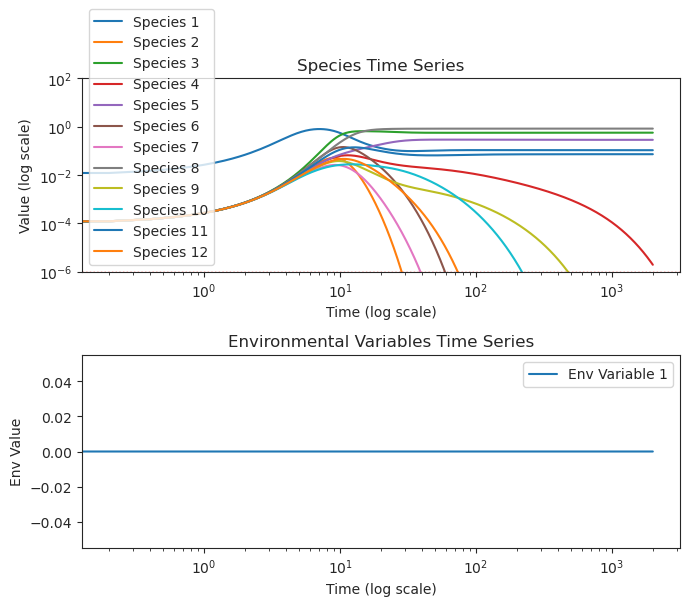

{'species': array([ 1.07018332e-01, -3.97690198e-28,  5.68581240e-01,  1.93371178e-06,
        2.87232464e-01, -2.05198945e-34,  2.29894483e-50,  8.37964945e-01,
        5.73082408e-17, -2.58579144e-31,  7.30328284e-02, -7.31573075e-45,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


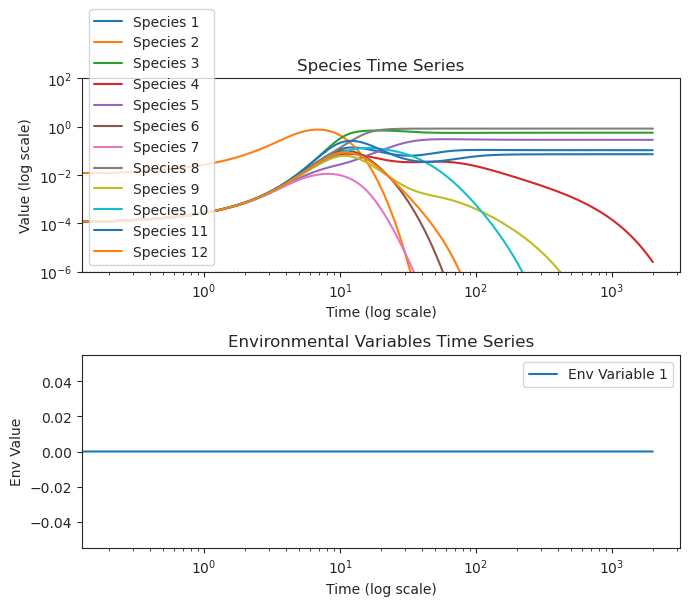

{'species': array([ 1.07018403e-01,  1.71537311e-27,  5.68581051e-01,  2.49240874e-06,
        2.87232584e-01,  2.24155571e-40,  2.75528550e-29,  8.37964815e-01,
        2.09907683e-17,  1.08797069e-35,  7.30327298e-02, -4.46123772e-52,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


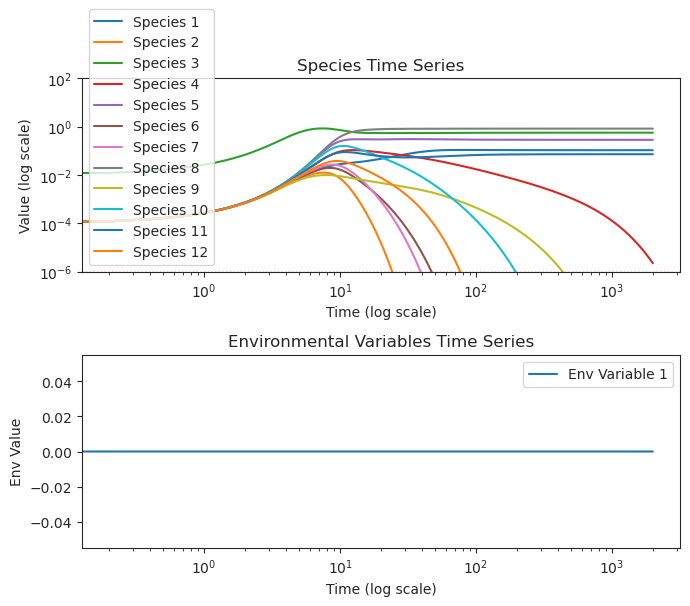

{'species': array([ 1.07018373e-01,  1.13833420e-29,  5.68581132e-01,  2.25323809e-06,
        2.87232533e-01, -1.82865165e-30,  5.86357122e-41,  8.37964871e-01,
        2.94591859e-17, -1.02762214e-34,  7.30327720e-02,  2.49789074e-48,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


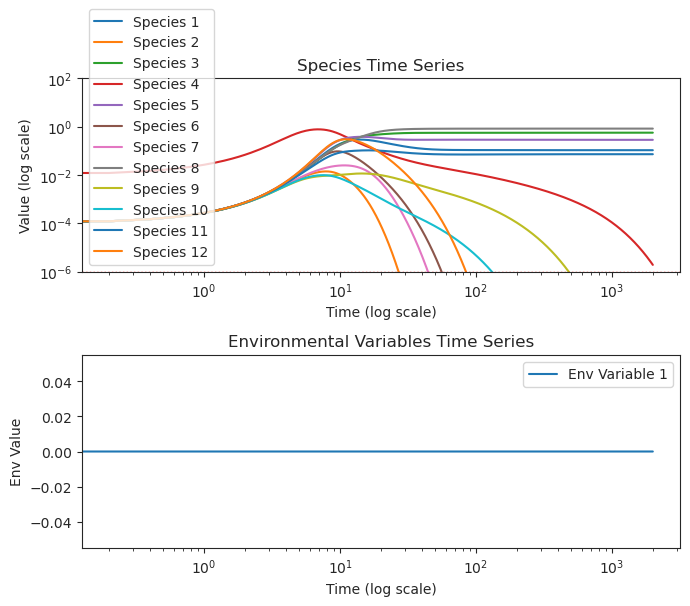

{'species': array([ 1.07018330e-01,  4.25578251e-32,  5.68581247e-01,  1.91521714e-06,
        2.87232460e-01,  3.40267288e-36,  3.72380205e-38,  8.37964950e-01,
        6.41383589e-17,  7.27257234e-35,  7.30328317e-02, -4.97632044e-50,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


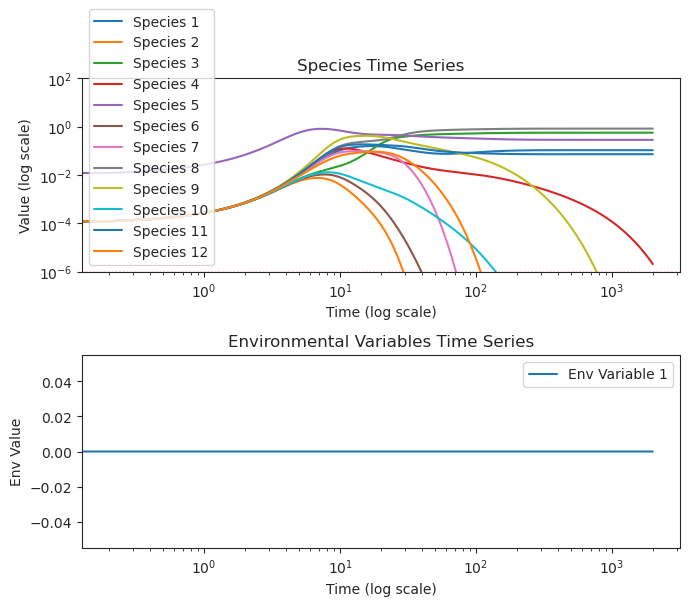

{'species': array([ 1.07018349e-01,  1.34740258e-27,  5.68581195e-01,  2.06730157e-06,
        2.87232493e-01, -1.51874832e-39,  1.64521958e-56,  8.37964914e-01,
        5.96324517e-15, -4.00879722e-38,  7.30328049e-02, -1.24159726e-56,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


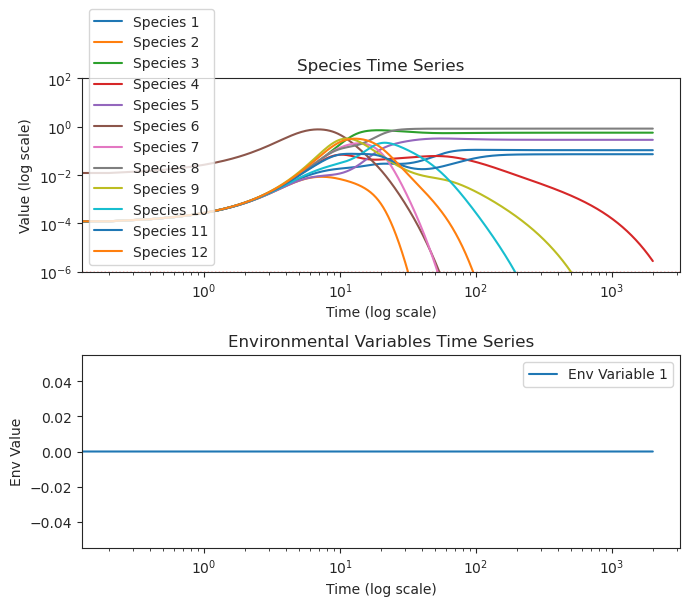

{'species': array([ 1.07018435e-01, -2.95289281e-26,  5.68580965e-01,  2.74601200e-06,
        2.87232638e-01, -1.39221414e-42, -1.72306411e-59,  8.37964756e-01,
        7.99449974e-17,  5.68548392e-36,  7.30326851e-02, -7.04242245e-51,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


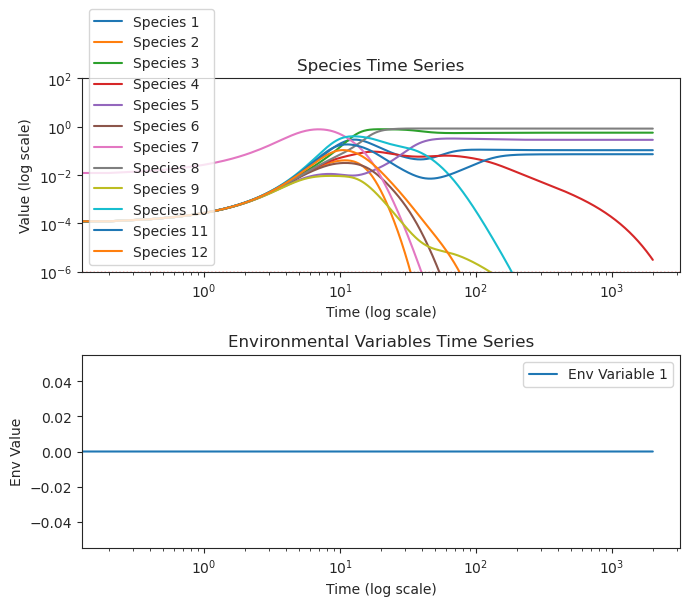

{'species': array([ 1.07018477e-01, -6.20187776e-25,  5.68580850e-01,  3.08543627e-06,
        2.87232710e-01,  1.53962776e-58, -4.52716785e-67,  8.37964677e-01,
        5.85591334e-20, -1.16929292e-37,  7.30326251e-02,  6.12895299e-53,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


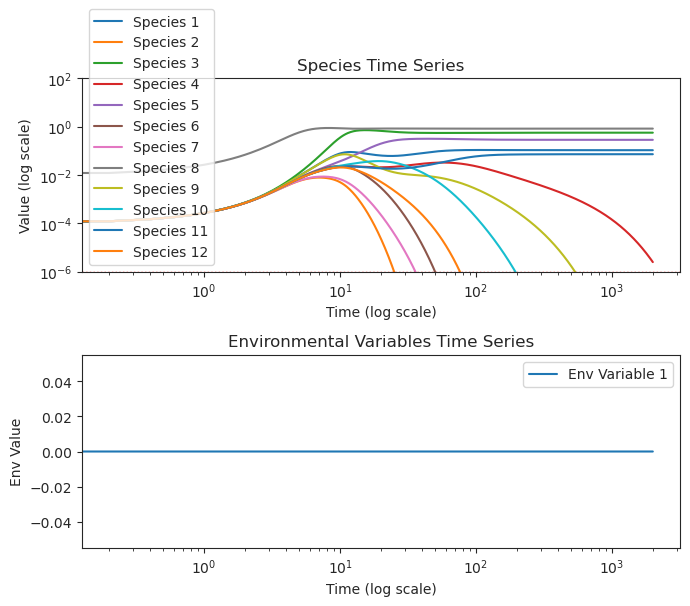

{'species': array([ 1.07018403e-01,  5.50796566e-29,  5.68581050e-01,  2.49360152e-06,
        2.87232584e-01,  1.69048258e-59,  4.21788116e-67,  8.37964815e-01,
        1.45318279e-16, -2.62481061e-36,  7.30327296e-02, -3.64055416e-53,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


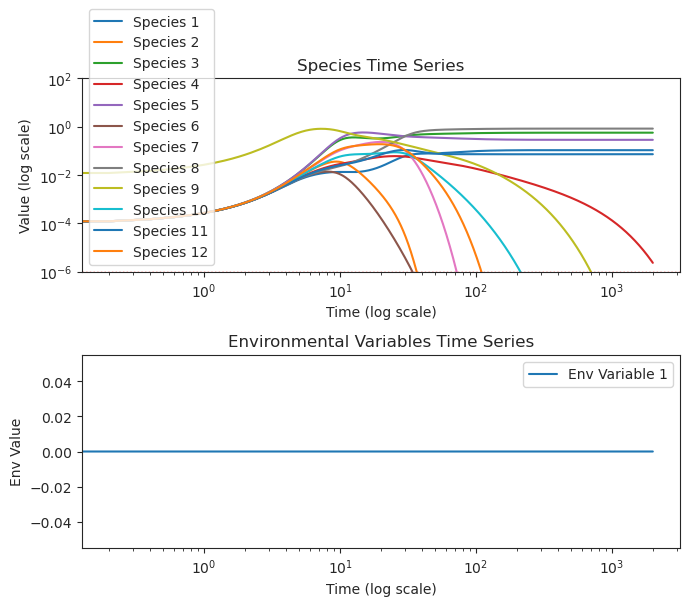

{'species': array([ 1.07018382e-01,  2.84426112e-27,  5.68581108e-01,  2.32492599e-06,
        2.87232548e-01, -4.55833822e-40, -2.08785931e-74,  8.37964854e-01,
        1.97865428e-15,  1.86490045e-31,  7.30327594e-02,  1.45234581e-52,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


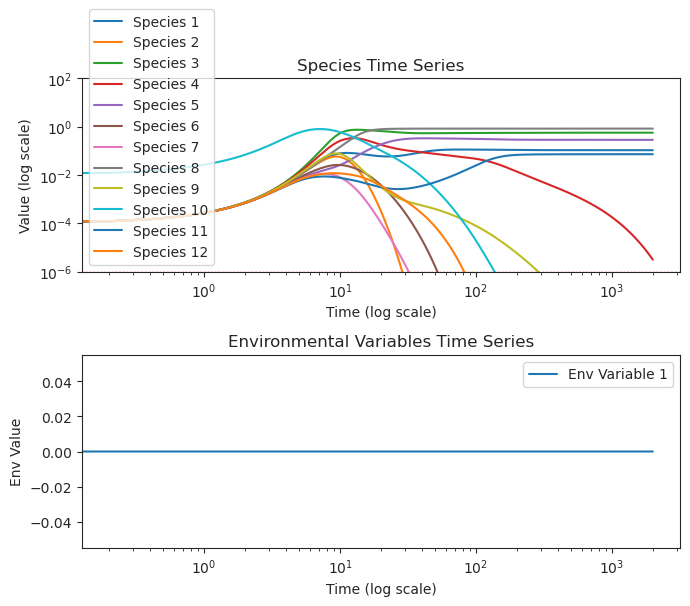

{'species': array([ 1.07018485e-01,  2.65935985e-33,  5.68580829e-01,  3.14515132e-06,
        2.87232723e-01, -3.90014216e-45,  4.35645678e-74,  8.37964663e-01,
        2.05109341e-18, -1.75622894e-38,  7.30326146e-02, -3.25692845e-57,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


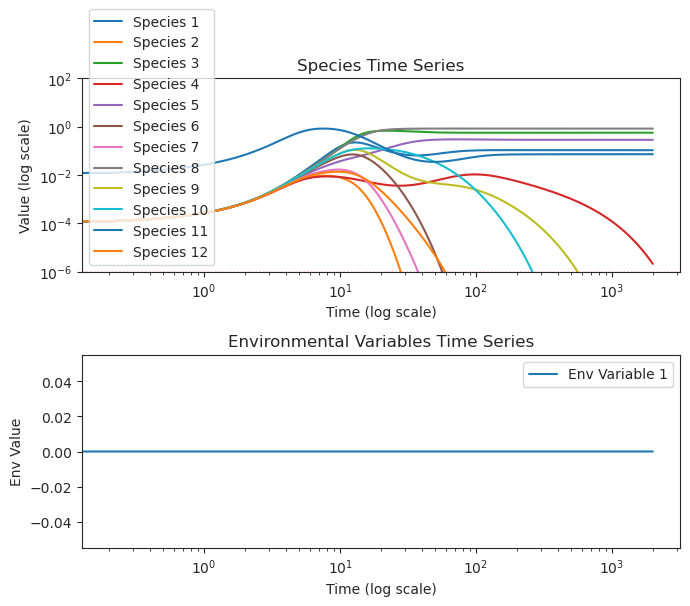

{'species': array([ 1.07018355e-01, -2.99383828e-29,  5.68581178e-01,  2.11596507e-06,
        2.87232503e-01, -1.40128467e-73,  1.50380038e-87,  8.37964903e-01,
        2.17204117e-16, -2.35757918e-32,  7.30327963e-02,  1.21434441e-58,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


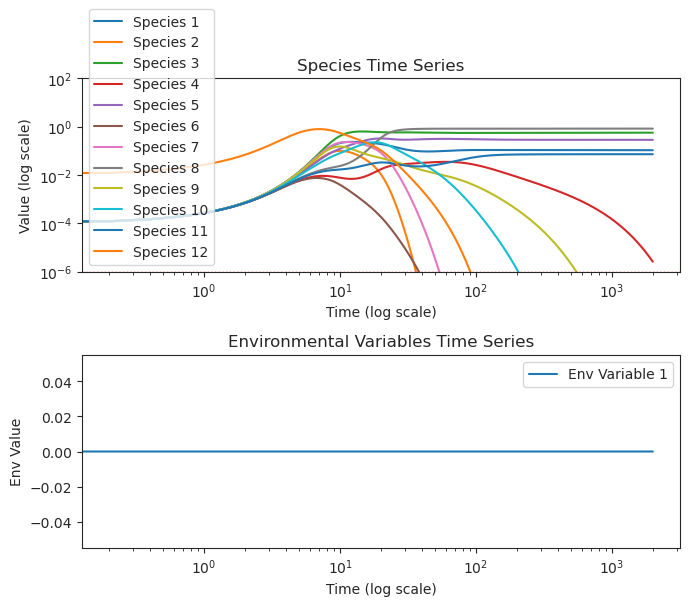

{'species': array([ 1.07018415e-01, -1.25593004e-29,  5.68581018e-01,  2.58908414e-06,
        2.87232604e-01,  1.10758605e-35,  2.11706540e-57,  8.37964793e-01,
        1.74640236e-16, -3.74910921e-33,  7.30327128e-02, -2.01818392e-47,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]), 'env': array([0.])}


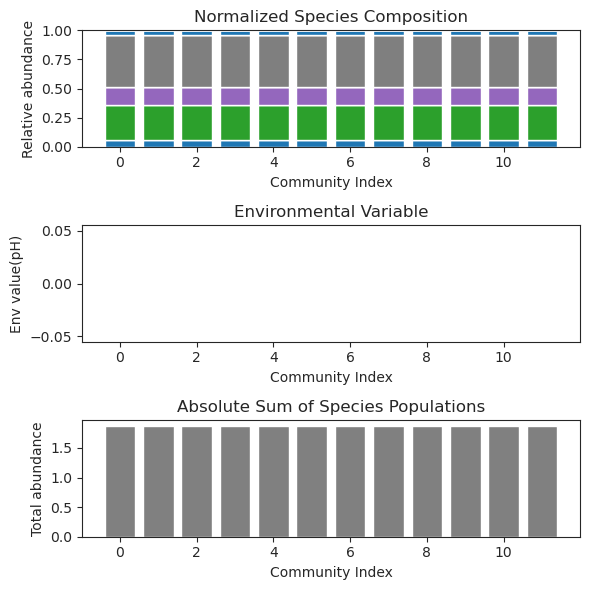

In [24]:
    session_path='Results/Session_Test1'

    if not os.path.isdir(session_path):
        os.mkdir(session_path)
    # functions for uniform 

    f_I = lambda : uniform_distribution(0.5,0.5)
    f_g = lambda : np.ones(1)
    f_k = lambda : np.ones(1)
    f_p = lambda : uniform_distribution(0.4,0.6)
    f_q = lambda : uniform_distribution(0.4,0.6)
    f_beta = lambda : np.ones(1)
    seed_num=56

    np.random.seed(seed_num)




    N=24
    N_env=1


    I = np.zeros((N, N))
    for i in range(N):
        for j in range(N):
            I[i,j] = f_I()
    for i in range(N):
        I[i,i] =1

    g = np.zeros((N))
    for i in range(N):
        g[i] = f_g()

    k = np.zeros((N))
    for i in range(N):
        k[i] = f_k()   

    p = np.zeros((N_env, N))
    for i in range(N_env):
        for j in range(N):
            p[i,j] = f_p()

    p[0,0]=-10
    p[0,1]=-10
    p[0,2]=-10

    q = np.zeros((N, N_env))
    for i in range(N):
        for j in range(N_env):
            q[i,j] = f_q()

    q[0,0]=0.2
    q[1,0]=0.2
    q[2,0]=0.2



    beta = np.zeros(N_env)
    for i in range(N_env):
        beta[i]=f_beta()

    delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
    migration_rate=0#1e-7
    system_config = {
        'I': I,
        'g': g,
        'k': k,
        'p': p,
        'q': q,
        'beta': beta,
        'delta': delta,
        'migration_rate' : migration_rate,
        'N': N,
        'N_env': N_env,
        'seed_num':seed_num,
    } 

    file_path = f'{session_path}/system_config.json'


    
    
    
    
    label="test"
    sys
    ##
    
    y_out_list=[]
    system_config['beta'] = np.array([0])*delta

    for i in range(12):
        
        species_index=np.arange(0,12)
        env_index=np.array([0])
        y0_species=one_hot_vector(12,i)
        y0_env=[0]
        t=np.linspace(0, 2000, 10000)

        y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=True)

        y_out_list.append(y_out)
    
    num_datasets = len(y_out_list)

    # Prepare subplots
    fig, axs = plt.subplots(3, 1, figsize=(6, 6))

    # Data for plots
    species_matrix = np.array([y_out['species'] for y_out in y_out_list])
    env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

    # Normalize species data
    species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
    species_sums = np.sum(species_matrix, axis=1, keepdims=True)
    normalized_species = species_matrix / species_sums
    
    # Absolute sums of species data (sum across all species for each dataset)
    absolute_sums = np.sum(species_matrix, axis=1)
    
    # Plotting species composition as stacked bars
    bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
    for i in range(normalized_species.shape[1]):  # Loop through each species
        axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
        bottom_values += normalized_species[:, i]  # Update bottom values for stacking

    axs[0].set_title('Normalized Species Composition')
    axs[0].set_xlabel('Community Index')
    axs[0].set_ylabel('Relative abundance')
    #axs[0].legend()

    # Plotting environmental factors
    colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
    axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
    axs[1].set_title('Environmental Variable')
    axs[1].set_xlabel('Community Index')
    axs[1].set_ylabel('Env value(pH)')

    # Plotting absolute sums of species data
    axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
    axs[2].set_title('Absolute Sum of Species Populations')
    axs[2].set_xlabel('Community Index')
    axs[2].set_ylabel('Total abundance')

    plt.tight_layout()
    
    #if to_plot:
    #    plt.savefig()
        
        
    plt.show()


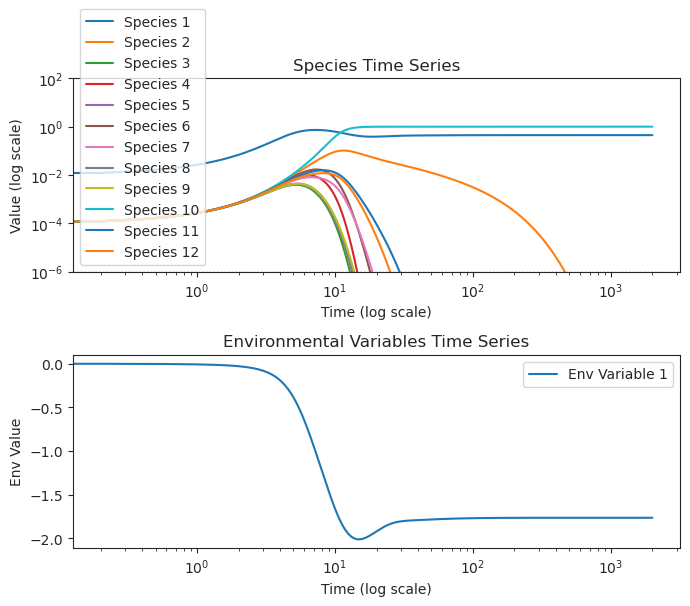

{'species': array([ 4.50306592e-01, -8.29731666e-18,  4.06716813e-32,  4.32639167e-26,
       -4.66708045e-48,  2.11248230e-86, -9.07780421e-92,  1.77899835e-78,
       -2.13235890e-70,  1.00912549e+00, -4.33613457e-74,  1.53212547e-91]), 'env': array([-1.76481192])}


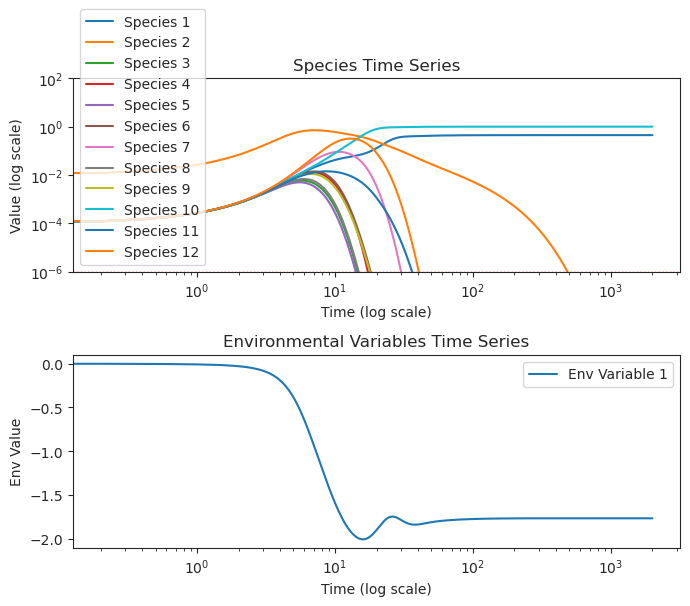

{'species': array([ 4.50306592e-01, -3.49963764e-15,  1.71428143e-26,  2.80209691e-21,
        3.02607135e-39, -1.32205616e-39,  2.69624698e-41, -1.06469959e-60,
        4.16944955e-54,  1.00912549e+00,  4.61574025e-54, -2.11470256e-56]), 'env': array([-1.76481192])}


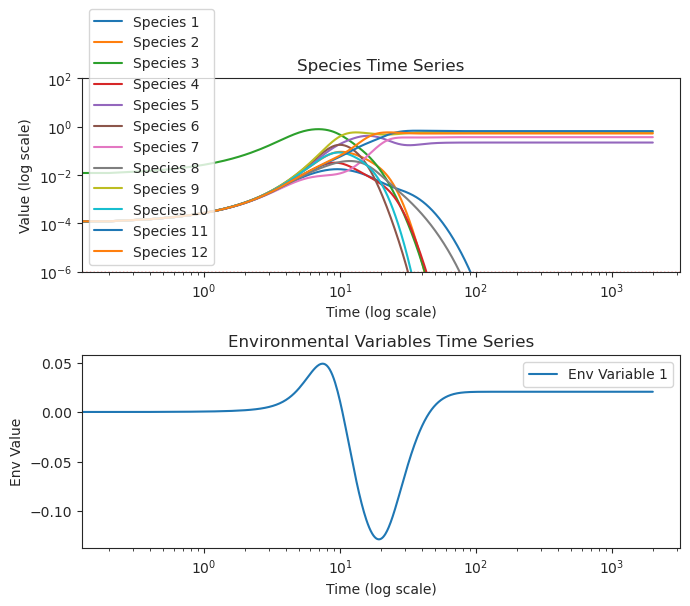

{'species': array([-8.14100939e-23, -3.16329397e-47, -1.52618399e-46, -7.56233752e-46,
        2.22041564e-01,  1.01666644e-47,  3.70571912e-01, -8.56713964e-25,
        6.04284703e-01,  2.32245147e-42,  6.60138407e-01,  5.28099878e-01]), 'env': array([0.02056958])}


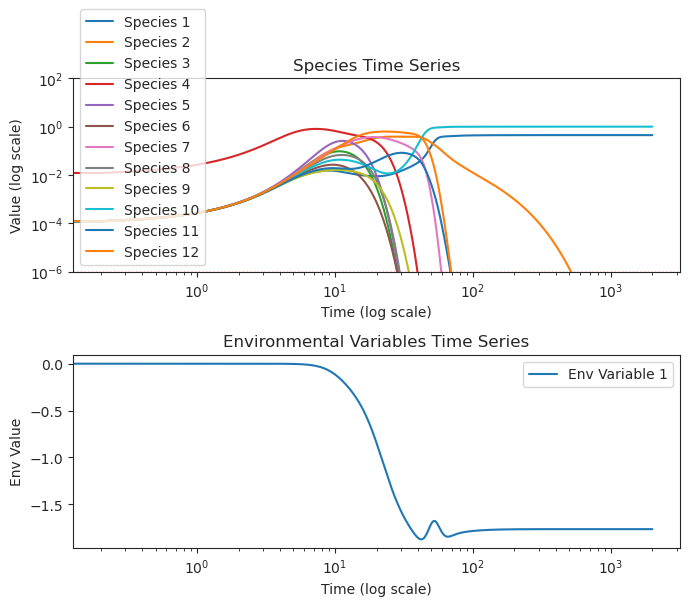

{'species': array([ 4.50306592e-01,  4.56214819e-14, -3.75916467e-28, -6.21229191e-22,
       -1.17753200e-36,  6.05334128e-71, -1.80668129e-60, -7.27550129e-63,
       -4.89111149e-59,  1.00912549e+00, -8.40020938e-54,  4.95917678e-59]), 'env': array([-1.76481192])}


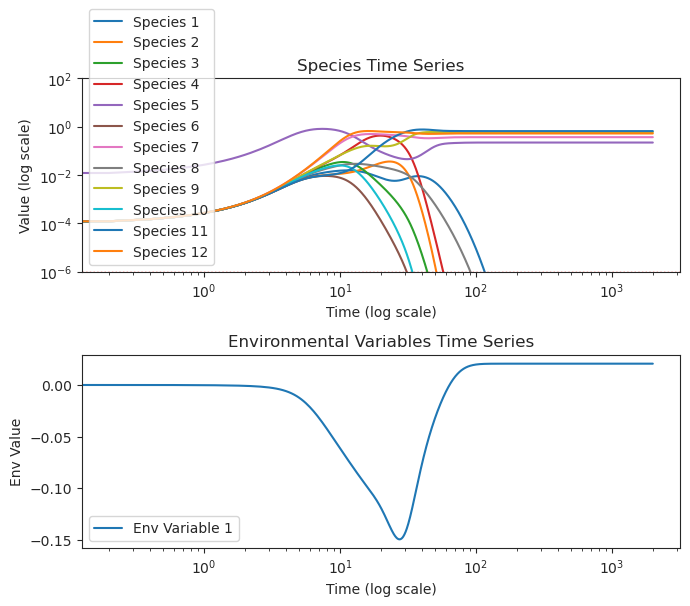

{'species': array([ 5.93006030e-19, -3.95021569e-43, -4.35348708e-41,  2.94792744e-36,
        2.22041564e-01, -2.43277010e-47,  3.70571912e-01,  8.11220949e-21,
        6.04284703e-01, -3.56296620e-40,  6.60138407e-01,  5.28099878e-01]), 'env': array([0.02056958])}


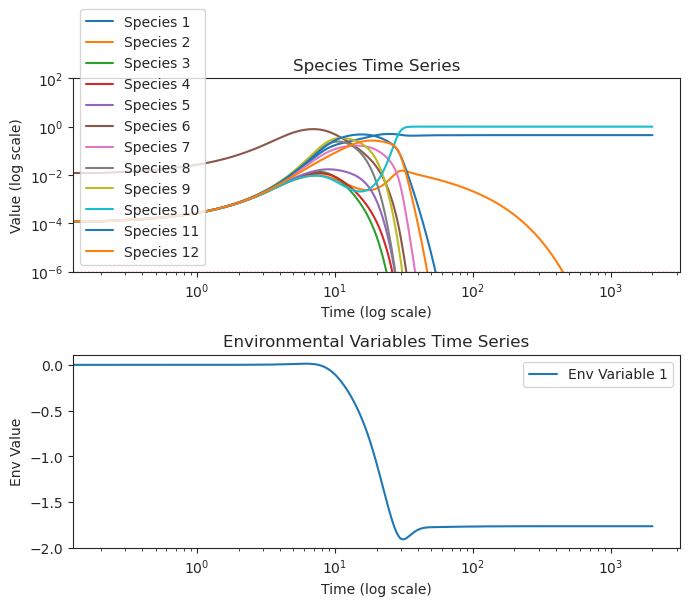

{'species': array([ 4.50306592e-01,  6.47192042e-16,  1.04111472e-35, -3.94709011e-31,
        8.26922976e-44, -1.57519392e-47, -2.03358557e-48,  1.16920669e-62,
       -1.23570426e-54,  1.00912549e+00,  1.58991931e-51,  1.27405713e-61]), 'env': array([-1.76481192])}


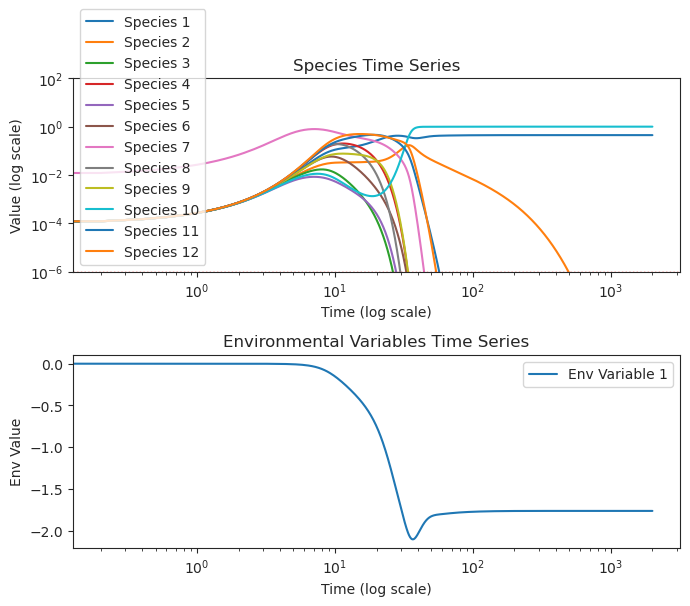

{'species': array([ 4.50306592e-01,  6.38152507e-16, -3.89849165e-35,  5.76616659e-30,
       -2.80595529e-43,  2.15883486e-45, -2.64288496e-45, -9.07518176e-77,
        1.30929944e-67,  1.00912549e+00,  5.15615705e-65,  2.79832472e-77]), 'env': array([-1.76481192])}


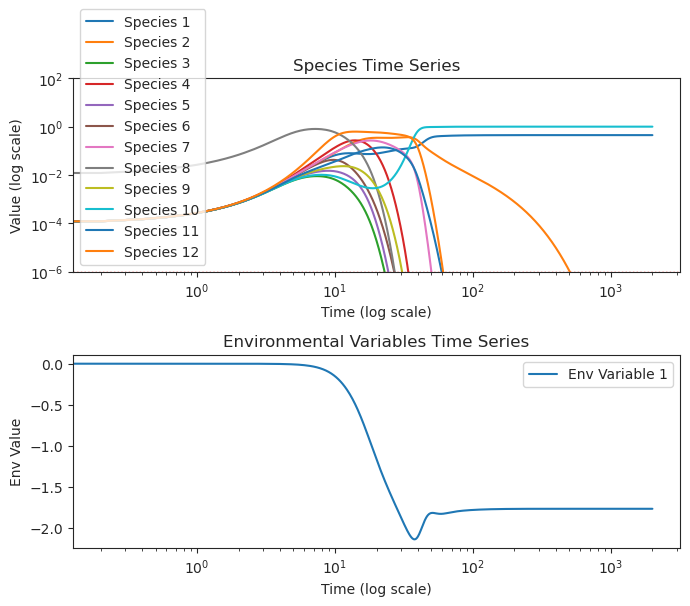

{'species': array([ 4.50306592e-001, -4.66286150e-014, -2.73838909e-036,
        6.69653543e-026,  4.21565660e-058, -8.26781690e-105,
       -8.69077301e-101,  4.21486734e-091,  5.73029698e-081,
        1.00912549e+000,  1.77598945e-080,  2.62685249e-100]), 'env': array([-1.76481192])}


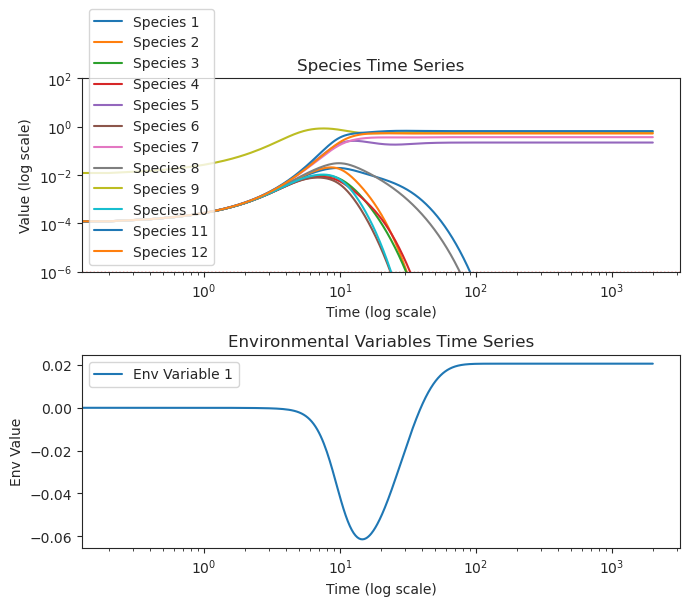

{'species': array([-2.49676299e-23, -9.32207770e-52,  3.57367400e-49, -6.39341101e-46,
        2.22041564e-01,  8.57357468e-51,  3.70571912e-01, -1.82855586e-25,
        6.04284703e-01,  9.68680969e-44,  6.60138407e-01,  5.28099878e-01]), 'env': array([0.02056958])}


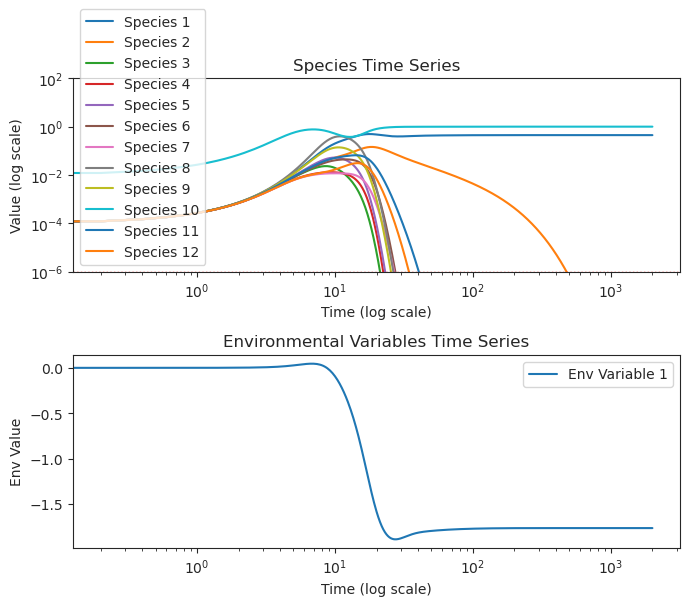

{'species': array([ 4.50306592e-01, -1.69853666e-16,  1.72210697e-26,  5.09872688e-22,
       -4.97256583e-36, -2.50783421e-57,  8.09192094e-61, -1.46537640e-51,
       -1.04072940e-46,  1.00912549e+00, -3.00656395e-52,  1.05605869e-56]), 'env': array([-1.76481192])}


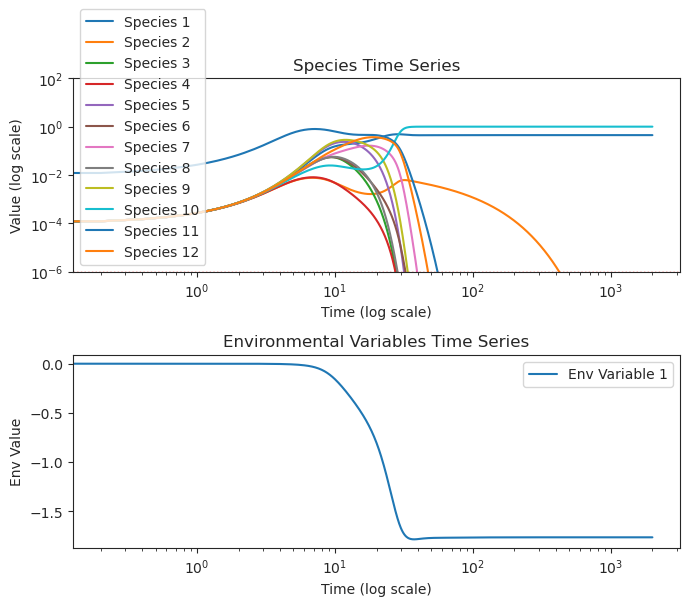

{'species': array([ 4.50306592e-001,  6.16592132e-014,  3.25314803e-031,
       -7.10523072e-022, -6.65635357e-050,  1.62541299e-096,
       -3.52911869e-098, -1.37077825e-089,  1.54990685e-076,
        1.00912549e+000, -8.04707747e-075, -1.35306226e-100]), 'env': array([-1.76481192])}


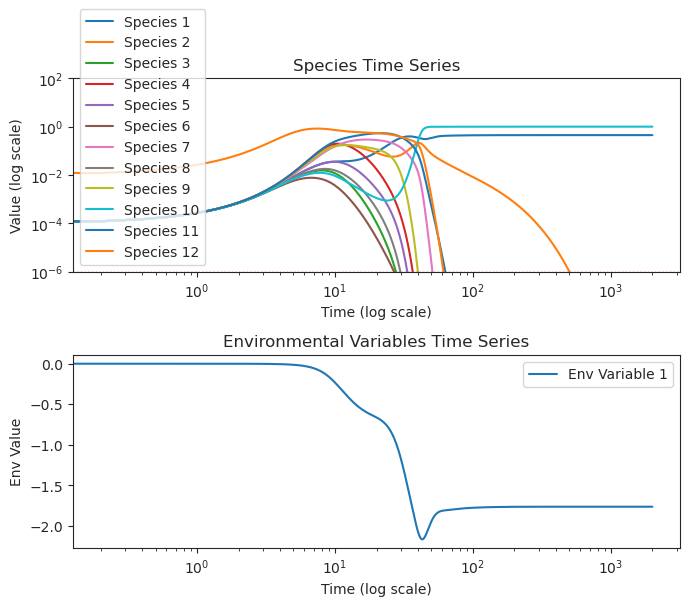

{'species': array([ 4.50306592e-01,  2.48014215e-16, -7.91831535e-36, -1.81819778e-31,
        3.18800033e-41, -6.95366360e-62,  5.49555789e-54, -2.79699224e-56,
        2.86537869e-49,  1.00912549e+00, -1.33074957e-53,  1.09342473e-55]), 'env': array([-1.76481192])}


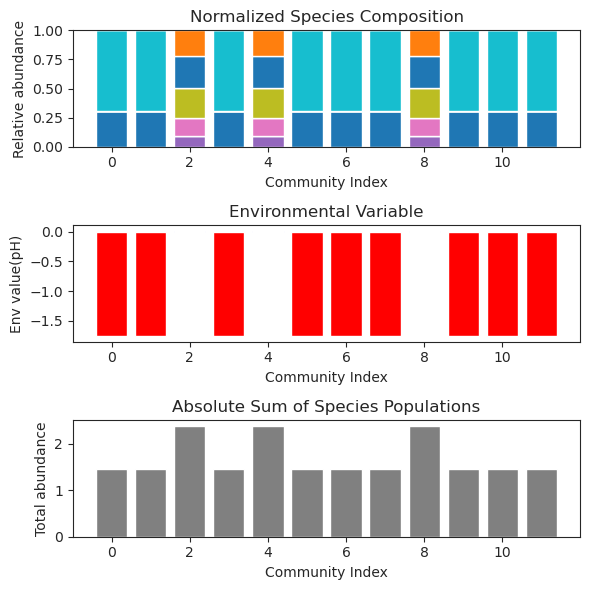

In [52]:
    session_path='Results/Session_Test'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in [26]:
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0.4,0.6)
        f_q = lambda : uniform_distribution(0.4,0.6)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.5])*delta

        for i in range(12):

            species_index=np.arange(0,12)
            env_index=np.array([0])
            y0_species=one_hot_vector(12,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=True)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()

            #if to_plot:
            #    plt.savefig()


            plt.show()


In [7]:
import pickle

{'species': array([ 7.90505033e-323,  2.81692750e-003,  2.89352172e-001,
        2.90393080e-001,  1.10095360e-219,  7.22631842e-185,
        1.67668212e-031,  5.54355974e-081,  3.31108125e-001,
        6.58242380e-095,  4.45879357e-001,  7.60544363e-128,
        5.50037984e-081,  3.84718768e-001,  5.68041104e-150,
       -1.08694442e-322,  5.29928989e-002,  4.11058928e-003,
        1.63173724e-154,  2.22881993e-177,  1.72520988e-001,
        3.16118715e-001,  1.55770771e-002,  1.97626258e-323]), 'env': array([0.30867616])}
{'species': array([ 0.00000000e+000,  7.02673323e-003,  4.76493145e-001,
        1.42656389e-001,  6.38546681e-252,  2.05245389e-222,
        7.53208365e-048,  6.71088752e-118,  2.53506724e-001,
        1.46855800e-074,  3.97934667e-001,  5.19237193e-084,
        1.31124806e-059,  3.04549917e-001,  2.56062709e-135,
        4.94065646e-324,  2.31379050e-001,  9.09295772e-002,
        4.49764831e-154,  2.31946363e-189,  2.00213813e-001,
        1.75568303e-001,  3.485

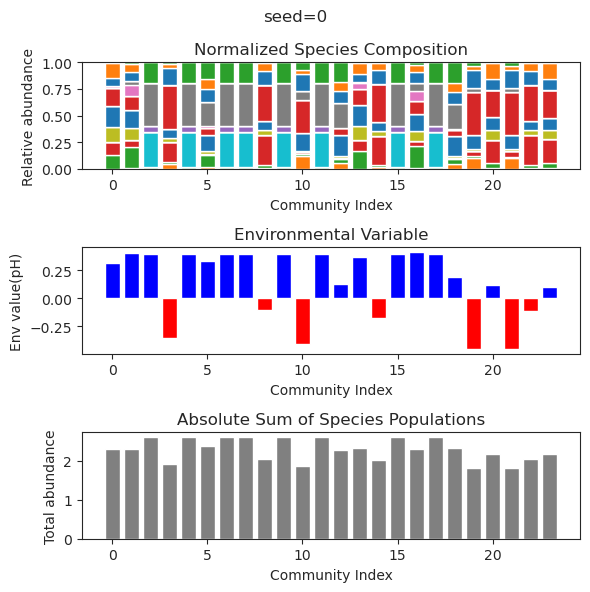

{'species': array([ 1.94840528e-01, -2.99345061e-28,  3.27562153e-25,  1.91493519e-02,
        1.14733280e-39,  5.82820567e-74, -5.54014736e-44, -1.75400251e-70,
        2.40325566e-64,  1.35980886e-32,  2.61348713e-70, -4.75726101e-38,
        1.73940751e-72,  1.06058729e-34,  1.85255338e-01, -2.06286856e-25,
        3.36473716e-01,  4.31459988e-01,  5.66208645e-61,  1.05170805e-02,
        2.89352082e-30,  1.22575883e-35,  7.44048960e-01,  1.52146500e-71]), 'env': array([-0.88772757])}
{'species': array([ 1.94840528e-01,  2.59337088e-23,  3.28134236e-29,  1.91493518e-02,
       -2.09298019e-32,  2.06294196e-50,  6.02668956e-39, -3.09395478e-38,
       -8.55580885e-82,  1.16227141e-89,  3.56261784e-34, -6.74962303e-33,
       -8.31581158e-83,  1.28491755e-74,  1.85255338e-01,  6.63325975e-18,
        3.36473715e-01,  4.31459988e-01, -2.03076924e-60,  1.05170811e-02,
        8.76751229e-36,  8.94809447e-54,  7.44048959e-01,  5.87477825e-72]), 'env': array([-0.88772757])}
{'species': ar

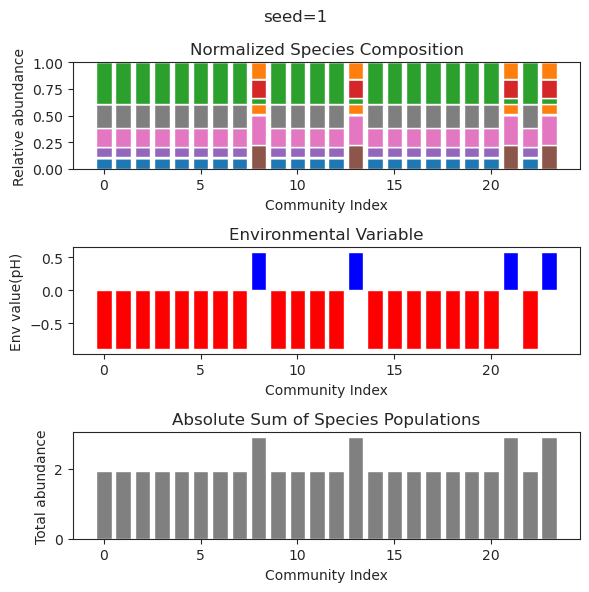

{'species': array([ 1.25191776e-001, -6.21433993e-065,  4.00199188e-141,
       -1.29214978e-009,  1.73736018e-265, -1.01495383e-029,
        4.05614851e-001, -1.74784291e-120,  8.01238881e-179,
        0.00000000e+000,  1.55017439e-100, -4.04608335e-034,
       -1.22154801e-024, -9.19369532e-130,  4.14421961e-001,
        7.33766576e-001, -1.85143369e-144, -1.51727791e-244,
        1.07609855e-065, -2.55819220e-249, -9.06169483e-232,
        1.26674146e-151,  2.35323944e-001,  7.24610451e-056]), 'env': array([-0.19181826])}
{'species': array([ 2.52658953e-001, -5.79823470e-060,  1.31698333e-180,
        1.59959424e-049,  6.04101641e-165,  4.69947664e-050,
        4.92379678e-001,  2.87979790e-023,  5.96807976e-097,
        3.85525476e-273,  1.41137931e-039, -2.97395087e-023,
       -3.57581098e-049, -2.37373285e-173, -5.56809964e-015,
        6.03088076e-022, -5.17866554e-183, -5.17315828e-170,
        5.83590685e-059, -7.23477471e-196, -1.86911261e-229,
        6.02075759e-082,  1.02

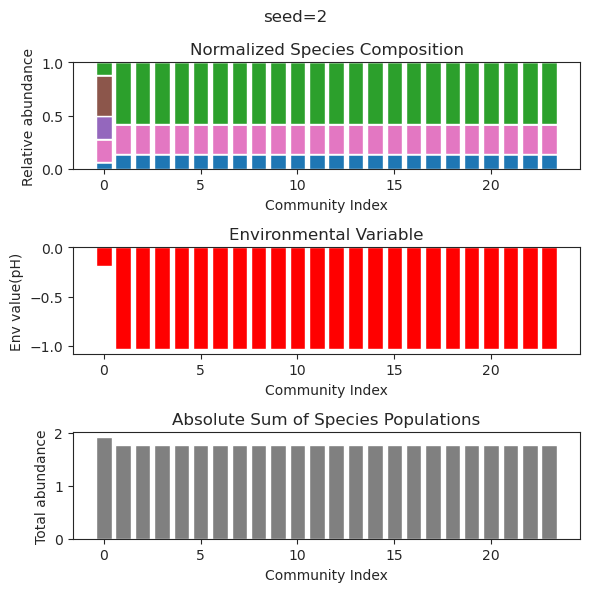

{'species': array([ 2.52658953e-001,  6.40634513e-086, -3.13214666e-195,
        1.26782449e-063,  1.72288731e-193,  2.78713340e-054,
        4.92379678e-001, -1.22557354e-024,  1.26061814e-104,
       -2.12153681e-315,  3.00991972e-043,  4.44766908e-024,
        6.97607231e-051,  2.60681537e-204, -7.40507761e-015,
        9.28990878e-052,  7.84794374e-212,  1.24897188e-196,
       -2.77936719e-073,  2.11914009e-220,  6.55335376e-252,
       -1.15200943e-087,  1.02903989e+000, -5.76130851e-043]), 'env': array([-1.03010633])}
{'species': array([ 2.16287599e-001,  3.96734469e-050,  3.07204800e-003,
       -1.43210950e-194, -3.03226242e-189,  4.69541580e-176,
        7.03112050e-130,  5.19553734e-221, -4.39189316e-041,
       -3.88980138e-080, -1.17787916e-143,  6.08877624e-006,
        1.49847015e-087,  6.61936549e-001, -7.34738437e-098,
       -8.68354528e-184,  1.01925718e-022, -2.82119832e-101,
       -3.55542936e-224,  1.42980604e-245, -9.83572425e-208,
        3.44107845e-001,  4.69

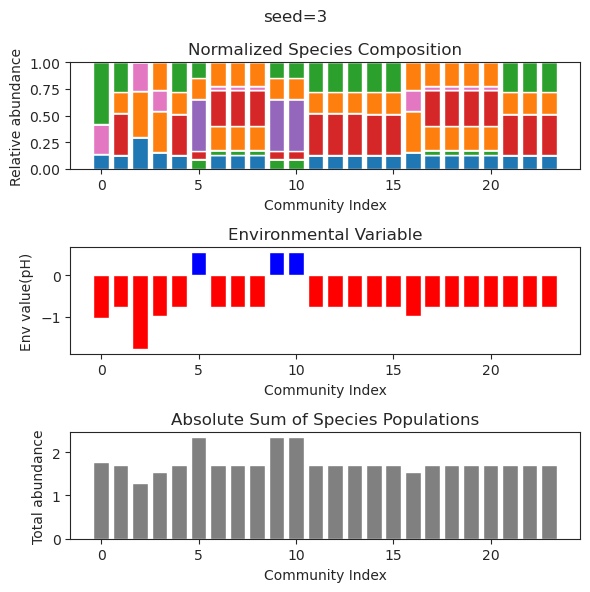

{'species': array([1.38652579e-053, 3.50416636e-002, 8.39356867e-198, 5.22606436e-140,
       3.92630631e-093, 1.11345139e-162, 1.21337199e-123, 3.92388512e-001,
       3.21408039e-056, 1.48096282e-001, 3.27733050e-001, 2.88521582e-001,
       4.68031831e-001, 7.01342039e-122, 1.33177401e-081, 5.44580221e-132,
       8.14955327e-262, 7.50560451e-021, 1.20581236e-067, 1.25313503e-201,
       2.62896644e-001, 2.22901144e-005, 9.47064488e-002, 2.82304340e-013]), 'env': array([0.00633503])}
{'species': array([2.87370391e-051, 1.61510931e-002, 3.95060592e-197, 1.40852737e-135,
       4.34633246e-093, 4.24291239e-162, 3.80094809e-123, 3.75933149e-001,
       1.18067145e-051, 3.52009426e-001, 1.63089481e-001, 1.93549505e-001,
       3.85785539e-001, 5.41330744e-121, 1.38495527e-081, 2.67988129e-132,
       7.06588241e-261, 1.82207041e-020, 1.67589123e-068, 1.73429794e-197,
       3.75666116e-002, 2.11580917e-001, 2.45902842e-001, 3.83738221e-015]), 'env': array([0.04801225])}
{'species': arra

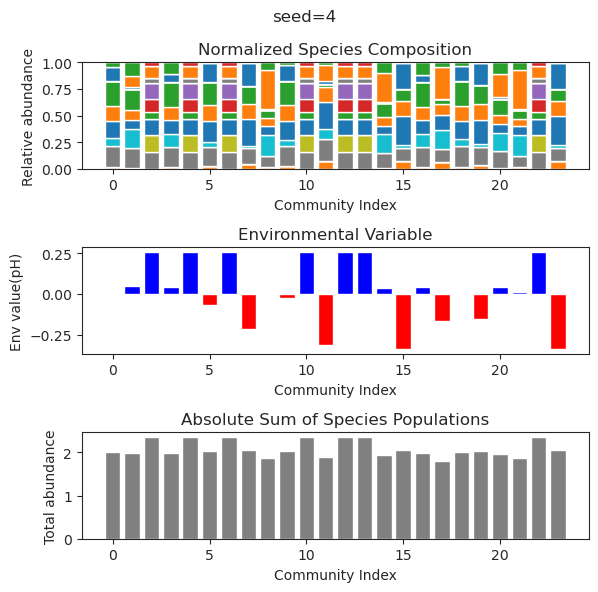

{'species': array([ 1.39741095e-01, -1.87979671e-51,  4.29528621e-01, -2.59875367e-74,
       -7.45801676e-50,  7.06548465e-02,  3.20827115e-30, -2.61607751e-70,
        1.35724756e-37, -2.07687774e-64,  2.31636634e-01,  1.90019493e-19,
        1.01624266e-35,  5.70547579e-90,  1.09793771e-87,  2.54113205e-86,
        8.50487653e-88,  8.23904135e-02,  1.94850816e-01,  7.91926151e-01,
       -2.39409822e-70,  6.69241718e-87, -2.27415445e-86, -2.25107455e-92]), 'env': array([-0.51719548])}
{'species': array([ 1.39741095e-01, -2.71651912e-51,  4.29528621e-01, -4.70620809e-80,
       -1.32787190e-51,  7.06548465e-02,  2.50649291e-32,  5.74954692e-76,
        1.58360649e-36,  9.18061192e-74,  2.31636634e-01,  1.88174583e-18,
        2.45707692e-35,  5.94814835e-96,  8.24104004e-93, -6.49283149e-90,
       -1.17894185e-95,  8.23904135e-02,  1.94850816e-01,  7.91926151e-01,
       -9.17639694e-73,  1.26123573e-91, -1.20857812e-88,  1.18498828e-93]), 'env': array([-0.51719548])}
{'species': ar

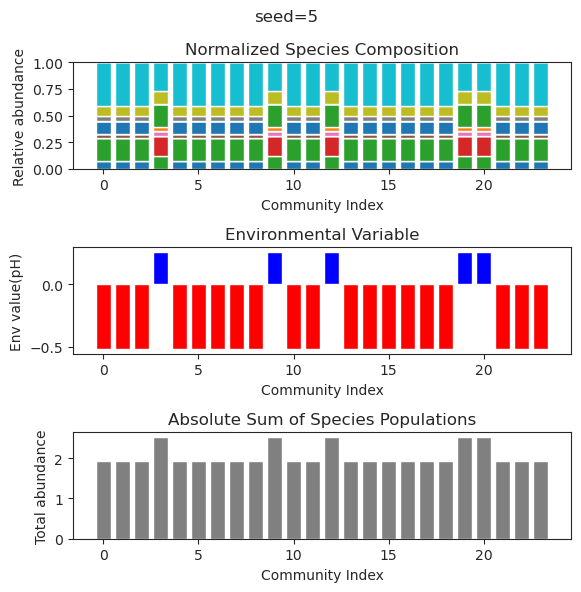

{'species': array([ 4.94065646e-324,  4.94065646e-324,  7.82481396e-147,
        1.60167264e-001,  1.53339562e-001,  2.20436143e-001,
        5.37379469e-001,  2.16405487e-047, -1.52826308e-202,
        4.91531770e-001, -2.65755012e-111,  1.92946931e-001,
       -8.08242068e-204, -9.86709562e-147,  0.00000000e+000,
        1.42839622e-001,  4.94065646e-324, -9.85571302e-175,
        6.70947272e-083,  4.08798436e-001,  1.17695992e-019,
       -1.27807270e-183,  3.30892153e-003,  2.89893959e-001]), 'env': array([0.54572084])}
{'species': array([ 4.94065646e-324,  0.00000000e+000, -1.81440972e-143,
        1.60167264e-001,  1.53339562e-001,  2.20436143e-001,
        5.37379469e-001,  1.11102662e-046, -7.16413256e-196,
        4.91531770e-001,  3.29217532e-096,  1.92946931e-001,
       -2.57326556e-190, -4.93671506e-144,  0.00000000e+000,
        1.42839622e-001, -8.72373025e-310, -3.70852039e-171,
       -3.63568208e-086,  4.08798436e-001,  1.69834340e-022,
       -1.21434690e-180,  3.308

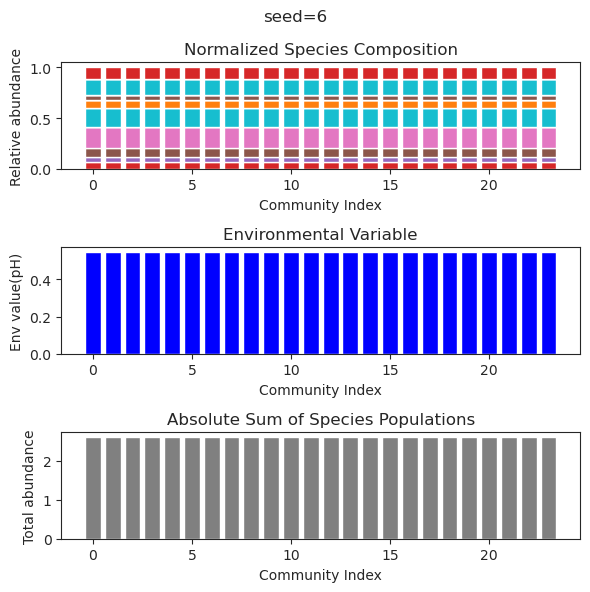

{'species': array([ 1.84306735e-001,  3.67020663e-043,  7.40990677e-002,
       -4.26626691e-074,  3.89781578e-058,  1.47540192e-001,
        5.67725816e-057,  2.66776037e-001, -3.54768583e-043,
        2.13895036e-001, -5.82865534e-102,  1.24424910e-045,
        2.03880732e-001,  2.37755035e-110, -1.84703633e-095,
        3.85614712e-116,  1.66892397e-082, -1.49373730e-080,
        3.32349007e-039,  1.76560649e-001, -1.87600832e-102,
        1.50942323e-097,  2.69950589e-002,  7.10216130e-001]), 'env': array([-0.49893828])}
{'species': array([ 1.84306735e-001,  8.10544693e-152,  7.40990677e-002,
        2.16017663e-090,  4.15418030e-077,  1.47540192e-001,
        9.31258515e-073,  2.66776037e-001, -8.05823856e-150,
        2.13895036e-001,  3.62319461e-127, -3.16578262e-093,
        2.03880732e-001,  2.18991932e-146,  6.36956618e-141,
       -1.52153100e-147, -1.98259009e-111,  1.73145907e-097,
       -9.13992200e-045,  1.76560649e-001, -9.14456111e-132,
       -1.29089037e-118,  2.69

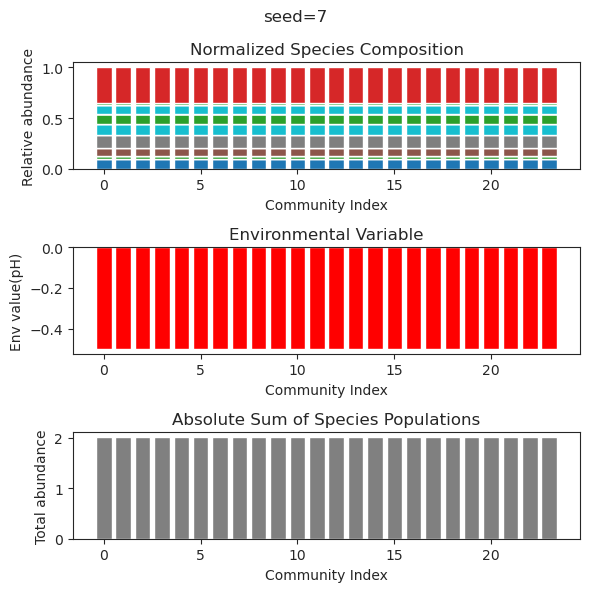

{'species': array([ 3.00395334e-001,  9.81069008e-002,  5.75281090e-002,
       -1.19895556e-088, -1.64500874e-114, -6.17995884e-126,
        1.21171442e-112,  3.18224904e-067, -2.98415025e-133,
       -1.74002492e-106,  3.07782577e-094, -5.38118535e-075,
        1.09527311e-123, -6.16635728e-136,  2.00678502e-001,
        1.08922437e-096,  1.69900336e-067,  3.28302812e-081,
        3.21656020e-110,  3.34078204e-001,  7.48143932e-001,
       -4.44460608e-120,  4.39799549e-002,  2.06097746e-029]), 'env': array([-1.51135125])}
{'species': array([ 3.00395334e-001,  9.81069008e-002,  5.75281090e-002,
       -5.48214016e-112,  9.49167694e-154, -1.11846840e-191,
        4.79670320e-172,  1.07068679e-082,  1.21029190e-193,
        3.58021581e-162, -1.38763003e-133, -5.06169694e-093,
        1.85070732e-169, -7.61898883e-193,  2.00678502e-001,
       -3.10203861e-137,  1.48242069e-080, -1.64875209e-100,
        1.74760939e-139,  3.34078204e-001,  7.48143932e-001,
        2.63707779e-163,  4.39

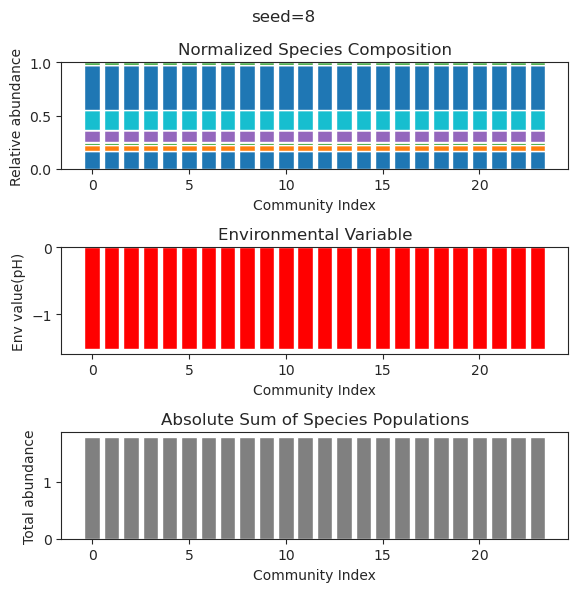

{'species': array([ 5.49296912e-123, -1.07951715e-088,  3.53441714e-001,
        1.79720711e-030, -3.85037765e-112, -1.70626288e-101,
        1.12390457e-069,  3.61854683e-118,  2.74655675e-020,
        2.67843058e-002,  5.43241236e-095,  5.41043220e-001,
       -1.59383723e-021, -1.51212371e-119, -4.50805206e-089,
        4.94056954e-001,  2.54130168e-001, -4.10499722e-085,
        3.95875943e-084,  3.43801998e-108,  9.66947493e-001,
        1.01527253e-034,  4.45681177e-001,  4.54347437e-071]), 'env': array([0.75129844])}
{'species': array([ 5.49296912e-123, -1.07951715e-088,  3.53441714e-001,
        1.79720711e-030, -3.85037765e-112, -1.70626288e-101,
        1.12390457e-069,  3.61854683e-118,  2.74655675e-020,
        2.67843058e-002,  5.43241236e-095,  5.41043220e-001,
       -1.59383723e-021, -1.51212371e-119, -4.50805206e-089,
        4.94056954e-001,  2.54130168e-001, -4.10499722e-085,
        3.95875943e-084,  3.43801998e-108,  9.66947493e-001,
        1.01527253e-034,  4.456

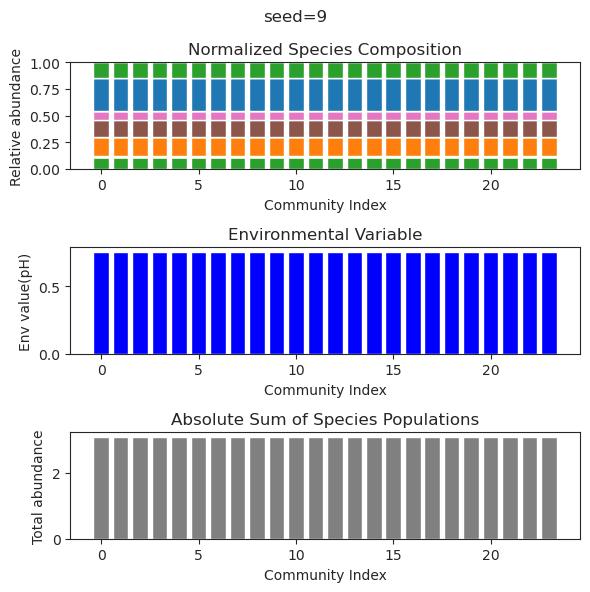

{'species': array([ 6.60732089e-28,  1.65473612e-22,  7.04658455e-01,  1.47540811e-01,
        1.72618390e-28,  2.42821338e-28,  4.24712786e-28, -8.30781306e-27,
        5.61226692e-78,  3.65517914e-01,  4.13521170e-62,  8.17682998e-28,
        3.74764499e-01, -6.41998366e-33, -4.95171412e-27,  4.08374642e-63,
        1.53617497e-03, -1.73139111e-63, -6.83102981e-56, -1.86832171e-43,
        6.92248884e-01,  8.71815802e-69,  7.49793082e-01,  2.69360484e-66]), 'env': array([0.55700155])}
{'species': array([ 7.36010452e-29,  1.04164428e-25,  7.04967028e-01,  1.47355072e-01,
       -2.42352595e-35, -3.81890050e-35,  3.48194952e-30,  8.42497445e-38,
        1.97717385e-87,  3.64662960e-01,  6.89197329e-68,  7.95596726e-31,
        3.74786339e-01,  1.47161784e-58,  1.07897515e-75, -2.06602684e-75,
        2.28521124e-03, -2.34193222e-29, -7.74840408e-30, -2.75545931e-40,
        6.92188002e-01, -3.08263329e-77,  7.50078629e-01,  1.17546410e-69]), 'env': array([0.55690191])}
{'species': arra

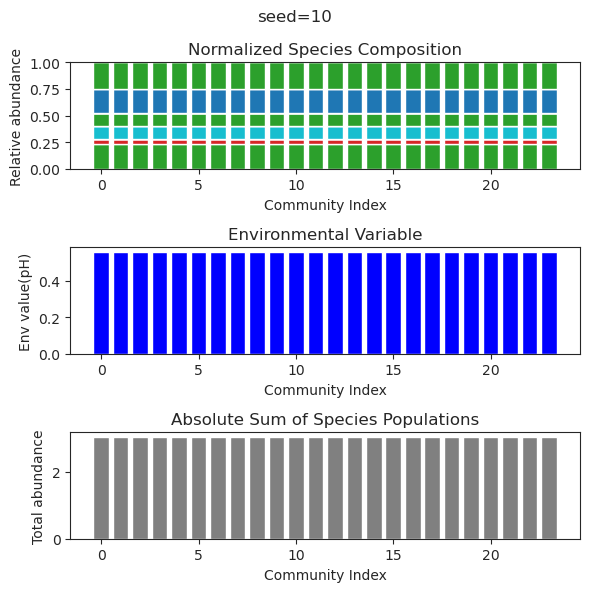

{'species': array([ 2.15824726e-028,  6.81759238e-034,  6.83229393e-040,
       -2.69924207e-076,  4.73799594e-002,  3.71751060e-035,
        3.13510955e-105,  4.33947839e-001, -3.72363066e-083,
       -5.51753464e-110, -2.55274212e-122,  1.00799661e-001,
        4.38844411e-001, -1.50625867e-039, -1.03826779e-065,
        2.24879251e-001,  1.04160727e-026,  5.67159894e-021,
        2.84466701e-001,  4.20568534e-074,  5.35115867e-001,
        2.41244490e-001,  1.93037218e-063,  1.88941752e-002]), 'env': array([0.20346417])}
{'species': array([ 5.37619072e-95,  1.62341861e-41,  9.40760044e-44, -7.35638559e-42,
        4.73799596e-02,  3.69935622e-79,  7.77718940e-90,  4.33947839e-01,
        1.41580592e-74, -8.35061757e-96, -1.82397466e-95,  1.00799661e-01,
        4.38844411e-01, -1.25733505e-42,  2.64796051e-72,  2.24879251e-01,
        9.86684215e-25,  1.41749010e-20,  2.84466701e-01, -6.44825804e-70,
        5.35115867e-01,  2.41244490e-01,  2.35094831e-58,  1.88941757e-02]), 'env':

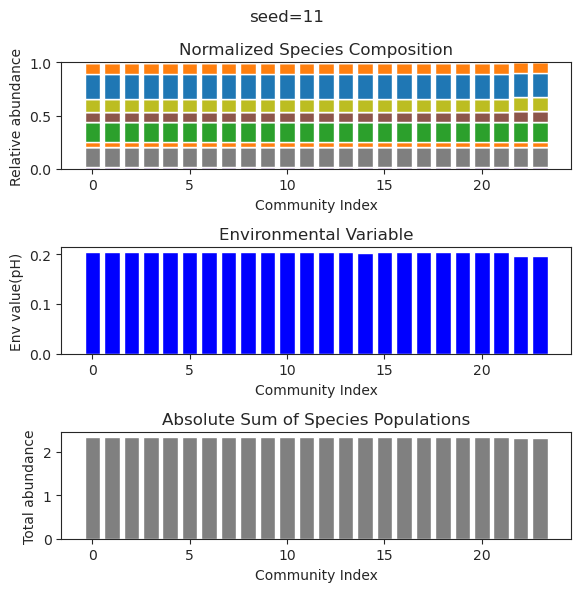

{'species': array([ 3.96185863e-01, -7.26408428e-41,  7.83449747e-01,  3.64884852e-64,
       -3.83936341e-69, -3.50066016e-57, -8.60343385e-46,  4.41752327e-01,
        5.21678042e-60,  3.10738360e-01,  7.75806992e-63, -1.95294947e-76,
       -5.12904085e-48, -1.19453460e-45,  3.48531158e-58, -3.22261022e-20,
       -1.12517593e-50, -7.90325149e-26, -2.57944133e-66, -6.89199843e-77,
        3.07817181e-02, -2.45879627e-72, -2.17198286e-22, -3.19796556e-42]), 'env': array([-1.58292689])}
{'species': array([ 3.96185863e-001,  4.26919597e-048,  7.83449747e-001,
       -7.71368410e-086,  3.09387053e-084,  1.43940809e-075,
       -2.67997165e-100,  4.41752327e-001, -8.30802253e-082,
        3.10738360e-001, -1.27532847e-082,  4.45403206e-096,
        1.20680921e-059,  2.21544443e-049,  4.64228121e-069,
       -3.24169033e-020,  9.87551895e-067,  3.46658199e-031,
        1.09778738e-087,  1.81149206e-098,  3.07817181e-002,
        2.05768438e-090, -2.89044419e-027,  2.64534501e-044]), 'env'

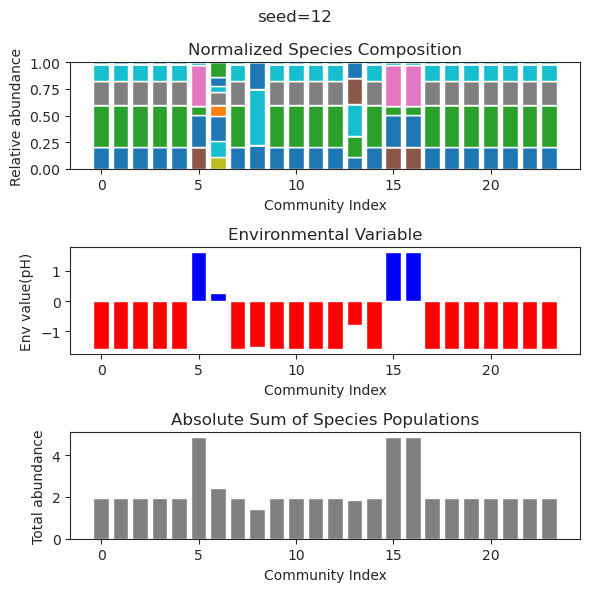

{'species': array([ 2.36227362e-182,  8.21236347e-002,  6.60137226e-002,
        3.93499411e-224, -6.33269626e-033, -8.92450713e-037,
        3.56309336e-001,  4.99613582e-001,  4.23126338e-001,
       -4.83842090e-088,  5.48464017e-203,  1.70309095e-179,
        8.19962873e-002, -6.17554935e-144,  1.39456145e-231,
        3.52166981e-001,  2.45925423e-200, -5.93325093e-208,
        2.18702727e-133, -9.41543431e-139,  9.13041404e-181,
       -9.59532756e-108,  3.75779494e-001,  1.71594634e-180]), 'env': array([-0.07114682])}
{'species': array([ 8.98589013e-180,  8.21236347e-002,  6.60137226e-002,
       -5.47852728e-219, -2.73003728e-032, -1.73356715e-033,
        3.56309336e-001,  4.99613582e-001,  4.23126338e-001,
        1.37126192e-079,  1.06001425e-199,  4.37732250e-169,
        8.19962873e-002,  3.41185214e-135, -5.78747552e-225,
        3.52166981e-001, -7.50134417e-198, -4.77387376e-202,
       -1.44642857e-120,  1.62117967e-132,  6.55349610e-180,
       -5.46181836e-103,  3.75

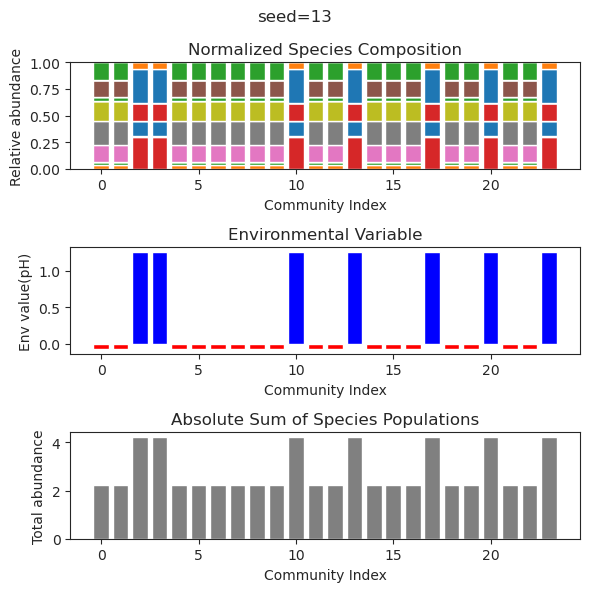

{'species': array([ 3.88772394e-64,  5.39000326e-59,  6.86239186e-01, -3.09974914e-37,
       -3.57176281e-42,  2.40505677e-50, -1.95928879e-63,  3.62390132e-52,
        5.61326625e-01, -3.39152259e-42,  2.90145936e-01,  3.61909512e-32,
       -5.71259679e-63, -2.00572329e-75,  3.25150835e-01,  5.24270263e-63,
       -2.18811495e-28,  4.28979998e-01,  1.01219068e-01, -3.19503536e-45,
        2.09813657e-67,  1.31056589e-50, -5.66494506e-22, -7.09264255e-34]), 'env': array([0.13823458])}
{'species': array([-6.99819026e-74,  2.06271287e-61,  6.86239186e-01, -3.58338083e-47,
       -1.82087674e-44,  3.73494517e-53,  2.47704265e-66, -2.85128961e-64,
        5.61326625e-01, -3.36100704e-52,  2.90145936e-01,  4.72642417e-43,
       -5.52091432e-67,  2.83409401e-88,  3.25150835e-01,  2.62348640e-67,
        5.30426440e-41,  4.28979998e-01,  1.01219068e-01,  2.36186463e-58,
       -3.12355663e-84,  2.03512340e-63, -2.91536424e-21, -8.66092895e-36]), 'env': array([0.13823458])}
{'species': arra

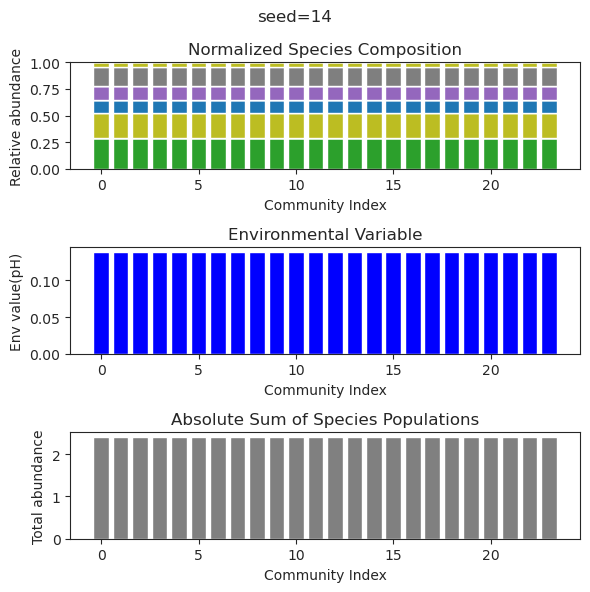

{'species': array([ 7.07282681e-004,  7.44174235e-003,  3.24322015e-004,
        4.73750858e-001,  2.61854792e-322,  6.88882488e-243,
        3.96907868e-020,  2.06923593e-065,  6.18787758e-157,
       -5.33590898e-322,  3.54136477e-001,  4.94065646e-324,
        3.76500522e-156,  7.61852116e-001,  1.38296945e-115,
        1.44256176e-002,  2.34862165e-128,  9.97700999e-094,
        1.26276150e-002,  6.75189582e-001,  4.39718425e-322,
        4.92359621e-056,  1.46821537e-205,  3.12801925e-154]), 'env': array([-0.46284547])}
{'species': array([ 9.69948807e-003,  4.22046758e-001,  2.11419195e-001,
        9.06376804e-002, -4.94065646e-323,  7.78734805e-241,
        4.11662092e-015,  4.43752581e-067,  3.98293922e-159,
       -3.95252517e-323,  3.46795249e-001, -6.42285340e-323,
        3.01612369e-152,  6.13729702e-002,  2.55912939e-117,
        1.65569135e-001,  3.88369886e-127,  1.22377463e-094,
        5.44918965e-001,  2.15150863e-003,  4.34777768e-322,
        3.87781522e-053,  4.65

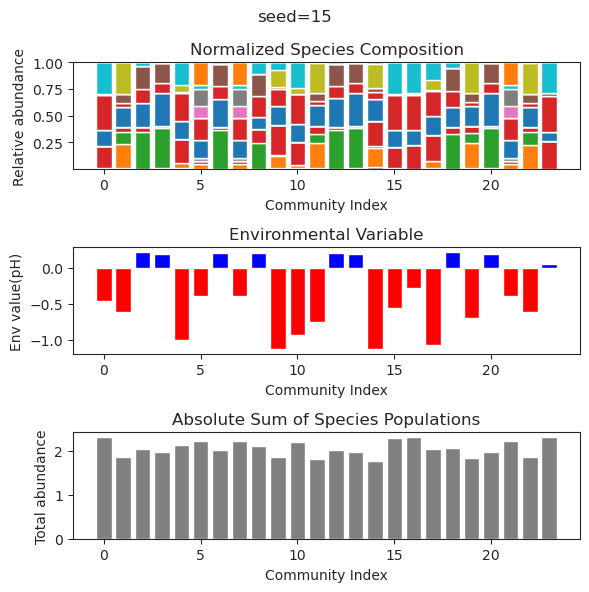

{'species': array([ 4.38478935e-025,  3.28947120e-010, -1.03144504e-079,
        1.73830756e-158, -2.96439388e-323,  1.47831067e-030,
        1.78795536e-042,  3.70393244e-025, -6.44549053e-293,
        1.01461295e-009,  5.70471933e-025,  1.42952837e+000,
        6.78747308e-024,  2.28030235e-146,  6.71270114e-059,
        8.04848080e-025,  1.05679299e+000,  7.91739395e-098,
       -6.62322212e-101,  1.33176111e-014,  8.02468315e-159,
        1.74230197e-218,  3.57616721e-028,  8.44018067e-020]), 'env': array([1.18627357])}
{'species': array([ 4.38478935e-025,  3.28947120e-010, -1.03144504e-079,
        1.73830756e-158, -2.96439388e-323,  1.47831067e-030,
        1.78795536e-042,  3.70393244e-025, -6.44549053e-293,
        1.01461295e-009,  5.70471933e-025,  1.42952837e+000,
        6.78747308e-024,  2.28030235e-146,  6.71270114e-059,
        8.04848080e-025,  1.05679299e+000,  7.91739395e-098,
       -6.62322212e-101,  1.33176111e-014,  8.02468315e-159,
        1.74230197e-218,  3.576

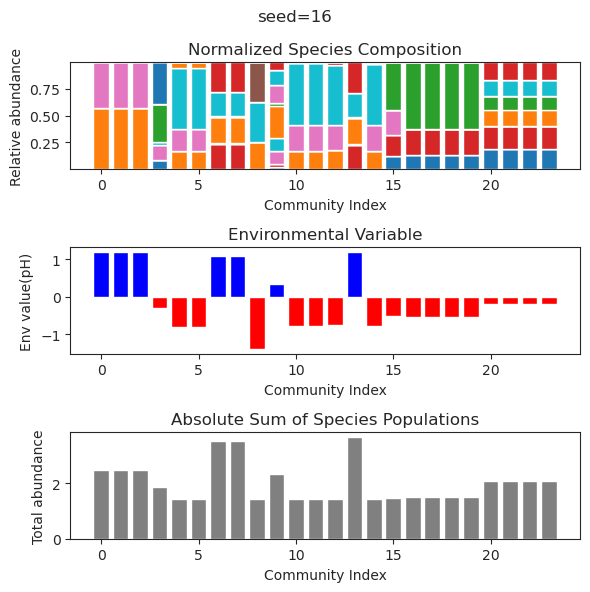

{'species': array([ 2.23105479e-01,  3.05116688e-02,  2.06007045e-31,  1.89060508e-35,
       -2.27148300e-31,  2.25118477e-30,  7.75005908e-05,  6.47547369e-01,
        9.66668440e-30,  4.57788060e-01, -5.36886015e-43,  6.02171078e-01,
       -7.76040925e-69, -9.55197249e-47, -1.02364758e-70,  4.18914955e-47,
        2.70364295e-65, -1.99080129e-75,  1.43596192e-75,  1.25966609e-52,
       -5.03756037e-47,  8.99695947e-02,  4.49058493e-70, -5.68990166e-68]), 'env': array([-0.68723457])}
{'species': array([ 2.23078018e-01,  3.05317502e-02,  9.76034616e-27,  4.26100764e-34,
        5.88381946e-28, -3.98732103e-28,  1.45880027e-04,  6.47544995e-01,
        1.92657781e-28,  4.57751660e-01, -2.04570412e-49,  6.02161229e-01,
       -3.57288288e-84, -6.59185202e-57, -6.69612977e-81, -1.80881063e-44,
       -4.33465683e-70,  7.60251671e-84,  2.60479808e-81, -1.75596284e-46,
        4.47314317e-55,  8.99571981e-02,  1.45265197e-80, -5.39799696e-81]), 'env': array([-0.6872091])}
{'species': arr

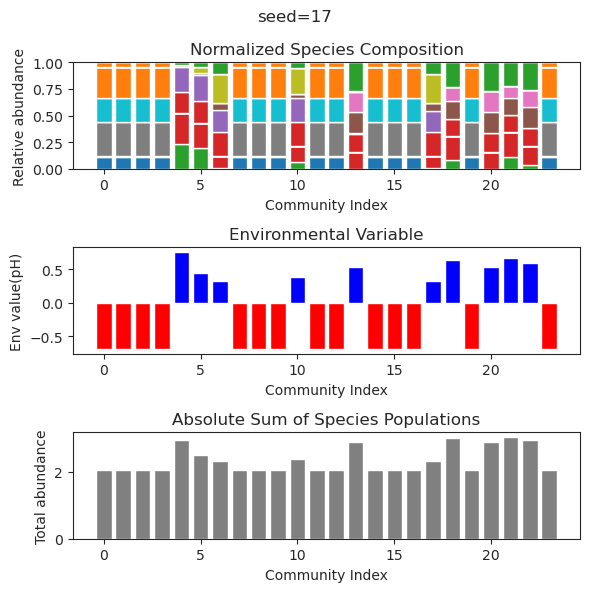

{'species': array([ 1.95566290e-01,  1.11866380e-42,  5.00923942e-45,  4.48898315e-34,
       -2.05363127e-46,  3.06092680e-46,  7.42302923e-29, -1.15298073e-49,
        3.02085059e-68,  6.48880992e-01, -1.18018654e-60,  3.39834988e-01,
        3.21254700e-26,  9.14876602e-65,  4.22541417e-41,  5.49092252e-01,
        6.73181897e-02,  1.82471558e-66,  1.03323215e-01,  1.27056237e-37,
        1.44402488e-01, -3.36095726e-70, -3.82866922e-70, -9.55018205e-65]), 'env': array([-0.83420598])}
{'species': array([ 1.95566290e-01, -3.65638772e-45, -9.96956955e-76,  1.82027569e-32,
       -4.57121346e-53,  1.15743201e-62, -6.95811791e-28,  1.39137527e-52,
       -1.80177589e-98,  6.48880992e-01,  3.75364806e-81,  3.39834988e-01,
        4.17456794e-25, -7.76515656e-86,  1.48694827e-34,  5.49092252e-01,
        6.73181897e-02,  2.78858722e-92,  1.03323215e-01, -5.27937173e-35,
        1.44402488e-01,  6.61426225e-95,  1.84765462e-96,  1.52222379e-77]), 'env': array([-0.83420598])}
{'species': ar

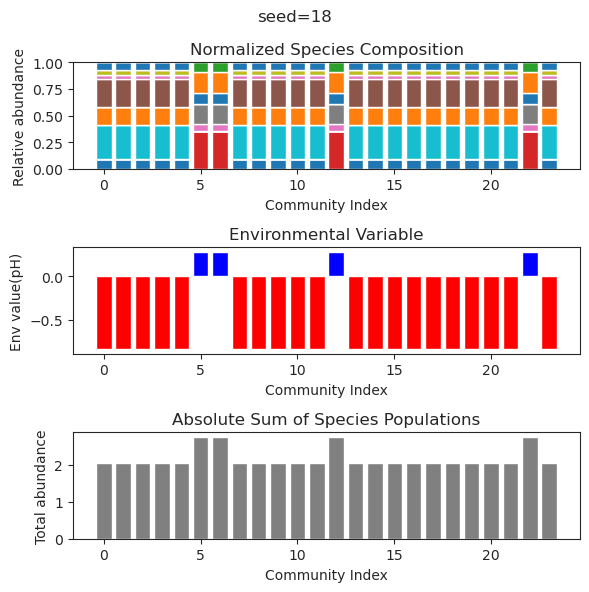

{'species': array([-5.69553474e-036, -8.66285367e-041, -4.99275931e-033,
        3.55563770e-001, -8.74350433e-055,  7.01501418e-001,
        5.30727872e-001,  5.27667482e-001,  2.64180868e-002,
        6.34975575e-053,  9.88131292e-324, -1.35434370e-301,
        2.92191172e-001,  1.68191188e-001,  2.17721973e-001,
        3.31029056e-269,  1.76955940e-074, -2.06181857e-303,
        1.33003108e-237, -1.17625560e-196, -1.88554624e-186,
        2.26594006e-077, -1.99962245e-258,  1.29256884e-091]), 'env': array([0.42864395])}
{'species': array([-5.93789215e-032,  8.36716306e-297, -3.65609359e-060,
        3.55565052e-001, -1.03458033e-230,  7.01501081e-001,
        5.30728791e-001,  5.27672407e-001,  2.64139949e-002,
       -3.48374815e-034,  0.00000000e+000,  5.63353412e-319,
        2.92191864e-001,  1.68193538e-001,  2.17717977e-001,
       -3.38555454e-287,  4.11654520e-072,  1.49379221e-312,
        1.37928526e-238, -3.19558213e-204, -3.19698787e-194,
       -2.99953704e-075, -2.811

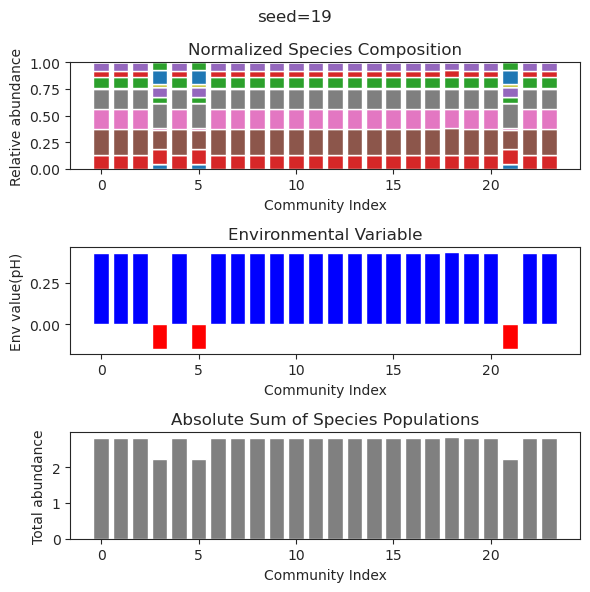

{'species': array([ 3.20232481e-001, -1.43455713e-091, -1.09927353e-118,
       -1.00588978e-048,  3.63076505e-001, -1.15414071e-137,
       -3.04056993e-027, -4.54429858e-094, -9.98751051e-109,
       -4.02687430e-123,  5.17373195e-001,  1.47862353e-113,
        1.68059427e-087, -2.05155781e-096,  2.22481604e-001,
        3.00462703e-001, -5.83332915e-070,  6.06438627e-048,
        3.48751482e-117,  3.83170740e-096,  7.31076258e-002,
        2.80283602e-002,  2.49455239e-050,  1.03583144e-001]), 'env': array([-1.1725765])}
{'species': array([ 3.20232481e-001, -1.14455430e-123,  2.30428281e-179,
       -4.31502345e-066,  3.63076505e-001,  9.72900812e-204,
       -7.75021893e-029, -1.74013469e-138,  9.06819309e-164,
        1.86003519e-170,  5.17373195e-001, -2.45541569e-170,
        1.64813872e-121, -1.80408391e-136,  2.22481604e-001,
        3.00462703e-001,  6.15322240e-100, -4.21252401e-068,
        8.98541342e-179, -1.15033704e-148,  7.31076258e-002,
        2.80283602e-002,  3.602

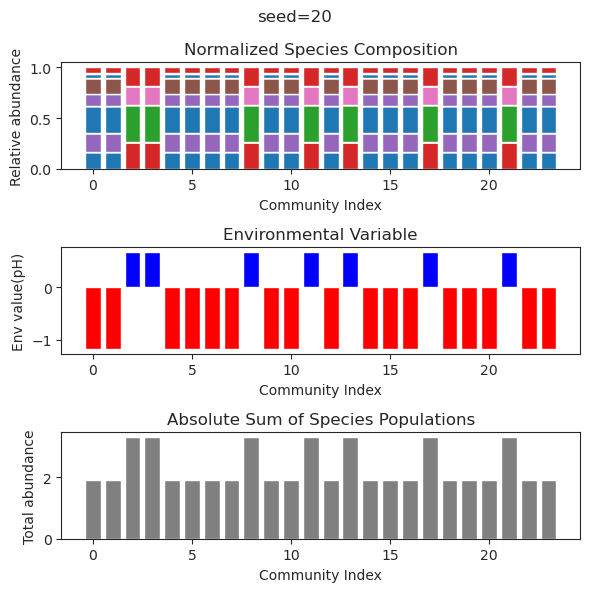

{'species': array([ 1.29478580e-001,  1.97798379e-201,  3.43963300e-001,
       -4.94065646e-324,  1.77616600e-320,  2.46878820e-005,
        0.00000000e+000,  4.86885036e-151,  2.08744965e-118,
        1.60889368e-030,  5.43472210e-323,  4.94065646e-324,
        1.50216394e-140,  1.43446492e-207,  4.81470189e-214,
        6.77275799e-078,  7.55207549e-002,  0.00000000e+000,
       -2.96439388e-323,  4.17863298e-001,  5.18524104e-148,
        1.93862123e-001,  6.38529806e-001,  1.55063482e-277]), 'env': array([-1.01991911])}
{'species': array([ 1.00354301e-001,  2.02807635e-199,  8.41638842e-002,
        4.94065646e-324,  7.66280851e-316,  6.58449952e-001,
       -4.94065646e-324,  1.54571903e-150,  3.47270780e-118,
        3.33252858e-028, -5.92878775e-323, -1.97626258e-323,
        8.03505844e-141,  2.27517847e-204,  8.72952684e-216,
        4.88656072e-082,  2.91283188e-001,  3.16202013e-322,
       -1.77863633e-322,  3.19932781e-001,  9.30299984e-145,
        4.89292555e-002,  3.97

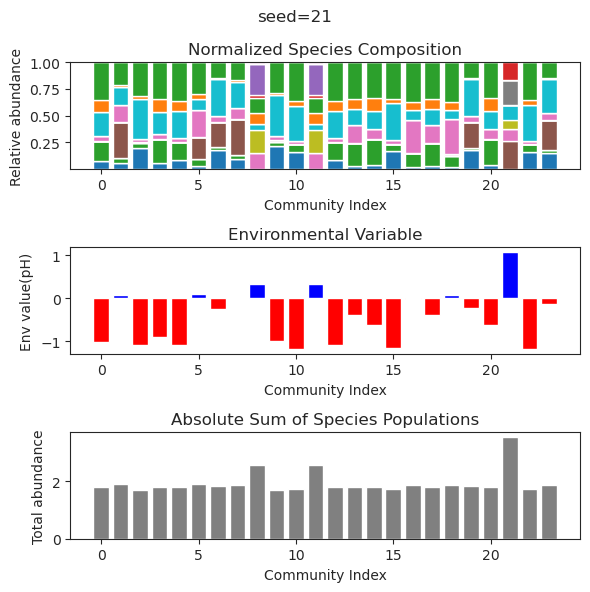

{'species': array([ 2.93094570e-01, -5.07726675e-44,  1.64852863e-65, -3.12913892e-52,
        9.25304276e-20,  9.85658388e-86,  3.38667818e-01,  1.94450818e-01,
       -1.24241892e-47,  1.90609151e-84,  1.31357150e-01, -9.09412399e-54,
       -4.04726733e-47, -6.56859194e-71,  3.05073331e-19,  4.57007395e-01,
       -6.32173261e-90, -1.49058070e-27,  2.28895813e-01,  1.28728248e-01,
        2.27672497e-85,  8.96223296e-79, -6.03875706e-81,  1.50132484e-55]), 'env': array([-1.38872268])}
{'species': array([ 2.93094570e-001, -3.43880722e-084,  1.98483822e-084,
       -6.01444630e-062,  1.11653065e-016,  8.52745468e-119,
        3.38667818e-001,  1.94450818e-001, -1.08200847e-054,
       -7.40270127e-116,  1.31357150e-001, -2.34053187e-066,
        1.37763001e-051, -1.05440238e-091, -1.87366675e-019,
        4.57007395e-001,  1.89906587e-122, -4.48806405e-031,
        2.28895813e-001,  1.28728248e-001, -9.87412275e-119,
       -1.11926376e-106,  4.87031605e-112,  5.33389146e-069]), 'env'

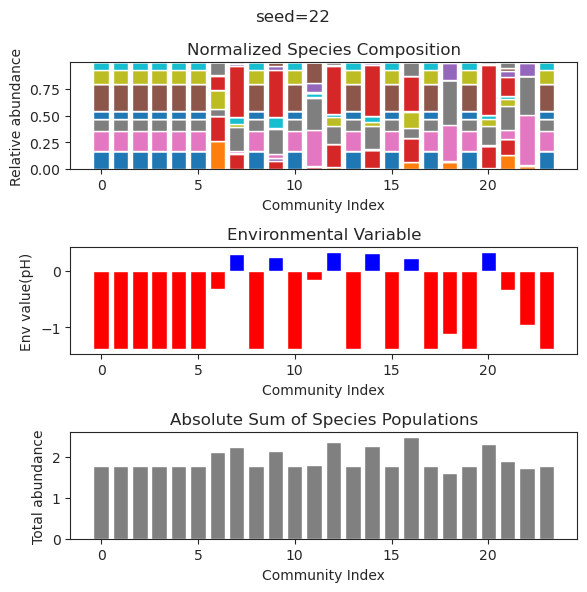

{'species': array([-2.44960924e-062,  7.07387686e-116,  2.85361532e-094,
        1.71335230e-001,  7.08024451e-002,  1.67288355e-054,
        5.14778956e-001,  1.52768693e-001,  7.91536138e-183,
        1.20581409e-001,  4.81509082e-001,  1.92795171e-037,
        4.51575234e-001, -6.37438093e-078,  1.35024886e-001,
        2.99424328e-090, -4.65912663e-253, -7.25849098e-203,
        2.41650305e-096, -1.28935502e-050,  3.74960317e-001,
        1.81867904e-001, -3.24067379e-038, -1.03921373e-206]), 'env': array([0.40717542])}
{'species': array([-1.11372668e-053,  5.20895715e-106,  9.76564377e-089,
        1.71335230e-001,  7.08024451e-002,  7.40503250e-051,
        5.14778956e-001,  1.52768693e-001,  4.55791352e-172,
        1.20581409e-001,  4.81509082e-001, -5.61837203e-038,
        4.51575234e-001,  8.31779605e-077,  1.35024886e-001,
        1.05889086e-095,  8.07556338e-255,  1.00817261e-186,
        1.16371437e-084, -2.97115498e-044,  3.74960317e-001,
        1.81867904e-001, -5.762

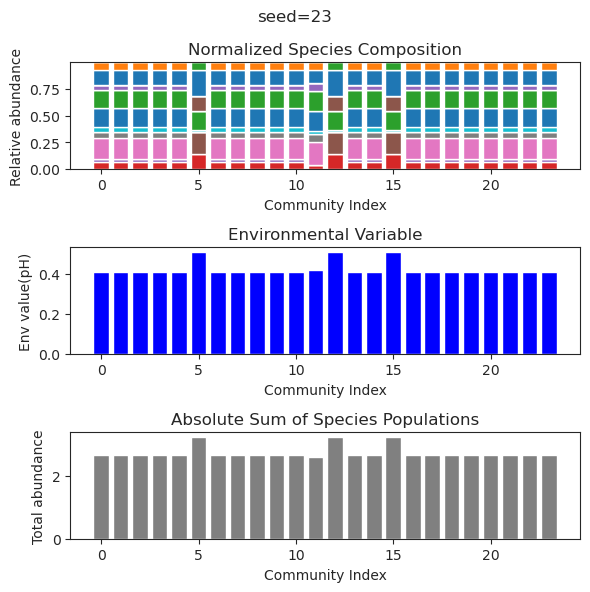

{'species': array([-2.67250796e-99, -5.53436145e-51, -2.77660828e-84, -1.08427255e-47,
        1.14566275e-01,  5.28149171e-35,  3.17545375e-55,  1.54192346e-47,
       -6.04317396e-80,  1.36614156e+00, -4.04165899e-99,  4.88710576e-48,
       -2.29267381e-37, -5.09572671e-78, -3.30461619e-91,  6.16274844e-02,
        7.90828173e-70,  1.47920298e-56,  5.55653018e-01,  8.74442228e-38,
        9.84681803e-01,  1.77300993e-96,  9.50145547e-91,  7.85064538e-15]), 'env': array([0.67074792])}
{'species': array([ 7.80072459e-73, -3.23075065e-43, -1.82206266e-64, -7.70565170e-36,
        1.14566275e-01, -6.91449125e-32,  1.47303837e-35,  1.25558778e-45,
        2.34982630e-51,  1.36614156e+00, -6.99033515e-77, -5.24792376e-45,
       -1.66678079e-26,  8.11524722e-48,  9.65523525e-70,  6.16274844e-02,
       -3.23380235e-57, -2.88025821e-55,  5.55653018e-01,  2.55823044e-32,
        9.84681803e-01, -3.64620607e-70, -3.17502106e-64,  1.32332806e-14]), 'env': array([0.67074792])}
{'species': arra

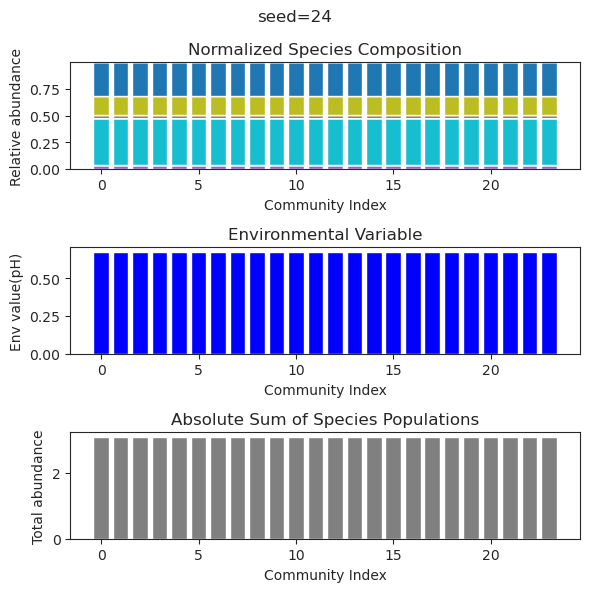

{'species': array([1.69597640e-001, 6.76159913e-203, 1.59974443e-001, 1.53139286e-001,
       8.51323840e-002, 1.42022363e-121, 1.34012230e-036, 2.08813881e-001,
       2.89942783e-001, 3.24740750e-170, 1.64481337e-180, 2.97785311e-117,
       1.28359851e-241, 0.00000000e+000, 1.24421275e-019, 2.64729055e-001,
       3.27308247e-001, 5.53032900e-010, 2.47543708e-304, 5.14104329e-012,
       1.80008107e-001, 1.63412499e-001, 0.00000000e+000, 3.40263191e-028]), 'env': array([-0.27039749])}
{'species': array([1.71006755e-001, 8.64538129e-204, 1.63126346e-001, 1.50702646e-001,
       8.07754337e-002, 8.48733839e-121, 3.54620035e-032, 2.11300057e-001,
       2.87866670e-001, 5.09008918e-174, 1.36241755e-180, 2.58831834e-118,
       1.08934108e-242, 0.00000000e+000, 1.99603643e-020, 2.68036339e-001,
       3.31528927e-001, 7.41067499e-011, 2.07784635e-305, 6.06992597e-008,
       1.79419556e-001, 1.55220419e-001, 0.00000000e+000, 1.23156189e-025]), 'env': array([-0.27804265])}
{'species': ar

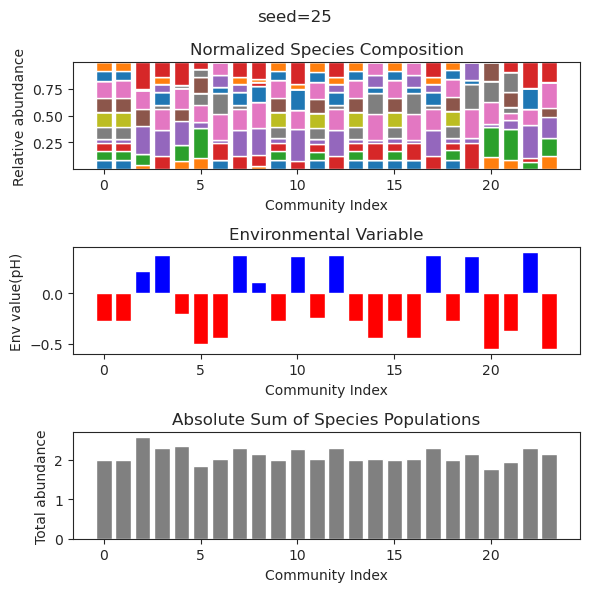

{'species': array([3.69648530e-143, 3.20316512e-005, 1.72894148e-003, 4.26920426e-001,
       9.55658207e-007, 2.01319866e-001, 2.83125684e-108, 7.79865393e-020,
       8.73591008e-002, 1.34685937e-200, 3.98268505e-001, 6.16625775e-041,
       3.57111485e-050, 5.06743996e-027, 9.00049249e-009, 3.06039260e-001,
       4.45032279e-001, 1.05752158e-022, 1.63662964e-001, 3.05008420e-033,
       1.12373111e-091, 4.16452477e-005, 5.16994148e-150, 3.26998575e-027]), 'env': array([0.16387338])}
{'species': array([1.50030046e-155, 3.56486905e-005, 1.89494735e-003, 4.24927481e-001,
       7.36218124e-007, 2.02947715e-001, 1.20690898e-093, 3.58465231e-013,
       8.21530532e-002, 3.59376177e-194, 4.10802212e-001, 1.23524210e-027,
       2.04979789e-048, 3.16960082e-032, 2.93787780e-011, 2.96177414e-001,
       4.43494156e-001, 1.24932524e-025, 1.62445204e-001, 3.41985495e-041,
       9.46561338e-103, 3.02708644e-005, 5.37015656e-158, 2.28991916e-025]), 'env': array([0.16000566])}
{'species': arra

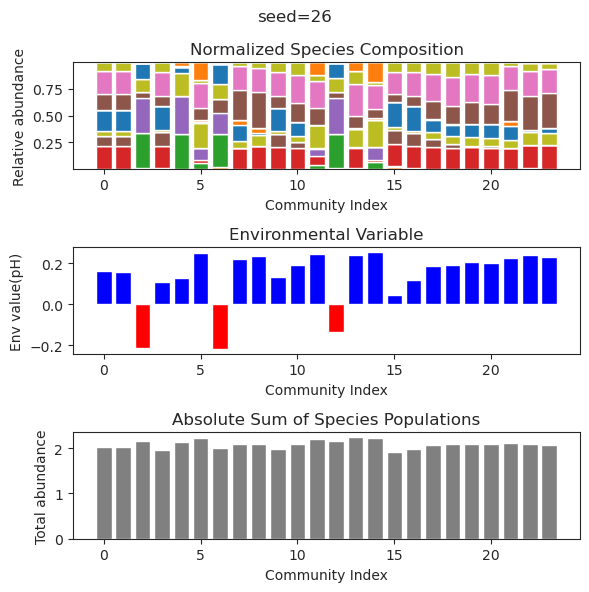

{'species': array([ 1.52199058e-40,  3.37119397e-01, -2.86389621e-67, -8.18161142e-65,
        5.84463988e-36,  9.51258578e-38,  4.44193209e-01, -5.04458586e-41,
       -4.42476593e-70, -4.24906947e-14, -2.42187734e-61,  5.79818304e-01,
        3.28735996e-33, -4.89987593e-73,  5.17651832e-01,  1.07867331e-01,
       -8.67671949e-57,  7.17970060e-49, -1.16957457e-72,  1.67317811e-55,
       -1.92560409e-58,  4.57987814e-22, -4.52408817e-74,  6.95884244e-39]), 'env': array([-1.18250014])}
{'species': array([-6.03025035e-41,  3.37119397e-01,  1.23208115e-52, -2.32094311e-51,
       -1.90752992e-38, -1.48875239e-41,  4.44193209e-01,  5.23813302e-42,
       -7.04910044e-53,  3.66650864e-14,  3.79079908e-49,  5.79818304e-01,
        1.64849343e-34,  1.34828444e-53,  5.17651832e-01,  1.07867331e-01,
        5.25057365e-47, -1.45000114e-36, -1.06267770e-53,  9.60558527e-49,
        7.10360266e-47,  1.01088859e-21, -1.60235347e-48, -5.89458370e-40]), 'env': array([-1.18250014])}
{'species': ar

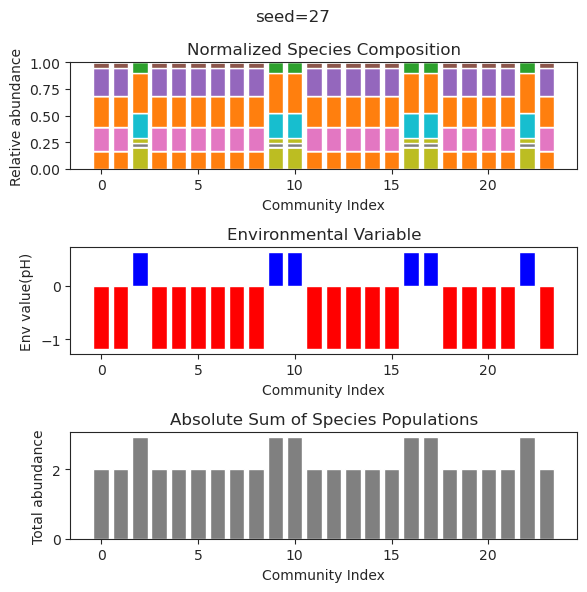

{'species': array([-1.08926822e-042,  1.92289280e-041,  2.01018930e-001,
        1.34067711e-046, -4.10319246e-044,  6.22307198e-001,
        1.93312077e-001, -1.43024940e-138, -6.68490082e-109,
       -1.02479807e-047,  4.71476358e-001,  5.38776566e-001,
        7.14686405e-014,  4.67431516e-040,  6.66763090e-042,
       -2.17803167e-126,  5.23541475e-111,  9.38967053e-002,
       -1.05084698e-118, -3.24486085e-114,  1.62524459e-012,
       -1.00327222e-078,  1.64824068e-137,  9.03476561e-001]), 'env': array([0.50728795])}
{'species': array([-1.18882194e-036,  8.98848025e-039,  2.01018930e-001,
        2.01557388e-070, -2.11594461e-042,  6.22307198e-001,
        1.93312077e-001,  5.75330907e-139,  9.84956801e-107,
        9.74217995e-065,  4.71476358e-001,  5.38776566e-001,
        1.27051418e-018,  6.15769956e-040, -2.45075121e-040,
       -2.58777421e-127,  2.40855358e-032,  9.38967053e-002,
       -9.86598735e-115,  3.46861913e-113,  2.36233146e-012,
        1.42996853e-077, -4.958

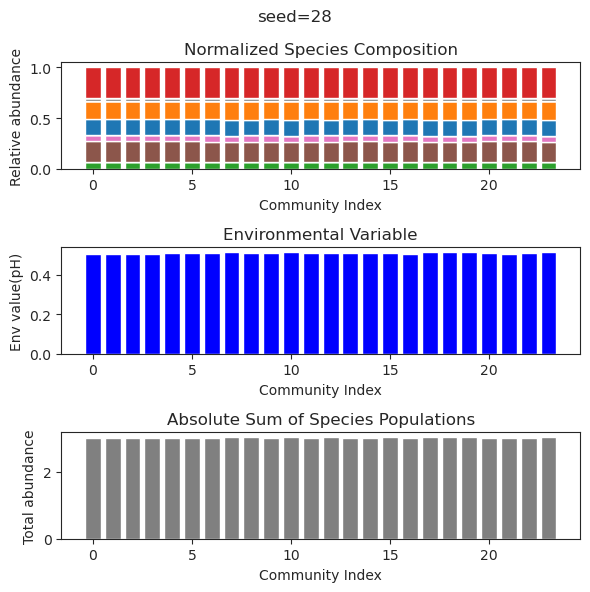

{'species': array([-1.83560029e-38,  2.20511794e-01, -4.86377205e-33,  1.14791147e-76,
        5.10252325e-09, -9.73828815e-70,  3.31429179e-47,  2.97963769e-01,
       -3.51792230e-73,  2.74895247e-54,  3.43331192e-01,  2.07894430e-01,
       -1.00169485e-91,  1.81999642e-92,  6.79830333e-01, -6.22693366e-91,
        1.08284222e-62,  6.93284126e-15,  1.59165016e-81, -3.82508812e-63,
        8.87133359e-02,  5.64759750e-67,  1.28908209e-80,  1.53099125e-42]), 'env': array([-0.60288593])}
{'species': array([-2.54044022e-37,  2.20511785e-01, -1.87597765e-41, -2.49936343e-39,
        7.46907010e-08, -1.11330477e-39,  7.30111132e-38,  2.97963760e-01,
        3.59224315e-32, -2.72473901e-35,  3.43331190e-01,  2.07894386e-01,
       -2.73221732e-34, -3.67231442e-93,  6.79830319e-01,  5.85391739e-97,
        5.50233016e-65,  8.60484394e-15, -8.68405071e-81, -6.37191286e-59,
        8.87133554e-02,  1.84278189e-66, -7.46163528e-80, -4.30284222e-41]), 'env': array([-0.60288589])}
{'species': ar

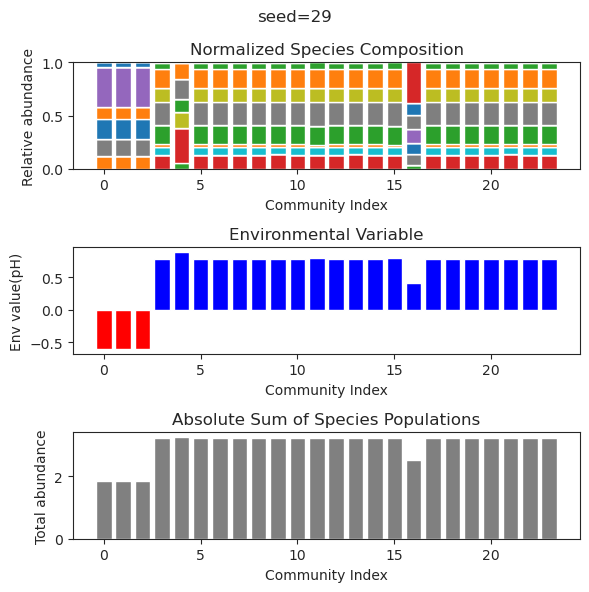

{'species': array([-1.45281686e-037,  1.01447258e-095, -9.85384543e-039,
        7.36204722e-050,  9.02030046e-043, -2.43048539e-114,
       -5.64295816e-045, -4.54993093e-045,  5.23053527e-001,
       -9.13158653e-026,  8.72246061e-002, -3.39233354e-110,
        1.06383421e+000, -1.77208081e-040,  1.59979894e-100,
       -1.46022956e-042,  2.03789779e-081,  3.51961618e-076,
        4.61768505e-074,  1.53096417e-079,  1.46641386e-085,
        1.04192230e+000, -4.52605324e-069,  8.56106108e-001]), 'env': array([0.80606585])}
{'species': array([-1.45281686e-037,  1.01447258e-095, -9.85384543e-039,
        7.36204722e-050,  9.02030046e-043, -2.43048539e-114,
       -5.64295816e-045, -4.54993093e-045,  5.23053527e-001,
       -9.13158653e-026,  8.72246061e-002, -3.39233354e-110,
        1.06383421e+000, -1.77208081e-040,  1.59979894e-100,
       -1.46022956e-042,  2.03789779e-081,  3.51961618e-076,
        4.61768505e-074,  1.53096417e-079,  1.46641386e-085,
        1.04192230e+000, -4.526

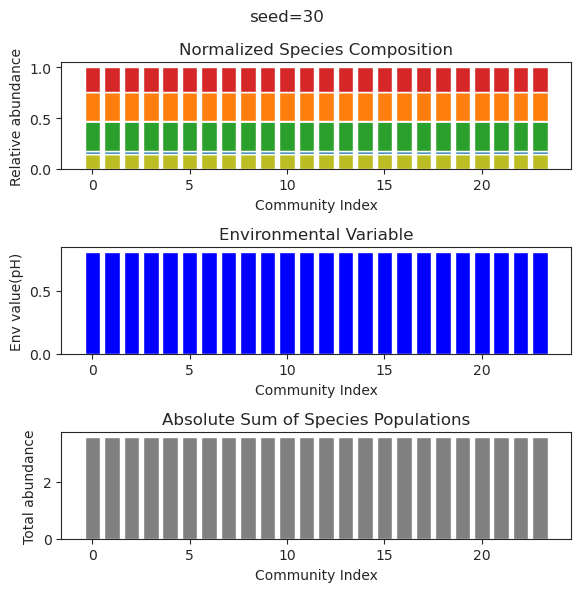

{'species': array([ 2.48035940e-006,  3.08783744e-001,  1.15550806e-030,
        1.20863854e-030,  2.69967098e-030,  1.40057592e-032,
        2.81775232e-001, -2.24657957e-098,  2.64391126e-001,
       -2.18372736e-081,  6.09720149e-103,  1.86450245e-117,
        1.52895201e-017,  1.35194595e-001,  4.82113732e-001,
       -4.59758600e-114,  1.80670132e-001, -3.06912126e-028,
       -3.21132282e-116,  1.59447573e-081, -2.73308060e-084,
        1.92419993e-033,  7.17113816e-002,  3.33158589e-109]), 'env': array([-1.21731132])}
{'species': array([ 8.96571492e-07,  3.08784630e-01, -2.34587500e-35,  3.76008264e-38,
       -9.54840054e-67, -1.62964221e-73,  2.81776108e-01,  4.18536575e-63,
        2.64391806e-01,  5.71489638e-35, -3.22095892e-66, -3.91157778e-73,
        1.40323876e-24,  1.35195401e-01,  4.82113100e-01,  1.10574308e-72,
        1.80669224e-01, -1.38787739e-51,  1.47597586e-72, -2.92070231e-61,
       -6.28886117e-51, -1.22821878e-58,  7.17119980e-02, -1.39751309e-72]), 'env'

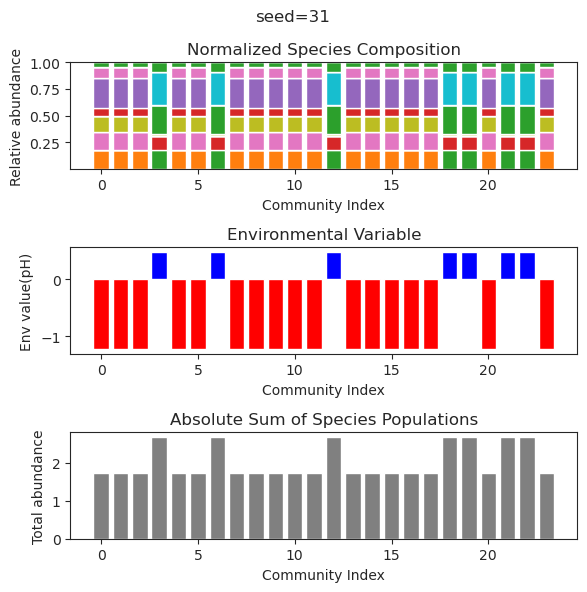

{'species': array([-1.62677480e-030, -3.31573703e-156,  3.17677831e-001,
       -9.34815949e-254,  8.32488134e-011,  8.25714659e-020,
       -1.53426950e-098,  4.22248084e-001,  5.88753075e-001,
        2.11508327e-286,  0.00000000e+000, -2.63072855e-100,
       -4.28320261e-244,  2.10256575e-294,  2.61160437e-283,
        6.09546546e-002, -8.90489376e-287,  1.35328744e-140,
        8.88954246e-001, -4.42631179e-147,  7.89554753e-001,
        8.52944233e-121,  8.01499442e-151,  3.50352024e-141]), 'env': array([0.82631933])}
{'species': array([-1.62677480e-030, -3.31573703e-156,  3.17677831e-001,
       -9.34815949e-254,  8.32488134e-011,  8.25714659e-020,
       -1.53426950e-098,  4.22248084e-001,  5.88753075e-001,
        2.11508327e-286,  0.00000000e+000, -2.63072855e-100,
       -4.28320261e-244,  2.10256575e-294,  2.61160437e-283,
        6.09546546e-002, -8.90489376e-287,  1.35328744e-140,
        8.88954246e-001, -4.42631179e-147,  7.89554753e-001,
        8.52944233e-121,  8.014

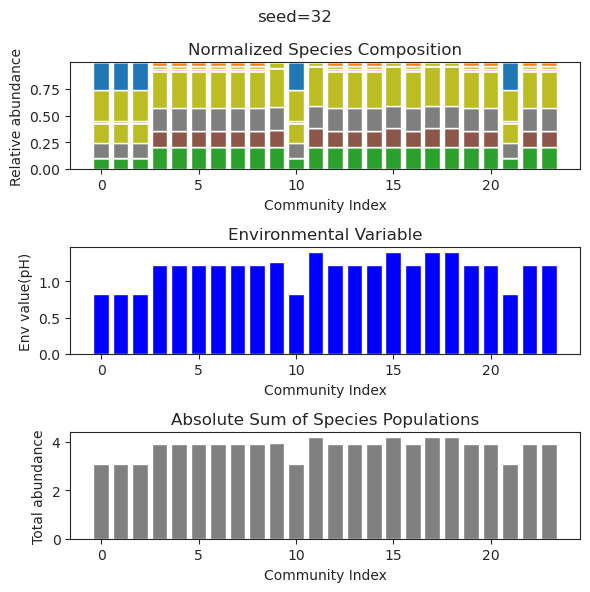

{'species': array([ 3.47157086e-01,  4.97346103e-91,  3.01653772e-01,  2.04316016e-25,
       -1.02806037e-99,  2.81227767e-58,  6.66819072e-01,  1.02252753e-92,
       -3.90884773e-70,  1.28783610e-85, -1.29480609e-43, -1.26433097e-78,
       -8.00130823e-98,  5.43861283e-97,  1.50540390e-01, -3.75963463e-37,
       -1.11432187e-77,  2.82510198e-83, -4.93252869e-67,  3.14148003e-29,
       -1.24608132e-89,  7.52582605e-31,  2.46631843e-01,  2.16596224e-01]), 'env': array([-1.53342756])}
{'species': array([ 3.47157086e-001,  3.62806938e-110,  3.01653772e-001,
        1.04405610e-028,  1.91648239e-112,  1.39366824e-064,
        6.66819072e-001, -1.37717324e-097, -5.79164249e-072,
       -1.65902199e-092,  6.00460379e-052,  8.65697457e-092,
       -1.01919796e-115,  2.45556098e-108,  1.50540390e-001,
        1.94705893e-038,  1.37048109e-094,  2.77896483e-097,
        2.43372157e-079, -2.73467222e-036,  7.15583409e-103,
       -1.63670632e-033,  2.46631843e-001,  2.16596224e-001]), 'env'

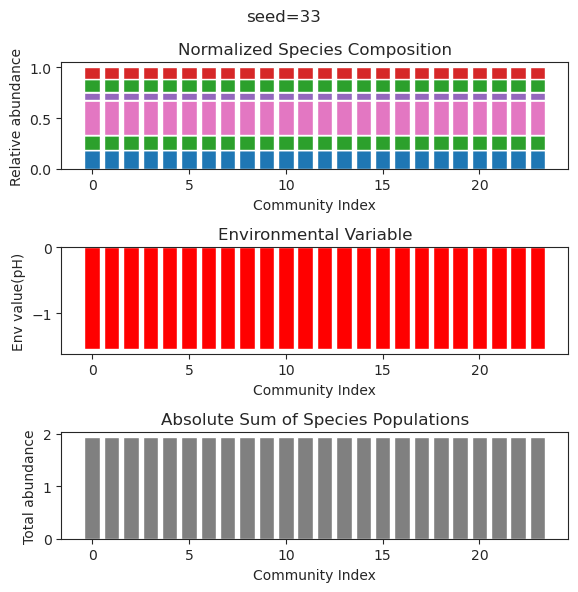

{'species': array([-2.08913835e-039,  3.61275846e-036, -7.46530593e-044,
        5.18377346e-134,  9.27299017e-117,  8.80551606e-001,
        1.06329367e-002,  8.94880707e-001, -2.24337818e-068,
       -1.31490804e-037,  1.55438681e-156, -3.01530532e-035,
       -2.76099846e-040,  3.79307696e-001,  2.94298608e-010,
        3.24294277e-124,  2.93452950e-001, -9.64629838e-087,
       -7.92382136e-085,  1.39482600e-059,  1.40910889e-039,
        2.25023748e-001,  2.83446636e-001,  1.69136678e-001]), 'env': array([0.63861831])}
{'species': array([-3.06961637e-147,  5.17343466e-032, -1.60419831e-046,
        2.53229852e-029, -8.19102972e-027,  8.80551658e-001,
        1.06325350e-002,  8.94880903e-001, -9.24830231e-038,
        2.23697034e-125,  2.71996157e-147,  2.27740567e-036,
       -9.22130350e-108,  3.79307861e-001,  5.51041644e-010,
       -6.30123715e-101,  2.93453075e-001,  3.21641069e-031,
       -1.17168737e-093, -6.28357340e-035, -2.03617694e-105,
        2.25023769e-001,  2.834

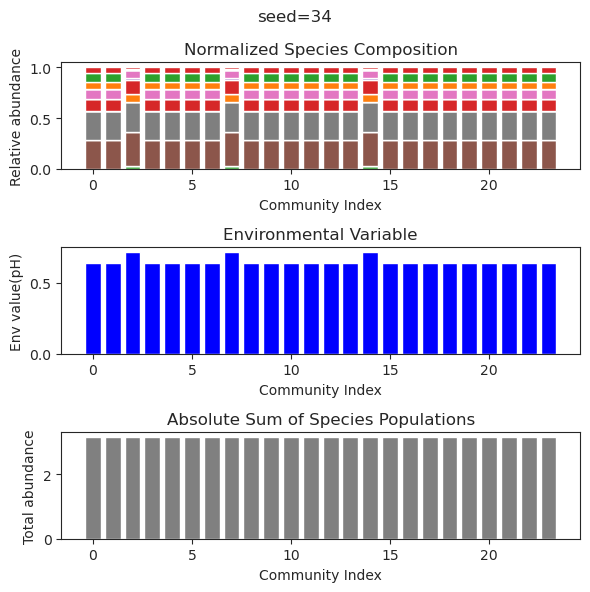

{'species': array([ 7.84955374e-37,  3.62940692e-01,  5.61862762e-38,  7.31930102e-29,
        2.87279186e-54,  1.28103961e-01, -7.49388601e-56, -6.27314520e-52,
       -6.56879121e-47,  6.60690515e-02,  3.78295166e-45, -5.45697807e-36,
        2.17702028e-30,  1.82036002e-26, -1.68686351e-52, -2.24593059e-42,
        1.40101578e-31,  8.79667445e-01, -2.66088161e-48, -3.58566285e-38,
        5.16228044e-01, -2.02953478e-17, -1.21168317e-51,  5.14544781e-53]), 'env': array([-1.44313029])}
{'species': array([ 4.71117059e-65,  3.62940692e-01, -3.32601738e-65, -3.48047539e-38,
       -2.85066498e-75,  1.28103961e-01, -2.11498788e-75,  1.23812029e-71,
        1.78499428e-59,  6.60690515e-02, -1.20547012e-52, -1.77480246e-39,
        3.59140045e-45, -9.70715767e-30,  2.07867404e-75, -1.81165735e-50,
       -6.42850276e-50,  8.79667445e-01, -3.28052137e-64, -3.62406398e-43,
        5.16228044e-01, -1.53002225e-22, -8.16017308e-64, -7.87524677e-70]), 'env': array([-1.44313029])}
{'species': ar

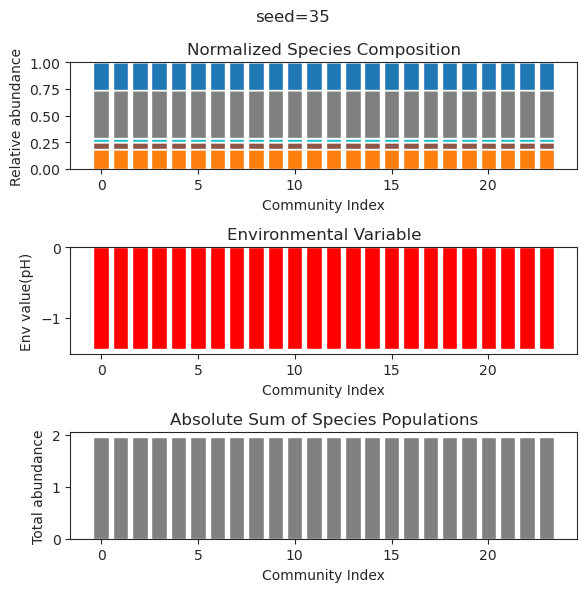

{'species': array([ 6.07553339e-32,  2.65043876e-01,  5.09034995e-31,  3.39244016e-48,
        1.97608843e-36, -1.98402990e-44, -6.94997455e-44,  4.11042772e-47,
        3.90472471e-01, -6.12110208e-53, -2.02931916e-59,  4.54966374e-01,
        3.18808745e-53, -3.67573351e-48,  9.25855039e-01,  2.52381129e-52,
       -7.92941775e-20,  4.30777879e-47,  1.86397108e-28,  5.57186918e-01,
        1.86826438e-52,  1.41255562e-39,  1.95649725e-50,  1.48820392e-58]), 'env': array([-1.13562571])}
{'species': array([-2.50042369e-33,  2.65043876e-01, -5.55000523e-31,  2.97715410e-44,
       -2.85454970e-33,  4.56966765e-45,  1.97819054e-44,  1.21610412e-47,
        3.90472471e-01,  1.55692425e-48,  1.15388849e-54,  4.54966374e-01,
       -2.84276710e-51,  2.44622588e-47,  9.25855039e-01, -1.08884418e-51,
        3.47627230e-19,  7.13996385e-48,  3.67903988e-27,  5.57186918e-01,
        3.16470268e-51, -1.58240791e-39,  1.12450388e-48, -1.90822355e-54]), 'env': array([-1.13562571])}
{'species': ar

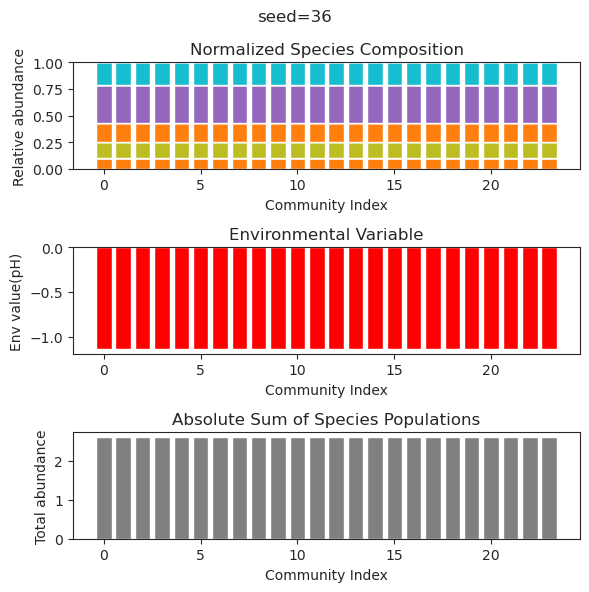

{'species': array([ 2.67484372e-34,  2.65043876e-01,  1.62667830e-33,  4.84390057e-42,
        1.50102680e-25, -4.40562357e-44,  2.96581695e-47,  2.21154955e-45,
        3.90472471e-01, -3.66591982e-34,  2.16299741e-46,  4.54966374e-01,
       -9.03036782e-43,  1.56592755e-38,  9.25855039e-01,  6.57289297e-38,
        6.29131494e-23,  4.91676317e-45, -8.82471028e-26,  5.57186918e-01,
        2.40027904e-39, -3.85285173e-40, -5.45914118e-39, -2.59261181e-46]), 'env': array([-1.13562571])}
{'species': array([ 2.67484372e-34,  2.65043876e-01,  1.62667830e-33,  4.84390057e-42,
        1.50102680e-25, -4.40562357e-44,  2.96581695e-47,  2.21154955e-45,
        3.90472471e-01, -3.66591982e-34,  2.16299741e-46,  4.54966374e-01,
       -9.03036782e-43,  1.56592755e-38,  9.25855039e-01,  6.57289297e-38,
        6.29131494e-23,  4.91676317e-45, -8.82471028e-26,  5.57186918e-01,
        2.40027904e-39, -3.85285173e-40, -5.45914118e-39, -2.59261181e-46]), 'env': array([-1.13562571])}
{'species': ar

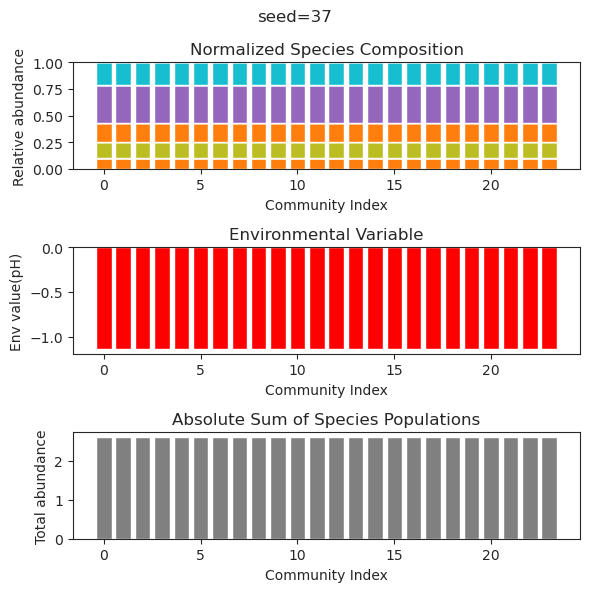

{'species': array([ 2.67484372e-34,  2.65043876e-01,  1.62667830e-33,  4.84390057e-42,
        1.50102680e-25, -4.40562357e-44,  2.96581695e-47,  2.21154955e-45,
        3.90472471e-01, -3.66591982e-34,  2.16299741e-46,  4.54966374e-01,
       -9.03036782e-43,  1.56592755e-38,  9.25855039e-01,  6.57289297e-38,
        6.29131494e-23,  4.91676317e-45, -8.82471028e-26,  5.57186918e-01,
        2.40027904e-39, -3.85285173e-40, -5.45914118e-39, -2.59261181e-46]), 'env': array([-1.13562571])}
{'species': array([ 2.67484372e-34,  2.65043876e-01,  1.62667830e-33,  4.84390057e-42,
        1.50102680e-25, -4.40562357e-44,  2.96581695e-47,  2.21154955e-45,
        3.90472471e-01, -3.66591982e-34,  2.16299741e-46,  4.54966374e-01,
       -9.03036782e-43,  1.56592755e-38,  9.25855039e-01,  6.57289297e-38,
        6.29131494e-23,  4.91676317e-45, -8.82471028e-26,  5.57186918e-01,
        2.40027904e-39, -3.85285173e-40, -5.45914118e-39, -2.59261181e-46]), 'env': array([-1.13562571])}
{'species': ar

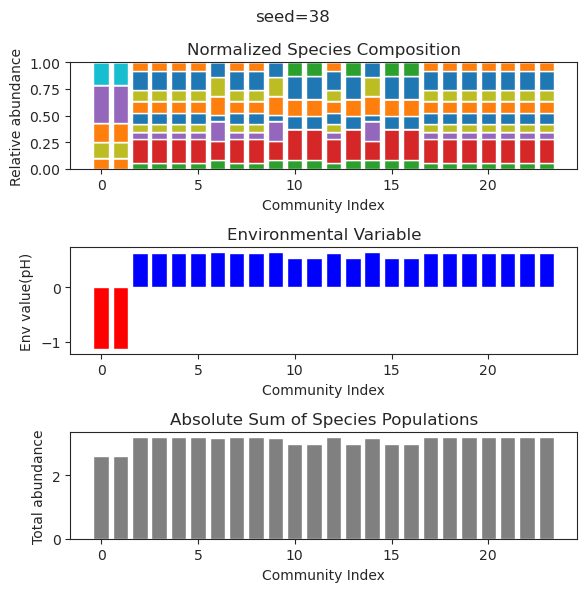

{'species': array([ 5.85607093e-272,  3.60734244e-003, -4.94065646e-324,
        5.68671879e-146,  7.26721455e-026,  6.46748301e-001,
        2.17794038e-046,  1.59537939e-004,  7.93784143e-069,
        6.35897031e-011,  5.82617932e-245,  5.43472210e-323,
        1.50793564e-216,  3.19938146e-001,  4.59365642e-001,
        2.22266502e-145,  3.99090030e-297,  3.74931329e-172,
        9.05594496e-245,  7.13340749e-001,  8.89318163e-323,
        2.36443993e-002,  1.09328796e-001,  1.26858536e-045]), 'env': array([0.22414964])}
{'species': array([3.66465944e-274, 5.19581351e-001, 2.96439388e-323, 1.98541732e-146,
       2.15808604e-025, 8.60427024e-002, 3.75226649e-047, 5.32236884e-002,
       1.90147834e-067, 6.10441462e-013, 9.58714613e-247, 4.94065646e-323,
       9.65748043e-215, 2.97544905e-002, 5.24958495e-001, 8.35932711e-147,
       4.06328863e-299, 4.72675584e-171, 7.82749845e-246, 5.18418792e-002,
       4.94065646e-324, 8.26403274e-002, 1.33357116e-001, 3.14950823e-044]), 'env':

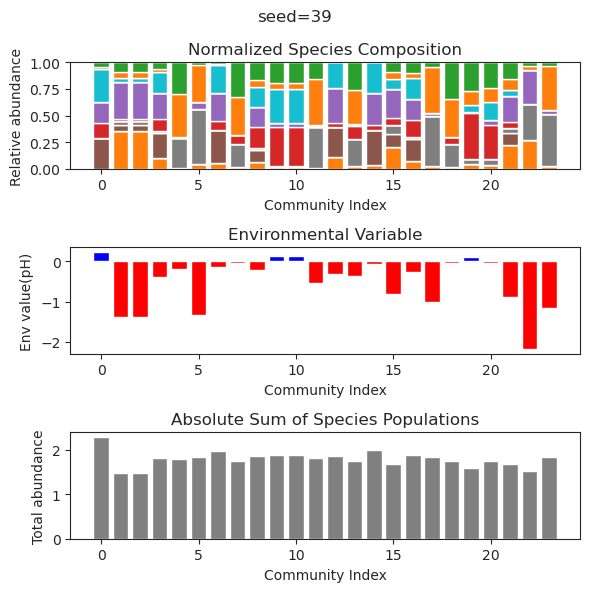

{'species': array([-5.18627348e-137,  2.62293442e-001,  4.85927559e-123,
       -2.04065221e-108,  6.28782171e-118,  3.87088955e-103,
        5.84648621e-002,  1.01519148e-077,  5.67464804e-002,
        3.32793335e-084, -2.98086381e-134,  6.69151593e-001,
        4.02681316e-001, -3.57449382e-148,  4.25155437e-076,
       -2.42777064e-089,  1.65160828e-046,  3.66951385e-121,
        2.24592403e-053,  4.20783352e-113,  4.04051448e-047,
        4.57207494e-148, -3.59456722e-099,  4.35517824e-001]), 'env': array([-0.63881035])}
{'species': array([ 1.95945145e-80,  2.62293442e-01, -6.44227183e-71,  4.23595815e-62,
       -4.30331274e-71,  1.58531675e-69,  5.84648621e-02,  5.29457170e-51,
        5.67464804e-02, -5.73753749e-47,  5.89029322e-79,  6.69151593e-01,
        4.02681316e-01, -2.63421612e-77, -2.25390323e-45,  3.52737900e-53,
       -1.60603655e-21, -1.76744023e-58, -1.75660642e-33, -8.95546665e-64,
       -1.74155336e-32, -5.09489140e-83,  7.61844638e-60,  4.35517824e-01]), 'env'

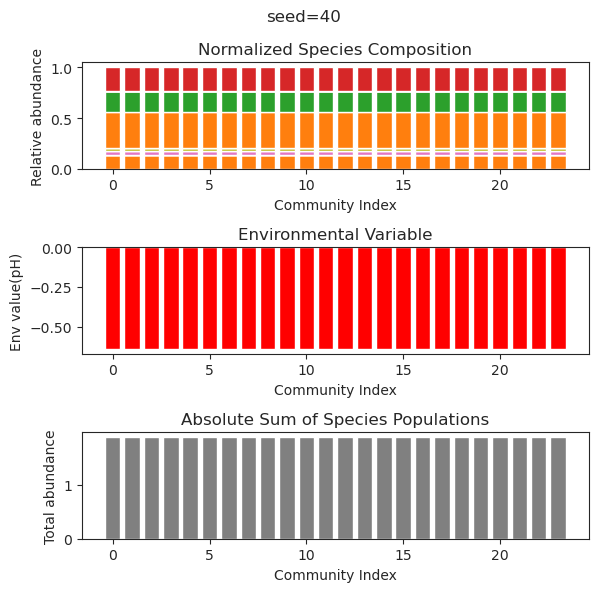

{'species': array([ 1.59712653e-01,  2.62993885e-01,  2.60145297e-71, -6.06720130e-44,
        6.78794551e-86, -1.35229721e-70,  5.92361423e-01,  1.35333120e-75,
       -3.58731738e-32, -2.21234999e-48,  2.85935703e-47,  2.92569125e-01,
       -1.47347778e-86, -7.22201494e-46,  2.53428028e-87,  2.13549416e-01,
        2.82314944e-01, -9.50049620e-67, -3.21658428e-62,  8.97701512e-02,
        3.66021572e-87,  1.01515058e-69, -9.11309468e-43, -2.50910616e-27]), 'env': array([-1.91318386])}
{'species': array([ 1.59712653e-001,  2.62993885e-001,  5.72979230e-080,
       -5.52198822e-047,  2.09696391e-091, -7.02653044e-077,
        5.92361423e-001,  6.90539721e-083,  5.03628923e-031,
        1.65308673e-060,  6.07705922e-055,  2.92569125e-001,
        9.35159027e-099, -7.41357545e-050,  1.65822857e-098,
        2.13549416e-001,  2.82314944e-001, -6.28668541e-075,
        2.20402440e-074,  8.97701512e-002, -3.59063199e-100,
       -4.88286075e-079, -2.84601095e-049,  4.84181544e-027]), 'env'

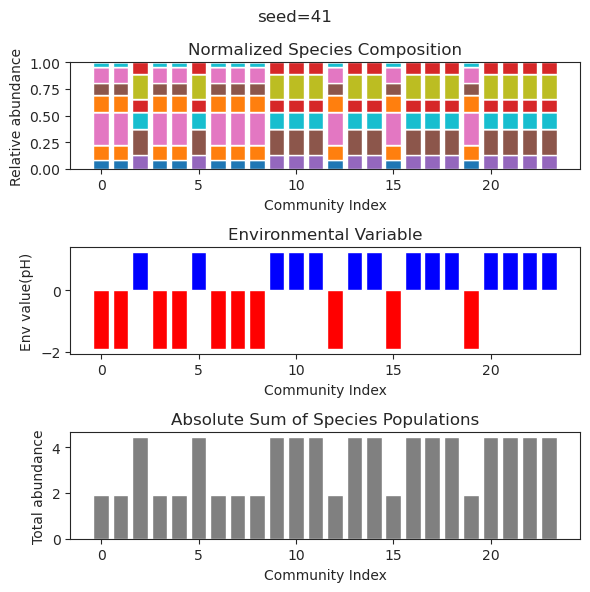

{'species': array([ 2.97401663e-01, -8.84644535e-33,  1.34495246e-02,  2.80854996e-01,
        4.12771767e-01,  3.49899806e-32,  8.94461076e-40, -6.55059493e-40,
       -3.55611273e-69,  2.86550101e-41,  4.19011466e-01, -4.21164532e-34,
       -7.72457020e-78,  3.58562315e-01, -1.19221101e-36,  4.42850168e-27,
        3.01127741e-01,  1.15820852e-84, -1.65104486e-67, -5.04191208e-79,
       -1.11999498e-46,  6.65345782e-75,  1.21925583e-81,  7.06878123e-71]), 'env': array([-1.41919664])}
{'species': array([ 2.97401663e-01,  1.44196910e-36,  1.34495337e-02,  2.80854990e-01,
        4.12771772e-01,  1.79737155e-37,  1.59997628e-45, -5.20176210e-44,
       -4.37004034e-34,  1.28884525e-33,  4.19011464e-01, -5.62612228e-32,
       -4.10900131e-83,  3.58562312e-01,  1.70755238e-33,  6.28323099e-23,
        3.01127738e-01, -6.85292092e-79,  4.73271257e-61, -1.09047143e-72,
        1.20744656e-41, -1.83491004e-61,  7.08573713e-79,  9.94248824e-60]), 'env': array([-1.41919663])}
{'species': ar

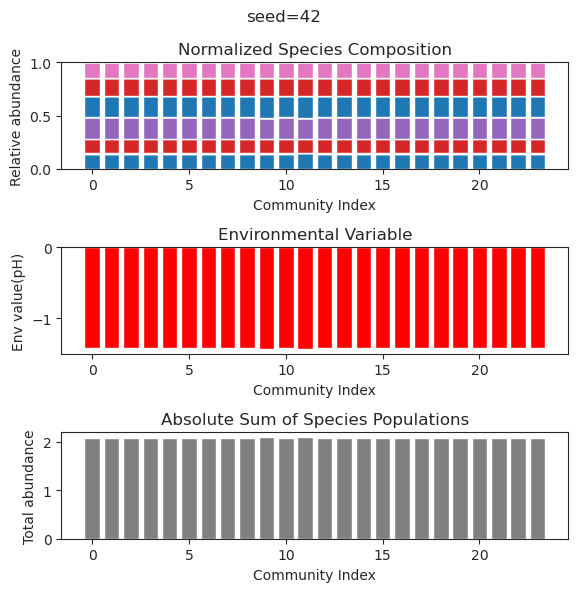

{'species': array([ 3.82735661e-030,  5.59346562e-032,  3.58909541e-002,
       -1.60265829e-134, -1.35198782e-209, -6.09442158e-035,
       -2.97135521e-110, -3.15468336e-116,  5.58142666e-202,
        3.48848139e-001, -3.80394258e-192, -1.23280884e-116,
       -2.70899984e-041,  3.42262766e-271,  1.99899708e-001,
        8.36668949e-001, -2.13546813e-204,  1.18249463e-001,
       -3.06954765e-219,  4.25084256e-002,  6.18413988e-034,
        1.92110444e-001,  8.24238950e-001,  1.02654716e-078]), 'env': array([0.48217787])}
{'species': array([ 1.07050918e-032,  7.03409559e-032,  3.59071087e-002,
        6.29376425e-032, -3.31068245e-171, -3.28521279e-032,
       -2.24849636e-033,  1.76694548e-100, -4.61585425e-134,
        3.48842069e-001, -2.86204090e-140,  3.23495792e-108,
       -2.71027098e-135, -9.11415047e-178,  1.99895117e-001,
        8.36643580e-001, -1.27493940e-029,  1.18244358e-001,
       -3.50765325e-164,  4.25318145e-002, -8.89413526e-033,
        1.92125274e-001,  8.242

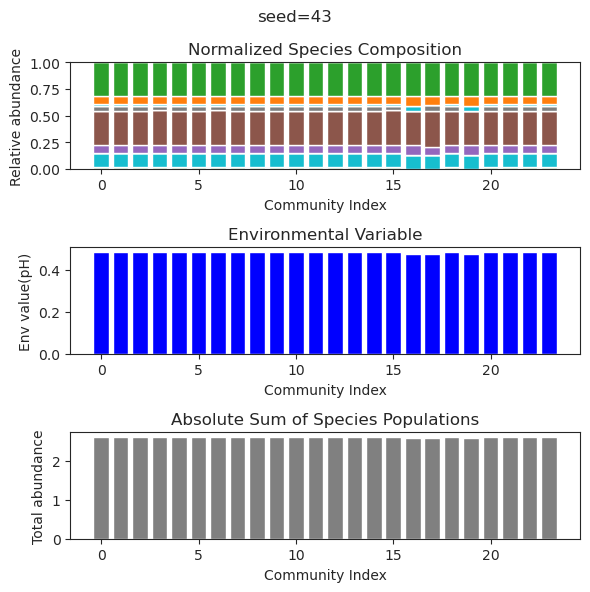

{'species': array([ 4.10451993e-27,  4.14880907e-01, -7.48169435e-49,  8.66677250e-01,
        4.69495960e-29,  1.27126929e-42,  9.35904359e-54,  2.58294977e-33,
       -5.31525298e-56,  4.62574473e-50, -2.62506786e-31,  1.14592545e-31,
       -9.54818644e-71, -4.07108555e-17,  1.45868957e-01, -1.49507419e-54,
        1.57622265e-70,  4.74545632e-01, -5.22082964e-35, -4.77756284e-41,
       -2.75275922e-63, -4.34330163e-46,  2.22902985e-28,  1.82025382e-22]), 'env': array([-1.73238758])}
{'species': array([ 3.11756520e-24,  4.14880907e-01, -1.39749653e-40,  8.66677250e-01,
        3.17423783e-25, -1.19550159e-36, -5.91917171e-49, -2.56062027e-29,
        1.92933198e-45,  2.94051043e-46,  6.33306714e-28,  3.01698327e-33,
        1.56849173e-56,  4.20056881e-17,  1.45868957e-01,  1.34731948e-45,
       -5.96991800e-56,  4.74545632e-01,  1.34307461e-34, -1.66712358e-40,
       -2.44448263e-53,  4.05341059e-44,  1.78436425e-31, -2.11727532e-25]), 'env': array([-1.73238758])}
{'species': ar

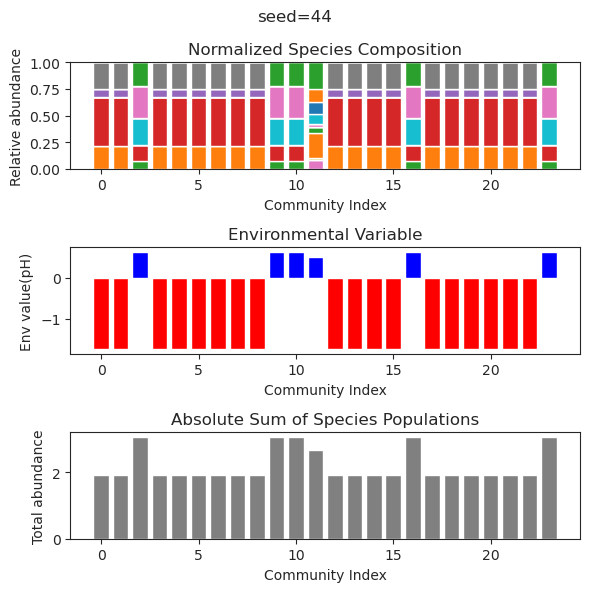

{'species': array([-3.51276839e-63,  2.42950065e-01, -1.83494536e-43, -2.09375220e-52,
        3.19527018e-30,  1.62894098e-33,  1.79761092e-10, -4.36540716e-32,
        1.24505783e-39,  1.34427099e-62,  2.33230129e-01,  2.44830909e-63,
       -3.30900735e-66,  4.21143141e-61,  8.36150784e-01,  1.02608127e-37,
        5.14014874e-61,  4.39089090e-01, -5.09727969e-21,  8.05966723e-47,
        7.01448510e-01, -1.91212728e-45,  1.08390157e-58, -1.92761770e-37]), 'env': array([-0.74512021])}
{'species': array([ 2.07193190e-56,  2.42950065e-01, -3.47726494e-42,  1.20158305e-48,
        1.20579635e-26, -1.44528531e-60,  8.50445418e-11,  4.20000548e-44,
       -1.50566588e-42,  1.23307934e-57,  2.33230129e-01,  1.24726772e-59,
        5.14187534e-56, -5.76649298e-56,  8.36150784e-01, -1.01650672e-37,
       -1.01869663e-54,  4.39089090e-01, -3.25650456e-24, -2.56029381e-41,
        7.01448510e-01,  4.83171642e-41,  3.36525588e-52, -3.59384282e-35]), 'env': array([-0.74512021])}
{'species': ar

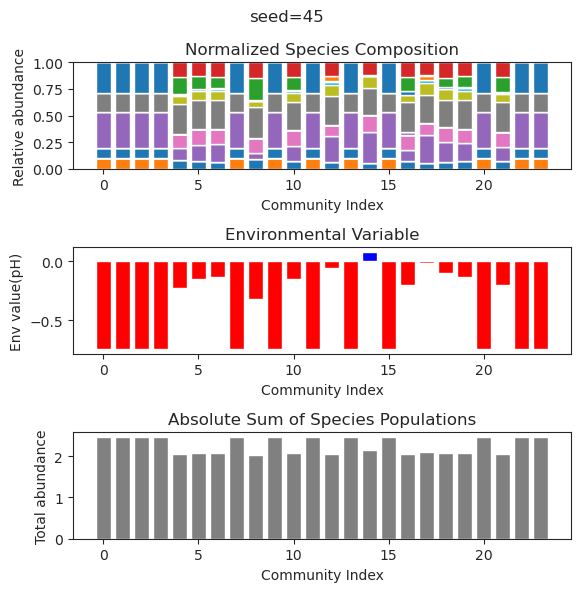

{'species': array([ 2.25407184e-01,  1.28322034e-29,  9.07517601e-01,  2.27011711e-39,
       -9.50969221e-57,  3.35471253e-18,  1.80057511e-33, -1.86275066e-53,
        3.81250212e-28,  7.60782271e-01, -9.40618711e-53,  2.71867649e-53,
        9.37507764e-59, -2.93031993e-22, -2.61234523e-51,  9.17565576e-54,
       -4.47468756e-29,  1.04664256e-02,  2.87687366e-29, -7.05808436e-62,
        2.48403826e-01,  3.01283649e-19, -2.72709512e-57,  6.26920488e-60]), 'env': array([-0.92543857])}
{'species': array([ 2.25433806e-001, -5.93518070e-028,  9.07590406e-001,
       -6.75602857e-056, -3.27460252e-100,  5.94466602e-020,
       -3.79198866e-058,  1.13261367e-083,  6.69869688e-030,
        7.60874232e-001,  1.91850541e-084,  1.87914260e-086,
       -1.57162132e-031,  8.60401987e-021, -1.08666190e-036,
        3.59448246e-032,  7.21467610e-036,  1.03244211e-002,
       -4.48325594e-038,  1.54204143e-122,  2.48404993e-001,
        1.23225710e-020,  3.01138904e-110, -4.29215142e-040]), 'env'

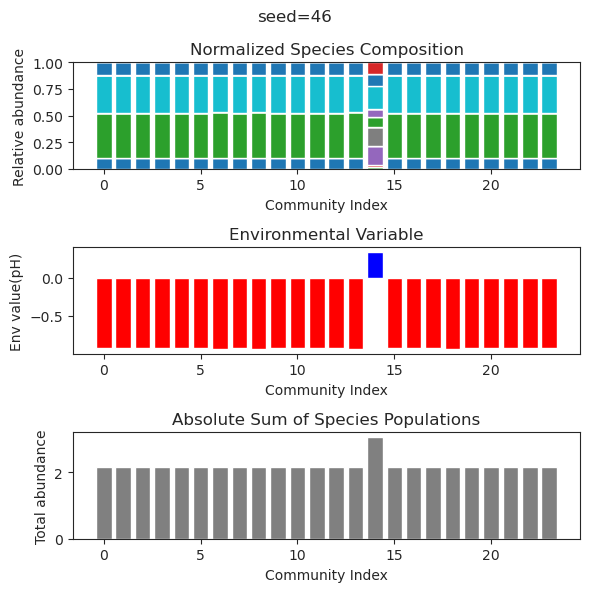

{'species': array([ 2.30656740e-01,  1.20252948e-42, -1.95804872e-56, -5.80102461e-24,
        7.16221945e-47,  3.11311444e-30, -3.18000379e-62,  1.46934991e-45,
        1.40213134e-16,  3.15376297e-65,  2.20999422e-57, -1.92446590e-61,
        8.91528128e-01,  1.04146744e-45,  8.32258368e-01, -8.21835380e-52,
        4.42372771e-61,  4.90709862e-61, -4.48535235e-54,  4.90196149e-63,
        2.38092266e-61, -2.53443712e-54, -8.02204586e-55, -4.16177265e-32]), 'env': array([-0.73984397])}
{'species': array([ 2.30656740e-01, -2.36990517e-57, -6.23373473e-71, -6.45549291e-30,
       -2.22212548e-58,  1.79204416e-28, -8.23021247e-76, -2.58529260e-50,
       -5.57851809e-18,  4.64731149e-74,  3.28444765e-71, -7.72918147e-76,
        8.91528128e-01,  2.14599683e-65,  8.32258368e-01,  5.82350577e-68,
        3.00374552e-74,  1.21264665e-72, -2.37246683e-62,  4.72799130e-73,
        6.25697911e-78, -1.18215748e-58, -3.26193657e-65, -1.02341564e-37]), 'env': array([-0.73984397])}
{'species': ar

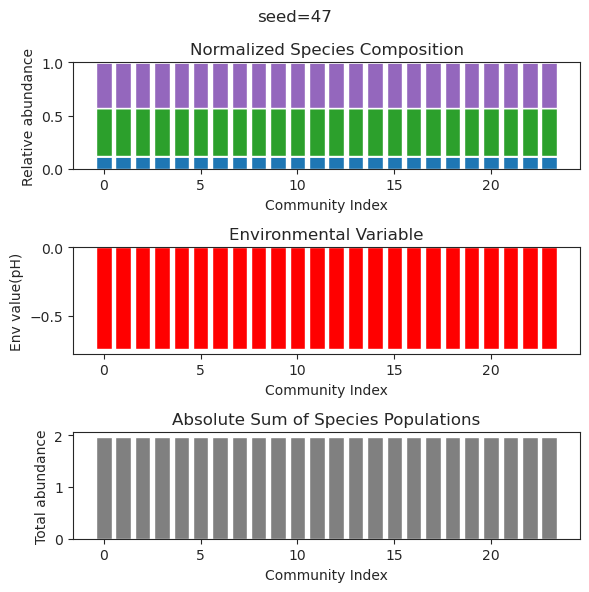

{'species': array([ 2.25957900e-01, -2.98722918e-52,  3.97985626e-01,  9.51419785e-40,
        5.21453623e-31,  3.38832104e-37, -2.09784930e-53, -1.30932712e-33,
       -7.65076147e-47,  4.42362909e-44,  2.66781809e-02,  3.66315856e-01,
       -3.42774963e-43,  4.47691824e-37, -1.69591471e-51,  3.03426324e-50,
        1.53465381e-01,  3.56643550e-01,  5.77930395e-02,  5.15644848e-01,
       -7.14733130e-38,  5.77677961e-39, -2.48703202e-45,  7.57920174e-28]), 'env': array([-0.85162433])}
{'species': array([ 2.25957900e-01,  7.28066593e-46,  3.97985626e-01,  3.73263011e-33,
        2.39428788e-28, -8.71155606e-37,  2.49022509e-39,  3.50790857e-33,
       -8.69541273e-42,  5.38862001e-36,  2.66781809e-02,  3.66315856e-01,
       -4.37142655e-38, -2.99497052e-37,  2.27515752e-45, -8.75657853e-46,
        1.53465381e-01,  3.56643550e-01,  5.77930395e-02,  5.15644848e-01,
        2.22939879e-35,  1.24950529e-33, -1.56397366e-40, -3.26520101e-21]), 'env': array([-0.85162433])}
{'species': ar

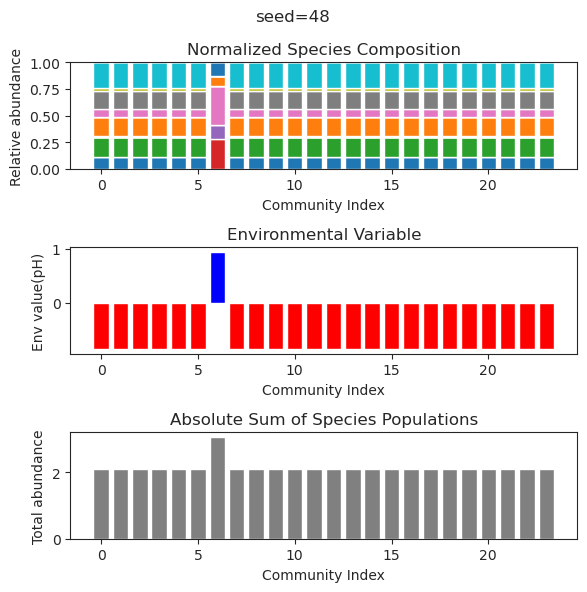

{'species': array([ 6.66301271e-145, -5.67010366e-202,  3.24830129e-208,
        1.89499534e-061,  3.90617013e-191, -8.88001124e-037,
        3.33463038e-001, -3.15687662e-168, -8.83485471e-196,
       -4.65606067e-081,  1.85693066e-001,  1.95455897e-081,
        2.30225373e-033,  4.24991254e-179,  7.56444832e-001,
        6.16160981e-001,  7.76282949e-001,  2.31551194e-098,
        3.74586858e-138, -5.46001364e-081, -6.39729933e-112,
        3.15424937e-001,  4.93122677e-023, -1.09014772e-044]), 'env': array([0.47769685])}
{'species': array([ 1.73659140e-134, -5.17101345e-194,  9.10701468e-203,
        4.32585581e-057, -7.06908379e-184,  1.51714105e-040,
        3.33463038e-001,  2.02902005e-155, -9.66661984e-187,
        3.42569149e-081,  1.85693066e-001, -5.22516418e-084,
        4.90096394e-029, -3.92299730e-175,  7.56444832e-001,
        6.16160981e-001,  7.76282949e-001,  1.08142856e-090,
       -3.58942805e-133, -9.50251980e-077,  5.06240199e-100,
        3.15424937e-001,  1.182

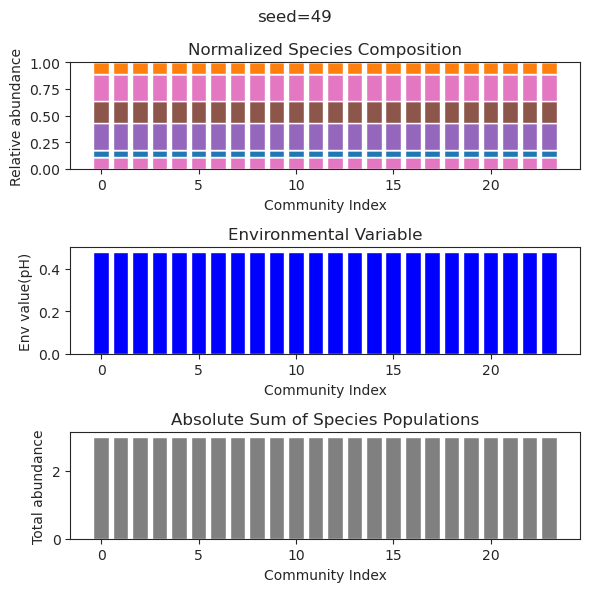

{'species': array([ 2.30463391e-01, -1.08032398e-38,  6.44646449e-51,  2.02406937e-11,
       -1.86161652e-70, -2.10978870e-68, -2.18886599e-48, -3.33942015e-73,
       -4.93325088e-54,  6.04852954e-20,  4.40548899e-01,  2.27789435e-01,
        3.42482987e-01,  2.46938578e-41, -4.03895760e-42,  1.43940652e-01,
        1.47847485e-71, -1.57630601e-41,  1.13700819e-01, -5.53212398e-75,
        4.13849018e-01, -3.40728546e-63, -4.88973714e-55, -6.95673447e-68]), 'env': array([-0.59861139])}
{'species': array([-8.43254502e-028, -2.36968843e-025,  1.71041627e-030,
        1.02751690e-002,  2.99293609e-001,  1.52775212e-031,
       -1.92371911e-034,  8.93267816e-001,  1.71456090e-039,
        7.08590701e-035,  3.96661451e-137, -2.38753483e-050,
       -6.65033778e-034, -6.10059635e-035, -4.42149366e-121,
        8.06190521e-153,  3.73939763e-001, -1.89618938e-030,
        6.75438115e-001, -7.24734033e-059, -9.45681470e-030,
        6.21688404e-030,  6.71633796e-001,  7.77088238e-058]), 'env'

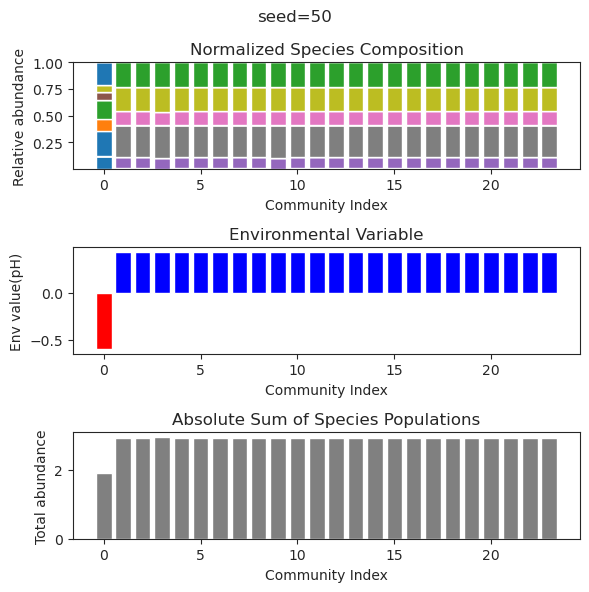

{'species': array([-5.48795513e-035, -4.82497936e-282,  1.61852684e-001,
        4.47414750e-001,  3.17060655e-001, -9.11270393e-032,
        5.30226557e-147, -1.34577881e-099,  1.27421593e-286,
        6.16835781e-001,  9.80873654e-002,  2.92489944e-001,
        3.70282932e-001, -1.28023403e-127,  2.69167826e-075,
       -2.50182885e-185, -1.71200391e-128,  4.66354674e-034,
       -1.28475480e-277,  2.01462688e-001, -7.57901220e-154,
        6.04221252e-002, -6.78664116e-169, -2.41698341e-166]), 'env': array([0.25469923])}
{'species': array([-1.02532247e-091, -3.71228348e-283,  1.61852684e-001,
        4.47414750e-001,  3.17060655e-001, -7.72323418e-320,
        2.73931247e-146,  3.36700514e-105,  5.43174352e-288,
        6.16835781e-001,  9.80873654e-002,  2.92489944e-001,
        3.70282932e-001,  3.45686865e-123, -4.00266943e-075,
        6.07958473e-185, -7.12880712e-127, -4.57807831e-027,
        4.80449904e-285,  2.01462688e-001,  8.18207113e-159,
        6.04221252e-002, -2.943

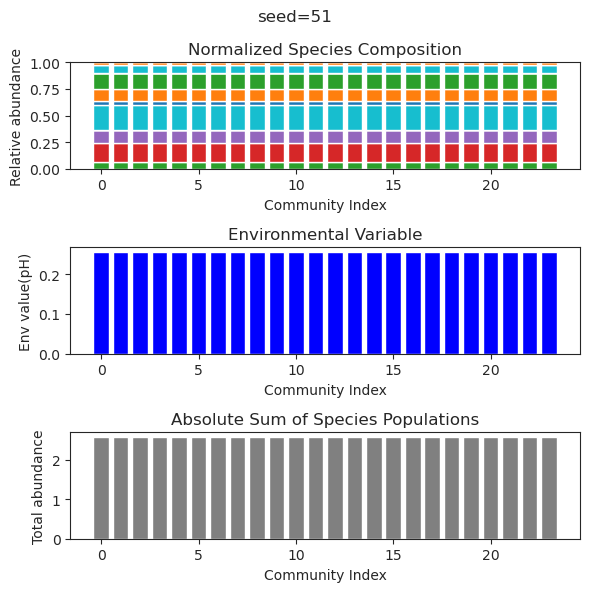

{'species': array([-1.44745844e-040,  9.66604549e-126,  1.31463058e-209,
        1.51622360e-107,  6.15650200e-001,  1.10156921e-001,
        3.91506429e-220, -3.83566237e-025,  2.39213712e-075,
        4.71261246e-124,  5.05855304e-002,  3.39159400e-001,
        2.84479601e-002,  4.10189825e-203,  6.74481267e-001,
        5.92697471e-002,  3.14065419e-232,  9.69139774e-224,
        1.50727242e-206,  7.97077582e-111,  9.92257130e-018,
        5.95296765e-248,  6.09003352e-001, -5.27949015e-225]), 'env': array([0.50941392])}
{'species': array([ 5.55777890e-045,  9.70729764e-042,  4.90636010e-112,
        6.56892399e-121,  6.15650200e-001,  1.10156921e-001,
       -7.02307234e-171, -3.74763547e-026, -1.26947518e-106,
        1.74174089e-044,  5.05855304e-002,  3.39159400e-001,
        2.84479601e-002,  2.15677918e-156,  6.74481267e-001,
        5.92697471e-002, -5.76329021e-167, -9.89437375e-159,
       -2.78278761e-170, -7.95964625e-109,  3.37184129e-016,
        1.96705944e-107,  6.090

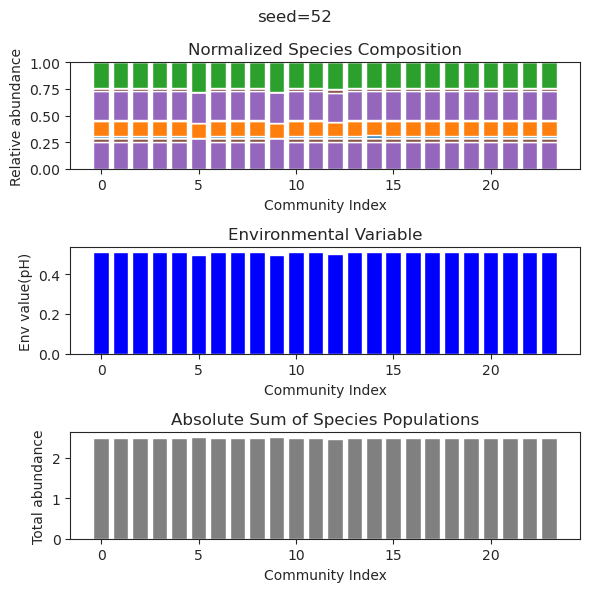

{'species': array([-8.22799309e-44,  3.98177333e-01,  2.10674905e-70, -1.13970660e-49,
       -2.33883853e-48, -2.62161927e-82,  8.49727172e-26,  1.68321985e-58,
        2.06640832e-02,  8.55881405e-69, -3.75380032e-83,  9.55835433e-70,
        1.14857565e-26,  7.30149413e-64,  6.62537590e-02,  3.55027940e-55,
       -4.06975492e-70, -5.49153840e-83, -1.23413731e-81,  1.68505086e-57,
       -1.07534527e-81,  1.80985595e-73,  6.86001934e-01,  2.63576445e-01]), 'env': array([-1.9025127])}
{'species': array([-2.71620391e-49,  3.98177333e-01,  1.44277189e-66,  1.32218684e-66,
        2.79375496e-44, -5.80630111e-79, -3.71166078e-23, -1.91808025e-52,
        2.06640832e-02,  5.03278366e-64, -1.93251761e-78,  5.26427399e-67,
       -6.35205489e-27,  1.07610862e-40,  6.62537590e-02, -4.42498196e-54,
        1.48353970e-62, -3.82355234e-78,  4.72122890e-78, -2.94572560e-58,
       -2.62871998e-78,  3.40402014e-70,  6.86001934e-01,  2.63576445e-01]), 'env': array([-1.9025127])}
{'species': arra

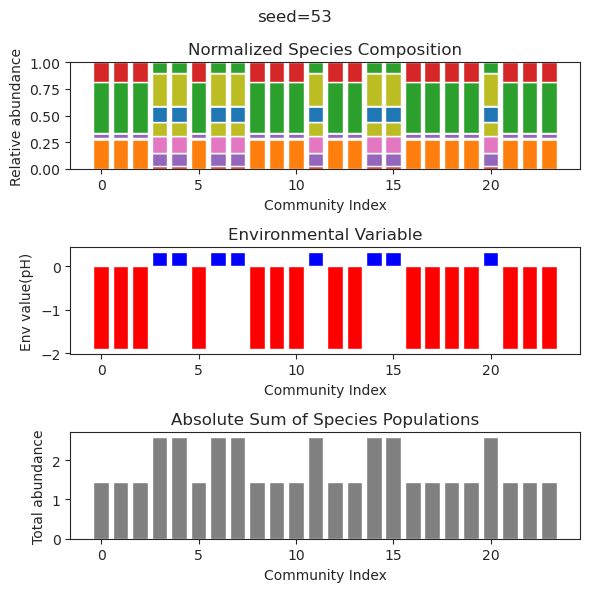

{'species': array([ 3.60407279e-01, -3.27976787e-26,  4.64471830e-27,  1.11993704e-25,
        1.90175170e-01,  5.46037723e-27,  1.94545044e-02,  4.07410828e-31,
        3.32424629e-73,  4.32420941e-01,  7.79827531e-30,  6.48941846e-01,
        1.12035129e-04,  1.15115326e-28,  1.15424058e-71,  6.32139505e-68,
        8.80106118e-02, -9.39843237e-77,  1.59893730e-63,  4.82516588e-79,
       -1.98715202e-70, -1.06150716e-69,  2.98777416e-25, -1.11859993e-71]), 'env': array([-1.59109015])}
{'species': array([ 3.60401839e-001, -5.08351491e-027, -2.33605025e-032,
       -2.75460814e-028,  1.90238295e-001,  5.63070722e-027,
        1.94793067e-002, -5.41555638e-023,  2.07216024e-089,
        4.32415340e-001,  6.74073515e-055,  6.48915143e-001,
        2.23976522e-005, -8.01276503e-030,  7.09384879e-090,
        3.11534339e-077,  8.80498732e-002, -1.80197144e-101,
       -4.79127220e-073, -1.86749995e-107, -7.06138979e-088,
        6.55325668e-083,  4.66140400e-020,  1.60920011e-092]), 'env'

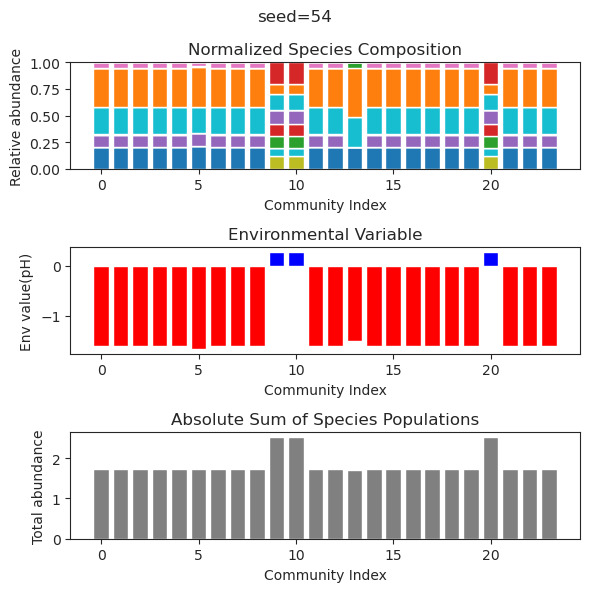

{'species': array([ 2.27274198e-002, -5.23732897e-134,  9.70040605e-002,
        1.98241144e-119, -2.83898328e-160, -5.13723224e-165,
        5.53594314e-065,  9.66667948e-001,  5.70425142e-001,
        5.51512072e-001, -4.07295095e-161, -1.42056923e-062,
       -4.68486624e-155, -3.87317199e-163, -2.03020811e-128,
        3.02242437e-001, -4.67246824e-091, -3.10589875e-155,
        5.98444710e-041,  1.74947034e-001,  3.87352062e-060,
        1.42014720e-015, -2.37981095e-081,  8.17536126e-002]), 'env': array([0.41822409])}
{'species': array([ 2.27274198e-002, -8.08038708e-171,  9.70040605e-002,
        3.18221711e-155, -2.27014216e-202,  1.26434031e-216,
       -1.40014538e-080,  9.66667948e-001,  5.70425142e-001,
        5.51512072e-001,  2.21045534e-213, -2.14271390e-074,
       -6.46402945e-205,  1.10518801e-194,  1.03230268e-168,
        3.02242437e-001,  2.60411863e-103,  2.78853708e-214,
        3.95768068e-047,  1.74947034e-001, -6.69397528e-077,
        6.57197046e-015, -4.382

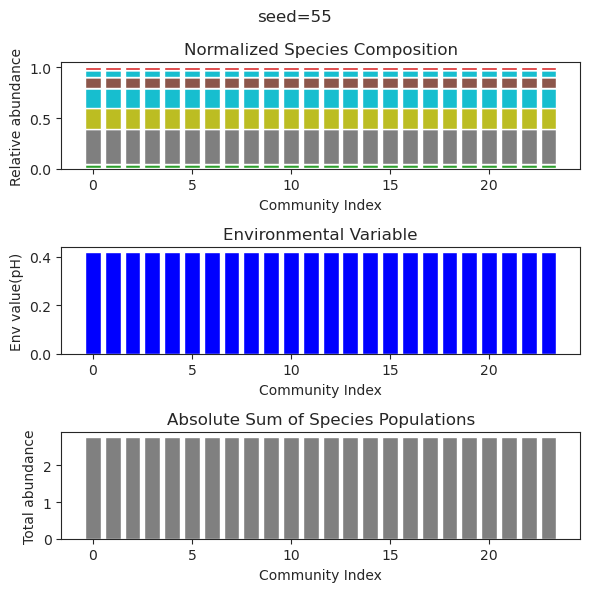

{'species': array([ 1.46614797e-001,  6.36837005e-002, -3.06483527e-032,
        8.84382732e-173,  3.27518754e-078,  2.43330783e-001,
        1.39175643e-001, -3.48562357e-159, -5.10630832e-119,
       -6.96293435e-175, -1.84894724e-034,  1.25432509e-165,
        3.23402235e-075, -1.43846340e-031,  2.14895601e-025,
        3.67266954e-001,  3.47371141e-112,  7.99984844e-001,
        6.94013799e-068,  3.11911265e-071,  3.24446331e-135,
       -2.89687900e-154,  6.52989706e-046, -2.69905227e-165]), 'env': array([-0.92838096])}
{'species': array([ 1.46614797e-001,  6.36837005e-002,  9.47285137e-033,
        2.02371109e-152,  7.23383100e-049,  2.43330783e-001,
        1.39175643e-001,  7.75931724e-153, -3.77173913e-099,
       -6.79009426e-159,  9.00264461e-035,  1.30720210e-150,
        1.00708350e-062,  9.27435672e-032, -6.13796776e-021,
        3.67266954e-001,  7.77758360e-092,  7.99984844e-001,
        6.84183551e-064,  4.58285478e-066, -7.05076496e-126,
        6.61493943e-150, -8.63

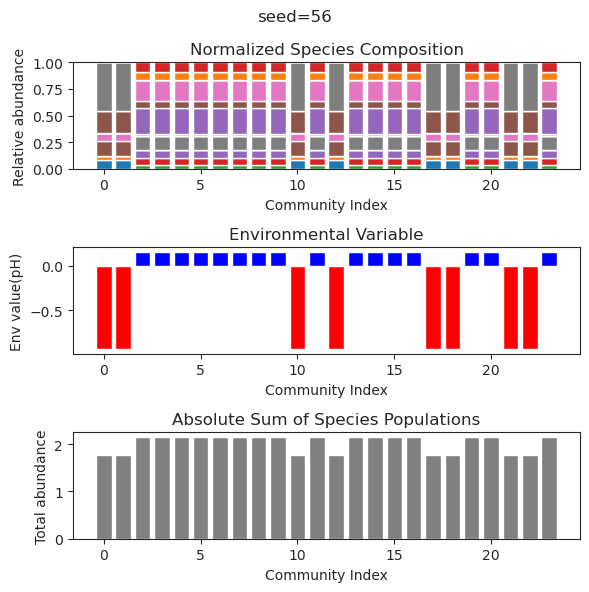

{'species': array([ 3.47519202e-01, -2.83142101e-41,  7.66313316e-58, -1.78980645e-62,
        2.84015061e-61,  2.11213540e-01, -2.90462599e-60, -4.95749849e-56,
       -6.84164745e-47,  3.10720380e-01,  1.79568223e-01,  1.69163084e-57,
        5.03010475e-32,  1.15480862e-14,  1.15027877e-33,  5.54538323e-02,
        1.09579814e-21,  8.43576282e-01, -7.57519454e-54,  9.32405768e-57,
       -7.82569401e-56, -4.37024608e-63,  4.86170139e-56, -3.41450209e-62]), 'env': array([-1.41396676])}
{'species': array([ 3.47519202e-001, -4.44667465e-044,  3.40635508e-123,
        6.42444195e-171,  6.61865058e-133,  2.11213540e-001,
        7.59484597e-158,  2.40865759e-120, -2.47903226e-107,
        3.10720380e-001,  1.79568223e-001,  1.18915185e-129,
       -2.36519019e-178,  4.99601649e-014,  2.82672074e-114,
        5.54538323e-002,  1.27550207e-022,  8.43576282e-001,
       -7.17445641e-080,  3.96036780e-117,  6.76062636e-113,
       -3.16018204e-171,  7.00344883e-096,  2.14505211e-162]), 'env'

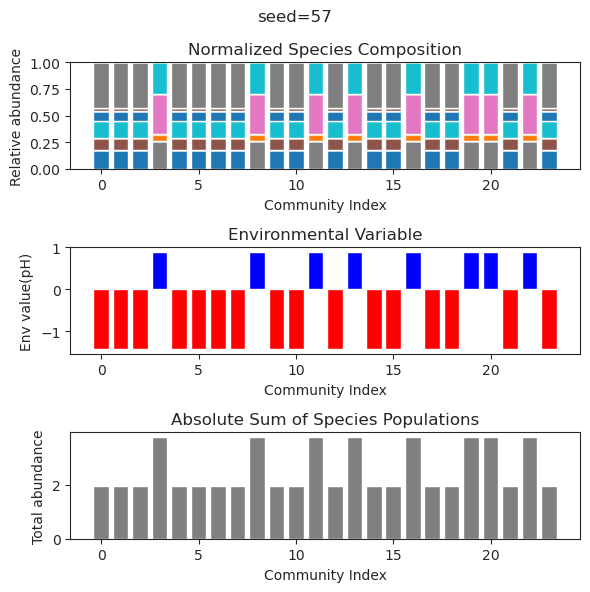

{'species': array([3.00003815e-003, 3.30886036e-120, 1.60336802e-001, 3.49052764e-008,
       9.48575785e-002, 3.29081777e-004, 3.54085331e-275, 4.31892078e-001,
       1.56403753e-009, 9.11734506e-005, 3.08462479e-001, 0.00000000e+000,
       2.89150675e-001, 8.04006990e-215, 1.47785888e-131, 8.09758946e-001,
       4.94065646e-324, 2.00548047e-001, 0.00000000e+000, 6.78038572e-091,
       2.88807733e-174, 4.94065646e-324, 6.10353967e-140, 5.77639667e-001]), 'env': array([0.42536995])}
{'species': array([3.10105783e-003, 2.56129577e-126, 9.07500846e-002, 6.17377014e-002,
       2.14092452e-001, 4.51889355e-001, 2.43128116e-275, 5.20341956e-001,
       1.06866541e-014, 8.70556740e-009, 1.06929243e-003, 4.94065646e-324,
       4.25409217e-001, 2.34903083e-221, 1.12788195e-143, 4.27980710e-001,
       0.00000000e+000, 3.35229402e-001, 0.00000000e+000, 1.65428377e-091,
       6.03011867e-172, 4.94065646e-324, 2.99330141e-142, 3.79090513e-001]), 'env': array([0.55515634])}
{'species': arra

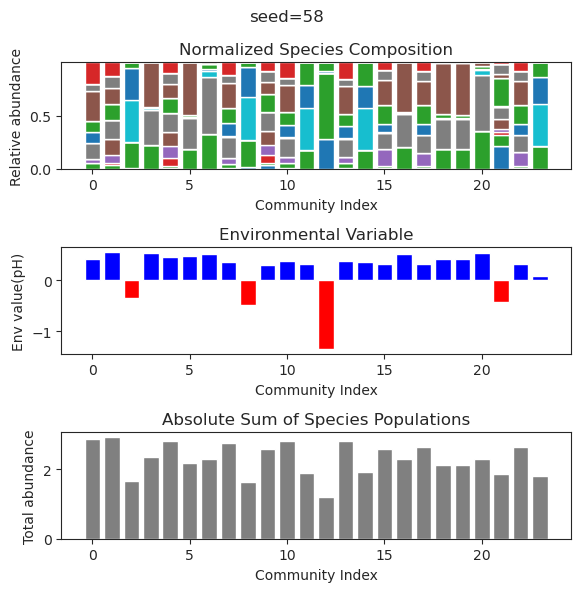

{'species': array([ 2.98560509e-066, -9.26973309e-277,  3.31716190e-070,
        7.67501819e-025,  5.86871092e-025, -4.16387904e-114,
        1.64230779e-114,  7.51750538e-001, -1.20085205e-019,
        3.05220005e-001, -3.11202330e-041, -2.33912370e-040,
        5.93763782e-001,  6.02245361e-001, -1.39569505e-187,
        5.98568809e-105, -5.59263718e-159,  2.57233982e-145,
        3.21512094e-066, -1.13281672e-053,  2.34785262e-001,
       -4.30796163e-165,  5.14803773e-001, -6.22186312e-155]), 'env': array([0.83030983])}
{'species': array([ 4.72687921e-028,  0.00000000e+000, -6.90453352e-028,
        3.40793479e-003,  3.01781338e-002,  2.97319716e-031,
       -8.58322767e-235,  7.84093002e-001,  3.36978953e-002,
       -4.54422389e-025,  9.58314098e-066,  8.22894049e-004,
        7.34038147e-001,  5.77291849e-001, -2.53875860e-286,
        5.28598101e-090,  5.41753299e-161,  1.26659060e-088,
        2.12054003e-056,  1.79094658e-070,  3.56635315e-001,
       -7.66598770e-198,  3.721

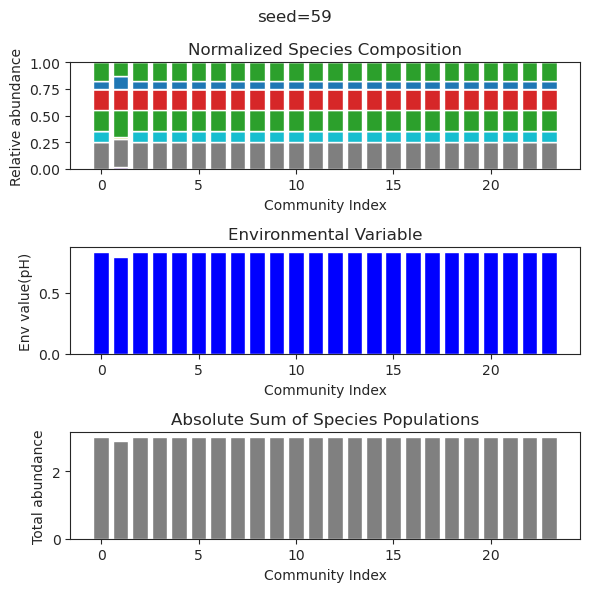

{'species': array([ 4.17056020e-059,  1.14756712e-197,  6.81237651e-068,
       -9.85253119e-030,  1.35614290e-029, -3.34154121e-186,
       -4.37233493e-165,  7.51750538e-001, -3.22271562e-023,
        3.05220005e-001,  4.00277935e-026,  7.57243640e-046,
        5.93763782e-001,  6.02245361e-001,  3.07393949e-121,
        2.47458485e-109, -7.69563711e-110, -3.25816018e-136,
        7.75166076e-055, -7.63980800e-042,  2.34785262e-001,
        5.49468578e-116,  5.14803773e-001, -1.26567371e-122]), 'env': array([0.83030983])}
{'species': array([ 1.04769735e-028, -1.86226133e-231, -1.26063732e-030,
        3.23626234e-176,  7.09402932e-003,  9.60399333e-002,
       -1.35245970e-095, -3.69839539e-032,  1.00754952e-001,
       -1.35772310e-055, -2.12131513e-128, -7.03031342e-085,
       -5.88885551e-042, -9.06345092e-042,  5.32725861e-065,
        1.38796539e+000,  2.21658699e-240,  3.46255805e-203,
        7.08939699e-001,  1.03211528e-125,  6.46497791e-031,
       -1.76275479e-142,  1.111

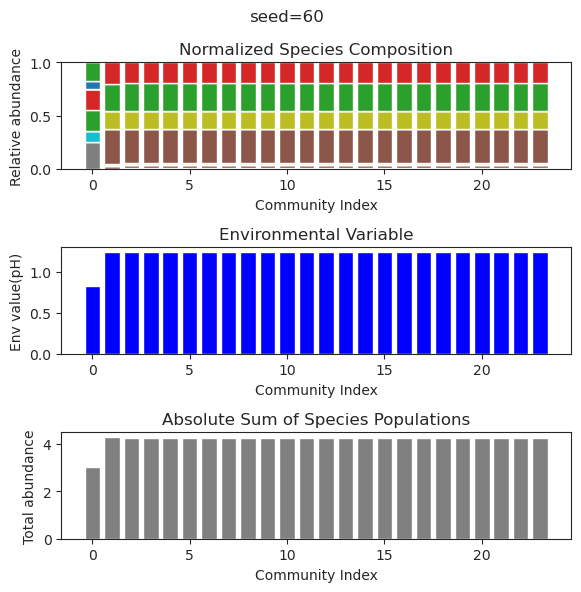

{'species': array([-1.34881712e-029,  2.78792780e-029,  4.60333003e-001,
       -8.30322975e-029,  4.87463570e-125, -6.96348013e-035,
       -1.91170784e-028, -1.83583566e-111,  4.85100822e-001,
        5.71473626e-001,  5.26250499e-001, -9.51893585e-095,
        6.04888352e-027,  1.36666471e-001,  2.77908166e-068,
        5.50744379e-027,  8.68703229e-003,  3.79403679e-047,
       -1.41391426e-029, -1.47263571e-059, -8.15254207e-059,
        3.58425842e-028,  1.39558457e-001,  3.67567508e-001]), 'env': array([0.24794353])}
{'species': array([ 3.10689786e-090,  2.59919733e-006,  5.07718536e-001,
       -1.02225774e-127,  7.76441652e-180,  1.45211677e-051,
        3.27917964e-001, -7.03226213e-212,  3.70154567e-015,
       -7.60029594e-113,  3.96592940e-001,  7.95154063e-041,
        3.54799659e-033,  1.07289029e-130,  3.53144037e-001,
        3.61129475e-204,  3.08541041e-013,  9.46275409e-059,
       -6.72716134e-017,  2.33666184e-036,  1.44689062e-026,
       -1.50418942e-207,  2.494

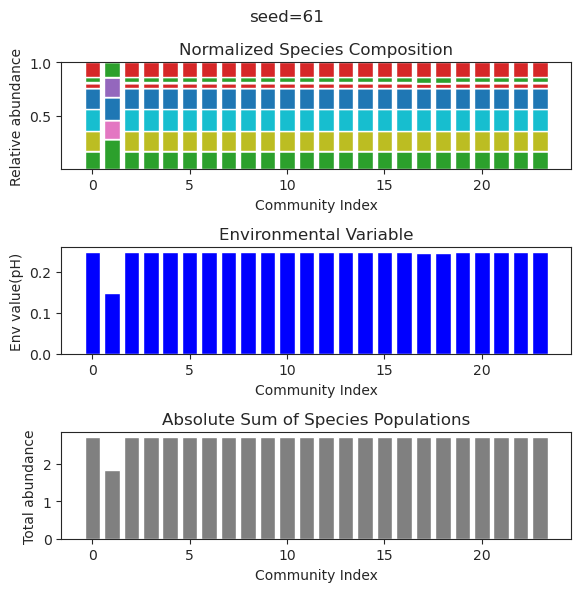

{'species': array([ 2.71522909e-01, -8.52362796e-74,  7.99522455e-26,  8.82279645e-41,
        1.28952086e-89, -3.22991043e-87,  2.88110490e-70,  8.41046828e-01,
        1.23272439e-63, -6.97174384e-84, -5.18029782e-17, -4.90886111e-71,
       -1.61427333e-54,  2.91433297e-01,  2.97610613e-87, -1.41965390e-72,
        3.54328145e-01,  2.58985031e-90,  7.05535110e-02, -3.39393500e-35,
        9.45550825e-68,  1.76374123e-19, -1.79134417e-83,  4.48339297e-43]), 'env': array([-1.17131711])}
{'species': array([ 2.71522909e-01, -3.21684185e-76,  1.42463584e-24, -1.31785511e-42,
        2.09102723e-94,  4.75960767e-90, -2.22769321e-70,  8.41046828e-01,
       -5.19382136e-67,  3.50629007e-85, -3.76184047e-20, -1.17853708e-72,
        1.28653577e-54,  2.91433297e-01,  6.62386219e-92, -2.27705105e-81,
        3.54328145e-01,  1.04716894e-92,  7.05535110e-02,  1.43531794e-33,
        3.23942880e-68, -2.01932320e-18,  1.61900764e-83, -1.24193702e-42]), 'env': array([-1.17131711])}
{'species': ar

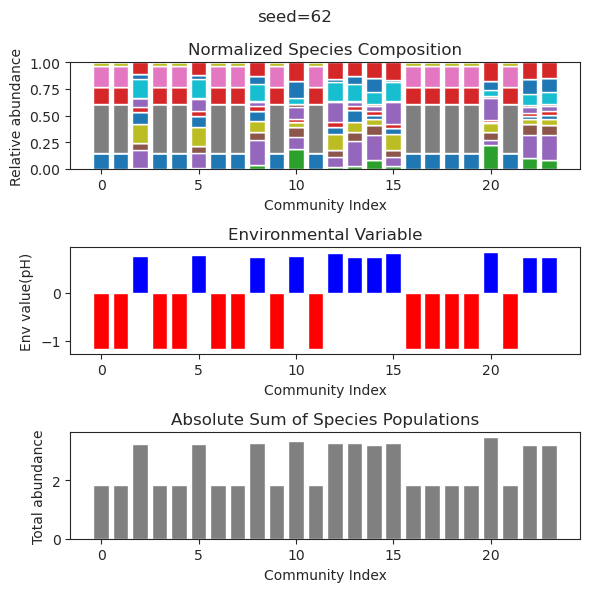

{'species': array([ 1.79451634e-001, -2.48852713e-093,  5.00920838e-040,
       -4.71829456e-143,  7.91304572e-145,  2.98803766e-052,
        7.28024040e-001, -1.01579456e-065,  6.59488229e-002,
       -7.40844967e-134,  6.36080261e-001,  1.65224515e-001,
        3.64754213e-001, -3.16137591e-086,  1.82656813e-046,
        1.69115665e-143,  2.33962012e-139,  2.97113039e-136,
       -1.81252584e-120,  1.19982136e-141,  1.04255552e-001,
       -5.96801509e-063, -1.07035232e-134,  6.37686008e-141]), 'env': array([-0.42942567])}
{'species': array([ 1.42172083e-84,  2.12423791e-01,  2.55231708e-65, -1.55612540e-92,
        6.85125728e-89, -2.67752351e-55,  1.54528146e-01,  4.54908579e-01,
        1.32053279e-01,  7.85232604e-89,  1.59047043e-01, -2.61119485e-88,
        9.72451039e-86,  3.65025838e-01,  2.06257975e-93,  2.37548404e-50,
        4.80306828e-95,  6.32713560e-33,  2.45153492e-26,  4.06498988e-91,
        5.58987741e-01,  8.83029574e-37,  5.18632040e-78,  7.62217172e-25]), 'env'

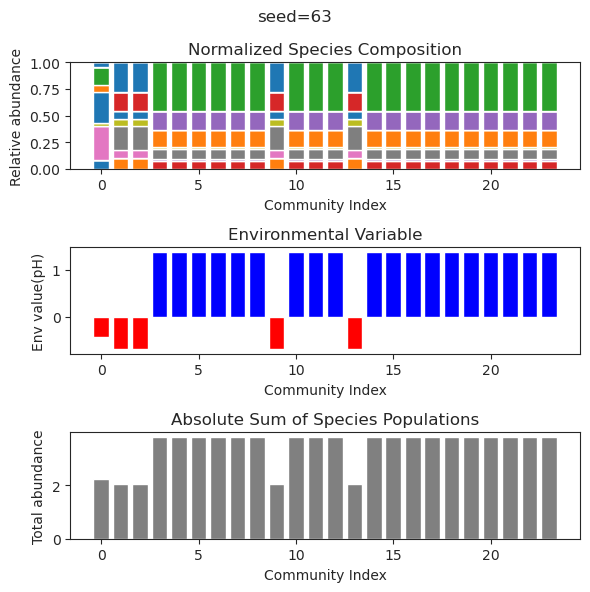

{'species': array([ 2.31161001e-38,  3.01916261e-01,  2.49993224e-01,  1.90940833e-79,
        7.89502599e-02,  3.42851403e-75,  7.40671132e-01, -9.98033885e-25,
       -2.10137755e-56, -5.00398102e-37,  1.93941344e-70,  5.30788574e-01,
        1.38450314e-44, -1.42548722e-79, -7.75179320e-45,  4.83583858e-16,
        1.29795007e-78,  1.05763384e-85,  1.28421541e-32,  2.56861807e-61,
       -4.20540689e-64, -1.39223154e-70, -2.15921506e-86, -3.07314912e-74]), 'env': array([-1.35958212])}
{'species': array([-4.25424661e-37,  3.01916261e-01,  2.49993224e-01, -1.06652934e-61,
        7.89502599e-02,  2.72656926e-55,  7.40671132e-01,  3.74019490e-25,
        8.29978029e-49,  2.97368307e-33,  1.13631890e-52,  5.30788574e-01,
        8.63606125e-40,  1.55246116e-60,  1.97900970e-40,  1.57906989e-16,
       -3.54513413e-58,  4.87187736e-60, -1.06029723e-32,  9.72506014e-51,
        1.32410510e-50,  1.39646438e-55, -2.61700865e-62,  1.02141792e-55]), 'env': array([-1.35958212])}
{'species': ar

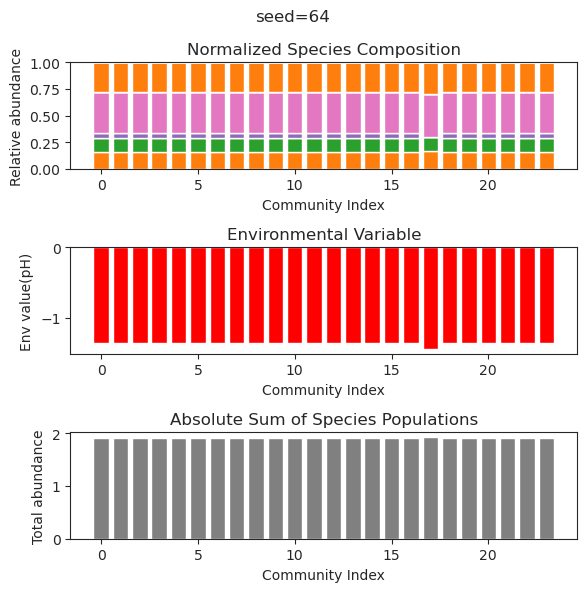

{'species': array([ 2.44404808e-001,  1.89190006e-039, -3.45493075e-192,
        3.66935202e-001,  1.13925679e-103, -3.99257803e-125,
       -1.17883917e-041,  3.98463951e-040,  9.72875765e-001,
       -8.60119141e-139,  1.93465286e-119,  6.69744289e-133,
       -5.42238504e-077,  3.42115257e-105, -9.10794644e-073,
       -2.12289648e-158,  4.00995711e-100, -7.04238916e-064,
        1.36743354e-001, -2.58435135e-040, -6.95020044e-091,
        2.43103512e-105,  3.17676447e-024, -2.12268914e-068]), 'env': array([-0.88940495])}
{'species': array([ 2.44404808e-001,  1.89190006e-039, -3.45493075e-192,
        3.66935202e-001,  1.13925679e-103, -3.99257803e-125,
       -1.17883917e-041,  3.98463951e-040,  9.72875765e-001,
       -8.60119141e-139,  1.93465286e-119,  6.69744289e-133,
       -5.42238504e-077,  3.42115257e-105, -9.10794644e-073,
       -2.12289648e-158,  4.00995711e-100, -7.04238916e-064,
        1.36743354e-001, -2.58435135e-040, -6.95020044e-091,
        2.43103512e-105,  3.17

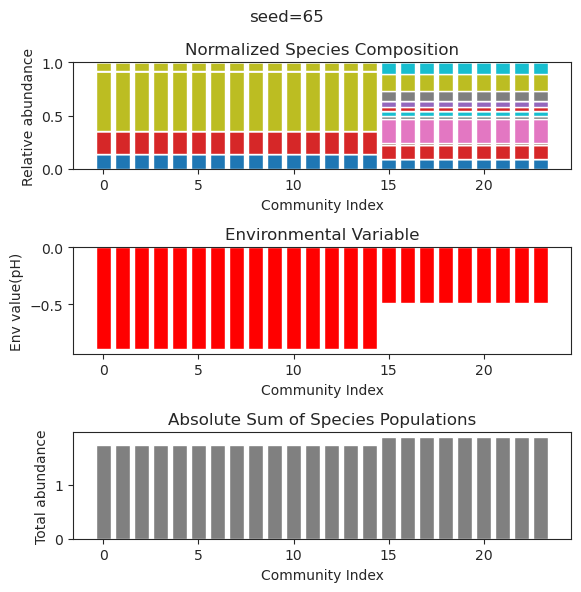

{'species': array([-1.04855378e-42,  4.74981932e-01,  3.63032158e-01,  9.89608789e-32,
        2.54484617e-57, -7.62303367e-57,  5.28677771e-01,  1.05305699e-16,
        2.22413942e-51,  2.88037501e-57, -2.84809906e-51,  6.99718517e-45,
       -2.99384878e-58,  1.24722294e-56, -3.75705941e-58, -8.05451801e-50,
       -5.36908135e-29, -6.18156195e-58,  2.06773034e-47,  1.19345664e-35,
        1.83741704e-59, -9.56173081e-37,  1.04594599e-37,  5.40176945e-01]), 'env': array([-1.90803628])}
{'species': array([ 3.09255809e-46,  4.74981932e-01,  3.63032158e-01, -2.69558688e-30,
        2.19260310e-64, -3.55117291e-58,  5.28677771e-01,  6.16114603e-15,
       -1.58880888e-52,  4.42006270e-64,  7.59827226e-55, -1.85615727e-44,
        4.84458467e-60,  1.03860467e-64, -2.17896161e-65, -5.03418430e-49,
       -1.87128574e-23,  3.75590720e-58, -2.41653473e-43, -1.35926793e-34,
        5.90809875e-61, -3.86239317e-38, -1.01667599e-36,  5.40176945e-01]), 'env': array([-1.90803628])}
{'species': ar

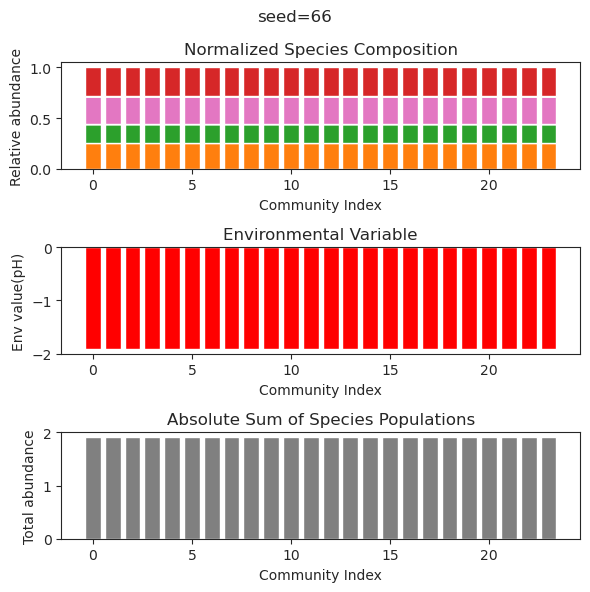

{'species': array([ 1.04470820e-079, -1.24941774e-049, -2.42417055e-194,
        2.74761736e-213,  1.03342983e-034, -5.56522019e-178,
       -1.23190557e-033, -1.17827209e-076, -2.08199198e-020,
       -4.67489324e-219,  8.18480951e-001, -7.55230697e-254,
        1.38753948e+000,  3.16126456e-200,  4.91813868e-001,
       -1.69914246e-074, -5.58985772e-186,  9.91894547e-002,
       -3.50496706e-014, -4.26162765e-252, -6.38052541e-130,
       -1.38979681e-195,  8.47359390e-001, -5.29349943e-111]), 'env': array([1.10946544])}
{'species': array([-2.53352451e-065, -2.48518072e-027, -5.62230606e-163,
       -1.48562281e-151, -1.16735339e-033, -1.04997695e-132,
       -3.61197006e-033,  5.92422231e-063, -2.05748134e-023,
        4.03924443e-165,  8.18480951e-001,  2.59479747e-188,
        1.38753948e+000, -1.06582802e-142,  4.91813868e-001,
        3.49560675e-061,  1.27054936e-132,  9.91894547e-002,
        2.53945353e-016,  1.08669822e-195,  3.60555741e-096,
       -4.09261301e-148,  8.473

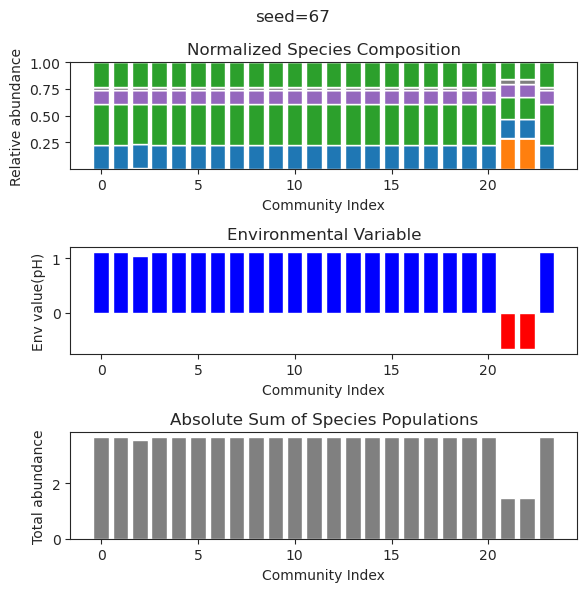

{'species': array([ 3.17731519e-002,  4.03192913e-001, -2.87569991e-056,
       -4.22644186e-032,  9.05810972e-101,  7.07992341e-001,
        4.48188207e-038,  2.47454719e-002, -6.13439809e-074,
        1.51579106e-096,  3.34555298e-001, -3.72381480e-076,
       -7.08221094e-107,  4.65528345e-003, -3.15183903e-144,
        5.58897346e-006,  1.07912318e-127,  1.47769518e-091,
        5.36057943e-002, -1.43404832e-136,  1.10047329e-002,
        1.27361481e-028,  1.41572983e-028, -1.34129900e-111]), 'env': array([-2.22445226])}
{'species': array([ 2.59550935e-002,  4.10208864e-001,  1.98741936e-040,
        1.14656039e-063, -2.34031983e-083,  6.95274246e-001,
        6.74770989e-058,  1.77060492e-002, -5.81053672e-024,
       -1.63369382e-086,  3.47830876e-001,  3.06816125e-061,
       -3.81879495e-088,  3.26148365e-005,  1.53064505e-153,
        1.73025594e-014, -4.87310911e-124,  8.52570197e-082,
        4.82850067e-002,  3.46351779e-136,  2.48694312e-002,
       -1.04751770e-112,  4.83

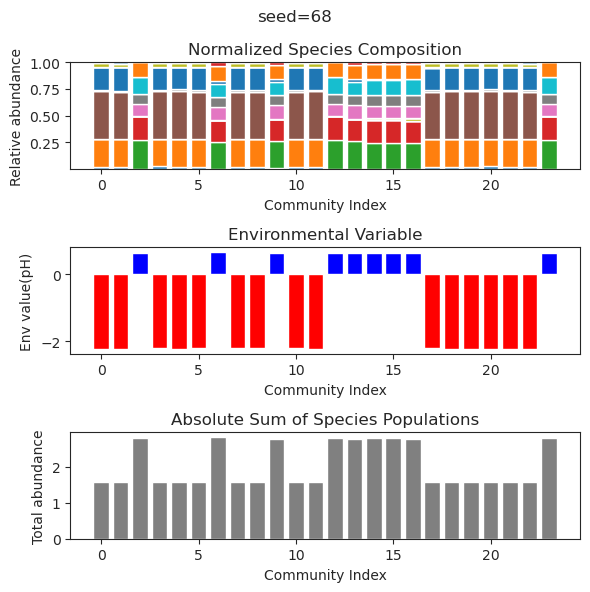

{'species': array([ 3.66811169e-01,  4.58239416e-38,  7.56714440e-01, -3.67754056e-67,
        4.05478572e-63,  5.19309247e-83,  4.20556352e-01,  2.49130015e-61,
        4.86514087e-35, -3.67512464e-80, -1.13425705e-72, -5.77026168e-75,
        2.24650390e-01,  3.12285753e-83, -2.38963306e-25,  2.12923057e-24,
        2.39927274e-26, -1.14652189e-63, -2.63032757e-81,  5.55351751e-31,
        2.23507751e-75,  4.30176270e-37,  6.02314081e-26,  1.95638667e-18]), 'env': array([-1.53420469])}
{'species': array([ 3.66811169e-01,  4.80413901e-38,  7.56714440e-01,  2.26580009e-63,
       -3.78681278e-67,  1.23605737e-75,  4.20556352e-01, -7.98441080e-62,
        6.59091521e-35,  4.19784864e-68,  6.62134486e-74,  1.71995555e-75,
        2.24650390e-01,  1.30819738e-74, -1.29460294e-26, -4.36665086e-23,
       -8.18665049e-28,  9.43757497e-59, -6.80586989e-76,  2.91952206e-29,
       -7.88594791e-71,  6.34507553e-36,  4.23897347e-27, -6.57409647e-17]), 'env': array([-1.53420469])}
{'species': ar

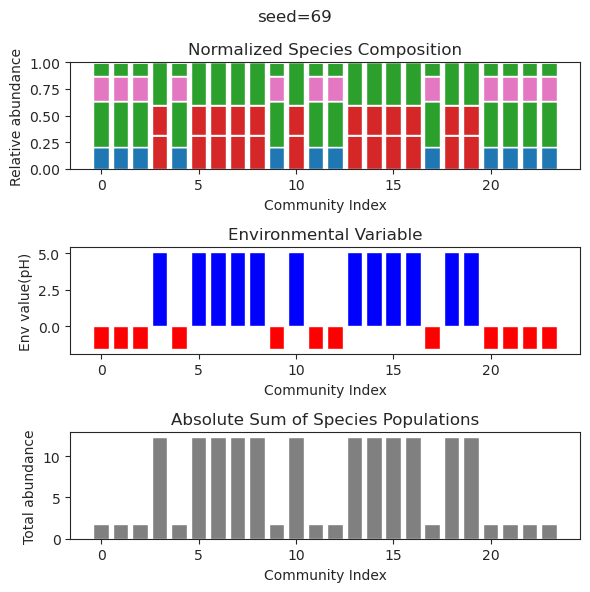

{'species': array([ 2.69297528e-001, -2.96874309e-145, -3.91131895e-211,
       -4.69862872e-121, -1.65392055e-207,  6.91380104e-001,
        5.06164775e-027,  4.02799247e-055,  1.10557568e-001,
        3.76359485e-159,  7.49178728e-001, -1.99489607e-078,
        1.15039503e-001,  2.06713108e-155,  2.52753970e-001,
       -6.81859045e-047,  1.07756930e-001,  3.59596171e-154,
       -1.90157873e-112, -1.05672641e-191, -1.03090220e-141,
        8.72076668e-094, -7.39652143e-211,  7.55318599e-002]), 'env': array([-0.64427473])}
{'species': array([ 2.69297528e-001, -1.00031801e-176, -4.88972399e-279,
       -4.45533697e-117,  1.58341332e-283,  6.91380104e-001,
        7.49543691e-014,  7.13913293e-048,  1.10557568e-001,
       -5.40407841e-189,  7.49178728e-001, -1.38315112e-074,
        1.15039503e-001, -2.72017751e-189,  2.52753970e-001,
       -5.73550584e-038,  1.07756930e-001, -2.85232548e-174,
       -1.37990980e-115,  5.57606839e-245, -1.67617846e-171,
        4.62345515e-095,  7.07

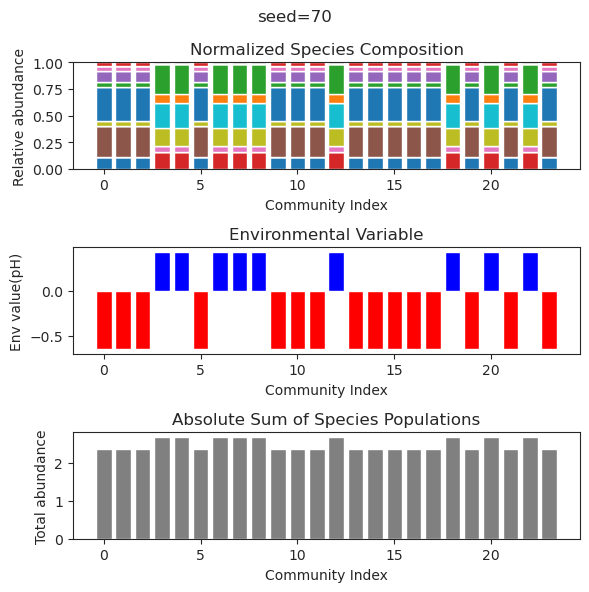

{'species': array([-1.43509947e-36,  3.12112448e-01,  4.61598426e-01, -5.89544738e-18,
       -3.00266526e-32, -2.13838560e-55, -2.38984130e-38,  3.89110218e-58,
        1.70959489e-01,  1.40038858e-01, -6.23063542e-50, -6.74832189e-53,
       -1.85457348e-29, -7.01238904e-24, -1.18519636e-30, -2.21060011e-39,
       -1.42834519e-42, -3.64353529e-23,  4.77450760e-54,  4.15464676e-59,
        1.11377903e-17,  2.39284254e-47,  6.02706332e-01, -1.39691257e-26]), 'env': array([-1.12444797])}
{'species': array([-8.25709397e-058,  3.12112448e-001,  4.61598426e-001,
        1.26645949e-016, -2.16244013e-052, -6.81499672e-112,
       -5.64771676e-054,  4.89421561e-111,  1.70959489e-001,
        1.40038858e-001,  3.02302751e-096,  4.67015906e-102,
        1.06422313e-045, -5.48034702e-041,  2.42897421e-048,
       -8.80557649e-062,  3.37371429e-077,  2.19176356e-026,
        3.80177151e-115,  2.19101027e-115,  8.63710685e-024,
       -4.18847438e-088,  6.02706332e-001, -1.14932429e-032]), 'env'

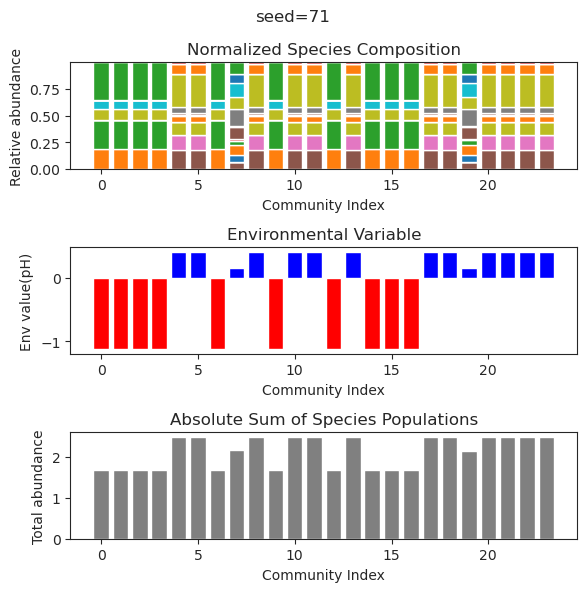

{'species': array([-1.43544035e-46,  4.26426065e-01, -6.46695031e-48, -8.52257055e-44,
        1.00132782e-31,  9.09713750e-32,  6.24293085e-39, -4.90250203e-45,
       -5.14246931e-36, -1.24471463e-46, -4.41154238e-43,  8.20562661e-01,
       -7.62325575e-28,  5.79670455e-49,  4.86156869e-30, -1.71903724e-42,
       -4.57398932e-48,  7.48932432e-41, -1.12082368e-31,  9.23942386e-01,
        4.06170066e-37, -2.38564908e-39, -3.12559245e-46,  3.82033039e-28]), 'env': array([-1.90283196])}
{'species': array([ 8.43901126e-49,  4.26426065e-01,  4.22194021e-50,  1.03402488e-42,
       -1.48979795e-34,  1.50724532e-34,  6.65356070e-35,  6.35285650e-44,
        2.88175033e-34, -7.83748562e-49,  1.24109859e-41,  8.20562661e-01,
        2.55331197e-29, -2.00949076e-47, -9.11188801e-35, -4.04354031e-42,
       -3.92196985e-49, -1.36251549e-40,  8.66871416e-32,  9.23942386e-01,
        2.46003872e-35,  3.45322332e-39, -6.05422665e-46,  4.18462070e-30]), 'env': array([-1.90283196])}
{'species': ar

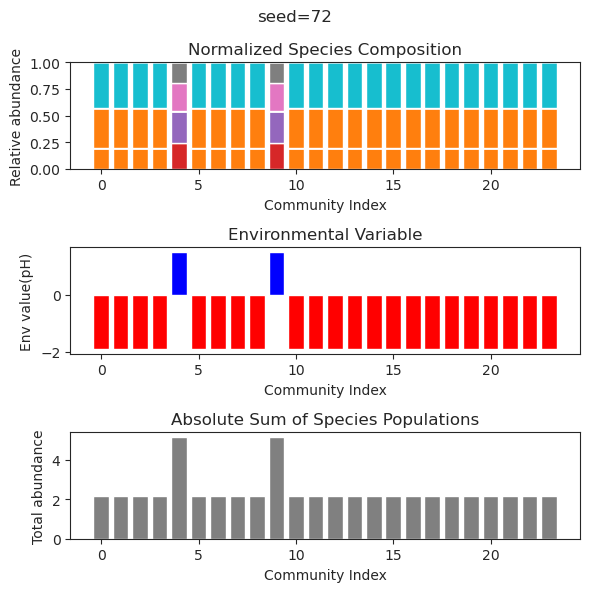

{'species': array([ 1.82315403e-71,  3.65722164e-01,  4.34840443e-01, -1.79151625e-82,
        1.80445081e-89, -2.53603721e-64,  5.95034000e-02,  4.16481831e-33,
        2.35010346e-70, -5.49255003e-77, -1.39758968e-85, -4.65067789e-88,
        1.09823101e-68,  4.41753892e-01, -4.92145524e-50,  7.05187575e-62,
       -1.39086433e-87, -2.40809445e-47, -6.93663635e-80, -3.12260039e-34,
        4.28210436e-01,  3.33905645e-86,  2.08621965e-01, -1.12354519e-86]), 'env': array([-1.451592])}
{'species': array([ 1.42009818e-079,  3.65722164e-001,  4.34840443e-001,
        5.30711781e-091, -1.80136815e-096,  7.69231865e-071,
        5.95034000e-002, -3.37411660e-029,  4.98305595e-083,
        7.40679578e-092, -7.20611479e-096,  9.13934489e-101,
       -3.03442474e-090,  4.41753892e-001,  4.98376792e-048,
        3.59178887e-081, -3.67167699e-104,  3.87440914e-046,
        1.90106886e-089,  2.65815312e-028,  4.28210436e-001,
       -3.29613335e-096,  2.08621965e-001,  3.19269967e-102]), 'env': 

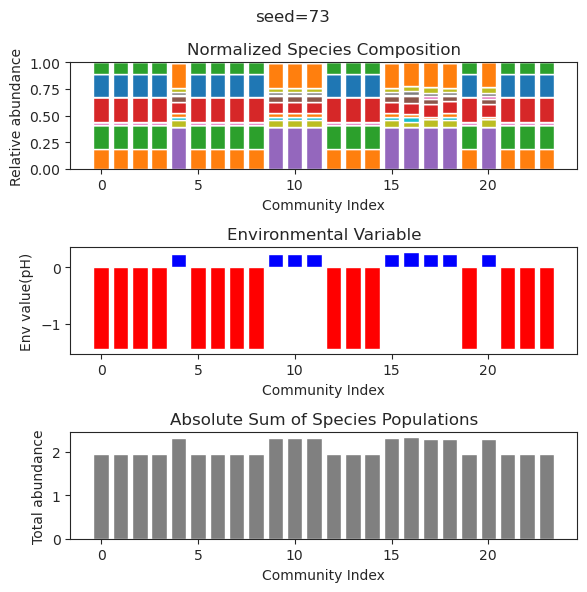

{'species': array([-9.95922604e-105,  1.83242207e-001,  2.41505011e-001,
        1.90767972e-016,  1.36609654e-001,  0.00000000e+000,
       -6.38192007e-126,  5.83437028e-234,  4.35285295e-001,
        3.84257028e-184, -9.78694632e-287,  9.17225368e-231,
        2.66697579e-041,  5.42580571e-080,  1.52667185e-205,
        2.80692811e-001,  2.34965200e-031,  8.81048818e-029,
        5.52893763e-001,  9.30773889e-003, -7.33744237e-047,
        2.44391200e-026,  2.89000723e-182,  8.48347980e-002]), 'env': array([-0.57178587])}
{'species': array([ 3.01527113e-019,  2.31619437e-001,  2.06167077e-004,
       -1.31615610e-032,  2.16699229e-030, -4.92858186e-116,
        1.00360989e-039, -3.04096980e-034,  4.00301100e-001,
        1.22839378e-118,  3.60262767e-030,  1.82737045e-030,
        5.28022111e-002, -2.54270023e-028,  1.82792280e-030,
        4.79339137e-001,  1.74061280e-020, -1.89454725e-031,
        5.68368105e-001, -6.44601419e-029,  2.07153378e-115,
        1.87778884e-001, -1.45

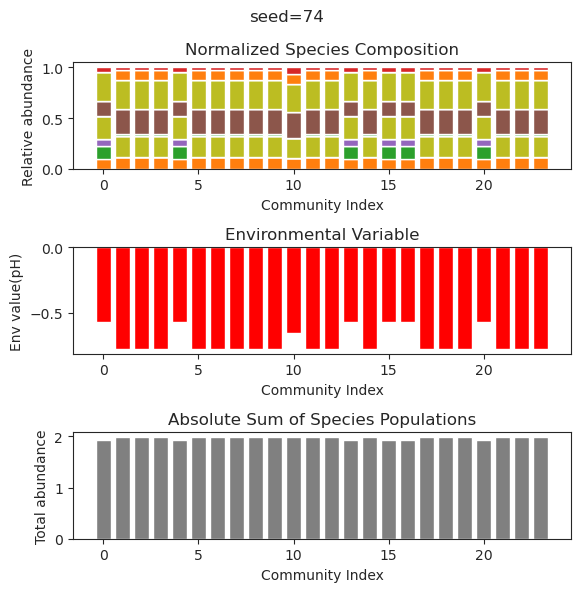

{'species': array([ 7.58194924e-002,  0.00000000e+000,  1.12795885e-252,
        1.48726130e-008,  3.79934789e-129, -4.94065646e-324,
        4.97363273e-177,  8.79141499e-200,  7.48440918e-001,
       -9.88131292e-324,  2.63469853e-020,  3.61055678e-001,
       -6.42285340e-323,  2.47737591e-043,  1.08122194e-001,
        6.64615733e-001, -5.19599754e-102,  2.12752131e-072,
        4.84015646e-207,  2.84055495e-211,  2.42563033e-001,
       -4.94065646e-324,  1.71810139e-151,  1.20200140e-192]), 'env': array([0.12456683])}
{'species': array([ 1.54656862e-001,  1.32547148e-040, -4.96016261e-139,
       -8.03023291e-031,  4.72420935e-001, -1.79416903e-128,
        5.12110183e-002,  1.66198429e-139,  5.56452124e-026,
        1.73331766e-138, -2.12390628e-089, -1.50789596e-110,
        3.20244240e-118,  2.97734622e-056,  8.92250906e-111,
        4.90162805e-001, -5.87298628e-072, -6.54972906e-069,
       -6.04113507e-107,  1.97028090e-001,  2.64004580e-053,
        4.31992102e-075,  5.868

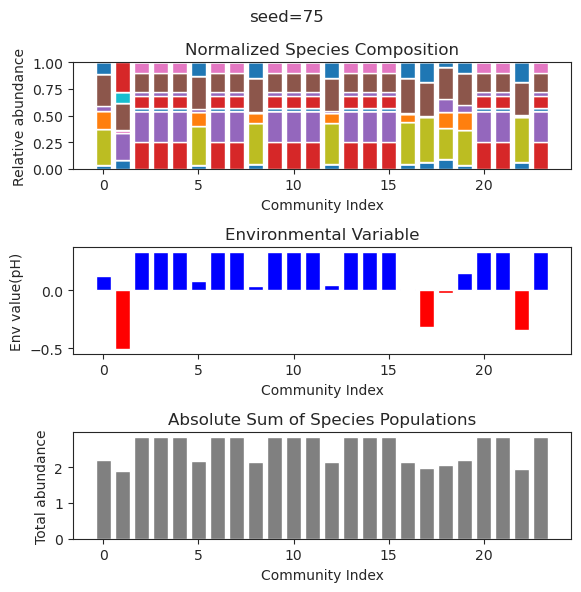

{'species': array([ 2.32737780e-001, -8.43725461e-228,  3.78808701e-001,
        3.59895693e-001,  1.83335815e-001, -1.86861182e-064,
        7.01596130e-157,  1.84910832e-220,  5.50003870e-129,
       -3.28703846e-061, -2.57943307e-179, -1.88193061e-071,
        4.12945338e-225,  2.22237308e-001,  9.26382199e-081,
       -4.28187872e-124,  5.36723528e-001,  3.78953551e-197,
        4.47407217e-049, -1.14261389e-183,  1.17120104e-220,
        3.14904899e-022,  2.65179393e-001, -7.32683899e-120]), 'env': array([-0.87007721])}
{'species': array([-2.09148889e-097,  4.15238710e-033,  5.72129721e-118,
        1.80894960e-001,  5.76878089e-001, -1.50847574e-031,
       -4.02626491e-114, -1.47040167e-046,  6.25880381e-141,
        7.69347052e-052,  9.06835543e-167,  2.75865976e-001,
        5.80806068e-001,  2.76082697e-150, -5.45766081e-131,
        1.25094209e-135, -1.97961691e-107,  6.49396534e-001,
        1.86818223e-119,  6.16397048e-001,  6.69221159e-001,
       -1.09145840e-107, -5.31

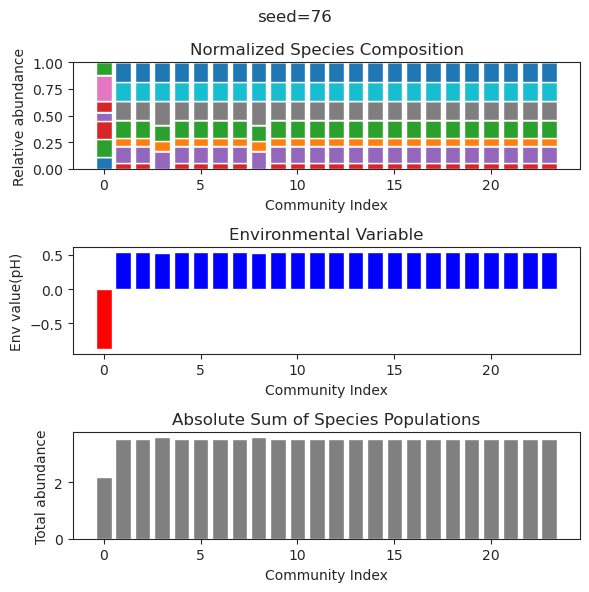

{'species': array([ 7.04152754e-02,  2.38067966e-01,  1.69652186e-33,  8.31546973e-76,
        1.11935693e-02, -2.66999525e-45, -3.69495716e-32, -1.54098728e-81,
        1.98104248e-81,  1.76617322e-01,  8.26596760e-01, -5.81800101e-70,
        8.40993379e-68,  6.26247003e-74,  5.16448721e-93,  3.21141539e-01,
       -1.66761371e-93,  3.11925019e-87, -1.95742627e-81,  3.76349920e-89,
       -1.18976819e-85,  2.37946854e-89,  1.70241461e-25, -7.73665190e-61]), 'env': array([-1.29023231])}
{'species': array([ 7.04152792e-02,  2.38067962e-01,  2.92333757e-45,  4.77579551e-32,
        1.11935802e-02,  2.08489782e-34,  7.46441176e-41,  4.22515491e-55,
       -1.94181878e-52,  1.76617325e-01,  8.26596755e-01,  4.69291685e-55,
        1.42025427e-31, -4.89635351e-34,  6.37817512e-34,  3.21141539e-01,
        4.01238449e-64, -3.83261974e-61, -3.57295086e-60,  3.96744843e-61,
        2.75510846e-34, -9.96931377e-60, -2.53900994e-17, -2.70421925e-44]), 'env': array([-1.2902323])}
{'species': arr

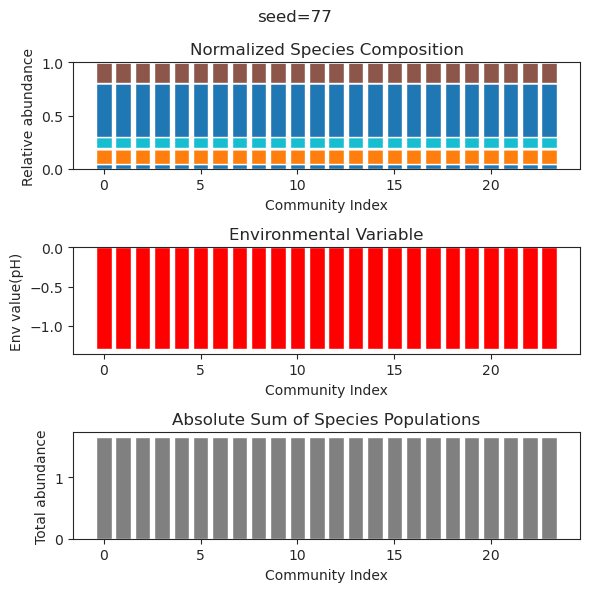

{'species': array([ 4.78863628e-86,  2.40592858e-01, -4.02568280e-64,  3.40890713e-01,
        4.48616484e-85, -1.25793416e-88, -1.04317957e-32, -1.22145095e-30,
       -4.81703974e-33,  3.11090561e-79, -2.13440940e-82,  2.17504755e-17,
        5.61281612e-01, -7.74047707e-49,  6.19777174e-77,  3.45480625e-01,
        1.73913725e-01, -4.55853981e-35, -1.71205450e-40,  1.00251622e-41,
        8.94969382e-75,  6.15331751e-01,  6.26932318e-18,  9.59365234e-69]), 'env': array([-0.96950779])}
{'species': array([ 3.31404546e-76,  2.40592858e-01, -6.40522151e-56,  3.40890713e-01,
       -4.02029412e-77, -3.62204692e-80,  7.97763528e-33,  2.35474105e-31,
        1.55201242e-29,  9.24390134e-72,  6.35327512e-74, -9.32536172e-19,
        5.61281612e-01,  3.11341411e-47,  7.14654498e-67,  3.45480625e-01,
        1.73913725e-01,  1.59239746e-35,  1.23527892e-38,  1.97351220e-37,
        2.76543273e-68,  6.15331751e-01, -4.76668132e-20,  2.05609006e-64]), 'env': array([-0.96950779])}
{'species': ar

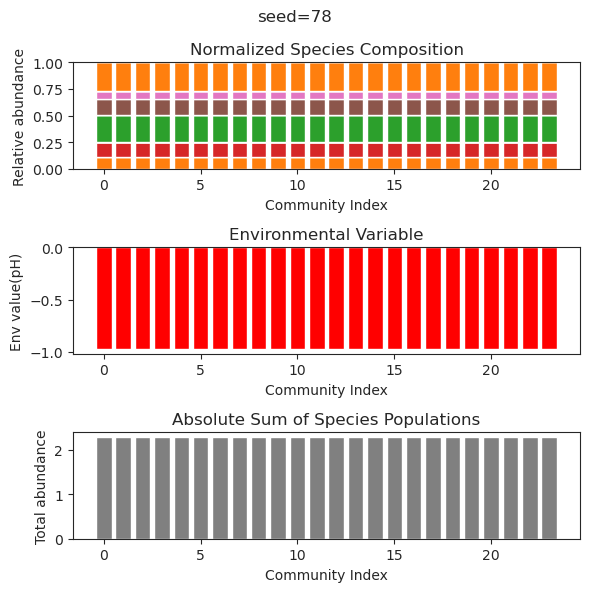

{'species': array([ 3.24865096e-01,  6.76107618e-54, -3.21248437e-33,  3.94448743e-28,
        3.30617803e-16, -4.15857613e-25, -1.19960135e-54,  1.03338113e-44,
        6.43924345e-01,  4.91940359e-51,  2.67431458e-36, -1.18219560e-23,
        2.29640540e-54, -1.41496073e-33, -6.42017099e-52,  1.86105940e-46,
        8.87341863e-01,  7.02905023e-43, -8.14455799e-47, -1.96318202e-36,
        2.65865687e-55,  4.08130646e-32,  2.93815722e-01, -2.36243546e-53]), 'env': array([-1.28887284])}
{'species': array([ 3.24865096e-01,  3.92342452e-83, -2.52658581e-44,  4.66125825e-28,
        2.96346625e-17,  6.65631481e-34,  2.00704958e-87,  2.83583732e-84,
        6.43924345e-01, -2.92931935e-91, -7.76893482e-49, -9.88042310e-25,
        6.06284687e-85,  1.03913073e-46,  2.32817512e-82, -6.89103010e-69,
        8.87341863e-01,  6.52117382e-85, -1.49386202e-61,  1.66097504e-57,
        4.69296229e-86, -6.33563685e-40,  2.93815722e-01,  4.27330466e-90]), 'env': array([-1.28887284])}
{'species': ar

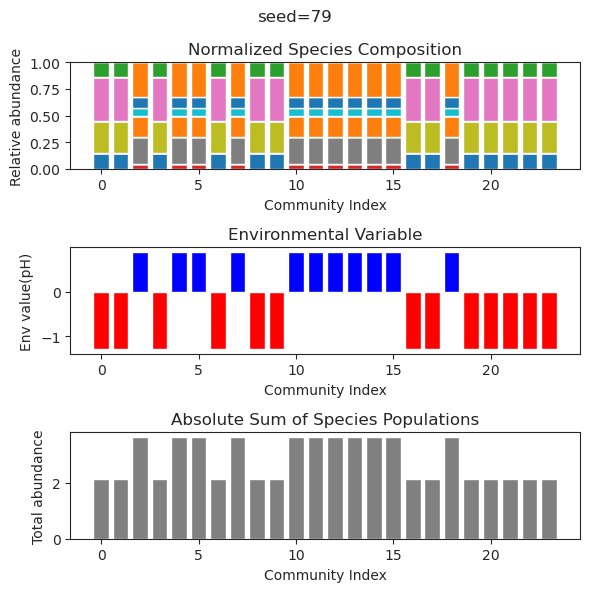

{'species': array([ 4.00267950e-128,  8.52772195e-163, -1.25325695e-212,
       -2.10713942e-195,  2.03619228e-096,  1.03108754e+000,
        5.89837845e-001,  1.03062672e+000, -9.74433916e-032,
        1.93093407e-043, -1.42476691e-209,  6.36242179e-194,
       -1.76899629e-119, -1.61871713e-112, -5.90955997e-164,
       -1.04723581e-029,  1.81745121e-091,  6.08631719e-120,
        6.52446933e-052,  7.82999874e-169,  3.10138832e-001,
       -4.56188335e-144, -9.29936519e-100,  2.87937547e-151]), 'env': array([0.66689944])}
{'species': array([ 4.00267950e-128,  8.52772195e-163, -1.25325695e-212,
       -2.10713942e-195,  2.03619228e-096,  1.03108754e+000,
        5.89837845e-001,  1.03062672e+000, -9.74433916e-032,
        1.93093407e-043, -1.42476691e-209,  6.36242179e-194,
       -1.76899629e-119, -1.61871713e-112, -5.90955997e-164,
       -1.04723581e-029,  1.81745121e-091,  6.08631719e-120,
        6.52446933e-052,  7.82999874e-169,  3.10138832e-001,
       -4.56188335e-144, -9.299

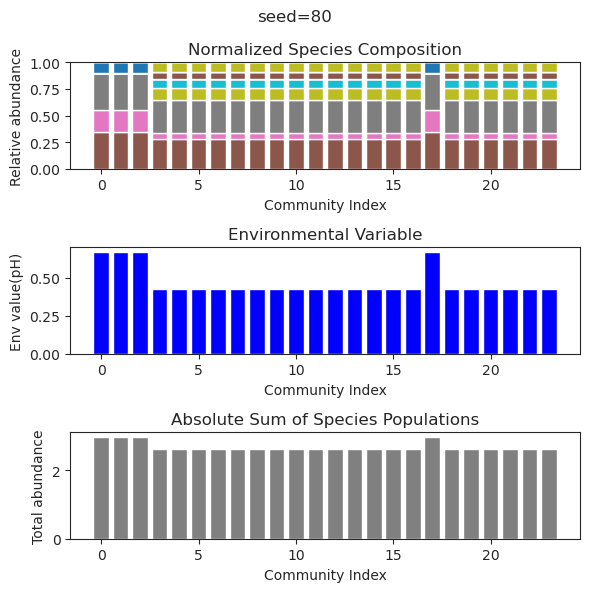

{'species': array([ 4.17221255e-019,  3.56348401e-088,  1.09972042e-054,
        8.42685803e-130, -1.05774714e-031,  7.40881111e-001,
        1.38524582e-001,  8.19734785e-001,  2.91886804e-001,
        2.17490608e-001, -1.18207178e-083, -2.04848357e-089,
        2.22052082e-122, -2.94078032e-135, -6.87626352e-110,
        1.84023601e-001, -6.73355892e-072,  5.31387751e-112,
        2.26368273e-001, -5.96686461e-124,  1.98335273e-044,
       -4.49592241e-085,  2.59123867e-062,  4.36749104e-056]), 'env': array([0.42307866])}
{'species': array([ 4.17221255e-019,  3.56348401e-088,  1.09972042e-054,
        8.42685803e-130, -1.05774714e-031,  7.40881111e-001,
        1.38524582e-001,  8.19734785e-001,  2.91886804e-001,
        2.17490608e-001, -1.18207178e-083, -2.04848357e-089,
        2.22052082e-122, -2.94078032e-135, -6.87626352e-110,
        1.84023601e-001, -6.73355892e-072,  5.31387751e-112,
        2.26368273e-001, -5.96686461e-124,  1.98335273e-044,
       -4.49592241e-085,  2.591

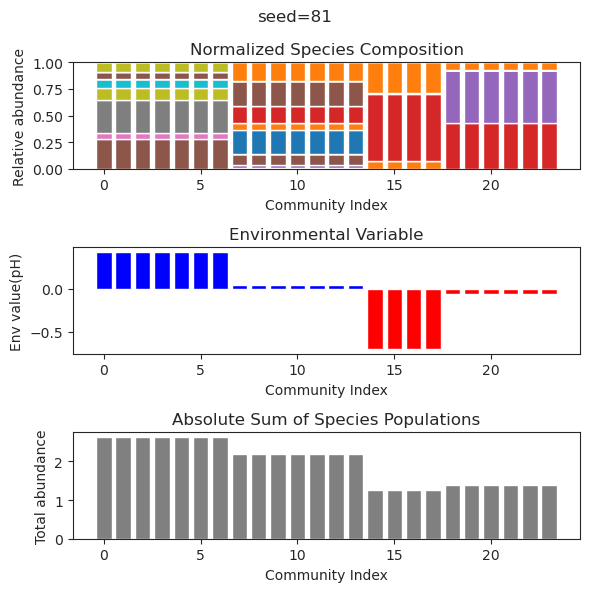

{'species': array([ 1.84242680e-007,  3.60345715e-001,  2.75115356e-009,
        3.89691516e-045, -2.98969112e-124, -2.50093794e-177,
        6.07091008e-001,  1.01248024e-124,  1.04952253e-005,
        8.63495111e-011,  1.46156653e-044,  4.33669031e-230,
        8.27463734e-197,  1.47879307e-094,  7.96384318e-012,
        1.86356218e-191,  4.65986658e-001,  3.81291971e-196,
        3.30136415e-082,  8.05913370e-010, -4.37036393e-173,
        8.31132793e-009,  5.93258874e-039,  1.40758649e-060]), 'env': array([-1.41724428])}
{'species': array([ 6.59014521e-005,  1.67919719e-004,  2.90452005e-004,
        1.80086545e-058, -3.14959208e-136, -2.37172496e-169,
        2.97052102e-006,  5.73872754e-118,  7.39538079e-022,
        6.81131814e-015,  7.34309892e-048,  2.08736611e-222,
        5.12820321e-188,  4.49573987e-089,  1.77572459e-001,
       -3.79704956e-177,  2.96404998e-003, -4.58672453e-200,
        1.09254354e-090,  7.49892775e-001, -6.87542133e-172,
        1.03840943e+000,  2.89

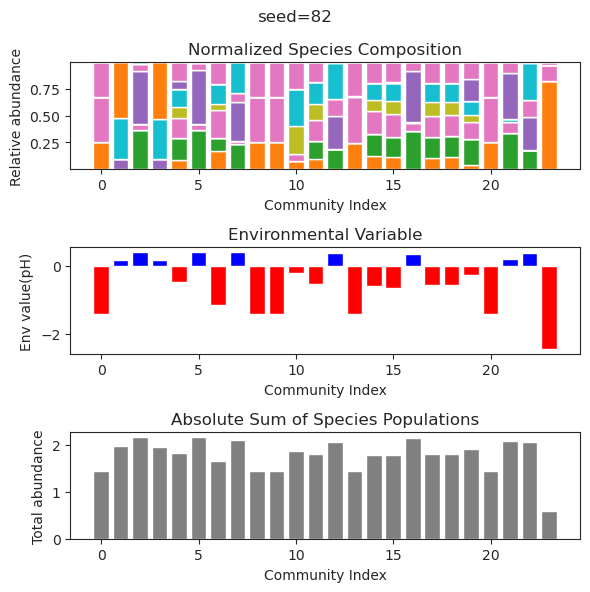

{'species': array([-2.11567196e-084,  9.62998904e-247,  1.13647311e-001,
       -2.33173824e-127,  1.20431979e-076,  5.75844496e-001,
       -1.11122403e-036, -1.65571974e-215, -5.52634811e-120,
        1.62373317e-132,  9.84928771e-001, -2.65207474e-157,
        5.78993077e-217,  1.15672769e+000, -4.69156200e-221,
        9.93222060e-001,  7.66631918e-062,  1.77250477e-155,
        3.08012352e-224, -5.08017389e-184,  1.02413545e+000,
        1.66543897e-192, -6.79095267e-166,  1.45123117e-207]), 'env': array([1.40410588])}
{'species': array([-2.11567196e-084,  9.62998904e-247,  1.13647311e-001,
       -2.33173824e-127,  1.20431979e-076,  5.75844496e-001,
       -1.11122403e-036, -1.65571974e-215, -5.52634811e-120,
        1.62373317e-132,  9.84928771e-001, -2.65207474e-157,
        5.78993077e-217,  1.15672769e+000, -4.69156200e-221,
        9.93222060e-001,  7.66631918e-062,  1.77250477e-155,
        3.08012352e-224, -5.08017389e-184,  1.02413545e+000,
        1.66543897e-192, -6.790

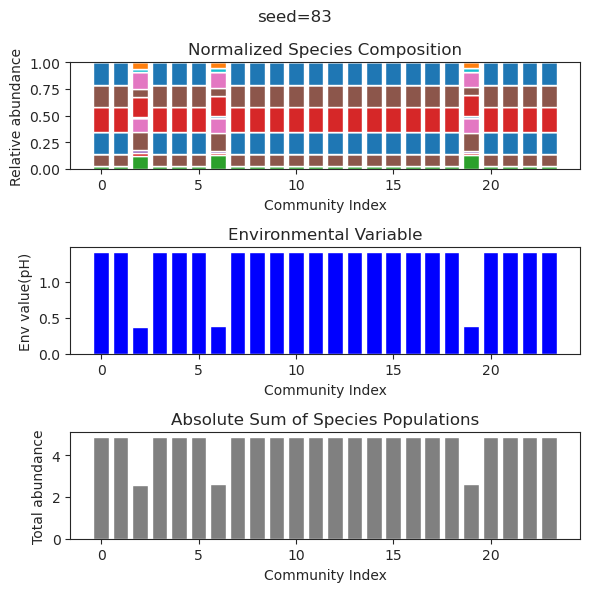

{'species': array([ 2.83560288e-02,  3.04307747e-01,  6.84890439e-02,  5.44332662e-01,
       -4.17568242e-45,  3.00499694e-01,  1.61887900e-75,  5.17683739e-01,
        2.14589188e-72,  2.03496468e-02, -4.31239420e-65,  6.53184034e-02,
       -3.91584074e-41,  1.98889665e-75,  1.41280596e-02,  3.30809106e-79,
        2.19892923e-77,  2.89086013e-76, -1.30989589e-72, -2.05420254e-75,
        4.95477928e-72,  1.75544979e-71,  7.90296025e-79, -2.19626492e-48]), 'env': array([-1.41541942])}
{'species': array([ 2.83560216e-002,  3.04307757e-001,  6.84890665e-002,
        5.44332659e-001, -1.31756620e-081,  3.00499688e-001,
       -1.81647268e-087,  5.17683753e-001, -7.98014729e-088,
        2.03496085e-002,  1.29996692e-073,  6.53183796e-002,
       -1.20952536e-025, -1.94135917e-094,  1.41280626e-002,
        9.80823744e-102, -3.14735429e-095, -7.87420250e-093,
        2.93608102e-082,  7.92739133e-092, -1.64322887e-080,
       -2.25465141e-088, -4.33236363e-098, -1.60690022e-047]), 'env'

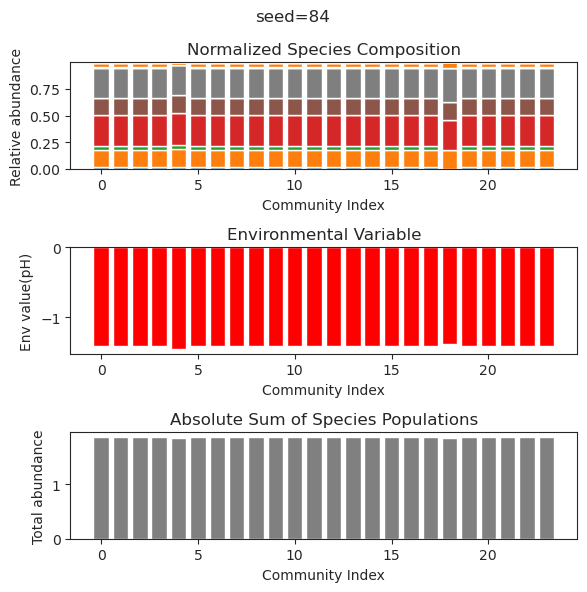

{'species': array([ 9.75941574e-024,  1.46038856e-001,  1.06236252e-001,
        6.03484488e-085, -4.94065646e-324,  6.63489650e-001,
        4.63173030e-202,  4.62420725e-001,  2.35289090e-129,
        0.00000000e+000,  8.65346348e-310,  3.78453380e-001,
        0.00000000e+000,  2.24244738e-001,  2.45569104e-001,
        4.37792365e-138,  6.12273937e-128,  7.55746719e-290,
        5.45924983e-055,  5.76115460e-152, -4.38358950e-242,
        0.00000000e+000,  0.00000000e+000,  4.74008507e-216]), 'env': array([-0.33843958])}
{'species': array([ 6.32571240e-013,  1.48854479e-001,  1.09417089e-001,
        2.34391761e-075, -1.41647646e-249,  6.65433344e-001,
        2.11525799e-154,  4.54277456e-001, -2.75137064e-237,
        1.24749221e-260,  3.40224625e-165,  3.83038040e-001,
       -2.34605696e-308,  2.17718213e-001,  2.44226743e-001,
        4.10206714e-131,  8.11428855e-104,  1.15776610e-314,
        3.04673648e-042,  1.31822967e-105, -1.48961533e-163,
        4.80261036e-239, -1.75

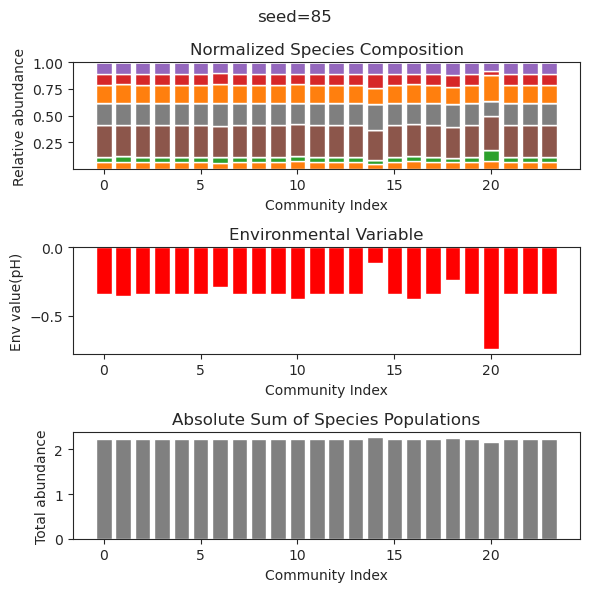

{'species': array([ 1.99333922e-036,  1.84422350e-001,  1.26121091e-001,
        2.08026207e-169,  3.52419947e-313,  1.25557355e-001,
        4.94065646e-324,  2.10477830e-001,  3.98950450e-001,
        1.88447385e-001,  4.94065646e-324,  1.02438326e-316,
       -2.42322863e-145,  7.07273834e-003,  1.24841160e-014,
        2.04206495e-268,  4.72004251e-060,  2.69456325e-077,
       -2.88813146e-182,  4.88421253e-263,  3.13149043e-001,
        1.25961443e-001, -7.12875194e-306,  1.90341424e-001]), 'env': array([-0.72380404])}
{'species': array([ 1.78703140e-037,  1.84423407e-001,  1.26120604e-001,
        1.57976636e-104,  8.36712148e-281,  1.25557548e-001,
        2.23991888e-090,  2.10477978e-001,  3.98953682e-001,
        1.88448396e-001,  6.34366400e-291, -4.62807331e-278,
        9.11000224e-066,  7.07262843e-003,  1.49341707e-016,
        1.71238561e-243,  1.61521116e-061,  9.71560920e-078,
        1.64472996e-180,  1.14305616e-241,  3.13148326e-001,
        1.25960589e-001, -1.00

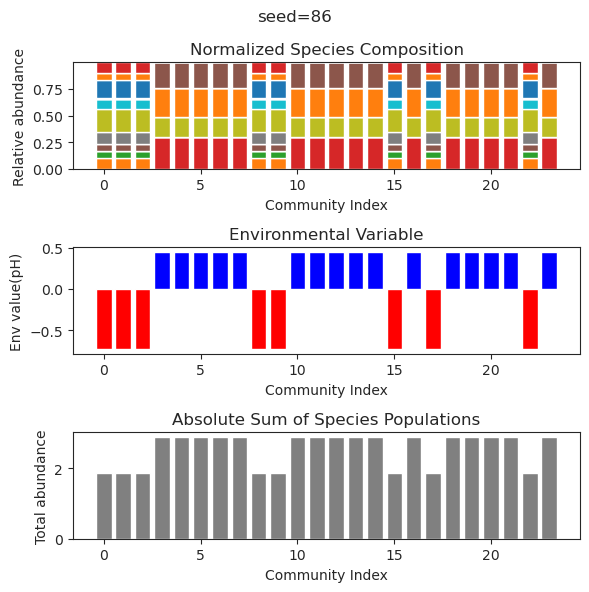

{'species': array([ 1.88320580e-001,  2.13543304e-028, -9.43146615e-173,
        1.02207613e-153,  4.05725882e-002,  4.51679195e-120,
       -6.54310124e-082,  3.62791473e-001,  7.63460149e-164,
        2.77863334e-001, -2.59058972e-088,  5.25970386e-031,
        3.24746325e-001,  3.89245330e-001,  1.05171889e-156,
       -2.69795709e-069, -2.88454155e-069, -1.17375121e-049,
       -7.72311193e-018,  4.06997798e-027,  2.35640621e-017,
       -1.43032920e-068,  2.84166367e-001,  5.91576369e-142]), 'env': array([-0.7182091])}
{'species': array([ 1.88320580e-001,  2.29251711e-022,  1.69101328e-112,
        5.01471729e-109,  4.05725882e-002,  1.89912001e-095,
        9.93784610e-061,  3.62791473e-001,  1.99045576e-096,
        2.77863334e-001,  1.20565206e-057, -1.60539832e-027,
        3.24746325e-001,  3.89245330e-001,  1.86054235e-101,
       -1.31998775e-075,  5.57700476e-047, -3.91843632e-038,
       -1.46724684e-046,  2.67640346e-032,  4.34691231e-014,
       -1.12500146e-058,  2.841

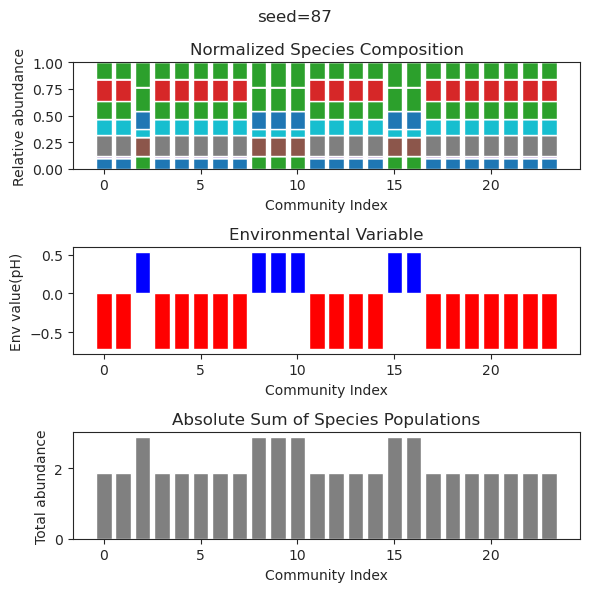

{'species': array([-2.49890589e-103, -1.27855910e-121,  5.63471354e-001,
        2.08997841e-001,  4.70378846e-001,  3.29124115e-001,
        5.50455391e-001,  2.63247797e-104,  8.91853590e-044,
        2.04959433e-093,  4.77175034e-036,  2.80932757e-077,
        5.48237657e-083,  1.83117282e-045,  9.17187521e-017,
       -5.31191879e-082, -7.48106253e-110, -5.59602811e-113,
        5.36545052e-001,  1.46316196e-042, -1.19939312e-096,
        1.52312653e-050, -5.57909237e-124,  6.82404006e-037]), 'env': array([0.51505072])}
{'species': array([ 2.70073350e-107, -3.43481707e-107,  5.63471354e-001,
        2.08997841e-001,  4.70378846e-001,  3.29124115e-001,
        5.50455391e-001,  1.84247700e-105, -1.60356718e-046,
       -1.73475780e-098,  3.12955000e-033, -6.53247354e-088,
       -4.88651199e-080, -4.70231141e-048,  7.13220125e-017,
       -3.70844367e-086, -1.66681718e-084, -1.51399663e-116,
        5.36545052e-001,  2.55658575e-038, -2.01600019e-094,
        4.55196675e-057, -4.833

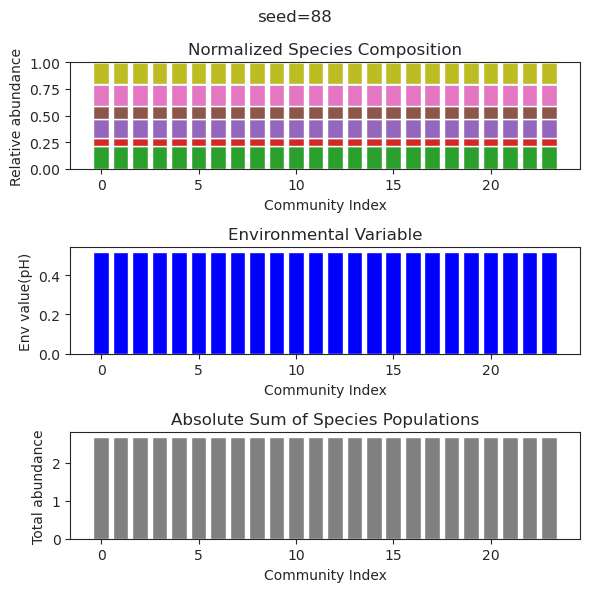

{'species': array([ 6.65538696e-80,  5.59672391e-47,  5.63471354e-01,  2.08997841e-01,
        4.70378846e-01,  3.29124115e-01,  5.50455391e-01,  1.26111093e-78,
       -7.02093405e-45,  9.71415907e-75,  2.29507872e-38,  3.93705201e-60,
        1.19408965e-59, -2.55117067e-45,  1.43066942e-17,  6.62355185e-62,
       -1.09706334e-78,  7.74585693e-84,  5.36545052e-01,  1.01553974e-41,
       -8.77366486e-71, -1.05318825e-45, -2.40076156e-86,  1.81850227e-28]), 'env': array([0.51505072])}
{'species': array([3.78387930e-099, 1.48161914e-001, 1.11402030e-141, 9.95092249e-238,
       3.98074511e-001, 7.29727447e-279, 3.47933941e-093, 3.90459674e-001,
       4.68605244e-001, 2.42861735e-001, 3.00798116e-001, 0.00000000e+000,
       5.97935264e-002, 8.74860459e-002, 5.57115200e-091, 1.19985280e-092,
       4.94065646e-324, 1.44199178e-264, 4.55323133e-134, 1.32324466e-214,
       1.95936980e-208, 3.92034528e-255, 2.72121167e-001, 2.62744446e-161]), 'env': array([-0.2055271])}
{'species': arra

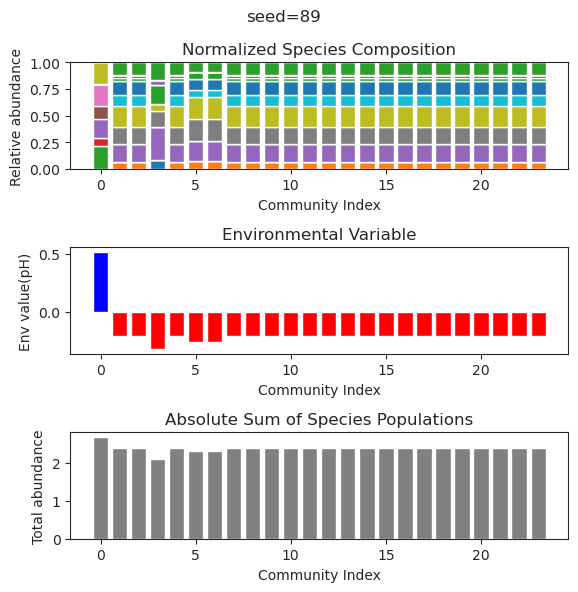

{'species': array([ 2.59752306e-01,  1.46699202e-55,  3.11544529e-40,  7.22033546e-09,
        7.99199983e-62, -1.98529753e-65,  1.93118118e-61,  6.25707500e-61,
       -5.33083605e-71,  1.80590361e-01, -1.30819585e-41,  8.81119672e-41,
        3.38815244e-01,  6.83699722e-01,  6.09103140e-56, -1.48774243e-63,
        4.88241770e-52,  5.04198785e-61,  8.94576442e-58, -2.15018983e-29,
       -1.67448484e-30,  1.61549092e-01,  4.92872818e-01, -3.19629696e-29]), 'env': array([-1.11370849])}
{'species': array([ 2.59752309e-01, -1.85229321e-49, -4.23736618e-29,  5.06126895e-13,
       -6.55583536e-58, -2.40671693e-56, -1.37230183e-53, -8.40880631e-56,
       -6.84866019e-63,  1.80590351e-01, -1.55013740e-40,  2.16012830e-29,
        3.38815245e-01,  6.83699733e-01, -3.27395168e-40, -1.39419678e-52,
       -4.52310659e-38, -2.23937455e-56,  4.99724172e-43, -7.69048754e-22,
        5.50326594e-18,  1.61549106e-01,  4.92872808e-01, -1.18178739e-34]), 'env': array([-1.1137085])}
{'species': arr

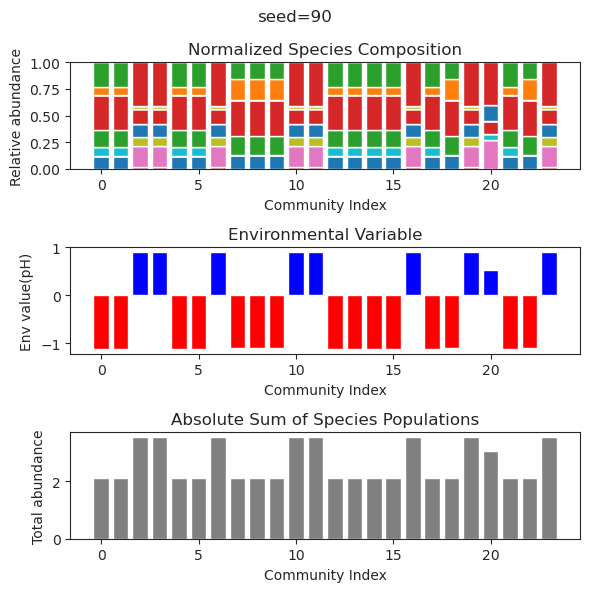

{'species': array([ 1.59128102e-097,  1.56323039e-001, -6.75113920e-037,
        4.60000445e-110,  1.52860966e-001,  1.07239473e-001,
       -8.08784258e-102, -7.77286325e-031, -1.55423385e-111,
        7.01247093e-001,  2.86347119e-114, -2.57674336e-125,
        6.07728056e-112,  7.45601269e-001,  2.40317100e-122,
        3.94124289e-001, -6.18547510e-116, -1.27226938e-118,
        3.46262731e-077, -9.77744799e-118, -1.33397107e-023,
        1.61857644e-035,  8.89583618e-002, -2.17565421e-102]), 'env': array([-0.38074444])}
{'species': array([-4.35307227e-096,  1.56323039e-001, -9.87725288e-037,
        1.56017845e-103,  1.52860966e-001,  1.07239473e-001,
       -5.01012223e-089, -1.37817803e-035, -7.20478912e-108,
        7.01247093e-001,  3.11834538e-110, -9.81632693e-109,
        8.56608347e-109,  7.45601269e-001,  4.38522575e-108,
        3.94124289e-001,  1.16034986e-114, -1.08515861e-111,
       -7.57003091e-071, -5.67006944e-103, -7.16576543e-025,
        7.26268312e-037,  8.89

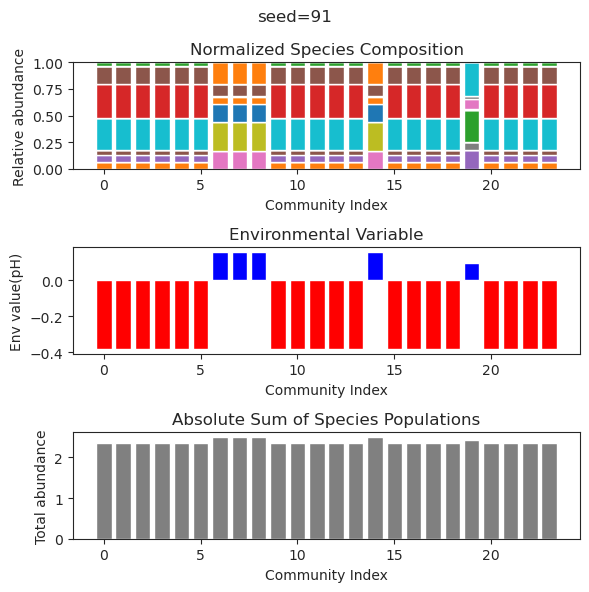

{'species': array([-5.77340881e-232,  2.23341302e-138,  1.80702989e-001,
        1.34196361e-201,  2.02162578e-162,  3.83056802e-001,
        7.49870474e-212, -4.16825928e-102,  8.18815329e-140,
        3.56095709e-137,  9.79533790e-001,  3.94320435e-001,
       -1.88208147e-037,  1.24446581e-033,  1.13248365e-158,
       -4.88316432e-232,  1.44625362e-230, -1.35239558e-098,
        2.25199595e-001,  2.36369829e-204,  2.20081294e-024,
        4.50905546e-019,  7.30450978e-001,  7.42703592e-048]), 'env': array([0.67144624])}
{'species': array([ 1.26528934e-312,  1.45751789e-001,  2.98220064e-279,
        1.58868626e-001,  1.29435385e-037,  2.17636559e-001,
       -4.94065646e-324,  3.86127645e-010,  5.28270855e-194,
        1.40253358e-272,  1.84938706e-097,  8.14027975e-033,
        7.96496339e-277,  1.08794074e-033, -4.94065646e-324,
        0.00000000e+000,  3.33460446e-001,  7.38505741e-001,
        1.50574918e-113,  3.07534213e-032,  1.29335758e-001,
        3.72849184e-255,  4.940

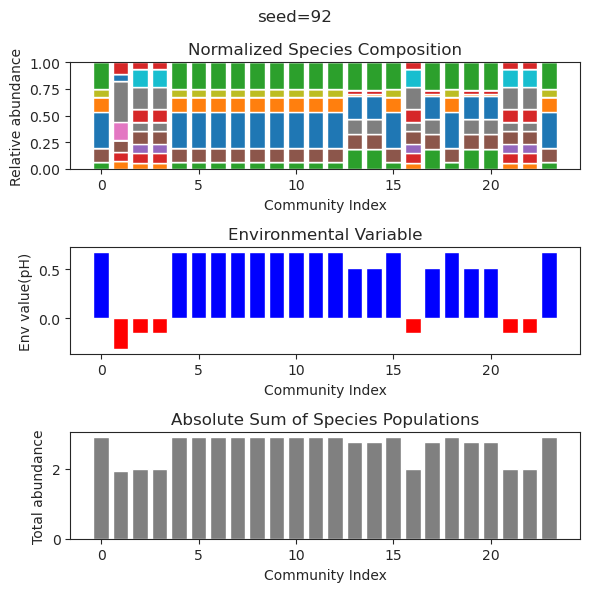

{'species': array([-3.35826140e-041, -6.12823497e-191,  6.29840189e-155,
        1.49556366e-185,  2.09581588e-001, -1.44408294e-028,
       -4.61377105e-129,  9.18763560e-056,  1.63824091e-132,
        2.71432510e-023, -6.06833790e-106,  1.65365010e-161,
        1.41335435e-001, -1.24941956e-107, -1.67948828e-096,
       -5.94138604e-208, -5.21178871e-155,  4.77751270e-001,
        2.11322608e-001,  7.22088016e-001,  2.72767871e-001,
        3.61115175e-001, -4.55751520e-127, -2.71264149e-147]), 'env': array([0.13228283])}
{'species': array([-3.35826140e-041, -6.12823497e-191,  6.29840189e-155,
        1.49556366e-185,  2.09581588e-001, -1.44408294e-028,
       -4.61377105e-129,  9.18763560e-056,  1.63824091e-132,
        2.71432510e-023, -6.06833790e-106,  1.65365010e-161,
        1.41335435e-001, -1.24941956e-107, -1.67948828e-096,
       -5.94138604e-208, -5.21178871e-155,  4.77751270e-001,
        2.11322608e-001,  7.22088016e-001,  2.72767871e-001,
        3.61115175e-001, -4.557

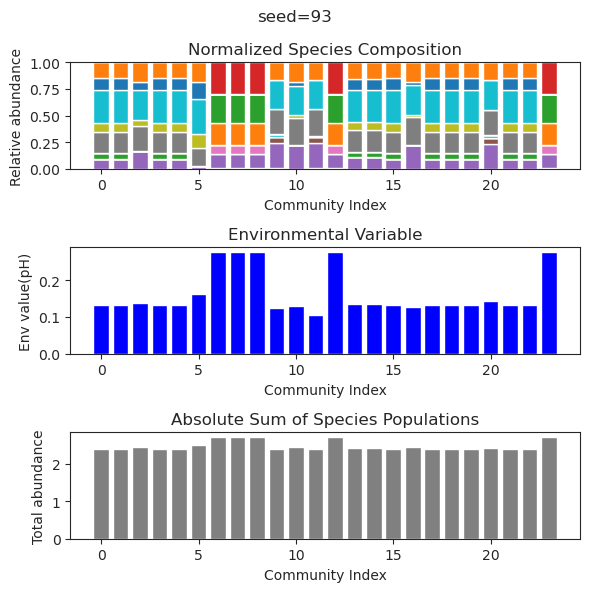

{'species': array([ 1.33903451e-170,  9.42978136e-002,  2.99571472e-285,
        5.34368779e-001,  1.21723028e-032,  1.89894253e-287,
       -4.94065646e-324,  3.19516789e-098,  3.46760014e-075,
        3.29324014e-216,  5.47108390e-001,  1.16762829e-095,
        3.13582110e-002,  2.88406603e-001,  4.83601651e-212,
        4.94065646e-324,  3.99901793e-001,  6.40470312e-062,
        1.68691924e-127,  9.36085199e-002,  8.47075550e-320,
        1.17219095e-316,  2.02932776e-139,  1.39149005e-001]), 'env': array([-0.14513995])}
{'species': array([1.70896684e-188, 9.48218130e-002, 1.17962504e-306, 5.33429396e-001,
       5.67782576e-044, 1.89138358e-272, 4.94065646e-324, 1.67890537e-095,
       3.56862703e-068, 1.55442973e-189, 5.48120105e-001, 6.72029004e-061,
       3.13140274e-002, 2.87600361e-001, 2.72260767e-173, 0.00000000e+000,
       3.99806053e-001, 1.89624630e-056, 3.44532338e-128, 9.33314394e-002,
       7.90505033e-323, 0.00000000e+000, 9.97244897e-130, 1.38578097e-001]), 'env'

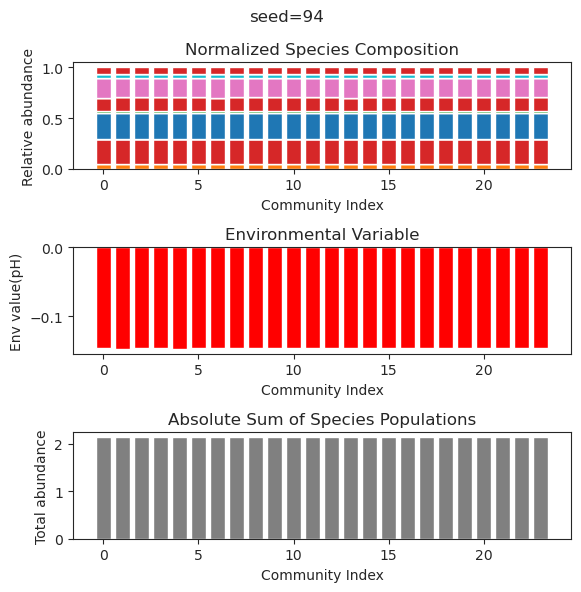

{'species': array([-1.05920390e-42,  2.87186503e-01, -3.40958948e-30,  8.96288020e-01,
        1.98520083e-01, -3.82114482e-48,  5.32784007e-01,  8.10681362e-64,
       -9.88847535e-26,  1.01978215e-66, -1.02766059e-49, -7.42970315e-51,
        6.44271059e-61, -8.39831831e-70,  5.32220130e-18,  1.48656677e-46,
       -3.82978785e-75,  1.96270794e-59,  3.40313148e-01,  1.20477258e-68,
        7.02960583e-49,  3.37888980e-28,  1.94043332e-68, -1.93950154e-57]), 'env': array([-0.83414954])}
{'species': array([-5.07180911e-72,  2.87186503e-01,  5.81821432e-27,  8.96288020e-01,
        1.98520083e-01, -1.01584425e-48,  5.32784007e-01, -2.62130486e-70,
        3.15653538e-22,  3.04287852e-69, -1.51248805e-48, -5.77036628e-52,
        1.75364538e-65, -6.28073863e-76, -6.59998882e-17,  1.91257323e-47,
       -2.49816612e-78,  2.49662506e-62,  3.40313148e-01, -5.27489580e-73,
       -1.45906566e-51, -1.04173539e-26, -3.19945785e-72,  3.99033943e-62]), 'env': array([-0.83414954])}
{'species': ar

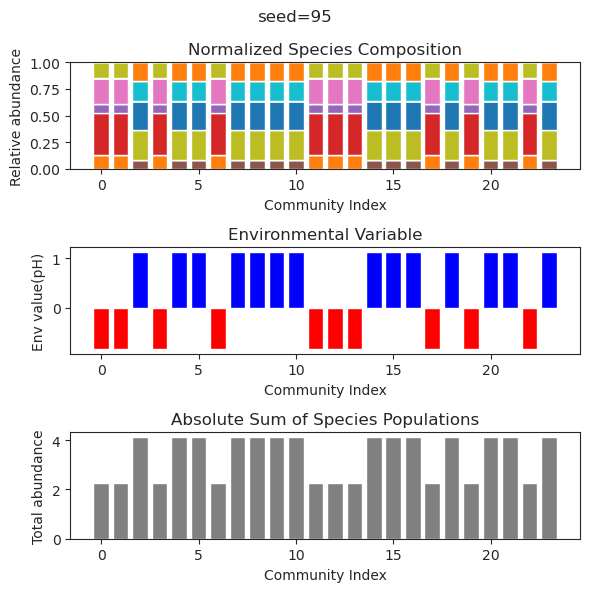

{'species': array([-1.09646506e-140, -1.42109138e-080,  5.06473890e-001,
        5.43920830e-202,  1.02392342e-001,  1.64369621e-001,
       -1.62502359e-254,  2.30984342e-212, -1.87659018e-124,
        8.79076856e-001,  1.55814349e-228, -1.79087619e-074,
        3.38773025e-116,  3.25068617e-224,  2.54687662e-184,
       -7.91344133e-185, -1.99981662e-229, -2.76088409e-221,
        1.10638551e+000,  6.48783551e-002,  7.49862872e-140,
        6.06933861e-149,  4.85423489e-193,  8.67798089e-129]), 'env': array([0.33673348])}
{'species': array([ 1.36382914e-044,  4.97940759e-040,  5.06473890e-001,
       -2.04776306e-137,  1.02392342e-001,  1.64369621e-001,
       -7.01895800e-164,  6.81915584e-135, -9.43131423e-089,
        8.79076856e-001,  1.45492013e-151,  2.71601282e-099,
       -7.08082966e-123,  1.59490917e-143, -4.02807129e-123,
        1.87108586e-142,  9.76506526e-146, -3.53108694e-152,
        1.10638551e+000,  6.48783551e-002,  1.30511830e-099,
        3.04834508e-096,  2.116

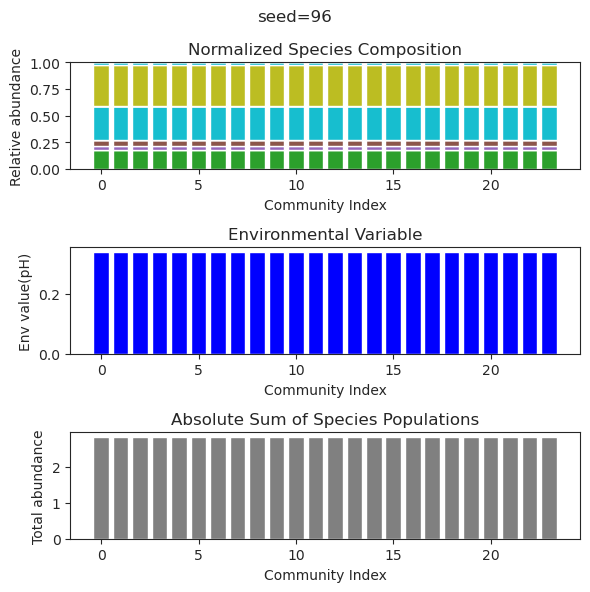

{'species': array([ 3.92919261e-002,  1.77164406e-065,  2.04091280e-169,
        3.16306041e-004,  2.06560453e-001,  4.24342775e-001,
       -3.24711924e-190,  5.49693009e-001,  3.77889165e-025,
        1.32400398e-001, -2.63771186e-099,  2.84610216e-005,
        1.28895036e-001,  9.06364489e-096,  8.50548353e-258,
        1.06061116e-249,  1.56760470e-001,  7.72286340e-002,
        1.97626258e-323,  2.29825441e-010, -1.83511268e-305,
        3.57316172e-152,  5.43515795e-003,  2.72914307e-148]), 'env': array([-0.10356614])}
{'species': array([ 2.09551699e-001,  1.37685227e-074,  4.19472048e-175,
        1.95878374e-002,  1.61668406e-001,  4.34443717e-003,
        2.91086312e-207,  2.67803974e-001,  5.48478144e-034,
        5.07763613e-001,  7.12983227e-114,  1.50094976e-006,
        5.35091362e-002,  1.01529122e-094,  4.48496709e-269,
       -1.26841147e-262,  5.15829012e-001,  1.62961248e-001,
        4.94065646e-324,  2.56876750e-009, -1.03076860e-303,
        8.69595319e-150,  4.14

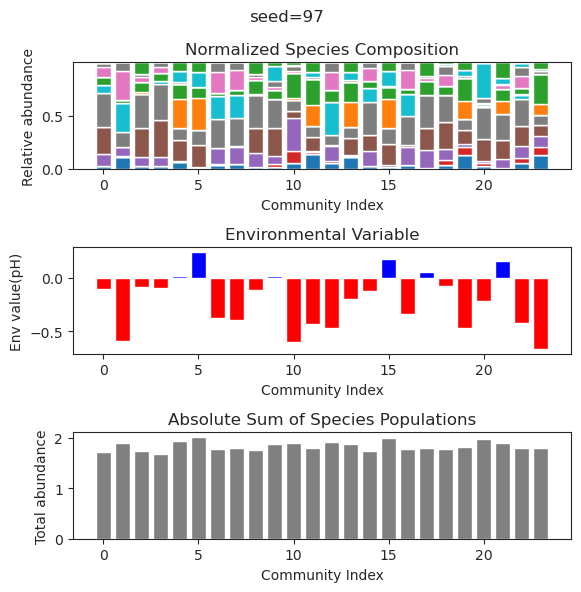

{'species': array([ 1.71810656e-137,  8.77062873e-002,  3.45397164e-001,
        4.49228018e-040,  2.42507059e-136, -3.28338668e-118,
        4.42258858e-072,  3.66559619e-001,  1.05222032e-140,
       -8.90956615e-114, -9.48518279e-084,  2.39509851e-001,
        1.47352353e-135,  1.16687856e-124,  1.56942896e-144,
       -2.61600564e-157, -3.22590363e-084, -1.39768653e-028,
        2.53713253e-129,  4.88393669e-033,  1.52215490e-001,
       -2.29797217e-109,  5.06502810e-001,  6.07261131e-001]), 'env': array([-0.26599299])}
{'species': array([ 1.82794604e-190,  8.77062874e-002,  3.45397164e-001,
       -9.17351836e-067,  2.68352624e-183,  3.31341962e-166,
       -6.22461759e-112,  3.66559619e-001,  1.76073109e-164,
        1.64064108e-154, -4.08542093e-111,  2.39509851e-001,
        3.52445818e-179,  1.51830883e-148, -1.83341996e-192,
       -3.30467611e-193,  1.03190423e-089,  8.91016056e-050,
       -8.55345347e-173,  6.80307258e-067,  1.52215490e-001,
        1.00822650e-146,  5.06

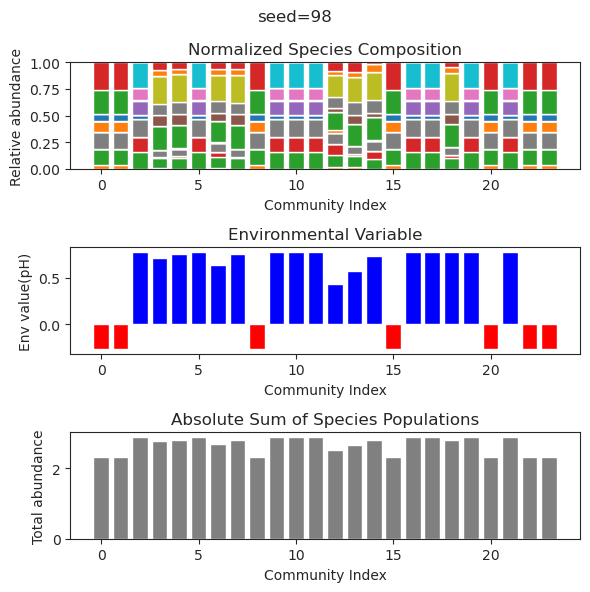

{'species': array([ 5.59799787e-046,  2.78800233e-003,  4.42917860e-001,
        1.18921144e-011, -1.29896161e-014,  4.49392812e-073,
        1.01475238e-036,  1.02840841e-036,  1.67635782e-036,
        4.08766425e-002,  1.66961222e-113,  2.90228241e-001,
        1.29546819e-155,  5.60201067e-001,  2.29292777e-148,
        1.38949949e-062,  1.36661108e-001,  1.60561413e-021,
       -1.04211334e-144,  3.16315675e-032,  1.66846840e-001,
        1.12832590e-045,  1.67811880e-215,  3.30969894e-001]), 'env': array([0.14565938])}
{'species': array([ 5.59799787e-046,  2.78800233e-003,  4.42917860e-001,
        1.18921144e-011, -1.29896161e-014,  4.49392812e-073,
        1.01475238e-036,  1.02840841e-036,  1.67635782e-036,
        4.08766425e-002,  1.66961222e-113,  2.90228241e-001,
        1.29546819e-155,  5.60201067e-001,  2.29292777e-148,
        1.38949949e-062,  1.36661108e-001,  1.60561413e-021,
       -1.04211334e-144,  3.16315675e-032,  1.66846840e-001,
        1.12832590e-045,  1.678

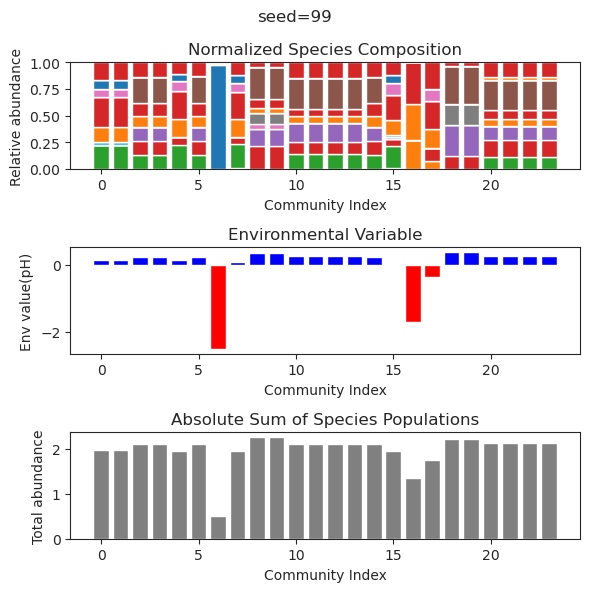

In [9]:
    session_path='Results/Session_Test2'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0.4,0.6)
        f_q = lambda : uniform_distribution(0.4,0.6)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=24
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.5])*delta

        for i in range(24):

            species_index=np.arange(0,24)
            env_index=np.array([0])
            y0_species=one_hot_vector(24,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

{'species': array([1.27409322e-39, 1.53457761e-01, 2.70931567e-01, 3.08923479e-02,
       4.56042439e-01, 1.90084301e-40, 5.20269039e-01, 2.83353015e-01,
       3.34652432e-84, 6.72756425e-98, 3.55406626e-01, 2.73499888e-46]), 'env': array([0.])}
{'species': array([ 3.14552834e-47,  1.53457761e-01,  2.70931567e-01,  3.08923479e-02,
        4.56042439e-01,  2.59752202e-28,  5.20269039e-01,  2.83353015e-01,
        5.02058745e-64, -1.58355438e-69,  3.55406626e-01,  1.78393120e-29]), 'env': array([0.])}
{'species': array([-2.69644087e-078,  1.53457761e-001,  2.70931567e-001,
        3.08923479e-002,  4.56042439e-001,  2.34381304e-036,
        5.20269039e-001,  2.83353015e-001,  1.74579661e-038,
       -6.36260673e-120,  3.55406626e-001,  1.93556585e-040]), 'env': array([0.])}
{'species': array([1.42955594e-075, 1.53457761e-001, 2.70931567e-001, 3.08923479e-002,
       4.56042439e-001, 4.59036081e-036, 5.20269039e-001, 2.83353015e-001,
       7.68779263e-112, 3.08278974e-114, 3.55406626e-0

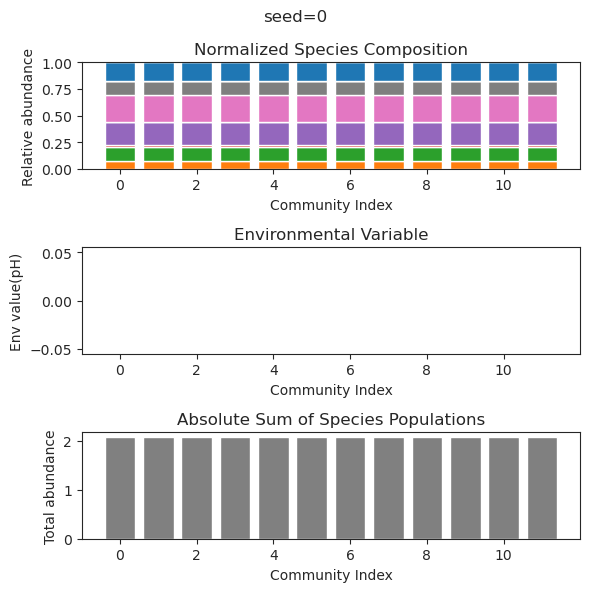

{'species': array([ 5.94166912e-01,  2.55212360e-01, -2.42072382e-53, -2.41927793e-42,
        5.05075071e-01,  6.15731232e-01,  1.55497408e-25,  2.16468890e-29,
        1.61420348e-30, -2.39805340e-47,  2.12744659e-01,  2.68159477e-03]), 'env': array([0.])}
{'species': array([ 5.94162599e-01,  2.55218380e-01, -4.46358191e-31, -1.61278374e-34,
        5.05075960e-01,  6.15722081e-01, -1.35455822e-36,  5.50620666e-41,
        8.81749710e-39, -3.90121959e-46,  2.12753009e-01,  2.67743579e-03]), 'env': array([0.])}
{'species': array([ 5.94166674e-01,  2.55212692e-01,  2.42139455e-29,  6.72021970e-56,
        5.05075120e-01,  6.15730727e-01, -3.20800923e-35, -1.78357328e-40,
       -8.83476719e-29, -2.80404180e-63,  2.12745120e-01,  2.68136538e-03]), 'env': array([0.])}
{'species': array([ 5.94166890e-01,  2.55212391e-01,  2.13387737e-78, -1.06756124e-49,
        5.05075076e-01,  6.15731185e-01, -3.72344276e-30, -4.46915590e-37,
       -5.37009508e-39, -4.55972207e-58,  2.12744701e-01,  2.

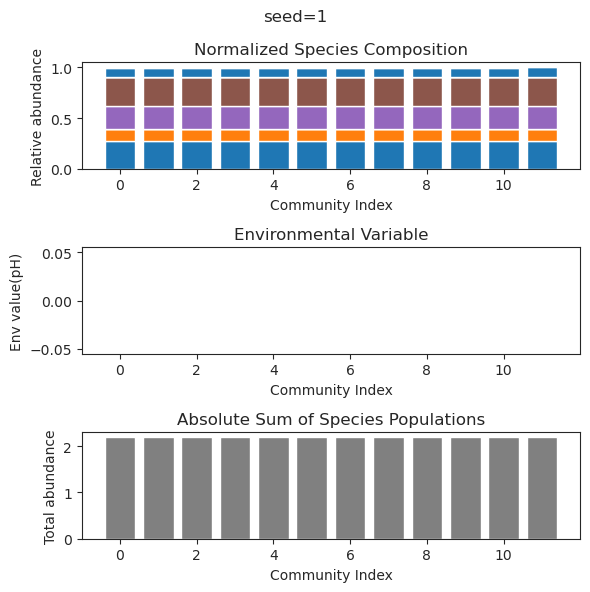

{'species': array([ 4.46278656e-01,  6.68100857e-01,  2.01844067e-01, -1.65890270e-67,
       -1.21736849e-59, -2.34025689e-44,  1.99213572e-01,  1.26423973e-01,
        1.73673393e-63, -6.12437861e-36,  3.49240495e-09,  5.79039952e-01]), 'env': array([0.])}
{'species': array([ 4.46278656e-01,  6.68100857e-01,  2.01844066e-01,  7.02574275e-62,
       -9.00596431e-30, -2.63683884e-44,  1.99213572e-01,  1.26423973e-01,
       -1.27847018e-38,  4.77189211e-36,  3.62467448e-09,  5.79039952e-01]), 'env': array([0.])}
{'species': array([ 4.46278657e-01,  6.68100857e-01,  2.01844067e-01, -9.88244122e-53,
       -7.45552234e-31,  6.24469263e-37,  1.99213573e-01,  1.26423972e-01,
        1.33883103e-33,  2.66682425e-31,  1.17404736e-09,  5.79039954e-01]), 'env': array([0.])}
{'species': array([ 4.46278657e-01,  6.68100857e-01,  2.01844067e-01,  9.08186185e-61,
       -1.13493996e-67,  8.38703555e-37,  1.99213573e-01,  1.26423971e-01,
        1.17965425e-66,  5.13957660e-21,  1.41587167e-11,  5.

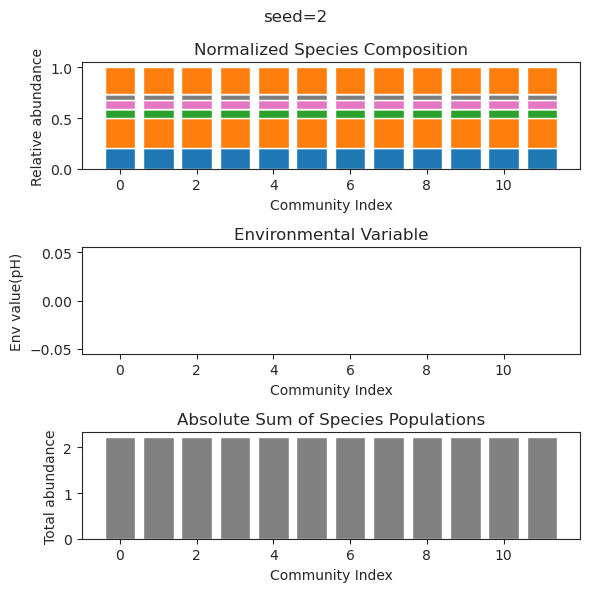

{'species': array([ 6.30871176e-38, -5.41334308e-27, -2.76416411e-57,  4.42113287e-44,
        9.53943538e-02,  7.01796342e-01,  4.00401237e-01,  2.32479483e-76,
       -8.42193720e-55,  7.89106068e-01,  8.75398535e-02,  3.57894305e-40]), 'env': array([0.])}
{'species': array([ 6.33269267e-042, -2.27111407e-027,  5.14933228e-071,
        1.00043001e-055,  9.53943538e-002,  7.01796342e-001,
        4.00401237e-001, -7.85172634e-101,  5.36810915e-076,
        7.89106068e-001,  8.75398535e-002,  1.15829462e-041]), 'env': array([0.])}
{'species': array([-3.30776035e-32, -1.23089816e-25,  1.62809831e-59,  8.54377431e-48,
        9.53943538e-02,  7.01796342e-01,  4.00401237e-01,  1.50279081e-79,
        2.16586644e-62,  7.89106068e-01,  8.75398535e-02, -8.76394807e-34]), 'env': array([0.])}
{'species': array([ 1.18048811e-32, -1.42098184e-25,  2.22061458e-56,  1.05663933e-46,
        9.53943538e-02,  7.01796342e-01,  4.00401237e-01, -2.39697712e-79,
        1.83998633e-61,  7.89106068e-01,  

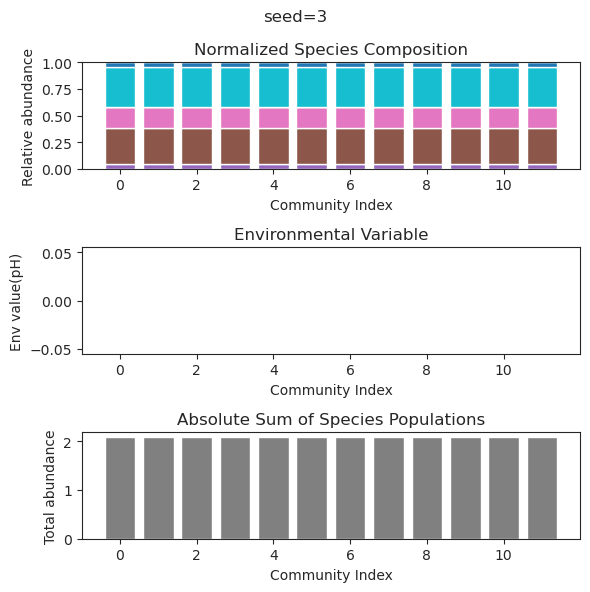

{'species': array([-2.24792697e-79,  7.61624399e-01,  6.24806054e-01,  2.08815195e-41,
        3.39759677e-70,  2.32228966e-01,  3.53529757e-01, -4.06598960e-73,
        7.02081134e-02,  3.48023086e-41,  4.23702691e-21,  1.54752143e-24]), 'env': array([0.])}
{'species': array([-7.52995625e-33,  7.61624399e-01,  6.24806054e-01, -4.05929983e-24,
       -3.28674745e-31,  2.32228966e-01,  3.53529757e-01, -1.78568634e-32,
        7.02081134e-02, -1.33208883e-24,  6.78883416e-17, -1.34163129e-17]), 'env': array([0.])}
{'species': array([-3.35575535e-75,  7.61624399e-01,  6.24806054e-01,  6.90678058e-39,
       -2.89207972e-66,  2.32228966e-01,  3.53529757e-01, -3.11243315e-75,
        7.02081134e-02,  1.76434772e-37, -2.69074409e-22, -9.34319880e-24]), 'env': array([0.])}
{'species': array([-3.71035057e-36,  7.61624399e-01,  6.24806054e-01, -3.16616422e-22,
       -2.56476220e-28,  2.32228966e-01,  3.53529757e-01, -8.00382041e-35,
        7.02081134e-02, -1.22483607e-21,  5.53213006e-17, -1.

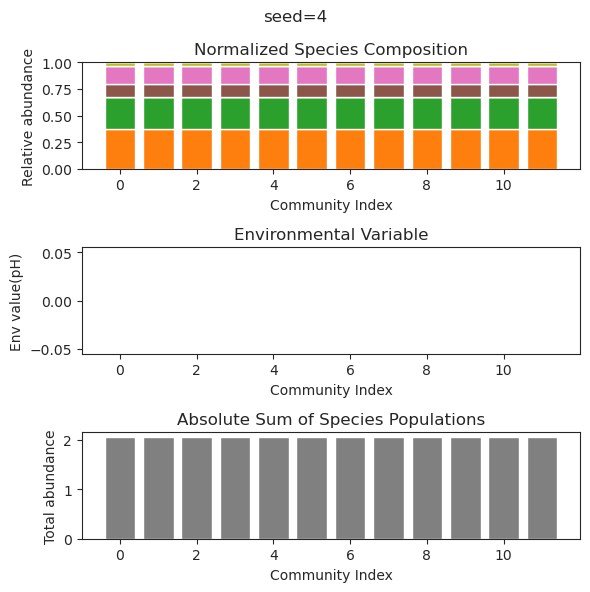

{'species': array([ 5.27376282e-32,  3.76729680e-01,  2.94133886e-32,  7.14925237e-01,
        1.14013670e-32, -2.29980213e-30,  1.68812263e-06, -2.48306277e-34,
        6.17438950e-01, -4.30049044e-45,  2.43834803e-46,  2.24372679e-01]), 'env': array([0.])}
{'species': array([ 1.36531978e-37,  3.76729855e-01,  1.25700818e-39,  7.14925399e-01,
       -1.11966495e-33, -5.52400229e-35,  1.39428750e-06,  3.14455236e-32,
        6.17438891e-01,  3.38844168e-50, -2.80699725e-52,  2.24372693e-01]), 'env': array([0.])}
{'species': array([-4.89786562e-100,  3.76729881e-001, -4.12458910e-092,
        7.14925423e-001,  8.19684868e-031,  3.47848740e-028,
        1.35027215e-006,  2.42542048e-029,  6.17438882e-001,
        8.52227934e-027, -5.71606497e-088,  2.24372695e-001]), 'env': array([0.])}
{'species': array([-1.73397464e-30,  3.76729634e-01,  1.92877630e-43,  7.14925195e-01,
       -1.48321976e-36,  2.32650245e-54,  1.76616661e-06,  3.49354682e-32,
        6.17438966e-01,  4.30580299e-49, -

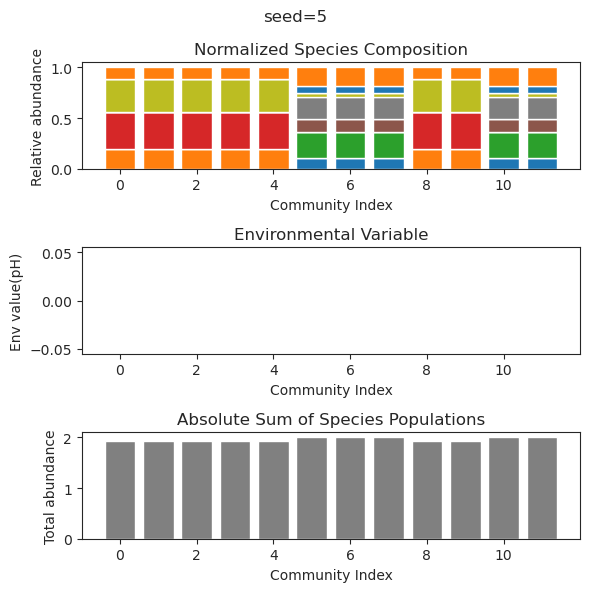

{'species': array([ 1.33503006e-01,  1.13007443e-95, -4.61825885e-96, -2.18211415e-34,
        2.52707476e-35,  1.40436279e-39,  6.57333025e-02,  6.36727058e-01,
        3.35519818e-03,  5.45906814e-01,  5.11344623e-01,  2.54212643e-89]), 'env': array([0.])}
{'species': array([ 1.33503618e-001,  1.97177601e-110, -1.63284427e-109,
        1.07619391e-097, -2.78241890e-064, -1.17994085e-043,
        6.57337643e-002,  6.36727252e-001,  3.35439294e-003,
        5.45906034e-001,  5.11344241e-001, -3.30900839e-108]), 'env': array([0.])}
{'species': array([ 1.33507554e-01,  4.47502182e-93,  5.96353052e-91,  3.33295893e-81,
        3.63054535e-42,  2.71338890e-24,  6.57367346e-02,  6.36728502e-01,
        3.34921269e-03,  5.45901015e-01,  5.11341786e-01, -4.89739276e-95]), 'env': array([0.])}
{'species': array([ 1.33502891e-01, -6.09987019e-63, -1.73938759e-29,  5.54369682e-32,
       -2.80672462e-28,  2.29506926e-28,  6.57332164e-02,  6.36727021e-01,
        3.35534828e-03,  5.45906959e-01,  

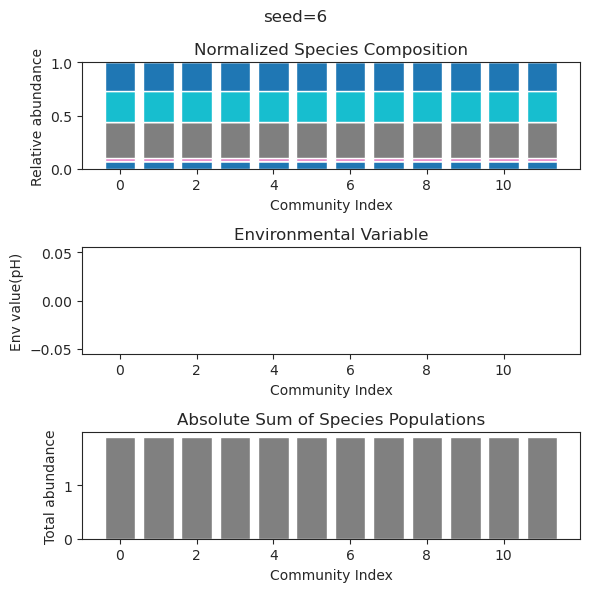

{'species': array([ 6.97336900e-34,  1.42562576e-25, -1.63134851e-27, -2.25393932e-36,
        2.43605022e-31,  5.63073398e-01,  5.99281396e-17, -1.65630112e-30,
        1.15747427e-32,  4.61855904e-01,  1.31530949e-01,  8.24500153e-01]), 'env': array([0.])}
{'species': array([-6.40742810e-44, -1.58107752e-30,  1.11998743e-35,  2.22325188e-48,
       -1.62706702e-41,  5.63073398e-01, -7.83208398e-19,  9.41058432e-36,
       -2.97203691e-42,  4.61855904e-01,  1.31530949e-01,  8.24500153e-01]), 'env': array([0.])}
{'species': array([-2.86458979e-32,  1.98258608e-24, -6.46503216e-27,  7.46226175e-38,
       -7.57905087e-30,  5.63073398e-01,  6.43243293e-17, -2.34228977e-27,
       -1.41950335e-30,  4.61855904e-01,  1.31530949e-01,  8.24500153e-01]), 'env': array([0.])}
{'species': array([-1.13351465e-33, -7.59377472e-29, -4.97334141e-30,  6.41239727e-36,
       -6.91703035e-31,  5.63073398e-01,  3.87730649e-17,  9.41759932e-31,
       -5.06568346e-33,  4.61855904e-01,  1.31530949e-01,  8.

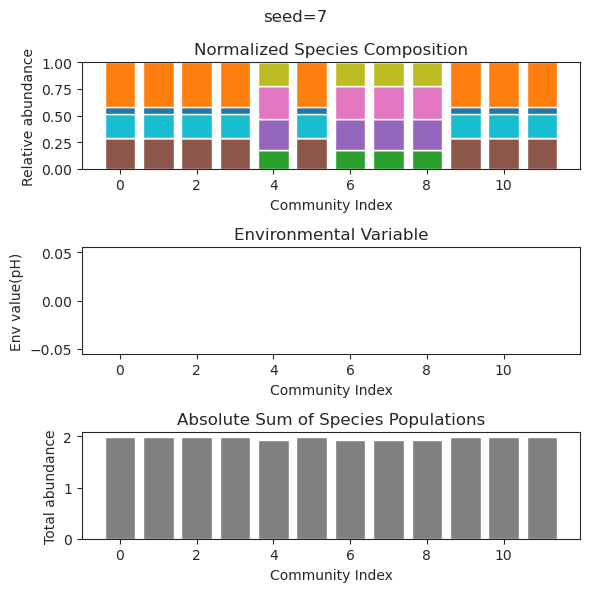

{'species': array([ 8.90034321e-02, -5.21867894e-37,  3.22055048e-01, -3.40392887e-48,
        2.31234891e-01,  8.04904185e-02,  1.45428668e-01, -4.33512762e-54,
        2.05971511e-34,  4.26888218e-01, -4.88081150e-55,  5.69601235e-01]), 'env': array([0.])}
{'species': array([ 8.90034316e-02, -9.70594947e-34,  3.22055048e-01,  6.53245626e-59,
        2.31234891e-01,  8.04904183e-02,  1.45428669e-01,  1.91251051e-36,
       -3.70944779e-40,  4.26888218e-01,  1.61538085e-46,  5.69601235e-01]), 'env': array([0.])}
{'species': array([ 8.90034320e-02,  1.24112174e-31,  3.22055048e-01,  2.62486725e-59,
        2.31234891e-01,  8.04904185e-02,  1.45428668e-01,  3.98156911e-44,
       -3.32270700e-36,  4.26888218e-01,  1.02947239e-55,  5.69601235e-01]), 'env': array([0.])}
{'species': array([ 8.90034308e-02,  2.53714746e-33,  3.22055048e-01, -6.53275213e-68,
        2.31234890e-01,  8.04904178e-02,  1.45428669e-01,  2.03030028e-38,
       -1.27700113e-44,  4.26888219e-01, -2.08345129e-42,  5.

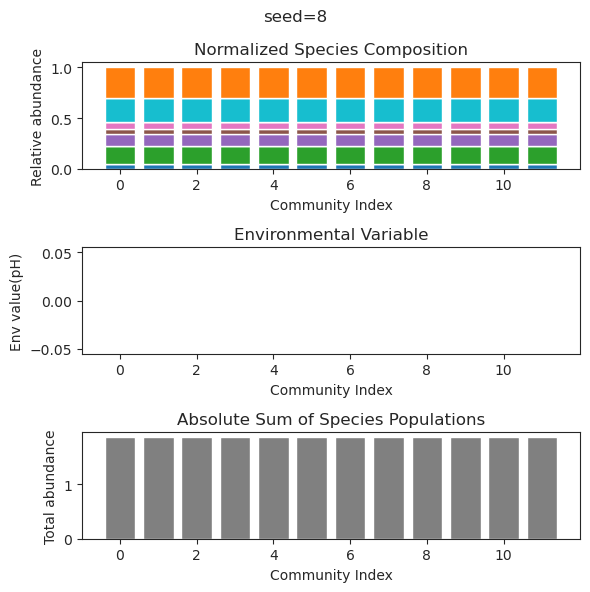

{'species': array([ 6.11068367e-001, -8.92888649e-142,  7.14559354e-166,
        4.91776481e-126,  3.14056739e-001,  7.56136308e-002,
        4.51086313e-001,  4.46358971e-001, -3.79347089e-076,
        3.79239306e-058,  1.69383611e-001, -2.23798768e-172]), 'env': array([0.])}
{'species': array([ 6.11068367e-001, -6.88250465e-158, -2.13239383e-180,
       -1.90301959e-128,  3.14056739e-001,  7.56136308e-002,
        4.51086313e-001,  4.46358971e-001,  1.32292532e-072,
       -3.15465881e-061,  1.69383611e-001, -4.93154228e-184]), 'env': array([0.])}
{'species': array([ 6.11068367e-001,  2.53348375e-139, -4.69286180e-157,
        1.55990713e-122,  3.14056739e-001,  7.56136308e-002,
        4.51086313e-001,  4.46358971e-001,  7.39079035e-071,
       -1.06830855e-052,  1.69383611e-001, -2.63188490e-167]), 'env': array([0.])}
{'species': array([ 6.11068367e-001,  3.90445694e-143,  9.28045482e-164,
       -2.83931199e-123,  3.14056739e-001,  7.56136308e-002,
        4.51086313e-001,  4.4635

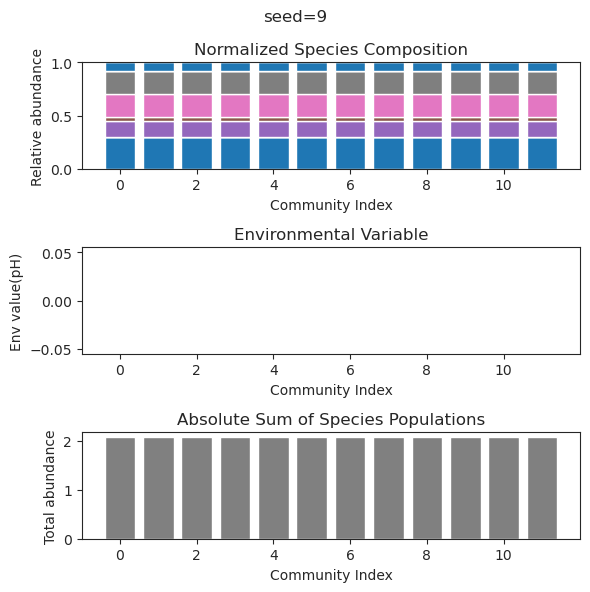

{'species': array([1.34033936e-04, 7.07263536e-02, 4.40427665e-01, 5.49615034e-02,
       5.86048384e-21, 4.40507751e-01, 1.15226180e-38, 2.57797278e-01,
       1.80052758e-29, 1.64596903e-01, 5.39768124e-01, 1.82428804e-56]), 'env': array([0.])}
{'species': array([1.37447354e-04, 7.07270528e-02, 4.40426384e-01, 5.49616457e-02,
       2.86063982e-22, 4.40506097e-01, 1.37583702e-41, 2.57798783e-01,
       2.05423597e-34, 1.64595790e-01, 5.39767647e-01, 1.13895711e-55]), 'env': array([0.])}
{'species': array([ 1.43182762e-04,  7.07282280e-02,  4.40424231e-01,  5.49618845e-02,
        3.78773950e-20,  4.40503317e-01, -9.32866578e-39,  2.57801312e-01,
        9.11689861e-30,  1.64593920e-01,  5.39766847e-01,  2.02954844e-67]), 'env': array([0.])}
{'species': array([ 1.48691184e-04,  7.07293569e-02,  4.40422163e-01,  5.49621135e-02,
        1.36366118e-21,  4.40500647e-01, -2.66225820e-38,  2.57803741e-01,
       -9.09104417e-39,  1.64592124e-01,  5.39766079e-01,  1.47194532e-97]), 'env': a

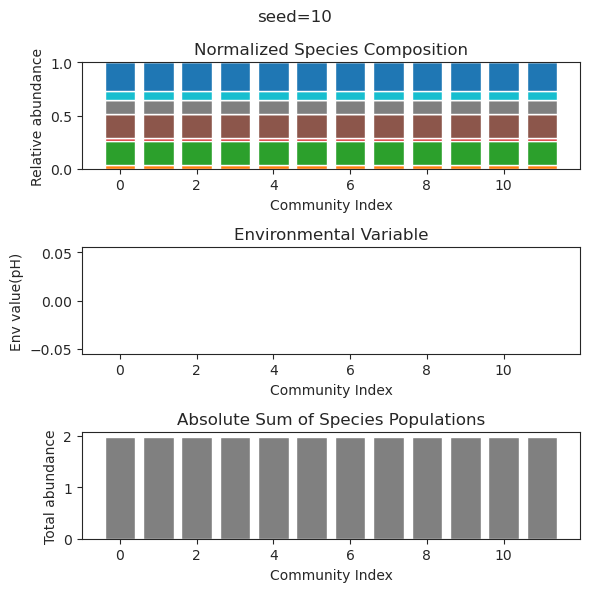

{'species': array([3.38069661e-001, 2.88051167e-001, 6.35240717e-001, 3.99276722e-001,
       7.21184728e-003, 3.23039368e-002, 1.64736178e-002, 1.40429924e-058,
       5.70114180e-002, 1.61906540e-192, 2.15237987e-144, 2.01074683e-051]), 'env': array([0.])}
{'species': array([ 3.38068090e-001,  2.88053576e-001,  6.35243679e-001,
        3.99278155e-001,  7.21637200e-003,  3.23002771e-002,
        1.64696871e-002,  2.04574572e-050,  5.70103788e-002,
        1.09842236e-101, -2.97592106e-089,  6.66725472e-050]), 'env': array([0.])}
{'species': array([ 3.38072514e-001,  2.88046822e-001,  6.35235398e-001,
        3.99274114e-001,  7.20367497e-003,  3.23105304e-002,
        1.64806979e-002, -1.20816141e-050,  5.70132898e-002,
       -4.08306846e-103, -7.16615392e-090,  2.72303234e-047]), 'env': array([0.])}
{'species': array([ 3.38070553e-001,  2.88049817e-001,  6.35239072e-001,
        3.99275905e-001,  7.20930640e-003,  3.23059825e-002,
        1.64758144e-002,  1.51858545e-043,  5.70119

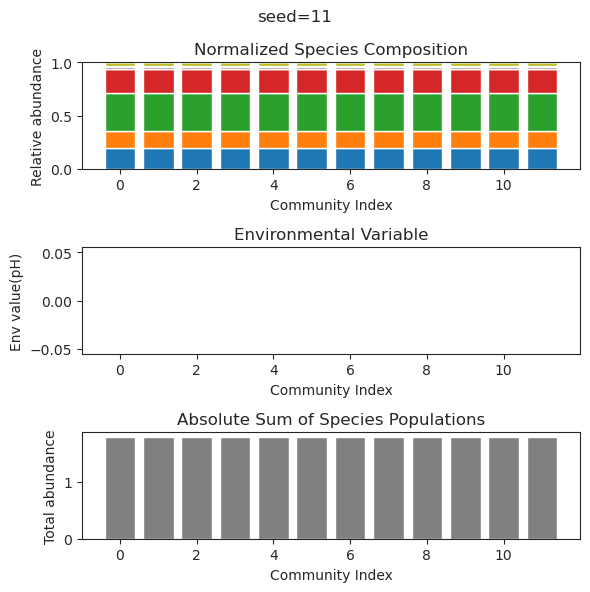

{'species': array([ 6.76095009e-01,  4.90186221e-02,  1.37493002e-01, -3.44046925e-32,
        3.78473544e-01, -2.94930895e-35, -5.49893304e-32,  1.89888043e-45,
        1.03636522e-83,  2.68149839e-24,  6.95611276e-01,  7.99797185e-02]), 'env': array([0.])}
{'species': array([ 6.76095009e-01,  4.90186221e-02,  1.37493002e-01,  8.91154289e-30,
        3.78473544e-01,  1.24405525e-34,  2.20299318e-31,  3.04507027e-38,
        8.61505065e-68, -1.68631480e-24,  6.95611276e-01,  7.99797185e-02]), 'env': array([0.])}
{'species': array([ 6.76095009e-01,  4.90186221e-02,  1.37493002e-01,  1.60960382e-34,
        3.78473544e-01,  3.32464742e-40,  3.30860675e-35,  2.19129567e-48,
       -1.35239261e-88, -5.30312688e-27,  6.95611276e-01,  7.99797185e-02]), 'env': array([0.])}
{'species': array([ 6.76095009e-01,  4.90186221e-02,  1.37493002e-01, -1.02880533e-31,
        3.78473544e-01,  1.24774100e-35, -1.38908877e-35,  5.39170751e-40,
       -7.74466794e-71, -1.05305593e-24,  6.95611276e-01,  7.

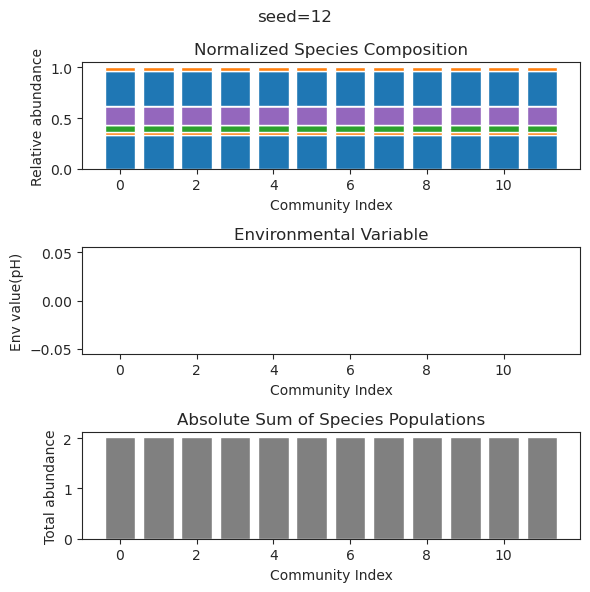

{'species': array([-1.90890509e-62,  1.41313733e-21, -8.98071983e-26,  4.54633829e-01,
        1.29766049e-41, -2.09839953e-63, -4.79187073e-79,  6.27406848e-01,
        3.62588127e-01,  7.14048527e-01,  1.19248458e-01, -1.82077612e-65]), 'env': array([0.])}
{'species': array([-1.01384284e-74, -6.15154210e-28,  9.86797859e-32,  4.54633829e-01,
       -1.44287983e-56,  9.92191190e-76,  1.08321439e-96,  6.27406848e-01,
        3.62588127e-01,  7.14048527e-01,  1.19248458e-01, -3.40219596e-84]), 'env': array([0.])}
{'species': array([-6.27901509e-70, -2.14543604e-23, -1.27524573e-28,  4.54633829e-01,
       -4.33924063e-48, -8.45162552e-70, -1.65934652e-83,  6.27406848e-01,
        3.62588127e-01,  7.14048527e-01,  1.19248458e-01, -2.74895223e-73]), 'env': array([0.])}
{'species': array([ 8.79615793e-45, -4.58765603e-18,  1.75633696e-22,  4.54633829e-01,
       -6.52139440e-29,  4.68216929e-43,  1.11781302e-48,  6.27406848e-01,
        3.62588127e-01,  7.14048527e-01,  1.19248458e-01,  2.

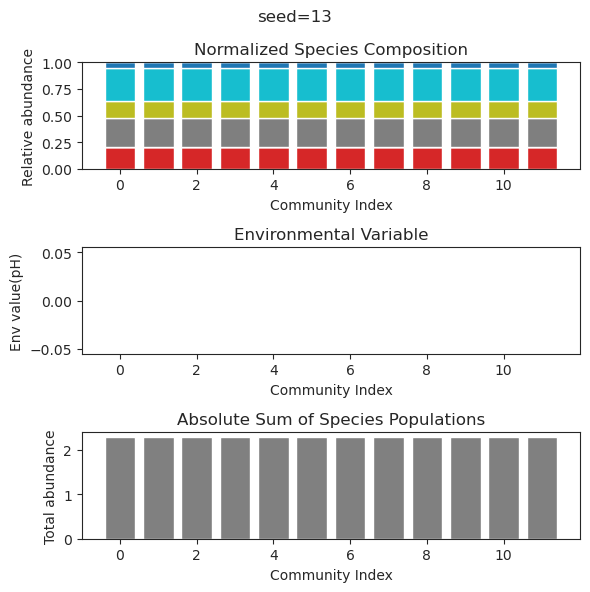

{'species': array([ 5.12092220e-36,  1.67854705e-35,  7.73441536e-66,  2.29521899e-01,
        2.51739525e-01,  2.92642146e-01,  1.21431380e-01, -3.17948005e-55,
        4.19256450e-01,  7.38283534e-64,  4.83563701e-01,  3.41493985e-01]), 'env': array([0.])}
{'species': array([ 5.86596925e-36,  6.55032373e-35,  7.56203491e-63,  2.29521899e-01,
        2.51739525e-01,  2.92642146e-01,  1.21431380e-01, -1.95592051e-53,
        4.19256450e-01,  2.39156085e-62,  4.83563701e-01,  3.41493985e-01]), 'env': array([0.])}
{'species': array([-2.40686691e-44, -1.27562667e-44,  6.25076313e-01, -5.87867834e-15,
        6.78073211e-01,  7.14672043e-01, -2.69517628e-31,  2.56027588e-01,
        3.59441559e-18,  5.58626456e-38, -5.64744733e-29, -1.23282921e-41]), 'env': array([0.])}
{'species': array([4.24358622e-32, 6.61399551e-31, 3.51766545e-60, 2.29521899e-01,
       2.51739525e-01, 2.92642146e-01, 1.21431380e-01, 3.20699285e-50,
       4.19256450e-01, 1.38141111e-60, 4.83563701e-01, 3.41493985e-01

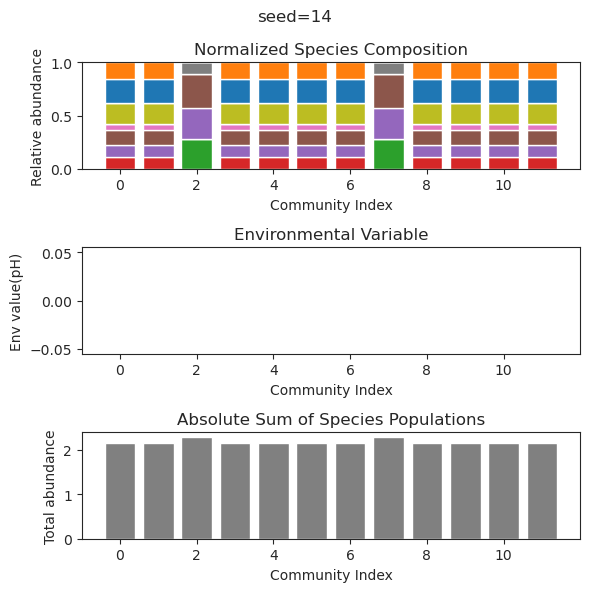

{'species': array([ 3.54686938e-01,  4.99596110e-01,  6.17302616e-42,  4.34789355e-01,
        2.00577787e-19,  2.51471353e-01,  3.05209469e-01,  2.32812705e-01,
       -1.71873530e-25,  1.54512787e-62,  1.10294535e-01, -1.93049366e-33]), 'env': array([0.])}
{'species': array([ 3.54686938e-01,  4.99596110e-01, -6.18944090e-44,  4.34789355e-01,
       -1.24395955e-18,  2.51471353e-01,  3.05209469e-01,  2.32812705e-01,
       -8.77321950e-27,  1.00020826e-54,  1.10294535e-01, -4.68966921e-31]), 'env': array([0.])}
{'species': array([ 3.54686938e-01,  4.99596110e-01, -1.30990585e-49,  4.34789355e-01,
       -1.03214167e-25,  2.51471353e-01,  3.05209469e-01,  2.32812705e-01,
       -1.27197011e-30,  1.80986605e-68,  1.10294535e-01, -1.16894098e-37]), 'env': array([0.])}
{'species': array([ 3.54686938e-01,  4.99596110e-01,  2.68146632e-43,  4.34789355e-01,
       -2.69033804e-18,  2.51471353e-01,  3.05209469e-01,  2.32812705e-01,
       -7.78445444e-25,  1.37009350e-64,  1.10294535e-01, -3.

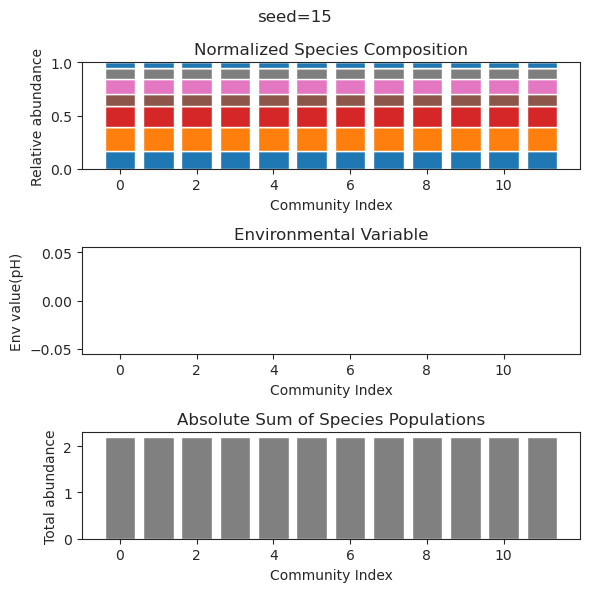

{'species': array([ 1.66125020e-01,  4.25450085e-02,  1.52479155e-01,  5.47517350e-01,
        1.42620550e-01,  7.27773733e-33,  2.15534629e-01,  7.81277065e-33,
       -1.31178896e-97,  4.43930751e-01,  1.50871223e-01,  2.59515762e-22]), 'env': array([0.])}
{'species': array([ 1.66125020e-01,  4.25450085e-02,  1.52479155e-01,  5.47517350e-01,
        1.42620550e-01,  3.25543480e-36,  2.15534629e-01,  8.63266433e-35,
        3.80820776e-90,  4.43930751e-01,  1.50871223e-01, -3.53509527e-17]), 'env': array([0.])}
{'species': array([ 1.66125020e-01,  4.25450085e-02,  1.52479155e-01,  5.47517350e-01,
        1.42620550e-01, -1.59051109e-33,  2.15534629e-01, -6.43158017e-34,
        4.77632891e-92,  4.43930751e-01,  1.50871223e-01,  1.79987596e-17]), 'env': array([0.])}
{'species': array([ 1.66125020e-01,  4.25450085e-02,  1.52479155e-01,  5.47517350e-01,
        1.42620550e-01, -1.20387602e-29,  2.15534629e-01, -1.33478540e-29,
       -1.54199070e-75,  4.43930751e-01,  1.50871223e-01,  1.

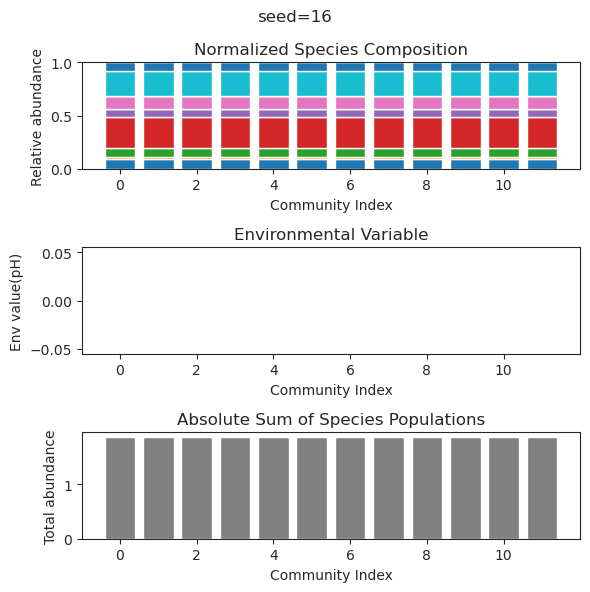

{'species': array([ 2.11332182e-01, -7.91482584e-23,  5.65785616e-01, -7.86254329e-26,
       -3.91377419e-26,  3.10452802e-02,  6.90219083e-01,  2.35379281e-02,
       -8.40368960e-76, -6.53383998e-94,  1.87044361e-01,  4.90611233e-01]), 'env': array([0.])}
{'species': array([ 1.96894529e-01, -9.63309687e-25,  5.37945963e-01, -4.07330571e-32,
        1.24082645e-40,  1.06833034e-02,  6.87625626e-01,  6.17445788e-02,
        3.25069796e-33, -1.55014018e-77,  1.99920999e-01,  5.00322242e-01]), 'env': array([0.])}
{'species': array([ 2.12371683e-01,  7.41373458e-22,  5.67815037e-01,  2.60750253e-32,
       -3.25026914e-29,  3.24776220e-02,  6.90410533e-01,  2.07341686e-02,
        1.32200988e-53, -7.97300306e-72,  1.86164184e-01,  4.89930420e-01]), 'env': array([0.])}
{'species': array([ 2.10164446e-01,  6.99351598e-21,  5.63511098e-01,  1.15687532e-26,
        3.89434937e-31,  2.94334113e-02,  6.90004309e-01,  2.66771158e-02,
       -6.60329843e-61,  2.80808935e-86,  1.88039640e-01,  4.

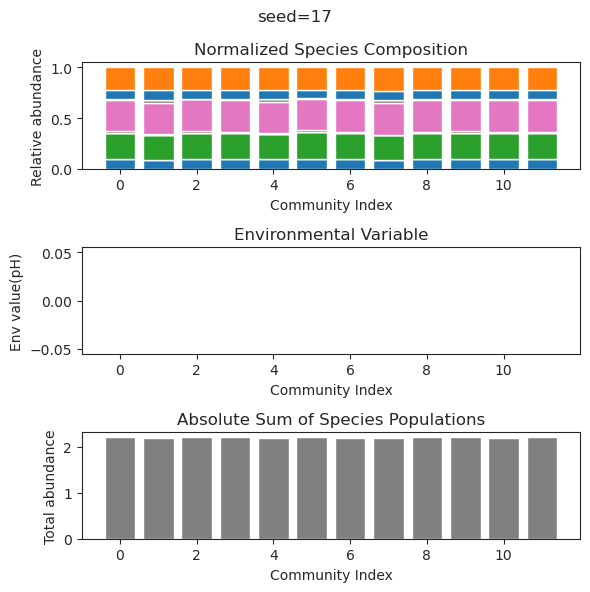

{'species': array([1.46223371e-02, 4.53017437e-01, 4.31965678e-03, 4.39652029e-01,
       1.23159457e-01, 1.10868920e-85, 4.39206548e-01, 2.53931836e-01,
       9.44914525e-02, 1.66804567e-55, 5.39947824e-71, 3.45856110e-63]), 'env': array([0.])}
{'species': array([ 1.46185095e-02,  4.53026765e-01,  4.31997149e-03,  4.39645301e-01,
        1.23160925e-01, -5.26991413e-35,  4.39213625e-01,  2.53924989e-01,
        9.44881376e-02,  1.05590342e-65, -1.34768248e-75, -4.75617297e-61]), 'env': array([0.])}
{'species': array([ 1.46153792e-02,  4.53034616e-01,  4.32273918e-03,  4.39638833e-01,
        1.23165160e-01, -2.83577597e-40,  4.39218835e-01,  2.53919187e-01,
        9.44821260e-02,  4.49074059e-68,  7.01237867e-80,  7.61186679e-68]), 'env': array([0.])}
{'species': array([ 1.46216498e-02,  4.53019081e-01,  4.31935470e-03,  4.39650959e-01,
        1.23159287e-01,  4.19733696e-44,  4.39207901e-01,  2.53930635e-01,
        9.44913286e-02,  4.35827167e-61, -9.71494949e-74,  3.87315516e-61

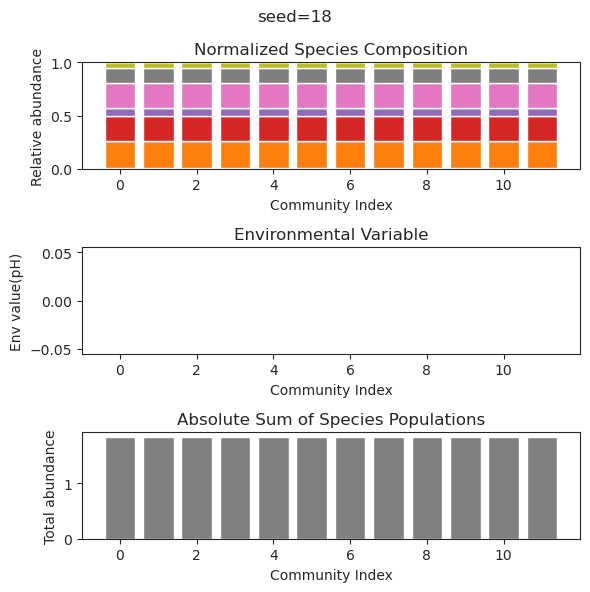

{'species': array([ 8.49116970e-02, -3.71811028e-38,  2.11677230e-01,  1.52665186e-57,
        2.76514112e-01, -9.08552129e-33,  1.08118739e-40,  6.44665642e-01,
        2.06227401e-27,  1.34835326e-05,  4.77547382e-01,  2.69679859e-01]), 'env': array([0.])}
{'species': array([-2.48727072e-046,  6.05165881e-143,  5.42529387e-002,
       -3.29653012e-104,  4.59697812e-043,  1.91282783e-001,
        1.00348730e-001,  7.66233782e-001, -5.17794322e-191,
        2.39601007e-001,  2.89767648e-001,  2.42457601e-001]), 'env': array([0.])}
{'species': array([ 8.49196219e-02, -3.14328637e-30,  2.11681675e-01,  1.90844390e-44,
        2.76521758e-01, -6.34881972e-39, -1.37982051e-45,  6.44657862e-01,
        1.27104483e-58,  1.60300874e-10,  4.77548286e-01,  2.69686223e-01]), 'env': array([0.])}
{'species': array([ 7.64057406e-047, -1.94413008e-151,  5.42529387e-002,
        1.79347725e-105,  2.80493557e-043,  1.91282783e-001,
        1.00348730e-001,  7.66233782e-001, -2.46707865e-190,
        2

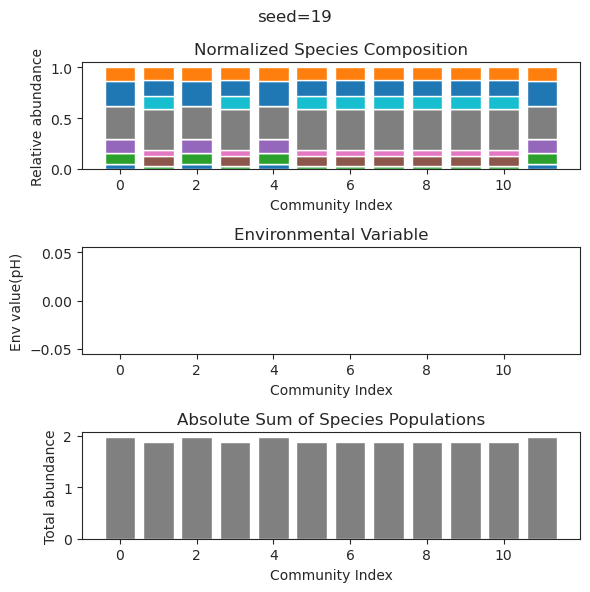

{'species': array([ 4.96800586e-035,  2.28262140e-098,  2.52666294e-001,
        1.46963742e-002, -7.26720090e-110,  5.79301759e-001,
       -3.66463934e-084,  6.24081490e-001, -8.69031977e-066,
        6.00004863e-001,  8.65286896e-083, -3.74022861e-067]), 'env': array([0.])}
{'species': array([ 3.01093157e-035,  2.46991044e-115,  2.52666294e-001,
        1.46963742e-002, -4.46904046e-126,  5.79301759e-001,
       -1.08457378e-101,  6.24081490e-001,  2.39285880e-073,
        6.00004863e-001,  2.29180370e-094, -2.00704355e-077]), 'env': array([0.])}
{'species': array([-3.22778100e-28,  2.29631372e-56,  2.52666294e-01,  1.46963742e-02,
       -7.29096084e-61,  5.79301759e-01,  4.43838990e-52,  6.24081490e-01,
        2.71412349e-43,  6.00004863e-01,  2.53187627e-49,  2.19040247e-47]), 'env': array([0.])}
{'species': array([ 1.78137169e-034, -6.57256703e-108,  2.52666294e-001,
        1.46963742e-002, -1.84500488e-122,  5.79301759e-001,
        9.89728000e-090,  6.24081490e-001,  4.37075

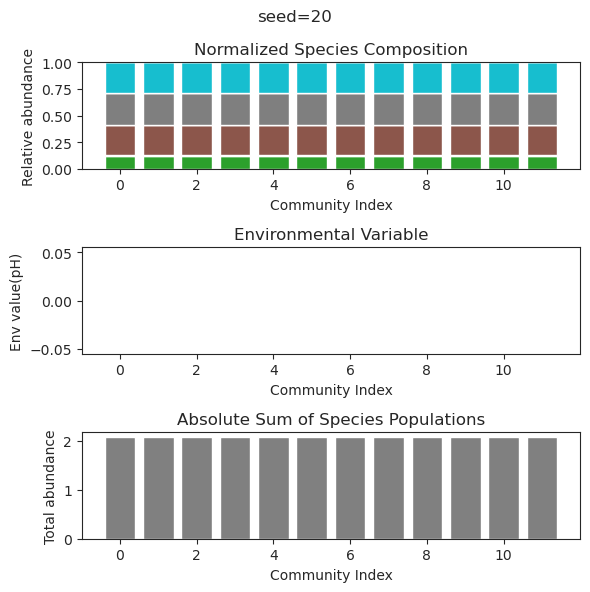

{'species': array([ 2.26927540e-017,  9.59476978e-051, -1.16707509e-026,
       -1.55813981e-100,  5.83276355e-001,  9.31244154e-021,
        1.83221725e-001,  3.28104475e-001,  1.36713151e-001,
       -4.31286479e-020,  1.65811404e-029,  6.95234024e-001]), 'env': array([0.])}
{'species': array([ 2.20475648e-027, -4.32064506e-079,  6.80193227e-002,
       -2.95485181e-100,  5.46490049e-001, -1.96009447e-020,
        1.83353192e-001,  3.24524622e-001,  1.51791410e-001,
        3.89442119e-061, -1.85734777e-052,  6.56124585e-001]), 'env': array([0.])}
{'species': array([ 8.51827058e-17,  3.00891094e-45,  6.80193227e-02, -4.14838665e-47,
        5.46490049e-01, -3.70620795e-14,  1.83353192e-01,  3.24524622e-01,
        1.51791410e-01, -2.06546105e-31, -1.51964309e-25,  6.56124585e-01]), 'env': array([0.])}
{'species': array([-7.14567611e-20, -7.02812495e-60,  6.80193227e-02,  9.39227759e-59,
        5.46490049e-01, -1.20560220e-14,  1.83353192e-01,  3.24524622e-01,
        1.51791410e-01,

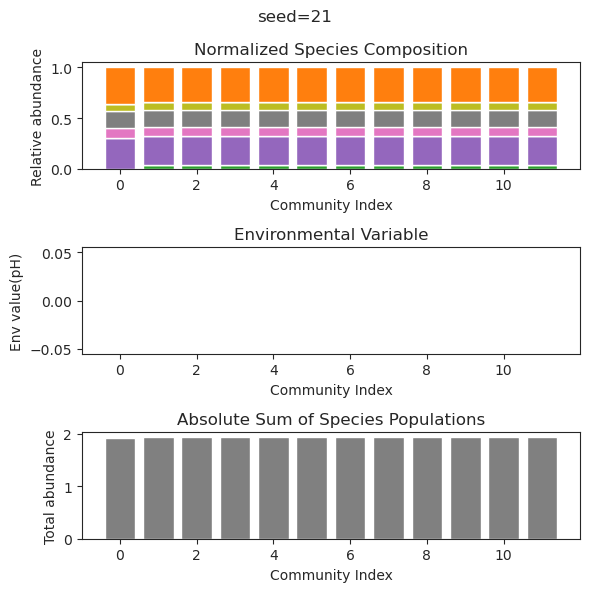

{'species': array([1.36248924e-003, 1.00337289e-010, 1.83970481e-010, 4.78836138e-001,
       4.32121738e-003, 1.68540157e-023, 5.17560374e-001, 8.66361836e-146,
       1.93610524e-001, 2.10761418e-001, 1.38310515e-001, 3.93034737e-001]), 'env': array([0.])}
{'species': array([ 1.73875225e-053,  1.95066847e-003,  3.65826861e-001,
        4.76823814e-001,  8.02711767e-003,  1.46333614e-001,
        3.49094753e-001, -2.20773503e-174,  2.09003337e-001,
        2.18373363e-001,  2.96617925e-015,  1.96780513e-001]), 'env': array([0.])}
{'species': array([6.11441679e-001, 2.34695414e-007, 1.40443862e-018, 1.34003898e-001,
       2.49654315e-003, 2.13836516e-018, 1.66405511e-001, 1.47257655e-150,
       3.12381724e-003, 1.62510427e-001, 4.09322618e-001, 1.26432238e-001]), 'env': array([0.])}
{'species': array([2.85485651e-001, 5.94355347e-010, 1.53739748e-023, 1.57509557e-001,
       2.29163404e-004, 2.97548998e-005, 3.83002092e-001, 1.66684019e-176,
       5.68416621e-024, 1.66460731e-001, 5

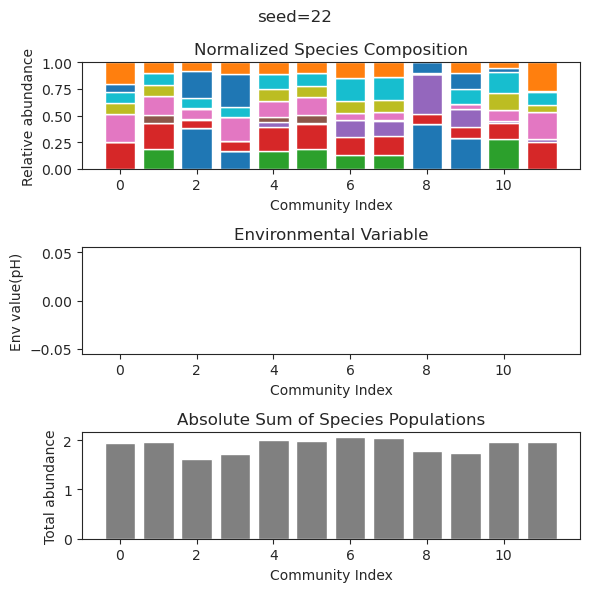

{'species': array([ 2.79643925e-01,  3.44046695e-28,  6.45757885e-40, -6.02020665e-33,
        5.56414949e-01, -1.06776201e-43,  4.16255142e-01,  6.46280762e-02,
        2.37095243e-01,  1.97366751e-35,  2.29069872e-02,  4.02512543e-01]), 'env': array([0.])}
{'species': array([9.33649502e-146, 3.80855870e-001, 3.42417184e-001, 3.57477110e-002,
       5.89152977e-074, 2.37204647e-001, 5.54401772e-001, 1.52417081e-009,
       2.57310708e-001, 5.65307351e-086, 2.53056089e-091, 6.07115429e-016]), 'env': array([0.])}
{'species': array([5.57343215e-137, 3.60679346e-001, 3.58632550e-001, 2.37288602e-001,
       6.57774149e-059, 2.55698858e-002, 1.49895795e-001, 4.77141742e-001,
       1.29554020e-002, 1.40222286e-080, 5.02623492e-090, 3.82362717e-001]), 'env': array([0.])}
{'species': array([ 2.79643925e-01,  8.77067230e-25, -4.79389783e-37,  7.04183111e-29,
        5.56414949e-01,  4.38051664e-37,  4.16255142e-01,  6.46280762e-02,
        2.37095243e-01, -2.74338476e-31,  2.29069872e-02,  4.

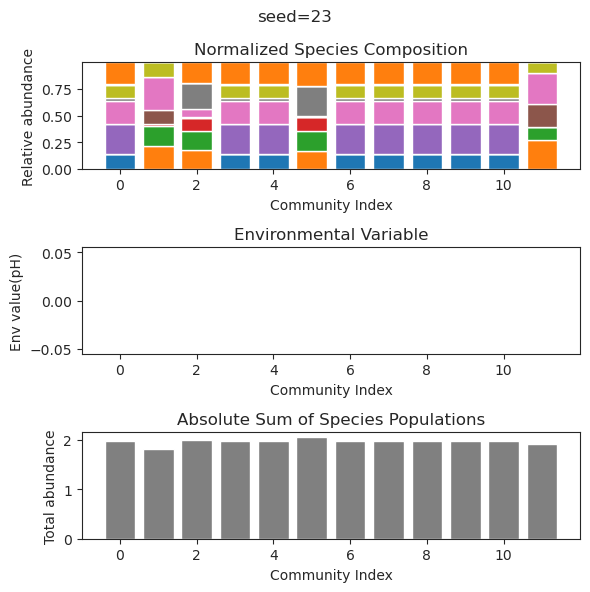

{'species': array([ 3.23121857e-01,  2.65696341e-31,  1.52292246e-31,  1.08688064e-01,
        7.25870106e-02,  3.49099268e-01, -6.55757897e-31,  6.77903072e-01,
       -2.76501128e-31,  2.91178369e-01,  1.31703566e-01,  1.69533534e-89]), 'env': array([0.])}
{'species': array([ 2.89512345e-01,  5.54089881e-33,  8.24352764e-32,  8.25071425e-02,
        8.58224812e-03,  4.14637314e-01,  1.33181266e-33,  6.74185367e-01,
       -4.03718601e-33,  2.99057893e-01,  1.69437478e-01,  9.12268076e-71]), 'env': array([0.])}
{'species': array([ 3.23233218e-01, -1.30370113e-33, -1.62662177e-29,  1.08776953e-01,
        7.27919180e-02,  3.48885169e-01,  5.44598840e-34,  6.77914218e-01,
       -2.03384489e-51,  2.91156221e-01,  1.31577416e-01, -1.04633336e-52]), 'env': array([0.])}
{'species': array([ 3.23157457e-01, -3.56030150e-35, -5.09238850e-29,  1.08716479e-01,
        7.26525210e-02,  3.49030822e-01,  8.65081917e-29,  6.77906635e-01,
       -8.84423393e-58,  2.91171286e-01,  1.31663239e-01, -1.

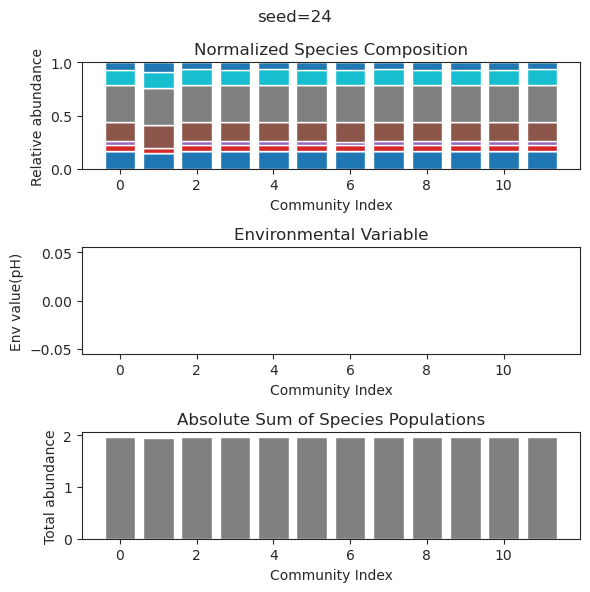

{'species': array([ 4.60668184e-01, -4.22821050e-22,  1.28166250e-52,  3.47083978e-01,
        2.92429194e-01, -1.42336943e-30,  1.01811698e-01,  6.50919326e-01,
       -4.02091555e-18, -1.80152773e-21, -1.25857517e-48, -4.65214235e-47]), 'env': array([0.])}
{'species': array([ 4.60668184e-01, -1.50951001e-21,  9.23613892e-51,  3.47083978e-01,
        2.92429194e-01, -3.89374596e-31,  1.01811698e-01,  6.50919326e-01,
       -3.35027978e-17, -2.07993351e-19,  6.44155396e-45, -2.01032755e-49]), 'env': array([0.])}
{'species': array([ 4.60668184e-01, -1.03227516e-22,  4.77507070e-46,  3.47083978e-01,
        2.92429194e-01, -9.55144128e-32,  1.01811698e-01,  6.50919326e-01,
       -1.04362571e-18,  1.66980257e-21,  3.46499560e-40,  4.47476035e-42]), 'env': array([0.])}
{'species': array([ 4.60668184e-01, -9.19603963e-23, -1.08192198e-52,  3.47083978e-01,
        2.92429194e-01, -2.65313706e-29,  1.01811698e-01,  6.50919326e-01,
        4.60059789e-18, -2.99087630e-21,  3.79883811e-47,  5.

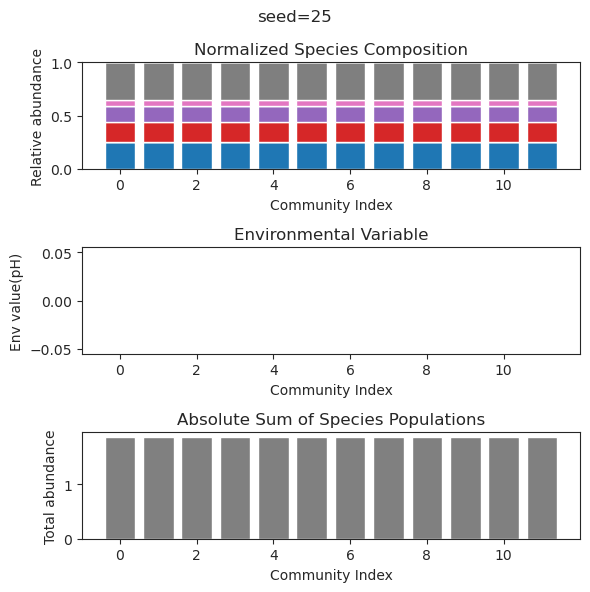

{'species': array([ 9.97307049e-19, -4.91229900e-50, -4.54880417e-50,  5.99747934e-44,
        2.09752542e-01,  3.18682232e-40,  3.66277468e-01, -2.31060149e-22,
        5.94081005e-01, -3.34716466e-45,  6.65918309e-01,  5.27718343e-01]), 'env': array([0.])}
{'species': array([-9.08675084e-20,  1.42629516e-45, -3.56199720e-45,  2.00391515e-42,
        2.09752542e-01,  1.91446098e-50,  3.66277468e-01, -5.54997909e-22,
        5.94081005e-01, -1.59678997e-51,  6.65918309e-01,  5.27718343e-01]), 'env': array([0.])}
{'species': array([ 9.88901653e-19,  3.02320372e-31, -8.43196060e-30, -2.61026035e-28,
        2.09752542e-01, -1.66014069e-33,  3.66277468e-01, -1.89529517e-20,
        5.94081005e-01,  6.62151164e-32,  6.65918309e-01,  5.27718343e-01]), 'env': array([0.])}
{'species': array([ 9.88901653e-19,  3.02320372e-31, -8.43196060e-30, -2.61026035e-28,
        2.09752542e-01, -1.66014069e-33,  3.66277468e-01, -1.89529517e-20,
        5.94081005e-01,  6.62151164e-32,  6.65918309e-01,  5.

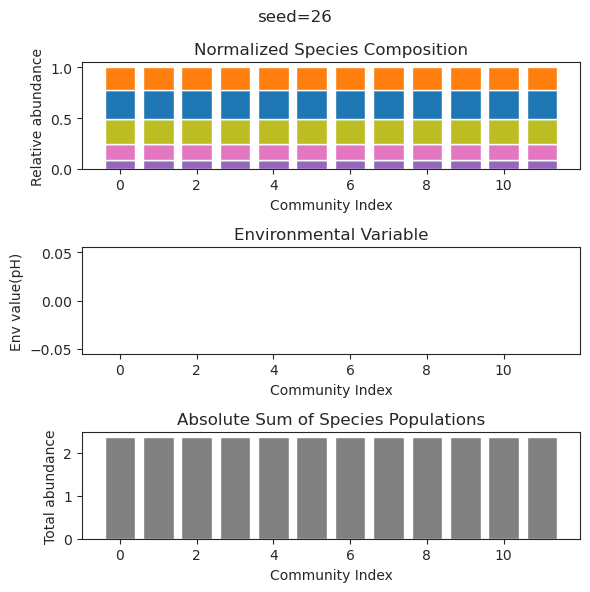

{'species': array([8.81973508e-224, 4.85035182e-001, 6.09808929e-234, 3.90940286e-003,
       5.74158152e-252, 3.88439003e-081, 2.20285816e-002, 4.67657866e-001,
       2.67730206e-001, 4.36522198e-002, 5.09261916e-001, 3.99727156e-003]), 'env': array([0.])}
{'species': array([1.50640049e-224, 5.03548006e-001, 1.30140967e-235, 3.61805665e-002,
       1.50503454e-255, 6.92252925e-083, 2.48265400e-001, 3.15293719e-001,
       1.38720897e-001, 7.28360297e-002, 4.60781571e-001, 7.89050546e-005]), 'env': array([0.])}
{'species': array([2.47046211e-225, 4.87837819e-001, 8.91418498e-235, 8.53683723e-003,
       6.16058706e-253, 1.19009811e-081, 1.16887076e-001, 4.16573008e-001,
       2.32873802e-001, 5.12119847e-002, 4.88762638e-001, 5.54066713e-004]), 'env': array([0.])}
{'species': array([3.14412164e-226, 4.60593247e-001, 1.20117771e-233, 6.80129345e-002,
       2.37640611e-254, 3.81178879e-083, 1.15667993e-001, 1.20192089e-001,
       6.30021414e-002, 4.06754471e-001, 4.44959339e-001, 1.1

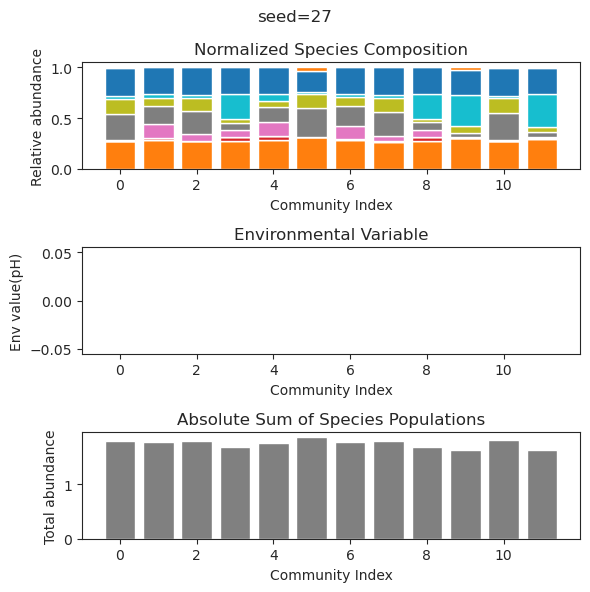

{'species': array([ 6.17669074e-002, -3.69406953e-093,  4.11776862e-001,
        3.34950742e-001,  1.37419440e-020,  1.09098128e-001,
        3.78834888e-001, -9.10341293e-189, -7.34049891e-110,
        4.04145134e-001,  1.85997442e-038,  2.37822170e-001]), 'env': array([0.])}
{'species': array([ 6.17669074e-002,  1.15458050e-074,  4.11776862e-001,
        3.34950742e-001,  1.33687535e-020,  1.09098128e-001,
        3.78834888e-001, -1.18423684e-156, -1.63308104e-081,
        4.04145134e-001,  8.41267289e-030,  2.37822170e-001]), 'env': array([0.])}
{'species': array([ 6.17669074e-002,  1.26868793e-043,  4.11776862e-001,
        3.34950742e-001, -2.66181985e-041,  1.09098128e-001,
        3.78834888e-001, -2.50319987e-101, -1.62845681e-058,
        4.04145134e-001, -1.20020431e-025,  2.37822170e-001]), 'env': array([0.])}
{'species': array([6.17669074e-02, 6.37039658e-46, 4.11776862e-01, 3.34950742e-01,
       1.57385029e-18, 1.09098128e-01, 3.78834888e-01, 6.59581383e-75,
       3.009

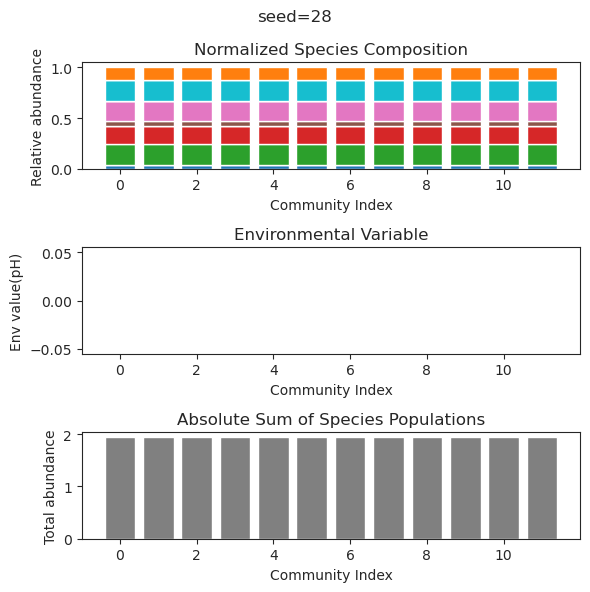

{'species': array([ 5.99012038e-001,  1.58693531e-019,  4.87511086e-001,
        1.41603030e-150, -1.31526013e-106,  3.74842413e-001,
        3.73475174e-002,  1.34044562e-002,  9.30821082e-003,
        1.94018525e-029,  4.80729836e-001,  1.18911461e-038]), 'env': array([0.])}
{'species': array([-4.96315055e-31,  1.62688827e-54,  2.89865616e-01, -3.30135989e-38,
       -1.78014735e-37, -3.80844982e-15,  6.46567984e-01,  3.10044414e-01,
       -1.23171583e-27,  6.49738193e-01, -8.33291297e-20,  6.42602085e-15]), 'env': array([0.])}
{'species': array([-5.66206616e-48, -6.69337241e-71,  2.89865616e-01, -3.09188704e-53,
        4.92638377e-53, -2.15259800e-18,  6.46567984e-01,  3.10044414e-01,
       -5.86908543e-38,  6.49738193e-01, -7.21858650e-28, -1.08840421e-18]), 'env': array([0.])}
{'species': array([-3.96719660e-35, -8.53005901e-60,  2.89865616e-01,  1.00241875e-40,
       -1.09950778e-39,  7.25995221e-17,  6.46567984e-01,  3.10044414e-01,
       -1.82958643e-29,  6.49738193e-01,  

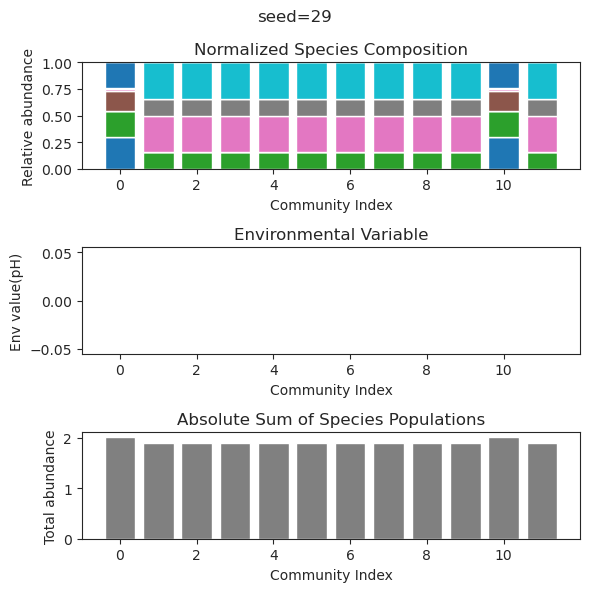

{'species': array([ 2.14072913e-001,  1.07823660e-002,  2.05086828e-001,
        3.05989423e-001,  1.80283455e-001, -7.82232466e-028,
        3.00638210e-107,  2.10784904e-001,  3.52392514e-001,
        3.69870652e-001,  1.16402440e-001,  3.96305462e-071]), 'env': array([0.])}
{'species': array([ 2.14072913e-001,  1.07823660e-002,  2.05086828e-001,
        3.05989423e-001,  1.80283455e-001,  6.13495065e-027,
       -1.37073618e-109,  2.10784904e-001,  3.52392514e-001,
        3.69870652e-001,  1.16402440e-001,  1.43130334e-076]), 'env': array([0.])}
{'species': array([ 2.14072913e-001,  1.07823660e-002,  2.05086828e-001,
        3.05989423e-001,  1.80283455e-001,  4.99342712e-026,
        6.59858752e-114,  2.10784904e-001,  3.52392514e-001,
        3.69870652e-001,  1.16402440e-001, -3.83206944e-076]), 'env': array([0.])}
{'species': array([ 2.14072913e-001,  1.07823660e-002,  2.05086828e-001,
        3.05989423e-001,  1.80283455e-001, -1.44252761e-028,
        1.08667972e-107,  2.1078

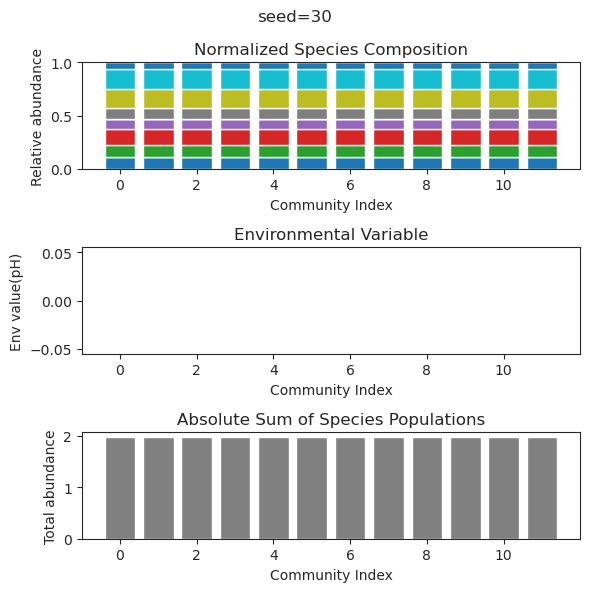

{'species': array([ 1.13216047e-01,  1.79622399e-01,  2.62328854e-01,  4.10961301e-01,
        1.90421780e-01,  4.56188020e-16,  7.49108923e-51,  4.13985630e-01,
       -1.32699907e-36, -1.33809471e-38,  4.36147311e-01,  1.03503351e-42]), 'env': array([0.])}
{'species': array([ 1.13216047e-01,  1.79622399e-01,  2.62328854e-01,  4.10961301e-01,
        1.90421780e-01, -1.85093231e-15,  3.70349497e-67,  4.13985630e-01,
       -9.28404593e-55, -4.74546205e-48,  4.36147311e-01, -7.78166469e-54]), 'env': array([0.])}
{'species': array([ 1.13216047e-01,  1.79622399e-01,  2.62328854e-01,  4.10961301e-01,
        1.90421780e-01,  2.87789542e-15,  2.61366521e-75,  4.13985630e-01,
       -1.36757918e-56, -9.49073736e-50,  4.36147311e-01, -1.56458727e-56]), 'env': array([0.])}
{'species': array([ 1.13216047e-01,  1.79622399e-01,  2.62328854e-01,  4.10961301e-01,
        1.90421780e-01, -1.21348306e-14,  2.90413539e-51,  4.13985630e-01,
       -9.02150323e-46,  4.36140661e-46,  4.36147311e-01, -2.

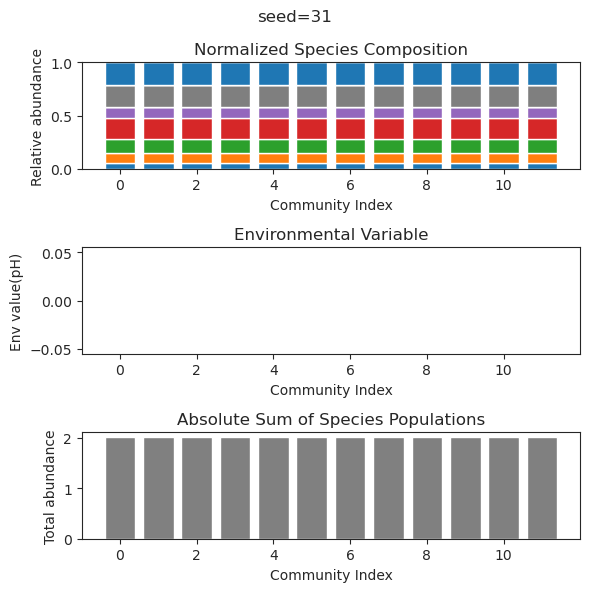

{'species': array([-1.48702875e-30,  1.92853305e-34,  1.20369764e-01, -6.59384616e-65,
        4.81559197e-01,  5.00159907e-01, -1.18869696e-55,  5.95957839e-01,
        4.68421652e-01,  6.09592382e-11, -2.83765480e-65,  1.10655381e-29]), 'env': array([0.])}
{'species': array([ 9.46254042e-31, -1.13716708e-37,  1.20369764e-01, -3.52152777e-35,
        4.81559197e-01,  5.00159907e-01, -1.51875710e-57,  5.95957839e-01,
        4.68421652e-01,  5.82806417e-11,  4.61364262e-68,  5.86978745e-28]), 'env': array([0.])}
{'species': array([-2.12740621e-75,  2.77922763e-67,  1.20369764e-01,  3.72071281e-78,
        4.81559197e-01,  5.00159907e-01,  2.40219458e-68,  5.95957839e-01,
        4.68421652e-01,  5.28025467e-11,  1.58272893e-75,  1.06996773e-32]), 'env': array([0.])}
{'species': array([-2.84791479e-34,  2.83182048e-43,  1.20369764e-01, -1.04353898e-36,
        4.81559197e-01,  5.00159907e-01, -1.67764618e-41,  5.95957839e-01,
        4.68421652e-01,  1.09024646e-10,  1.44369192e-55, -7.

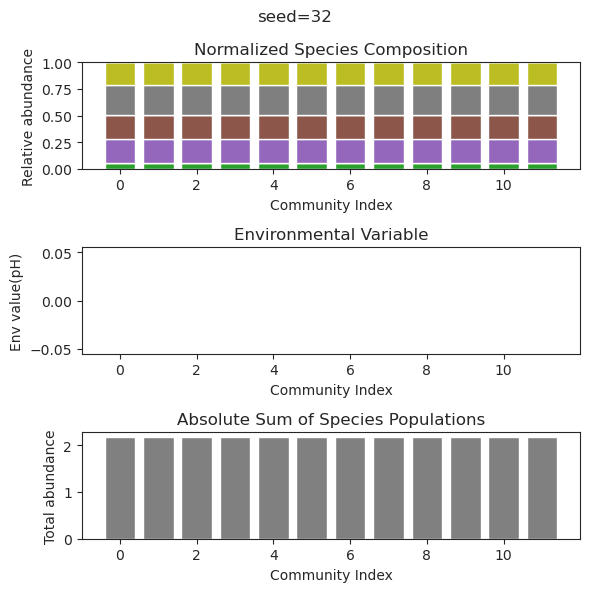

{'species': array([ 5.16811555e-002,  2.58704673e-031,  4.79935170e-001,
        4.66351212e-001,  4.66429063e-001,  2.28010519e-001,
       -2.13530397e-079,  1.25435288e-101, -4.21345805e-065,
        1.19579531e-002,  8.15639221e-100,  4.46468840e-001]), 'env': array([0.])}
{'species': array([ 1.24059406e-001, -1.32005981e-029,  1.66118029e-014,
        7.40044662e-002,  4.91894783e-001,  6.85758734e-001,
        1.30697277e-052, -2.54600924e-141,  1.64339099e-107,
        6.00192316e-001, -1.47947933e-134,  2.43898993e-002]), 'env': array([0.])}
{'species': array([5.20541591e-02, 8.97452650e-33, 4.76855497e-01, 4.64026816e-01,
       4.66678987e-01, 2.30811152e-01, 1.85396599e-71, 7.04762177e-87,
       1.21725741e-59, 1.55287192e-02, 3.62758881e-86, 4.43927463e-01]), 'env': array([0.])}
{'species': array([ 1.24059401e-01, -1.01954123e-29,  1.76267580e-11,  7.40044680e-02,
        4.91894785e-01,  6.85758731e-01,  3.56245065e-26,  7.57697422e-44,
       -2.53652902e-82,  6.00192315

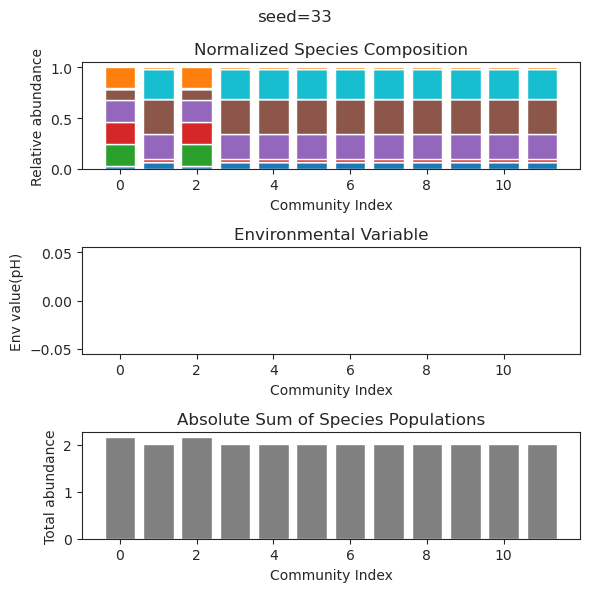

{'species': array([ 7.37236072e-01,  3.43338384e-61,  1.44428169e-73,  8.54569028e-56,
        6.86624980e-03,  5.48569613e-02,  8.50611452e-65,  1.15592514e-01,
        9.15305885e-54, -8.31343419e-77,  8.92212554e-01,  2.62285181e-01]), 'env': array([0.])}
{'species': array([ 7.37236072e-001, -3.31836796e-031,  1.99163213e-114,
       -4.23810255e-032,  6.86624969e-003,  5.48569614e-002,
       -9.69164289e-105,  1.15592514e-001,  1.48898349e-091,
       -8.96047574e-129,  8.92212554e-001,  2.62285181e-001]), 'env': array([0.])}
{'species': array([ 7.37236072e-01,  1.52901900e-37, -1.14671547e-52, -5.91393446e-47,
        6.86624979e-03,  5.48569613e-02, -1.13375825e-49,  1.15592514e-01,
       -4.41138045e-36,  2.20715943e-56,  8.92212554e-01,  2.62285181e-01]), 'env': array([0.])}
{'species': array([ 7.37236072e-01, -1.50974256e-68,  1.91715123e-29,  4.06973608e-63,
        6.86624979e-03,  5.48569613e-02, -9.54262168e-74,  1.15592514e-01,
        3.44640754e-59, -2.81052423e-84,  

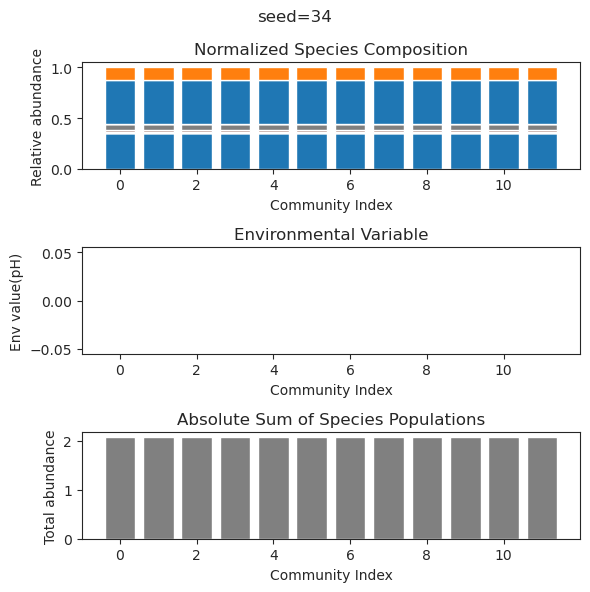

{'species': array([ 4.67440627e-001,  1.79445108e-001,  5.24638468e-001,
        4.05797047e-114,  9.77805032e-002,  1.21913378e-011,
       -5.57458381e-046,  2.02864042e-001, -2.78210164e-030,
        3.15022035e-001,  2.91097447e-096,  1.27283014e-001]), 'env': array([0.])}
{'species': array([ 4.67440627e-01,  1.79445108e-01,  5.24638468e-01, -9.14015037e-65,
        9.77805032e-02,  1.22029757e-12, -1.29779476e-41,  2.02864042e-01,
       -3.83324973e-30,  3.15022035e-01,  4.18365415e-62,  1.27283014e-01]), 'env': array([0.])}
{'species': array([ 4.67440627e-001,  1.79445108e-001,  5.24638468e-001,
       -8.47493333e-128,  9.77805032e-002,  2.45979389e-012,
        1.01745794e-050,  2.02864042e-001, -1.17044243e-032,
        3.15022035e-001,  1.43308590e-098,  1.27283014e-001]), 'env': array([0.])}
{'species': array([ 4.67440627e-001,  1.79445108e-001,  5.24638468e-001,
       -2.85797284e-130,  9.77805032e-002,  8.01822041e-021,
       -3.39206893e-068,  2.02864042e-001,  2.99170

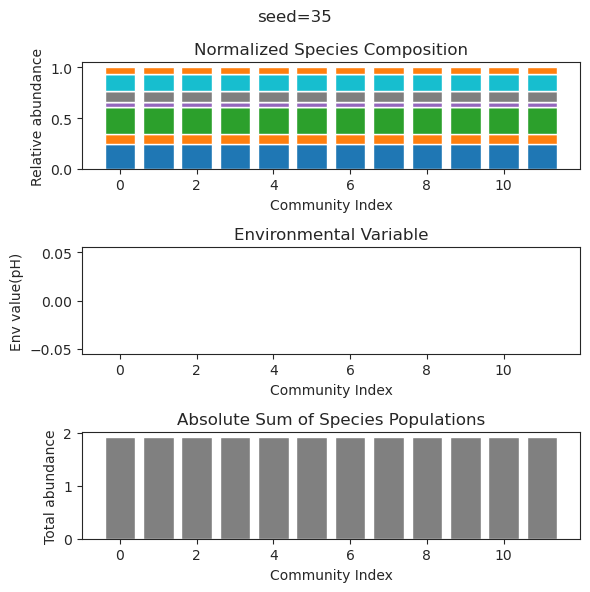

{'species': array([ 5.02735739e-31,  5.96997245e-01,  6.38123717e-01,  5.97938477e-01,
       -6.04857495e-35,  6.47003040e-01, -5.36491987e-35,  4.33770072e-02,
       -9.23860210e-39,  4.90285125e-30,  4.69849436e-30,  1.18510444e-33]), 'env': array([0.])}
{'species': array([ 6.51528598e-39,  5.96997245e-01,  6.38123717e-01,  5.97938477e-01,
       -5.45805744e-42,  6.47003040e-01,  2.09956992e-45,  4.33770072e-02,
        5.73879849e-50, -8.73550984e-40, -1.84815336e-37, -1.15018949e-40]), 'env': array([0.])}
{'species': array([-5.99281983e-63,  5.96997245e-01,  6.38123717e-01,  5.97938477e-01,
        1.03974248e-72,  6.47003040e-01, -4.50911973e-74,  4.33770072e-02,
        5.95332311e-79, -6.12790202e-63, -5.98290140e-66, -2.36855376e-72]), 'env': array([0.])}
{'species': array([ 9.13006780e-54,  5.96997245e-01,  6.38123717e-01,  5.97938477e-01,
       -1.53259527e-60,  6.47003040e-01, -3.09679079e-64,  4.33770072e-02,
       -4.77222920e-64, -1.84273748e-56, -1.34816756e-55, -1.

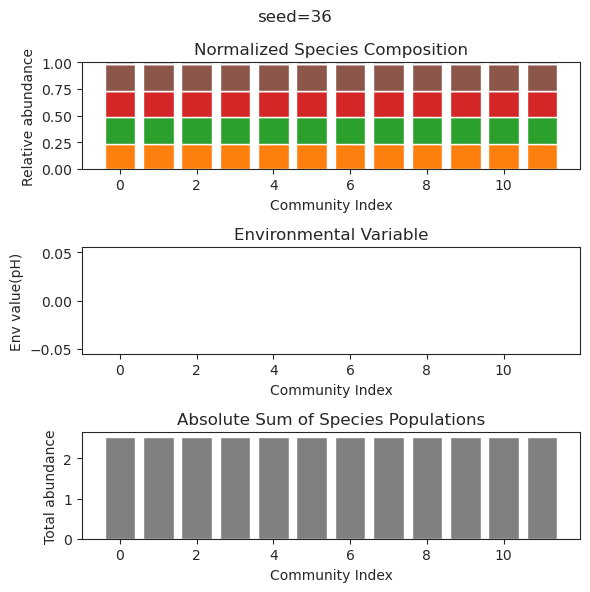

{'species': array([-1.44027354e-70,  4.19255023e-01,  4.77924648e-44,  4.02828027e-01,
        3.73417768e-01,  3.85082118e-82,  6.14368042e-48,  8.54223343e-02,
       -7.02037971e-32,  2.30074826e-01,  2.08220146e-01,  3.95267059e-01]), 'env': array([0.])}
{'species': array([-7.38106376e-76,  4.19255023e-01,  1.22368433e-48,  4.02828027e-01,
        3.73417768e-01, -3.17821650e-91,  5.22150457e-56,  8.54223343e-02,
       -3.66724084e-37,  2.30074826e-01,  2.08220146e-01,  3.95267059e-01]), 'env': array([0.])}
{'species': array([-9.48981697e-68,  4.19255023e-01,  2.84715442e-41,  4.02828027e-01,
        3.73417768e-01, -1.76511475e-76,  2.21812549e-48,  8.54223343e-02,
       -8.95085226e-31,  2.30074826e-01,  2.08220146e-01,  3.95267059e-01]), 'env': array([0.])}
{'species': array([ 4.49991652e-69,  4.19255023e-01,  1.14659835e-40,  4.02828027e-01,
        3.73417768e-01, -3.03574953e-96,  5.83586345e-45,  8.54223343e-02,
       -2.03444873e-28,  2.30074826e-01,  2.08220146e-01,  3.

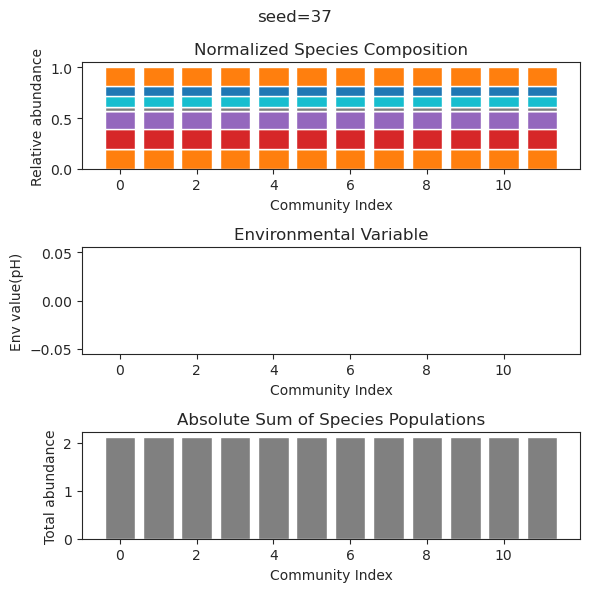

{'species': array([ 2.77268226e-001,  5.71401519e-047, -2.45014500e-047,
        6.85355191e-001,  3.03333079e-001, -1.92216927e-045,
        8.80821667e-003, -2.81081945e-084,  6.69052003e-003,
        5.03810230e-001, -3.18522293e-102,  1.77027760e-002]), 'env': array([0.])}
{'species': array([ 2.77268173e-001, -7.74405617e-042, -2.41901251e-047,
        6.85355307e-001,  3.03333079e-001,  5.66582351e-033,
        8.80801404e-003, -3.74113551e-089,  6.69077130e-003,
        5.03810247e-001,  2.28816400e-166,  1.77026503e-002]), 'env': array([0.])}
{'species': array([ 2.77268306e-01, -1.07372626e-33, -2.47429989e-47,  6.85355101e-01,
        3.03332997e-01,  3.26909930e-89,  8.80703460e-03, -1.81854844e-54,
        6.69147199e-03,  5.03810377e-01,  6.05796924e-89,  1.77028007e-02]), 'env': array([0.])}
{'species': array([ 2.77268172e-01,  4.37131465e-46, -4.03008015e-44,  6.85355320e-01,
        3.03333066e-01, -9.38165960e-75,  8.80788759e-03, -1.36425954e-53,
        6.69090068e-03,

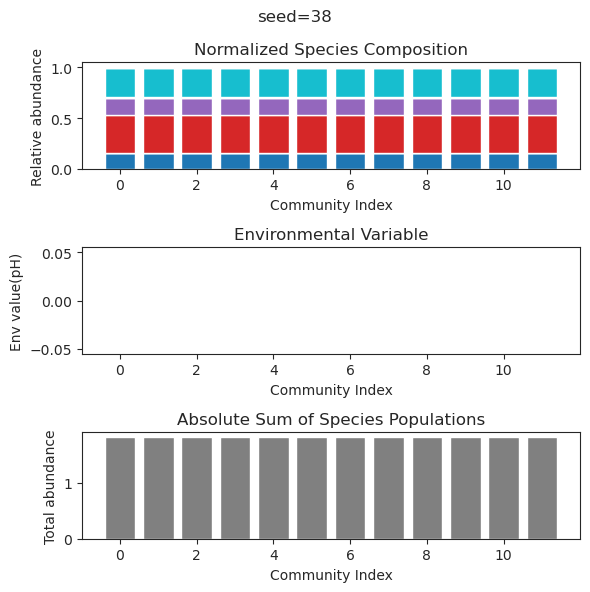

{'species': array([ 1.57220717e-27, -2.60130802e-34,  3.83596488e-01,  7.64154718e-01,
        3.40959292e-41,  4.20769153e-01, -1.31114316e-16, -9.06191356e-37,
        4.18156589e-02,  6.05088166e-41, -6.42327666e-42,  6.29590156e-01]), 'env': array([0.])}
{'species': array([-1.37959650e-36, -4.32543554e-43,  3.83596488e-01,  7.64154718e-01,
        2.62830157e-50,  4.20769153e-01,  3.13485973e-21, -7.88838358e-49,
        4.18156589e-02, -4.59304570e-50, -5.02070446e-54,  6.29590156e-01]), 'env': array([0.])}
{'species': array([ 2.06845314e-39, -8.80857254e-46,  3.83596488e-01,  7.64154718e-01,
       -2.27148128e-56,  4.20769153e-01, -2.28641565e-23, -1.95502919e-48,
        4.18156589e-02,  4.46054480e-54,  3.20662651e-54,  6.29590156e-01]), 'env': array([0.])}
{'species': array([-3.13064263e-31, -2.37436977e-37,  3.83596488e-01,  7.64154718e-01,
       -1.78080045e-44,  4.20769153e-01,  1.47003818e-18, -1.75324882e-41,
        4.18156589e-02,  1.04889287e-43,  3.66883054e-44,  6.

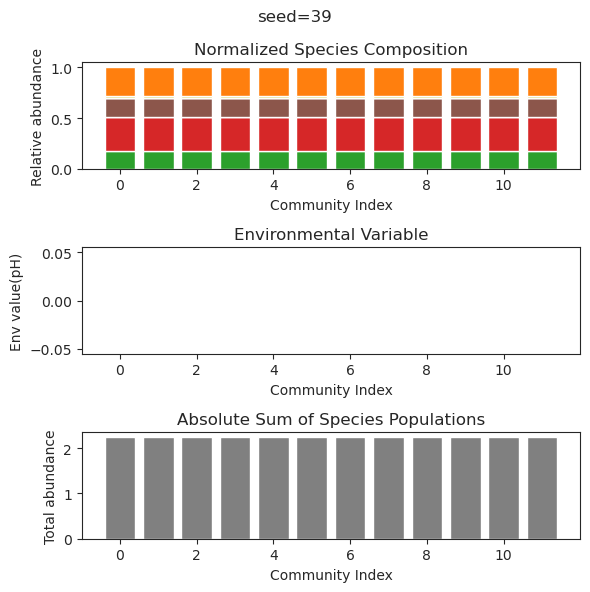

{'species': array([ 3.75679224e-28, -3.16826130e-35,  2.39631350e-01,  4.39879898e-01,
        2.94554332e-03,  4.33364554e-28,  8.10210361e-02,  3.31186327e-03,
        2.44681101e-28,  1.61141361e-01,  5.91791200e-01,  4.36883762e-01]), 'env': array([0.])}
{'species': array([ 1.13721551e-28,  5.16748954e-35,  2.37307145e-01,  4.41505160e-01,
        7.61308335e-03,  2.32475621e-29,  8.20166017e-02,  3.89619648e-03,
       -1.25880297e-33,  1.57604954e-01,  5.91000228e-01,  4.38070410e-01]), 'env': array([0.])}
{'species': array([ 1.74617189e-28,  5.10748148e-29,  2.37299590e-01,  4.41512993e-01,
        7.60593807e-03,  1.14361851e-29,  8.20192001e-02,  3.91231139e-03,
       -1.55440940e-32,  1.57599932e-01,  5.91003096e-01,  4.38059678e-01]), 'env': array([0.])}
{'species': array([1.34015847e-28, 4.73541097e-28, 2.37379116e-01, 4.41513555e-01,
       6.94821687e-03, 3.17412956e-27, 8.19711180e-02, 4.21052256e-03,
       1.15160083e-27, 1.57869365e-01, 5.91153361e-01, 4.37688017e-01

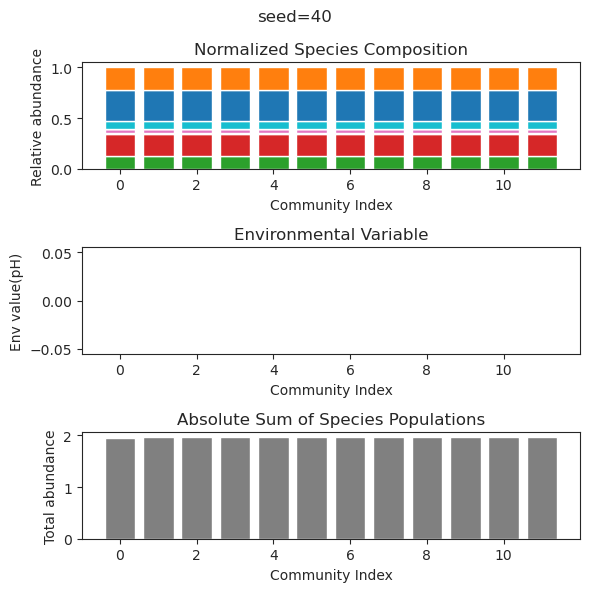

{'species': array([ 1.31422285e-001,  1.44519567e-001,  5.25421949e-001,
       -3.51245973e-104,  5.22913897e-002,  2.98249201e-029,
        2.59682356e-005,  2.28604703e-016,  2.63614859e-001,
        1.46934382e-001, -5.69506115e-035,  6.95403736e-001]), 'env': array([0.])}
{'species': array([ 1.31422403e-01,  1.44519722e-01,  5.25421916e-01, -4.86093873e-94,
        5.22915055e-02,  1.28584575e-28,  2.57547536e-05,  1.68362125e-14,
        2.63614822e-01,  1.46934358e-01,  8.98060637e-45,  6.95403629e-01]), 'env': array([0.])}
{'species': array([ 1.31398383e-01,  1.44488141e-01,  5.25428552e-01, -3.15836405e-39,
        5.22678445e-02, -1.10516495e-28,  6.92656161e-05,  8.37783514e-17,
        2.63622295e-01,  1.46939244e-01,  6.39924051e-31,  6.95425369e-01]), 'env': array([0.])}
{'species': array([ 1.31409913e-01,  1.44503291e-01,  5.25425378e-01, -6.24621130e-55,
        5.22792059e-02,  5.93169462e-32,  4.83999675e-05,  1.30334993e-15,
        2.63618702e-01,  1.46936886e-01,  

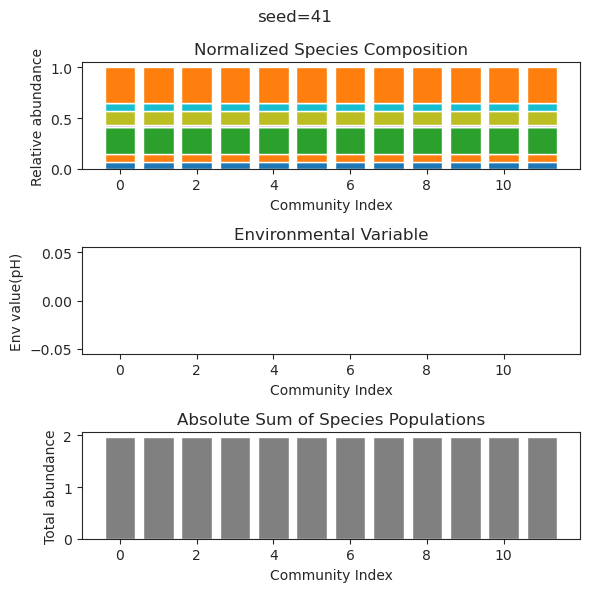

{'species': array([ 2.24169227e-001,  1.47724767e-001,  4.64966121e-040,
        5.23647907e-001,  1.81921333e-001,  2.27721894e-001,
       -2.19313867e-066, -3.95029241e-121,  4.12501995e-001,
        3.10934323e-081,  4.87397595e-001,  8.50835455e-054]), 'env': array([0.])}
{'species': array([ 2.24169227e-001,  1.47724767e-001, -4.34962228e-049,
        5.23647907e-001,  1.81921333e-001,  2.27721894e-001,
        6.99520613e-084,  3.80879890e-141,  4.12501995e-001,
       -5.95473001e-100,  4.87397595e-001,  3.68908000e-061]), 'env': array([0.])}
{'species': array([ 2.24169227e-001,  1.47724767e-001,  5.76035654e-045,
        5.23647907e-001,  1.81921333e-001,  2.27721894e-001,
       -1.52899201e-077,  5.95146136e-136,  4.12501995e-001,
       -1.46119153e-094,  4.87397595e-001,  5.70742350e-059]), 'env': array([0.])}
{'species': array([ 2.24169227e-001,  1.47724767e-001,  6.11084277e-044,
        5.23647907e-001,  1.81921333e-001,  2.27721894e-001,
        2.67762250e-071, -7.4912

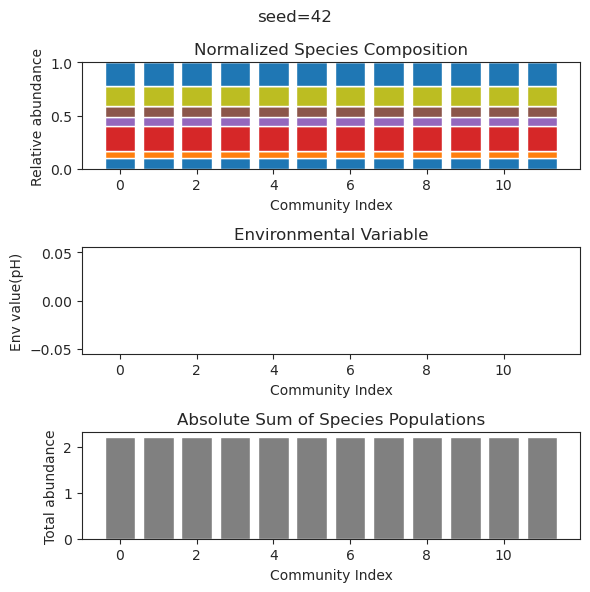

{'species': array([ 4.13927303e-01, -4.97181547e-41,  3.78068728e-01,  1.23665298e-42,
        1.46063759e-01,  2.89053857e-01, -3.94260623e-32,  4.33281741e-01,
        1.73912707e-01,  9.16482584e-10,  1.47244571e-19,  5.45946415e-42]), 'env': array([0.])}
{'species': array([1.27624395e-33, 1.86562594e-01, 7.93699876e-02, 8.17539696e-02,
       2.59181112e-21, 5.58341107e-01, 1.59843638e-01, 1.31792769e-01,
       1.50209847e-01, 1.23226756e-35, 2.40810327e-01, 2.16225990e-01]), 'env': array([0.])}
{'species': array([ 4.13927295e-01,  9.96269525e-36,  3.78068728e-01,  2.04241615e-36,
        1.46063755e-01,  2.89053862e-01,  2.84221602e-30,  4.33281734e-01,
        1.73912705e-01,  1.44265136e-08,  3.36580580e-20, -2.63679666e-42]), 'env': array([0.])}
{'species': array([-5.04751272e-31,  1.86562594e-01,  7.93699876e-02,  8.17539696e-02,
        3.67382041e-20,  5.58341107e-01,  1.59843638e-01,  1.31792769e-01,
        1.50209847e-01, -6.76540086e-35,  2.40810327e-01,  2.16225990e-01

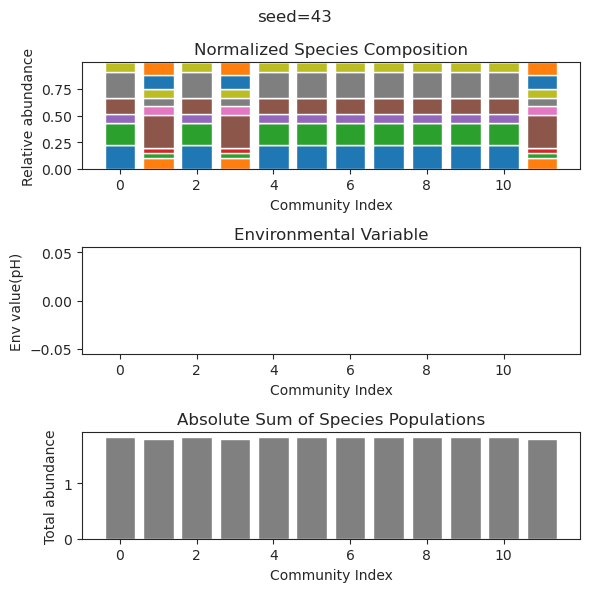

{'species': array([-3.42299314e-059,  1.84342527e-001,  2.71176973e-001,
        3.35496477e-163,  3.13832820e-001,  5.58252607e-003,
        6.50793650e-050,  3.29959329e-001,  4.05875215e-001,
        4.33214760e-001,  1.44500700e-001,  4.05329526e-134]), 'env': array([0.])}
{'species': array([ 1.53393249e-40,  1.84345344e-01,  2.71165084e-01, -1.02124637e-33,
        3.13836204e-01,  5.57312693e-03,  4.65424285e-36,  3.29953637e-01,
        4.05878004e-01,  4.33223242e-01,  1.44507690e-01, -1.25426303e-99]), 'env': array([0.])}
{'species': array([-2.96685231e-072,  1.84342451e-001,  2.71177292e-001,
        7.52596999e-186,  3.13832729e-001,  5.58277850e-003,
        1.22484794e-061,  3.29959482e-001,  4.05875140e-001,
        4.33214532e-001,  1.44500513e-001,  1.96113929e-155]), 'env': array([0.])}
{'species': array([-4.32662776e-34,  1.84342445e-01,  2.71177320e-01,  2.16649650e-34,
        3.13832721e-01,  5.58280009e-03,  4.58128115e-38,  3.29959495e-01,
        4.05875134e-01,

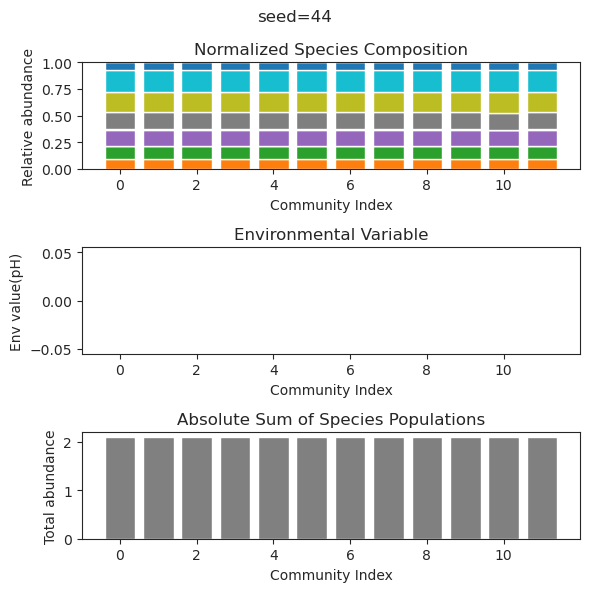

{'species': array([ 1.61701398e-001,  2.84555851e-002,  4.30308448e-001,
        9.91236032e-002,  7.45323142e-002,  5.28569418e-001,
       -4.69343992e-051,  9.07998784e-132, -3.47522954e-042,
        3.74164490e-001,  2.05684936e-001, -1.07970486e-014]), 'env': array([0.])}
{'species': array([ 1.61701398e-001,  2.84555851e-002,  4.30308448e-001,
        9.91236032e-002,  7.45323142e-002,  5.28569418e-001,
       -1.29760547e-049,  2.56849850e-133, -5.79960777e-040,
        3.74164490e-001,  2.05684936e-001, -3.51240308e-016]), 'env': array([0.])}
{'species': array([ 1.61701398e-001,  2.84555851e-002,  4.30308448e-001,
        9.91236032e-002,  7.45323142e-002,  5.28569418e-001,
       -1.62805455e-062, -1.10685195e-155, -1.70323523e-050,
        3.74164490e-001,  2.05684936e-001,  1.93599057e-013]), 'env': array([0.])}
{'species': array([ 1.61701398e-001,  2.84555851e-002,  4.30308448e-001,
        9.91236032e-002,  7.45323142e-002,  5.28569418e-001,
       -6.91498131e-057, -1.8679

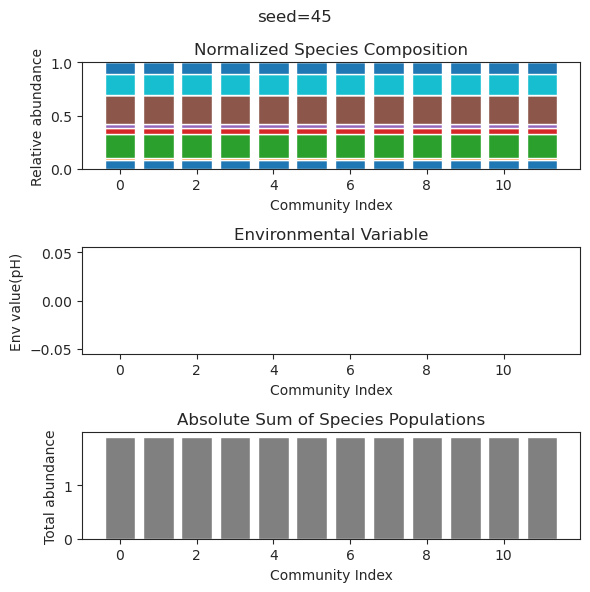

{'species': array([-7.60251987e-40,  5.62313421e-01, -8.49171050e-29,  6.00425850e-01,
       -3.76885738e-27,  1.14559140e-32, -3.09652489e-23,  2.67580020e-01,
        3.29697108e-01,  1.56668166e-36,  4.07970560e-01,  1.18386113e-01]), 'env': array([0.])}
{'species': array([-7.39247428e-41,  5.62313421e-01, -1.71348496e-31,  6.00425850e-01,
       -2.98400375e-29,  2.41319280e-35, -1.87622346e-23,  2.67580020e-01,
        3.29697108e-01,  5.40932062e-39,  4.07970560e-01,  1.18386113e-01]), 'env': array([0.])}
{'species': array([-5.74051967e-34,  5.62313421e-01, -2.87723231e-25,  6.00425850e-01,
       -7.13692957e-24,  1.76690931e-27, -1.48490310e-20,  2.67580020e-01,
        3.29697108e-01,  1.19341694e-31,  4.07970560e-01,  1.18386113e-01]), 'env': array([0.])}
{'species': array([ 8.49621087e-42,  5.62313421e-01, -8.75649210e-28,  6.00425850e-01,
       -3.91131957e-28,  7.50773573e-34, -1.32211736e-22,  2.67580020e-01,
        3.29697108e-01,  6.07690319e-38,  4.07970560e-01,  1.

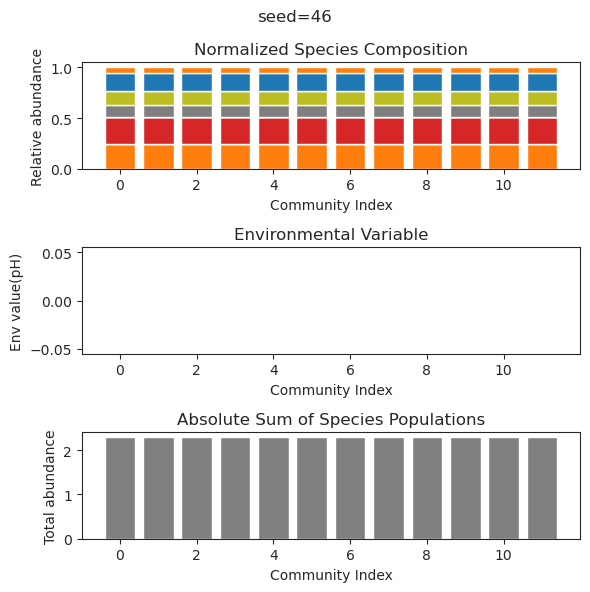

{'species': array([ 2.32349104e-02,  4.18646897e-01,  6.02848777e-59,  2.52067580e-01,
        3.58691678e-01,  6.20750782e-37, -2.63834655e-38,  7.31655873e-03,
        1.93770798e-30,  3.71782766e-01,  5.11011134e-01,  3.52608848e-02]), 'env': array([0.])}
{'species': array([ 2.32349366e-02,  4.18646000e-01,  1.31912441e-33,  2.52067734e-01,
        3.58691365e-01,  6.14614400e-38, -5.28393550e-40,  7.31836515e-03,
       -3.62334265e-32,  3.71783518e-01,  5.11011550e-01,  3.52599545e-02]), 'env': array([0.])}
{'species': array([ 2.32347721e-02,  4.18651625e-01,  7.45441424e-57,  2.52066766e-01,
        3.58693329e-01,  3.41503328e-30,  2.23133729e-45,  7.30703000e-03,
       -4.17527062e-26,  3.71778802e-01,  5.11008942e-01,  3.52657912e-02]), 'env': array([0.])}
{'species': array([ 2.32349180e-02,  4.18646637e-01, -1.01785176e-95,  2.52067624e-01,
        3.58691587e-01, -9.95031593e-38, -1.20257867e-37,  7.31708182e-03,
        6.57181761e-31,  3.71782984e-01,  5.11011255e-01,  3.

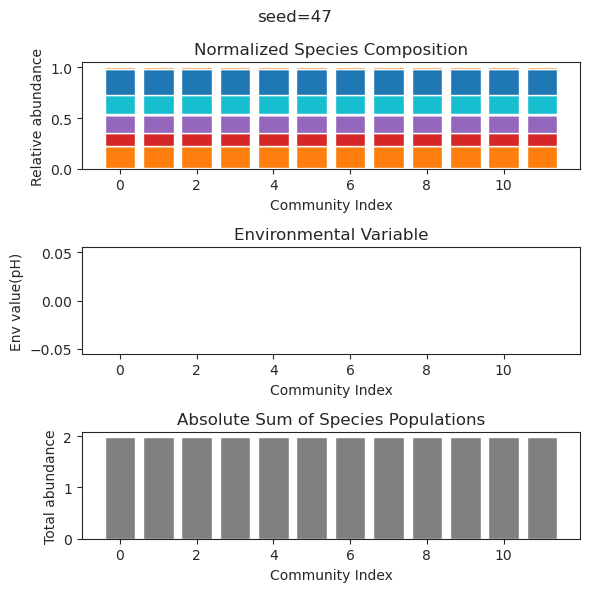

{'species': array([-3.62389970e-28,  4.85843713e-01,  1.35776830e-28, -2.75440497e-33,
        2.19434072e-55,  5.73984831e-01,  3.02589135e-01,  4.55511812e-01,
        1.09210308e-32,  2.31999334e-01,  3.85691446e-56,  8.75326226e-03]), 'env': array([0.])}
{'species': array([ 7.89464442e-26,  4.83533357e-01,  8.43749918e-25, -3.62734830e-38,
        9.90375689e-34,  5.75333006e-01,  2.97608928e-01,  4.58928930e-01,
       -1.69615074e-24,  2.26203222e-01,  3.86662348e-39,  1.54968226e-02]), 'env': array([0.])}
{'species': array([-6.25435658e-31,  4.83524086e-01,  8.57795481e-36,  2.32981696e-34,
        1.47932197e-45,  5.75338664e-01,  2.97589172e-01,  4.58942552e-01,
        4.38525906e-48,  2.26180214e-01,  2.80987108e-44,  1.55231649e-02]), 'env': array([0.])}
{'species': array([-6.55274428e-28,  4.84207293e-01,  1.51664997e-27,  5.17584309e-69,
       -3.20720396e-60,  5.74926882e-01,  2.99049812e-01,  4.57936805e-01,
       -2.38608061e-36,  2.27880904e-01,  2.28238947e-69,  1.

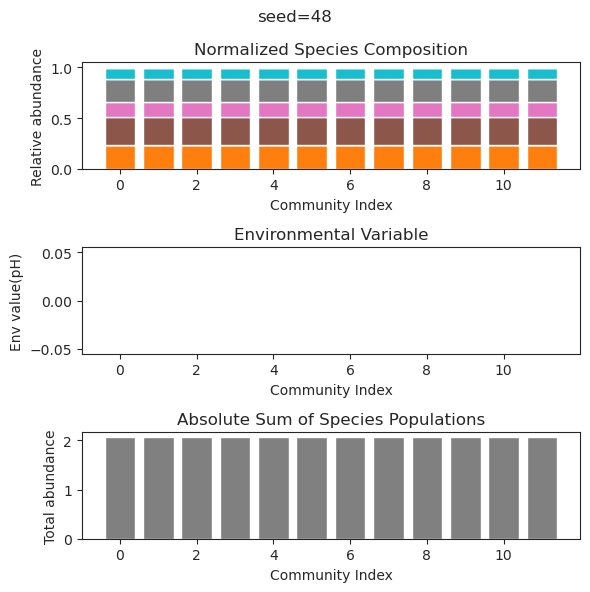

{'species': array([-2.63553958e-35, -1.60115906e-40, -3.82208254e-32,  1.22824758e-12,
        3.12210219e-01,  1.39690606e-06,  4.31016730e-01,  2.14424815e-01,
        2.81215757e-01,  9.92726420e-02,  3.27887918e-57,  4.92959662e-01]), 'env': array([0.])}
{'species': array([ 9.47518167e-32, -6.31161954e-36, -1.02801305e-49,  8.28534493e-12,
        3.12210267e-01,  1.60533982e-06,  4.31016660e-01,  2.14424773e-01,
        2.81215495e-01,  9.92727255e-02,  5.44892974e-51,  4.92959744e-01]), 'env': array([0.])}
{'species': array([-2.40210268e-38,  7.46878833e-40, -8.25000097e-42,  7.10261987e-09,
        3.12209948e-01,  2.44408482e-07,  4.31017106e-01,  2.14425043e-01,
        2.81217206e-01,  9.92721901e-02, -2.18129289e-52,  4.92959199e-01]), 'env': array([0.])}
{'species': array([ 6.12100036e-27,  6.27267752e-31, -8.95726467e-51,  5.49749278e-19,
        3.12209900e-01,  4.12064190e-12,  4.31017195e-01,  2.14425098e-01,
        2.81217510e-01,  9.92720827e-02, -3.18145695e-55,  4.

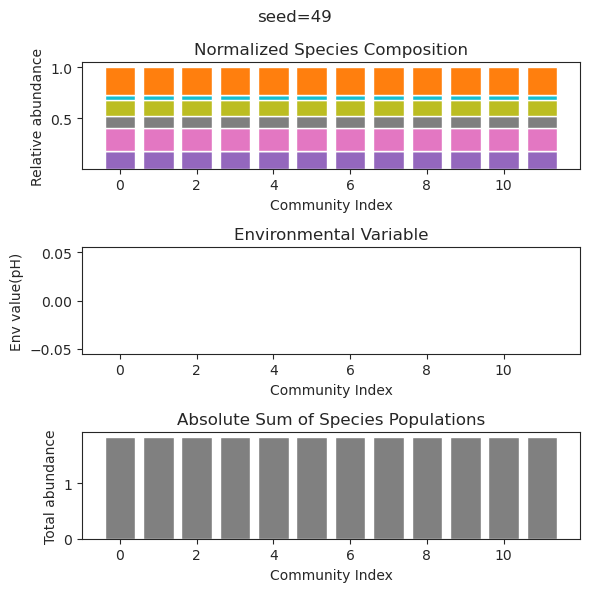

{'species': array([ 3.21488814e-01, -9.10755509e-38, -1.41092901e-59, -2.30616244e-55,
       -1.53453555e-33,  1.54709371e-01,  3.70340288e-01, -2.96430637e-30,
       -1.13625474e-33,  4.46192756e-01,  5.63427048e-01,  1.12533517e-01]), 'env': array([0.])}
{'species': array([ 3.21488814e-01,  2.11779471e-37, -1.01088737e-57, -4.87678630e-53,
       -4.05243776e-32,  1.54709371e-01,  3.70340288e-01, -5.05901941e-28,
       -4.60328971e-33,  4.46192756e-01,  5.63427048e-01,  1.12533517e-01]), 'env': array([0.])}
{'species': array([ 3.21488814e-01, -3.30704226e-37, -7.56476339e-58, -2.36783640e-55,
       -1.71956800e-32,  1.54709371e-01,  3.70340288e-01, -6.53180529e-29,
       -1.54544959e-33,  4.46192756e-01,  5.63427048e-01,  1.12533517e-01]), 'env': array([0.])}
{'species': array([ 3.21488814e-01, -7.49759603e-37,  1.12262038e-51,  2.26408299e-51,
       -7.42378683e-33,  1.54709371e-01,  3.70340288e-01, -7.72840565e-30,
       -3.83922679e-33,  4.46192756e-01,  5.63427048e-01,  1.

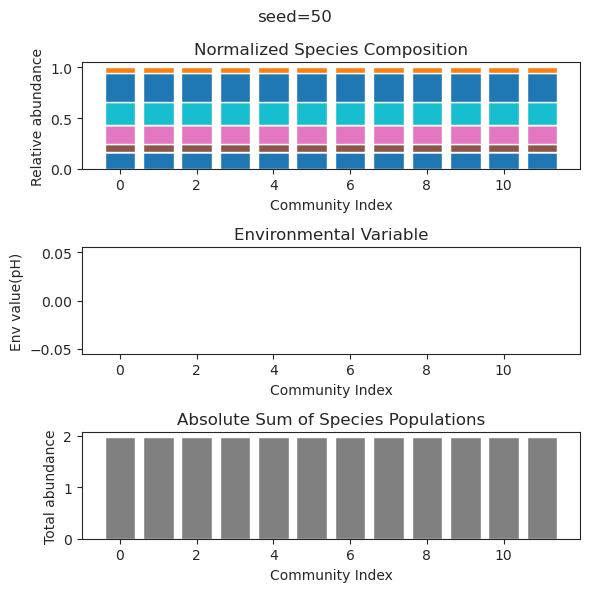

{'species': array([ 1.58928417e-01,  4.30042212e-01,  1.19739645e-26,  1.59094480e-01,
        4.62022358e-01,  3.75340020e-01,  7.33375742e-02,  3.10365295e-01,
       -8.90687966e-22,  2.04531802e-01, -3.51393991e-26, -4.11006870e-20]), 'env': array([0.])}
{'species': array([ 1.58928417e-01,  4.30042212e-01,  2.85098727e-31,  1.59094480e-01,
        4.62022358e-01,  3.75340020e-01,  7.33375742e-02,  3.10365295e-01,
       -1.21092405e-24,  2.04531802e-01, -1.40604491e-23, -4.70571044e-23]), 'env': array([0.])}
{'species': array([ 1.58928417e-01,  4.30042212e-01, -2.53410922e-30,  1.59094480e-01,
        4.62022358e-01,  3.75340020e-01,  7.33375742e-02,  3.10365295e-01,
        8.02542824e-26,  2.04531802e-01,  1.65705646e-26,  2.97336037e-24]), 'env': array([0.])}
{'species': array([ 1.58928417e-01,  4.30042212e-01, -1.70175242e-29,  1.59094480e-01,
        4.62022358e-01,  3.75340020e-01,  7.33375742e-02,  3.10365295e-01,
       -8.34941905e-21,  2.04531802e-01, -5.24745780e-23, -2.

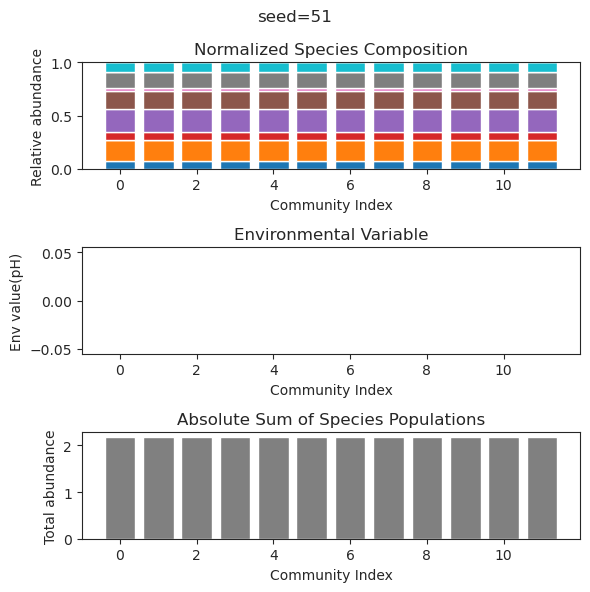

{'species': array([ 2.61000919e-01,  2.96726773e-01,  6.09961683e-38,  3.65773114e-01,
       -6.59212839e-45, -8.73520797e-39,  3.50635975e-01,  5.50464682e-02,
        2.53319284e-01,  1.29879556e-01,  4.73260888e-34,  1.53284328e-01]), 'env': array([0.])}
{'species': array([ 2.60992637e-01,  2.96719341e-01, -3.40814381e-41,  3.65763934e-01,
       -7.17726529e-39,  4.95801338e-37,  3.50642280e-01,  5.50654024e-02,
        2.53315387e-01,  1.29875210e-01, -3.01727108e-33,  1.53286387e-01]), 'env': array([0.])}
{'species': array([ 2.85034834e-01,  3.17881223e-01,  5.23446349e-42,  3.92406856e-01,
       -1.35837456e-30,  1.27599504e-47,  3.32977151e-01,  7.55248069e-09,
        2.64299865e-01,  1.42082069e-01, -1.26831973e-20,  1.47596362e-01]), 'env': array([0.])}
{'species': array([ 2.61014879e-01,  2.96739300e-01,  3.46222339e-57,  3.65788590e-01,
       -1.14518672e-37, -3.16473387e-34,  3.50625348e-01,  5.50145515e-02,
        2.53325855e-01,  1.29886882e-01,  2.72760106e-36,  1.

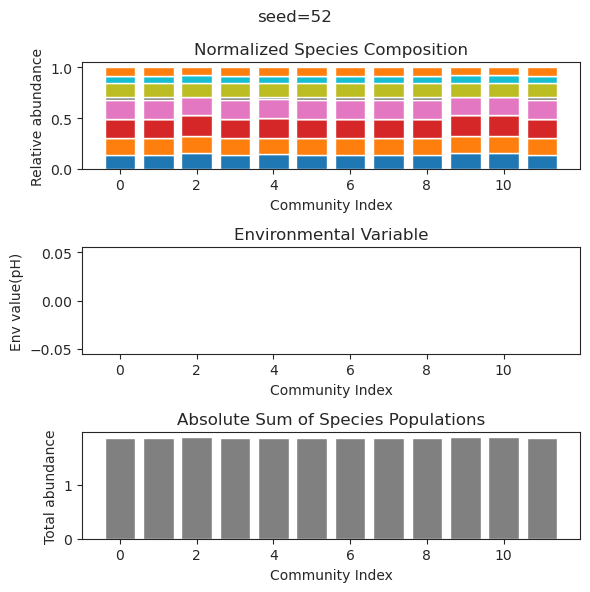

{'species': array([ 4.30552883e-01,  5.48387340e-02, -1.14853638e-38,  7.44833485e-01,
        2.61564269e-36, -3.56554882e-38, -1.02464374e-40, -1.07022143e-44,
        4.37448666e-01,  4.44142974e-33,  4.98932151e-01, -4.45750783e-45]), 'env': array([0.])}
{'species': array([ 4.30552883e-01,  5.48387340e-02,  4.18853357e-41,  7.44833485e-01,
       -2.67301593e-36, -1.68329903e-36,  4.41835598e-42,  2.95707633e-46,
        4.37448666e-01,  5.86383373e-34,  4.98932151e-01,  4.04890668e-46]), 'env': array([0.])}
{'species': array([ 4.30552883e-01,  5.48387340e-02, -3.36200664e-69,  7.44833485e-01,
        4.57933113e-56, -7.35508571e-66,  6.60938331e-75, -3.08344113e-76,
        4.37448666e-01,  2.79192659e-54,  4.98932151e-01, -9.16912493e-82]), 'env': array([0.])}
{'species': array([ 4.30552883e-01,  5.48387340e-02, -6.89448241e-40,  7.44833485e-01,
        4.70507558e-36, -3.38103604e-36, -3.98537604e-42,  1.19048296e-41,
        4.37448666e-01, -7.18799112e-34,  4.98932151e-01,  2.

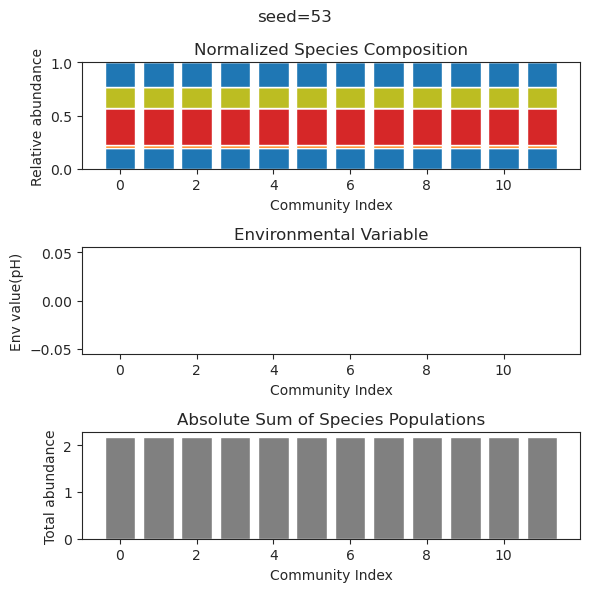

{'species': array([-6.94649876e-37,  1.27734629e-01,  2.50151502e-01,  7.20368482e-02,
        9.07232152e-34,  1.50191242e-01,  3.76382073e-01,  1.48269955e-01,
        3.73168334e-01,  1.91907294e-26,  4.24336974e-01,  3.07466405e-02]), 'env': array([0.])}
{'species': array([-3.09190439e-45,  1.27734629e-01,  2.50151502e-01,  7.20368482e-02,
       -8.44025829e-41,  1.50191242e-01,  3.76382073e-01,  1.48269955e-01,
        3.73168334e-01, -3.64057938e-30,  4.24336974e-01,  3.07466405e-02]), 'env': array([0.])}
{'species': array([-2.21890929e-33,  1.27734629e-01,  2.50151502e-01,  7.20368482e-02,
       -3.36489223e-30,  1.50191242e-01,  3.76382073e-01,  1.48269955e-01,
        3.73168334e-01,  2.86950769e-24,  4.24336974e-01,  3.07466405e-02]), 'env': array([0.])}
{'species': array([-1.78258943e-35,  1.27734629e-01,  2.50151502e-01,  7.20368482e-02,
       -9.22703164e-33,  1.50191242e-01,  3.76382073e-01,  1.48269955e-01,
        3.73168334e-01,  1.94985916e-26,  4.24336974e-01,  3.

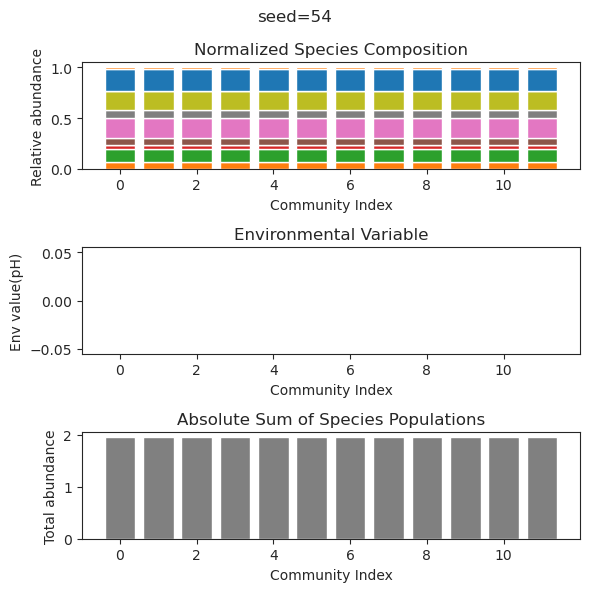

{'species': array([ 1.91648836e-52, -1.21519251e-35, -3.04912271e-34,  1.36074791e-54,
        2.15224525e-01,  6.47389293e-01,  5.60229333e-01, -2.16942851e-38,
        3.17539773e-42,  3.58786657e-01, -1.16652689e-17,  1.87828147e-01]), 'env': array([0.])}
{'species': array([-3.75665007e-47, -3.18844523e-32,  6.82951846e-31, -3.34758123e-47,
        2.15224525e-01,  6.47389293e-01,  5.60229333e-01, -9.43058730e-35,
       -6.94365909e-38,  3.58786657e-01,  3.91014110e-17,  1.87828147e-01]), 'env': array([0.])}
{'species': array([-2.16764355e-39,  2.71306163e-31,  1.16969600e-30,  2.53650807e-45,
        2.15224525e-01,  6.47389293e-01,  5.60229333e-01,  4.84754459e-32,
        1.21879051e-32,  3.58786657e-01,  1.90433365e-16,  1.87828147e-01]), 'env': array([0.])}
{'species': array([ 6.80419020e-51, -1.54858634e-34, -1.64435496e-32,  2.76638242e-54,
        2.15224525e-01,  6.47389293e-01,  5.60229333e-01, -1.92656877e-37,
       -9.22925646e-40,  3.58786657e-01,  1.21268381e-17,  1.

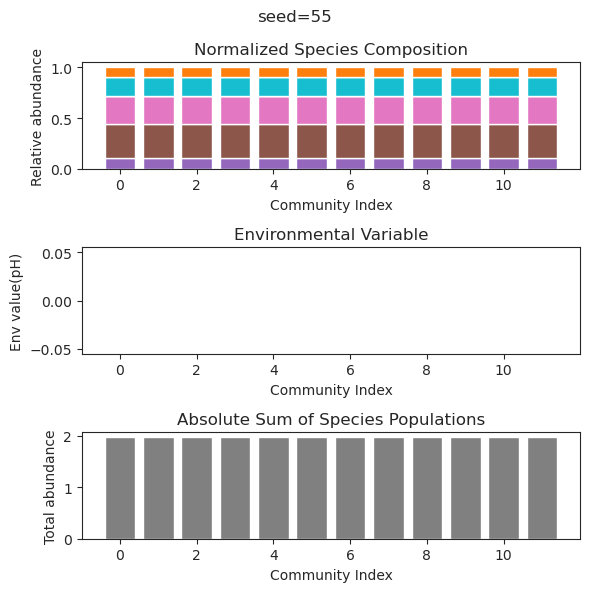

{'species': array([ 3.80839745e-01, -2.48724105e-50, -5.69182193e-36, -4.28053018e-26,
        7.16103521e-01, -1.39491623e-43,  5.17443970e-01, -6.16783324e-25,
        2.04950946e-01,  1.46269993e-01, -3.07935676e-34,  2.43806049e-50]), 'env': array([0.])}
{'species': array([ 3.80839745e-01,  1.67739357e-51, -7.13506942e-43,  1.83891997e-30,
        7.16103521e-01,  3.41252176e-48,  5.17443970e-01,  1.24540154e-30,
        2.04950946e-01,  1.46269993e-01, -1.35297081e-40, -1.00517576e-52]), 'env': array([0.])}
{'species': array([ 3.80839745e-01,  1.66435281e-65,  1.28086773e-45, -1.67049855e-31,
        7.16103521e-01,  1.15337812e-58,  5.17443970e-01, -2.18625140e-30,
        2.04950946e-01,  1.46269993e-01,  7.70073716e-47, -2.12445637e-65]), 'env': array([0.])}
{'species': array([ 3.80839745e-01,  4.12933971e-37, -2.53591571e-34, -6.29666466e-26,
        7.16103521e-01, -4.81500759e-40,  5.17443970e-01, -5.16675028e-25,
        2.04950946e-01,  1.46269993e-01, -4.80653876e-33,  4.

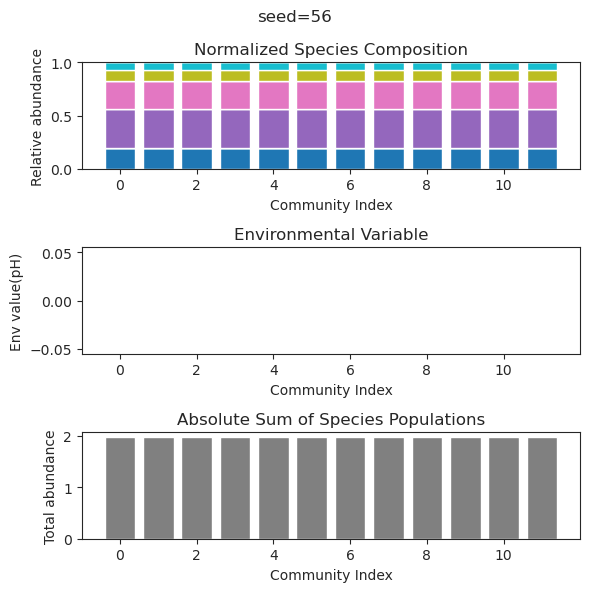

{'species': array([ 2.48172969e-40,  2.57852127e-01,  4.99381584e-01,  1.29855771e-01,
       -2.32139602e-37, -5.53741120e-27,  5.64496447e-01, -1.11411959e-52,
        7.42022335e-08, -4.38227253e-54,  1.08300769e-19,  5.10180943e-01]), 'env': array([0.])}
{'species': array([ 3.36917433e-36,  2.57852258e-01,  4.99381393e-01,  1.29855946e-01,
       -1.36103288e-37, -1.50149325e-31,  5.64496102e-01,  2.92497886e-76,
        2.49850318e-07,  2.41127728e-80,  8.74749082e-21,  5.10180954e-01]), 'env': array([0.])}
{'species': array([-3.95938097e-37,  2.57852499e-01,  4.99381040e-01,  1.29856270e-01,
       -1.64401464e-44,  3.16289461e-32,  5.64495464e-01,  1.46777092e-57,
        5.74108697e-07, -5.83085124e-59,  4.00843034e-18,  5.10180973e-01]), 'env': array([0.])}
{'species': array([-1.00237420e-51,  2.57852072e-01,  4.99381665e-01,  1.29855697e-01,
       -2.16642901e-51,  4.57595788e-32,  5.64496593e-01,  3.50016102e-65,
        5.54554553e-13,  7.18050786e-71,  1.94041895e-15,  5.

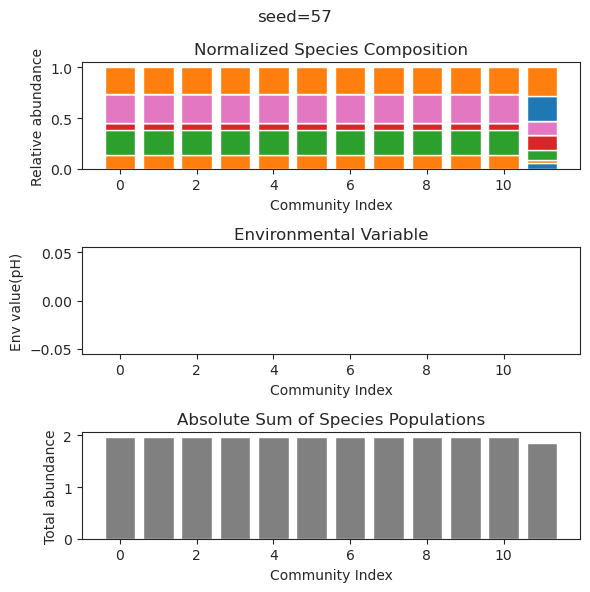

{'species': array([-7.42777067e-42,  2.55217435e-01,  3.43221589e-01,  1.79431686e-51,
        2.61982345e-32, -5.45644894e-22,  1.53144584e-01, -8.17114215e-17,
        5.52916474e-01,  4.65386709e-41,  5.88857864e-01,  8.90725292e-02]), 'env': array([0.])}
{'species': array([ 6.48394648e-47,  2.55217435e-01,  3.43221589e-01, -1.80959735e-50,
        4.36626749e-29, -2.88793067e-21,  1.53144584e-01,  4.67683338e-16,
        5.52916474e-01, -1.13098865e-44,  5.88857864e-01,  8.90725292e-02]), 'env': array([0.])}
{'species': array([-7.89587194e-49,  2.55217435e-01,  3.43221589e-01,  1.31594235e-58,
       -2.40697212e-29,  1.23775915e-21,  1.53144584e-01, -8.81533444e-15,
        5.52916474e-01, -1.21027965e-46,  5.88857864e-01,  8.90725292e-02]), 'env': array([0.])}
{'species': array([-2.63148047e-42,  2.55217435e-01,  3.43221589e-01,  2.19444973e-51,
        4.79591665e-31,  7.32061556e-20,  1.53144584e-01, -1.03473996e-14,
        5.52916474e-01, -7.13674066e-40,  5.88857864e-01,  8.

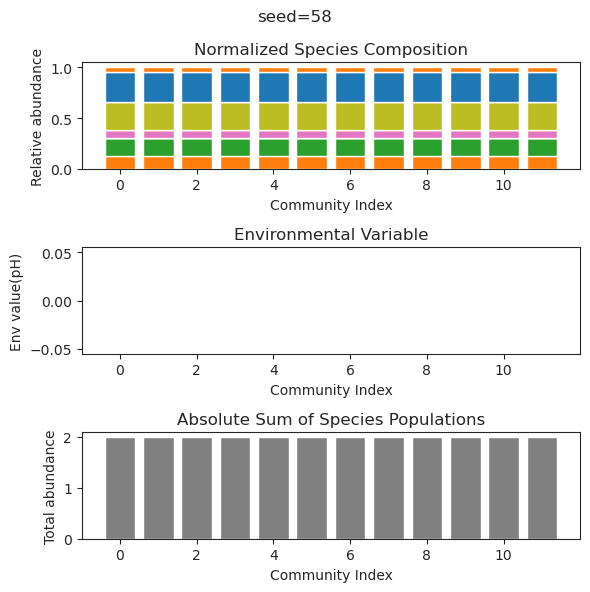

{'species': array([ 4.38913046e-01,  4.05348133e-01, -6.76451020e-18,  2.12235455e-38,
        2.52948254e-49,  2.16611182e-51,  2.34490653e-01, -1.17761553e-34,
        1.11311207e-01,  5.26914201e-01,  1.27066419e-77,  1.72182740e-01]), 'env': array([0.])}
{'species': array([ 4.38913046e-01,  4.05348133e-01,  7.99329375e-20, -1.33491807e-41,
       -7.89104770e-59,  1.97014725e-64,  2.34490653e-01, -2.00040518e-38,
        1.11311207e-01,  5.26914201e-01, -9.63274315e-91,  1.72182740e-01]), 'env': array([0.])}
{'species': array([ 4.38913046e-01,  4.05348133e-01,  3.80584819e-19,  3.41295053e-42,
       -2.45662792e-56, -1.57098257e-66,  2.34490653e-01,  9.08142599e-43,
        1.11311207e-01,  5.26914201e-01, -4.69092641e-94,  1.72182740e-01]), 'env': array([0.])}
{'species': array([ 4.38913046e-001,  4.05348133e-001,  1.43569761e-019,
       -2.59882770e-044, -7.07826582e-060, -5.20782793e-068,
        2.34490653e-001, -9.53344813e-044,  1.11311207e-001,
        5.26914201e-001,  9.

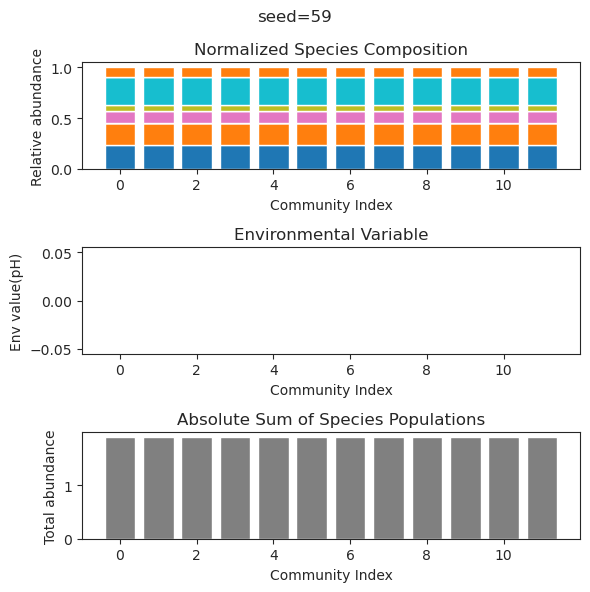

{'species': array([ 4.96882826e-45,  2.73564407e-66,  7.79042055e-02,  3.29687295e-01,
        1.05966247e-01, -3.50226285e-22,  2.99443262e-10,  4.15141216e-52,
        4.43379195e-01,  4.68132550e-66,  2.38893239e-01,  6.73473835e-01]), 'env': array([0.])}
{'species': array([1.60224312e-46, 8.71500292e-60, 7.78918488e-02, 3.29669178e-01,
       1.05982588e-01, 2.82820588e-27, 1.69642350e-05, 1.19972924e-48,
       4.43391860e-01, 8.77530754e-34, 2.38904093e-01, 6.73449381e-01]), 'env': array([0.])}
{'species': array([7.91746240e-55, 1.02292259e-73, 7.79041486e-02, 3.29687212e-01,
       1.05966322e-01, 2.88381945e-23, 7.83677312e-08, 2.00816731e-57,
       4.43379253e-01, 5.63832878e-74, 2.38893289e-01, 6.73473722e-01]), 'env': array([0.])}
{'species': array([ 9.55852236e-57, -4.38165450e-74,  7.34462517e-02,  3.23043657e-01,
        1.12486982e-01, -7.48263820e-24,  5.97224707e-03,  1.47569863e-61,
        4.47804739e-01, -3.06350415e-76,  2.43075461e-01,  6.64234585e-01]), 'env': a

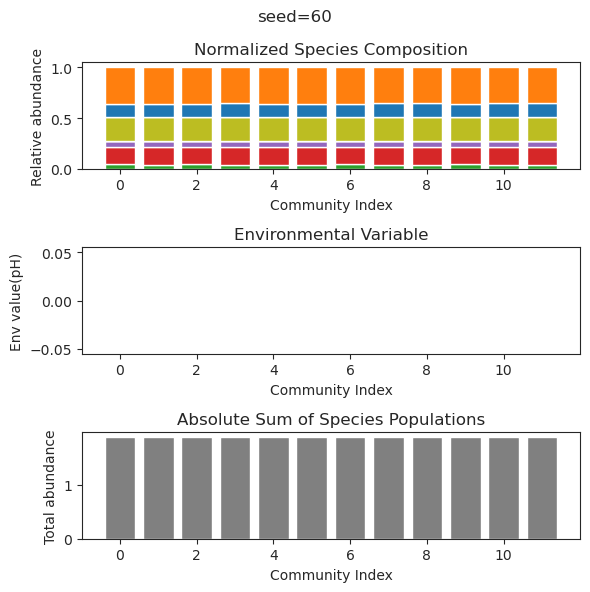

{'species': array([ 4.52790434e-02, -3.70680570e-39,  1.45914541e-01,  2.17181548e-01,
        5.62161388e-01,  1.75335242e-01, -9.28790433e-23, -4.68265182e-25,
        5.75577598e-01, -6.56872169e-15, -2.03957879e-47, -2.89016508e-36]), 'env': array([0.])}
{'species': array([ 4.52790434e-02, -7.94132277e-43,  1.45914541e-01,  2.17181548e-01,
        5.62161388e-01,  1.75335242e-01, -2.29934495e-27, -1.43747578e-26,
        5.75577598e-01,  3.42435686e-15, -7.78534812e-50, -1.67025134e-36]), 'env': array([0.])}
{'species': array([ 4.52790434e-02, -4.52139178e-39,  1.45914541e-01,  2.17181548e-01,
        5.62161388e-01,  1.75335242e-01, -8.22687578e-20, -1.80947679e-25,
        5.75577598e-01, -1.42045131e-14,  7.30268371e-54, -4.98819785e-42]), 'env': array([0.])}
{'species': array([ 4.52790434e-02, -5.61113616e-41,  1.45914541e-01,  2.17181548e-01,
        5.62161388e-01,  1.75335242e-01, -4.65014428e-23, -6.17106417e-25,
        5.75577598e-01,  8.79685251e-15, -3.05109509e-55, -1.

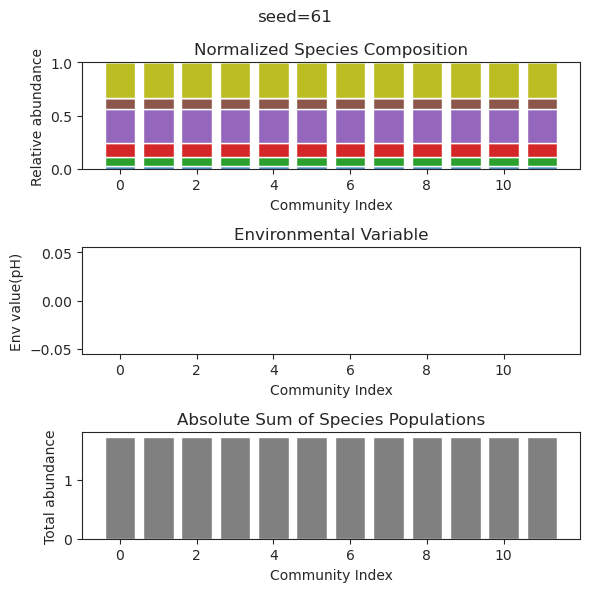

{'species': array([ 3.00755630e-001, -2.65597375e-250,  1.11223606e-001,
        4.25341840e-001, -1.18756109e-240,  6.21038716e-001,
       -2.05141916e-316,  6.11071215e-257, -1.29139217e-238,
        8.40714167e-002,  2.53123428e-001,  3.26925625e-001]), 'env': array([0.])}
{'species': array([ 3.00755630e-001, -1.46375244e-172,  1.11223607e-001,
        4.25341840e-001, -4.04613941e-158,  6.21038716e-001,
       -3.59224318e-178, -5.64616236e-160, -1.68202406e-154,
        8.40714162e-002,  2.53123428e-001,  3.26925625e-001]), 'env': array([0.])}
{'species': array([ 3.00755632e-001, -6.98871477e-214,  1.11223604e-001,
        4.25341841e-001, -1.72591622e-173,  6.21038715e-001,
        2.29984663e-232,  1.96108677e-179, -1.89586522e-169,
        8.40714172e-002,  2.53123427e-001,  3.26925625e-001]), 'env': array([0.])}
{'species': array([ 3.00755630e-001, -2.02813743e-160,  1.11223606e-001,
        4.25341840e-001,  3.07580947e-146,  6.21038716e-001,
        2.34800595e-173,  8.5824

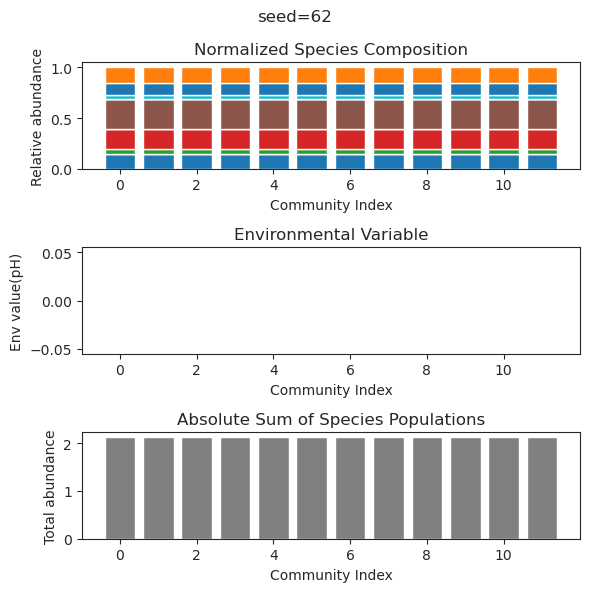

{'species': array([ 2.53011443e-001,  2.49498801e-102, -1.69573705e-069,
        3.96282309e-001, -5.25148597e-129, -1.82874009e-129,
        2.56978814e-002,  6.90892096e-002, -7.93645475e-077,
        5.91941419e-001, -8.12720500e-091,  7.98720126e-001]), 'env': array([0.])}
{'species': array([ 2.53011443e-01, -1.19622116e-36, -1.65274788e-46,  3.96282309e-01,
       -4.16253601e-46, -5.54238112e-61,  2.56978814e-02,  6.90892096e-02,
       -6.08932023e-45,  5.91941419e-01,  4.99762263e-51,  7.98720126e-01]), 'env': array([0.])}
{'species': array([ 2.53011443e-01,  9.71736579e-82, -1.14789622e-41,  3.96282309e-01,
        3.35341900e-94, -6.65151124e-93,  2.56978814e-02,  6.90892096e-02,
       -3.64498613e-41,  5.91941419e-01, -3.93105339e-83,  7.98720126e-01]), 'env': array([0.])}
{'species': array([ 2.53011443e-01,  6.45505649e-46,  9.89702197e-41,  3.96282309e-01,
        8.55600815e-35, -8.93640123e-52,  2.56978814e-02,  6.90892096e-02,
        1.01996104e-39,  5.91941419e-01, -

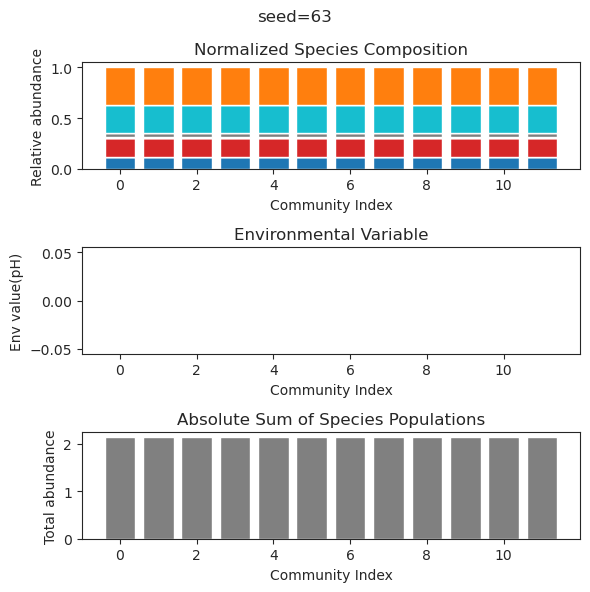

{'species': array([2.04998532e-003, 8.30328771e-001, 1.54812739e-001, 4.28130654e-001,
       1.16697259e-263, 2.57315167e-004, 7.99205466e-002, 1.33229727e-001,
       3.39806362e-004, 5.93024055e-001, 2.14946934e-045, 1.78208007e-096]), 'env': array([0.])}
{'species': array([1.32183894e-002, 3.98536286e-002, 1.28322986e-005, 2.21554305e-001,
       1.19842098e-268, 5.99613444e-001, 5.41323211e-001, 2.92389341e-006,
       6.26298976e-001, 1.02435986e-005, 4.33455992e-051, 1.15533613e-101]), 'env': array([0.])}
{'species': array([1.31166404e-003, 8.40154557e-001, 1.20469855e-001, 4.78064186e-001,
       1.35453177e-264, 1.89131306e-004, 4.43450817e-002, 1.07622630e-001,
       9.97070124e-004, 6.14227769e-001, 5.97953692e-047, 2.27987710e-098]), 'env': array([0.])}
{'species': array([1.67935625e-001, 4.85166000e-002, 1.70232963e-004, 1.91942420e-001,
       4.39330006e-270, 5.77570901e-001, 5.68142038e-001, 9.99063709e-006,
       5.00693894e-001, 2.04188077e-007, 1.19731771e-053, 8.2

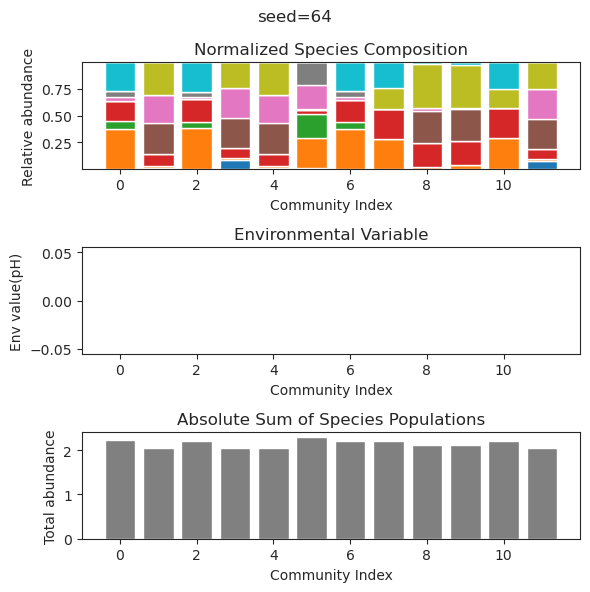

{'species': array([ 4.02230197e-01,  3.41466125e-01,  4.41675731e-01, -1.74142382e-14,
        1.54609364e-01,  3.53450980e-37,  3.07070441e-01,  1.15467576e-01,
       -5.59440517e-66,  2.56109806e-01,  1.38860915e-01,  3.39454014e-02]), 'env': array([0.])}
{'species': array([ 4.02230197e-01,  3.41466125e-01,  4.41675731e-01, -8.70141047e-15,
        1.54609364e-01, -7.42737939e-84,  3.07070441e-01,  1.15467576e-01,
        2.37822959e-69,  2.56109806e-01,  1.38860915e-01,  3.39454014e-02]), 'env': array([0.])}
{'species': array([ 4.02230197e-01,  3.41466125e-01,  4.41675731e-01,  4.49908709e-16,
        1.54609364e-01,  9.13009761e-63,  3.07070441e-01,  1.15467576e-01,
       -3.50568886e-38,  2.56109806e-01,  1.38860915e-01,  3.39454014e-02]), 'env': array([0.])}
{'species': array([ 4.02230197e-001,  3.41466125e-001,  4.41675731e-001,
       -3.05773968e-014,  1.54609364e-001, -3.80123147e-103,
        3.07070441e-001,  1.15467576e-001, -3.86405556e-091,
        2.56109806e-001,  1.

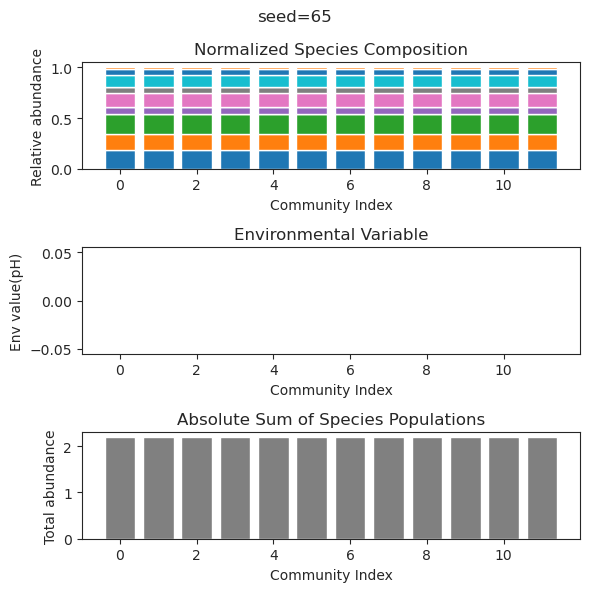

{'species': array([ 6.03416392e-02,  2.41831062e-69,  8.79522993e-01,  6.06162007e-01,
        2.32502620e-01, -2.15634361e-36, -5.57343204e-44, -2.29009541e-33,
        4.97415587e-02,  1.79717424e-51, -3.34698302e-42,  1.66688780e-01]), 'env': array([0.])}
{'species': array([ 6.03416392e-02, -4.04076882e-89,  8.79522993e-01,  6.06162007e-01,
        2.32502620e-01, -3.92072267e-45, -1.75644425e-57,  9.41881769e-39,
        4.97415587e-02, -1.45016384e-68, -3.48983836e-53,  1.66688780e-01]), 'env': array([0.])}
{'species': array([ 6.03416392e-02, -5.47747845e-81,  8.79522993e-01,  6.06162007e-01,
        2.32502620e-01,  1.01111531e-40, -7.67835878e-53,  5.48992009e-36,
        4.97415587e-02,  1.33210329e-62,  3.14632585e-48,  1.66688780e-01]), 'env': array([0.])}
{'species': array([ 6.03416392e-02,  4.46567504e-82,  8.79522993e-01,  6.06162007e-01,
        2.32502620e-01,  5.55836829e-38, -6.77222873e-49,  3.74956643e-33,
        4.97415587e-02, -2.84868911e-61, -1.01700183e-45,  1.

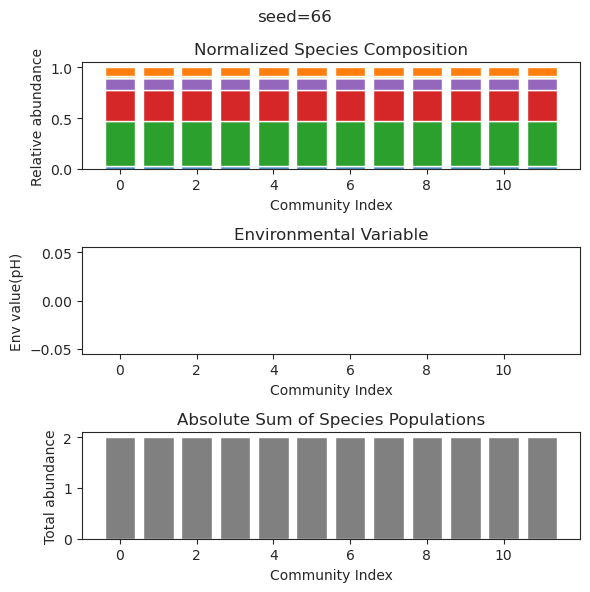

{'species': array([ 1.30188922e-01,  6.89627452e-02,  2.53854788e-01, -5.02220944e-42,
        4.75245844e-02,  5.69715695e-02,  5.11563349e-01,  4.26239077e-01,
       -1.18534654e-75,  3.92510925e-01,  9.11841369e-18,  1.46466871e-01]), 'env': array([0.])}
{'species': array([ 1.30189642e-01,  6.91940087e-02,  2.54075169e-01,  1.17497826e-29,
        4.75372024e-02,  5.72017588e-02,  5.11393805e-01,  4.26006749e-01,
       -7.94061676e-72,  3.92616972e-01,  4.17770486e-12,  1.46142676e-01]), 'env': array([0.])}
{'species': array([1.30186086e-01, 6.89640158e-02, 2.53853005e-01, 6.86009449e-45,
       4.75243025e-02, 5.69741812e-02, 5.11553440e-01, 4.26232935e-01,
       5.70981161e-39, 3.92511921e-01, 1.26310797e-05, 1.46466776e-01]), 'env': array([0.])}
{'species': array([ 1.30249190e-01,  7.03214186e-02,  2.55160822e-01,  4.41966983e-48,
        4.76633861e-02,  5.82730251e-02,  5.10614372e-01,  4.24862188e-01,
       -1.30042272e-94,  3.93083378e-01,  9.50851570e-52,  1.44496924e-01

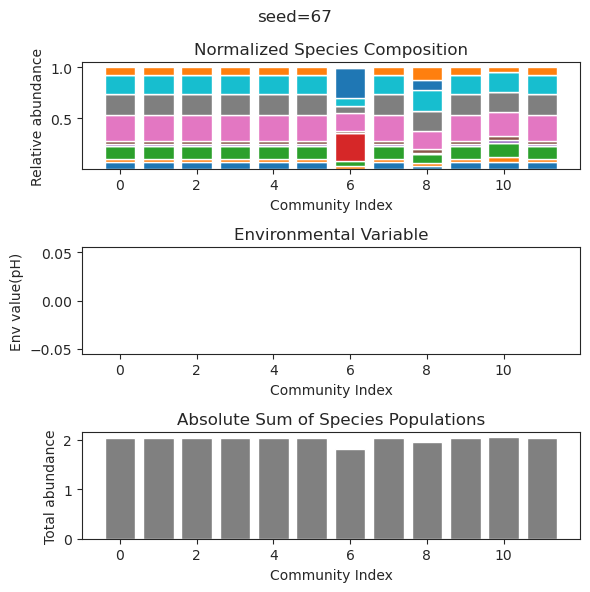

{'species': array([-2.26592519e-19,  4.17934838e-01,  3.53448318e-01,  2.72004853e-02,
       -1.38202067e-19,  6.99994460e-23,  2.84714753e-01,  1.48811502e-01,
       -2.87356888e-51,  2.61959202e-01,  1.87065534e-01,  2.05458504e-01]), 'env': array([0.])}
{'species': array([ 1.79242347e-18,  4.17934838e-01,  3.53448318e-01,  2.72004853e-02,
        3.10021005e-19,  4.84246538e-22,  2.84714753e-01,  1.48811502e-01,
       -1.13238602e-45,  2.61959202e-01,  1.87065534e-01,  2.05458504e-01]), 'env': array([0.])}
{'species': array([-2.83919911e-18,  4.17934838e-01,  3.53448318e-01,  2.72004853e-02,
       -1.03863115e-18,  2.83742012e-21,  2.84714753e-01,  1.48811502e-01,
        1.84773506e-47,  2.61959202e-01,  1.87065534e-01,  2.05458504e-01]), 'env': array([0.])}
{'species': array([-2.02920940e-21,  4.17934838e-01,  3.53448318e-01,  2.72004853e-02,
       -4.20377967e-23, -7.08301573e-29,  2.84714753e-01,  1.48811502e-01,
       -4.21863026e-62,  2.61959202e-01,  1.87065534e-01,  2.

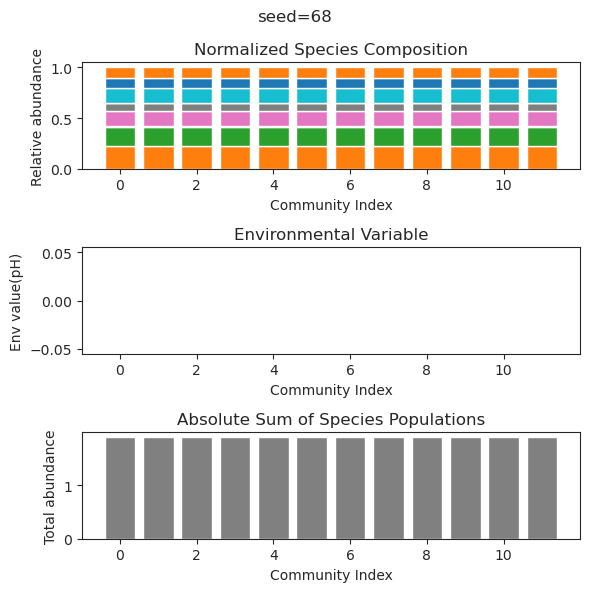

{'species': array([ 1.29625695e-36,  1.04391292e-01, -5.15167057e-37,  5.88647495e-01,
        1.50232504e-02, -4.55046873e-48,  2.07494746e-01,  5.09957954e-01,
        4.65792073e-45, -9.99532850e-48,  3.12668878e-01,  4.56339899e-01]), 'env': array([0.])}
{'species': array([1.21926261e-49, 1.04391292e-01, 1.98390827e-39, 5.88647495e-01,
       1.50232504e-02, 4.23980408e-37, 2.07494746e-01, 5.09957954e-01,
       8.24377829e-64, 6.53359290e-73, 3.12668878e-01, 4.56339899e-01]), 'env': array([0.])}
{'species': array([-9.88775692e-49,  1.04391292e-01,  1.13072697e-38,  5.88647495e-01,
        1.50232504e-02,  3.32447189e-35,  2.07494746e-01,  5.09957954e-01,
       -7.24745021e-66, -2.30724470e-69,  3.12668878e-01,  4.56339899e-01]), 'env': array([0.])}
{'species': array([1.23753193e-41, 1.04391292e-01, 3.59153690e-38, 5.88647495e-01,
       1.50232504e-02, 4.26978122e-34, 2.07494746e-01, 5.09957954e-01,
       6.19000871e-41, 7.35736845e-50, 3.12668878e-01, 4.56339899e-01]), 'env': a

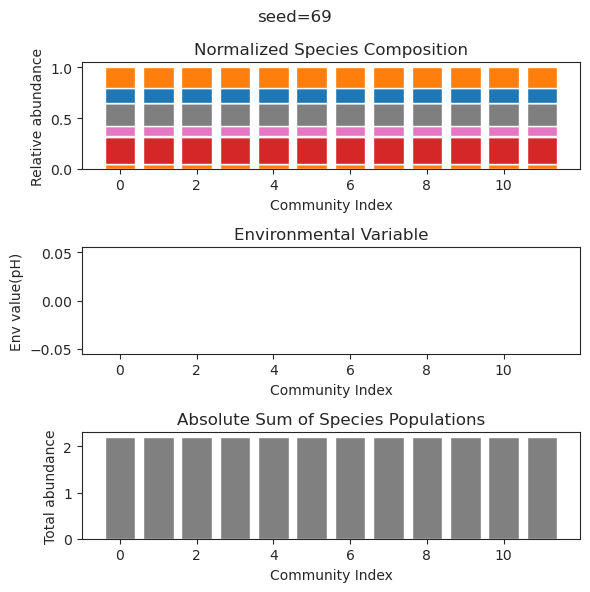

{'species': array([ 3.31876850e-07, -7.83564589e-38,  4.12378347e-02,  6.99073266e-01,
        1.47625156e-01, -1.31120271e-29, -3.70534935e-26, -5.12057067e-37,
        6.27363624e-02,  2.90607575e-01,  2.68776498e-28,  5.26681554e-01]), 'env': array([0.])}
{'species': array([ 3.69221387e-08, -2.34225783e-70,  4.12374472e-02,  6.99073752e-01,
        1.47624956e-01, -1.77071863e-83, -1.53692539e-26,  1.86637550e-43,
        6.27361174e-02,  2.90607953e-01, -2.77616681e-25,  5.26681619e-01]), 'env': array([0.])}
{'species': array([ 1.43537758e-007,  3.40984254e-027,  4.12375873e-002,
        6.99073576e-001,  1.47625028e-001, -5.66944746e-116,
        1.89833077e-025, -5.56676260e-053,  6.27362060e-002,
        2.90607816e-001,  2.55963415e-024,  5.26681595e-001]), 'env': array([0.])}
{'species': array([ 2.55010489e-06,  1.41749348e-30,  4.12407497e-02,  6.99069616e-01,
        1.47626655e-01,  8.48972806e-59, -1.08790195e-30, -5.22789457e-45,
        6.27382052e-02,  2.90604735e-01, -

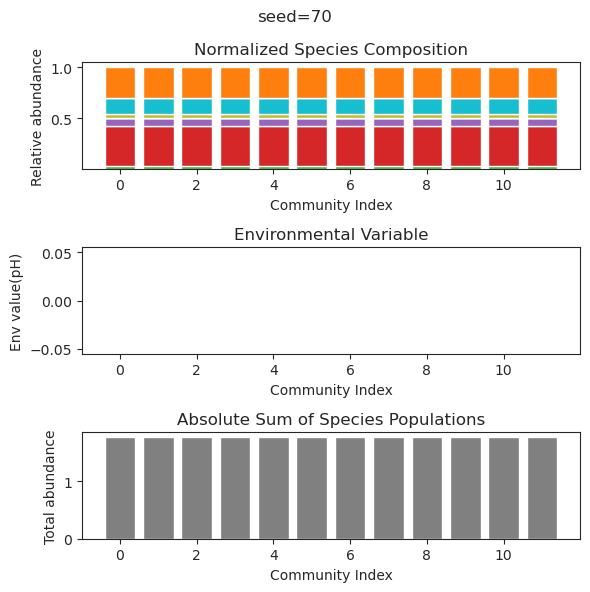

{'species': array([7.70348183e-002, 2.65482689e-001, 4.44306309e-036, 1.74282999e-001,
       4.45155492e-001, 8.52467528e-002, 8.19068444e-002, 2.18887648e-124,
       9.99543039e-002, 1.34535402e-001, 4.19829565e-001, 1.79358600e-019]), 'env': array([0.])}
{'species': array([ 7.70348183e-02,  2.65482689e-01, -4.90261419e-40,  1.74282999e-01,
        4.45155492e-01,  8.52467528e-02,  8.19068444e-02, -1.06653218e-98,
        9.99543039e-02,  1.34535402e-01,  4.19829565e-01, -8.32897113e-28]), 'env': array([0.])}
{'species': array([ 7.70348183e-002,  2.65482689e-001, -4.27636862e-032,
        1.74282999e-001,  4.45155492e-001,  8.52467527e-002,
        8.19068444e-002,  1.36827592e-123,  9.99543039e-002,
        1.34535402e-001,  4.19829565e-001,  5.28917077e-028]), 'env': array([0.])}
{'species': array([ 7.70348183e-002,  2.65482689e-001, -1.29836765e-032,
        1.74282999e-001,  4.45155492e-001,  8.52467528e-002,
        8.19068444e-002,  7.93847947e-117,  9.99543039e-002,
        1

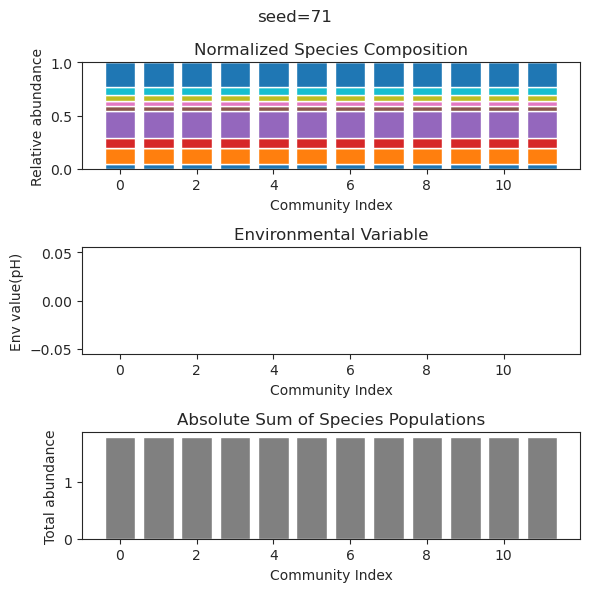

{'species': array([ 5.80114149e-028, -6.58388936e-039,  5.65282174e-001,
        5.52576071e-001,  2.37087614e-001,  5.27489847e-006,
        3.11681727e-001,  2.41268832e-001,  3.14711231e-009,
        5.09800954e-054, -6.67793996e-217,  1.31937616e-009]), 'env': array([0.])}
{'species': array([ 2.97923485e-001, -1.47211997e-097,  2.17209767e-001,
        3.30177587e-001,  5.53396205e-002,  5.66602603e-001,
        3.31694135e-024,  6.23479751e-001, -1.51444380e-097,
       -3.01425599e-053,  6.61552656e-230, -5.27413050e-057]), 'env': array([0.])}
{'species': array([ 2.97923485e-001, -1.47211997e-097,  2.17209767e-001,
        3.30177587e-001,  5.53396205e-002,  5.66602603e-001,
        3.31694135e-024,  6.23479751e-001, -1.51444380e-097,
       -3.01425599e-053,  6.61552656e-230, -5.27413050e-057]), 'env': array([0.])}
{'species': array([ 2.97923485e-001, -1.90536851e-070,  2.17209767e-001,
        3.30177587e-001,  5.53396205e-002,  5.66602603e-001,
       -1.91824103e-024,  6.2347

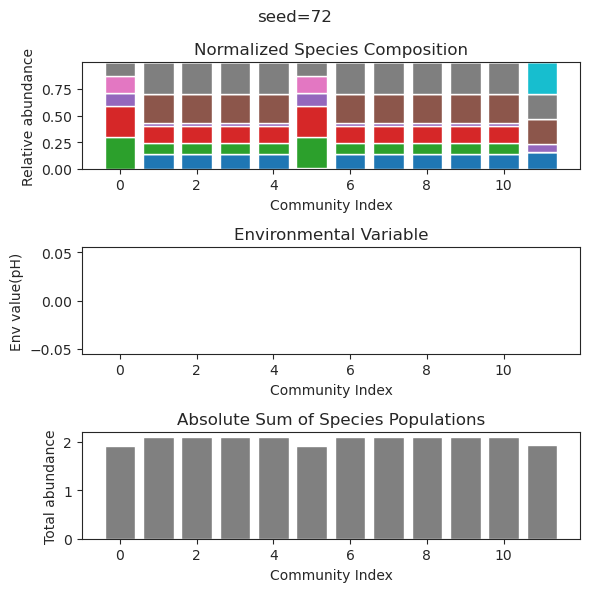

{'species': array([ 4.29381102e-002,  2.39457504e-001,  1.29123986e-092,
        7.33070422e-001,  1.85482489e-001,  2.71578549e-001,
        5.80615957e-003, -2.65130592e-158, -5.20248595e-046,
        4.27399894e-001,  2.39704362e-001, -2.65071481e-145]), 'env': array([0.])}
{'species': array([ 4.29381116e-002,  2.39457505e-001, -3.17790641e-043,
        7.33070422e-001,  1.85482487e-001,  2.71578548e-001,
        5.80615971e-003, -9.78192319e-109,  3.00240603e-041,
        4.27399893e-001,  2.39704363e-001,  2.34952644e-101]), 'env': array([0.])}
{'species': array([ 4.29381115e-02,  2.39457505e-01, -1.67733390e-55,  7.33070422e-01,
        1.85482487e-01,  2.71578548e-01,  5.80615970e-03, -8.69489171e-88,
       -1.86021975e-37,  4.27399893e-01,  2.39704363e-01,  1.59006815e-85]), 'env': array([0.])}
{'species': array([ 4.29381115e-002,  2.39457505e-001, -2.62895559e-078,
        7.33070422e-001,  1.85482487e-001,  2.71578548e-001,
        5.80615970e-003, -8.67057626e-156,  3.93483

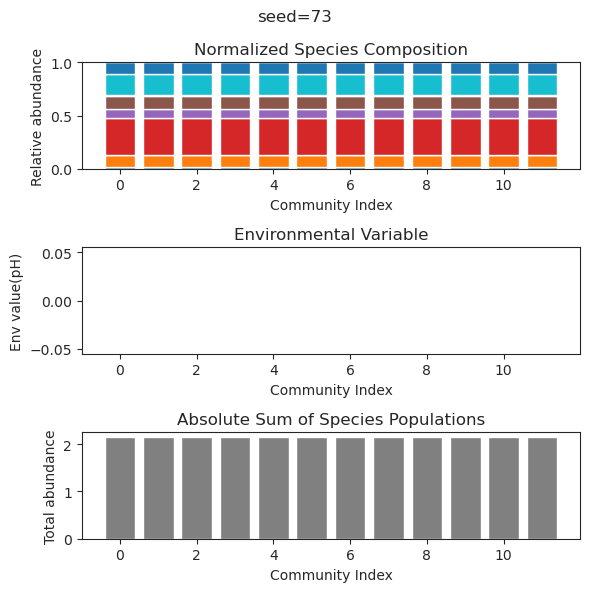

{'species': array([ 4.57564420e-39,  1.07756102e-02,  3.11770088e-01, -2.88255698e-44,
        5.76337058e-01,  3.20643696e-01,  2.14366061e-01,  8.43017279e-40,
        1.68573392e-07, -5.62378662e-70, -3.10939693e-96,  4.47500809e-01]), 'env': array([0.])}
{'species': array([-1.55585315e-27,  4.28268504e-02,  2.95021498e-01, -3.46235482e-63,
        5.32675245e-01,  3.40983565e-01,  2.16834659e-01, -1.72799523e-57,
        7.43815194e-03,  3.17502903e-65,  6.48882909e-93,  4.49881759e-01]), 'env': array([0.])}
{'species': array([ 6.59114467e-047,  4.26779956e-002,  2.95153761e-001,
       -9.53467140e-071,  5.33131318e-001,  3.40747986e-001,
        2.16622575e-001,  7.66070106e-062,  7.32757941e-003,
       -2.54138781e-088, -1.11110509e-107,  4.49964062e-001]), 'env': array([0.])}
{'species': array([ 2.68870634e-35,  1.07760712e-02,  3.11769744e-01, -2.84359754e-47,
        5.76335354e-01,  3.20644454e-01,  2.14366860e-01,  4.24647652e-43,
        7.74340108e-07, -9.33940012e-38,  

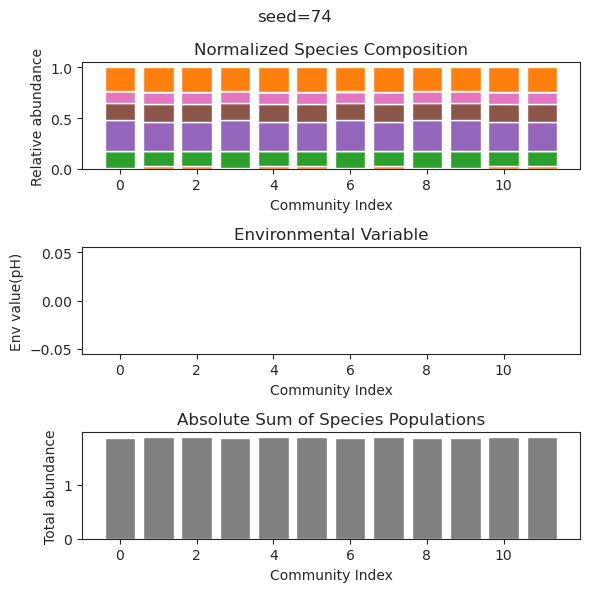

{'species': array([-1.64811430e-42, -2.11189759e-28, -3.20086821e-40,  1.04985005e-01,
        1.02041379e-01, -1.07443185e-40,  2.83368970e-02,  5.77985921e-01,
        5.00529134e-01,  3.10332449e-01,  2.91975173e-01, -1.60864703e-41]), 'env': array([0.])}
{'species': array([ 8.95413531e-59, -1.55615512e-28, -1.44300916e-54,  1.04985005e-01,
        1.02041379e-01,  6.76100758e-55,  2.83368970e-02,  5.77985921e-01,
        5.00529134e-01,  3.10332449e-01,  2.91975173e-01,  1.03847966e-52]), 'env': array([0.])}
{'species': array([ 2.33339724e-53, -1.61962664e-27, -7.84832466e-50,  1.04985005e-01,
        1.02041379e-01,  4.27476682e-53,  2.83368970e-02,  5.77985921e-01,
        5.00529134e-01,  3.10332449e-01,  2.91975173e-01,  1.68099364e-52]), 'env': array([0.])}
{'species': array([ 6.42484081e-52, -1.96913711e-25,  1.67126259e-46,  1.04985005e-01,
        1.02041379e-01,  4.53402442e-50,  2.83368970e-02,  5.77985921e-01,
        5.00529134e-01,  3.10332449e-01,  2.91975173e-01,  2.

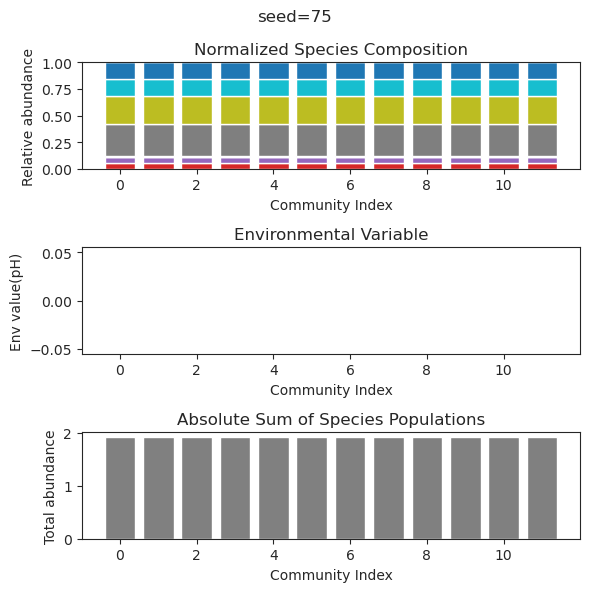

{'species': array([ 4.98390494e-18, -1.75840631e-55,  2.24672842e-01, -3.07144154e-33,
       -1.71643406e-30,  2.40060400e-44,  2.70106385e-01,  6.07440288e-01,
        6.37148602e-01,  2.53092122e-01,  5.64336758e-48,  1.04827643e-01]), 'env': array([0.])}
{'species': array([-1.73085930e-19, -9.64322397e-42,  2.24672842e-01, -2.18336508e-31,
        1.45717735e-27,  5.71606080e-35,  2.70106385e-01,  6.07440288e-01,
        6.37148602e-01,  2.53092122e-01,  7.95703680e-39,  1.04827643e-01]), 'env': array([0.])}
{'species': array([ 1.08878942e-17,  1.86378159e-47,  2.24672842e-01, -1.35024637e-29,
       -4.17636613e-27,  9.77262020e-36,  2.70106385e-01,  6.07440288e-01,
        6.37148602e-01,  2.53092122e-01, -1.03718733e-38,  1.04827643e-01]), 'env': array([0.])}
{'species': array([ 2.32557507e-17, -3.24514896e-44,  2.24672842e-01, -7.50350240e-26,
        8.30238665e-25, -6.64404234e-33,  2.70106385e-01,  6.07440288e-01,
        6.37148602e-01,  2.53092122e-01, -5.10553685e-38,  1.

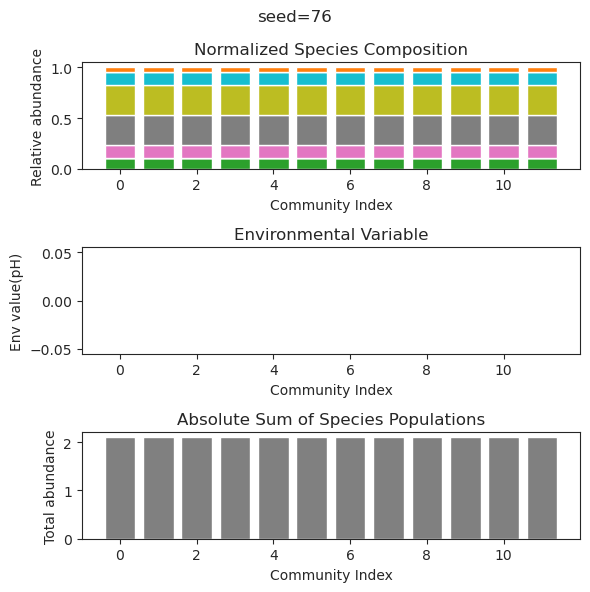

{'species': array([-4.24351794e-32,  2.83886805e-01,  2.02303315e-01,  3.57342130e-01,
        1.06938603e-01,  1.48466906e-01, -3.30592401e-59,  4.15841449e-01,
       -2.28249499e-66,  1.16863090e-18,  5.00405736e-01,  2.81152130e-01]), 'env': array([0.])}
{'species': array([ 1.47262618e-30,  2.83886805e-01,  2.02303315e-01,  3.57342130e-01,
        1.06938603e-01,  1.48466906e-01, -2.16765546e-65,  4.15841449e-01,
       -2.42721011e-69, -3.83281990e-18,  5.00405736e-01,  2.81152130e-01]), 'env': array([0.])}
{'species': array([ 2.11582324e-36,  2.83886805e-01,  2.02303315e-01,  3.57342130e-01,
        1.06938603e-01,  1.48466906e-01,  5.68220818e-64,  4.15841449e-01,
        8.68019848e-76, -3.45467321e-18,  5.00405736e-01,  2.81152130e-01]), 'env': array([0.])}
{'species': array([-4.81172159e-27,  2.83886805e-01,  2.02303315e-01,  3.57342130e-01,
        1.06938603e-01,  1.48466906e-01,  9.95631582e-45,  4.15841449e-01,
       -8.61108914e-54, -6.95258714e-19,  5.00405736e-01,  2.

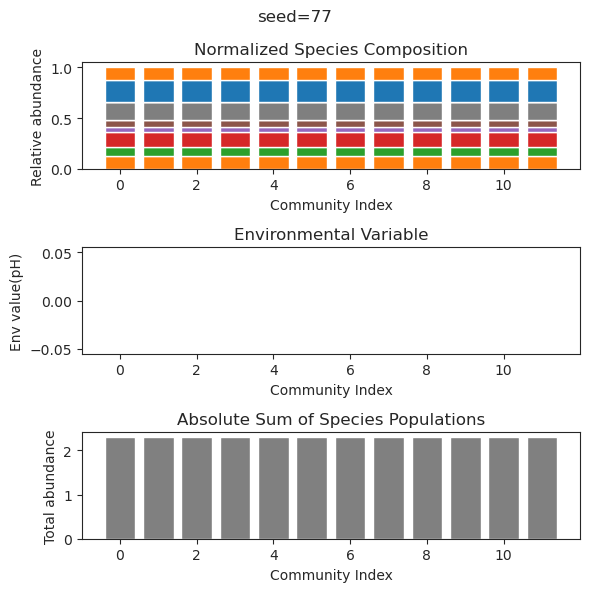

{'species': array([ 1.84718187e-34,  1.37217877e-22,  5.15554781e-01,  2.84756973e-01,
        6.18145455e-67,  2.02836203e-01,  8.54304590e-30,  4.75855335e-01,
        3.62053275e-65,  1.47097829e-40,  4.89078868e-01, -5.09736921e-17]), 'env': array([0.])}
{'species': array([1.22732360e-27, 1.07697033e-18, 5.15554781e-01, 2.84756973e-01,
       2.49867578e-45, 2.02836203e-01, 2.82755064e-27, 4.75855335e-01,
       3.65033638e-42, 9.98505835e-33, 4.89078868e-01, 1.11454760e-16]), 'env': array([0.])}
{'species': array([ 3.21466706e-35, -1.06025099e-25,  5.15554781e-01,  2.84756973e-01,
       -4.63514728e-47,  2.02836203e-01,  6.57783098e-30,  4.75855335e-01,
       -3.08195640e-47, -1.55201009e-34,  4.89078868e-01, -1.50922454e-18]), 'env': array([0.])}
{'species': array([ 3.14426202e-34,  1.87661125e-25,  5.15554781e-01,  2.84756973e-01,
        1.50804020e-52,  2.02836203e-01,  3.68999474e-28,  4.75855335e-01,
        8.94278064e-52, -4.78707701e-34,  4.89078868e-01,  3.20557787e-17

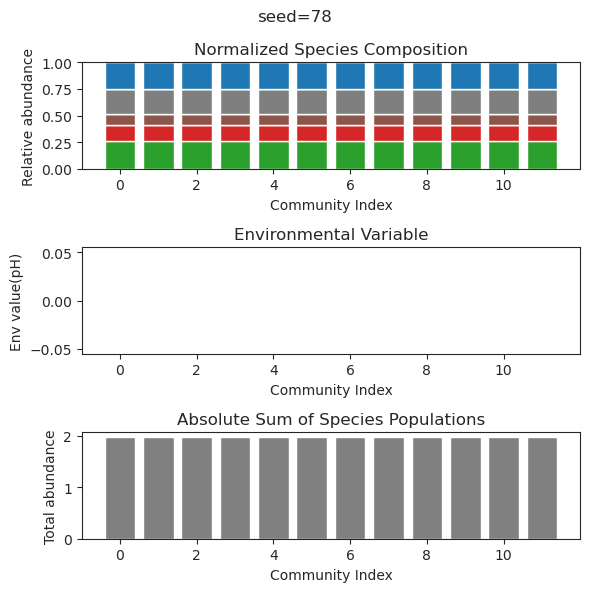

{'species': array([ 6.18593337e-01,  2.80100086e-01,  1.05055392e-97,  4.01816271e-16,
        6.00186677e-21,  2.06478774e-36, -2.45153139e-98,  2.93568486e-01,
        7.44415518e-01, -6.71913707e-25,  8.82101051e-72,  5.25706809e-37]), 'env': array([0.])}
{'species': array([ 8.01338209e-46,  7.46147484e-01, -2.55338595e-52,  2.27195056e-01,
        3.88011973e-47,  3.77848744e-01,  1.72618401e-01, -9.10411640e-52,
       -1.08241930e-25,  7.04672508e-54,  4.46532138e-49,  8.19774792e-01]), 'env': array([0.])}
{'species': array([ 1.93102433e-47,  7.46147484e-01,  2.80424016e-56,  2.27195056e-01,
        7.61381511e-51,  3.77848744e-01,  1.72618401e-01,  1.74982611e-55,
       -8.69132092e-27,  2.69652248e-62, -5.09620109e-48,  8.19774792e-01]), 'env': array([0.])}
{'species': array([-3.03415439e-30,  7.46147484e-01, -1.66010011e-31,  2.27195056e-01,
       -1.90418152e-29,  3.77848744e-01,  1.72618401e-01, -1.67958832e-31,
       -3.05446606e-21,  2.64656462e-39,  2.64280981e-35,  8.

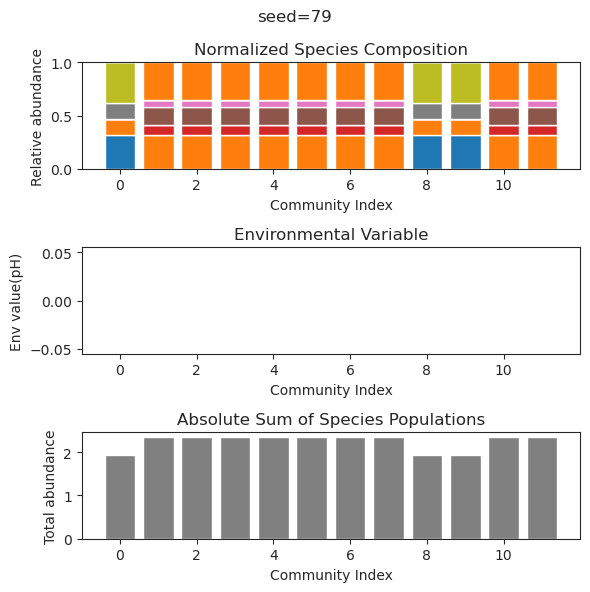

{'species': array([ 8.42551920e-24,  3.15725770e-01,  5.61005724e-02,  2.30246397e-26,
       -1.09010312e-54,  4.68136443e-19,  3.66510194e-01,  2.28680472e-01,
        5.14530288e-35,  4.59368942e-01,  6.31760433e-01,  3.54069292e-45]), 'env': array([0.])}
{'species': array([-1.01835443e-22,  3.15725770e-01,  5.61005724e-02, -1.31247381e-26,
       -2.32884846e-82,  8.75201878e-17,  3.66510194e-01,  2.28680472e-01,
       -2.02271378e-44,  4.59368942e-01,  6.31760433e-01, -3.31211407e-65]), 'env': array([0.])}
{'species': array([-8.55596236e-25,  3.15725770e-01,  5.61005724e-02, -5.96371176e-31,
       -1.09596383e-75,  2.68491248e-17,  3.66510194e-01,  2.28680472e-01,
        1.42204311e-46,  4.59368942e-01,  6.31760433e-01,  2.56689304e-67]), 'env': array([0.])}
{'species': array([ 1.63123898e-26,  3.15725770e-01,  5.61005724e-02, -1.66319744e-25,
       -1.89327559e-53,  1.28210851e-16,  3.66510194e-01,  2.28680472e-01,
       -2.47497501e-36,  4.59368942e-01,  6.31760433e-01,  5.

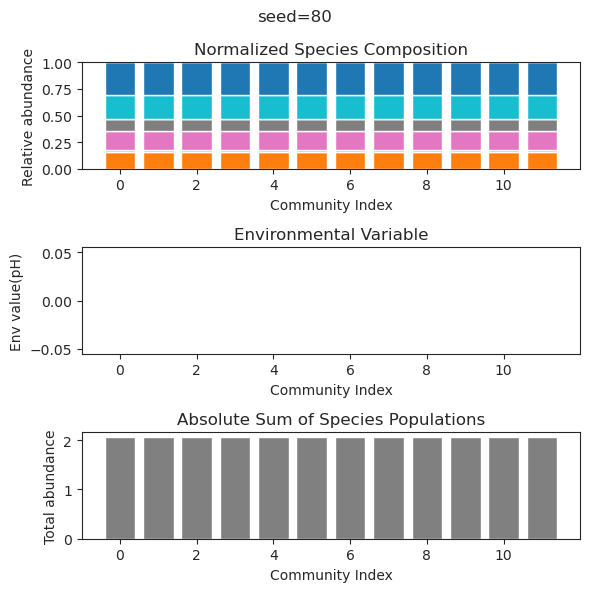

{'species': array([ 2.50389043e-01, -7.85279410e-50, -4.61179043e-21,  2.01827535e-01,
        9.55578501e-02,  5.02226408e-01, -8.46120920e-66,  4.58721125e-01,
        2.39287932e-34, -1.87926192e-18,  2.35022745e-01,  2.88980092e-01]), 'env': array([0.])}
{'species': array([ 3.31622891e-101, -2.57738141e-038,  4.17077644e-001,
        2.13817192e-001,  9.12143277e-039,  1.17504362e-001,
        4.26593784e-108,  3.05496780e-001,  6.01862318e-002,
        5.34345386e-001,  5.67387749e-001, -4.13921757e-054]), 'env': array([0.])}
{'species': array([-7.84191310e-57,  6.60180216e-27,  4.17077644e-01,  2.13817192e-01,
        7.78373672e-28,  1.17504362e-01, -8.22546919e-61,  3.05496780e-01,
        6.01862318e-02,  5.34345386e-01,  5.67387749e-01,  4.21132853e-31]), 'env': array([0.])}
{'species': array([-3.13607661e-113,  9.07173398e-039,  4.17077644e-001,
        2.13817192e-001,  7.91256213e-038,  1.17504362e-001,
        2.12327871e-114,  3.05496780e-001,  6.01862318e-002,
        5

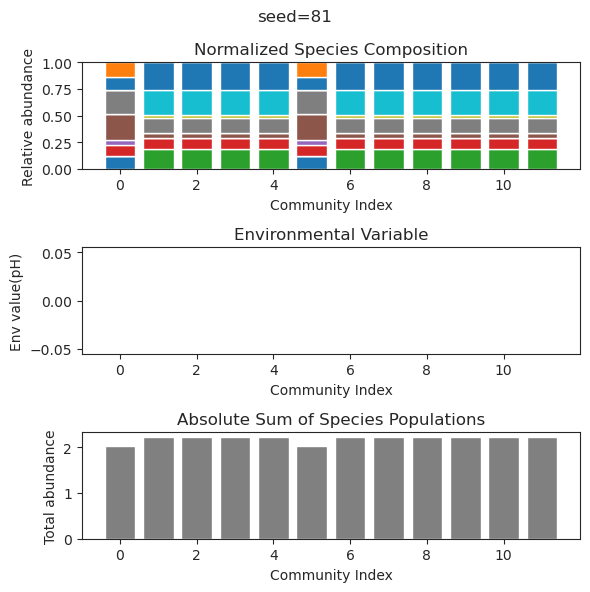

{'species': array([ 3.21984556e-60,  2.41556166e-01,  7.23660275e-01, -1.12807733e-71,
        2.16986120e-01,  3.85232045e-01, -1.25463194e-42,  2.45546299e-68,
        8.60903116e-57,  2.20546376e-01,  4.35224189e-01, -4.85049874e-31]), 'env': array([0.])}
{'species': array([ 2.56899730e-66,  2.41556166e-01,  7.23660275e-01,  2.12191016e-79,
        2.16986120e-01,  3.85232045e-01,  2.23294415e-45, -6.35053717e-72,
        3.12027475e-62,  2.20546376e-01,  4.35224189e-01, -1.83817230e-34]), 'env': array([0.])}
{'species': array([5.11986697e-58, 2.41556166e-01, 7.23660275e-01, 1.73430232e-67,
       2.16986120e-01, 3.85232045e-01, 8.18801293e-42, 1.38118122e-65,
       5.04216227e-55, 2.20546376e-01, 4.35224189e-01, 9.18924029e-30]), 'env': array([0.])}
{'species': array([ 2.84093574e-57,  2.41556166e-01,  7.23660275e-01, -4.45529344e-65,
        2.16986120e-01,  3.85232045e-01,  3.00913237e-40, -9.01594404e-65,
        1.62168886e-53,  2.20546376e-01,  4.35224189e-01,  4.03418459e-30

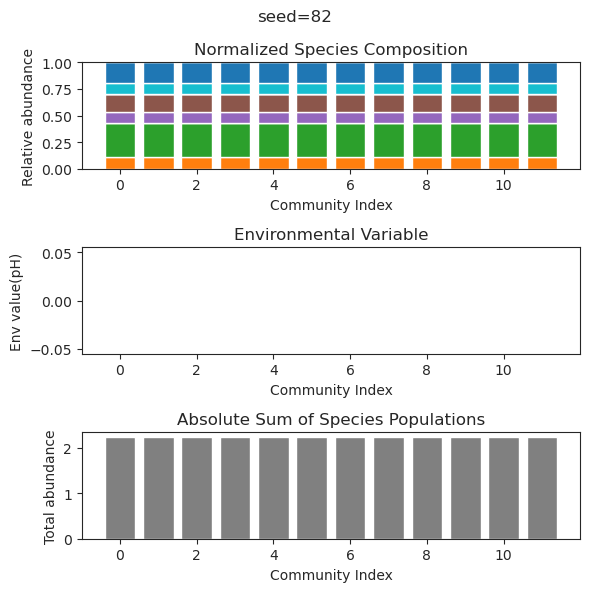

{'species': array([ 2.16476944e-01,  9.02336007e-02,  1.80741493e-01,  1.63961914e-56,
        2.10720648e-01,  2.50393655e-04,  6.34427284e-02,  3.68152253e-01,
        1.09987122e-31,  3.78231245e-01, -3.15395598e-56,  3.81756532e-01]), 'env': array([0.])}
{'species': array([ 2.16535327e-001,  9.03331566e-002,  1.80448197e-001,
        2.04287689e-174,  2.10874956e-001,  9.69365247e-006,
        6.34143676e-002,  3.68190611e-001, -1.96488230e-087,
        3.78230140e-001,  4.64415341e-189,  3.81949086e-001]), 'env': array([0.])}
{'species': array([ 2.15997802e-001,  8.93888771e-002,  1.83333214e-001,
        1.42921877e-027,  2.09310924e-001,  2.30810462e-003,
        6.36948273e-002,  3.67802674e-001, -2.36014033e-027,
        3.78261677e-001, -1.92140234e-115,  3.80094941e-001]), 'env': array([0.])}
{'species': array([ 2.16220556e-001,  8.97882106e-002,  1.82083322e-001,
       -3.38793624e-181,  2.10001336e-001,  1.33141776e-003,
        6.35729110e-002,  3.67973652e-001, -3.27585

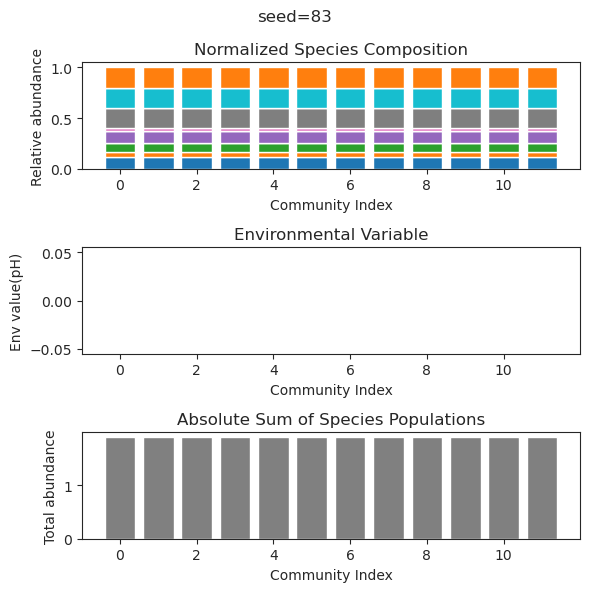

{'species': array([ 4.57887137e-01,  1.92804456e-29,  4.27585921e-10,  2.77766443e-02,
        3.91107226e-12,  4.05448861e-01,  5.11602701e-01,  3.89801052e-02,
       -1.31009855e-66, -1.84924670e-66,  3.81119266e-01,  5.29238569e-01]), 'env': array([0.])}
{'species': array([ 4.57887137e-01,  1.10552400e-26,  1.05331216e-10,  2.77766444e-02,
        3.81516048e-12,  4.05448861e-01,  5.11602701e-01,  3.89801053e-02,
       -1.93019147e-72,  7.76248649e-70,  3.81119266e-01,  5.29238570e-01]), 'env': array([0.])}
{'species': array([ 4.57887137e-001,  2.75042766e-028,  1.25193846e-009,
        2.77766439e-002,  2.83859996e-010,  4.05448861e-001,
        5.11602701e-001,  3.89801048e-002, -8.91813535e-164,
       -2.94293495e-146,  3.81119266e-001,  5.29238568e-001]), 'env': array([0.])}
{'species': array([ 4.57887137e-001,  5.47183758e-062,  9.78543915e-010,
        2.77766441e-002,  4.78455656e-011,  4.05448861e-001,
        5.11602701e-001,  3.89801049e-002,  5.83911404e-144,
       -1

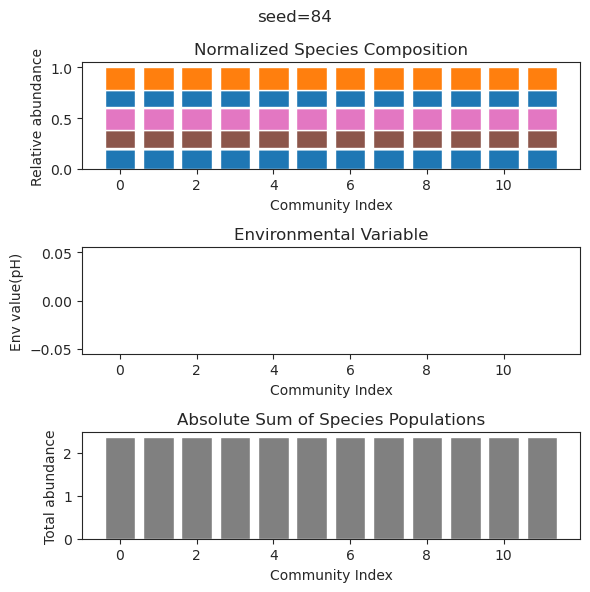

{'species': array([ 1.86281691e-40,  2.88141658e-01,  2.73271871e-01,  2.82047430e-01,
       -1.38810525e-79,  1.01082822e-12,  4.39477778e-01,  1.57583635e-71,
        3.29023210e-01, -3.59855363e-49,  3.47551790e-01,  7.99178401e-02]), 'env': array([0.])}
{'species': array([-1.27474399e-42,  2.88141658e-01,  2.73271871e-01,  2.82047430e-01,
        4.43940977e-75,  5.42673608e-13,  4.39477778e-01, -7.42733704e-66,
        3.29023210e-01,  1.79828511e-44,  3.47551790e-01,  7.99178401e-02]), 'env': array([0.])}
{'species': array([-4.81593443e-42,  2.88141658e-01,  2.73271871e-01,  2.82047430e-01,
       -2.17576769e-30,  1.45503434e-12,  4.39477778e-01, -1.64715070e-39,
        3.29023210e-01, -2.09291852e-42,  3.47551790e-01,  7.99178401e-02]), 'env': array([0.])}
{'species': array([-1.24483890e-48,  2.88141658e-01,  2.73271871e-01,  2.82047430e-01,
        2.29832650e-92,  1.32675671e-12,  4.39477778e-01,  1.03561861e-82,
        3.29023210e-01, -4.36558785e-49,  3.47551790e-01,  7.

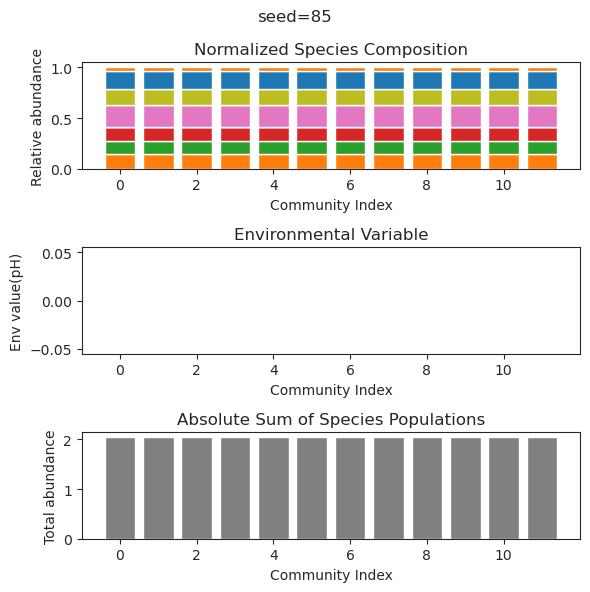

{'species': array([ 5.82029434e-01, -2.16981034e-68,  2.59310112e-01,  1.64304206e-57,
        4.93296699e-40, -4.79102908e-43,  3.25288493e-01,  9.34805205e-47,
        3.45183830e-46, -6.18735316e-37,  7.45848040e-01,  1.82896835e-12]), 'env': array([0.])}
{'species': array([ 5.82029434e-01, -1.98759153e-63,  2.59310112e-01, -3.43028858e-55,
       -2.40483865e-39,  9.89165091e-43,  3.25288493e-01, -8.60122332e-47,
       -4.56087185e-35, -3.71801049e-37,  7.45848040e-01,  6.70054172e-13]), 'env': array([0.])}
{'species': array([ 5.82029434e-01,  1.60519121e-62,  2.59310112e-01, -1.66874474e-60,
        1.78586191e-28,  3.30285650e-56,  3.25288493e-01,  6.58295330e-59,
       -1.96058212e-26, -1.93186220e-50,  7.45848040e-01, -1.25354816e-14]), 'env': array([0.])}
{'species': array([ 5.82029434e-01,  8.77946010e-66,  2.59310112e-01,  2.98068965e-72,
       -7.88894397e-27, -5.39149501e-67,  3.25288493e-01,  4.80082914e-71,
        9.70777126e-25,  1.23190856e-60,  7.45848040e-01,  5.

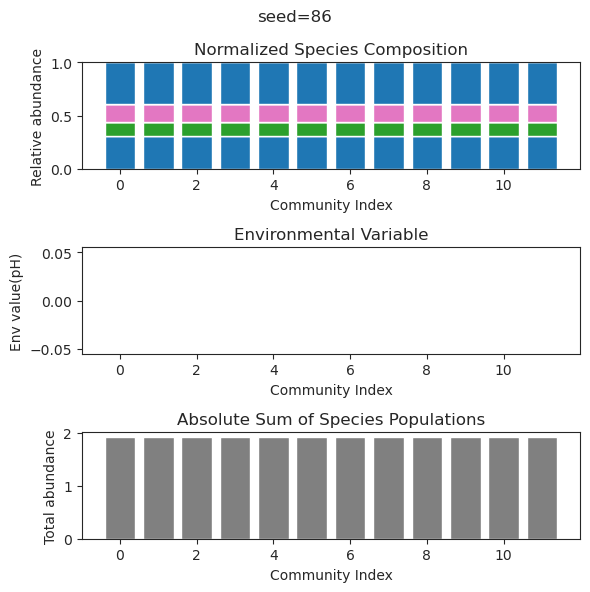

{'species': array([-5.71539275e-30,  3.81019622e-01,  1.53209709e-03,  4.39065447e-01,
        6.21168412e-30,  5.98310109e-01,  2.29309618e-30, -1.41243486e-41,
        2.78780039e-02,  2.91436468e-01,  1.11479779e-01, -5.32284729e-51]), 'env': array([0.])}
{'species': array([ 9.69621684e-32,  3.81018523e-01,  1.53456007e-03,  4.39065342e-01,
       -1.93268584e-31,  5.98309753e-01, -1.61682824e-27,  1.65279030e-42,
        2.78793111e-02,  2.91435916e-01,  1.11478970e-01, -1.37599483e-48]), 'env': array([0.])}
{'species': array([-1.57353442e-29,  3.81015987e-01,  1.54024253e-03,  4.39065098e-01,
       -2.35791093e-32,  5.98308932e-01,  2.35556470e-32, -2.76240835e-34,
        2.78823274e-02,  2.91434643e-01,  1.11477102e-01,  7.82423559e-53]), 'env': array([0.])}
{'species': array([ 1.64167404e-28,  3.81098507e-01,  1.35499548e-03,  4.39073042e-01,
       -8.89134882e-25,  5.98335472e-01, -1.97792148e-27, -5.99027008e-26,
        2.77843401e-02,  2.91476305e-01,  1.11537922e-01, -7.

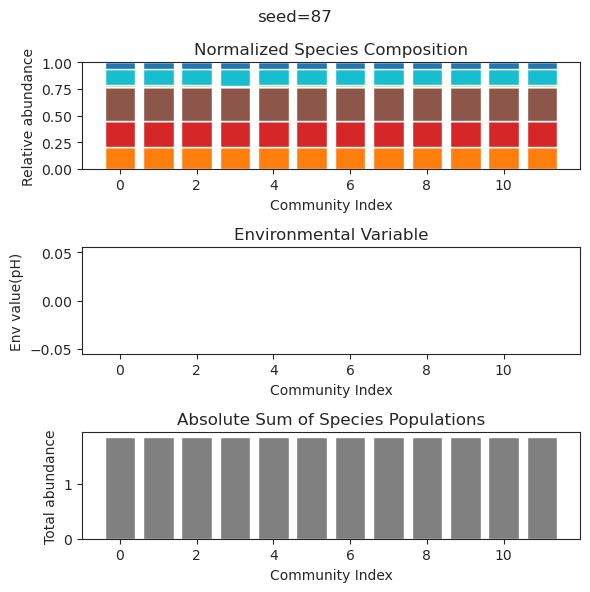

{'species': array([ 1.38008099e-61, -7.06118872e-38, -2.86497801e-37,  3.22934996e-01,
        6.73844436e-01,  5.38361739e-01, -2.89831722e-35,  5.19709779e-18,
        4.65317121e-01,  9.01597526e-48,  2.59876492e-01,  3.49248010e-44]), 'env': array([0.])}
{'species': array([ 2.08916127e-76, -3.43005865e-44, -7.38002803e-44,  3.22934996e-01,
        6.73844436e-01,  5.38361739e-01,  6.88944342e-37, -2.91602431e-15,
        4.65317121e-01,  1.79546576e-61,  2.59876492e-01,  1.38680438e-53]), 'env': array([0.])}
{'species': array([-8.86337377e-61,  5.45744289e-39, -2.17839573e-38,  3.22934996e-01,
        6.73844436e-01,  5.38361739e-01, -3.14470131e-36, -5.09472919e-18,
        4.65317121e-01, -2.91744443e-47,  2.59876492e-01, -3.04773566e-44]), 'env': array([0.])}
{'species': array([ 1.02800208e-58,  1.45853983e-38, -6.52387161e-36,  3.22934996e-01,
        6.73844436e-01,  5.38361739e-01,  2.13617042e-34,  3.10927377e-18,
        4.65317121e-01, -5.01393033e-48,  2.59876492e-01, -6.

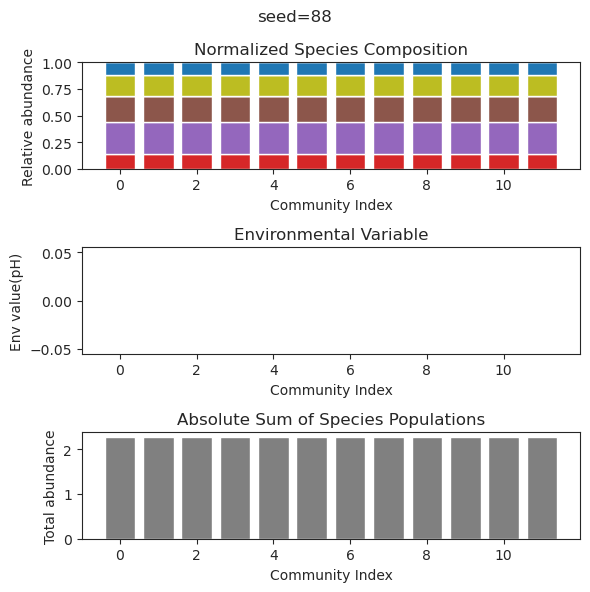

{'species': array([ 5.95448717e-01,  1.32918682e-21, -1.09939209e-41,  1.57229946e-01,
        4.32509115e-01,  5.76974090e-26,  5.51418512e-02,  1.52612725e-58,
        6.72690030e-01,  2.24939100e-24,  2.68436684e-99,  1.98732288e-01]), 'env': array([0.])}
{'species': array([ 5.95448717e-001, -5.65659527e-036,  6.12353449e-042,
        1.57229946e-001,  4.32509115e-001,  4.03955221e-037,
        5.51418512e-002,  1.56728254e-119,  6.72690030e-001,
       -2.81159156e-048, -9.21220212e-134,  1.98732288e-001]), 'env': array([0.])}
{'species': array([ 5.95448717e-001,  1.94981008e-023, -1.84834577e-044,
        1.57229946e-001,  4.32509115e-001, -8.37848819e-030,
        5.51418512e-002, -1.59584757e-062,  6.72690030e-001,
        8.18517386e-031, -8.26528194e-105,  1.98732288e-001]), 'env': array([0.])}
{'species': array([ 5.95448717e-01, -3.91130390e-15, -9.89585545e-27,  1.57229946e-01,
        4.32509115e-01,  3.26091627e-20,  5.51418512e-02,  4.97486368e-32,
        6.72690030e-01,

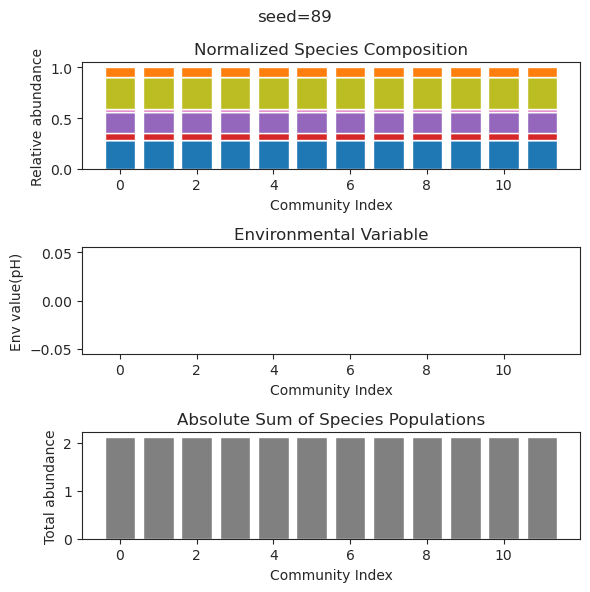

{'species': array([3.41563410e-001, 2.92221588e-001, 1.36551044e-116, 1.75197327e-081,
       3.80243149e-172, 2.93940070e-001, 6.90204722e-002, 1.41148829e-214,
       3.44057111e-002, 3.18213977e-001, 2.20465954e-001, 2.77957868e-001]), 'env': array([0.])}
{'species': array([ 3.41563410e-001,  2.92221588e-001,  2.25297781e-092,
       -1.33238999e-074, -5.54464997e-138,  2.93940070e-001,
        6.90204723e-002,  1.86797744e-185,  3.44057111e-002,
        3.18213977e-001,  2.20465953e-001,  2.77957868e-001]), 'env': array([0.])}
{'species': array([ 3.41563410e-001,  2.92221588e-001,  3.42145327e-095,
       -2.57374931e-075, -4.41546148e-143,  2.93940070e-001,
        6.90204723e-002, -7.59696705e-191,  3.44057111e-002,
        3.18213977e-001,  2.20465953e-001,  2.77957868e-001]), 'env': array([0.])}
{'species': array([ 3.41563410e-001,  2.92221588e-001, -5.33588623e-088,
       -7.55838159e-072,  1.89182502e-114,  2.93940070e-001,
        6.90204723e-002,  1.06594395e-143,  3.44057

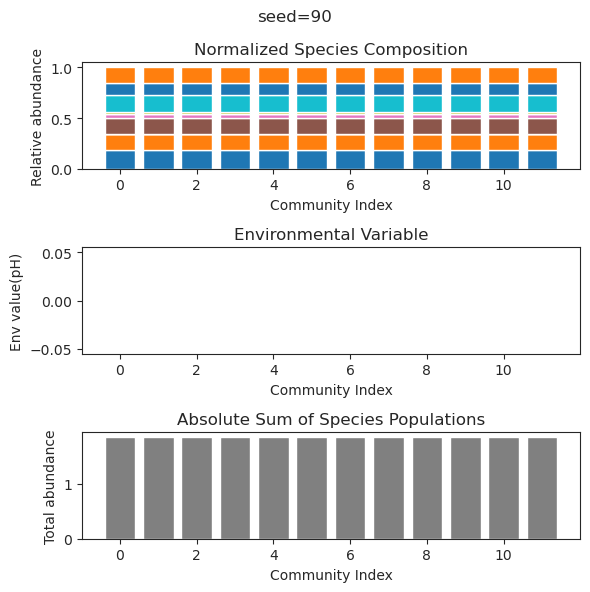

{'species': array([ 1.74903459e-31,  7.37085142e-01,  3.57835076e-01, -3.06608526e-29,
        2.25590997e-34,  2.67270589e-15, -1.21302704e-43,  2.05049610e-42,
        9.39767633e-01, -1.09525863e-27, -5.19552771e-46,  9.37982477e-25]), 'env': array([0.])}
{'species': array([ 1.00617960e-47,  7.37085142e-01,  3.57835076e-01, -7.27956344e-47,
        1.10014165e-55, -2.53682277e-17,  5.54022343e-66, -8.41212833e-68,
        9.39767633e-01, -2.56241309e-42, -4.14940074e-70,  1.28194974e-33]), 'env': array([0.])}
{'species': array([ 9.09521572e-31,  7.37085142e-01,  3.57835076e-01, -2.92656933e-31,
        2.48657805e-34,  1.45255870e-16,  5.51441956e-43, -3.36853685e-42,
        9.39767633e-01, -5.81518767e-30,  5.99482961e-43,  3.06095871e-26]), 'env': array([0.])}
{'species': array([-8.40838404e-46,  7.37085142e-01,  3.57835076e-01, -1.18043704e-43,
        6.06845387e-54, -1.53907317e-18, -4.46329457e-62, -1.70746492e-67,
        9.39767633e-01, -2.09128497e-41,  1.58133067e-68,  3.

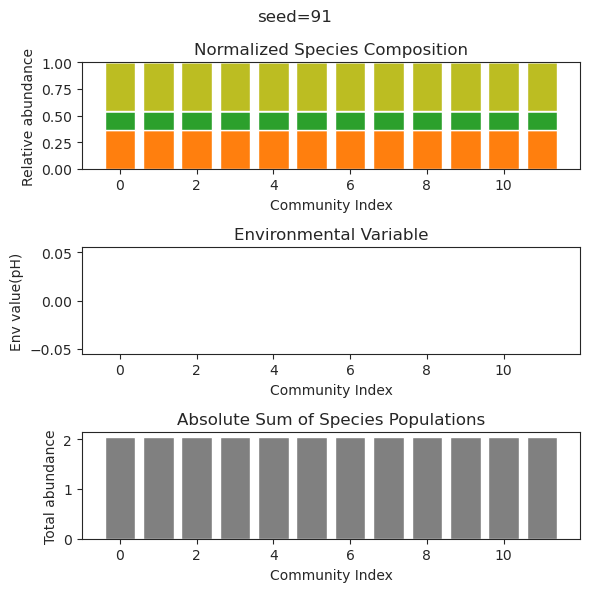

{'species': array([ 3.22533565e-01,  2.08141546e-01,  1.20589865e-50,  1.82949794e-01,
        3.48455381e-01, -1.28758711e-29,  5.85885728e-16,  2.19155417e-01,
        3.48927266e-01,  2.88209407e-23,  6.03898235e-02,  1.44714800e-01]), 'env': array([0.])}
{'species': array([ 1.19180165e-63,  2.14200540e-01, -1.11166566e-37,  2.85319576e-02,
        1.66444852e-01,  1.51522987e-01,  5.21121443e-02,  2.31411988e-01,
        1.48427082e-01,  5.89663797e-07,  3.26827441e-01,  4.69653747e-01]), 'env': array([0.])}
{'species': array([8.68456830e-119, 2.14161412e-001, 4.69113688e-080, 2.81836644e-002,
       1.66204821e-001, 1.51382775e-001, 5.25193433e-002, 2.31428070e-001,
       1.48062780e-001, 1.37849290e-006, 3.27038902e-001, 4.70189332e-001]), 'env': array([0.])}
{'species': array([1.45024144e-39, 2.14194769e-01, 5.19509588e-81, 2.85255794e-02,
       1.66510635e-01, 1.51467851e-01, 5.22512254e-02, 2.31413569e-01,
       1.48299136e-01, 1.49154535e-09, 3.26817620e-01, 4.69671696e-01

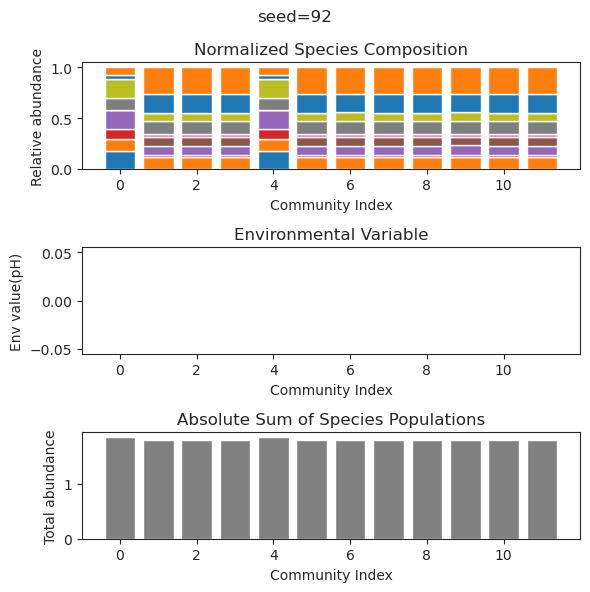

{'species': array([8.26324919e-256, 1.69387492e-016, 2.73468614e-002, 6.13376996e-029,
       2.58965147e-018, 1.96305457e-001, 8.82596542e-001, 6.30832009e-015,
       4.13648338e-001, 5.94823724e-007, 1.82228423e-003, 7.08885747e-001]), 'env': array([0.])}
{'species': array([1.71737711e-238, 4.07646090e-001, 3.40610996e-009, 9.74480226e-018,
       4.01564254e-016, 4.24810694e-001, 6.64087099e-002, 1.66544412e-013,
       5.13039257e-001, 4.02019322e-001, 1.72092712e-003, 2.34956162e-001]), 'env': array([0.])}
{'species': array([1.64303625e-260, 1.23949790e-025, 1.67781239e-001, 8.78015996e-046,
       2.29360509e-020, 3.75637931e-001, 5.17888490e-001, 6.14177537e-017,
       2.72780684e-001, 1.39354040e-007, 2.74422417e-001, 5.03906077e-001]), 'env': array([0.])}
{'species': array([5.26872058e-260, 1.03513038e-025, 1.67785566e-001, 6.61062348e-049,
       3.75005954e-021, 3.75612787e-001, 5.17924913e-001, 8.01262633e-018,
       2.72789094e-001, 5.94964489e-007, 2.74396024e-001, 5.0

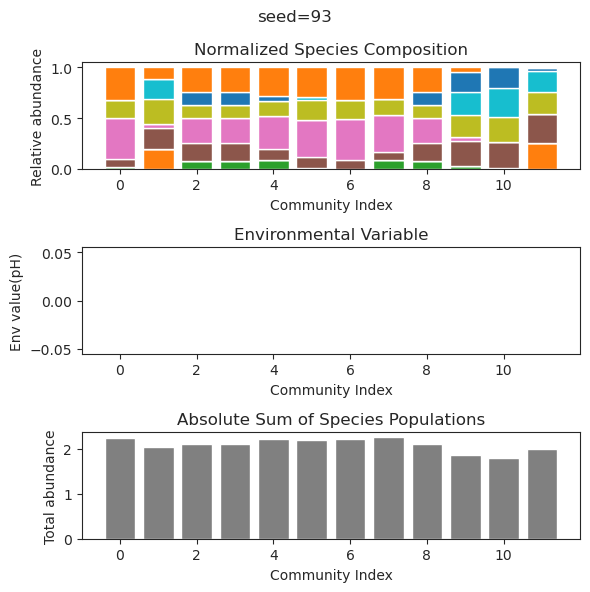

{'species': array([ 5.17129083e-23,  8.47769987e-19,  6.15888876e-01,  4.05577643e-01,
       -1.61791091e-42,  1.91406009e-19, -1.82436293e-58,  4.01038890e-01,
        3.90334237e-01,  1.02448032e-01, -8.60413146e-34,  9.24254950e-02]), 'env': array([0.])}
{'species': array([ 2.06636045e-24,  3.35061755e-20,  6.15888876e-01,  4.05577643e-01,
       -2.28788126e-43,  1.61786396e-22, -1.97781299e-58,  4.01038890e-01,
        3.90334237e-01,  1.02448032e-01, -2.26385482e-37,  9.24254950e-02]), 'env': array([0.])}
{'species': array([1.57539880e-20, 2.27532649e-17, 6.15888876e-01, 4.05577643e-01,
       1.59447852e-36, 3.61275167e-19, 1.38589719e-48, 4.01038890e-01,
       3.90334237e-01, 1.02448032e-01, 6.60724453e-30, 9.24254950e-02]), 'env': array([0.])}
{'species': array([-2.62982685e-22, -5.98896817e-18,  6.15888876e-01,  4.05577643e-01,
        7.36882449e-40, -1.82621155e-20, -8.19899772e-52,  4.01038890e-01,
        3.90334237e-01,  1.02448032e-01, -4.19124101e-35,  9.24254950e-02

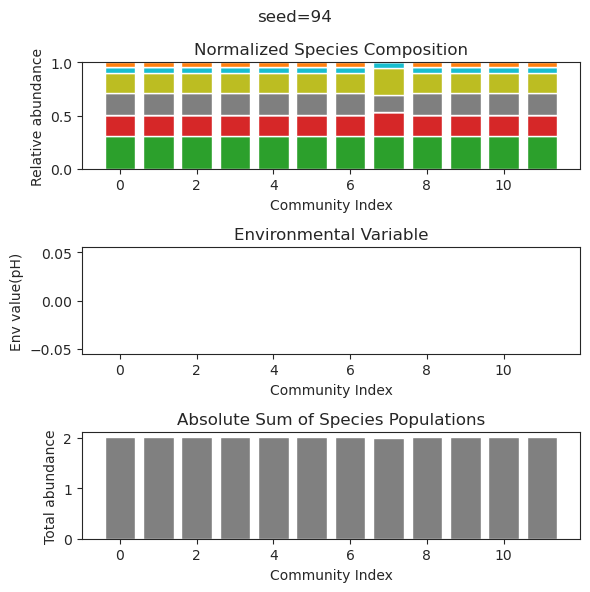

{'species': array([-1.39251825e-32,  9.23171223e-02,  3.33386821e-01,  1.21740154e-01,
       -3.95848436e-40,  2.05704673e-40,  3.29658425e-01,  1.17018529e-38,
        5.08785282e-01,  3.49376343e-01,  3.10686811e-01,  4.76847200e-03]), 'env': array([0.])}
{'species': array([-2.40555842e-32,  9.23171326e-02,  3.33386847e-01,  1.21740180e-01,
        1.81834394e-44,  2.63175507e-68,  3.29658415e-01,  2.71836067e-44,
        5.08785221e-01,  3.49376285e-01,  3.10686825e-01,  4.76853986e-03]), 'env': array([0.])}
{'species': array([ 1.52644323e-29,  9.23170899e-02,  3.33386740e-01,  1.21740069e-01,
        9.71615157e-34, -5.80507416e-40,  3.29658454e-01, -3.49510713e-36,
        5.08785475e-01,  3.49376524e-01,  3.10686766e-01,  4.76825799e-03]), 'env': array([0.])}
{'species': array([ 7.38540839e-32,  9.23171190e-02,  3.33386813e-01,  1.21740145e-01,
       -1.74293232e-34, -7.72106955e-40,  3.29658428e-01, -7.00794087e-43,
        5.08785301e-01,  3.49376361e-01,  3.10686806e-01,  4.

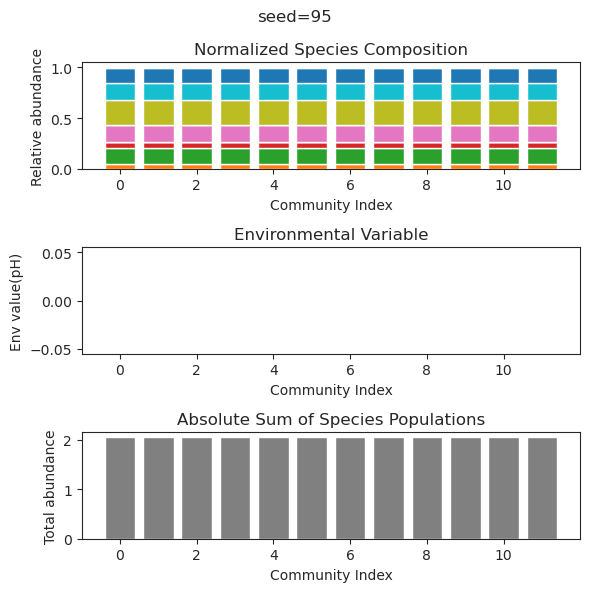

{'species': array([ 6.02854776e-01,  2.68373151e-79,  1.54561336e-68, -1.70338275e-21,
        3.96928877e-38,  9.06743842e-17,  4.04581587e-01, -4.35347348e-47,
        1.76251156e-01,  5.22804741e-89,  3.83533035e-69,  8.90761135e-01]), 'env': array([0.])}
{'species': array([ 6.02854776e-01,  1.67102419e-95,  1.53065908e-82, -5.42296684e-30,
        2.25857110e-48, -1.85169243e-17,  4.04581587e-01, -2.73529323e-59,
        1.76251156e-01,  6.81381822e-92,  4.28699720e-86,  8.90761135e-01]), 'env': array([0.])}
{'species': array([ 6.02854776e-01,  3.53384496e-60, -6.64526322e-49,  1.25553150e-26,
       -4.97870114e-36,  3.28409735e-14,  4.04581587e-01, -2.57653068e-39,
        1.76251156e-01,  5.27200630e-63, -1.86414682e-52,  8.90761135e-01]), 'env': array([0.])}
{'species': array([ 6.02854776e-01, -1.38799410e-54,  6.38063190e-53,  2.97248223e-23,
       -4.87069219e-39, -6.27003358e-16,  4.04581587e-01, -1.85244693e-37,
        1.76251156e-01, -2.64406225e-58,  2.43551831e-49,  8.

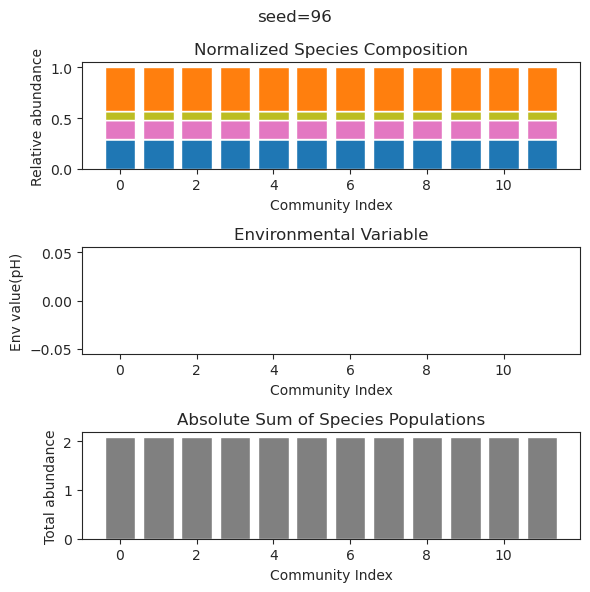

{'species': array([-3.12783414e-61,  3.73778727e-01,  5.35075380e-56,  3.00287038e-51,
        1.41597888e-65, -1.73793667e-26,  1.69734164e-19,  9.35243248e-01,
        1.30877358e-38,  3.48317367e-26,  5.71492448e-01,  1.76570240e-55]), 'env': array([0.])}
{'species': array([ 5.05426053e-71,  3.73778727e-01, -8.08396969e-61, -1.05940573e-55,
        2.66309863e-73, -1.02769133e-25, -3.24617119e-17,  9.35243248e-01,
        5.94776664e-42, -9.77240824e-27,  5.71492448e-01, -3.59640951e-62]), 'env': array([0.])}
{'species': array([ 3.06752205e-42,  3.73778727e-01, -1.09163465e-42, -4.47745113e-35,
        7.93684066e-49, -2.07896608e-21, -2.10014664e-15,  9.35243248e-01,
       -1.28822551e-30, -1.55577510e-22,  5.71492448e-01,  2.26350145e-38]), 'env': array([0.])}
{'species': array([ 5.72294053e-44,  3.73778727e-01, -3.70880446e-43, -9.43600998e-39,
        8.79547179e-54,  9.93069985e-22,  4.44829120e-15,  9.35243248e-01,
       -2.15070594e-33, -3.75482243e-24,  5.71492448e-01,  3.

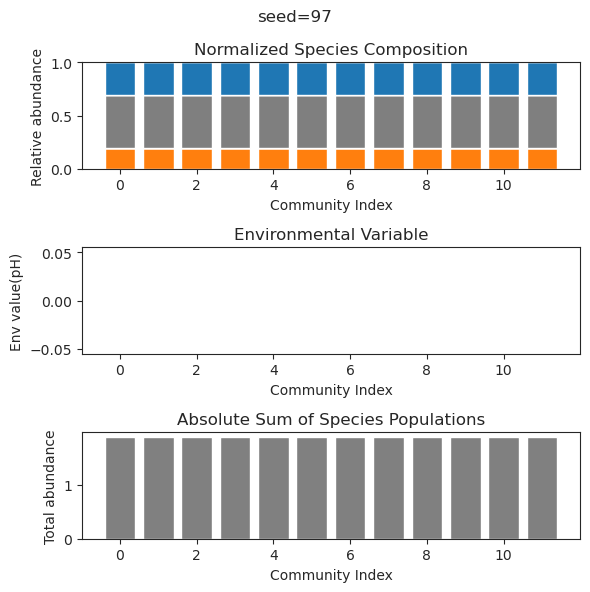

{'species': array([ 4.35515105e-01,  2.10982289e-66,  5.81422313e-36,  2.23362186e-01,
        3.27296228e-01,  2.78176365e-01,  4.10593210e-01,  2.62821820e-02,
        1.68372099e-06,  2.93022921e-01,  9.51412083e-57, -1.66961687e-30]), 'env': array([0.])}
{'species': array([ 4.35512569e-01, -3.67679413e-28, -4.09318339e-38,  2.23360734e-01,
        3.27300202e-01,  2.78175488e-01,  4.10587917e-01,  2.62849272e-02,
        1.13691846e-05,  2.93016668e-01,  3.28380871e-65, -2.24256491e-42]), 'env': array([0.])}
{'species': array([ 4.35512811e-01, -1.53167171e-29,  1.03401082e-40,  2.23360872e-01,
        3.27299822e-01,  2.78175572e-01,  4.10588422e-01,  2.62846650e-02,
        1.04443834e-05,  2.93017265e-01, -1.51039560e-60, -6.53404231e-45]), 'env': array([0.])}
{'species': array([ 4.35514534e-01, -1.58640531e-28,  1.40625497e-30,  2.23361859e-01,
        3.27297123e-01,  2.78176167e-01,  4.10592017e-01,  2.62828005e-02,
        3.86642636e-06,  2.93021511e-01,  1.77471790e-86, -2.

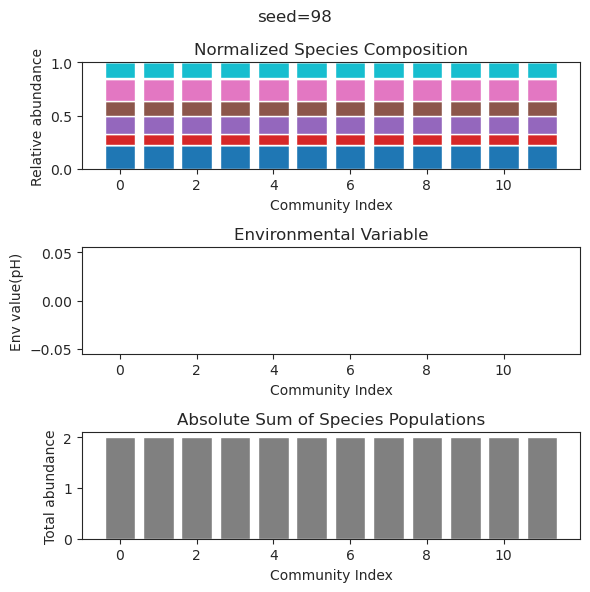

{'species': array([ 3.63625467e-59,  5.00209944e-73,  8.29083153e-01,  7.18037830e-38,
        1.31151438e-01,  3.15836381e-28, -6.38333540e-80,  1.61440987e-01,
        1.24904531e-01,  2.49594707e-01, -1.38739276e-27,  5.73927012e-01]), 'env': array([0.])}
{'species': array([-2.68518227e-60, -3.79228612e-70,  8.29083153e-01, -1.03735192e-35,
        1.31151438e-01, -3.66239352e-31, -2.83697881e-73,  1.61440987e-01,
        1.24904531e-01,  2.49594707e-01, -6.70993653e-25,  5.73927012e-01]), 'env': array([0.])}
{'species': array([-1.99307240e-60, -1.40212259e-67,  8.29083153e-01,  1.81325281e-34,
        1.31151438e-01,  1.42387383e-33,  4.27041183e-70,  1.61440987e-01,
        1.24904531e-01,  2.49594707e-01, -1.25999946e-25,  5.73927012e-01]), 'env': array([0.])}
{'species': array([-1.84493928e-61, -1.96621013e-66,  8.29083153e-01, -5.11553274e-36,
        1.31151438e-01, -2.73293156e-32, -1.50916955e-71,  1.61440987e-01,
        1.24904531e-01,  2.49594707e-01, -1.32957593e-26,  5.

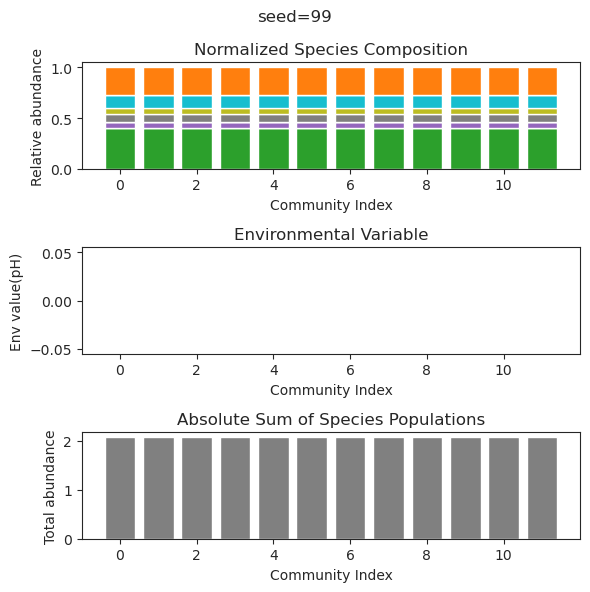

In [10]:
    session_path='Results/Session_Test3'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0.4,0.6)
        f_q = lambda : uniform_distribution(0.4,0.6)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

{'species': array([-2.12160092e-48,  2.66642290e-01, -1.72609676e-51,  9.21782534e-01,
        1.60004583e-68, -1.53384869e-39, -2.98686343e-46,  9.13944303e-68,
       -3.59189579e-74, -5.16350317e-34,  6.15692094e-01, -1.47435706e-34]), 'env': array([-1.84457124])}
{'species': array([-1.44169713e-50,  2.66642290e-01, -2.00901225e-52,  9.21782534e-01,
       -1.93918154e-73,  4.06512381e-40,  2.86331476e-47,  1.52953130e-71,
       -1.90767302e-71, -2.46680411e-33,  6.15692094e-01,  3.41245747e-34]), 'env': array([-1.84457124])}
{'species': array([ 8.39408688e-43,  2.66642290e-01,  3.11798028e-43,  9.21782534e-01,
        2.61242454e-60, -1.78315193e-36, -4.06004788e-43,  1.80032610e-59,
       -9.14204723e-68,  1.01378836e-33,  6.15692094e-01, -1.12791108e-32]), 'env': array([-1.84457124])}
{'species': array([-4.32808797e-64, -5.23325359e-58,  1.41137532e-44, -1.72102811e-60,
        1.78094896e+00, -4.59533557e-28,  1.75642470e+00,  1.17856054e+00,
        2.45730742e-47,  1.3603415

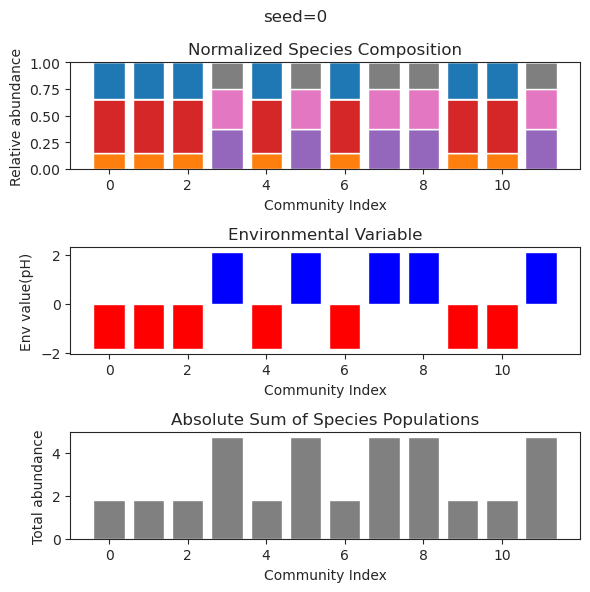

{'species': array([-1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306]), 'env': array([-4.31798949e+306])}
{'species': array([-1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306]), 'env': array([-4.31798949e+306])}
{'species': array([-1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306]), 'env': array([-4.31798949e+306])}
{'species': array([-1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850

/state/partition1/slurm_tmp/25809771.0.0/ipykernel_3703195/3938519037.py:114: RuntimeWarning: invalid value encountered in divide
  normalized_species = species_matrix / species_sums


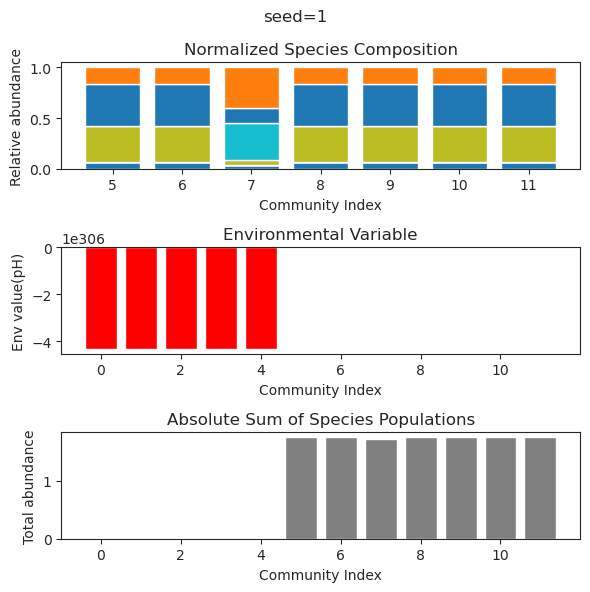

{'species': array([ 3.00268323e-17,  2.50383092e-01, -1.10232108e-68,  1.98458696e-01,
       -2.07998923e-24,  1.04162376e-40, -5.16162314e-67,  1.23790998e-01,
        4.38717362e-62, -5.08674291e-24,  8.01769218e-46,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-5.25243770e-17,  2.50383092e-01, -9.66191013e-74,  1.98458696e-01,
       -1.06050653e-30,  9.80016799e-46,  2.26364456e-70,  1.23790998e-01,
        3.25834967e-63,  1.15962264e-27, -4.51452086e-51,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-6.48751915e-18,  2.50383092e-01, -3.43712952e-81,  1.98458696e-01,
       -1.95135126e-34, -8.47514279e-44,  6.62229005e-82,  1.23790998e-01,
        8.93423277e-72, -1.71454037e-31,  5.59894079e-53,  6.64773062e-01]), 'env': array([-2.59864887])}
{'species': array([-1.66647013e-17,  2.50383092e-01,  1.38124898e-97,  1.98458696e-01,
        1.63732754e-33, -1.05876371e-40,  1.38520584e-99,  1.23790998e-01,
       -2.33706453e-88, -3.5161059

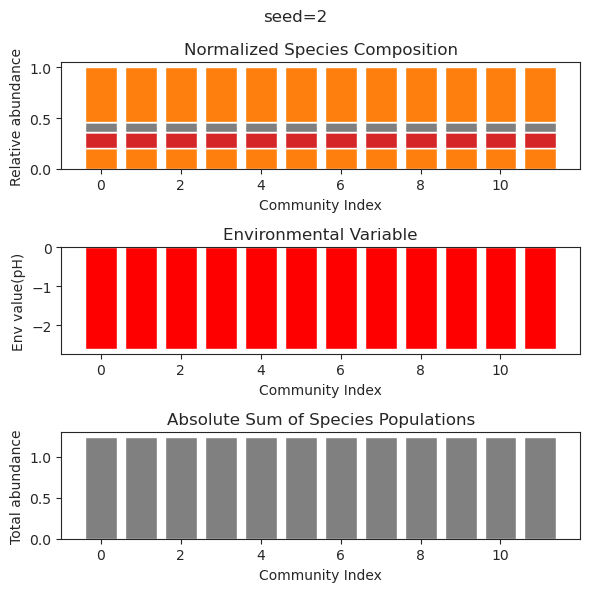

{'species': array([ 1.62398404e-001, -7.83953625e-032,  7.38362574e-001,
        3.76948519e-001,  1.97619174e-063, -3.97275891e-107,
       -3.72525660e-101, -7.49839581e-098,  1.10418324e-013,
        3.87502198e-057, -3.05695115e-065,  7.31471632e-001]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  4.58386445e-27,  7.38362574e-01,  3.76948519e-01,
        1.66033066e-43,  1.22890915e-89,  3.13872572e-81, -1.82663009e-79,
        1.14711448e-12,  1.07639656e-45,  2.61945547e-58,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.29468759e-26,  7.38362574e-01,  3.76948519e-01,
        9.21423758e-51, -2.21423157e-71, -1.98055464e-70, -2.66922018e-72,
        8.24454174e-13, -2.13119731e-47, -1.00357420e-47,  7.31471632e-01]), 'env': array([-0.48046086])}
{'species': array([ 1.62398404e-01,  1.58521622e-28,  7.38362574e-01,  3.76948519e-01,
       -1.43024434e-54,  1.16701225e-38,  2.08796099e-75,  1.95394221e-76,
        8.24550

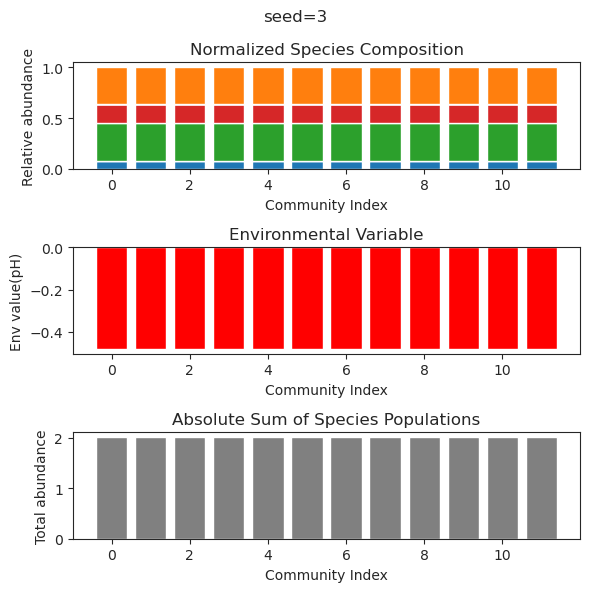

{'species': array([-5.26635266e-28,  3.21738869e-01,  2.23841399e-01,  1.83830082e-46,
        1.95110081e-31,  1.06791488e-58,  1.76509850e-01,  1.40212443e-18,
        9.67900642e-34,  1.11641672e-30, -4.29010261e-25,  2.93522477e-58]), 'env': array([-3.16895885])}
{'species': array([ 7.97712214e-29,  3.21738869e-01,  2.23841399e-01,  1.97175132e-54,
        2.15207340e-33,  8.12624263e-69,  1.76509850e-01, -2.13694547e-20,
       -7.02573677e-42,  6.14210551e-37,  5.76114897e-31,  2.05427573e-69]), 'env': array([-3.16895885])}
{'species': array([-9.21377056e-26,  3.21738869e-01,  2.23841399e-01, -3.02348170e-34,
        3.88795942e-28,  1.53015607e-37,  1.76509850e-01, -4.11437985e-17,
       -6.49549011e-32, -2.09634418e-31,  1.80839520e-31,  5.94590213e-40]), 'env': array([-3.16895885])}
{'species': array([ 4.20264532e-25,  3.21738869e-01,  2.23841399e-01, -4.17890529e-35,
        1.98457092e-24, -9.25261374e-42,  1.76509850e-01,  7.84094809e-19,
        1.42239195e-29, -5.6787157

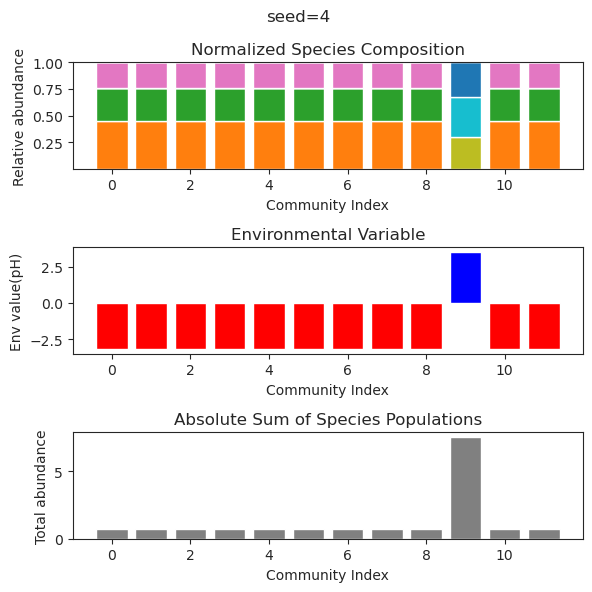

{'species': array([ 9.78759304e-30,  2.74153434e-01, -4.70017836e-18,  9.95002942e-34,
        6.54637053e-40,  2.74177741e-22,  2.57688887e-52, -5.76649934e-42,
       -6.40378788e-30, -6.10653072e-32, -5.05166881e-43,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-9.12674913e-38,  2.74153434e-01,  6.14290098e-20, -1.04174635e-32,
       -4.56535312e-51, -1.18149765e-25,  2.33625746e-61,  4.97935751e-57,
       -2.90623993e-28, -4.35710600e-29, -1.89543057e-56,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([-3.36762551e-34,  2.74153434e-01,  9.41040566e-21, -2.88911116e-33,
       -9.85657271e-46, -9.34384970e-25,  2.79664599e-57,  4.92368760e-47,
       -1.40698341e-31, -8.94583119e-30,  1.38966192e-48,  7.87133417e-01]), 'env': array([-2.63119407])}
{'species': array([ 3.35704717e-35,  2.74153434e-01,  1.09770126e-19, -1.26919341e-28,
        2.45953620e-43, -3.78194095e-24, -2.48871370e-58,  1.74065380e-48,
        2.17095174e-26,  3.2821007

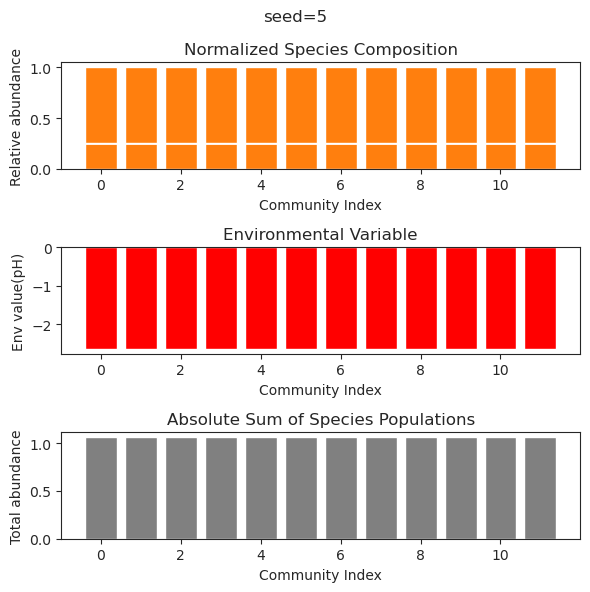

{'species': array([ 5.51199751e-002, -1.05554162e-113,  3.95854445e-102,
       -5.78526364e-087, -2.37784894e-057,  2.79648943e-017,
        5.29297795e-037,  6.09846999e-001,  8.46206294e-020,
        6.72401557e-001,  5.64222687e-001,  6.80444943e-117]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -3.82896076e-110, -6.15555229e-099,
        1.75914688e-084, -4.17453070e-056,  5.98732963e-018,
       -2.57005622e-033,  6.09846999e-001, -1.42367543e-019,
        6.72401557e-001,  5.64222687e-001, -4.10771659e-114]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-02, -8.80125501e-98,  1.86484294e-93,  1.01034328e-76,
        5.51787835e-51, -4.71239481e-17, -3.51148800e-29,  6.09846999e-01,
       -2.55250331e-17,  6.72401557e-01,  5.64222687e-01, -5.30692021e-95]), 'env': array([-0.11839601])}
{'species': array([ 5.51199751e-002, -9.30028866e-117,  6.19259588e-104,
       -2.39000640e-085,  2.85746865e-058,  1.27995434e-016,
       -2.81863768e-036,

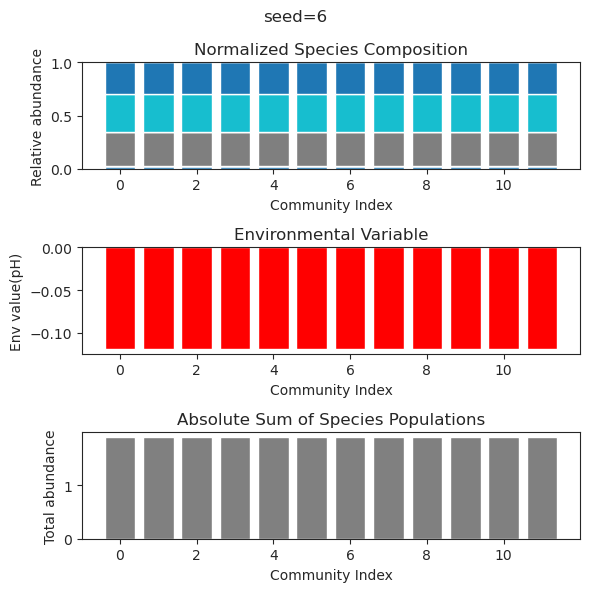

{'species': array([ 4.37828511e-74,  1.54003841e-01,  3.60867169e-31,  3.41994033e-01,
        1.03429178e+00,  6.04805061e-69, -1.03277534e-82, -6.35970305e-79,
       -4.41208106e-74, -4.18095521e-74, -7.24471927e-70,  1.12768475e-36]), 'env': array([-1.57108942])}
{'species': array([-1.78378023e-72,  1.54003841e-01, -1.13954866e-26,  3.41994033e-01,
        1.03429178e+00,  3.40548732e-66,  8.83803435e-80,  7.51032138e-74,
        2.81879071e-69, -2.41252031e-73,  5.86993239e-66, -2.56106137e-31]), 'env': array([-1.57108942])}
{'species': array([1.26432293e-68, 1.54003841e-01, 4.32055203e-31, 3.41994033e-01,
       1.03429178e+00, 3.61714678e-61, 1.56929736e-74, 9.63340749e-72,
       6.06058959e-66, 2.88502663e-65, 5.70807859e-60, 1.74973564e-32]), 'env': array([-1.57108942])}
{'species': array([ 8.93365651e-89,  6.21779525e-87, -6.35525313e-46,  3.73737486e-89,
       -6.97356517e-87,  8.22297720e-01,  6.87166715e-18,  1.60834295e-87,
       -1.27452176e-68,  6.57534156e-01,  4.90

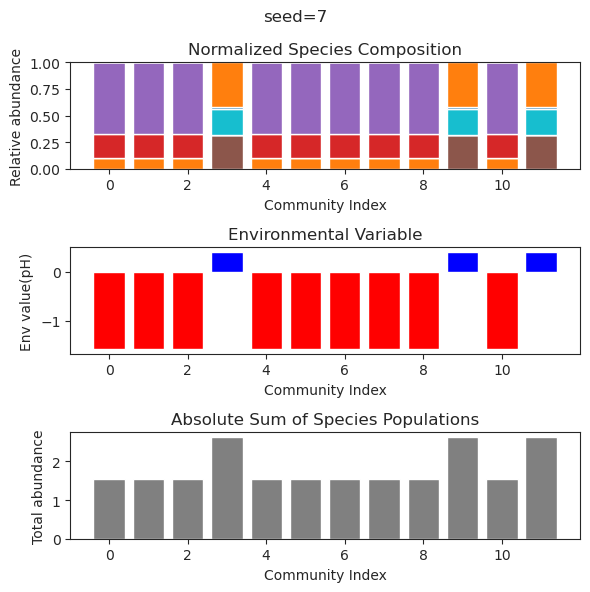

{'species': array([ 1.15060307e-01, -5.82506019e-21,  4.15116685e-75,  1.09908791e-35,
       -9.60187365e-57,  2.05714309e-02, -2.29612290e-49,  5.83743020e-02,
        6.11414391e-01,  6.52070182e-01, -3.59590256e-49, -3.49409100e-26]), 'env': array([-1.14851191])}
{'species': array([1.15060307e-01, 2.14981448e-17, 3.24805889e-75, 4.67044123e-32,
       8.19120197e-58, 2.05714309e-02, 1.23750468e-78, 5.83743020e-02,
       6.11414391e-01, 6.52070182e-01, 7.87286932e-48, 2.54548039e-19]), 'env': array([-1.14851191])}
{'species': array([ 3.19183644e-31,  3.16592110e-32,  1.66937817e+00, -1.47687066e-76,
        6.18610940e-06, -1.98078310e-50,  2.31193494e-23,  2.06941808e-74,
       -1.09381103e-46,  6.64423430e-01,  5.87839705e-34,  6.79481607e-01]), 'env': array([1.51977392])}
{'species': array([ 1.15060307e-001, -9.26624921e-017, -2.11566308e-082,
        1.23904343e-029,  3.70316465e-071,  2.05714309e-002,
        2.44088733e-102,  5.83743020e-002,  6.11414391e-001,
        6.5207

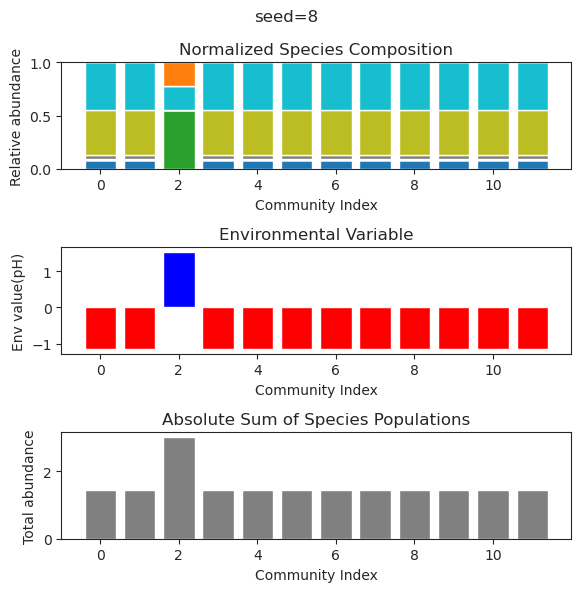

{'species': array([ 2.63462916e-01, -4.14287083e-49, -1.34012912e-31, -1.36519260e-54,
       -2.30473218e-45,  1.36627861e-58, -4.06196545e-44,  1.25790610e+00,
        2.42160327e-01, -7.15252312e-59,  6.08738101e-37, -1.72320405e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.03000524e-40, -6.10935590e-29, -2.13238390e-46,
        2.61891640e-37, -3.25615651e-51,  1.66574609e-37,  1.25790610e+00,
        2.42160327e-01,  2.57496985e-51, -2.61868423e-34,  4.16028581e-40]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01,  4.78183514e-47,  2.02649357e-31,  2.23491218e-49,
       -7.88305431e-44, -1.66493773e-55, -3.11327041e-43,  1.25790610e+00,
        2.42160327e-01, -1.13844085e-55,  2.48214211e-36, -4.03540070e-44]), 'env': array([-2.02046599])}
{'species': array([ 2.63462916e-01, -1.43493247e-49, -2.30555111e-30,  1.23448048e-51,
        5.94325921e-40, -7.56403655e-54,  1.57457171e-39,  1.25790610e+00,
        2.42160327e-01,  1.7885098

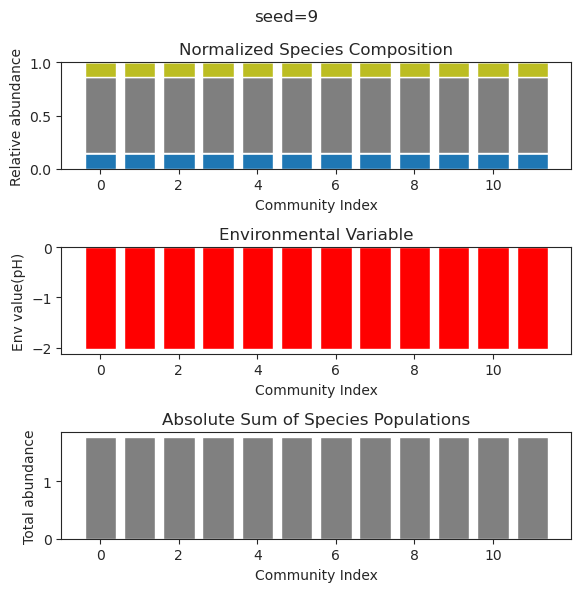

{'species': array([ 1.58133050e-01, -1.30644847e-14,  1.33801758e-35,  1.51583492e-76,
        5.83201343e-01,  1.03785805e+00,  6.48706684e-40, -4.26957620e-69,
        9.26090002e-23, -3.18719909e-44, -3.12740278e-53,  7.78883087e-02]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  5.25322136e-017, -3.68182016e-049,
        3.55853858e-107,  5.83201343e-001,  1.03785805e+000,
        3.47739701e-056,  2.67828556e-103,  4.16384451e-029,
        3.23232194e-063,  1.35786963e-079,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-001,  7.21279361e-016, -4.14581171e-048,
        2.04284465e-126,  5.83201343e-001,  1.03785805e+000,
        2.25889933e-047, -1.16759679e-096,  5.71835186e-028,
       -5.40703960e-070, -1.03343155e-074,  7.78883087e-002]), 'env': array([-1.21785894])}
{'species': array([ 1.58133050e-01,  2.19812952e-15,  7.01055267e-42,  3.74806084e-77,
        5.83201343e-01,  1.03785805e+00,  3.04214211e-42, -8.86477526e-

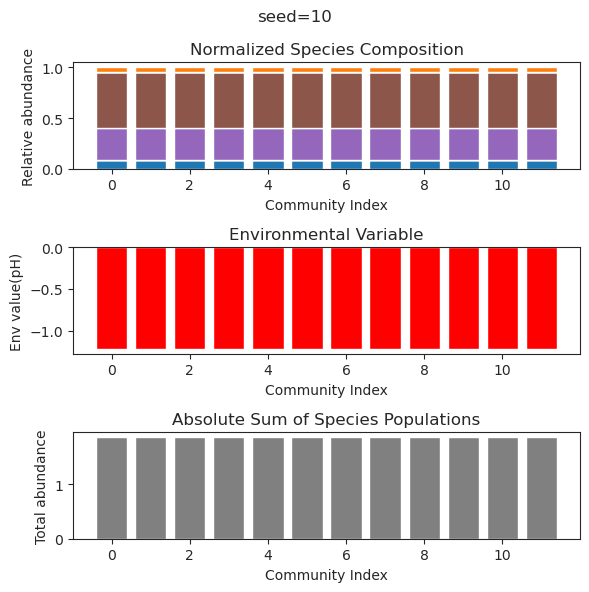

{'species': array([-2.14528618e-56,  1.81379999e-01,  4.11398320e-01, -1.67728087e-39,
        8.36810385e-01,  1.97475855e-32, -3.27665976e-48, -1.33482887e-37,
        5.65310251e-01, -1.33858050e-38, -5.06384292e-39,  2.44382125e-79]), 'env': array([-1.52251901])}
{'species': array([-6.58447945e-59,  1.81379999e-01,  4.11398320e-01, -5.50556276e-43,
        8.36810385e-01, -9.65601766e-35,  8.20460891e-47, -1.15131759e-38,
        5.65310251e-01,  8.64239838e-41, -7.24867662e-42, -1.26871367e-77]), 'env': array([-1.52251901])}
{'species': array([ 7.99070079e-57,  1.81379999e-01,  4.11398320e-01, -3.03584521e-41,
        8.36810385e-01,  1.70658724e-33, -2.36362811e-44, -7.68762574e-39,
        5.65310251e-01,  2.78993283e-36,  5.68516544e-38,  8.35063983e-74]), 'env': array([-1.52251901])}
{'species': array([ 1.25268592e-51,  1.81379999e-01,  4.11398320e-01, -7.74998508e-37,
        8.36810385e-01, -6.90475639e-30,  1.88193673e-39, -2.61582661e-37,
        5.65310251e-01,  2.4638424

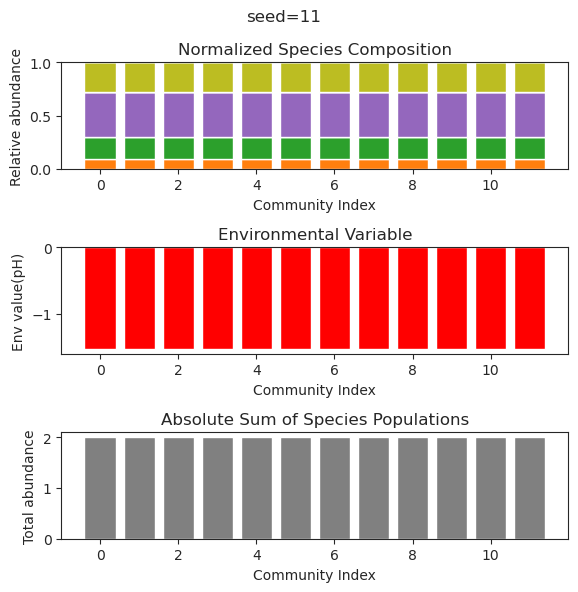

{'species': array([-1.65810444e-092,  1.69106474e-001,  1.35091067e-114,
        1.33219099e-001,  7.57034057e-002, -2.25398010e-105,
        4.88265993e-001,  1.02484510e-070, -2.08001050e-023,
        6.59815941e-112,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-6.77311324e-042,  1.69106474e-001, -1.17015388e-134,
        1.33219099e-001,  7.57034057e-002,  3.30577377e-123,
        4.88265993e-001,  7.72033905e-079,  4.21324259e-026,
       -7.24958748e-132,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([ 2.44053858e-130,  1.69106474e-001, -1.79117262e-131,
        1.33219099e-001,  7.57034057e-002, -1.37761313e-139,
        4.88265993e-001,  1.43545883e-088,  3.85211428e-033,
       -1.95260664e-143,  1.95230651e-002,  9.52402493e-001]), 'env': array([-1.15616461])}
{'species': array([-5.60290160e-116,  1.69106474e-001,  1.20521236e-139,
        1.33219099e-001,  7.57034057e-002, -1.66481764e-128,
     

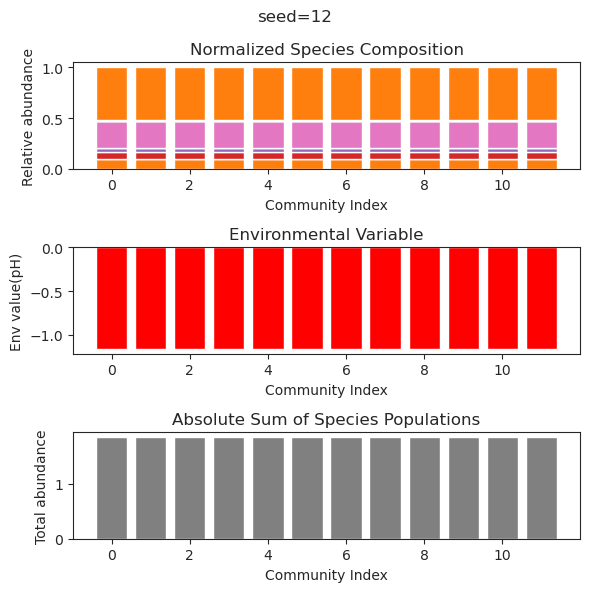

{'species': array([ 8.95730485e-02,  3.05233016e-02, -3.53561753e-41,  2.43737043e-01,
        1.67022363e-78,  4.24165608e-01,  2.15980596e-01, -1.20182848e-51,
       -5.72093457e-88, -2.88554209e-39,  9.61247404e-88,  4.92728140e-01]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002, -5.22289563e-042,
        2.43737043e-001,  1.79537776e-095,  4.24165608e-001,
        2.15980596e-001,  1.23669784e-060,  3.61444782e-103,
       -8.17786357e-042,  2.48551976e-105,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  5.35303037e-042,
        2.43737043e-001,  4.67674654e-094,  4.24165608e-001,
        2.15980596e-001,  6.66653933e-061, -6.33361561e-100,
        1.43853826e-042, -8.06466290e-104,  4.92728140e-001]), 'env': array([-0.98427087])}
{'species': array([ 8.95730485e-002,  3.05233016e-002,  1.99585492e-057,
        2.43737043e-001,  2.98043661e-130,  4.24165608e-001,
        2.15980596e-001,

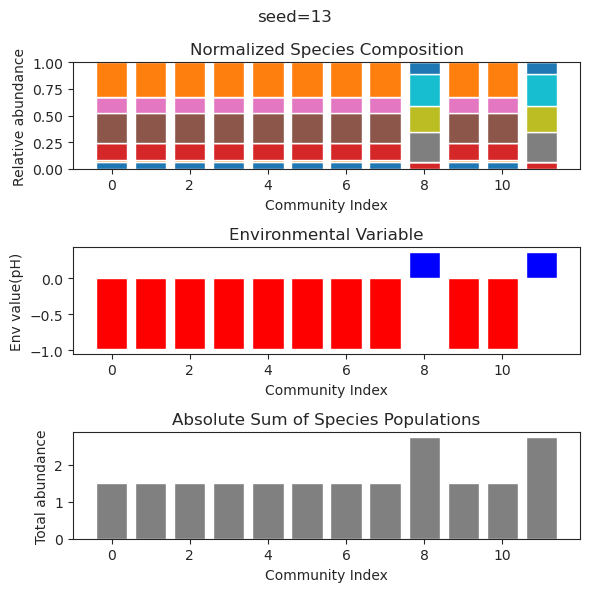

{'species': array([ 2.25554431e-01,  2.57694012e-18,  2.28521144e-58, -5.54578628e-32,
       -9.40036919e-36,  1.11730626e-44, -1.67992825e-59,  9.41282890e-58,
       -5.03059775e-33,  3.99869710e-20, -1.86771061e-55,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([ 2.25554431e-01, -2.06221596e-18,  3.00285134e-85, -3.93306601e-39,
       -2.84714447e-43, -4.83750501e-61, -2.40689070e-87,  9.37210946e-82,
       -8.79524914e-38,  1.73784467e-23, -9.65806493e-84,  1.19694993e+00]), 'env': array([-1.82391959])}
{'species': array([-2.24752196e-31,  6.32572560e-28,  3.71546644e-54, -2.17235736e-61,
        1.44499433e+00,  2.55132970e+00,  1.97845531e-05, -1.78221811e-57,
        4.96690417e-01,  6.29924851e-27,  1.13563960e+00, -9.53512188e-72]), 'env': array([2.61327257])}
{'species': array([ 2.25554431e-01,  7.27308046e-20, -6.44590529e-57, -1.91137516e-34,
       -2.88727242e-36,  2.12884909e-45, -5.04452883e-57, -1.15173073e-55,
       -2.27908712e-36,  1.63092800

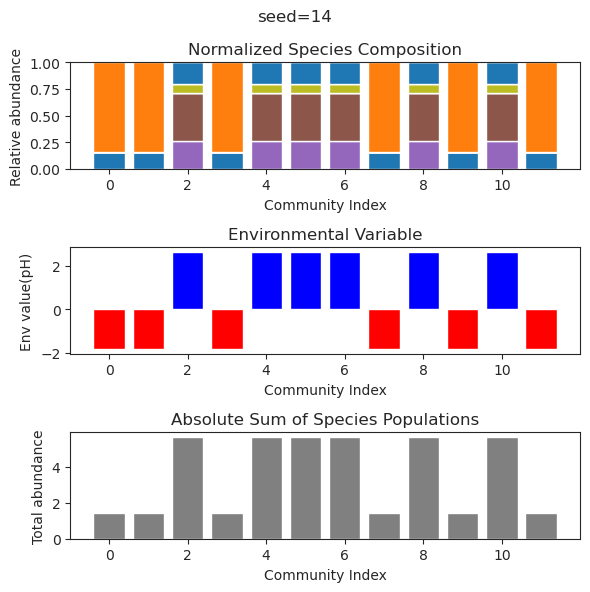

{'species': array([ 2.88208510e-01,  1.19050355e-47,  1.02868719e+00,  1.26479353e-68,
        1.68316606e-46, -3.49732478e-42, -6.71307416e-32,  4.35584237e-01,
        1.57892310e-38, -3.85970513e-73,  1.45682279e-65, -1.16552279e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01,  2.27434301e-45,  1.02868719e+00,  1.79375828e-71,
        2.47211484e-41,  3.08413114e-38,  1.06345575e-26,  4.35584237e-01,
       -4.26255998e-38,  1.46029252e-71,  3.52970023e-59, -1.07454075e-21]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -9.34685026e-46,  1.02868719e+00, -9.29563617e-59,
        1.15249479e-43, -9.77000618e-38, -1.37317675e-32,  4.35584237e-01,
       -2.29005514e-38, -5.18173104e-65,  8.67210421e-61,  6.92055998e-23]), 'env': array([-2.61622258])}
{'species': array([ 2.88208510e-01, -1.58208062e-39,  1.02868719e+00, -3.17093304e-52,
       -1.23314583e-42, -8.60138984e-40, -3.58057264e-33,  4.35584237e-01,
        4.11911008e-32,  3.6117933

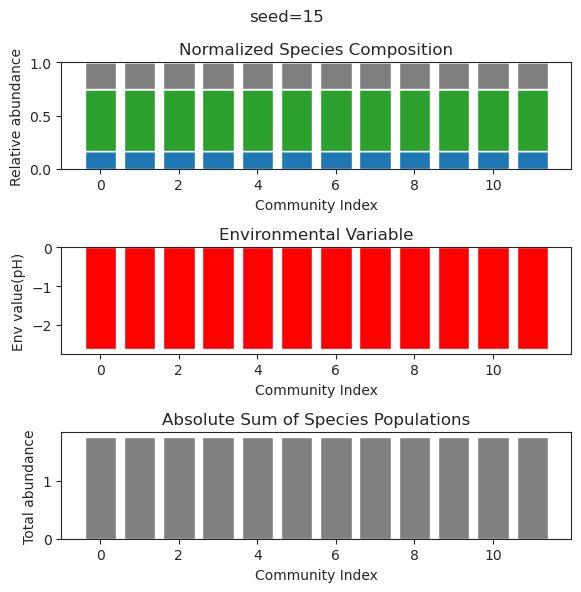

{'species': array([ 2.68390562e-01, -1.17083887e-34,  1.06822261e-27, -1.85744280e-18,
        1.59030748e-65,  8.88767192e-65, -5.12104731e-47,  1.08255029e+00,
        8.37110233e-55,  2.70706780e-63, -1.19966106e-56,  1.04647765e-52]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01,  6.14732009e-35,  7.34591226e-28, -3.84613992e-18,
       -2.32498548e-75, -5.85566609e-78,  3.60598363e-51,  1.08255029e+00,
       -3.59729501e-64,  7.47767109e-76,  5.48680266e-65, -1.39102735e-60]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-01, -3.33719565e-34,  4.13016601e-25, -6.38927301e-18,
        2.49652047e-90,  3.32180946e-92, -4.42857019e-56,  1.08255029e+00,
        4.44311475e-81,  3.21772115e-86, -1.10565922e-76,  1.33304383e-72]), 'env': array([-2.77180968])}
{'species': array([ 2.68390562e-001,  4.47575849e-035, -5.08444614e-029,
        7.30422308e-017, -4.76508105e-116, -2.05780502e-119,
        1.15274465e-072,  1.08255029e+000,  8.46652697e-104,
 

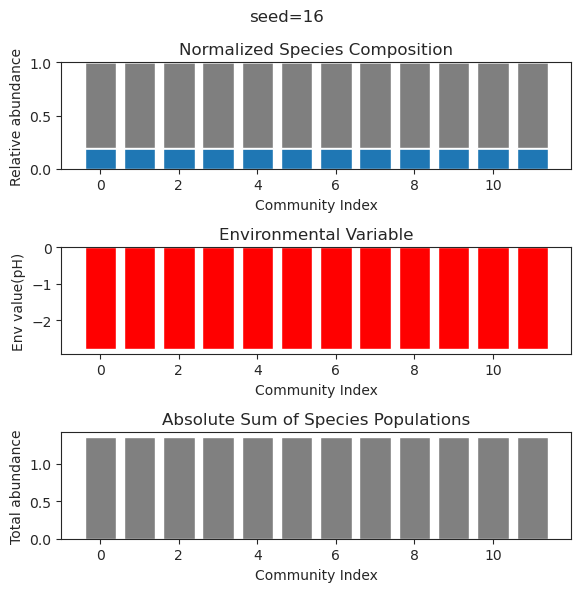

{'species': array([ 3.51382657e-01,  3.92792083e-19,  2.74229543e-52, -8.68149592e-48,
       -8.86336966e-48,  1.59056331e-35, -2.28263607e-43, -6.91405311e-67,
        5.41441773e-01,  1.66668948e-38,  3.22317748e-34,  2.26953977e-61]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  1.33937542e-20, -1.47239012e-57, -1.70051947e-44,
       -1.58021801e-44,  1.59434877e-31, -1.22397247e-47,  5.35808579e-77,
        5.41441773e-01, -9.38516935e-35, -3.89208716e-29,  3.50051482e-66]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  2.74286153e-19, -6.86931585e-56, -5.26115464e-46,
        1.53881676e-47,  8.46313619e-29, -1.31617006e-45, -9.66206510e-78,
        5.41441773e-01,  1.60474094e-35,  1.00119660e-27, -2.70002872e-63]), 'env': array([-3.13733524])}
{'species': array([ 3.51382657e-01,  4.75072035e-21, -3.95875068e-54,  9.56108984e-40,
       -4.11599565e-40,  6.51250545e-27,  4.71523120e-44,  7.26183714e-71,
        5.41441773e-01, -1.6733166

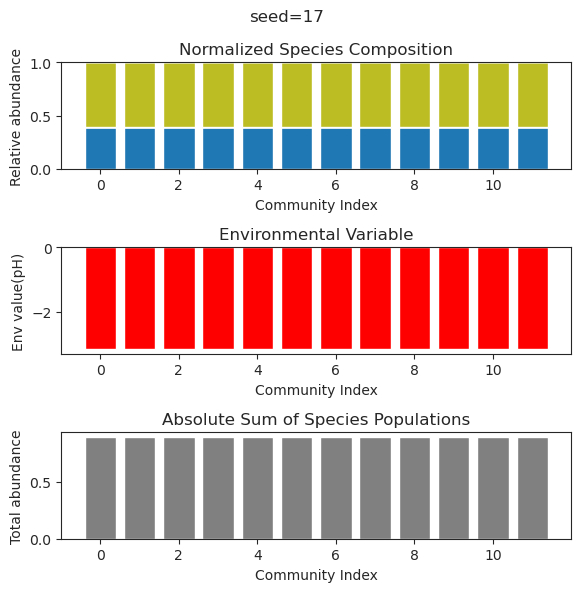

{'species': array([-1.54976302e-48,  3.47570886e-01,  8.34458421e-01,  3.82922286e-73,
       -1.56284428e-79, -1.47744146e-46,  3.34127897e-02, -8.50181538e-77,
       -1.16869488e-20,  1.08275326e-71, -7.26876639e-34, -3.35027112e-50]), 'env': array([-2.76332007])}
{'species': array([-1.90611643e-45,  3.47570886e-01,  8.34458421e-01,  1.00212391e-72,
        2.04285943e-73, -1.24039285e-43,  3.34127897e-02,  3.30556605e-73,
        1.96770379e-18, -2.94813820e-72,  5.60162691e-33, -7.17514131e-52]), 'env': array([-2.76332007])}
{'species': array([-6.58085197e-48,  3.47570886e-01,  8.34458421e-01,  6.25571780e-56,
       -3.44771507e-61, -1.04852577e-50,  3.34127897e-02, -4.79344740e-62,
        3.13972115e-23, -2.04192657e-36,  3.05662024e-33,  1.80451933e-44]), 'env': array([-2.76332007])}
{'species': array([ 1.75044713e-074,  3.47570886e-001,  8.34458421e-001,
       -1.03053852e-116, -3.42555697e-126,  4.15227034e-071,
        3.34127897e-002, -1.00549093e-125,  5.76334232e-024,
 

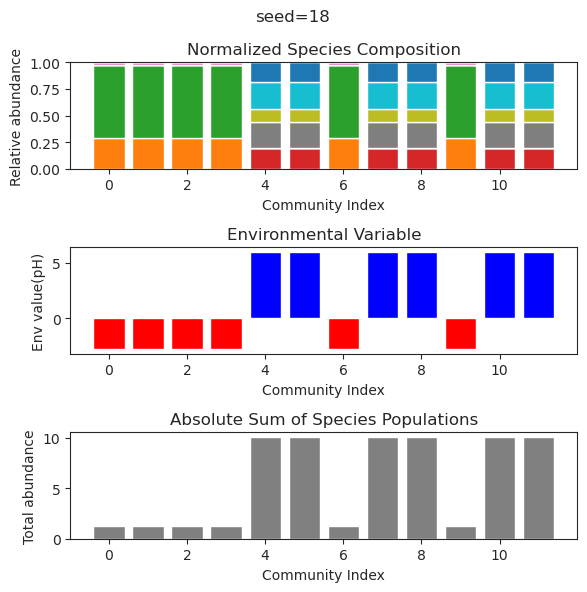

{'species': array([ 1.51054436e-01,  4.48687254e-17,  8.49807079e-01, -1.01448726e-37,
        1.19454558e-29,  1.55326834e-25, -2.69022236e-56, -8.24710570e-46,
       -9.67723098e-24,  3.93107312e-71,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  7.99439634e-18,  8.49807079e-01, -4.58342603e-41,
       -4.76009472e-33, -3.09402488e-29, -1.81624335e-64, -4.72966315e-47,
       -6.98248024e-29, -4.13808991e-78,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  2.22046588e-18,  8.49807079e-01, -1.07708226e-49,
       -1.87449966e-30, -2.12677578e-32, -2.45724293e-79, -2.01610654e-51,
        4.62186799e-28, -5.35239008e-88,  3.35209984e-01,  5.78274883e-01]), 'env': array([-1.24613761])}
{'species': array([ 1.51054436e-01,  3.04561142e-17,  8.49807079e-01,  3.16694246e-36,
        1.88336809e-28,  3.37609180e-28, -1.05989434e-53,  5.08547289e-39,
       -4.36429786e-29, -3.7169060

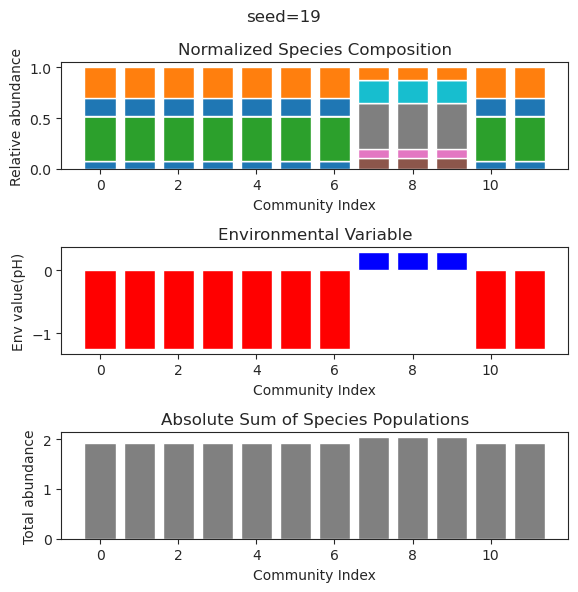

{'species': array([-1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306,              nan,              nan,
                    nan,              nan,              nan]), 'env': array([-1.44850953e+306])}
{'species': array([-1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306, -1.44850953e+306, -1.44850953e+306,
       -1.44850953e+306,              nan,              nan,
                    nan,              nan,              nan]), 'env': array([-1.44850953e+306])}
{'species': array([-4.70778918e-95, -1.40500331e-38,  7.45362939e-95,  1.02203276e-54,
       -2.34986712e-35,  2.15417685e-66,  1.76757132e+00,  1.64392799e+00,
        9.91183575e-01,  8.96788873e-54,  2.88531537e-73,  3.68411536e+00]), 'env': array([4.47617295])}
{'species': array([ 7.64192478e-119,  7.52927256e-064, -1.62591421e-138,
       -2.32448802e-086, -7.82690232e-043,  5.90306591e-108,
        1.76757

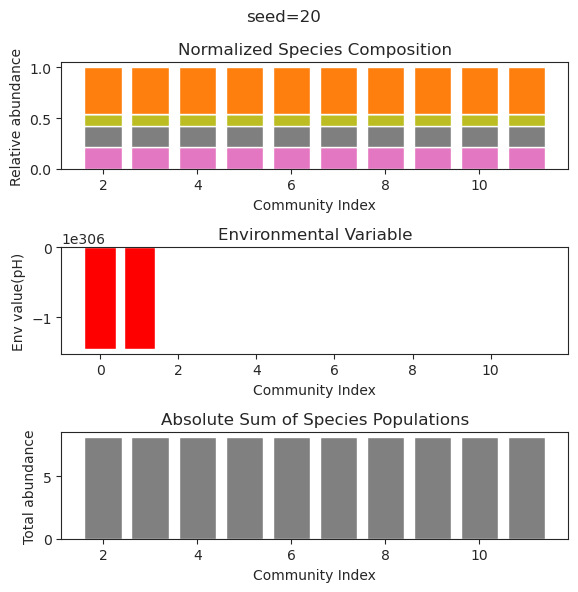

{'species': array([ 9.50010818e-002,  1.15833504e-193,  3.96548460e-001,
        1.78332143e-174,  3.13004570e-165,  2.80802831e-001,
        2.88868261e-001, -3.64102336e-002,  7.44004767e-089,
        0.00000000e+000,  1.55381839e-126,  4.60253403e-001]), 'env': array([-0.7123752])}
{'species': array([-1.39253015e-031,  2.93001070e-109,  4.61112064e-002,
        1.81727051e-138,  5.91639585e-001, -1.47647621e-026,
        1.57975810e-001,  3.54027399e-001,  1.59481192e-001,
        1.30691182e-129,  1.94216406e-083,  6.57886225e-001]), 'env': array([0.0666682])}
{'species': array([-1.42428895e-19,  4.30419317e-52,  4.61112064e-02,  2.87400427e-54,
        5.91639585e-01, -1.44175251e-18,  1.57975810e-01,  3.54027399e-01,
        1.59481192e-01,  4.35124497e-44, -2.13441642e-32,  6.57886225e-01]), 'env': array([0.0666682])}
{'species': array([-5.10001602e-25, -1.48842635e-79,  4.61112064e-02,  4.30371855e-93,
        5.91639585e-01, -4.72810023e-22,  1.57975810e-01,  3.54027399e-01,
 

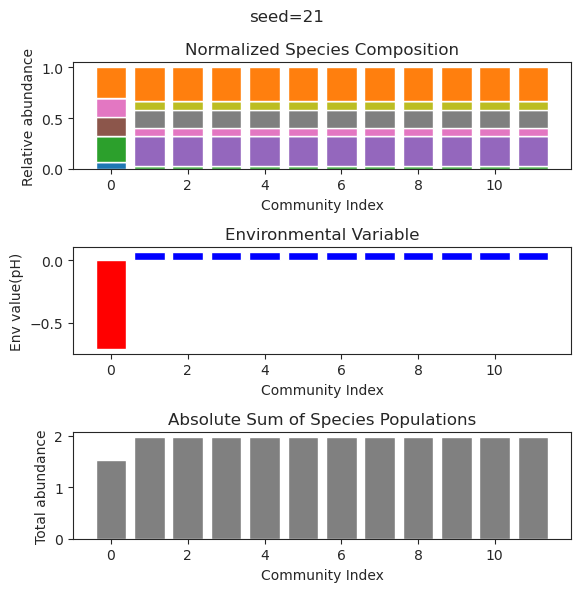

{'species': array([ 5.01830708e-02,  1.47158511e-01,  3.06395067e-51,  7.80500479e-88,
        1.28358894e-43, -3.53910725e-45,  4.12590072e-01,  6.22474388e-01,
       -2.14971709e-28, -7.85619266e-27, -8.13381714e-48,  3.84917051e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01, -5.53832924e-45,  6.16522872e-68,
        7.21342817e-41,  3.72804476e-38,  4.12590072e-01,  6.22474388e-01,
       -5.06476154e-26, -2.84145347e-26,  1.55654935e-38,  2.67772726e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  2.18163573e-54, -5.42940696e-91,
        3.91431539e-44,  6.60139192e-48,  4.12590072e-01,  6.22474388e-01,
       -3.64916252e-28, -5.31823063e-27,  2.80183262e-49,  2.01262199e-20]), 'env': array([-1.68579379])}
{'species': array([ 5.01830708e-02,  1.47158511e-01,  1.24097412e-45, -2.20720457e-69,
       -2.70939041e-42,  3.47188934e-39,  4.12590072e-01,  6.22474388e-01,
       -1.66594832e-25, -1.6843784

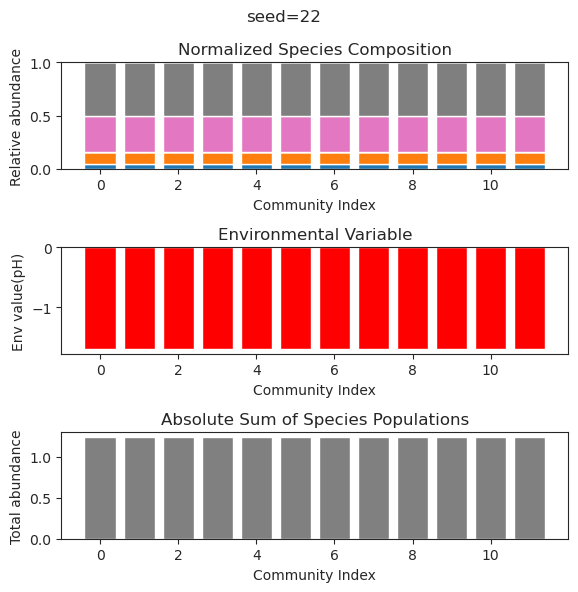

{'species': array([ 1.15069057e-01, -8.42879865e-38, -1.85837434e-56,  5.89464740e-23,
        4.62308461e-01,  2.16325239e-76,  5.44918965e-07,  5.73883555e-01,
        4.06734135e-01, -2.21293174e-73,  7.25002360e-25,  2.14525039e-01]), 'env': array([-0.58246701])}
{'species': array([ 1.15774090e-01,  3.16225419e-28,  3.18294242e-27,  6.58282113e-32,
        4.59688841e-01, -6.01024946e-27,  2.86361706e-03,  5.73321274e-01,
        4.10135744e-01,  5.04568768e-27, -7.64404703e-30,  2.11140442e-01]), 'env': array([-0.58499569])}
{'species': array([ 1.15777224e-01,  2.09815847e-39,  3.48563278e-34,  1.94958414e-29,
        4.59676872e-01,  4.26916227e-30,  2.87580178e-03,  5.73319390e-01,
        4.10151497e-01, -3.44956511e-35,  9.69752037e-31,  2.11124985e-01]), 'env': array([-0.58500712])}
{'species': array([ 1.15777178e-01, -7.18080917e-35,  1.74416894e-32,  5.47954661e-30,
        4.59677047e-01,  1.01086035e-33,  2.87562370e-03,  5.73319417e-01,
        4.10151267e-01,  3.5367287

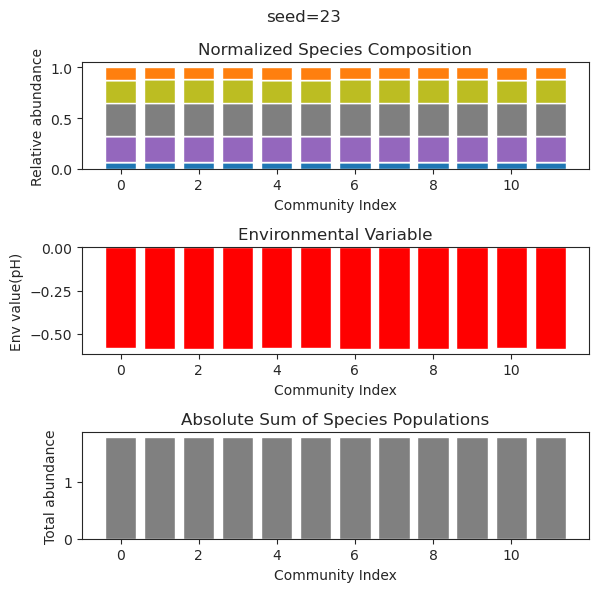

{'species': array([ 1.07390889e-01, -6.30186492e-49, -3.89855582e-73,  3.35934365e-01,
       -9.51502121e-64,  6.42241030e-01, -2.36131424e-68,  5.66868868e-01,
       -3.10840167e-41,  2.79565145e-01, -3.96760372e-31,  5.02373337e-95]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  2.71076342e-48,  1.22852953e-73,  3.35934365e-01,
        1.75928030e-64,  6.42241030e-01,  2.45324125e-67,  5.66868868e-01,
       -1.01706965e-40,  2.79565145e-01, -8.90508579e-29,  2.58700436e-98]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01,  7.27038722e-57,  1.34257974e-81,  3.35934365e-01,
        2.84906301e-67,  6.42241030e-01,  2.48591322e-85,  5.66868868e-01,
        2.28703147e-47,  2.79565145e-01, -4.99292025e-38,  3.41369661e-99]), 'env': array([-0.28425011])}
{'species': array([ 1.07390889e-01, -6.86569983e-46,  7.75596258e-69,  3.35934365e-01,
       -9.41920588e-61,  6.42241030e-01,  8.11660693e-64,  5.66868868e-01,
       -2.38875029e-38,  2.7956514

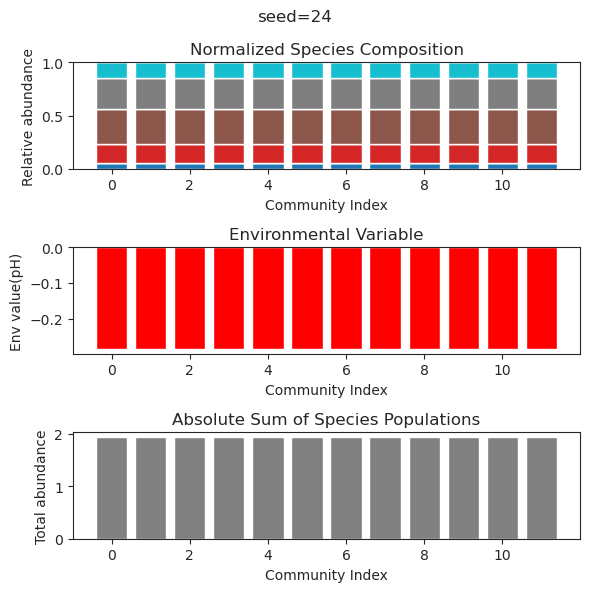

{'species': array([ 3.01207281e-01,  9.08418093e-31,  2.34070212e-24,  5.12947085e-30,
        3.57190002e-55,  1.64209143e-56,  1.01468199e-56, -4.97499719e-54,
        6.05779664e-59,  7.30655263e-01,  4.04116822e-61,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -6.30405686e-31, -4.22927216e-26, -1.67166634e-31,
        5.42528795e-52,  3.75717232e-52,  4.20946650e-54,  4.76251234e-55,
        1.32165391e-56,  7.30655263e-01,  9.63485902e-59,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -3.85240772e-29, -7.80569306e-24, -1.94123961e-32,
        1.29058276e-51,  1.61673752e-53,  1.03451293e-54, -4.09144393e-51,
        8.22849609e-54,  7.30655263e-01, -3.96495313e-54,  3.49376986e-01]), 'env': array([-1.95544865])}
{'species': array([ 3.01207281e-01, -2.85181592e-31,  8.71119113e-26, -8.09977416e-33,
        4.61965915e-53,  3.75599974e-53, -2.94156929e-56, -1.90148384e-57,
       -1.90826885e-57,  7.3065526

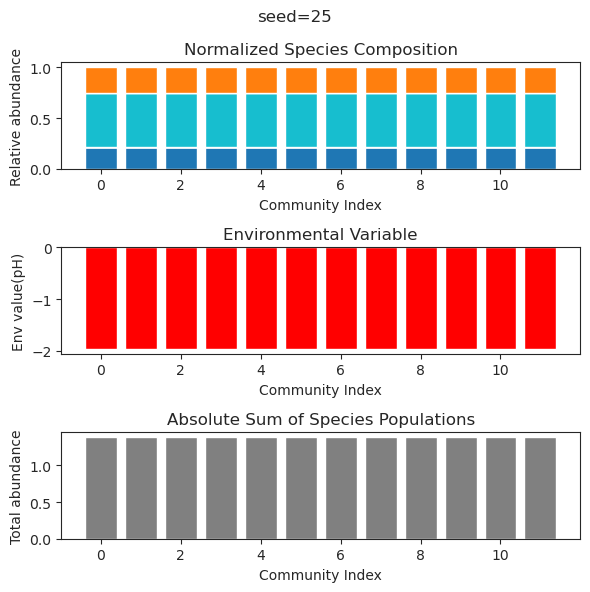

{'species': array([ 3.34311920e-01,  7.34711765e-19,  5.87411822e-35, -2.09714508e-27,
       -6.12900656e-42, -5.25653994e-54, -6.39874486e-57, -1.27345544e-53,
       -9.13339430e-51,  1.07667827e+00, -4.59405702e-44, -3.29929739e-46]), 'env': array([-2.27893754])}
{'species': array([ 3.34311920e-01, -5.21229232e-20, -7.86969594e-41, -2.61524817e-31,
        2.77469012e-47, -2.16555133e-61, -2.27403152e-62, -2.16318095e-62,
        8.97277808e-58,  1.07667827e+00,  6.51588748e-45,  2.67965621e-48]), 'env': array([-2.27893754])}
{'species': array([-5.11001636e-26, -4.19412095e-54,  7.66522086e-53,  6.14882071e-51,
        2.34077578e-01,  3.18016187e-57,  3.74777942e-01, -9.77259273e-27,
        6.14278325e-01, -1.77375685e-50,  6.54477501e-01,  5.28473558e-01]), 'env': array([0.04071568])}
{'species': array([ 3.34311920e-01,  1.70083379e-23,  7.88726489e-38,  2.31276273e-33,
       -1.10121989e-43,  1.80177569e-58,  1.56046352e-58,  1.91571849e-58,
       -4.57133692e-54,  1.07667827

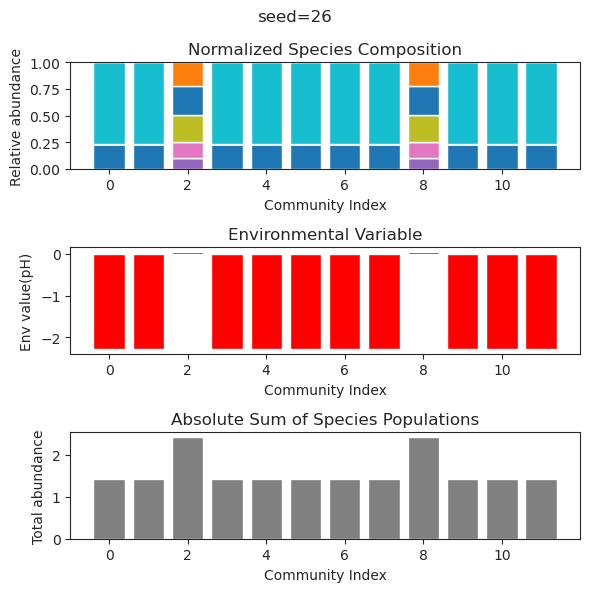

{'species': array([ 1.49354600e-01,  2.01971725e-01,  5.75945073e-62,  4.86892159e-54,
        1.32859101e-62, -5.52721247e-38,  1.45713371e-58, -1.49803775e-50,
        1.44025010e-51,  9.28410553e-25, -4.70951620e-27, -3.86618602e-48]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  8.30991838e-102,
        1.72678733e-089, -2.96886184e-106, -1.21697674e-041,
        3.10453751e-094,  9.00998935e-072,  7.51067016e-085,
        1.84697844e-026,  8.93933531e-029, -8.13996285e-070]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001,  1.79521489e-138,
        5.54551261e-116, -2.63363215e-150,  1.89921031e-044,
       -5.16875863e-126, -1.09698313e-091,  7.83847868e-112,
       -5.24330195e-026, -6.77226231e-029, -8.92044256e-090]), 'env': array([-3.43061259])}
{'species': array([ 1.49354600e-001,  2.01971725e-001, -1.82151461e-117,
       -1.08175340e-096,  1.46328128e-110, -1.03593255e-035,
        2.35318345e-110,

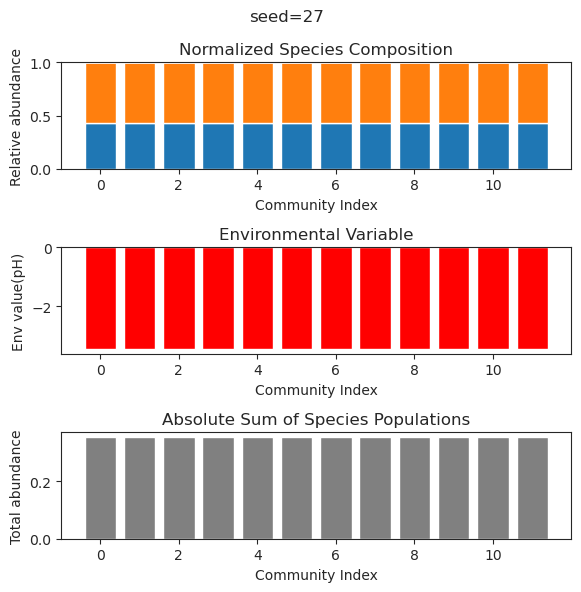

{'species': array([-3.50543397e-66,  1.91057934e-01, -1.15845289e-37, -7.25555002e-57,
        6.43860919e-01,  2.18244141e-01,  7.64760241e-57, -1.87387853e-72,
        7.90518815e-66,  5.36002735e-01,  8.08733987e-78,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([-1.53796020e-64,  1.91057934e-01,  1.29622831e-40, -2.07853565e-58,
        6.43860919e-01,  2.18244141e-01,  4.87941415e-51,  2.61034383e-70,
        3.53671104e-66,  5.36002735e-01,  1.24354150e-73,  3.14442530e-01]), 'env': array([-0.88141885])}
{'species': array([ 6.86089924e-002,  4.24199516e-146,  2.01095189e-001,
        1.13181104e+000,  1.36776569e-054,  8.34520086e-003,
        1.40225744e+000, -1.48219694e-323,  4.65927019e-136,
        2.53448419e-001,  2.33598676e-045,  2.72855453e-002]), 'env': array([0.93397648])}
{'species': array([ 1.58227814e-41, -8.49667427e-68,  1.59339906e-54,  4.50819279e+00,
       -3.33236829e-49,  5.10494433e-67,  5.48702255e+00,  2.33847290e-62,
       -1.313292

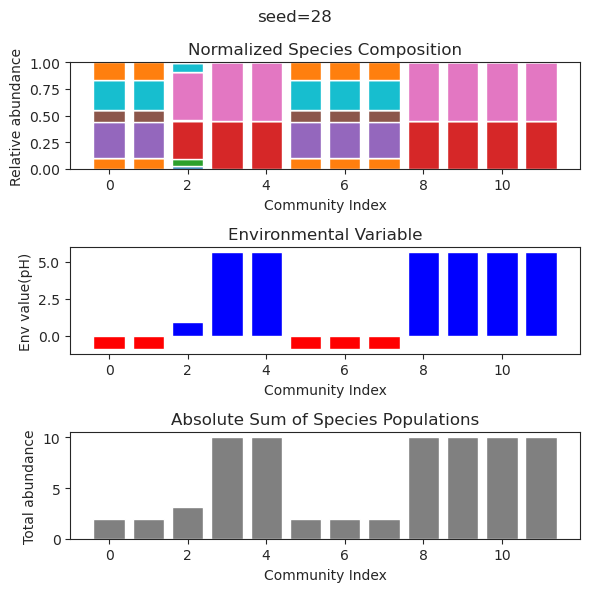

{'species': array([ 3.60112865e-074,  1.53754096e-116,  2.34787430e+000,
       -2.93709360e-077, -3.29688434e-109, -8.14443733e-058,
        1.95815651e+000,  3.44691820e-084,  9.45623716e-001,
       -1.55142394e-028,  3.99329241e-109,  2.59192770e-109]), 'env': array([2.09025217])}
{'species': array([-4.71412593e-70,  1.04815367e-98,  2.34787430e+00, -2.48869385e-69,
       -1.62570578e-98, -3.29650826e-60,  1.95815651e+00, -3.48271936e-76,
        9.45623716e-01,  2.70670635e-25, -7.68711876e-89, -1.20548685e-94]), 'env': array([2.09025217])}
{'species': array([-2.49995882e-080,  8.63909443e-116,  2.34787430e+000,
        1.14696626e-059,  2.64913975e-111,  4.35661727e-050,
        1.95815651e+000,  1.95095209e-085,  9.45623716e-001,
        7.04400916e-026,  2.07277981e-109, -9.39877063e-105]), 'env': array([2.09025217])}
{'species': array([-4.02893534e-72, -1.32594437e-98,  2.34787430e+00,  3.00305230e-46,
        8.80031373e-92,  2.43339486e-43,  1.95815651e+00,  4.57299424e-75,

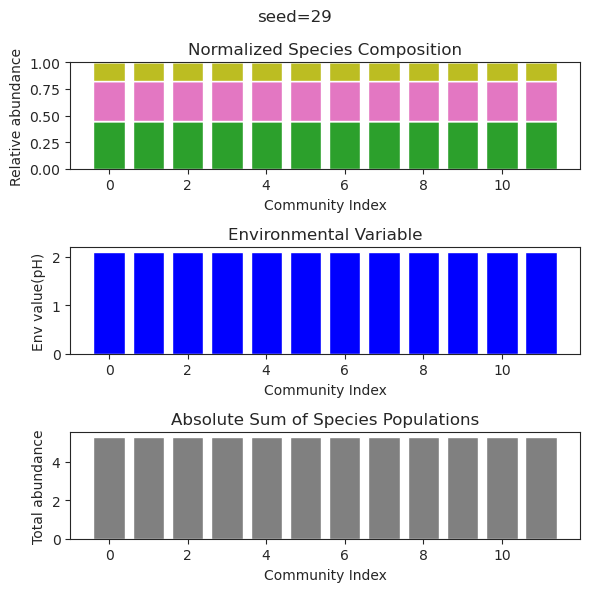

{'species': array([ 5.92400638e-81,  2.99794304e-01, -2.36731465e-86,  8.36479729e-63,
        2.50379792e-01, -1.91999094e-29,  8.02908786e-01,  1.51587248e-01,
       -7.12372423e-20,  1.29412677e-45, -1.41992188e-64, -1.38468741e-68]), 'env': array([-2.13066378])}
{'species': array([ 1.06301668e-57,  2.99794304e-01,  2.02101105e-59, -3.70287239e-46,
        2.50379792e-01,  1.30385429e-27,  8.02908786e-01,  1.51587248e-01,
       -2.65111859e-18,  4.20653718e-37,  1.50816448e-51,  1.44402031e-54]), 'env': array([-2.13066378])}
{'species': array([ 1.33862153e-77,  2.99794304e-01,  2.17265033e-81,  5.07812918e-62,
        2.50379792e-01,  2.75749704e-28,  8.02908786e-01,  1.51587248e-01,
       -1.03767837e-17,  4.60789805e-40,  1.07714159e-61,  1.66845032e-66]), 'env': array([-2.13066378])}
{'species': array([ 1.37669994e-48,  2.99794304e-01, -7.75381414e-48, -9.55448944e-39,
        2.50379792e-01, -2.12936601e-29,  8.02908786e-01,  1.51587248e-01,
       -6.35672604e-18, -1.2580576

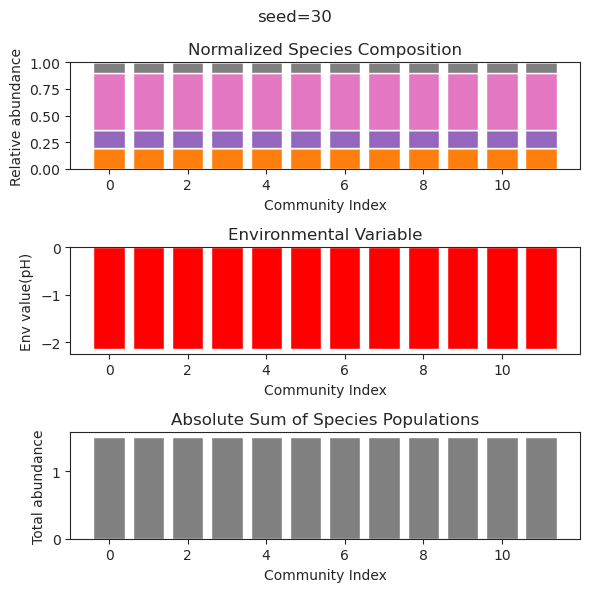

{'species': array([ 4.02541203e-50,  2.16641032e-01, -2.02253285e-28,  8.58459614e-01,
        6.73306924e-01,  2.89262159e-39,  9.66201801e-40,  1.81067446e-49,
        2.00067882e-41,  1.31601348e-01, -4.93821417e-48, -2.15632088e-47]), 'env': array([-1.40302269])}
{'species': array([-4.15551166e-52,  2.16641032e-01, -4.57666194e-31,  8.58459614e-01,
        6.73306924e-01, -9.36584910e-38,  2.40983420e-42, -7.10771593e-50,
        4.39169677e-41,  1.31601348e-01,  1.77257069e-47,  3.68776732e-50]), 'env': array([-1.40302269])}
{'species': array([ 5.69665601e-51,  2.16641032e-01,  7.98145584e-29,  8.58459614e-01,
        6.73306924e-01, -1.13818426e-40,  1.16458261e-38, -4.82037282e-47,
       -6.52093753e-45,  1.31601348e-01, -4.18121881e-45, -3.10714672e-46]), 'env': array([-1.40302269])}
{'species': array([-4.03765182e-52,  2.16641032e-01, -7.83696666e-29,  8.58459614e-01,
        6.73306924e-01,  8.93858478e-37,  3.12510118e-38, -2.83603861e-47,
        9.72077912e-40,  1.3160134

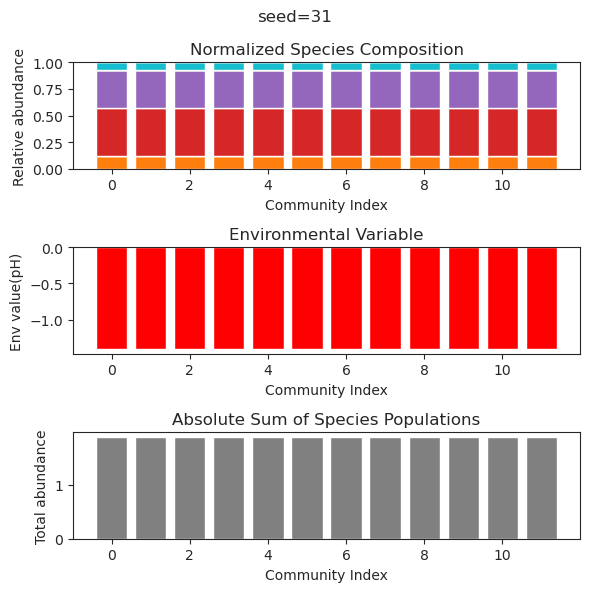

{'species': array([ 6.88979071e-084,  2.05939255e-001, -2.25410928e-131,
       -4.75179375e-132, -4.15559013e-027,  3.05588032e-070,
       -4.56316036e-072, -1.03882271e-035,  2.83786070e-001,
        1.11542333e+000, -7.87469280e-046,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([ 1.99633676e-083,  2.05939255e-001,  5.45626113e-132,
        7.77574987e-131, -4.15996626e-025, -1.72957768e-074,
       -2.44622451e-073, -6.16827181e-036,  2.83786070e-001,
        1.11542333e+000,  1.12421385e-044,  8.40846343e-002]), 'env': array([-1.96582021])}
{'species': array([-3.09634138e-023, -8.59450179e-098,  6.32792263e-083,
        1.04017502e-092,  8.00432138e-001,  1.90484560e+000,
       -2.83591981e-097,  2.23363159e+000,  1.39915674e-077,
       -5.00951154e-104,  1.44682028e-047,  1.37165608e-034]), 'env': array([2.27421335])}
{'species': array([ 9.12587671e-23,  3.05933222e-35,  1.01737646e-44, -2.69111730e-43,
        8.00432138e-01,  1.90484560e+00, -1.43180919e

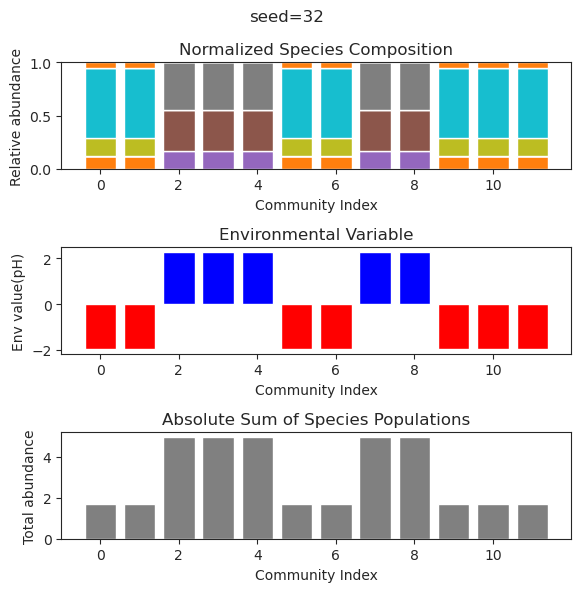

{'species': array([ 2.44050380e-002, -6.82280621e-067,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        3.78664638e-121, -8.06418907e-112, -8.45223649e-099,
       -3.35787164e-041, -8.90573793e-122,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -1.30658094e-062,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
       -7.10542857e-111, -9.13928927e-099, -5.06931605e-091,
        2.23248109e-038, -2.52734998e-108,  4.14571777e-001]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-02, -4.44243636e-53,  4.41729884e-01,  4.99371022e-01,
        4.82350812e-01,  2.19557203e-01, -6.19796053e-92,  8.09357822e-89,
       -3.54273289e-75,  4.00998842e-37, -1.11116191e-94,  4.14571777e-01]), 'env': array([-0.20264538])}
{'species': array([ 2.44050380e-002, -2.37175867e-057,  4.41729884e-001,
        4.99371022e-001,  4.82350812e-001,  2.19557203e-001,
        1.23494232e-106,

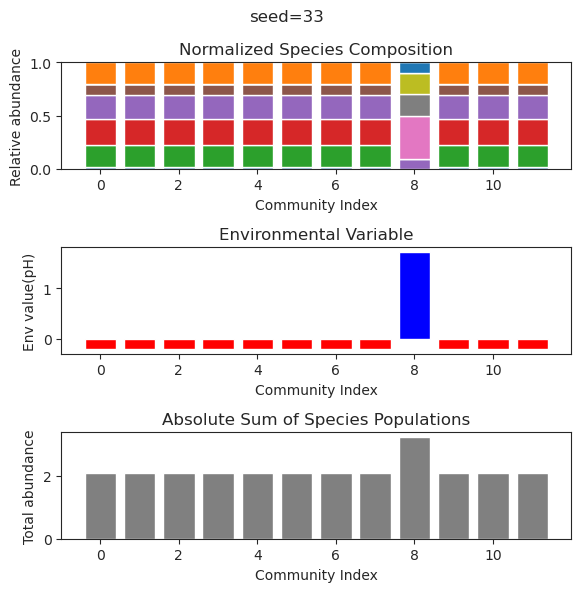

{'species': array([ 3.77933406e-01,  6.17508158e-44, -1.22190316e-39, -1.10744243e-83,
        9.27063194e-01, -1.54904686e-95, -4.62727828e-42,  3.66617330e-59,
        5.88798321e-02, -3.72687199e-51,  1.02125435e+00, -4.37619173e-21]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.32448444e-63, -1.29305349e-35,  4.96661034e-84,
        9.27063194e-01, -3.78563324e-90, -2.86762719e-38,  7.89222816e-60,
        5.88798321e-02, -2.35688767e-51,  1.02125435e+00, -8.02635910e-26]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.35609742e-49, -1.55177116e-39, -6.34562076e-60,
        9.27063194e-01, -2.18171707e-65, -8.80591314e-41, -6.12615511e-46,
        5.88798321e-02, -5.30619693e-44,  1.02125435e+00,  5.72040584e-29]), 'env': array([-2.92148959])}
{'species': array([ 3.77933406e-01,  1.91448052e-45, -7.29446200e-34, -2.33574679e-68,
        9.27063194e-01,  3.90909019e-68, -3.75765267e-36, -1.49854775e-58,
        5.88798321e-02,  6.1241519

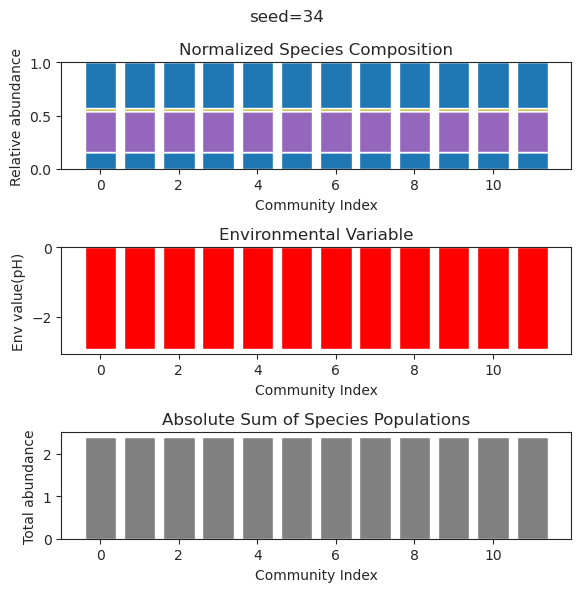

{'species': array([ 3.32868792e-01, -1.06120879e-50, -6.93529838e-94, -1.12700734e-58,
       -5.11862535e-82,  5.20201144e-01, -5.25705917e-83,  1.85427959e-01,
        1.38131241e-95,  2.72731939e-95, -1.82505458e-26,  1.51633671e-50]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01, -2.21360364e-50, -9.51015108e-99, -2.54465956e-58,
       -2.30328753e-85,  5.20201144e-01, -4.94720262e-85,  1.85427959e-01,
       -7.74084953e-99, -2.04144771e-99,  3.21300341e-25, -5.61488388e-58]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  6.67248389e-45,  7.73719462e-86,  5.11343240e-55,
       -9.02343019e-74,  5.20201144e-01, -1.75502346e-74,  1.85427959e-01,
        9.99717559e-83,  1.70989680e-83,  9.82891213e-24, -1.00610588e-44]), 'env': array([-2.78942174])}
{'species': array([ 3.32868792e-01,  3.56475270e-39, -5.44928462e-59,  2.83356613e-41,
        9.33560827e-57,  5.20201144e-01,  1.06863669e-55,  1.85427959e-01,
        8.28260817e-60,  5.9758479

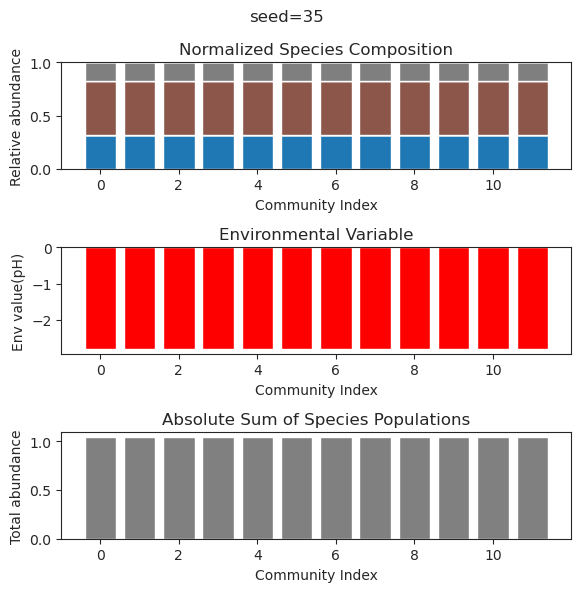

{'species': array([-6.38490710e-52,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
        1.73303269e-38,  6.57032478e-01,  1.39106358e-29,  1.73592621e-63,
       -2.24764791e-53, -6.20176817e-49, -6.82102137e-61,  2.24024103e-60]), 'env': array([-1.93079834])}
{'species': array([ 9.16193383e-46,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -1.52593927e-40,  6.57032478e-01, -7.44943640e-26, -1.12990862e-96,
       -8.99371821e-76,  1.80651348e-64, -1.24203199e-94, -3.34292740e-89]), 'env': array([-1.93079834])}
{'species': array([ 3.96257410e-62,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -9.16896629e-37,  6.57032478e-01,  1.17257420e-27, -4.11152084e-73,
        3.05096893e-63, -1.00334376e-51,  4.77269995e-78, -3.59995770e-71]), 'env': array([-1.93079834])}
{'species': array([-1.13126266e-48,  1.84982773e-01,  7.85174612e-01,  2.47562990e-02,
       -2.85102356e-35,  6.57032478e-01,  1.35710602e-27, -4.89602752e-60,
       -2.58737414e-49,  3.9797403

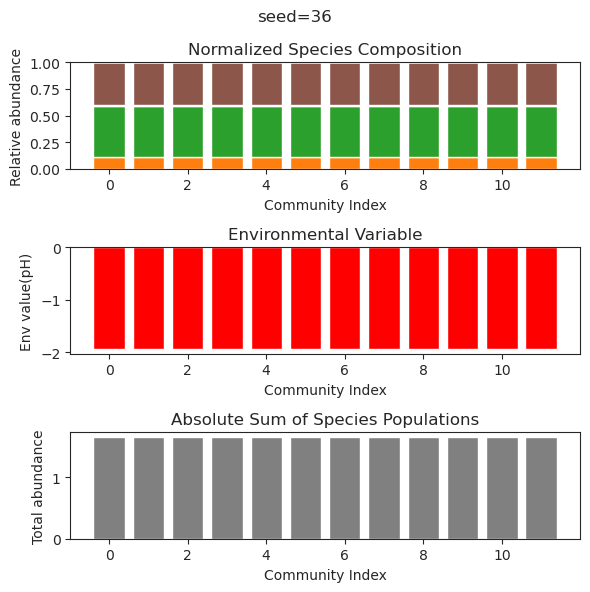

{'species': array([ 4.23181113e-02,  1.75804303e-01, -4.05664371e-52, -4.73306986e-38,
        4.12899143e-18,  6.37485000e-01,  1.87919567e-53, -3.53211028e-75,
       -1.43932315e-24,  1.08015108e-58, -1.60194766e-75,  4.64763158e-73]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01, -5.51094388e-63, -1.80933935e-40,
        3.10803321e-20,  6.37485000e-01, -2.16230606e-63,  9.30897994e-83,
        2.55354520e-28,  3.09742649e-64,  1.69810675e-80,  7.13799467e-79]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-002,  1.75804303e-001, -1.86615350e-071,
        1.16990936e-038,  1.86271964e-019,  6.37485000e-001,
       -5.85789826e-075, -2.28522968e-099, -3.05787045e-025,
       -1.06552207e-081, -1.55873673e-099, -5.77139037e-101]), 'env': array([-2.19954443])}
{'species': array([ 4.23181113e-02,  1.75804303e-01,  2.70163653e-57, -7.68390113e-36,
        7.29615319e-20,  6.37485000e-01, -4.21681654e-58, -1.73288786e-77,
       -2.80091

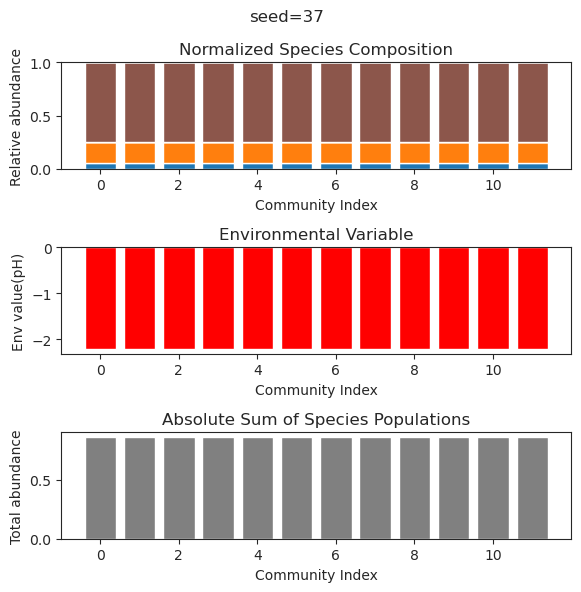

{'species': array([ 1.25842686e-001,  8.83420310e-044,  2.58308511e-001,
        5.25090936e-131,  1.27318268e-122,  2.07115644e-001,
       -3.40294616e-088,  2.17663830e-001,  1.62377018e-080,
        1.48206226e-001,  1.90919652e-003,  5.53587755e-001]), 'env': array([-0.83066344])}
{'species': array([ 1.25842456e-001,  1.62566885e-060,  2.58307540e-001,
        3.97973787e-126, -3.18028503e-122,  2.07117247e-001,
       -2.13526637e-087,  2.17666127e-001,  6.37792524e-078,
        1.48203791e-001,  1.90842835e-003,  5.53587868e-001]), 'env': array([-0.83066158])}
{'species': array([ 1.25471867e-001,  4.35492733e-027,  2.56640782e-001,
       -3.76597461e-131,  2.35854956e-027,  2.09794022e-001,
        1.71212495e-027,  2.21506617e-001, -1.12422673e-027,
        1.44196490e-001,  4.59996959e-004,  5.53862851e-001]), 'env': array([-0.82775213])}
{'species': array([ 1.25841111e-001, -1.45777036e-047,  2.58301856e-001,
       -5.94207313e-121,  4.73402387e-128,  2.07126633e-001,
     

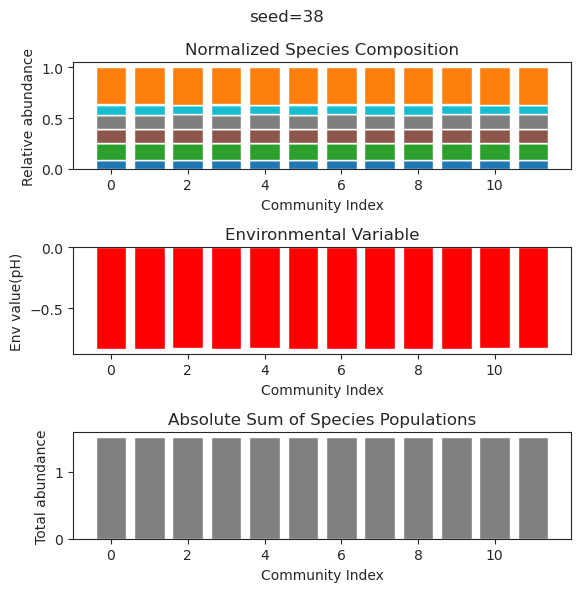

{'species': array([-1.15400924e-091, -4.84094085e-114,  7.86808840e-040,
        1.47479141e-061,  2.53191406e-116,  1.33810718e-088,
        5.23449859e+000,  1.12326453e-101,  1.84364010e-106,
        2.54281343e+000,  1.36756594e-121, -3.19151050e-070]), 'env': array([6.41922629])}
{'species': array([-1.34376583e-087, -9.08951542e-106, -4.53117455e-038,
       -7.15100167e-058,  3.21197873e-108, -4.99089241e-085,
        5.23449859e+000, -3.61171140e-096, -1.82899266e-099,
        2.54281343e+000,  9.80528705e-113,  3.39480077e-067]), 'env': array([6.41922629])}
{'species': array([-3.10513643e-42,  3.52869187e-95,  1.95871713e-35, -1.23116752e-59,
       -3.11170350e-92,  5.11916433e-78,  5.23449859e+00,  3.69172193e-83,
       -5.31199833e-89,  2.54281343e+00,  2.73393646e-94,  1.97858240e-58]), 'env': array([6.41922629])}
{'species': array([ 1.30440737e-080, -1.89386183e-099,  4.45841549e-032,
        4.00865551e-059,  3.25542984e-096, -1.06537054e-067,
        5.23449859e+000,  1

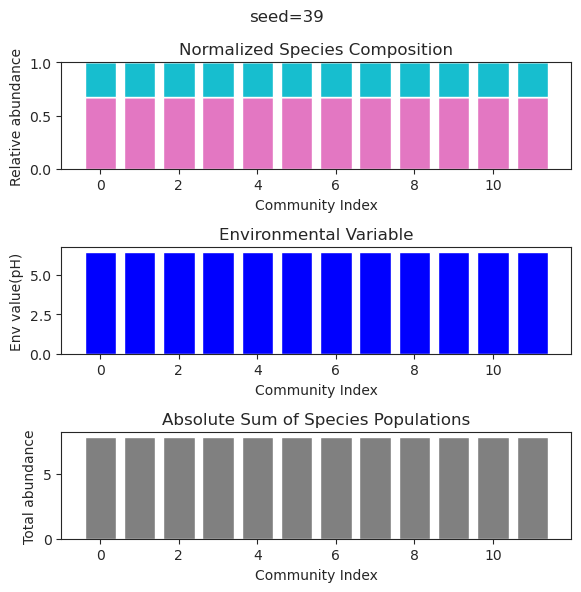

{'species': array([-4.38394115e-028,  3.18502689e-003,  5.39521332e-006,
        4.47739319e-001,  1.69363795e-001,  8.13372496e-001,
       -2.29588521e-101,  9.21251344e-075,  1.54973975e-097,
        2.48148274e-033,  6.69574968e-001,  6.54305350e-002]), 'env': array([0.46054571])}
{'species': array([-2.40717400e-28,  3.18483496e-03,  3.10965138e-06,  4.47740275e-01,
        1.69364775e-01,  8.13374564e-01, -2.25620692e-80, -1.62033140e-61,
       -1.16074675e-28, -2.05672434e-30,  6.69576107e-01,  6.54283127e-02]), 'env': array([0.46054666])}
{'species': array([ 2.09141849e-28,  3.18592777e-03,  1.61238894e-05,  4.47734835e-01,
        1.69359197e-01,  8.13362787e-01, -3.75179621e-35,  3.97308453e-42,
       -1.41717407e-30, -3.23239434e-33,  6.69569624e-01,  6.54409666e-02]), 'env': array([0.46054125])}
{'species': array([-1.18096613e-027,  3.18629309e-003,  2.04746018e-005,
        4.47733016e-001,  1.69357332e-001,  8.13358850e-001,
       -6.13866992e-033, -5.87526667e-070, -3.

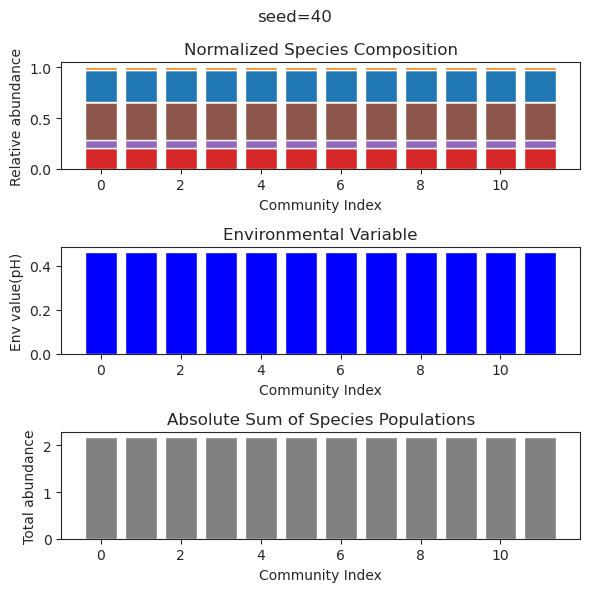

{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        1.68659802e-166, -1.78430582e-089, -1.49486473e-094,
        8.68825636e-036,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -5.36749699e-137,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        3.25607662e-162,  5.99583936e-089,  2.05831234e-090,
       -5.12276880e-037,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -1.21563076e-132,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
       -4.65427624e-159,  1.89973884e-088,  3.03485141e-093,
        3.53125078e-035,  2.12693296e-001,  1.62965287e-001,
        4.55587429e-001, -3.25494747e-127,  6.33654466e-001]), 'env': array([-0.13358845])}
{'species': array([ 6.07914789e-002,  1.90923932e-002,  3.69041555e-001,
        2.26062960e-152,  8.69426407e-090,  1.51384677e-090,
     

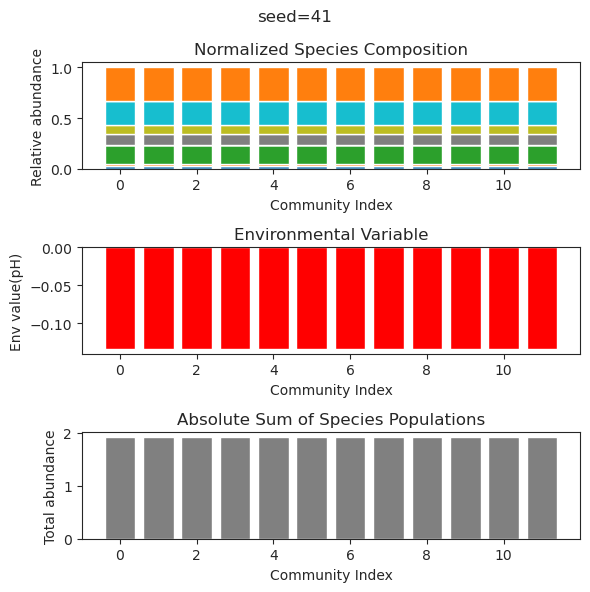

{'species': array([ 1.70219176e-01,  5.84291134e-47,  2.25332336e-16, -3.35532234e-65,
        5.03126153e-01, -8.99580062e-68,  6.83390083e-86, -1.21638839e-78,
        8.05585772e-01, -3.38909086e-32,  5.04967960e-01, -1.88960729e-64]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01,  2.72315667e-36,  3.96842763e-17,  1.00718809e-53,
        5.03126153e-01, -1.48085434e-58,  3.89856694e-94, -2.39752175e-79,
        8.05585772e-01, -1.30742056e-24,  5.04967960e-01,  2.02433831e-58]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-001, -5.86548385e-047,  2.56247994e-017,
        1.54603760e-068,  5.03126153e-001,  7.44927152e-075,
        5.53238021e-111, -2.63863872e-102,  8.05585772e-001,
        1.36232737e-028,  5.04967960e-001,  4.54147125e-075]), 'env': array([-1.28319777])}
{'species': array([ 1.70219176e-01, -2.33280091e-35, -8.58162250e-17,  7.24901190e-46,
        5.03126153e-01,  3.72365161e-49,  3.51771870e-79,  6.67171213e-74,
        8.05585

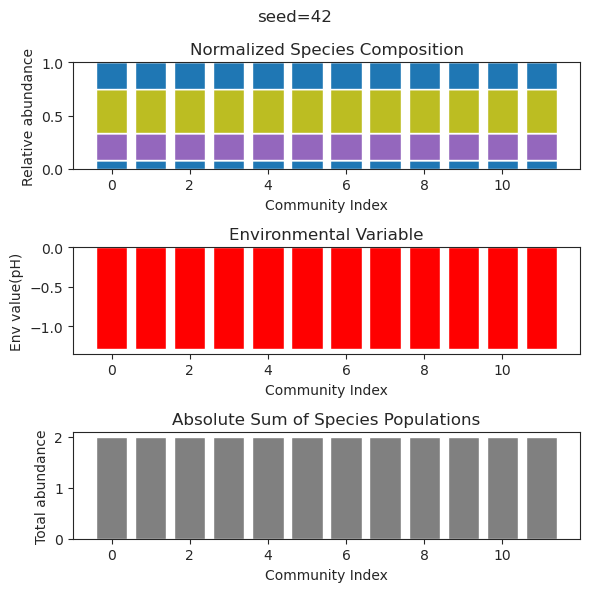

{'species': array([ 3.70637451e-002,  9.47019991e-002,  4.36769081e-052,
        3.21102669e-001, -3.47260257e-107,  7.31744777e-001,
        5.27867436e-011,  7.97500132e-040,  4.80848808e-001,
       -1.20367212e-043, -4.67233044e-103,  7.19333502e-007]), 'env': array([-0.92690604])}
{'species': array([ 2.59826346e-05,  1.16611760e-01, -3.07418721e-36,  2.75291989e-01,
       -3.85807584e-33,  7.28077791e-01,  7.35974985e-02,  1.57517932e-54,
        4.69280327e-01, -2.61426375e-72, -1.45923704e-62,  5.30774229e-02]), 'env': array([-0.68848081])}
{'species': array([ 3.70639361e-02,  9.47018694e-02,  2.59731518e-52,  3.21102434e-01,
        6.82575136e-83,  7.31744814e-01,  3.11975190e-10, -8.06052674e-25,
        4.80849085e-01, -7.06313791e-33,  4.92146743e-88,  4.47016598e-07]), 'env': array([-0.92690674])}
{'species': array([ 3.70560885e-02,  9.47071982e-02, -2.80073942e-42,  3.21112054e-01,
        1.78018624e-76,  7.31743328e-01,  7.61806206e-09, -4.73237036e-37,
        4.80837

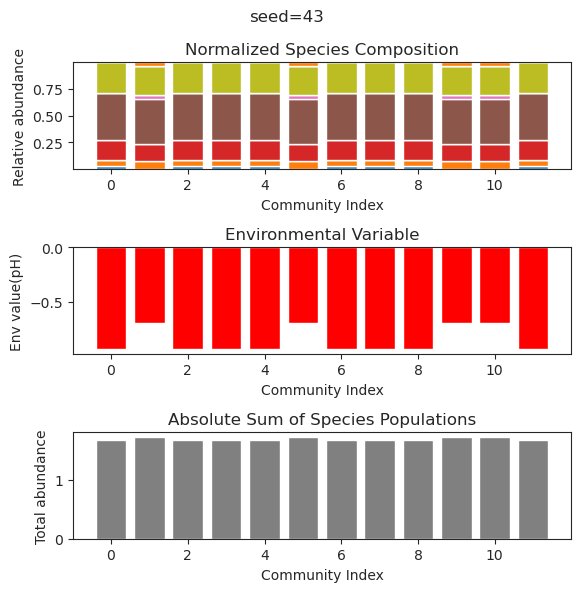

{'species': array([ 1.93721028e-01,  1.49296772e-21,  1.09751873e-24, -4.38828737e-52,
        5.52653737e-53, -1.23747289e-39,  1.07911411e+00, -2.66098236e-47,
       -5.61897820e-53, -5.15398754e-37, -6.62308507e-53,  1.65806917e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01,  1.08639328e-21, -4.93944522e-27,  2.72888951e-57,
       -2.09826542e-53, -8.53533526e-42,  1.07911411e+00,  6.60466529e-51,
       -7.96304666e-59, -1.17091795e-37, -1.18110839e-58, -1.15907688e-30]), 'env': array([-1.90672951])}
{'species': array([ 1.93721028e-01, -2.97360861e-21, -2.09379099e-24, -5.94090541e-50,
        6.20699766e-47, -4.84241676e-37,  1.07911411e+00,  5.65432946e-44,
       -1.07112786e-49, -3.08783737e-33, -8.74128358e-50, -1.39512195e-28]), 'env': array([-1.90672951])}
{'species': array([ 1.97637350e-81, -6.45182690e-75, -2.06397594e-48,  1.93892134e-77,
        5.24859784e-01,  1.49082343e-01, -8.62367998e-82,  7.21941954e-02,
        8.02072037e-01,  1.1140900

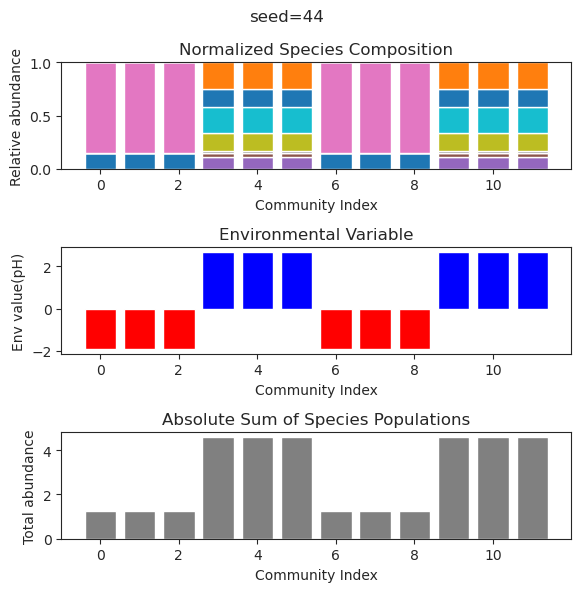

{'species': array([ 1.65415388e-001, -2.61444512e-030,  4.74858776e-100,
        1.36321722e-038,  1.43132933e-026,  4.23041579e-001,
        2.75380819e-019,  9.18862801e-056,  4.97670645e-001,
        3.32591798e-103,  3.57163847e-001,  6.74400436e-059]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -1.74342253e-027, -2.15084556e-132,
       -1.98478715e-044, -5.32947971e-029,  4.23041579e-001,
       -6.39398755e-017, -2.36245795e-075,  4.97670645e-001,
       -1.53987253e-136,  3.57163847e-001,  9.47724967e-070]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001,  2.15166058e-043, -1.37899161e-119,
        1.40935721e-051,  2.93640736e-040,  4.23041579e-001,
        2.22985612e-024,  8.97293939e-079,  4.97670645e-001,
       -1.28687072e-123,  3.57163847e-001, -1.63102655e-069]), 'env': array([-1.35532321])}
{'species': array([ 1.65415388e-001, -2.28701841e-026,  1.73139017e-129,
       -1.04292145e-039, -6.50175027e-023,  4.23041579e-001,
     

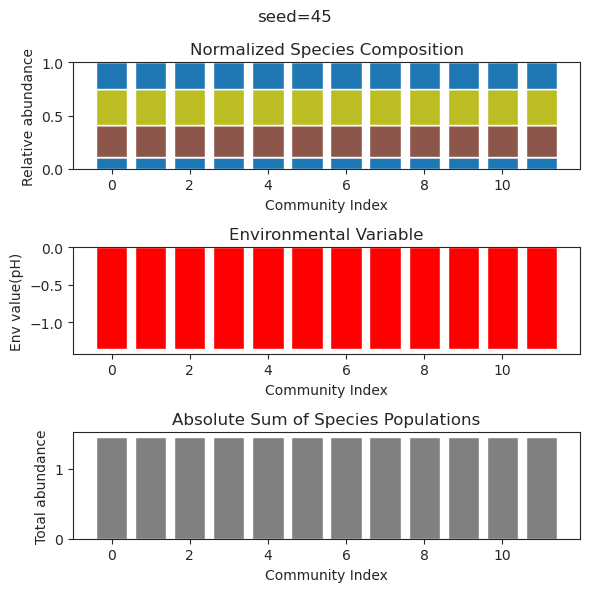

{'species': array([ 1.42735984e-01,  2.24228053e-01, -1.52584418e-24,  6.58798994e-59,
        3.71925201e-57,  2.11329452e-89, -8.05692881e-87, -5.01073246e-93,
        7.84352179e-44,  1.53395552e-62,  4.07810065e-62, -2.33842937e-81]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  3.92949282e-28, -1.34822244e-43,
       -1.55277063e-41,  8.28722865e-57,  2.38301635e-54,  1.51384606e-52,
        3.29362330e-37, -2.61053590e-43, -3.11514331e-45,  4.43825342e-51]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01, -4.67856504e-28,  5.99783275e-61,
       -4.41818236e-53, -9.40090028e-87, -1.63604229e-82, -1.06382214e-88,
        3.79367539e-42, -1.40118820e-59,  1.18042414e-64, -6.78113866e-78]), 'env': array([-3.57458245])}
{'species': array([ 1.42735984e-01,  2.24228053e-01,  2.36328576e-26, -1.28738910e-46,
        4.61473801e-44, -1.39814890e-60,  2.66283755e-61, -9.53754667e-55,
        3.80651654e-37, -2.7522696

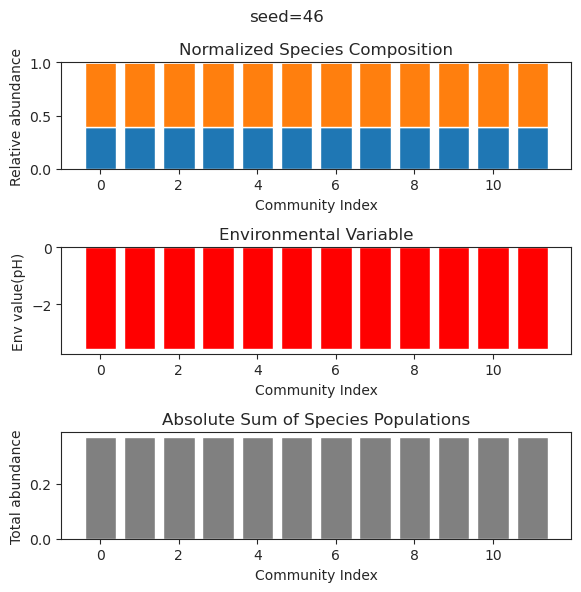

{'species': array([-2.70921514e-49,  2.66745012e-01,  8.56702059e-41,  1.24644904e-45,
        1.25604242e+00, -8.29023172e-51, -3.58830578e-20, -2.02981626e-30,
        2.98131620e-49,  2.10506749e-01,  8.91713419e-44,  1.37274074e-37]), 'env': array([-2.36754003])}
{'species': array([-1.83645196e-54,  2.66745012e-01, -1.28518465e-39,  7.65653129e-42,
        1.25604242e+00, -3.91782353e-51,  5.18162893e-20,  7.06547665e-27,
       -2.60425463e-49,  2.10506749e-01,  4.70852770e-46,  4.81039748e-36]), 'env': array([-2.36754003])}
{'species': array([ 3.65323377e-47,  2.66745012e-01,  2.65049927e-38, -8.15619284e-43,
        1.25604242e+00,  1.38054541e-49, -3.19820233e-19,  9.96187593e-28,
        1.93354164e-46,  2.10506749e-01, -8.47396445e-42,  3.13640898e-35]), 'env': array([-2.36754003])}
{'species': array([ 2.96907414e-48,  2.66745012e-01,  6.18547371e-41, -1.38742584e-39,
        1.25604242e+00, -4.80519190e-51, -1.37162309e-20, -1.21412898e-28,
        1.46903786e-48,  2.1050674

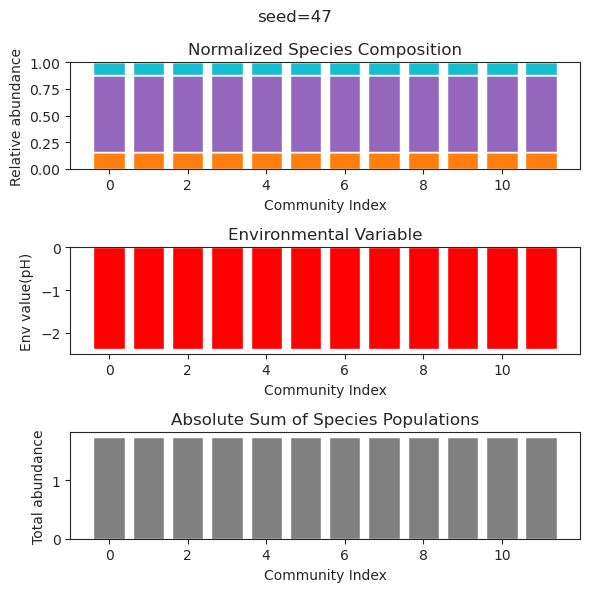

{'species': array([ 7.38946471e-22,  2.18727783e-01, -1.23591662e-45,  1.90655241e-35,
       -3.79960599e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        3.06768169e-21,  9.79936038e-44, -4.25586613e-28,  3.88747026e-28]), 'env': array([-1.38137804])}
{'species': array([ 7.99762140e-22,  2.18727783e-01,  9.89333825e-51,  3.69184577e-38,
       -1.37052354e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.60408540e-22,  8.42202109e-47, -6.43641190e-28, -1.14790721e-25]), 'env': array([-1.38137804])}
{'species': array([ 4.43359351e-19,  2.18727783e-01, -4.41475350e-48,  6.65971007e-36,
       -7.72741415e-42,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        8.92376809e-20, -2.76055913e-46, -7.52149694e-27,  2.69601920e-24]), 'env': array([-1.38137804])}
{'species': array([ 5.52469468e-20,  2.18727783e-01, -1.66520964e-48,  4.16804122e-38,
        1.88629535e-45,  6.28043919e-01,  3.60472631e-01,  3.72134139e-01,
        2.96418814e-21,  6.8420812

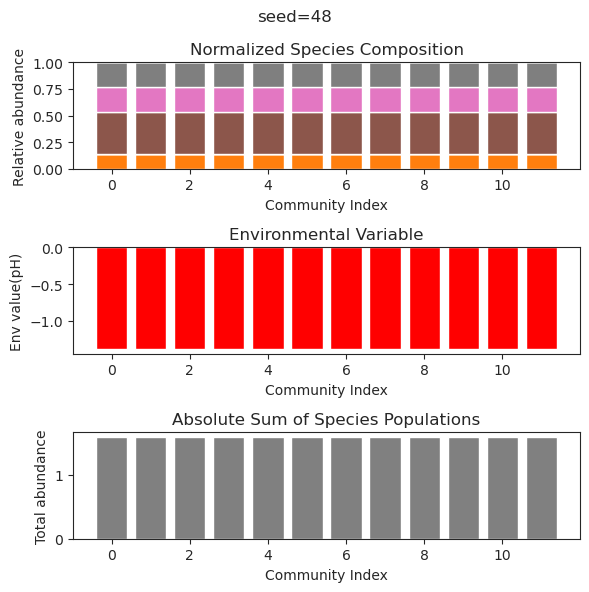

{'species': array([-5.70125622e-43, -3.91067811e-43,  6.94517771e-01,  8.46874185e-48,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        5.53739002e-30,  2.65940084e-60,  8.40903658e-54, -1.81321960e-16]), 'env': array([0.4773813])}
{'species': array([ 2.05233327e-36,  1.20252187e-36,  6.94517771e-01,  5.74488921e-41,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -1.37998158e-23,  2.84532090e-55,  2.25875153e-42, -1.66686074e-13]), 'env': array([0.4773813])}
{'species': array([ 4.73729226e-40,  2.94800596e-37,  6.94517771e-01, -7.70534143e-37,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
       -2.98884285e-22, -4.80277575e-65, -4.53978283e-41,  9.98084826e-17]), 'env': array([0.4773813])}
{'species': array([ 2.51606185e-41,  9.43074933e-44,  6.94517771e-01,  4.04794977e-53,
        3.42961470e-01,  1.86898927e-01,  6.69659608e-01,  4.98834597e-01,
        3.39328130e-37, -1.18782677e-56,

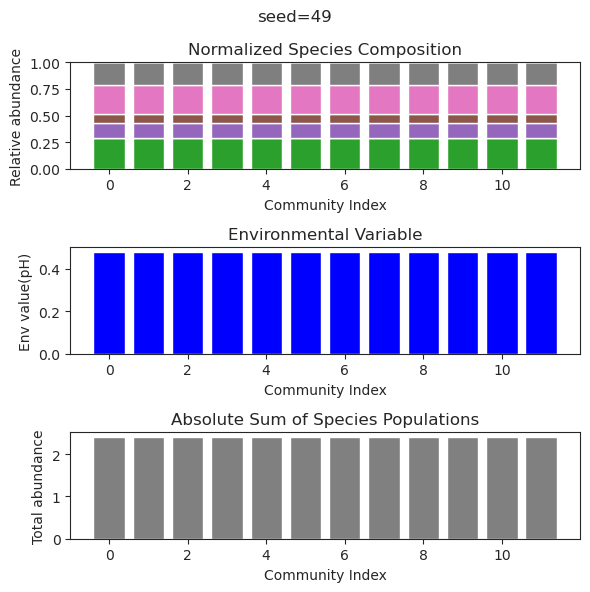

{'species': array([ 1.83611694e-01,  3.93639132e-32, -1.49797773e-72,  2.61670418e-33,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -9.05628398e-34,
        1.44716854e-02,  2.78487981e-01, -1.15001798e-56,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  2.40160802e-35,  8.28832719e-97, -1.01846748e-22,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -6.32662358e-41,
        1.44716854e-02,  2.78487981e-01,  2.35006241e-82,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01,  9.64224303e-34, -2.42598680e-78,  3.05819723e-24,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -2.96774367e-37,
        1.44716854e-02,  2.78487981e-01,  7.19992855e-61,  4.29274722e-01]), 'env': array([-1.06024593])}
{'species': array([ 1.83611694e-01, -4.03212473e-27,  1.93484639e-59, -1.06989729e-27,
        1.22255632e-01,  1.56963311e-01,  3.75898622e-01, -1.54160992e-30,
        1.44716854e-02,  2.7848798

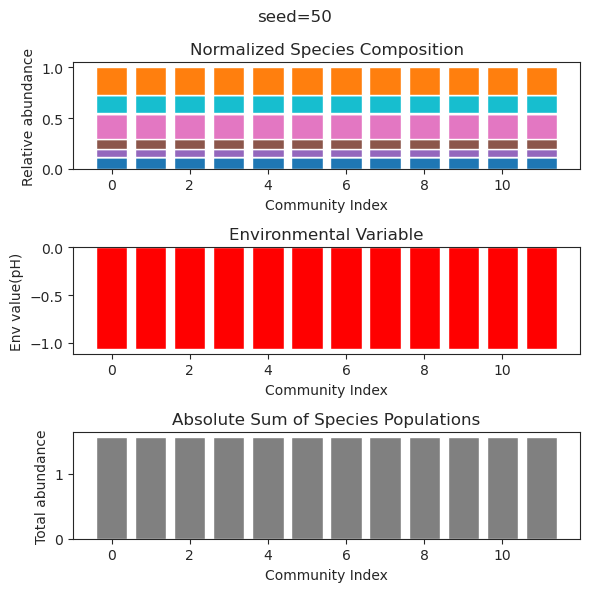

{'species': array([ 2.71522970e-01,  1.00406074e-01, -1.20131957e-92,  2.86437778e-30,
       -5.96755551e-46,  1.59066134e-59,  1.03971369e-59,  2.99520524e-56,
        1.98930571e-32,  7.02917821e-62, -2.16923882e-46,  1.43663179e-94]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  2.68420528e-59,  5.47457723e-27,
        1.37306325e-33,  6.31401556e-38,  2.51744039e-37,  4.77680182e-37,
       -2.21302420e-28,  7.21508350e-40,  7.85702427e-34,  2.91460767e-58]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01,  4.45034679e-78,  1.55562521e-28,
       -3.30937434e-39,  3.76963882e-51,  5.56683419e-51, -1.63534586e-47,
        2.04614554e-29,  8.32429168e-55, -1.22214676e-41,  2.04517031e-79]), 'env': array([-3.61993828])}
{'species': array([ 2.71522970e-01,  1.00406074e-01, -3.68916990e-75,  1.56515442e-29,
        1.94637222e-39,  3.50752235e-50,  1.30470712e-50,  1.41767261e-48,
       -5.14268265e-32,  9.1491389

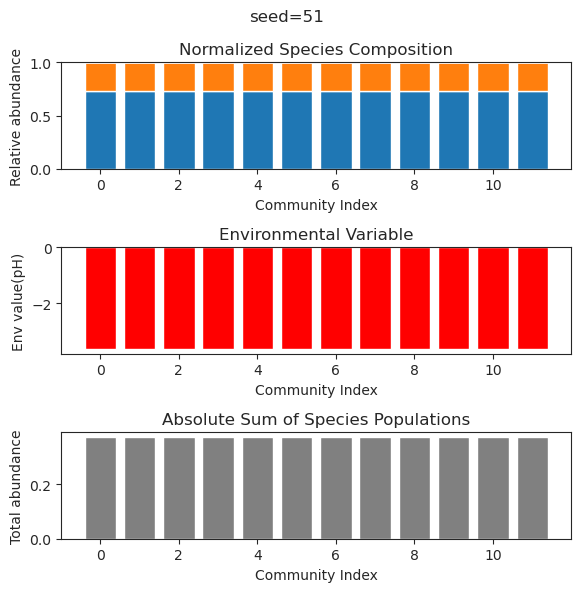

{'species': array([ 3.24313946e-01, -8.28550999e-39,  5.66663239e-54,  1.82702900e-01,
        8.12363503e-01, -7.25456882e-50,  3.26778020e-01, -1.09061561e-53,
        7.61363273e-27, -4.89325206e-36, -1.44341791e-44, -4.28030411e-43]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -4.23618028e-56, -3.74957531e-72,  1.82702900e-01,
        8.12363503e-01, -1.55505931e-73,  3.26778020e-01, -5.56714266e-76,
       -4.38135129e-29,  4.49435077e-51, -1.43207885e-52,  2.28860127e-66]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01, -1.77275301e-64,  2.84030422e-80,  1.82702900e-01,
        8.12363503e-01, -1.69248353e-81,  3.26778020e-01,  8.75243456e-84,
       -6.83687400e-30, -6.77330987e-57,  1.13292784e-53, -6.03192401e-73]), 'env': array([-2.32622876])}
{'species': array([ 3.24313946e-01,  1.10220887e-43,  4.70912431e-61,  1.82702900e-01,
        8.12363503e-01, -2.60784166e-59,  3.26778020e-01, -6.10225229e-57,
        4.55304300e-24,  1.1092327

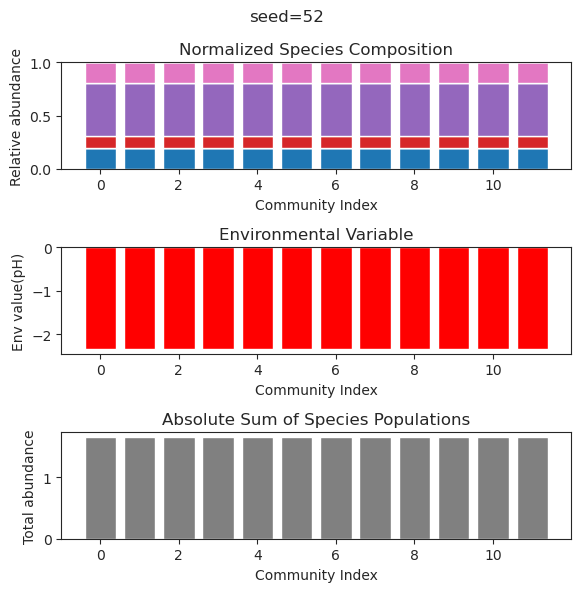

{'species': array([ 1.49434133e-01, -3.66561250e-46, -7.68725264e-47,  6.73742042e-01,
       -7.16715929e-22,  5.51643297e-73, -6.89139553e-22, -6.73507391e-78,
        6.78509122e-01,  7.94296740e-46,  5.90605525e-01, -7.04458552e-23]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -9.98072931e-39, -1.23140922e-40,  6.73742042e-01,
        1.67426735e-20,  4.09188209e-57, -8.18975089e-23, -2.99366616e-62,
        6.78509122e-01, -2.45714447e-42,  5.90605525e-01,  3.74301965e-29]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01,  4.51930422e-48,  2.00569617e-49,  6.73742042e-01,
        2.48470507e-19,  1.32576398e-68, -3.95714625e-26,  2.17926086e-76,
        6.78509122e-01, -1.45462442e-43,  5.90605525e-01,  2.59733045e-28]), 'env': array([-1.04641312])}
{'species': array([ 1.49434133e-01, -8.59254314e-42, -1.38162286e-44,  6.73742042e-01,
       -3.75005451e-18,  4.76400977e-62, -2.58383140e-20, -1.04074583e-64,
        6.78509122e-01,  6.5751347

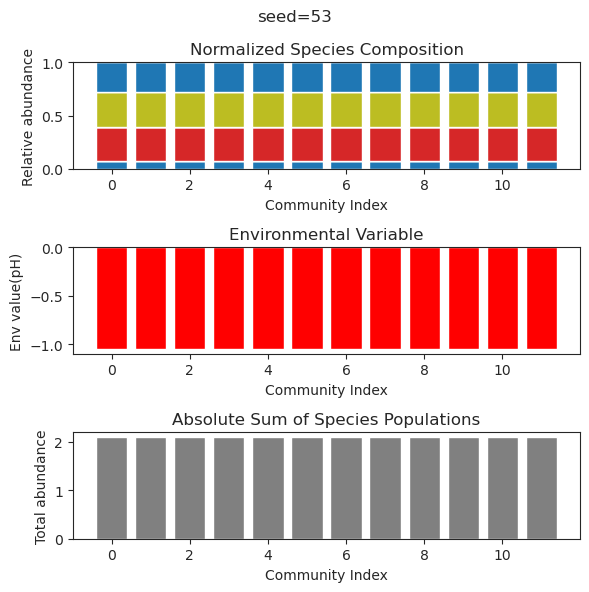

{'species': array([-4.68409762e-43,  2.79648916e-01, -8.99092628e-59, -3.55016982e-15,
       -1.69811967e-37,  4.55161611e-01, -1.24621300e-70, -1.03097112e-40,
       -8.04503656e-67,  1.29529608e-64,  1.15012755e-23,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.40865870e-54,  2.79648916e-01, -2.36212755e-67, -2.49237713e-16,
        1.36354163e-44,  4.55161611e-01, -3.70698114e-87, -1.97294638e-50,
       -3.79086286e-81,  3.87523761e-80,  5.74291805e-29,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 3.38824489e-41,  2.79648916e-01, -3.86105028e-53, -2.07066540e-14,
        6.52554066e-40,  4.55161611e-01,  1.27999720e-30, -2.85920644e-39,
       -4.82277419e-63,  2.79259819e-56, -2.15045946e-20,  3.85113997e-01]), 'env': array([-2.71016514])}
{'species': array([ 1.80534954e-37, -5.07383336e-39, -8.58983747e-85,  7.05570052e-11,
        4.91105759e-01,  1.85633435e-01,  4.21680989e-01,  8.12678826e-01,
        4.98987686e-01,  1.0325476

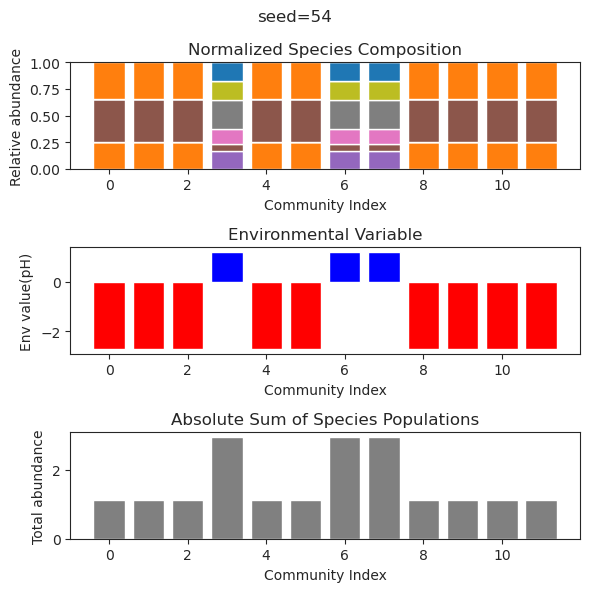

{'species': array([ 1.89845510e-01,  5.66280472e-56,  7.85624941e-01,  5.19391996e-01,
        6.60558185e-53,  3.60965262e-60,  6.36073784e-55, -5.19518826e-42,
        2.35601374e-01,  7.21281663e-32,  1.17624347e-59,  9.10761368e-49]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.12298625e-58,  7.85624941e-01,  5.19391996e-01,
       -3.98600321e-54,  4.11600551e-60, -2.41136592e-57, -4.41496974e-43,
        2.35601374e-01,  1.57457504e-32, -1.43058204e-58,  2.08255839e-52]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01,  1.02652681e-56,  7.85624941e-01,  5.19391996e-01,
       -1.23043749e-53,  2.40262451e-57, -3.25827571e-54, -3.24273919e-40,
        2.35601374e-01, -6.76721973e-32,  2.62481354e-58,  2.81859437e-44]), 'env': array([-1.39265398])}
{'species': array([ 1.89845510e-01, -1.82869818e-54,  7.85624941e-01,  5.19391996e-01,
        5.76861904e-50,  1.49878242e-56,  1.42184263e-53,  5.38147349e-42,
        2.35601374e-01,  4.7312796

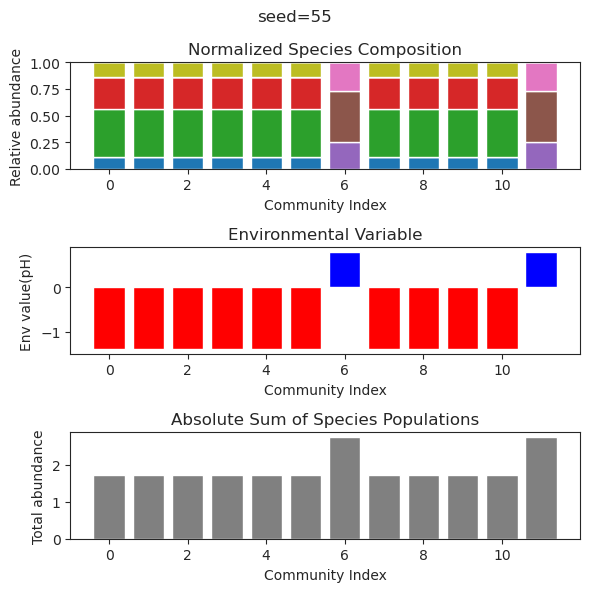

{'species': array([ 2.05647123e-01, -7.67229426e-44, -3.14572735e-24,  2.28088839e-19,
        6.17838615e-01, -4.43888333e-59,  8.37945295e-01,  8.86994899e-19,
        3.21417343e-24,  2.42727266e-44,  1.59225779e-50, -2.12798400e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01, -1.30097092e-42, -6.98128978e-30, -2.80788785e-20,
        6.17838615e-01,  5.30339108e-61,  8.37945295e-01, -4.15954182e-20,
       -1.57178012e-23, -4.03834602e-48,  4.52997563e-52, -4.04587444e-30]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  1.97209948e-38,  2.92880186e-24, -8.51501981e-21,
        6.17838615e-01,  1.32464416e-53,  8.37945295e-01, -1.29850634e-19,
       -6.34097851e-21,  5.47681226e-36, -1.53500905e-42,  2.25168949e-27]), 'env': array([-1.83838899])}
{'species': array([ 2.05647123e-01,  6.62323705e-46,  1.31392120e-30, -1.60558008e-21,
        6.17838615e-01, -1.28637391e-64,  8.37945295e-01, -1.11330520e-20,
       -3.50151303e-24, -1.1565225

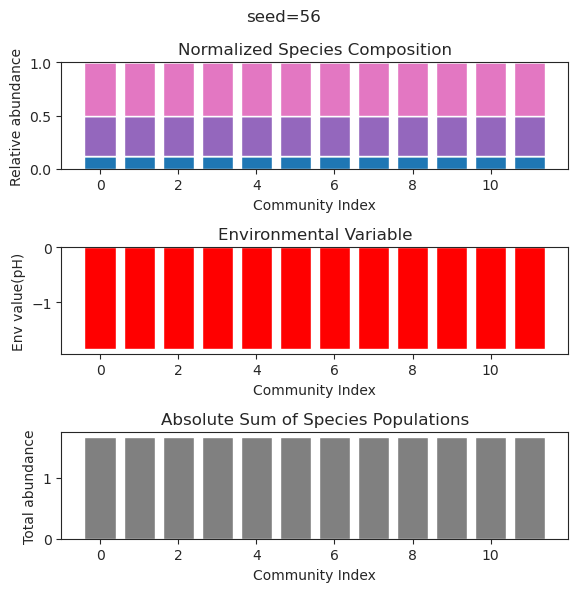

{'species': array([-2.40318279e-021,  3.63361845e-001, -3.11139587e-110,
        1.16150293e-001,  4.73166312e-036, -5.71365966e-115,
        1.60005646e-026, -7.12610855e-106,  1.26608549e-059,
        1.00710839e+000, -5.28235187e-068, -3.41613644e-112]), 'env': array([-2.66065866])}
{'species': array([-5.02975817e-29,  3.63361845e-01,  4.08834918e-67,  1.16150293e-01,
       -1.83899633e-38, -9.34789036e-71, -9.03837427e-32,  2.17921286e-71,
        1.95362015e-47,  1.00710839e+00, -7.83286995e-52,  1.14376972e-67]), 'env': array([-2.66065866])}
{'species': array([ 2.12252842e-23,  3.63361845e-01,  2.27122595e-74,  1.16150293e-01,
       -3.27389882e-35,  9.61080294e-73,  1.85137097e-22,  3.03706153e-83,
        3.49446441e-45,  1.00710839e+00,  3.31713431e-54,  2.00458483e-71]), 'env': array([-2.66065866])}
{'species': array([ 6.64377368e-21,  3.63361845e-01,  2.41226115e-85,  1.16150293e-01,
        3.31874958e-41,  1.01775370e-83, -1.18011889e-28, -1.45435794e-89,
       -6.94132

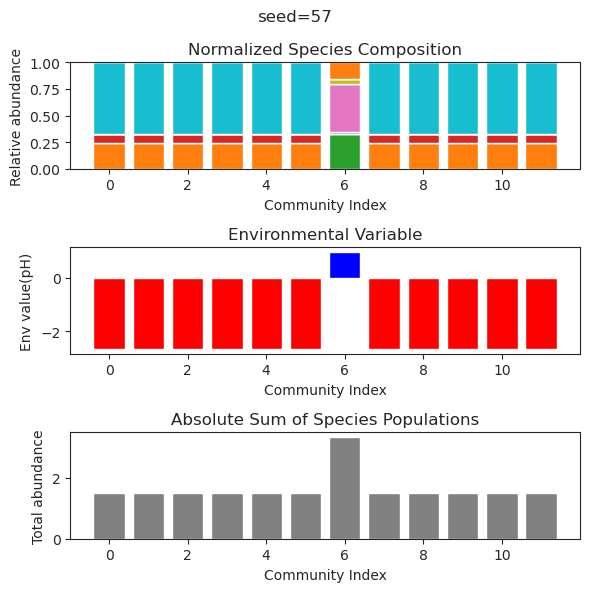

{'species': array([ 1.08581536e-25,  2.59634563e-01, -1.44356620e-47,  3.44924637e-35,
       -2.22887877e-45,  7.01260954e-27, -1.80178574e-43, -1.87358944e-40,
        7.86565487e-01,  8.49587982e-27,  1.64764166e-45,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([-3.83544010e-31,  2.59634563e-01, -6.45013780e-53,  2.15274137e-46,
        5.14836360e-56,  1.35637438e-24, -1.54017001e-54, -5.16788944e-48,
        7.86565487e-01, -2.86353832e-26, -2.56145393e-53,  4.03153186e-01]), 'env': array([-1.98461469])}
{'species': array([ 2.25981924e-85, -9.85731465e-85,  4.60259863e+00,  2.91146366e-68,
        4.91263588e-85,  2.95812250e+00,  6.60069441e-60, -1.92738986e-59,
        1.54742018e-58,  3.08589618e+00,  2.38901811e-01,  2.15993198e-82]), 'env': array([6.86816846])}
{'species': array([-4.82099234e-23,  2.59634563e-01,  1.53854243e-38, -2.58858669e-32,
       -1.89039205e-40,  2.90121833e-28, -7.22691266e-36,  4.17382380e-31,
        7.86565487e-01, -4.98798914

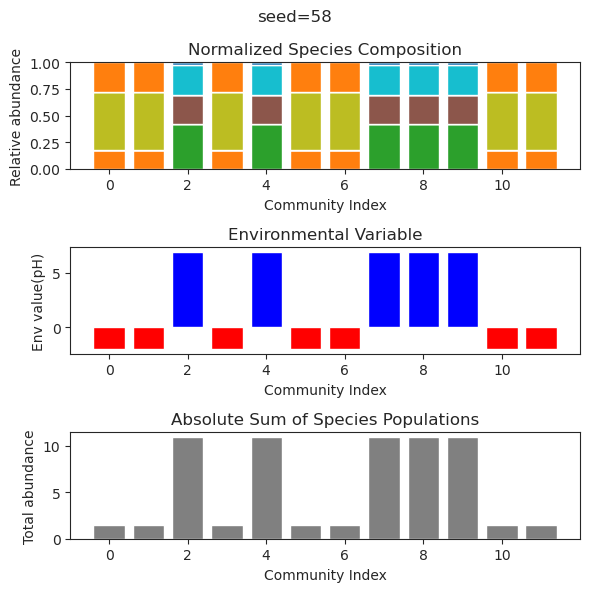

{'species': array([-1.55487565e-32,  2.50610839e-01,  6.88994671e-02,  8.09344565e-51,
        3.69640607e-48, -1.20323357e-56,  2.21425479e-45,  3.97678472e-01,
        5.00151071e-26,  6.76860949e-01, -3.13208392e-43, -2.34317834e-62]), 'env': array([-2.03466633])}
{'species': array([ 5.26031026e-32,  2.50610839e-01,  6.88994671e-02, -6.37049511e-48,
       -6.42347095e-38, -2.15124745e-54,  3.17074550e-43,  3.97678472e-01,
       -5.71317148e-24,  6.76860949e-01, -1.61235624e-35, -1.12889685e-58]), 'env': array([-2.03466633])}
{'species': array([-6.87513160e-036,  2.50610839e-001,  6.88994671e-002,
        4.15294878e-083, -1.52205944e-057, -1.49319353e-102,
       -3.39306023e-072,  3.97678472e-001, -4.77884722e-027,
        6.76860949e-001,  1.05816908e-054, -3.18647008e-089]), 'env': array([-2.03466633])}
{'species': array([-1.35305198e-29,  2.50610839e-01,  6.88994671e-02, -2.39135848e-47,
        4.50224794e-42, -6.80504320e-56,  1.57921437e-45,  3.97678472e-01,
        1.67081

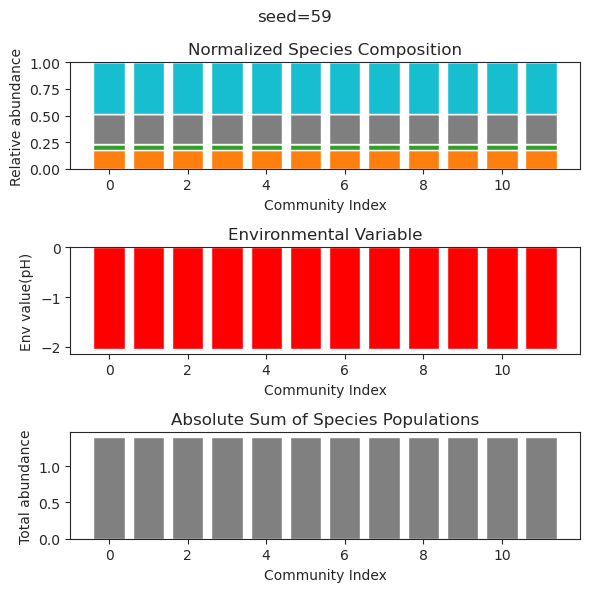

{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.27314955e-28,
        3.91401255e-48, -2.09694400e-19,  4.26182769e-42,  6.08912939e-46,
       -1.84177942e-35,  5.02857012e-01,  3.05428950e-51,  4.06941544e-49]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  1.22277228e-27,
       -1.66061771e-44,  5.74636238e-19,  8.42396260e-39,  2.55279985e-43,
        3.35182461e-31,  5.02857012e-01, -1.05772914e-49, -3.38366971e-47]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01,  8.82152037e-28,
       -2.60137675e-44,  2.83799406e-19, -1.55427576e-37,  1.86504830e-42,
       -6.34730296e-32,  5.02857012e-01,  1.14764973e-50, -5.54212473e-46]), 'env': array([-2.92960594])}
{'species': array([ 1.24652952e-01,  2.58714867e-01,  5.53900284e-01, -4.61787209e-30,
        1.29747658e-47,  2.72111573e-22, -9.84174792e-42,  9.93150068e-45,
        5.29076049e-33,  5.0285701

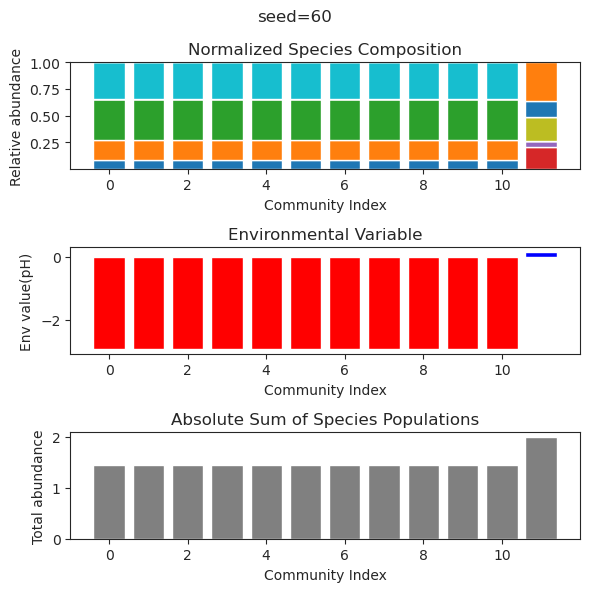

{'species': array([ 7.31579985e-02, -1.07240505e-59, -1.03488136e-25,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02, -4.82183120e-17, -4.81713997e-72,
        4.57216927e-01,  1.32902744e-01, -6.46391390e-60,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 7.31579985e-02,  5.71451025e-52,  4.18424627e-32,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.91541435e-22, -3.71471727e-67,
        4.57216927e-01,  1.32902744e-01,  4.18953954e-55,  1.15002850e-01]), 'env': array([-0.28995595])}
{'species': array([ 1.33907715e-089,  6.28210147e-033,  5.42264459e-001,
        1.11194987e-016,  7.93225033e-001,  4.99930126e-002,
        4.60080434e-062,  1.27853706e-001,  4.18937496e-001,
        1.55359911e-026, -5.19199123e-073, -1.36945949e-115]), 'env': array([0.46452164])}
{'species': array([ 7.31579985e-02, -1.47543560e-56, -2.44464743e-24,  4.17369582e-01,
        4.34891241e-01,  7.58058592e-02,  3.00470983e-17, -1.07928393e-66,
        4.572169

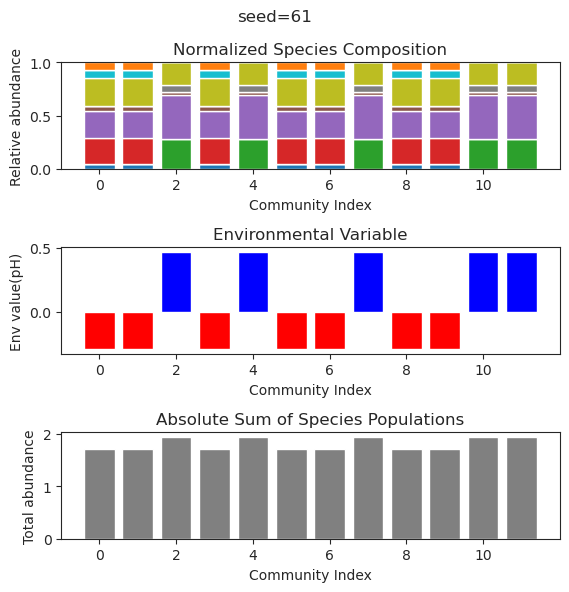

{'species': array([ 9.17053020e-32,  2.00656323e-01,  5.06644839e-01, -2.04866865e-41,
        5.11725003e-01,  6.23498393e-60,  2.19647967e-01, -8.67559025e-58,
       -2.26185341e-40, -4.87169905e-29,  9.09122633e-56,  1.39561452e-51]), 'env': array([-1.39995615])}
{'species': array([ 5.33310334e-34,  2.00656323e-01,  5.06644839e-01,  1.08572278e-39,
        5.11725003e-01, -1.05519829e-58,  2.19647967e-01,  5.21684230e-61,
       -4.44736745e-39, -1.25791817e-32, -5.35893018e-55, -3.34709638e-54]), 'env': array([-1.39995615])}
{'species': array([ 1.43898133e-64, -8.60800694e-31,  3.40237724e-77,  1.20463001e+00,
       -2.73052874e-44,  7.51650002e-01, -1.13876843e-54,  7.11307186e-49,
        1.48038319e+00, -7.92693502e-31,  2.40720931e+00,  7.21773591e-01]), 'env': array([2.90109328])}
{'species': array([-9.15045668e-30,  2.00656323e-01,  5.06644839e-01,  2.42452713e-34,
        5.11725003e-01,  5.74046502e-44,  2.19647967e-01, -1.19407739e-45,
       -1.19392929e-37,  2.26113811

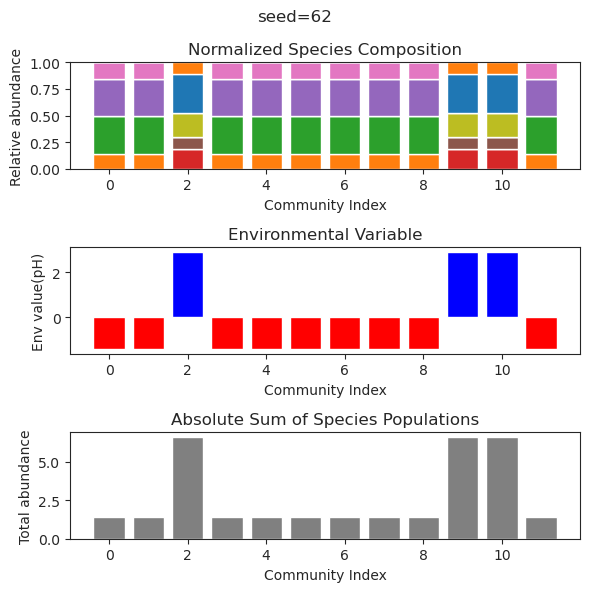

{'species': array([ 1.42025653e-01, -8.10862894e-70,  1.41481884e-63,  8.04843223e-01,
        2.40129056e-71,  1.63126232e-83,  3.24575655e-01, -2.65728430e-59,
       -3.44405534e-34,  3.19902540e-01, -1.76703139e-68,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  2.23826661e-61,  5.62615543e-58,  8.04843223e-01,
       -3.88041143e-61, -1.07888187e-72,  3.24575655e-01,  1.33416733e-54,
       -2.42791102e-29,  3.19902540e-01,  1.90420660e-60,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01, -2.51344453e-69,  4.20678332e-62,  8.04843223e-01,
        2.23944296e-67, -3.81843579e-94,  3.24575655e-01,  1.46036818e-61,
        2.62451786e-33,  3.19902540e-01,  1.25009077e-71,  1.84272450e-01]), 'env': array([-0.98136654])}
{'species': array([ 1.42025653e-01,  5.82992155e-35, -6.77012170e-31,  8.04843223e-01,
       -1.96174756e-35,  2.03136714e-39,  3.24575655e-01,  6.70878619e-27,
       -2.07460808e-19,  3.1990254

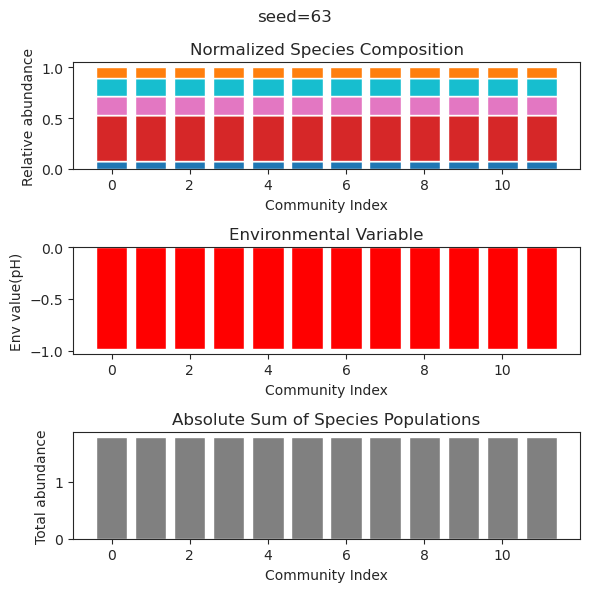

{'species': array([ 1.91595882e-01, -1.00743989e-24, -1.10240324e-70,  6.31565176e-21,
       -4.04052580e-47,  4.75372120e-01,  5.79578592e-01,  2.58930094e-72,
        3.20120327e-01,  2.21743661e-60,  2.47603972e-27, -1.46394378e-18]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01, -2.23044193e-23, -8.76156723e-71, -9.98744011e-19,
       -3.92366359e-68,  4.75372120e-01,  5.79578592e-01, -2.90590603e-66,
        3.20120327e-01, -1.24277087e-66, -2.36627803e-28, -1.16699442e-16]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-01,  4.05927667e-19,  8.38018037e-63, -2.39790490e-16,
       -1.82028335e-63,  4.75372120e-01,  5.79578592e-01,  3.17660286e-59,
        3.20120327e-01,  5.33878165e-58, -1.30281270e-23, -1.01807194e-14]), 'env': array([-1.54369621])}
{'species': array([ 1.91595882e-001, -9.78201045e-021,  1.39917164e-106,
       -6.46785908e-017, -4.00035789e-109,  4.75372120e-001,
        5.79578592e-001, -7.76879569e-095,  3.20120327e-001,
 

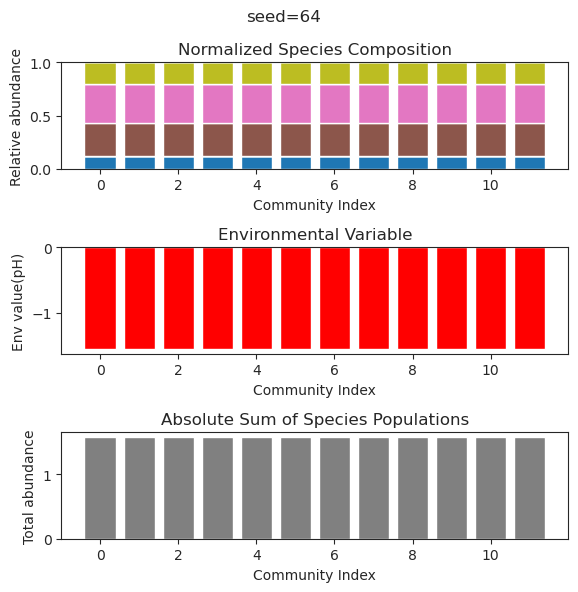

{'species': array([-1.34224116e-36,  2.16196025e-01, -1.81210804e-21,  3.50017936e-01,
       -5.82028759e-35,  7.46499102e-32,  1.21686783e+00,  3.97612131e-41,
        2.49494925e-33, -2.27004295e-52, -1.68320959e-53,  1.74670254e-40]), 'env': array([-2.11688393])}
{'species': array([ 6.95701205e-36,  2.16196025e-01, -1.13330931e-19,  3.50017936e-01,
       -3.27490819e-28,  8.43560146e-28,  1.21686783e+00,  1.56561470e-32,
       -2.58194091e-28,  7.64763792e-46,  8.60373009e-50, -7.47669919e-33]), 'env': array([-2.11688393])}
{'species': array([-3.70465243e-34,  2.16196025e-01, -2.93757538e-20,  3.50017936e-01,
        9.07509131e-27,  3.50058944e-25,  1.21686783e+00,  1.14397736e-31,
        2.10180520e-27, -1.94637442e-45, -4.92426770e-48, -3.61510749e-33]), 'env': array([-2.11688393])}
{'species': array([-6.01125956e-33,  2.16196025e-01,  2.03207741e-20,  3.50017936e-01,
        3.70238038e-36,  2.89159177e-30,  1.21686783e+00, -8.59492757e-35,
        5.34900789e-34,  2.2620443

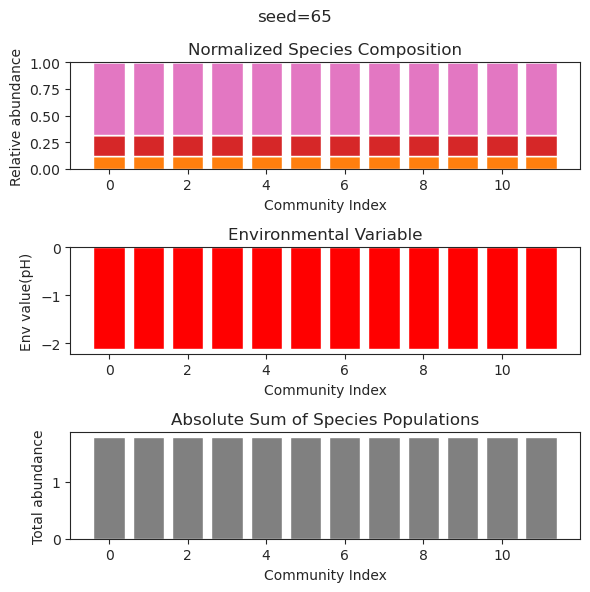

{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        5.75724079e-279, -5.90470986e-104,  2.82127590e-001,
        0.00000000e+000, -1.86329270e-059, -2.42913886e-089]), 'env': array([2.56084017])}
{'species': array([-2.70560417e-039,  0.00000000e+000,  3.31323314e+000,
        4.90107730e-076,  2.69957716e+000, -1.35991906e-281,
        

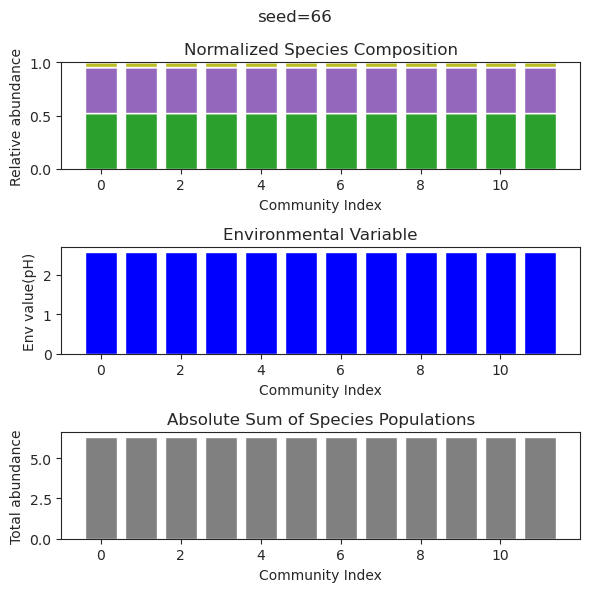

{'species': array([ 1.31416750e-056,  1.49881745e-001,  9.64459817e-058,
       -1.49632156e-196,  2.54420824e-003, -2.10426379e-098,
       -6.92073554e-059,  5.95152641e-001, -2.71822500e-047,
        7.63113429e-047,  1.65298345e-001,  7.37796168e-001]), 'env': array([-0.73797057])}
{'species': array([-4.23910290e-062,  1.49881899e-001, -7.93671912e-197,
       -5.64246851e-190,  2.53087983e-003,  3.07503515e-103,
        5.76468236e-078,  5.95154090e-001, -2.44723946e-067,
       -1.72423278e-104,  1.65301447e-001,  7.37797727e-001]), 'env': array([-0.73797367])}
{'species': array([-3.50017965e-047,  1.49881811e-001, -1.12565018e-181,
       -2.02166744e-171,  2.53851012e-003, -8.24233531e-061,
        4.78313325e-061,  5.95153260e-001,  6.58703858e-105,
       -6.09902637e-050,  1.65299671e-001,  7.37796834e-001]), 'env': array([-0.73797189])}
{'species': array([ 2.87883702e-070,  1.49881742e-001,  2.10312851e-181,
       -2.74148602e-176,  2.54453968e-003,  1.38161796e-069,
     

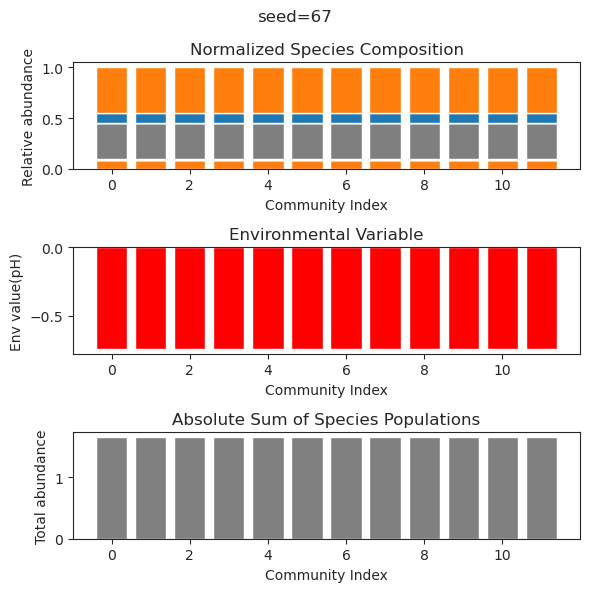

{'species': array([ 3.45451819e-062,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -5.53891234e-122,  2.70175013e-084,
        3.37615909e-001,  5.27482209e-023, -1.97509197e-051,
        7.02635036e-001,  4.35343086e-023, -1.64207912e-122]), 'env': array([-0.99263947])}
{'species': array([-2.27078707e-061,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001, -2.50315539e-126,  6.37982329e-086,
        3.37615909e-001,  2.50758729e-023, -1.96328044e-051,
        7.02635036e-001,  1.79874626e-024, -2.02493301e-126]), 'env': array([-0.99263947])}
{'species': array([-2.17085261e-060,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  4.93297101e-114, -6.68175020e-081,
        3.37615909e-001,  1.39373971e-021,  1.71401614e-049,
        7.02635036e-001,  1.50698408e-022,  4.91014238e-115]), 'env': array([-0.99263947])}
{'species': array([-9.31398169e-059,  1.81557171e-001,  7.11007781e-002,
        3.82782940e-001,  1.40061557e-110,  1.11102308e-081,
     

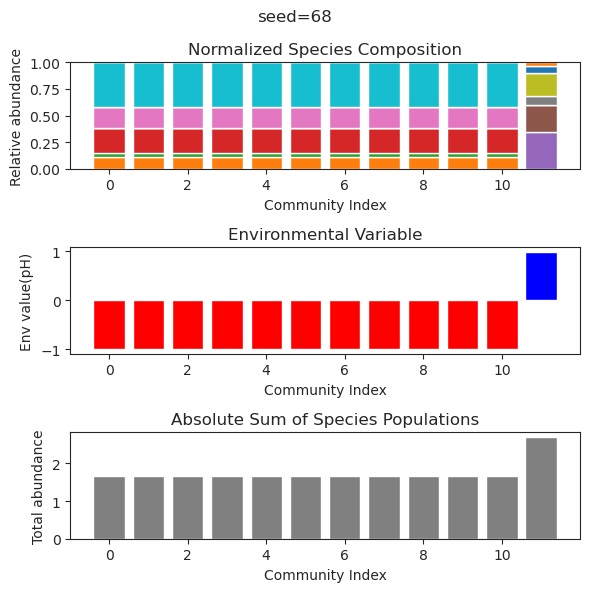

{'species': array([4.63205229e-002, 9.55941928e-002, 6.13410095e-001, 3.65329781e-001,
       6.10003514e-002, 1.71127145e-033, 7.16431768e-109, 2.02014306e-001,
       2.25753074e-002, 3.34802033e-152, 2.59027890e-001, 4.31955963e-166]), 'env': array([-0.61015344])}
{'species': array([ 4.63205251e-002,  9.55941859e-002,  6.13410111e-001,
        3.65329794e-001,  6.10003356e-002,  1.90966628e-029,
       -2.63778705e-084,  2.02014261e-001,  2.25753322e-002,
        7.18503037e-123,  2.59027875e-001,  5.86705626e-176]), 'env': array([-0.61015345])}
{'species': array([ 1.92132499e-01,  2.03027226e-29,  8.64779268e-01,  4.06395184e-32,
        1.62219476e-01,  5.22619559e-02,  5.84052938e-29,  7.16233935e-62,
        9.58090549e-04,  8.47282266e-30,  1.51182592e-01, -6.08732759e-27]), 'env': array([-1.44615817])}
{'species': array([-7.93571950e-42, -2.51760820e-62,  4.54103188e-82,  1.12386289e+00,
        4.43386655e-73, -9.67528822e-56,  1.06646459e+00,  1.71755071e+00,
        4.96234

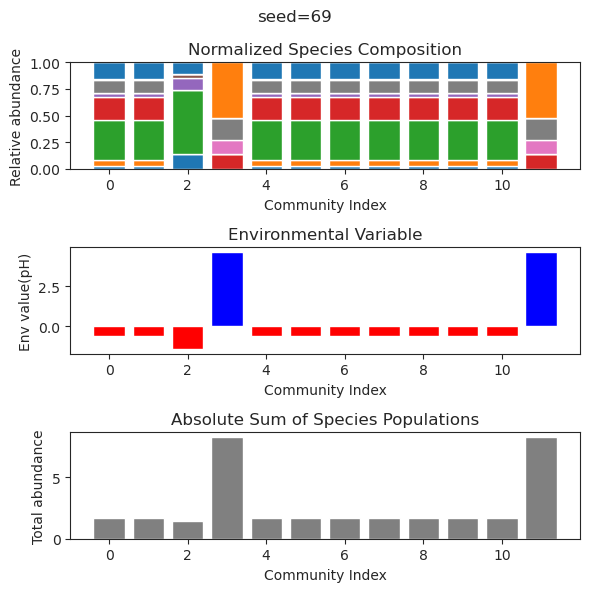

{'species': array([ 1.10512569e-39,  2.75404114e-01,  4.64327713e-59,  8.45639651e-42,
       -1.26982948e-31,  1.15084901e-01,  5.16109152e-64,  1.41815249e+00,
        3.22745341e-57,  3.57615832e-64, -8.57427250e-67, -5.14823683e-29]), 'env': array([-2.62018265])}
{'species': array([ 8.03007862e-35,  2.75404114e-01, -5.01086097e-45,  1.02208295e-34,
        6.51438601e-28,  1.15084901e-01, -8.30895764e-44,  1.41815249e+00,
       -1.05510113e-44, -1.74119710e-45, -1.85109085e-47,  1.65072895e-28]), 'env': array([-2.62018265])}
{'species': array([-3.59271309e-29,  2.75404114e-01, -1.13859831e-38, -6.79115118e-28,
       -6.15610826e-25,  1.15084901e-01,  1.53706094e-38,  1.41815249e+00,
       -4.32653340e-39, -3.65900869e-38, -6.26715089e-40, -5.37711703e-23]), 'env': array([-2.62018265])}
{'species': array([-9.43385454e-37,  2.75404114e-01, -2.17967476e-55, -1.88612745e-35,
       -7.43974554e-27,  1.15084901e-01, -1.03395392e-51,  1.41815249e+00,
       -8.10051597e-51, -5.3535299

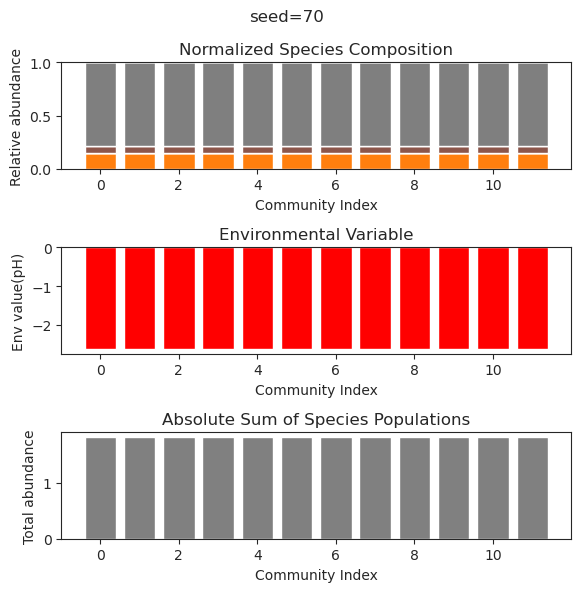

{'species': array([-8.76438681e-132,  1.36719415e-001,  2.28990281e-001,
        2.22530238e-133,  7.68295385e-043, -3.74069297e-110,
        3.96797926e-001,  3.99785176e-001, -1.48374659e-108,
       -5.99103994e-063, -3.76824622e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([ 4.22006666e-134,  1.36719415e-001,  2.28990281e-001,
        6.28756571e-133,  6.94877219e-043, -7.07775823e-112,
        3.96797926e-001,  3.99785176e-001,  9.20492887e-107,
       -4.69384605e-064, -3.10645777e-130,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-5.20176358e-135,  1.36719415e-001,  2.28990281e-001,
        6.45333293e-130, -1.07242033e-042, -2.69526772e-106,
        3.96797926e-001,  3.99785176e-001,  8.87401095e-105,
        1.61603836e-063, -2.71564479e-131,  5.18140256e-001]), 'env': array([-0.98371936])}
{'species': array([-2.69001497e-125,  1.36719415e-001,  2.28990281e-001,
       -3.46325207e-116,  1.73638039e-039, -6.11973083e-100,
     

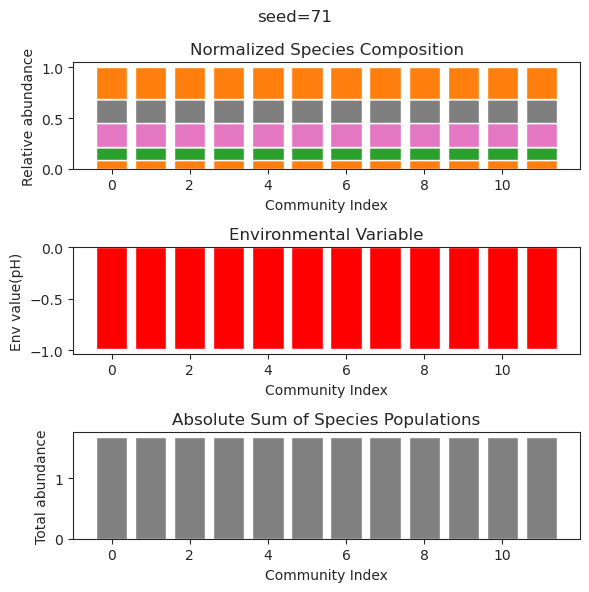

{'species': array([ 1.19652153e-01,  1.70921313e-03, -1.03888261e-22,  8.56776706e-38,
       -1.74913404e-83, -6.11870062e-28,  7.44855630e-01,  2.07150388e-46,
        6.47288546e-01,  1.59519968e-01, -3.17769852e-77, -2.00627358e-64]), 'env': array([-1.11368369])}
{'species': array([ 1.19652332e-01,  1.70893753e-03, -3.77504237e-15, -7.81396593e-30,
       -7.77385457e-26, -1.02141116e-34,  7.44855560e-01,  9.36254575e-39,
        6.47287992e-01,  1.59520606e-01,  1.09865118e-50,  1.13335227e-33]), 'env': array([-1.1136826])}
{'species': array([ 1.19652951e-01,  1.70798861e-03, -5.62316067e-26,  5.13427054e-80,
        1.09665231e-74, -8.82325555e-61,  7.44855318e-01,  5.16151894e-35,
        6.47286084e-01,  1.59522800e-01, -2.10309408e-64,  5.41566182e-53]), 'env': array([-1.11367886])}
{'species': array([ 1.19652932e-01,  1.70801680e-03,  4.26727306e-28,  3.25225448e-56,
        8.51620245e-57, -1.40764441e-45,  7.44855325e-01,  2.45282103e-34,
        6.47286140e-01,  1.59522735

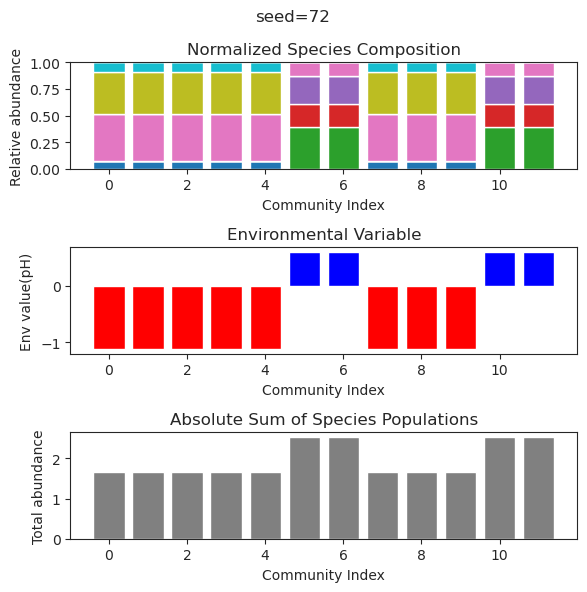

{'species': array([ 7.06399578e-002, -6.42243013e-092, -1.85637969e-057,
        6.21699179e-001, -6.28383225e-176,  5.46204639e-001,
       -1.44200616e-069,  3.30922000e-126,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  7.30238245e-100]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002, -6.09951096e-076, -2.10751686e-041,
        6.21699179e-001,  9.29642394e-155,  5.46204639e-001,
        4.58276919e-051, -3.78960575e-112,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001, -9.79139162e-086]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.01930179e-072, -2.53478869e-041,
        6.21699179e-001, -1.30227915e-149,  5.46204639e-001,
       -3.05826922e-051, -2.20529281e-109,  2.42184216e-001,
        2.87528502e-001,  2.35954298e-001,  2.17527339e-087]), 'env': array([-0.30522734])}
{'species': array([ 7.06399578e-002,  1.12686381e-075, -6.03134629e-039,
        6.21699179e-001,  1.59617478e-156,  5.46204639e-001,
     

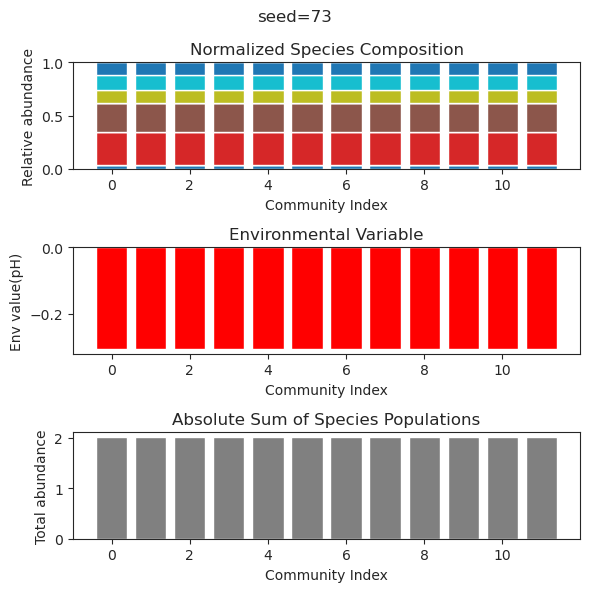

{'species': array([ 2.25448675e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        2.68806484e-39, -3.68828684e-51,  2.13369031e-01, -6.96105686e-30,
       -4.12231981e-45,  5.64725350e-01,  7.71535432e-34, -2.43837556e-38]), 'env': array([-1.47334525])}
{'species': array([-1.70606531e-27,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.69079229e-40,  8.32606043e-48,  2.13369031e-01, -2.52180116e-29,
        5.28457758e-43,  5.64725350e-01,  2.64582372e-32,  1.42094543e-35]), 'env': array([-1.47334525])}
{'species': array([ 8.19111750e-25,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        3.41850637e-43, -2.10061056e-45,  2.13369031e-01,  7.07857074e-30,
        1.03333956e-43,  5.64725350e-01, -7.63804646e-35, -6.09865234e-35]), 'env': array([-1.47334525])}
{'species': array([ 3.83770207e-22,  2.52574786e-01,  1.83807389e-01,  8.65403599e-01,
        1.19236766e-40, -3.89682419e-50,  2.13369031e-01, -2.59567375e-29,
       -1.78163982e-46,  5.6472535

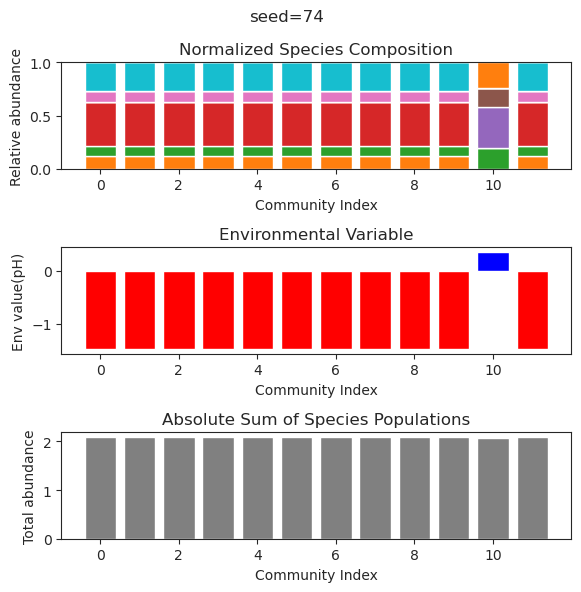

{'species': array([ 1.13742427e-51,  2.72406099e-01, -1.03549990e-27,  4.08552220e-01,
       -1.54027239e-19, -1.67912202e-69, -2.60064316e-68,  8.14840768e-62,
        1.29478366e-70,  6.50402058e-52,  7.91495737e-01, -2.63759727e-58]), 'env': array([-2.24186042])}
{'species': array([-2.94603304e-39,  2.72406099e-01, -2.69721799e-24,  4.08552220e-01,
        1.20514310e-18, -1.09121547e-50, -1.01998066e-50, -2.41609808e-47,
        5.39081173e-60,  1.14398602e-45,  7.91495737e-01,  1.24375217e-50]), 'env': array([-2.24186042])}
{'species': array([ 6.44511670e-40,  2.72406099e-01,  9.94443688e-27,  4.08552220e-01,
       -4.39721370e-18,  1.61158110e-52,  4.94484809e-50, -1.19816674e-47,
       -1.41293567e-58,  1.12609156e-46,  7.91495737e-01,  1.15138294e-52]), 'env': array([-2.24186042])}
{'species': array([ 1.16093454e-39,  2.72406099e-01, -2.46985812e-31,  4.08552220e-01,
        9.16284767e-17,  5.21664865e-46,  2.10247760e-42,  4.46343660e-42,
       -2.29746320e-45,  9.8234693

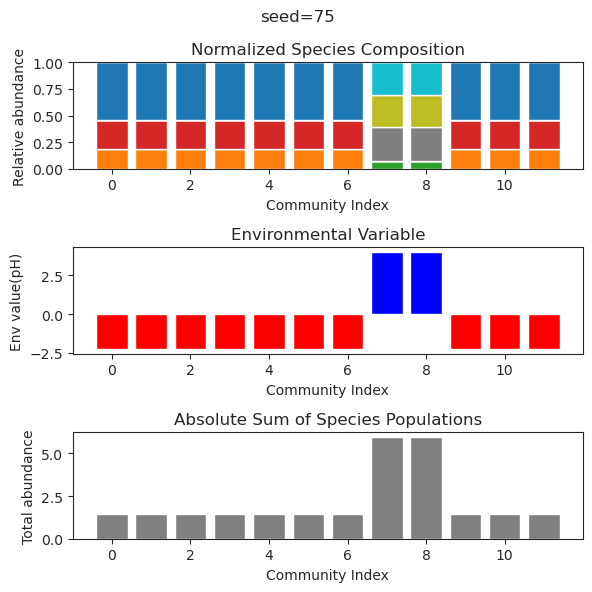

{'species': array([ 2.26038731e-70, -1.06552277e-55,  1.90282872e-35,  5.40681540e-01,
        5.01723933e-43,  2.09913884e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  1.54382885e-59, -1.68663523e-66, -1.78949397e-63]), 'env': array([1.79631142])}
{'species': array([ 2.40096217e-38,  1.85097735e-54, -6.10954861e-37,  5.40681540e-01,
       -1.28165599e-44, -1.24733620e-53,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -8.52498207e-68,  4.42098719e-71, -3.46769489e-69]), 'env': array([1.79631142])}
{'species': array([ 1.49290406e-53, -1.05201149e-40,  9.32570223e-37,  5.40681540e-01,
        8.43206067e-41,  3.54904447e-44,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00,  3.33888822e-46,  4.12763250e-52,  2.35049972e-50]), 'env': array([1.79631142])}
{'species': array([ 3.11895292e-63,  3.91363693e-48, -6.30062503e-39,  5.40681540e-01,
       -2.99395334e-38, -2.40834706e-41,  7.24834386e-01,  1.74801117e+00,
        1.02633949e+00, -7.58582281e-

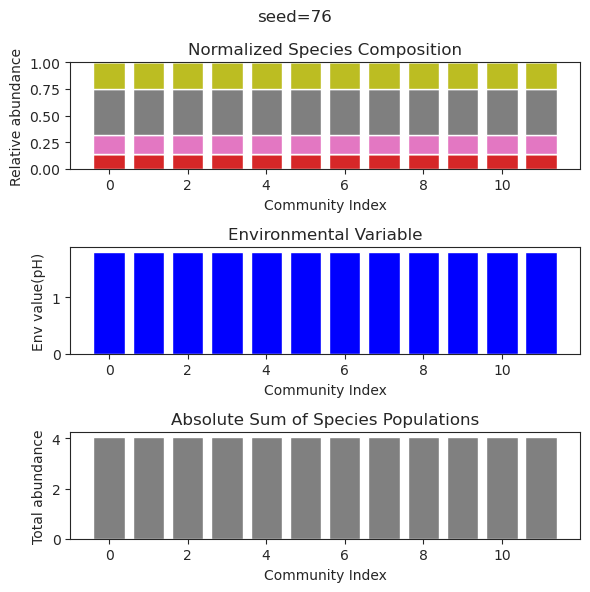

{'species': array([ 4.68997232e-20,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.97909915e-51, -5.64596347e-25,  3.64542721e-39,  1.29757920e-01,
       -2.38658588e-48,  1.54274597e-58, -1.48349484e-58,  4.48744115e-59]), 'env': array([-1.3936028])}
{'species': array([ 2.46764198e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -3.85266420e-63, -2.75103022e-32, -2.12263299e-38,  1.29757920e-01,
       -6.04869681e-54,  4.33154617e-69, -9.52749250e-63, -6.32871199e-65]), 'env': array([-1.3936028])}
{'species': array([-2.37130583e-23,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
        1.70594375e-45,  1.70991900e-24, -5.75840731e-27,  1.29757920e-01,
       -4.76296347e-36, -2.49246356e-51, -1.63663127e-44, -3.22171983e-49]), 'env': array([-1.3936028])}
{'species': array([-5.19264776e-26,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -1.20334206e-63, -4.55342950e-31, -1.54446434e-36,  1.29757920e-01,
       -6.78598990e-53, -2.30835035e-

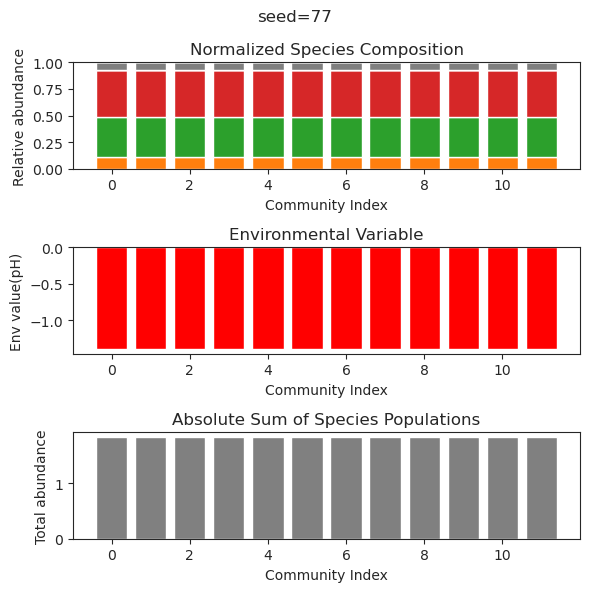

{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 4.50975116e-25,  1.92413468e-01,  6.93848886e-01,  8.05809586e-01,
       -5.63154558e-62, -8.52872449e-29,  1.82448615e-34,  1.29757920e-01,
        3.63114858e-47,  1.55704214e-64,  1.44631370e-57,  3.43940610e-59]), 'env': array([-1.3936028])}
{'species': array([ 5.47896340e-47,  5.80676259e-37, -1.19573778e-70,  7.76812680e-77,
        6.22951076e-75,  4.90369765e+00,  3.67834960e-42, -2.24089001e-54,
       -5.57007846e-72,  6.50060265e+00, -1.70705729e-78,  2.77681450e-73]), 'env': array([6.96083421])}
{'species': array([-2.93735204e-79, -2.05857076e-33, -2.52690923e-79,  2.13266992e-85,
       -3.89938903e-85,  4.90369765e+00, -1.00614269e-46, -3.10803335e-58,
       -1.02422009e-76,  6.50060265e+

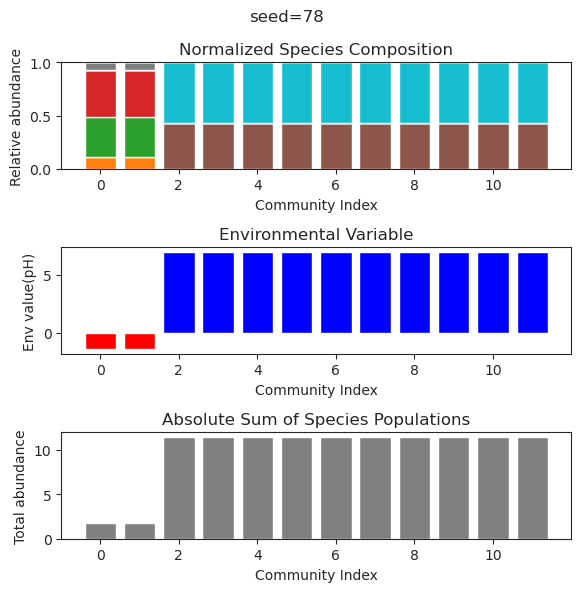

{'species': array([-1.37544366e-34,  2.41782295e-01, -9.88486892e-53,  6.34984580e-01,
       -2.17537228e-28,  1.27330215e-29,  1.56381723e-01,  2.28008734e-01,
        7.70505337e-40, -2.71763653e-30, -1.18566308e-42,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-2.55376423e-36,  2.41782295e-01, -1.17089132e-56,  6.34984580e-01,
        1.47490417e-28,  3.60774017e-28,  1.56381723e-01,  2.28008734e-01,
       -1.69480785e-43,  9.60068611e-32, -2.18677702e-48,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-4.07460327e-35,  2.41782295e-01,  2.00241290e-56,  6.34984580e-01,
       -9.26849997e-29,  8.17098872e-31,  1.56381723e-01,  2.28008734e-01,
        2.27464738e-44,  6.67090717e-34,  5.29860711e-49,  5.66015337e-01]), 'env': array([-1.56206125])}
{'species': array([-9.84420450e-34,  2.41782295e-01, -8.35871048e-50,  6.34984580e-01,
       -3.66173594e-27,  2.34135024e-30,  1.56381723e-01,  2.28008734e-01,
       -1.22435244e-40,  2.6981426

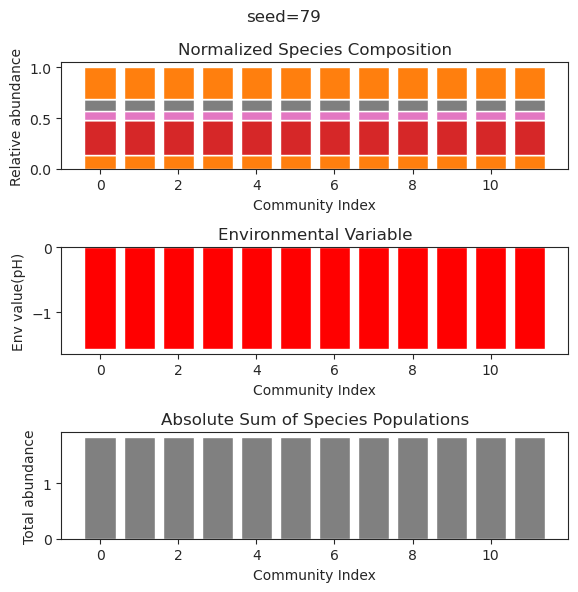

{'species': array([ 2.99685080e-01, -1.34434774e-33, -3.08765998e-35, -5.23703592e-49,
        2.77171412e-19,  2.33158665e-40,  3.01928058e-01,  2.21565009e-26,
        6.20341597e-01,  5.96300235e-26, -8.77329204e-44,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.82980978e-32,  1.28976077e-41, -3.39189792e-53,
       -7.07630073e-20, -1.16410504e-38,  3.01928058e-01, -5.08125162e-26,
        6.20341597e-01,  8.28073302e-30,  3.60195136e-46,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.29989498e-34,  3.52218670e-43,  8.08073020e-63,
       -3.26006959e-19, -8.70032850e-45,  3.01928058e-01,  7.37561075e-25,
        6.20341597e-01, -1.54383592e-29,  3.13098806e-53,  2.89302153e-01]), 'env': array([-2.23661261])}
{'species': array([ 2.99685080e-01, -1.97138103e-36,  6.49170876e-46,  4.26321489e-66,
        6.12854982e-21,  1.31791110e-45,  3.01928058e-01, -7.07927205e-26,
        6.20341597e-01,  5.2698100

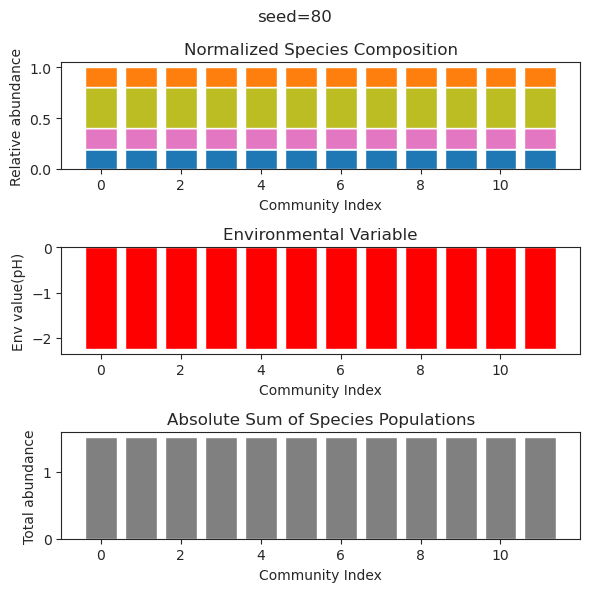

{'species': array([5.42490649e-002, 1.82622185e-063, 5.90776000e-090, 3.07921479e-092,
       2.20541251e-001, 6.69765962e-001, 1.20367293e-003, 4.02379873e-127,
       5.59638804e-006, 9.64276584e-028, 1.14958376e-001, 1.12677334e+000]), 'env': array([1.26421143])}
{'species': array([1.46785051e-001, 1.07607355e-061, 1.14522077e-089, 1.05690685e-089,
       1.49010790e-001, 6.28834689e-003, 1.59969134e-003, 4.85983372e-128,
       3.31487670e-001, 1.67035910e-025, 1.08132364e+000, 2.02786896e-002]), 'env': array([-1.68466702])}
{'species': array([-1.01683704e-62,  1.16779824e-70,  9.24580178e-01,  2.80892219e-02,
        9.62746083e-66,  1.29894928e+00,  5.29925295e-53,  2.65368857e+00,
       -1.31868846e-56,  6.66511117e-01, -2.71253070e-67, -5.08190597e-55]), 'env': array([3.71775164])}
{'species': array([-3.18537321e-42, -2.32409547e-45,  9.24580178e-01,  2.80892219e-02,
       -5.77290402e-62,  1.29894928e+00, -1.70087349e-42,  2.65368857e+00,
       -5.68533967e-57,  6.66511117e

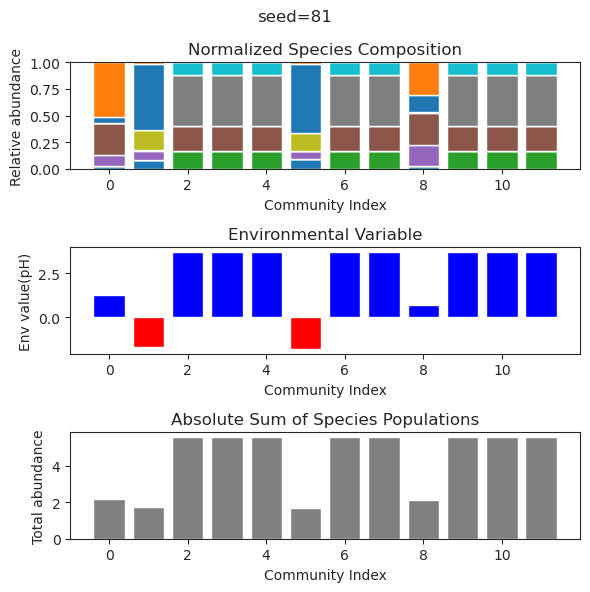

{'species': array([ 4.41758128e-27,  1.54246125e-01,  4.89807687e-01,  1.06880414e-02,
        1.37242256e-57,  7.61775605e-01,  1.55959799e-02,  3.99568889e-80,
       -1.17971294e-38,  1.10667262e-01,  3.10957583e-02,  4.83987012e-03]), 'env': array([-0.96400528])}
{'species': array([-3.38969240e-028,  1.53242644e-001,  4.91427105e-001,
        1.67955790e-002,  2.42586043e-074,  7.46229804e-001,
        1.60961399e-002,  9.39156531e-186,  1.66343950e-031,
        1.22677399e-001,  2.81753402e-002,  2.33259078e-003]), 'env': array([-0.95335834])}
{'species': array([-5.62785064e-028,  1.54261586e-001,  4.89797759e-001,
        1.06076021e-002,  9.05931003e-067,  7.61965190e-001,
        1.54937981e-002,  2.71559473e-122, -1.31761433e-031,
        1.10589443e-001,  3.11961240e-002,  4.72242428e-003]), 'env': array([-0.96419249])}
{'species': array([-3.61615927e-30,  1.54322726e-01,  4.89671748e-01,  1.02559921e-02,
       -1.00013711e-61,  7.63021583e-01,  1.57631092e-02,  2.91965174e-

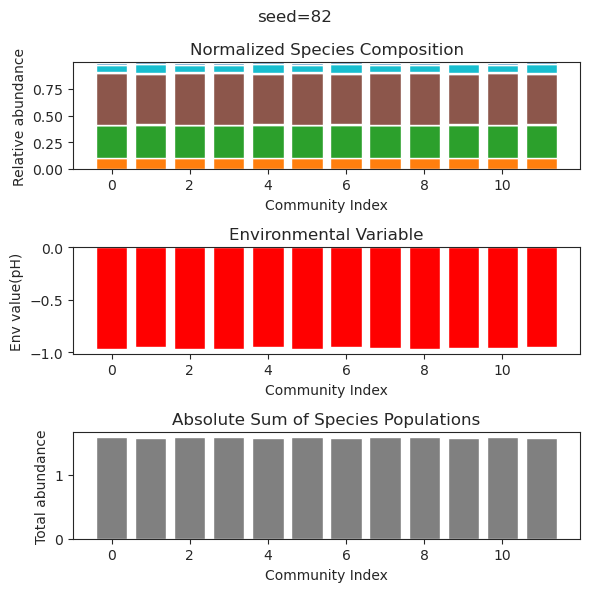

{'species': array([ 1.94432063e-65,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        2.04159902e-36,  2.59706190e-33,  1.60864293e-61,  5.14586840e-23,
       -1.35907525e-69,  3.08783621e-22, -8.15244237e-54, -6.35643629e-59]), 'env': array([-1.46673504])}
{'species': array([ 2.10212475e-61,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        4.05031956e-34, -4.64292712e-32, -1.64680733e-59, -2.00738876e-25,
        8.58535235e-65, -1.39283217e-24, -6.93804626e-57, -1.68534001e-60]), 'env': array([-1.46673504])}
{'species': array([7.26254522e-002, 3.92707256e-003, 5.66479155e-001, 5.39200696e-132,
       5.48551226e-208, 4.42358094e-005, 8.73426437e-002, 4.67337289e-001,
       1.52023614e-298, 3.54104448e-001, 0.00000000e+000, 2.10317976e-001]), 'env': array([-0.26745161])}
{'species': array([-1.89355974e-59,  1.98466753e-01,  7.76387244e-01,  8.12678708e-01,
        1.27726894e-32,  3.10214473e-30,  8.32920212e-56,  2.48293978e-23,
        8.58982271e-60,  2.1586938

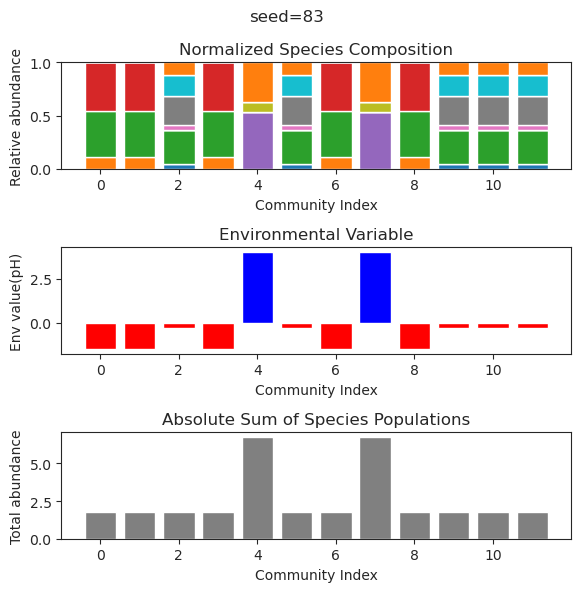

{'species': array([ 2.22294234e-01, -4.37890198e-43, -2.42955414e-49,  1.60210131e-68,
       -1.42239331e-57, -3.48801086e-56,  1.81205366e-01, -1.55835910e-21,
        4.60487053e-01,  1.35930699e-78,  5.29079559e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -9.27520289e-38,  4.02034519e-41,  1.18833652e-57,
       -3.79725835e-49,  3.29336851e-48,  1.81205366e-01, -4.40584058e-21,
        4.60487053e-01, -2.78299399e-61,  6.01134720e-09,  3.68853353e-01]), 'env': array([-1.85443928])}
{'species': array([ 2.22294234e-01, -8.69235037e-45, -7.97384021e-55,  5.35166360e-69,
        1.41627830e-47, -2.64916735e-58,  1.81205366e-01,  8.34281464e-28,
        4.60487050e-01,  3.59513626e-78,  1.28511550e-08,  3.68853353e-01]), 'env': array([-1.85443927])}
{'species': array([ 2.22294234e-01,  4.00302887e-38, -9.12521785e-45,  1.73131256e-55,
       -2.91002079e-45, -5.07954875e-48,  1.81205366e-01, -6.61937356e-16,
        4.60487053e-01, -1.0761082

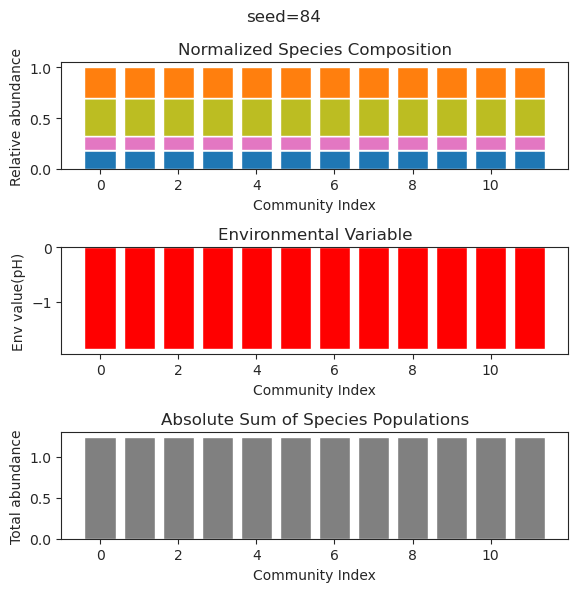

{'species': array([ 3.91155747e-08,  2.28258496e-01,  5.35453233e-01, -3.05801115e-30,
        4.44292942e-40, -3.41211629e-22,  1.81809639e-01,  3.38275377e-43,
        3.09721377e-01,  1.66507234e-61, -6.77959608e-47,  4.56679579e-01]), 'env': array([-1.65676946])}
{'species': array([ 1.49677557e-08,  2.28258512e-01,  5.35453227e-01,  3.76330300e-20,
        1.93456700e-35,  2.83299789e-17,  1.81809628e-01,  3.47049646e-39,
        3.09721406e-01,  2.75338635e-32, -1.31492968e-35,  4.56679595e-01]), 'env': array([-1.65676938])}
{'species': array([ 3.26806481e-08,  2.28258500e-01,  5.35453231e-01,  2.21069362e-15,
       -2.56355402e-37, -2.90239973e-15,  1.81809636e-01, -5.93662407e-41,
        3.09721385e-01,  1.94363063e-51,  1.02730112e-40,  4.56679584e-01]), 'env': array([-1.65676944])}
{'species': array([ 2.22049277e-08,  2.28258507e-01,  5.35453229e-01,  4.69266427e-19,
       -8.08875850e-36,  1.95626906e-19,  1.81809631e-01, -2.83897729e-41,
        3.09721397e-01, -4.1164384

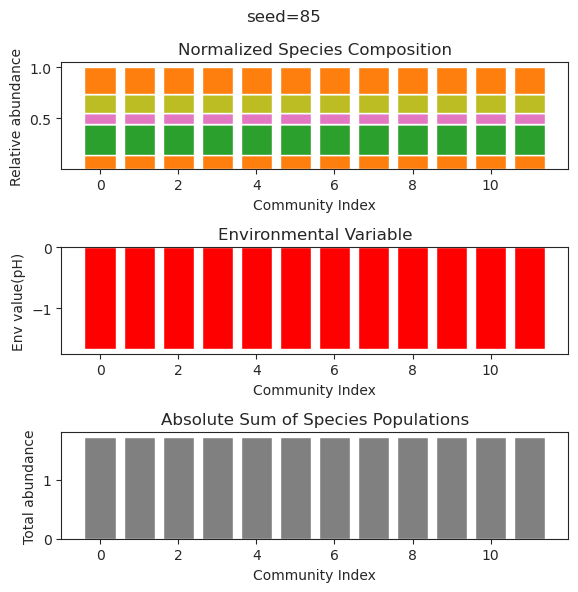

{'species': array([ 2.32487188e-01, -1.38060721e-31,  1.91919401e-01,  6.17616568e-32,
       -1.45136411e-39, -4.05365487e-45,  5.70420216e-57,  2.71370510e-74,
        5.00311009e-75,  6.92333258e-01,  1.13580757e-20,  7.83664183e-50]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -3.09257226e-31,  1.91919401e-01, -4.09699509e-31,
        3.66461964e-42,  8.82489723e-47,  1.75284010e-60, -2.70268546e-81,
        1.13482491e-78,  6.92333258e-01, -1.26770571e-20,  2.33110274e-48]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -1.18182708e-33,  1.91919401e-01, -7.11761462e-28,
       -1.98468914e-42, -3.60147132e-50, -4.43539008e-56,  1.25450051e-74,
       -1.18750451e-70,  6.92333258e-01,  2.02940664e-22,  4.52660142e-40]), 'env': array([-2.00611793])}
{'species': array([ 2.32487188e-01, -4.43472034e-33,  1.91919401e-01,  3.49724975e-32,
        1.68450439e-41,  8.40812090e-47, -1.83137538e-53,  3.06524962e-76,
        3.82663150e-75,  6.9233325

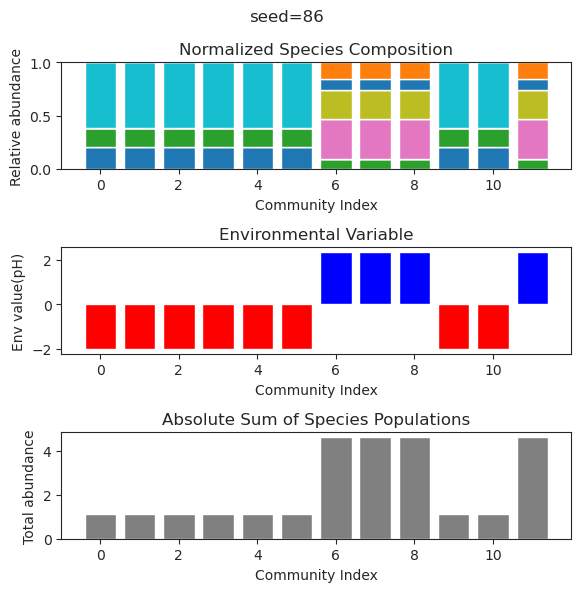

{'species': array([ 1.47227533e-02,  1.14621697e-01,  1.63181590e-89,  6.41465733e-01,
       -1.60939189e-90,  4.48713977e-01,  2.33778546e-02,  8.71704353e-02,
        2.01310788e-01, -1.08430357e-38,  1.44592988e-79, -1.64935555e-64]), 'env': array([-0.80729879])}
{'species': array([ 1.47227411e-02,  1.14621709e-01,  4.99851826e-36,  6.41465743e-01,
        1.93534590e-78,  4.48713980e-01,  2.33778384e-02,  8.71704451e-02,
        2.01310780e-01, -1.27254942e-37, -3.13627127e-70,  1.16387562e-60]), 'env': array([-0.8072988])}
{'species': array([ 1.47080719e-02,  1.14636032e-01,  8.87971165e-32,  6.41477899e-01,
        1.13582435e-31,  4.48717478e-01,  2.33583642e-02,  8.71822108e-02,
        2.01300579e-01,  1.27196172e-51, -3.63264961e-80, -7.33659881e-72]), 'env': array([-0.80730666])}
{'species': array([ 1.47227521e-02,  1.14621698e-01,  6.87588428e-95,  6.41465734e-01,
        2.11245081e-93,  4.48713977e-01,  2.33778529e-02,  8.71704363e-02,
        2.01310788e-01,  1.20716397

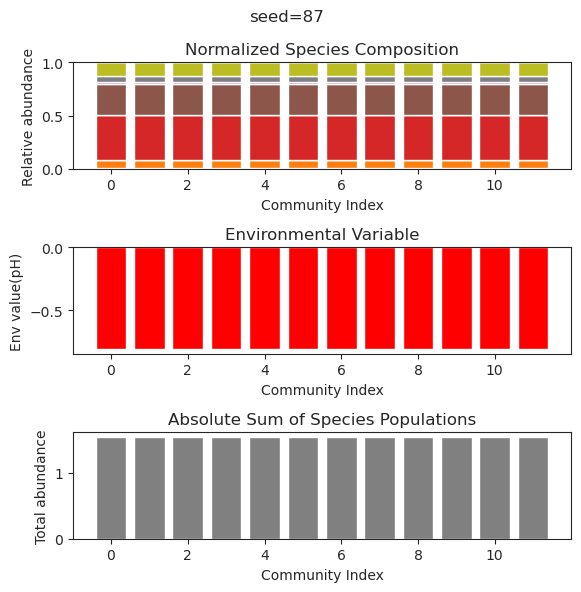

{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-4.25936744e-63,  8.24906829e-46, -9.20347199e-78,  6.35667479e-01,
        1.24933748e+00,  1.27752650e+00,  1.17151216e-54,  6.77402097e-45,
        3.37344512e-01,  3.50902662e-64,  2.01248078e-48, -1.12623592e-33]), 'env': array([0.71784227])}
{'species': array([-2.02076347e-165, -8.35003654e-073,  2.34344572e-118,
        3.90169469e-001,  8.97712110e-001,  1.11015609e+000,
        1.72186240e-001,  3.64531887e-001,  1.95189408e-001,
       -4.27537260e-160, -1.02476121e-127,  4.36392963e-051]), 'env': array([0.59845328])}
{'species': array([-1.97194209e-87,  1.48791240e-41,  4.68588474e-72,  3.90169469e-01,
        8.97712110e-01,  1.11015609e+00,  1.72186240e-01,  3.64531887e-01,
        1.95189408

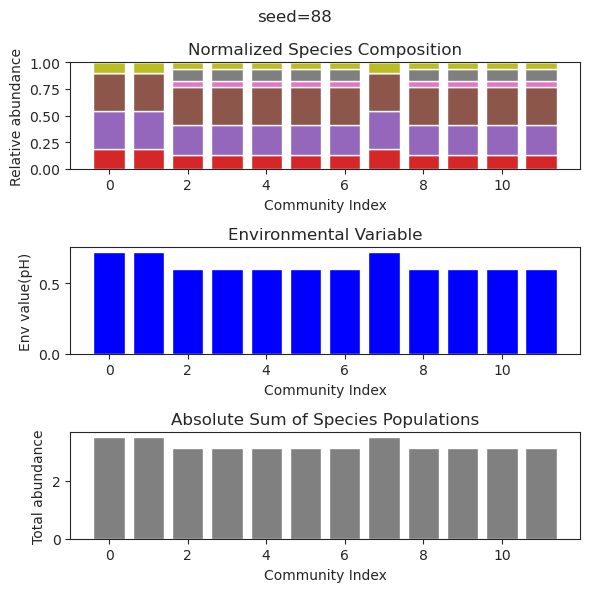

{'species': array([ 1.43445336e-01,  1.94395665e-13,  2.89765013e-01,  3.70880334e-96,
       -2.85890442e-48,  9.81561464e-64,  7.18910433e-01,  4.12768509e-01,
        1.74925856e-52, -1.45626689e-85,  3.78788243e-01, -6.20881235e-83]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  5.41008212e-012,  2.89765013e-001,
       -1.87044714e-120,  2.53328055e-053, -3.22942878e-071,
        7.18910433e-001,  4.12768509e-001,  2.70870821e-060,
        7.46786781e-093,  3.78788243e-001,  5.92213111e-101]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-001,  1.57782297e-011,  2.89765013e-001,
       -2.59002112e-106, -7.88111915e-055, -3.86835386e-070,
        7.18910433e-001,  4.12768509e-001,  2.96777977e-047,
       -1.59912900e-085,  3.78788243e-001, -3.99308731e-092]), 'env': array([-0.63876252])}
{'species': array([ 1.43445336e-01, -7.01249187e-15,  2.89765013e-01,  4.29583555e-92,
        4.27458259e-46, -9.84176177e-60,  7.18910433e-01,  4.12768509e-

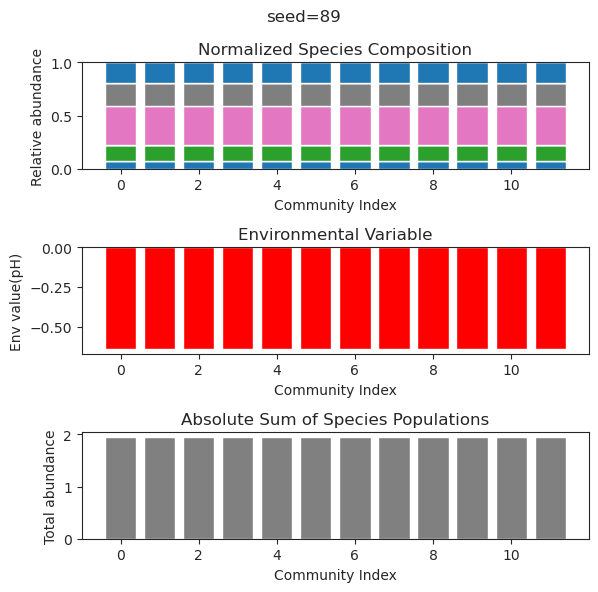

{'species': array([ 1.20237958e-01,  7.95641238e-30, -9.40002255e-34, -1.90574565e-37,
       -1.60710110e-23,  5.38545960e-40, -8.57556660e-40,  8.02038778e-01,
        8.39767469e-01,  1.04966534e-06,  2.22605863e-56,  1.28660326e-43]), 'env': array([-0.75825038])}
{'species': array([ 1.20237959e-01, -3.25753873e-35,  1.28971319e-33, -2.01097928e-39,
       -3.68156216e-41, -4.56382677e-42,  1.65657612e-37,  8.02038187e-01,
        8.39767349e-01,  1.75370901e-06, -3.71010008e-73,  2.97881395e-48]), 'env': array([-0.7582502])}
{'species': array([2.68064561e-065, 3.13813714e-001, 6.42783094e-124, 8.31601272e-003,
       4.44304767e-296, 2.78295315e-001, 1.76440299e-278, 3.11660977e-181,
       3.04393533e-067, 3.95893282e-001, 5.68468321e-001, 2.20702073e-001]), 'env': array([-0.1288903])}
{'species': array([ 2.82032277e-065,  4.26943555e-002,  4.07829782e-117,
        4.54437223e-001,  6.70121500e-308,  1.27814202e-002,
       -8.66595924e-302,  1.73661811e-177,  1.73356162e-063,
   

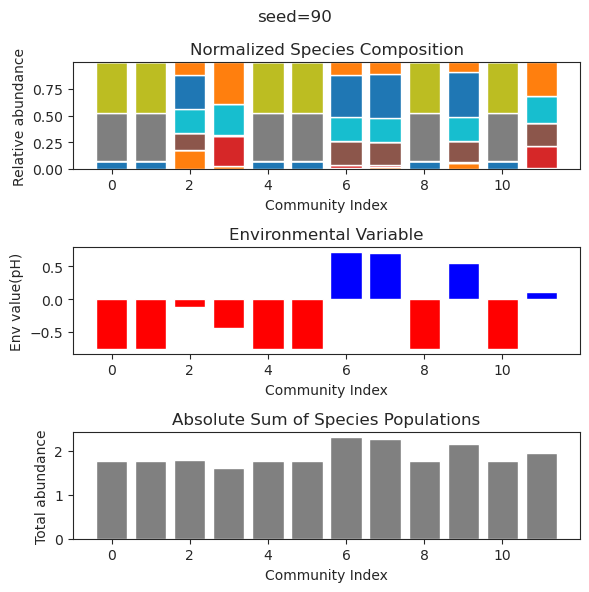

{'species': array([ 2.16655653e-01, -3.03299629e-21, -3.90290564e-35,  4.69260871e-01,
        2.48677395e-48,  5.54885970e-53,  1.22339070e-01, -7.23395331e-38,
       -6.32584535e-39,  6.28287996e-01,  2.83488368e-47,  1.62940163e-33]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01,  2.18890137e-20,  5.48579093e-35,  4.69260871e-01,
        5.85305043e-50,  7.47774286e-56,  1.22339070e-01, -1.20789546e-39,
       -2.42057543e-38,  6.28287996e-01,  1.15730204e-49, -6.37612562e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -3.93378172e-20, -1.53826822e-33,  4.69260871e-01,
       -3.69531107e-47,  9.11348873e-54,  1.22339070e-01,  1.13906780e-38,
       -7.59297529e-37,  6.28287996e-01,  1.85419461e-48,  1.63088991e-32]), 'env': array([-1.32774088])}
{'species': array([ 2.16655653e-01, -4.81519869e-20,  1.01763771e-29,  4.69260871e-01,
        1.48490288e-44, -1.20411151e-50,  1.22339070e-01,  2.13654026e-33,
       -1.31695025e-30,  6.2828799

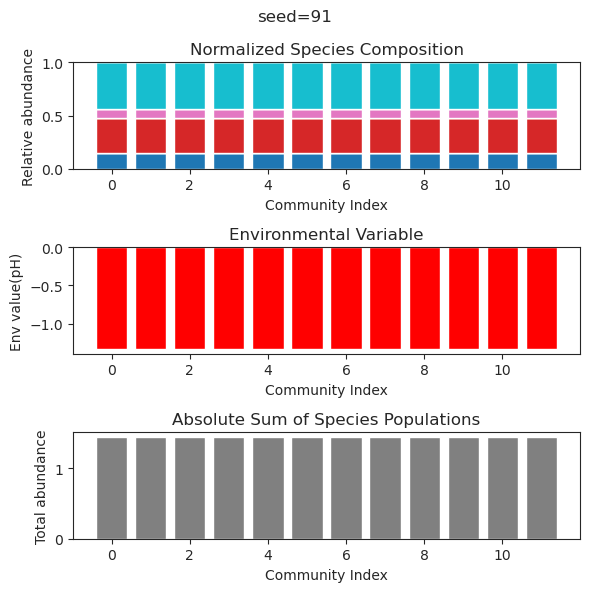

{'species': array([ 1.65574050e-01,  5.10121351e-34,  2.79638660e-55,  1.07561026e-60,
       -4.79022512e-27, -1.09663103e-33, -1.73159944e-60, -5.95411300e-18,
        1.11874149e+00,  1.28486090e-62,  1.83127727e-42, -8.78670906e-62]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  7.13959227e-43,  3.60596885e-75, -2.42817675e-73,
       -5.29534106e-27, -1.64632440e-37, -2.44437621e-70, -8.86607244e-19,
        1.11874149e+00, -1.01555982e-80,  6.62441221e-55, -4.81275575e-78]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01, -8.82707903e-42, -9.12153295e-71, -1.26965062e-63,
        1.83799315e-25, -7.76551511e-36, -9.08716077e-59, -8.99680399e-18,
        1.11874149e+00, -2.08656000e-66, -7.21278132e-52,  4.35010034e-66]), 'env': array([-1.70377709])}
{'species': array([ 1.65574050e-01,  8.66697780e-33,  5.14465219e-49,  4.06386256e-54,
       -3.98071959e-26,  9.89230239e-35,  2.42640419e-51, -8.92409047e-19,
        1.11874149e+00,  1.0215873

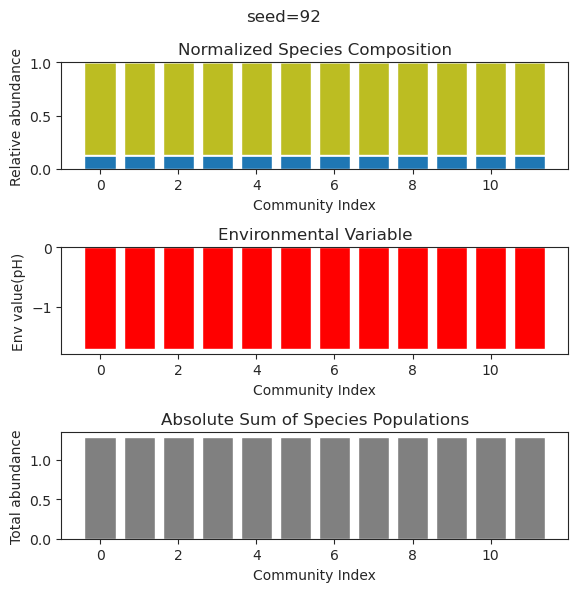

{'species': array([-2.88151043e-43,  3.75517669e-57, -2.15653421e-87,  1.18554075e-46,
        4.75207673e-67,  1.49012672e+00, -3.78992061e-17,  7.13665743e-88,
        2.36551071e+00,  1.28594482e+00, -1.15511779e-81,  6.02437439e-78]), 'env': array([2.73999692])}
{'species': array([ 1.46307112e-001,  3.94815494e-025,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001,  4.39178126e-137,
        1.05801885e-063,  1.85439741e-001,  2.84107027e-213,
       -4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.46307113e-001,  2.32233321e-024,  2.37258553e-001,
        1.69149284e-001,  2.25798851e-001, -9.23269450e-140,
        1.42323649e-059,  1.85439741e-001, -2.09021041e-211,
        4.94065646e-324,  4.91152683e-001,  1.82858230e-001]), 'env': array([-0.82977596])}
{'species': array([ 1.09699521e-81, -6.30216184e-57,  1.48337919e-76,  1.47198059e-56,
       -5.62645588e-63,  1.49012672e+00,  2.94687025e-21,  2.39583234e-7

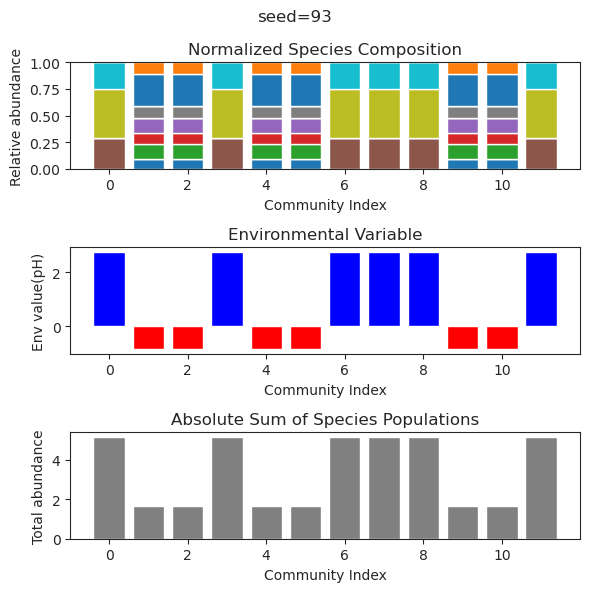

{'species': array([ 2.49671157e-031,  3.12730398e-001,  5.11702573e-001,
       -2.80068787e-032,  1.73624455e-074,  8.61918754e-041,
        7.21205170e-002,  1.75657475e-006,  3.94321790e-038,
        6.11871345e-024,  7.50548044e-001,  5.20661816e-120]), 'env': array([-2.42379038])}
{'species': array([-3.59031806e-42,  3.12731490e-01,  5.11697190e-01,  1.01402021e-50,
        3.67403434e-32, -8.45343568e-31,  7.21260907e-02,  3.45415871e-12,
        1.74387187e-29, -3.53636362e-16,  7.50550920e-01,  5.83148324e-48]), 'env': array([-2.42379619])}
{'species': array([ 1.41319223e-49,  2.92286457e-01,  5.75170367e-01,  1.37291706e-49,
        4.43563808e-40, -1.96830947e-62, -2.74288292e-14,  6.30336631e-02,
       -1.34850020e-40, -6.86986344e-23,  7.09902688e-01, -4.04083915e-63]), 'env': array([-2.28720231])}
{'species': array([-3.01095210e-32, -1.42117913e-21,  6.49814328e-01,  3.27502187e-01,
       -3.82826581e-38, -4.71338070e-17,  2.27876437e-65,  3.79145853e-01,
        4.28542

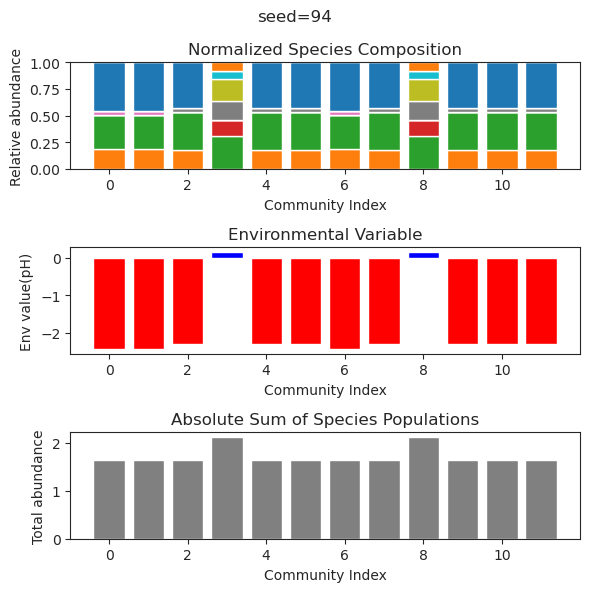

{'species': array([ 5.22326210e-34,  3.65173942e-01,  8.08292263e-32,  5.06558677e-40,
        2.85981726e-38,  1.16955550e-39,  2.74785063e-43,  9.15092389e-20,
       -4.27771840e-28,  1.09200265e-25,  4.99276595e-28,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([-7.71374064e-42,  3.65173942e-01,  1.63557447e-36,  4.46183049e-46,
        1.96067016e-46,  2.54155291e-46,  1.77248922e-49, -7.86329550e-21,
       -9.76518359e-31, -1.36255740e-28, -3.96387855e-32,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 7.05404272e-40,  3.65173942e-01, -2.79279597e-36,  1.49501306e-41,
        1.47877316e-42, -1.94593809e-44, -7.95876596e-45, -3.96646596e-22,
       -1.52569766e-31, -1.05127996e-28, -7.06312294e-30,  1.00497743e+00]), 'env': array([-2.92173375])}
{'species': array([ 9.68417803e-41,  3.65173942e-01,  5.77557599e-34,  5.10101045e-41,
        1.47692652e-40, -6.41229479e-42, -5.63066883e-43,  3.46500781e-21,
        1.86140017e-30,  1.1132482

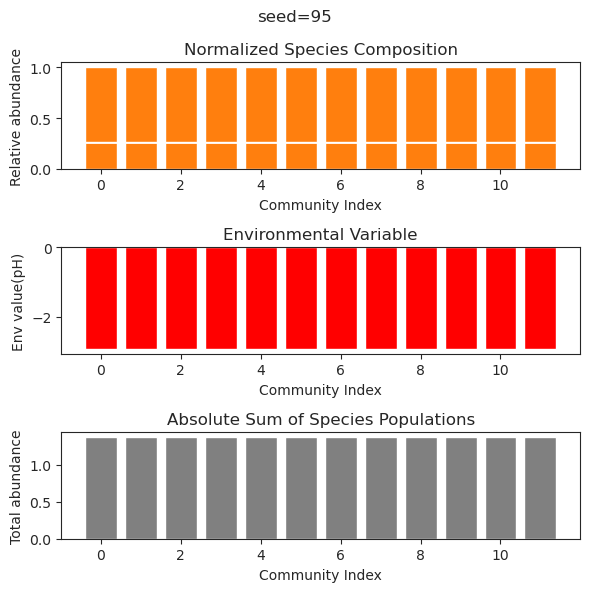

{'species': array([ 3.06206029e-01,  4.48969995e-18,  1.62680380e-38, -1.02539615e-46,
       -9.24094523e-53, -2.90948421e-51,  6.08377125e-29, -1.27438530e-40,
        2.19202924e-55,  7.90575606e-39,  5.81659185e-25,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -1.97489887e-20, -9.63813634e-56,  3.70452296e-77,
       -2.87723008e-84,  1.74754730e-80,  1.27352615e-40,  2.67424801e-58,
       -3.68086367e-92,  1.31438524e-53, -2.39689214e-29,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01,  1.13507811e-18,  7.54180536e-39,  4.23415796e-52,
       -1.89895931e-59,  7.32306707e-58, -1.05138575e-29,  9.82999184e-45,
        1.14686909e-59,  3.97230744e-40, -2.48331801e-28,  5.65680693e-01]), 'env': array([-2.6464187])}
{'species': array([ 3.06206029e-01, -2.23779237e-19,  5.75946988e-56,  4.10838674e-74,
        4.14952933e-75,  5.38387367e-72, -6.78950957e-38, -3.77517588e-57,
       -5.44970669e-83,  7.86456132e-

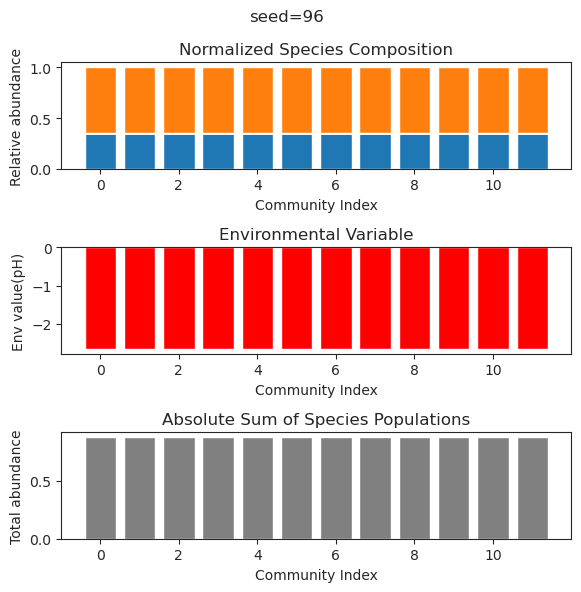

{'species': array([ 2.83758091e-43,  2.95137958e-01,  3.76034645e-59,  6.96242257e-01,
        2.27640624e-01,  2.21587543e-14,  6.53060285e-25, -3.48480743e-50,
        1.29288666e-54,  1.83673079e-59, -3.68898956e-20, -2.01676622e-50]), 'env': array([-2.66309159])}
{'species': array([-5.01984578e-47,  2.95137958e-01, -4.77873976e-73,  6.96242257e-01,
        2.27640624e-01, -8.33359172e-14,  2.24449599e-23, -3.51133821e-53,
        3.98543538e-58, -5.70405134e-74, -6.43100594e-19,  6.62178589e-59]), 'env': array([-2.66309159])}
{'species': array([-7.35049345e-47,  2.95137958e-01,  5.06283921e-58,  6.96242257e-01,
        2.27640624e-01,  2.99756971e-14,  2.51179444e-22,  4.09591841e-46,
        1.67940037e-51, -7.86444916e-61,  1.99711116e-19,  4.03848846e-48]), 'env': array([-2.66309159])}
{'species': array([ 1.90473032e-48,  2.95137958e-01,  1.21647371e-75,  6.96242257e-01,
        2.27640624e-01,  2.66267816e-14, -2.38994991e-24,  4.09064556e-56,
       -9.38585902e-64,  1.0805564

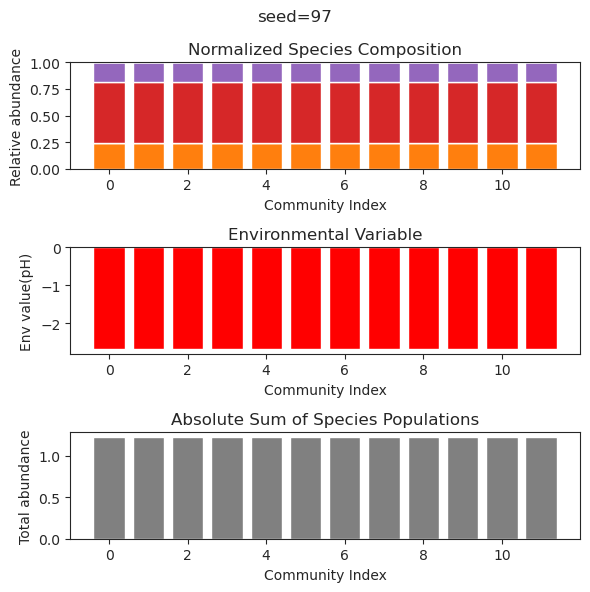

{'species': array([ 1.74438963e-001, -9.88131292e-324,  9.88131292e-324,
        1.58161700e-001,  5.40978511e-001,  5.15933485e-001,
        9.88131292e-324,  8.57578567e-222,  3.43193670e-001,
        3.38285268e-168,  7.60861095e-322,  1.49416971e-001]), 'env': array([0.04680571])}
{'species': array([ 1.49653958e-002, -9.88131292e-324, -1.48219694e-323,
        8.60828325e-001,  1.52885608e-002,  5.45866693e-002,
        2.02566915e-322,  1.07353533e-220,  5.13300321e-001,
        4.48654152e-168,  1.20057952e-321,  4.12905898e-001]), 'env': array([-0.06143089])}
{'species': array([ 1.41980341e-002,  7.90505033e-323, -1.67982320e-322,
        8.33609811e-001,  1.91308776e-002,  7.83080930e-002,
        2.86558075e-322,  1.06811835e-222,  5.36002551e-001,
        1.21487264e-167,  2.47032823e-323,  3.94526214e-001]), 'env': array([0.05454416])}
{'species': array([ 3.02027012e-001, -9.88131292e-324,  4.94065646e-324,
        1.93600951e-001,  3.64148737e-001,  2.68634553e-001,
       

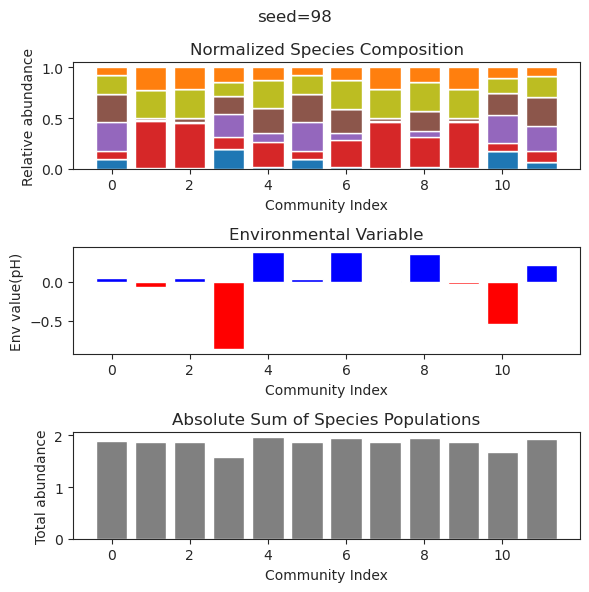

{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([ 1.19675197e-001, -9.88131292e-324,  9.88131292e-324,
        2.10818191e-001,  4.85495835e-001,  5.58120752e-001,
       -6.91691904e-323,  2.37752812e-217,  4.05547644e-001,
        2.29479305e-168, -1.53654416e-321,  1.58297556e-001]), 'env': array([0.21728699])}
{'species': array([-1.25433292e-89, -8.32443699e-33,  1.07772932e+00, -5.46639327e-22,
       -8.37608218e-31,  9.56910470e-01, -1.39574892e-92,  7.44185743e-01,
       -2.50085257e-81,  1.43735074e-61, -5.77503677e-63,  1.58403814e+00]), 'env': array([1.85416692])}
{'species': array([-3.36523103e-035, -1.24540557e-039,  1.07772932e+000,
        5.77280484e-026,  1.54104710e-026,  9.56910470e-001,
       -1.53784134e-101,  7

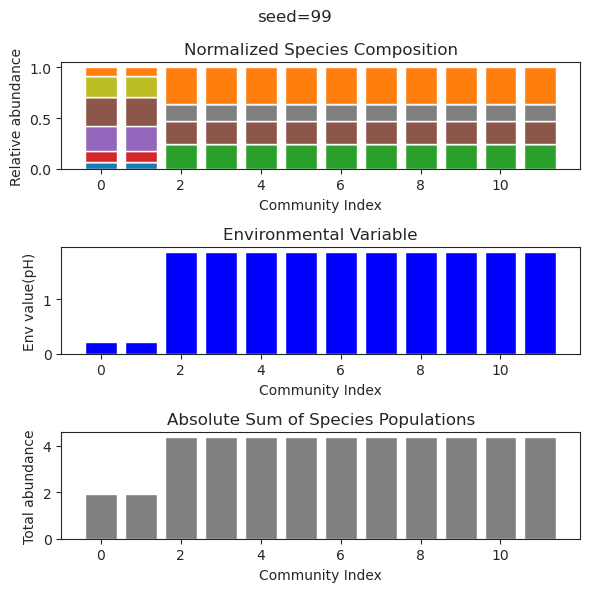

In [11]:
    session_path='Results/Session_Test4'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0.4,0.6)
        f_q = lambda : uniform_distribution(0.4,0.6)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.99])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

In [ ]:
import pickle

In [35]:
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

NameError: name 'pickle' is not defined

{'species': array([ 2.47914442e-121,  7.70851178e-002,  2.86798834e-001,
        3.40515831e-001,  1.61137316e-001, -2.81589975e-040,
        5.15648468e-001,  2.01126141e-001,  6.40896026e-120,
       -1.21423551e-150,  5.63748540e-001,  1.81023764e-025]), 'env': array([-0.24036747])}
{'species': array([-3.22693574e-099,  7.70851178e-002,  2.86798834e-001,
        3.40515831e-001,  1.61137316e-001,  4.97560864e-065,
        5.15648468e-001,  2.01126141e-001, -6.49756585e-100,
       -1.60959915e-088,  5.63748540e-001,  7.38149536e-033]), 'env': array([-0.24036747])}
{'species': array([-6.68216882e-98,  7.70851178e-02,  2.86798834e-01,  3.40515831e-01,
        1.61137316e-01,  2.67203025e-58,  5.15648468e-01,  2.01126141e-01,
       -8.01967107e-98,  4.75285709e-84,  5.63748540e-01,  9.42372149e-28]), 'env': array([-0.24036747])}
{'species': array([ 1.75152353e-100,  7.70851178e-002,  2.86798834e-001,
        3.40515831e-001,  1.61137316e-001,  5.58883559e-068,
        5.15648468e-001,

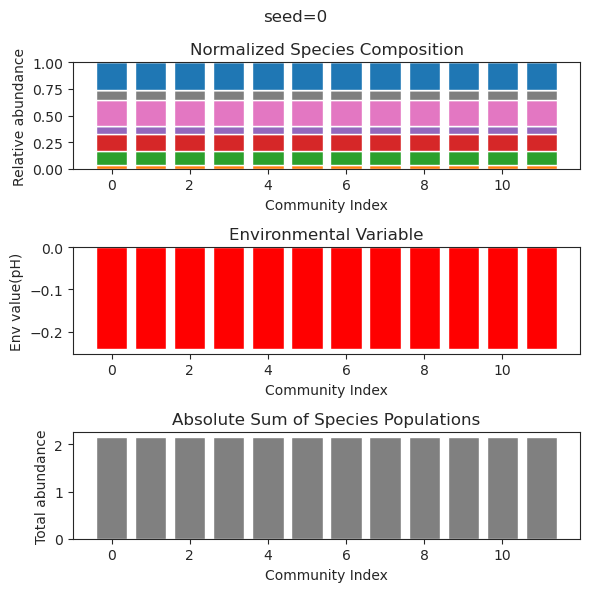

{'species': array([4.24810389e-001, 7.16189751e-002, 2.96439388e-323, 0.00000000e+000,
       1.85793444e-001, 1.66359983e-002, 4.67207358e-217, 1.79108868e-002,
       3.10322972e-001, 3.65316095e-051, 6.16781890e-001, 3.85670849e-001]), 'env': array([-0.25690536])}
{'species': array([4.28484671e-001, 8.88138343e-002, 0.00000000e+000, 0.00000000e+000,
       2.12162530e-001, 2.53247897e-002, 7.40450312e-216, 3.07679787e-002,
       2.81433010e-001, 2.69505024e-049, 5.80391541e-001, 3.73539315e-001]), 'env': array([-0.24448296])}
{'species': array([4.32532932e-001, 8.07489150e-002, 0.00000000e+000, 0.00000000e+000,
       2.02501259e-001, 2.43352365e-002, 1.31623373e-218, 1.99399053e-002,
       3.03811087e-001, 4.32196278e-054, 6.15813985e-001, 3.67695826e-001]), 'env': array([-0.26198588])}
{'species': array([4.24570410e-001, 7.25352727e-002, 0.00000000e+000, 0.00000000e+000,
       1.87007930e-001, 1.69019657e-002, 1.11979146e-214, 1.89480017e-002,
       3.07570126e-001, 8.33429761

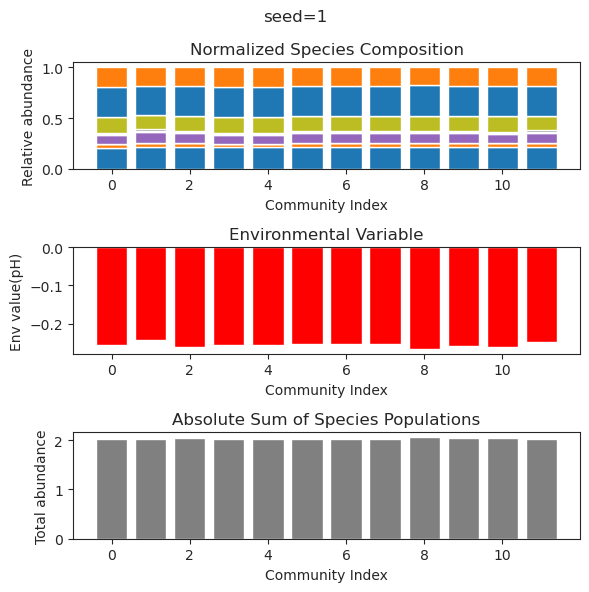

{'species': array([ 5.91017760e-01,  7.08247746e-01,  1.02948285e-01,  5.45930628e-80,
        7.23638904e-47, -7.69137160e-53,  1.74048097e-01,  9.69524829e-02,
       -4.92582491e-65, -1.14438009e-50,  6.52374570e-24,  6.63480901e-01]), 'env': array([-0.12344063])}
{'species': array([ 5.91017760e-01,  7.08247746e-01,  1.02948285e-01, -6.91445147e-61,
       -1.20108465e-38, -1.36075698e-37,  1.74048097e-01,  9.69524829e-02,
       -2.19409031e-52,  3.32612775e-37,  3.57971399e-17,  6.63480901e-01]), 'env': array([-0.12344063])}
{'species': array([ 5.91017760e-01,  7.08247746e-01,  1.02948285e-01, -5.17695653e-88,
        1.38788675e-62,  2.68005421e-57,  1.74048097e-01,  9.69524829e-02,
       -1.61143685e-76,  4.77482302e-53, -1.07843073e-25,  6.63480901e-01]), 'env': array([-0.12344063])}
{'species': array([ 5.91017760e-01,  7.08247746e-01,  1.02948285e-01,  3.41015462e-94,
       -1.17091371e-67, -1.80199983e-60,  1.74048097e-01,  9.69524829e-02,
       -2.90273719e-84, -1.2687770

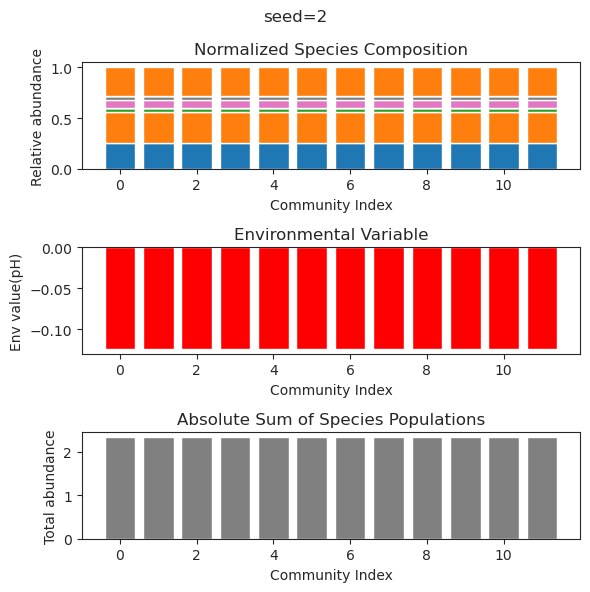

{'species': array([ 8.10138739e-003,  3.57991891e-001, -3.37691617e-124,
        1.70048650e-001,  6.99009212e-002,  2.37093141e-001,
        3.65712283e-001,  5.32893765e-110,  1.18710611e-001,
        4.03086581e-001, -2.87209013e-056,  1.24322970e-001]), 'env': array([-0.0955018])}
{'species': array([ 8.10138739e-003,  3.57991891e-001,  1.20335006e-122,
        1.70048650e-001,  6.99009212e-002,  2.37093141e-001,
        3.65712283e-001,  2.44786768e-106,  1.18710611e-001,
        4.03086581e-001, -2.52884372e-054,  1.24322970e-001]), 'env': array([-0.0955018])}
{'species': array([ 8.10138739e-003,  3.57991891e-001,  3.28813336e-116,
        1.70048650e-001,  6.99009212e-002,  2.37093141e-001,
        3.65712283e-001, -1.55084430e-104,  1.18710611e-001,
        4.03086581e-001, -2.62482061e-042,  1.24322970e-001]), 'env': array([-0.0955018])}
{'species': array([ 8.10138739e-003,  3.57991891e-001,  1.33489557e-119,
        1.70048650e-001,  6.99009212e-002,  2.37093141e-001,
        

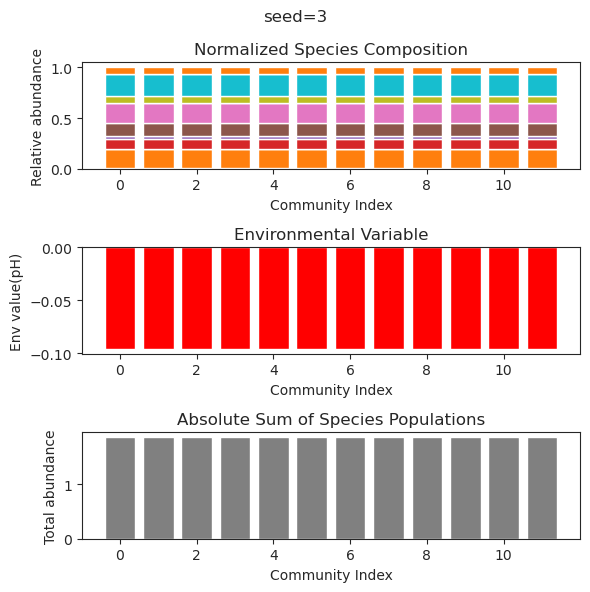

{'species': array([ 1.41079573e-27,  6.56438114e-01,  7.27889987e-01, -6.08062052e-35,
        1.39238710e-44,  6.38740158e-43,  7.31557550e-01, -1.38159097e-35,
       -1.57117484e-53,  2.55685436e-53,  1.08843557e-56,  8.56852551e-58]), 'env': array([-0.51003038])}
{'species': array([-7.05414378e-20,  6.56438114e-01,  7.27889987e-01,  1.43507975e-23,
       -2.53236414e-31, -2.46594152e-26,  7.31557550e-01,  1.89850991e-26,
       -4.54196094e-36,  4.41555068e-37, -2.63275731e-40,  1.94250114e-39]), 'env': array([-0.51003038])}
{'species': array([ 8.57560073e-29,  6.56438114e-01,  7.27889987e-01, -6.31531183e-38,
        4.72285075e-46,  8.66246986e-43,  7.31557550e-01, -2.94626786e-39,
       -1.06647987e-55,  9.95356035e-50, -4.60575116e-58,  1.64383898e-56]), 'env': array([-0.51003038])}
{'species': array([-1.22827459e-23,  6.56438114e-01,  7.27889987e-01,  2.06222850e-33,
        1.57640253e-42,  4.57845946e-40,  7.31557550e-01,  1.89383583e-36,
        1.93270187e-50,  4.2760060

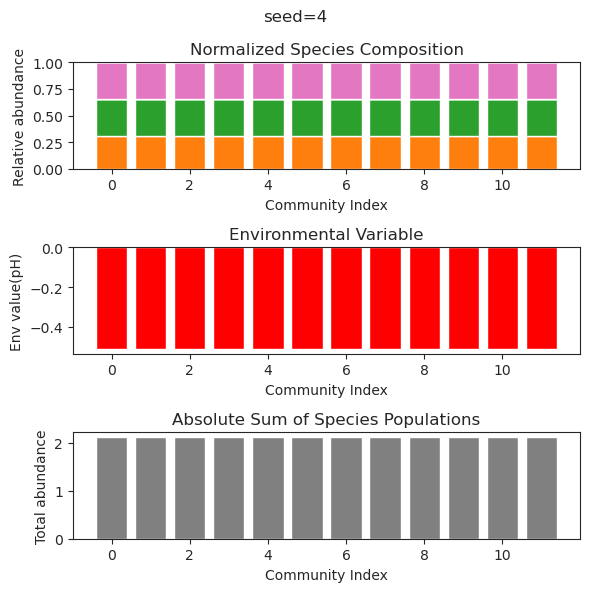

{'species': array([ 9.40818147e-01, -4.19562035e-48,  4.96911979e-01, -1.77946923e-70,
        9.72754602e-81,  1.31516741e-15,  1.89423607e-79,  3.87456572e-01,
        3.94423525e-88,  6.10481758e-73, -6.37412872e-62,  5.10641794e-01]), 'env': array([-0.66274489])}
{'species': array([-3.18610661e-45,  3.65674031e-01,  9.83940668e-46,  7.54035921e-01,
        1.30381164e-45, -1.05868644e-49, -1.47802631e-16, -5.13161183e-44,
        6.36936508e-01,  1.20109895e-47,  3.90252665e-46,  1.87996099e-01]), 'env': array([0.02413923])}
{'species': array([ 9.40818147e-01, -3.23216854e-38,  4.96911979e-01, -3.69253713e-52,
       -1.04799261e-54,  8.47039453e-16, -1.75885088e-55,  3.87456572e-01,
       -1.49782776e-71, -4.20770594e-63,  4.32851227e-44,  5.10641794e-01]), 'env': array([-0.66274489])}
{'species': array([-1.21142987e-79,  3.65674031e-01, -6.72742360e-75,  7.54035921e-01,
       -3.30884839e-66, -5.26668772e-39,  1.95275733e-14,  1.01505144e-62,
        6.36936508e-01, -5.32473143

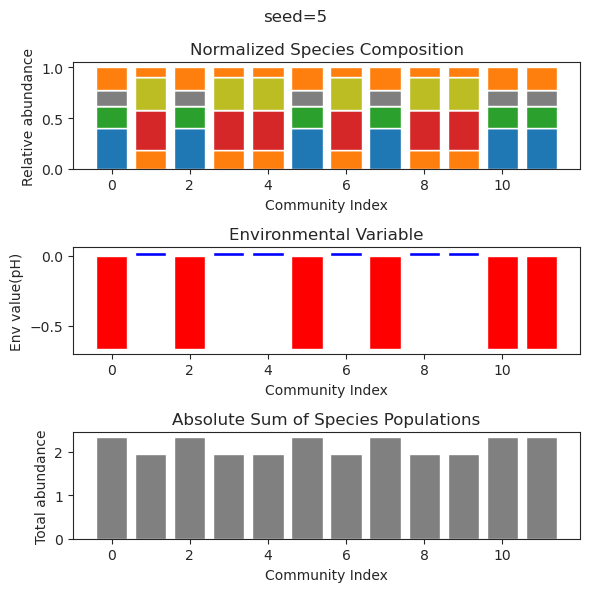

{'species': array([ 3.22788327e-42, -1.96049802e-31, -4.62462617e-43,  1.06435026e-43,
       -1.88245830e-43, -3.51186755e-14,  3.85605043e-54,  6.76697349e-01,
        2.66799025e-38,  1.01733907e+00,  7.70674663e-01,  2.10352943e-27]), 'env': array([-0.40370559])}
{'species': array([ 3.13919762e-49, -8.93183776e-29,  1.20940893e-51,  2.65003118e-48,
       -1.60327759e-44, -1.05360640e-14, -2.35265148e-51,  6.76697349e-01,
        4.95828536e-37,  1.01733907e+00,  7.70674663e-01, -1.26198684e-27]), 'env': array([-0.40370559])}
{'species': array([ 4.98931690e-49, -3.44484855e-32, -5.53208711e-53,  1.15707004e-48,
       -2.74163578e-42,  4.17531325e-15,  4.79524022e-61,  6.76697349e-01,
       -2.11849976e-44,  1.01733907e+00,  7.70674663e-01, -2.09559600e-31]), 'env': array([-0.40370559])}
{'species': array([-8.05939789e-45, -1.13160650e-37, -7.78364522e-48,  4.13237598e-46,
       -6.23607096e-46, -1.37051934e-15,  4.53307031e-49,  6.76697349e-01,
       -3.17059255e-42,  1.0173390

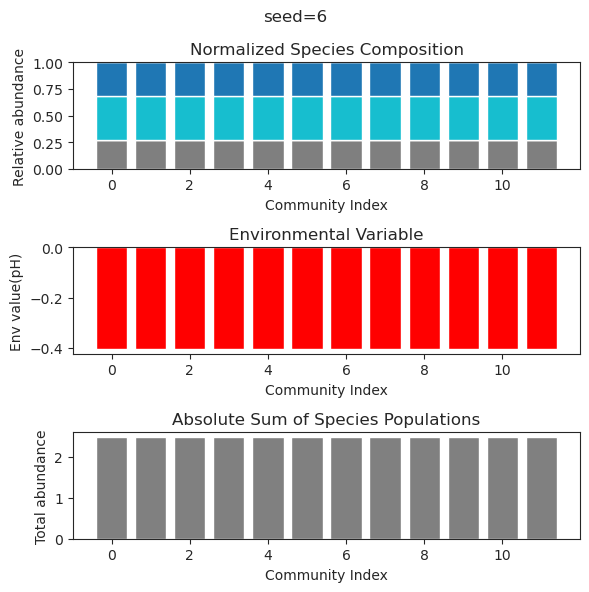

{'species': array([-1.84668343e-76, -1.12203890e-67, -2.15593092e-66,  6.94327591e-01,
        1.34996802e+00, -2.88301538e-69,  1.30072423e-28, -8.81288545e-81,
        8.63829304e-02,  1.92089152e-37,  4.71984074e-77,  2.75380381e-59]), 'env': array([-0.66817485])}
{'species': array([-3.37355664e-58, -8.67905963e-54,  5.08017193e-51,  6.94327591e-01,
        1.34996802e+00, -1.61740732e-51,  1.07043698e-26, -1.20347253e-58,
        8.63829304e-02,  9.49994828e-38, -1.84889097e-60, -3.54324011e-44]), 'env': array([-0.66817485])}
{'species': array([ 4.46745535e-71, -2.09692919e-64, -1.02960754e-63,  6.94327591e-01,
        1.34996802e+00, -1.51257587e-64,  7.26343655e-28,  4.47381759e-74,
        8.63829304e-02, -9.11475909e-45,  2.56956482e-73, -7.64672023e-60]), 'env': array([-0.66817485])}
{'species': array([ 1.99858695e-90,  1.25729326e-86,  3.12816201e-77,  6.94327591e-01,
        1.34996802e+00,  8.36931641e-81,  2.91462571e-25, -1.15752346e-94,
        8.63829304e-02,  7.6418759

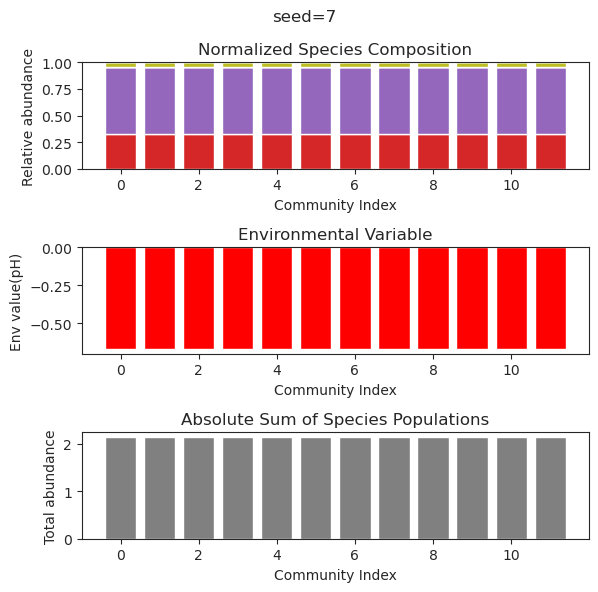

{'species': array([ 1.15420551e-01,  5.00764508e-71, -2.18490627e-72,  4.20122844e-02,
        2.51797375e-02,  1.12886614e-01,  3.90855624e-12,  1.96640364e-01,
        3.55654952e-01,  6.97650327e-01,  4.80038521e-02,  3.73323042e-01]), 'env': array([-0.42184986])}
{'species': array([1.15420551e-01, 2.94577532e-47, 7.44560725e-92, 4.20122846e-02,
       2.51797380e-02, 1.12886614e-01, 7.47946894e-12, 1.96640364e-01,
       3.55654952e-01, 6.97650327e-01, 4.80038520e-02, 3.73323042e-01]), 'env': array([-0.42184986])}
{'species': array([ 1.15420551e-001, -2.50814129e-036, -9.28363798e-100,
        4.20122844e-002,  2.51797375e-002,  1.12886614e-001,
        3.90409754e-012,  1.96640364e-001,  3.55654952e-001,
        6.97650327e-001,  4.80038521e-002,  3.73323042e-001]), 'env': array([-0.42184986])}
{'species': array([ 1.15420552e-001, -1.18444370e-134,  4.20642846e-176,
        4.20122850e-002,  2.51797391e-002,  1.12886614e-001,
        1.45359424e-012,  1.96640363e-001,  3.55654951e

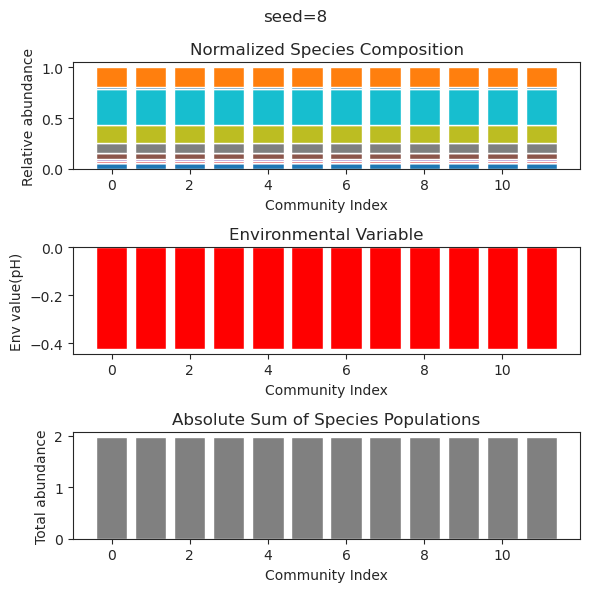

{'species': array([ 6.00721823e-01, -1.80246917e-58, -4.05981074e-61, -9.37645272e-76,
        4.73652358e-01,  1.84272845e-36,  6.14281220e-01,  7.55559679e-29,
        5.17377539e-72, -6.27101852e-15,  5.91867685e-01, -1.38841205e-74]), 'env': array([0.14944226])}
{'species': array([ 6.00721823e-001, -7.62360698e-095, -3.93358624e-104,
       -3.41519663e-089,  4.73652358e-001,  2.55560491e-025,
        6.14281220e-001,  1.21007234e-016, -2.07586044e-065,
       -3.36072322e-030,  5.91867685e-001,  3.71060004e-110]), 'env': array([0.14944226])}
{'species': array([ 6.00721823e-01,  1.41717252e-82,  2.44255300e-87, -1.50745433e-82,
        4.73652358e-01,  1.06319790e-23,  6.14281220e-01, -5.34631529e-15,
       -1.58672099e-67, -2.46171435e-23,  5.91867685e-01,  1.34430816e-98]), 'env': array([0.14944226])}
{'species': array([ 6.00721823e-01, -5.32152827e-48,  2.06446322e-48, -1.00849378e-56,
        4.73652358e-01,  6.57367863e-34,  6.14281220e-01,  1.92519846e-27,
       -8.89680865

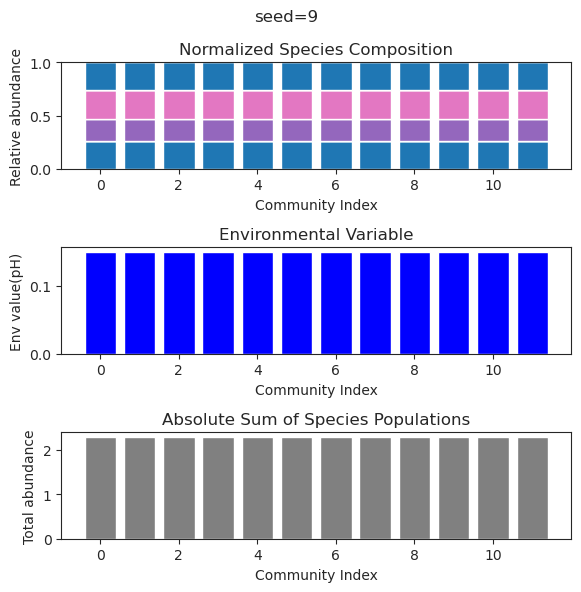

{'species': array([2.14275548e-001, 2.33172870e-004, 4.19449927e-003, 1.16189795e-168,
       8.42321231e-001, 1.04624020e+000, 4.15629569e-188, 2.19395840e-005,
       0.00000000e+000, 1.11526253e-001, 9.66844269e-003, 8.53456186e-005]), 'env': array([-0.29966489])}
{'species': array([ 2.14074651e-001,  3.18779497e-001,  4.87537309e-003,
        4.21991868e-165,  5.42354749e-002,  1.27506745e-002,
        9.59374559e-190,  6.73699233e-001, -4.94065646e-324,
        4.87850622e-002,  4.80857630e-001,  5.17216384e-003]), 'env': array([-0.05082833])}
{'species': array([2.94617844e-002, 2.06233066e-002, 3.92446897e-001, 2.79551549e-164,
       3.44580142e-001, 1.16056943e+000, 4.88231518e-188, 7.66868339e-002,
       4.94065646e-324, 1.11117597e-001, 2.77622951e-001, 2.03743100e-004]), 'env': array([-0.60715937])}
{'species': array([8.09746742e-002, 3.88603053e-004, 1.78091420e-002, 3.75316020e-167,
       8.95679294e-001, 1.22486330e+000, 4.61626396e-187, 2.39995551e-004,
       4.940656

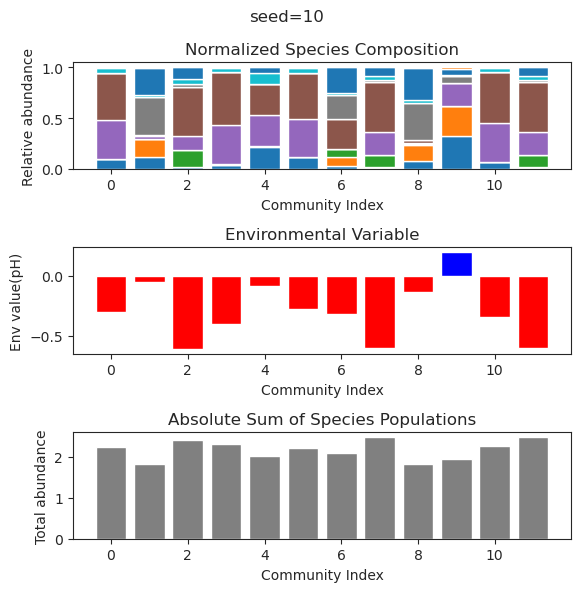

{'species': array([ 3.27624320e-001,  3.76128660e-001,  7.09637502e-001,
        3.49082127e-001,  1.80110331e-002,  6.95814288e-079,
       -8.93465482e-073,  2.86767490e-032,  6.14364399e-002,
        4.50884919e-241,  1.51094222e-201, -1.39802927e-090]), 'env': array([-0.06025884])}
{'species': array([ 3.27624320e-001,  3.76128660e-001,  7.09637502e-001,
        3.49082127e-001,  1.80110332e-002,  9.60563806e-044,
        6.06168032e-044, -1.84598641e-028,  6.14364398e-002,
        1.83416347e-105, -4.56260591e-089, -2.39898300e-057]), 'env': array([-0.06025884])}
{'species': array([ 3.27624320e-01,  3.76128660e-01,  7.09637502e-01,  3.49082127e-01,
        1.80110332e-02, -1.49954067e-56,  1.54752095e-56, -1.58236930e-30,
        6.14364398e-02,  1.00907157e-99,  2.43237260e-88,  7.87832061e-64]), 'env': array([-0.06025884])}
{'species': array([ 3.27624320e-001,  3.76128660e-001,  7.09637502e-001,
        3.49082127e-001,  1.80110332e-002, -2.36445310e-067,
       -4.25571411e-062,

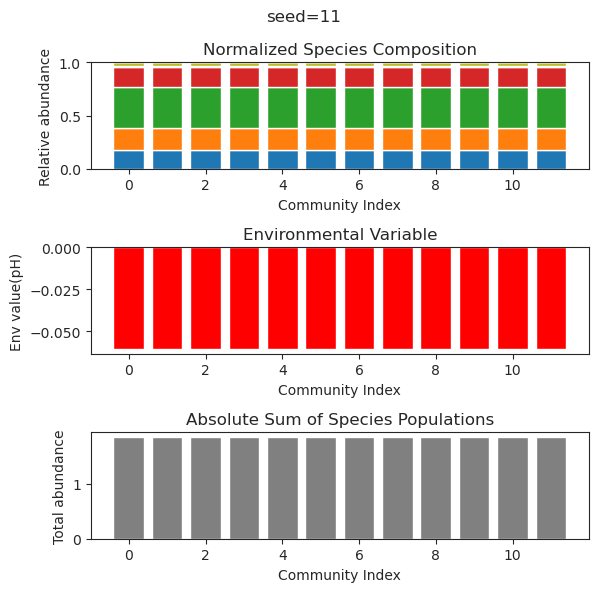

{'species': array([ 6.84260864e-01, -9.92852221e-31,  1.14370198e-01,  2.47768126e-33,
        3.54285221e-01, -8.25582110e-42,  8.36921552e-12, -4.04058297e-41,
        1.22720388e-78, -2.25330242e-39,  6.87451952e-01,  1.81480831e-01]), 'env': array([-0.09926055])}
{'species': array([ 6.84260864e-001,  4.18453083e-027,  1.14370198e-001,
       -1.31414024e-033,  3.54285221e-001, -1.29555016e-035,
        1.66343272e-012,  1.54774333e-046, -6.67892369e-104,
        1.39779232e-047,  6.87451952e-001,  1.81480831e-001]), 'env': array([-0.09926055])}
{'species': array([ 6.84260864e-01,  7.23538064e-28,  1.14370198e-01, -3.99581844e-30,
        3.54285221e-01,  1.33846648e-34,  2.85737307e-12,  2.61498324e-36,
        3.94873963e-70,  1.42496741e-37,  6.87451952e-01,  1.81480831e-01]), 'env': array([-0.09926055])}
{'species': array([ 6.84260864e-01,  1.96500733e-17,  1.14370198e-01, -8.69427588e-21,
        3.54285221e-01, -4.24339310e-31, -1.21348832e-14, -1.42955245e-28,
        6.64364

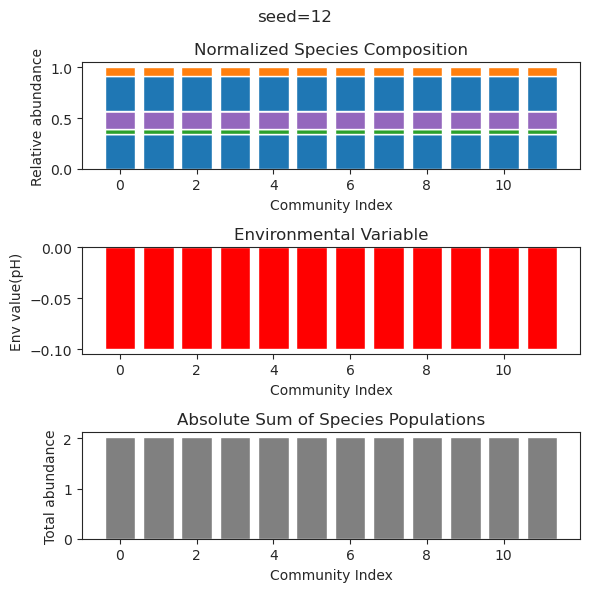

{'species': array([ 9.65964627e-099,  3.34023382e-005, -1.76961769e-027,
        7.47439627e-001, -1.05911383e-094,  2.73329641e-001,
        1.64184992e-001,  1.70918062e-001,  1.37010335e-105,
        3.47774702e-001,  5.85420866e-088,  2.74180173e-001]), 'env': array([-0.51967391])}
{'species': array([-3.34441030e-37,  2.82126289e-03,  1.01639444e-35,  7.43663983e-01,
       -1.70521998e-42,  2.75019170e-01,  1.65559544e-01,  1.70012643e-01,
        4.46018941e-86,  3.47120865e-01, -4.63929817e-86,  2.75925783e-01]), 'env': array([-0.51970015])}
{'species': array([ 1.73875074e-026,  2.35256118e-003,  5.37093820e-029,
        7.44321921e-001, -4.31301644e-027,  2.74733492e-001,
        1.65315979e-001,  1.70166694e-001,  3.63492270e-103,
        3.47227997e-001, -1.85114858e-090,  2.75625693e-001]), 'env': array([-0.51970241])}
{'species': array([-3.25497261e-030,  2.48388301e-003,  2.43625078e-027,
        7.44138505e-001, -8.90877202e-031,  2.74813488e-001,
        1.65383722e-001,

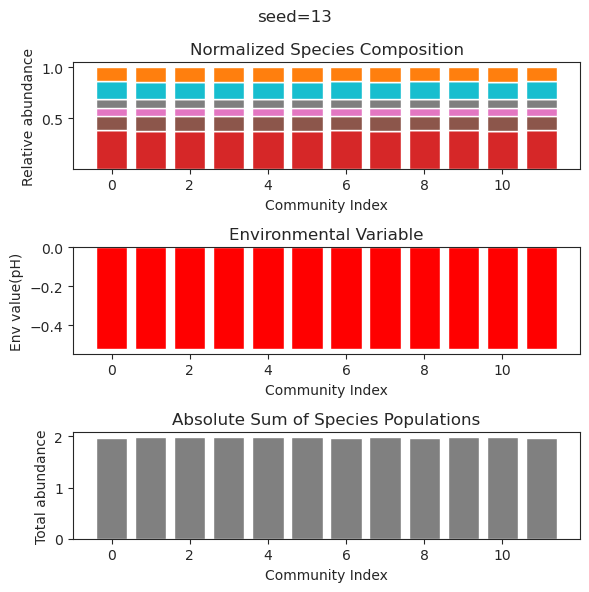

{'species': array([-8.48528996e-43,  2.21974026e-40,  3.63241148e-55,  1.63021635e-01,
        3.37442093e-01,  3.62540842e-01,  5.63682287e-02, -2.91270302e-51,
        4.44931085e-01,  4.39109084e-56,  5.19149247e-01,  3.05603994e-01]), 'env': array([0.0437256])}
{'species': array([-2.80615664e-59, -7.01977465e-53, -1.27734385e-82,  1.63021635e-01,
        3.37442093e-01,  3.62540842e-01,  5.63682287e-02, -6.09943548e-72,
        4.44931085e-01, -1.12576648e-87,  5.19149247e-01,  3.05603994e-01]), 'env': array([0.0437256])}
{'species': array([ 1.41542410e-43,  5.42477732e-50,  6.30581791e-01, -1.95964226e-17,
        6.74279641e-01,  7.01261599e-01,  1.03781621e-40,  2.65053292e-01,
        9.74761512e-27,  8.76335810e-47, -1.85127875e-38,  5.47413078e-50]), 'env': array([-0.01056213])}
{'species': array([ 2.77721623e-57,  6.44332338e-51, -3.84910749e-86,  1.63021635e-01,
        3.37442093e-01,  3.62540842e-01,  5.63682287e-02,  4.84189377e-74,
        4.44931085e-01, -2.31974360e-9

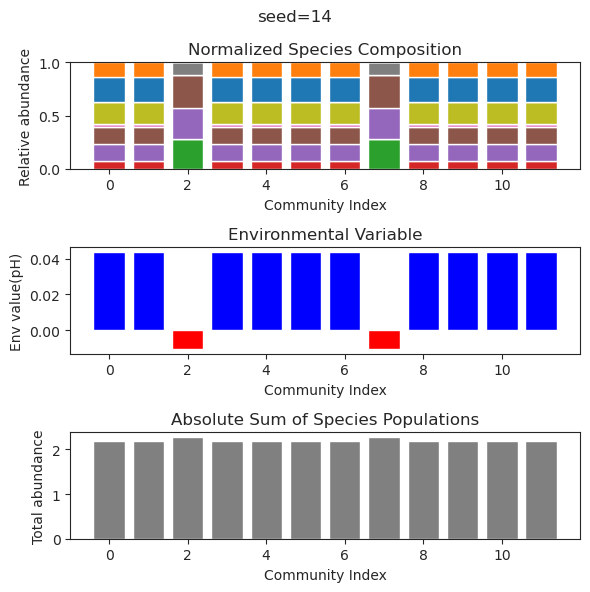

{'species': array([ 2.13844460e-034,  6.78030190e-001,  6.02978897e-111,
        6.54868065e-001,  2.12935305e-002,  5.88505960e-001,
        4.11833538e-001,  5.57988020e-002, -1.16718024e-131,
        1.53437563e-110,  6.30728079e-002, -2.76526246e-092]), 'env': array([0.24679267])}
{'species': array([ 3.28017590e-030,  6.78030190e-001, -7.67118083e-106,
        6.54868065e-001,  2.12935305e-002,  5.88505960e-001,
        4.11833538e-001,  5.57988020e-002,  1.04023821e-114,
        3.84277211e-097,  6.30728079e-002, -1.73255689e-081]), 'env': array([0.24679267])}
{'species': array([4.59832937e-043, 6.78030190e-001, 2.14836003e-148, 6.54868065e-001,
       2.12935305e-002, 5.88505960e-001, 4.11833538e-001, 5.57988020e-002,
       4.78788209e-181, 3.35964090e-157, 6.30728079e-002, 6.10548293e-124]), 'env': array([0.24679267])}
{'species': array([ 3.55227128e-034,  6.78030190e-001, -2.72139346e-116,
        6.54868065e-001,  2.12935305e-002,  5.88505960e-001,
        4.11833538e-001,  5

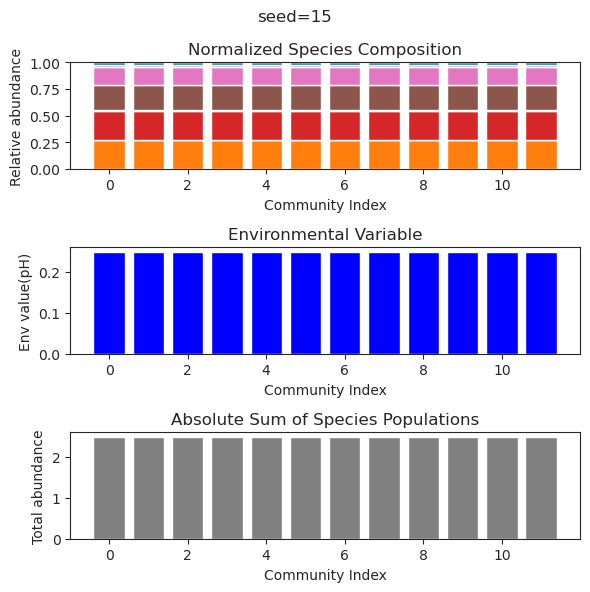

{'species': array([ 8.62261632e-001,  5.41388887e-035,  2.16541075e-003,
        2.75857271e-015, -3.20098512e-135,  1.24640020e-001,
        5.61400925e-079,  6.44013245e-001,  4.23249906e-105,
       -4.39477845e-034,  1.83272774e-001, -1.11292397e-144]), 'env': array([-0.12972057])}
{'species': array([ 4.24721513e-001,  7.94833725e-002,  1.82404138e-001,
        4.91980262e-001,  7.23468094e-002, -1.89971577e-040,
        2.07216158e-001,  2.29576492e-002,  1.74305472e-114,
        3.37330516e-001, -2.49726000e-018, -2.84162341e-057]), 'env': array([-0.10271788])}
{'species': array([ 4.24721513e-001,  7.94833725e-002,  1.82404138e-001,
        4.91980262e-001,  7.23468094e-002,  1.05193368e-036,
        2.07216158e-001,  2.29576492e-002,  3.54769831e-108,
        3.37330516e-001, -5.70053734e-016, -2.23864506e-057]), 'env': array([-0.10271788])}
{'species': array([ 4.24721513e-001,  7.94833725e-002,  1.82404138e-001,
        4.91980262e-001,  7.23468094e-002,  1.95288262e-047,
     

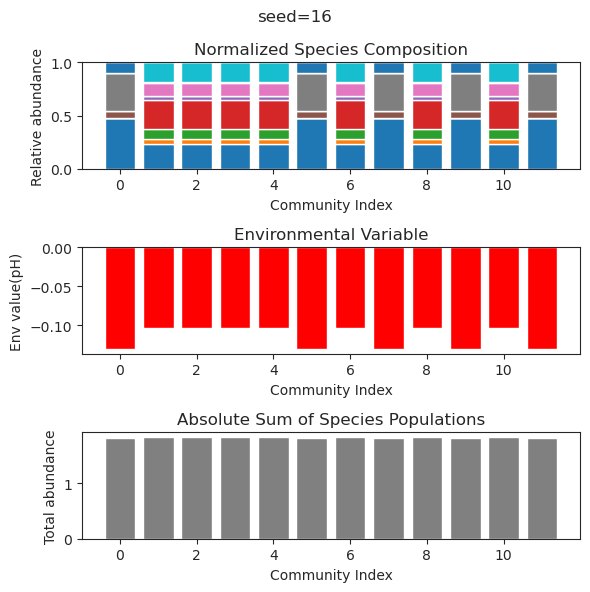

{'species': array([ 4.10247496e-01, -8.18057591e-22,  6.27329165e-01, -1.43597023e-49,
       -2.04281606e-47, -3.99622529e-34,  8.10948476e-01,  7.18415220e-17,
       -1.08461074e-25, -4.40658514e-42,  5.23327013e-20,  2.11320914e-01]), 'env': array([-0.2723608])}
{'species': array([ 4.10247496e-01,  1.23030396e-27,  6.27329165e-01,  1.61558079e-57,
        1.40508643e-62,  1.08673032e-47,  8.10948476e-01, -1.35177890e-19,
        2.17407717e-37,  1.17433064e-56, -2.60459856e-26,  2.11320914e-01]), 'env': array([-0.2723608])}
{'species': array([ 4.10247496e-01,  2.47030496e-25,  6.27329165e-01,  7.53115460e-52,
       -1.78140529e-55, -6.50078291e-41,  8.10948476e-01, -5.37256743e-19,
        1.86292175e-34, -5.33695939e-51, -1.14856891e-24,  2.11320914e-01]), 'env': array([-0.2723608])}
{'species': array([ 5.15818294e-002,  2.12833569e-001,  5.08969463e-001,
        6.05302116e-001,  3.49940568e-001,  5.48841408e-001,
       -1.15106781e-134, -1.17217370e-094, -1.05285813e-200,
    

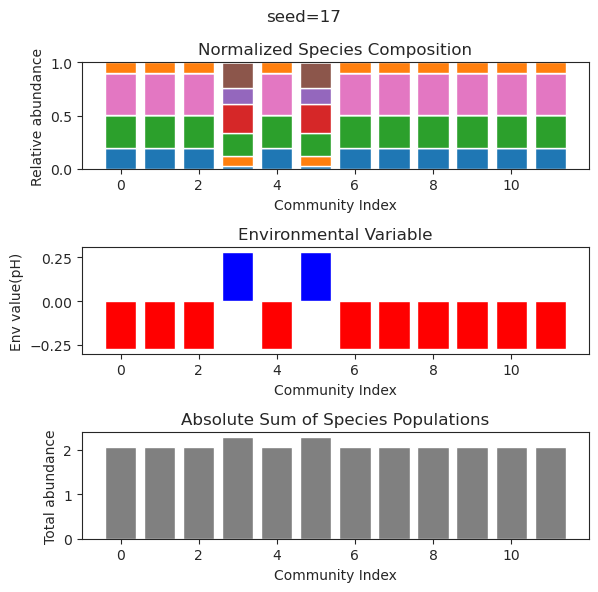

{'species': array([ 1.46423836e-33,  3.15764449e-61, -1.17348560e-70,  9.35533836e-01,
        4.79271113e-48, -7.65494451e-42,  3.01881492e-80,  5.99371965e-01,
        6.17814664e-01,  3.77111258e-01,  1.58097257e-01, -1.08732188e-51]), 'env': array([0.66170427])}
{'species': array([-5.37413922e-32,  3.22995608e-55,  3.00125306e-64,  9.35533836e-01,
       -7.80267869e-42,  2.52727010e-41,  3.28466241e-64,  5.99371965e-01,
        6.17814664e-01,  3.77111258e-01,  1.58097257e-01, -4.28009481e-43]), 'env': array([0.66170427])}
{'species': array([ 5.73521894e-32,  5.95647601e-53, -3.54952141e-62,  9.35533836e-01,
       -1.07249375e-37, -1.22763567e-42, -8.31825659e-63,  5.99371965e-01,
        6.17814664e-01,  3.77111258e-01,  1.58097257e-01, -2.97388937e-40]), 'env': array([0.66170427])}
{'species': array([ 1.90788696e-35, -3.84194964e-67, -1.22123776e-75,  9.35533836e-01,
       -4.84868228e-45,  3.99500500e-52, -1.08197418e-78,  5.99371965e-01,
        6.17814664e-01,  3.77111258e-

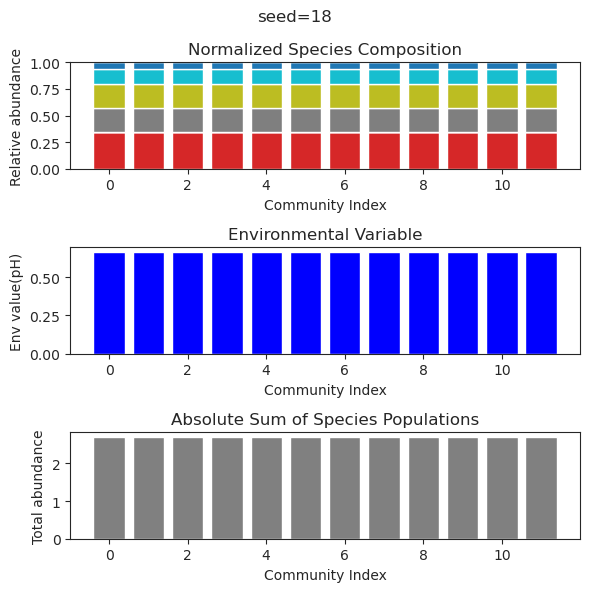

{'species': array([ 3.09834895e-01, -7.51463371e-26,  6.63889708e-01, -3.47447758e-66,
        4.01391462e-01, -3.75398820e-70,  1.05844078e-50,  1.70572490e-01,
       -1.23250377e-31,  9.00407024e-84,  2.52280447e-01,  7.69665986e-01]), 'env': array([-0.34995172])}
{'species': array([ 3.09834895e-01, -9.47989702e-29,  6.63889708e-01, -1.37750021e-68,
        4.01391462e-01,  9.71500921e-69,  3.98407058e-52,  1.70572490e-01,
       -1.65536926e-33,  1.06501388e-76,  2.52280447e-01,  7.69665986e-01]), 'env': array([-0.34995172])}
{'species': array([ 3.09834895e-01,  1.61595297e-23,  6.63889708e-01,  1.79089380e-63,
        4.01391462e-01, -5.60844946e-71,  1.14997568e-49,  1.70572490e-01,
       -8.37388943e-29, -1.31437108e-78,  2.52280447e-01,  7.69665986e-01]), 'env': array([-0.34995172])}
{'species': array([ 3.09834895e-01, -7.31385407e-28,  6.63889708e-01,  5.22668890e-47,
        4.01391462e-01, -1.11503546e-45,  9.52221395e-46,  1.70572490e-01,
        2.06470770e-30,  1.1297667

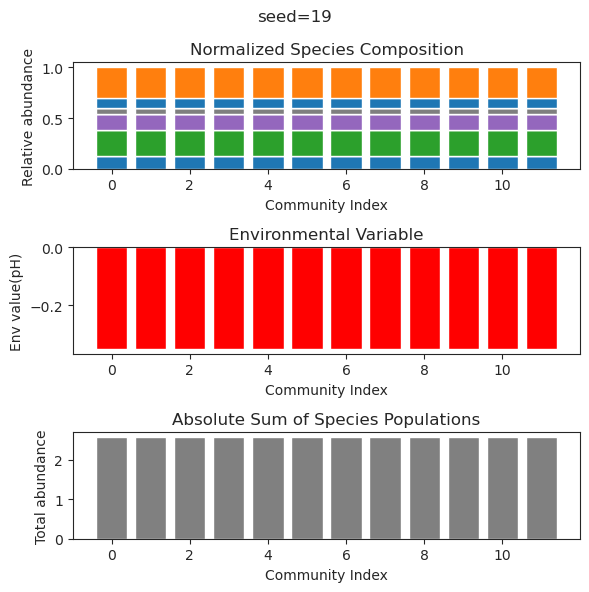

{'species': array([-3.32524431e-15, -1.61642005e-66, -7.85330481e-20,  5.33210243e-49,
       -7.33928005e-73,  6.29638239e-01,  1.49355249e-50,  9.07815984e-01,
        3.71981847e-55,  7.33401184e-01,  7.97942096e-72, -7.32324962e-33]), 'env': array([0.08930278])}
{'species': array([-2.69669768e-14, -2.88445644e-44, -7.12516018e-14,  4.64075086e-39,
        2.22152847e-56,  6.29638239e-01, -1.03264315e-57,  9.07815984e-01,
       -6.80992082e-46,  7.33401184e-01,  6.49429743e-55, -2.69892135e-25]), 'env': array([0.08930278])}
{'species': array([-1.47094326e-14, -1.79924674e-55,  2.20078885e-15,  1.50259642e-35,
        1.57788476e-61,  6.29638239e-01,  4.90693424e-59,  9.07815984e-01,
       -1.55869953e-45,  7.33401184e-01,  7.75552551e-59, -1.47041144e-28]), 'env': array([0.08930278])}
{'species': array([ 1.20461307e-13, -1.25908233e-52,  1.75903436e-15,  9.52016503e-36,
        3.00495476e-55,  6.29638239e-01, -9.60994859e-56,  9.07815984e-01,
       -5.86741011e-42,  7.33401184e-

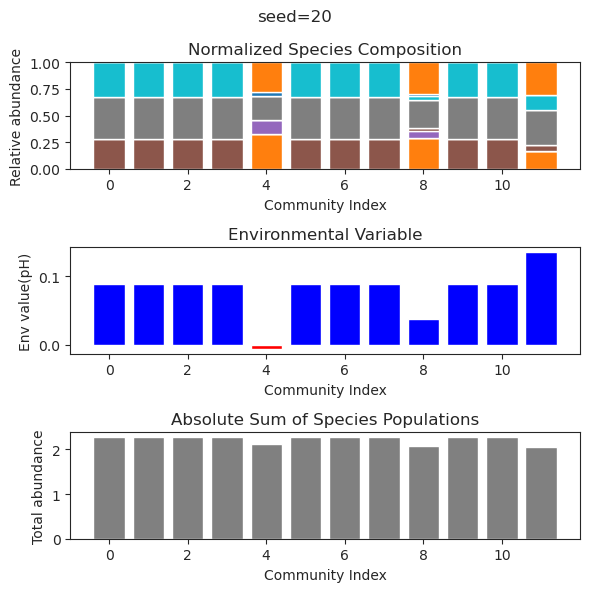

{'species': array([ 6.61927592e-01,  3.33533736e-01, -5.33789019e-57, -3.54239536e-57,
       -2.06771767e-58, -6.46521315e-49, -1.89641350e-26, -8.19017873e-44,
        4.54917212e-02,  4.93709323e-01,  5.72385372e-01,  2.33699220e-32]), 'env': array([0.16189015])}
{'species': array([-1.88524310e-86,  2.94490723e-71,  4.48066943e-01,  2.73651145e-73,
        6.81641902e-22,  3.08406176e-01,  4.58463029e-01,  1.81521353e-01,
        5.85753530e-02, -1.49516962e-90,  1.78128532e-58,  6.54331662e-01]), 'env': array([-0.45427981])}
{'species': array([4.71718366e-75, 6.84481578e-64, 4.48066943e-01, 1.41899967e-63,
       1.39773202e-22, 3.08406176e-01, 4.58463029e-01, 1.81521353e-01,
       5.85753530e-02, 3.45404021e-81, 4.82768189e-48, 6.54331662e-01]), 'env': array([-0.45427981])}
{'species': array([ 1.70349700e-78,  4.74750961e-68,  4.48066943e-01,  2.75302324e-66,
        5.24362023e-25,  3.08406176e-01,  4.58463029e-01,  1.81521353e-01,
        5.85753530e-02,  2.64607682e-82, -1.789

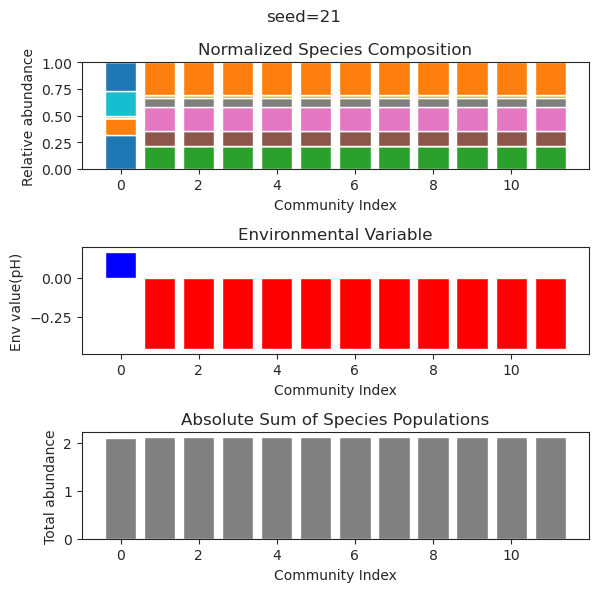

{'species': array([ 9.58337701e-01,  7.39444208e-53, -2.26796395e-64, -7.54473246e-26,
        8.41982138e-01, -3.89798571e-58,  4.18006297e-55,  2.62595182e-48,
       -5.74502193e-31,  3.50044160e-58,  3.33488360e-48,  3.94242168e-01]), 'env': array([-0.36124654])}
{'species': array([ 9.58337701e-01, -6.79710714e-60, -2.43819813e-62,  3.69857722e-30,
        8.41982138e-01,  1.00954738e-63,  1.40557472e-53,  9.26167881e-47,
        1.20614209e-37,  4.77351824e-58,  1.56659642e-43,  3.94242168e-01]), 'env': array([-0.36124654])}
{'species': array([ 5.34984439e-02, -1.97943428e-44,  2.50135501e-01,  3.52212747e-01,
        2.97108059e-01, -8.25450430e-40,  1.79751296e-01,  5.93264866e-88,
        2.62371466e-01,  3.19203270e-01,  1.41061004e-28,  3.16364695e-01]), 'env': array([-0.06175529])}
{'species': array([ 9.58337701e-01,  9.41680524e-51,  3.66567092e-60,  2.05990138e-28,
        8.41982138e-01, -1.52527960e-58,  7.03581314e-54, -3.57539814e-48,
        3.27440858e-40, -8.2805683

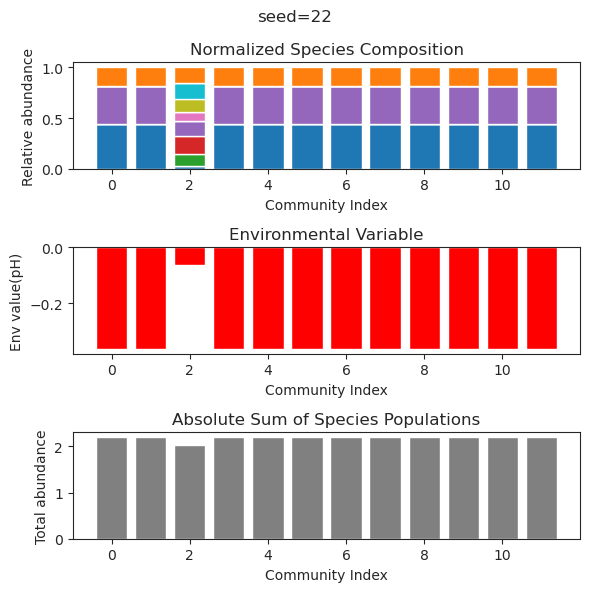

{'species': array([ 2.74674350e-01,  1.76730711e-44, -2.72583544e-47, -1.63944172e-42,
        5.63308527e-01, -1.00924293e-44,  2.01138534e-01,  3.47849565e-01,
        3.33008892e-01,  3.04756845e-48, -1.62327759e-14,  3.92316415e-01]), 'env': array([-0.15789464])}
{'species': array([ 2.74674350e-01, -1.32559610e-21, -8.04161040e-53, -1.46585770e-21,
        5.63308527e-01, -2.34601772e-83,  2.01138534e-01,  3.47849565e-01,
        3.33008892e-01,  4.20916720e-63, -3.84178783e-17,  3.92316415e-01]), 'env': array([-0.15789464])}
{'species': array([ 2.74674350e-01,  6.51315826e-29, -2.24191178e-42,  1.16800813e-28,
        5.63308527e-01,  2.69135322e-41,  2.01138534e-01,  3.47849565e-01,
        3.33008892e-01,  3.80848184e-40,  3.25959048e-14,  3.92316415e-01]), 'env': array([-0.15789464])}
{'species': array([ 2.74674350e-01,  1.62732879e-40,  6.73703748e-68,  3.04204975e-40,
        5.63308527e-01,  1.87050827e-97,  2.01138534e-01,  3.47849565e-01,
        3.33008892e-01,  3.4351240

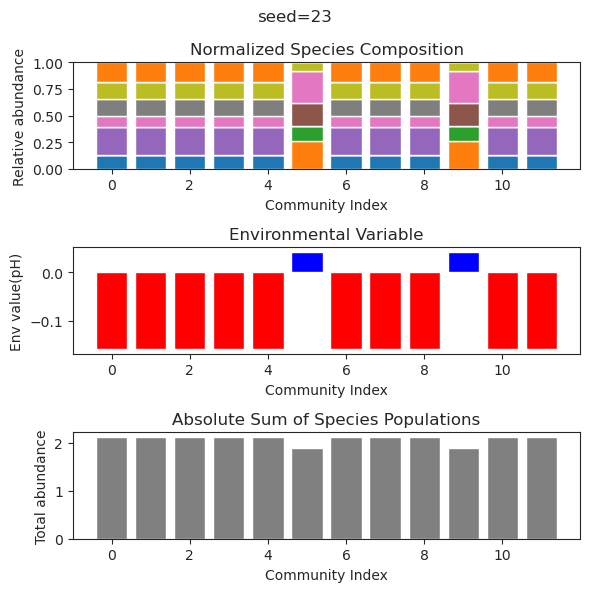

{'species': array([ 2.74053872e-01, -5.58935590e-55, -1.41349841e-51,  1.44369383e-01,
        9.17527626e-01, -4.90302220e-43,  5.75845098e-67,  5.93963033e-01,
        1.15617953e-66, -1.56334452e-16, -3.42969204e-39, -9.53374179e-41]), 'env': array([0.18417784])}
{'species': array([ 1.67383477e-106,  2.07353110e-001,  8.53039691e-014,
        1.81655677e-060,  1.35722074e-043, -2.08961035e-070,
        7.92981037e-001, -2.42605168e-019,  3.12903511e-018,
        5.04957484e-001,  4.16430429e-001, -3.65507738e-102]), 'env': array([0.29676383])}
{'species': array([ 2.74053872e-01,  1.03500291e-71,  6.07471383e-64,  1.44369383e-01,
        9.17527626e-01,  1.02735494e-72,  1.50114571e-77,  5.93963033e-01,
       -2.54720900e-82,  1.73298366e-15,  9.25634815e-46,  6.31482962e-43]), 'env': array([0.18417784])}
{'species': array([ 2.74053872e-01,  4.80584211e-51,  9.96502077e-51,  1.44369383e-01,
        9.17527626e-01,  1.39163956e-48,  1.18771222e-58,  5.93963033e-01,
       -2.28895032

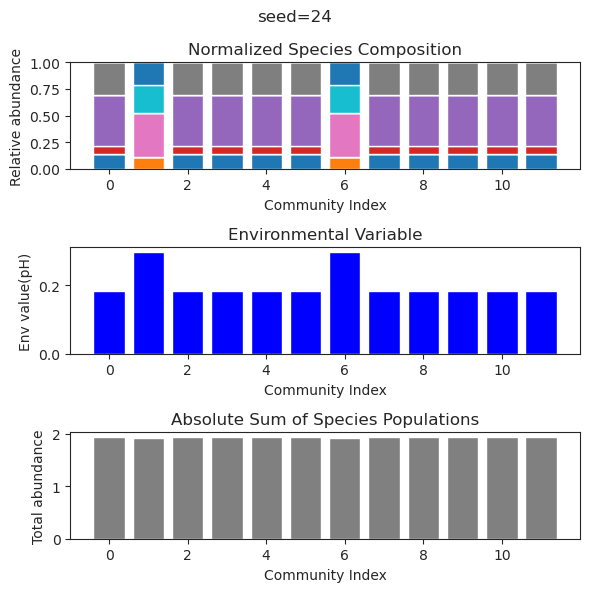

{'species': array([ 4.47697676e-01,  2.92807530e-01,  2.10093995e-36, -6.80259752e-38,
        1.13636046e-01,  2.79244669e-31,  1.95861901e-01,  5.78760580e-01,
        4.26563992e-39,  2.00100481e-01, -5.92982212e-38,  1.50791389e-03]), 'env': array([-0.20859987])}
{'species': array([ 4.47440960e-01,  2.93427456e-01, -1.98665657e-30, -7.80486404e-28,
        1.13153003e-01,  9.68227537e-28,  1.96334399e-01,  5.78493987e-01,
        2.85057468e-30,  1.99976541e-01,  9.35321207e-34,  1.35936465e-03]), 'env': array([-0.20868627])}
{'species': array([ 4.47626741e-01,  2.92978884e-01,  3.67192191e-34, -1.31492828e-34,
        1.13502069e-01,  6.23202940e-31,  1.95992660e-01,  5.78686755e-01,
        6.44082423e-36,  2.00066188e-01,  8.44337011e-38,  1.46716452e-03]), 'env': array([-0.20862367])}
{'species': array([ 4.47698029e-01,  2.92806675e-01,  6.13665546e-37,  5.09036686e-41,
        1.13636716e-01,  5.33191219e-31,  1.95861249e-01,  5.78760949e-01,
        1.26399523e-45,  2.0010065

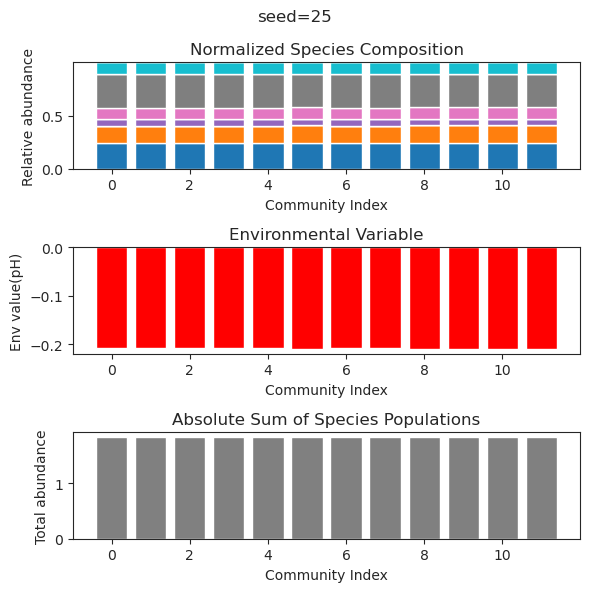

{'species': array([-1.22507773e-108,  5.56394564e-110,  1.27223272e-189,
        5.24430665e-193, -2.51877747e-164, -3.72107549e-152,
        3.45383786e-001,  5.74041746e-184,  6.97848685e-002,
        6.44578146e-002,  8.86771627e-001,  7.92477997e-001]), 'env': array([-0.6961035])}
{'species': array([ 6.24316298e-096,  7.41311534e-104, -6.45808149e-155,
       -1.01840602e-153,  3.34683469e-142,  1.38680969e-139,
        3.45383786e-001,  7.70837686e-160,  6.97848685e-002,
        6.44578146e-002,  8.86771627e-001,  7.92477997e-001]), 'env': array([-0.6961035])}
{'species': array([-8.80412061e-118,  8.79523608e-114, -4.40150832e-191,
        4.37905688e-196,  1.68112347e-181,  9.46303310e-163,
        3.45383786e-001,  4.74731273e-193,  6.97848685e-002,
        6.44578146e-002,  8.86771627e-001,  7.92477997e-001]), 'env': array([-0.6961035])}
{'species': array([-1.51307370e-085,  6.11834307e-082, -9.91767244e-136,
        1.21030536e-133,  5.69670895e-123,  5.34709923e-118,
        

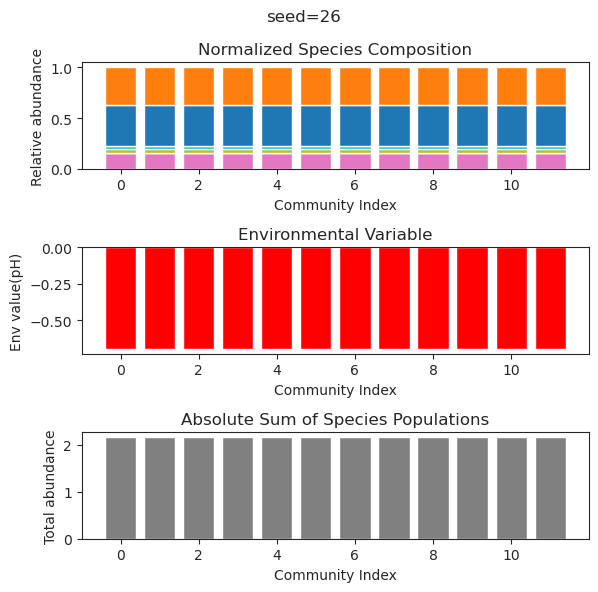

{'species': array([1.59851707e-289, 5.65984649e-001, 6.64108516e-236, 1.48865690e-001,
       2.94463125e-321, 2.81712855e-002, 3.56761944e-005, 4.59851411e-001,
       9.97182116e-002, 1.01192473e-016, 4.56326020e-001, 6.06026848e-008]), 'env': array([-0.17331012])}
{'species': array([ 7.87585179e-291,  5.65906117e-001,  9.64736854e-238,
        1.48879794e-001, -2.47032823e-323,  2.81756524e-002,
        8.36455867e-006,  4.59811541e-001,  9.97466361e-002,
        4.93514917e-017,  4.56395408e-001,  7.54872615e-008]), 'env': array([-0.17328131])}
{'species': array([8.51336959e-294, 6.45367441e-001, 1.80171469e-232, 1.14032131e-001,
       3.92461046e-319, 1.11486294e-002, 1.14048996e-014, 5.19577305e-001,
       1.05864276e-001, 4.15791211e-017, 3.90843572e-001, 7.45514044e-005]), 'env': array([-0.20128349])}
{'species': array([4.55512587e-293, 5.55344798e-001, 3.32136908e-234, 1.56724385e-001,
       8.31611295e-320, 2.71604246e-002, 1.78246305e-012, 4.49960274e-001,
       9.341940

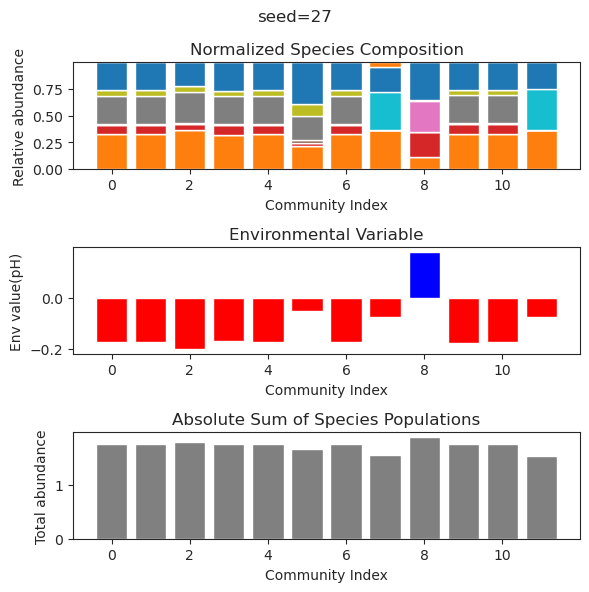

{'species': array([ 7.95241608e-32, -3.69995372e-70, -2.43255740e-30,  1.05669288e+00,
        3.03417720e-75, -6.92643548e-62,  1.17278720e+00,  1.17630052e-66,
       -4.30836923e-70,  8.02954762e-02, -7.45088763e-21, -1.32890218e-72]), 'env': array([0.46165357])}
{'species': array([-3.46627162e-28, -4.64658231e-71,  1.33523980e-27,  1.05669288e+00,
        8.99172768e-72, -5.26651904e-61,  1.17278720e+00, -1.45296000e-63,
       -1.08873089e-71,  8.02954762e-02,  1.14288212e-21, -3.28373560e-72]), 'env': array([0.46165357])}
{'species': array([ 6.22635876e-26, -9.00341920e-71,  6.88190988e-23,  1.05669288e+00,
        3.62817741e-69, -2.50536466e-60,  1.17278720e+00, -4.43045414e-62,
       -4.94455792e-69,  8.02954762e-02, -1.17467681e-22, -1.41255711e-68]), 'env': array([0.46165357])}
{'species': array([-1.96901823e-23, -4.96198610e-70, -3.19201115e-21,  1.05669288e+00,
        7.55123902e-71, -5.78242572e-56,  1.17278720e+00, -4.43271416e-62,
       -1.70592321e-69,  8.02954762e-

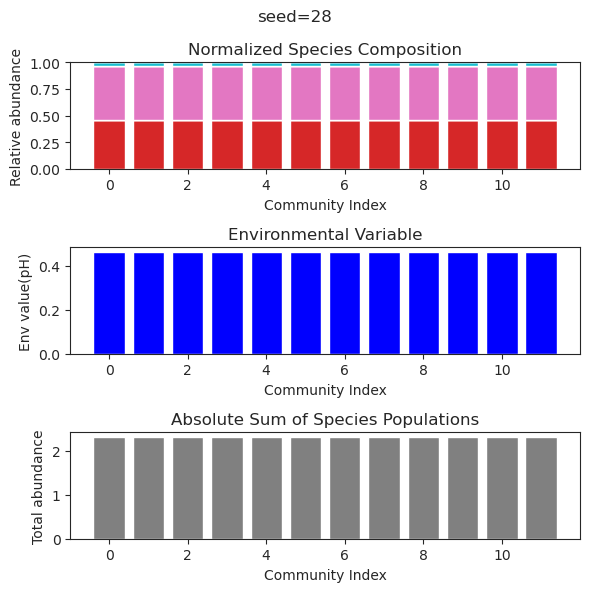

{'species': array([-5.85451547e-34, -2.98023032e-59,  2.91575163e-01, -1.00962206e-37,
       -1.56779346e-43,  2.57150057e-20,  6.46942185e-01,  3.08730078e-01,
       -9.18282236e-30,  6.49994836e-01, -1.24415467e-24,  5.36798638e-18]), 'env': array([0.00111572])}
{'species': array([-3.83032760e-52, -1.01607729e-94,  2.91575163e-01, -6.92094080e-66,
       -3.09989563e-61, -5.33102653e-18,  6.46942185e-01,  3.08730078e-01,
       -6.39701046e-48,  6.49994836e-01,  9.44812720e-27, -5.08368212e-19]), 'env': array([0.00111572])}
{'species': array([ 4.07858797e-38, -7.09796530e-62,  2.91575163e-01, -5.11585696e-40,
       -5.90191870e-47, -2.49693547e-19,  6.46942185e-01,  3.08730078e-01,
       -1.65176266e-33,  6.49994836e-01, -4.09440830e-27, -9.48901154e-19]), 'env': array([0.00111572])}
{'species': array([-2.49573669e-028,  1.45744304e-104,  1.19139919e-001,
        2.84933983e-106,  1.92371146e-073,  4.16106412e-001,
        3.00385407e-001,  4.56609692e-001,  5.23826595e-073,
    

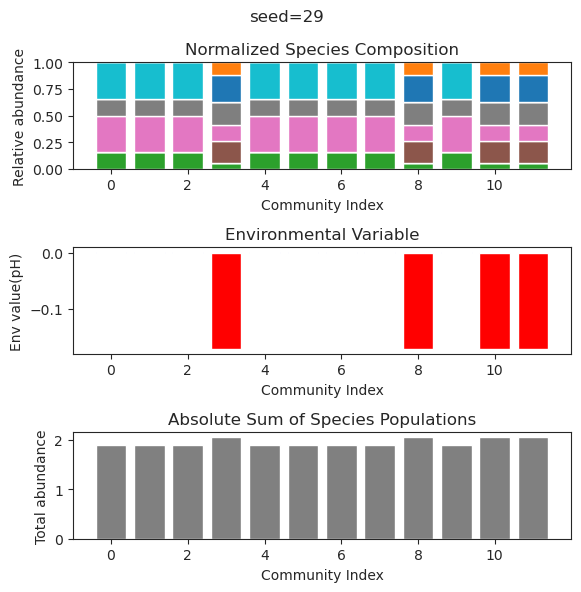

{'species': array([ 1.54242831e-001, -1.10367736e-114, -3.30292521e-054,
       -7.75795476e-180,  2.98284936e-141,  1.39073284e+000,
        5.13114591e-099, -4.43430265e-071,  1.46046997e-039,
        1.90154157e-001,  9.06544770e-001, -1.41367937e-192]), 'env': array([0.81560102])}
{'species': array([ 1.54242831e-001,  2.43524320e-088,  4.46542098e-055,
        4.66319480e-176,  3.05909497e-149,  1.39073284e+000,
       -2.43533460e-105, -2.92763332e-058, -1.02011597e-030,
        1.90154157e-001,  9.06544770e-001,  3.38882695e-187]), 'env': array([0.81560102])}
{'species': array([ 1.54242831e-001,  1.24024372e-072, -1.11355455e-042,
        1.29293508e-118,  5.65129377e-107,  1.39073284e+000,
        5.13759499e-078,  3.05832707e-039,  3.76355288e-020,
        1.90154157e-001,  9.06544770e-001,  1.86352773e-119]), 'env': array([0.81560102])}
{'species': array([ 1.54242831e-001, -2.45545381e-080,  8.72948520e-049,
        1.31170825e-152, -1.24240968e-127,  1.39073284e+000,
       -

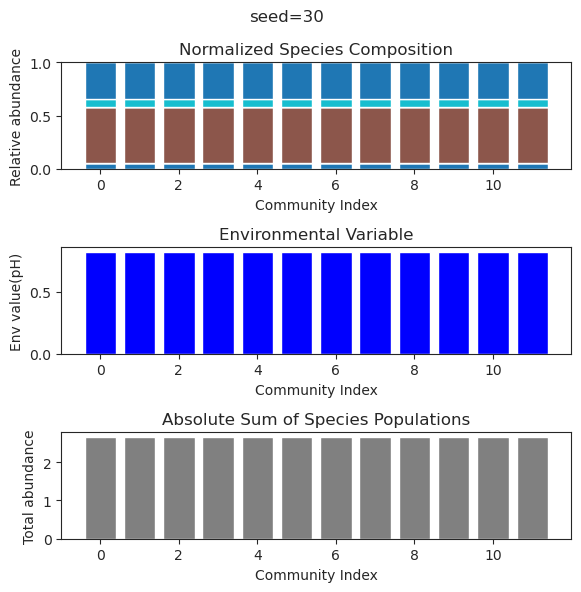

{'species': array([ 3.04004191e-001,  5.74968986e-002,  5.24815546e-001,
        1.92028458e-001,  8.08773726e-002,  5.70547878e-002,
       -2.16634341e-045,  3.84616500e-001,  1.36434829e-196,
        6.93725237e-195,  4.63518159e-001,  8.43238081e-003]), 'env': array([0.11108842])}
{'species': array([2.43495297e-001, 9.33418773e-002, 4.38910729e-001, 2.64167334e-001,
       1.13697258e-001, 2.62422627e-002, 1.32986745e-243, 4.04443552e-001,
       3.18685112e-201, 3.41784175e-205, 4.70156237e-001, 1.63995384e-005]), 'env': array([0.08028591])}
{'species': array([ 3.03992367e-001,  5.74937618e-002,  5.24807165e-001,
        1.92040857e-001,  8.08784047e-002,  5.70631857e-002,
       -1.01620415e-052,  3.84598682e-001, -6.48639648e-132,
       -4.18360401e-042,  4.63506687e-001,  8.46056581e-003]), 'env': array([0.11108336])}
{'species': array([ 3.03987339e-01,  5.74944388e-02,  5.24802119e-01,  1.92046399e-01,
        8.08798198e-02,  5.70641741e-02,  8.23532115e-47,  3.84595210e-01,

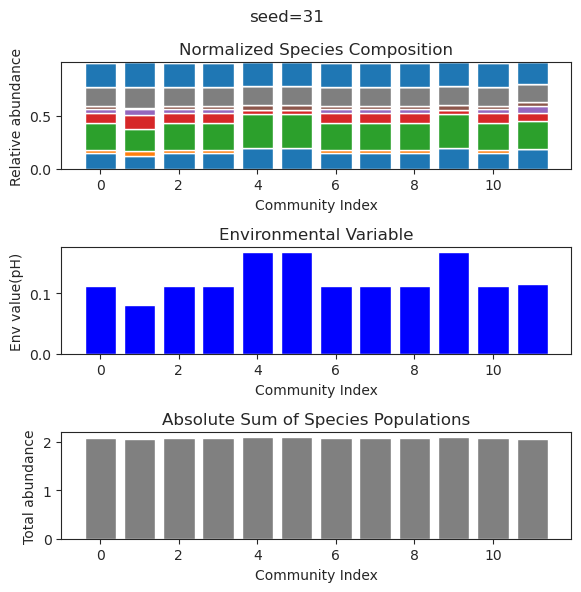

{'species': array([-3.16750552e-47,  4.27933972e-76,  1.53943225e-01,  9.39951669e-76,
        2.16042238e-01,  1.33582531e-56, -1.15910344e-88, -1.92316601e-93,
        1.94321487e-01,  1.41184773e+00,  4.88716550e-02,  6.21479219e-01]), 'env': array([-0.95409198])}
{'species': array([-5.81782054e-074, -8.21191689e-050,  1.53943225e-001,
        1.93576132e-078,  2.16042238e-001,  1.14414255e-083,
        1.06649043e-099,  4.85262529e-101,  1.94321487e-001,
        1.41184773e+000,  4.88716550e-002,  6.21479219e-001]), 'env': array([-0.95409198])}
{'species': array([-1.72910349e-106, -3.43604215e-128,  1.53943225e-001,
       -1.85483274e-121,  2.16042238e-001,  6.78702656e-153,
       -1.99057560e-181, -5.81350391e-163,  1.94321487e-001,
        1.41184773e+000,  4.88716550e-002,  6.21479219e-001]), 'env': array([-0.95409198])}
{'species': array([-3.12660837e-47,  1.14772849e-24, -2.21487570e-14,  1.19997340e-34,
        5.17874648e-01,  6.46420407e-01,  1.47886471e-35,  7.29214803e-

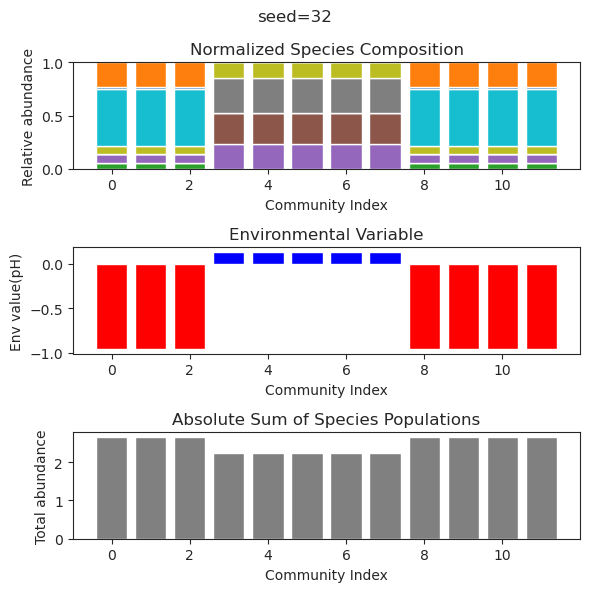

{'species': array([-8.36324395e-52, -2.83694907e-38,  6.04273623e-01,  9.02161011e-01,
        8.88468327e-01,  6.18766227e-02, -6.51265246e-39, -9.93333548e-23,
        2.61842067e-52,  2.04148920e-52, -1.91172660e-54,  6.41345647e-01]), 'env': array([-0.94878316])}
{'species': array([ 5.08597885e-39,  1.47506572e-36,  6.04273623e-01,  9.02161011e-01,
        8.88468327e-01,  6.18766227e-02,  3.76330060e-77,  1.53336456e-19,
       -3.63634221e-95, -6.23929119e-92,  5.67619949e-97,  6.41345647e-01]), 'env': array([-0.94878316])}
{'species': array([ 9.09371032e-110,  2.62818754e-090,  6.04273623e-001,
        9.02161011e-001,  8.88468327e-001,  6.18766227e-002,
       -5.19466808e-095,  2.87696166e-024, -6.29420062e-110,
       -1.68673106e-110,  6.08245983e-113,  6.41345647e-001]), 'env': array([-0.94878316])}
{'species': array([ 9.56053457e-41,  7.02523934e-66,  6.04273623e-01,  9.02161011e-01,
        8.88468327e-01,  6.18766227e-02,  4.07264589e-73, -1.14829052e-22,
        4.57495

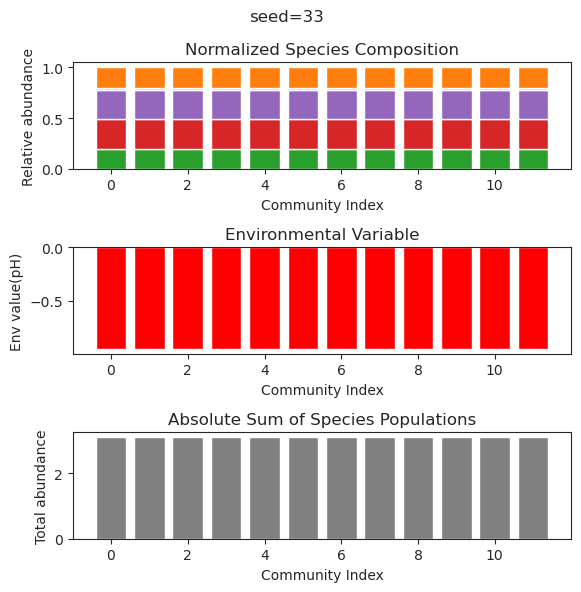

{'species': array([ 8.97776789e-01, -2.17605915e-67, -7.90241223e-44, -8.87376166e-66,
        1.15638915e-01,  3.96976138e-24,  1.27719918e-33,  1.49097448e-01,
        1.22658706e-44, -1.16638435e-68,  1.00754945e+00,  4.39502118e-02]), 'env': array([-0.08249521])}
{'species': array([ 8.97776789e-01,  2.97655550e-71,  5.87134565e-47, -3.74988859e-79,
        1.15638915e-01,  2.81051877e-28, -1.21797309e-35,  1.49097448e-01,
        3.75059993e-49,  7.00085458e-82,  1.00754945e+00,  4.39502118e-02]), 'env': array([-0.08249521])}
{'species': array([ 8.97776789e-01, -3.54507709e-70,  6.77259337e-49, -2.06777540e-71,
        1.15638915e-01, -1.15421028e-25,  4.51778335e-33,  1.49097448e-01,
        3.45158647e-45,  3.28579051e-76,  1.00754945e+00,  4.39502118e-02]), 'env': array([-0.08249521])}
{'species': array([ 8.97776789e-01, -2.84833352e-75, -6.67668183e-52,  4.64604757e-74,
        1.15638915e-01,  5.25179744e-25,  5.13753523e-35,  1.49097448e-01,
        1.37263452e-47, -2.1259574

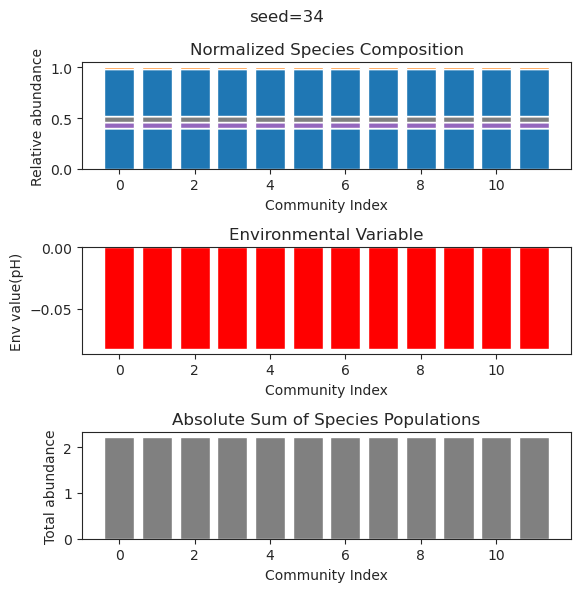

{'species': array([ 6.90599912e-01,  2.91894545e-01,  3.03400243e-01, -1.00594267e-55,
        2.84517849e-05, -8.54049274e-31, -1.66951320e-30,  2.13943430e-01,
        1.34317849e-38, -4.22980366e-32,  6.35998095e-67,  5.43113608e-01]), 'env': array([0.28451976])}
{'species': array([ 6.90601178e-01,  2.91894178e-01,  3.03399601e-01, -1.23450776e-73,
        2.67338397e-05, -1.51779260e-31, -4.02901258e-34,  2.13943573e-01,
        1.49760835e-54,  2.19658699e-31, -1.17972419e-95,  5.43115403e-01]), 'env': array([0.284521])}
{'species': array([ 6.90600020e-01,  2.91894514e-01,  3.03400189e-01,  1.61971394e-52,
        2.83061058e-05,  1.52610122e-33, -3.44276318e-33,  2.13943442e-01,
       -6.10605536e-30, -1.05212484e-29, -1.15976781e-64,  5.43113760e-01]), 'env': array([0.28451986])}
{'species': array([ 6.90592322e-01,  2.91896742e-01,  3.03404095e-01,  5.89393340e-76,
        3.87553611e-05,  9.45084257e-30, -1.23519892e-31,  2.13942574e-01,
       -1.06946248e-33, -1.43460586e-34

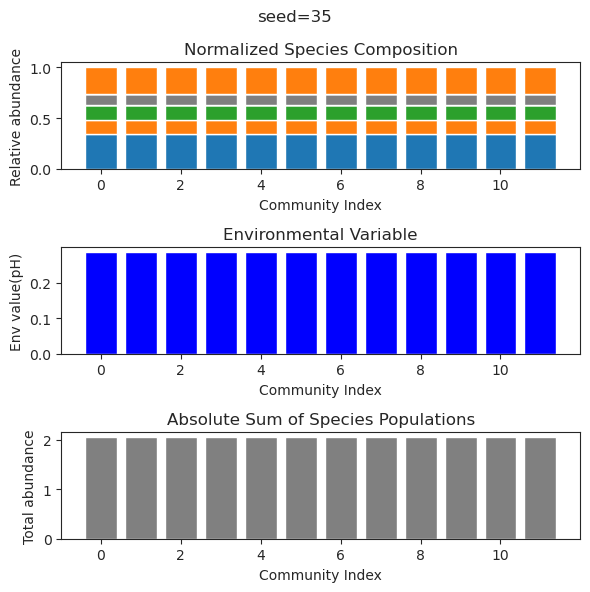

{'species': array([ 3.78273786e-062, -1.51800184e-018,  1.43197040e+000,
        6.51008514e-001, -7.62955712e-066,  1.12849927e+000,
        1.22492099e-027, -1.43800616e-062,  2.80661344e-102,
       -2.78255422e-032, -2.84824666e-071,  5.30112426e-091]), 'env': array([-1.08534374])}
{'species': array([5.63244336e-65, 1.06508831e-19, 1.43197040e+00, 6.51008514e-01,
       3.66602289e-64, 1.12849927e+00, 1.36775001e-29, 2.19900563e-61,
       1.52492633e-99, 1.08119074e-34, 1.11213921e-73, 1.59940357e-92]), 'env': array([-1.08534374])}
{'species': array([ 5.55950431e-53,  1.10965154e-18,  1.43197040e+00,  6.51008514e-01,
        1.64389234e-49,  1.12849927e+00,  5.09198162e-24,  1.43812092e-45,
        8.55643787e-76, -1.72631478e-30,  5.60872162e-62,  1.64580944e-74]), 'env': array([-1.08534374])}
{'species': array([-4.99817220e-45,  5.30159327e-16,  1.43197040e+00,  6.51008514e-01,
       -5.11173962e-45,  1.12849927e+00, -1.87664975e-26, -1.58991100e-42,
        4.75931739e-67,  3.

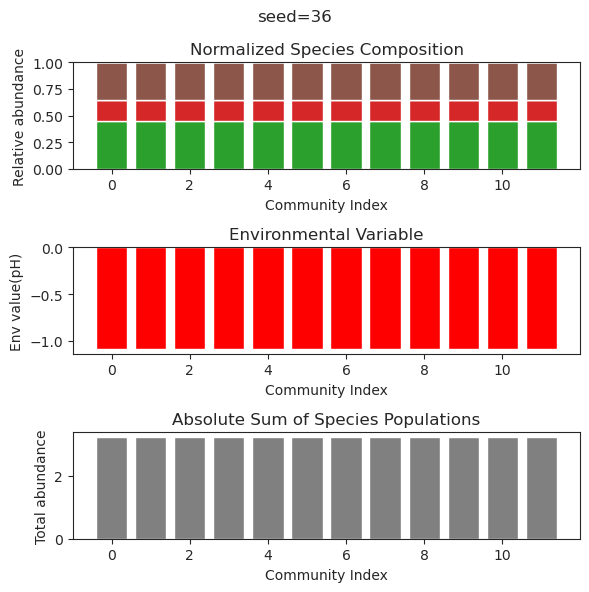

{'species': array([-1.07522234e-58,  5.91315748e-01,  5.78771152e-37,  3.76695325e-01,
        3.15783741e-01, -9.45858761e-54,  5.95939860e-47,  7.60399009e-02,
       -4.38563112e-25,  6.74310606e-02,  4.17175413e-01,  4.11415293e-01]), 'env': array([0.24358754])}
{'species': array([-2.28890055e-68,  5.91315748e-01, -1.00628795e-42,  3.76695325e-01,
        3.15783741e-01,  5.86518885e-61, -1.10166843e-53,  7.60399009e-02,
        1.83736716e-30,  6.74310606e-02,  4.17175413e-01,  4.11415293e-01]), 'env': array([0.24358754])}
{'species': array([-2.41010622e-65,  5.91315748e-01, -1.86798239e-37,  3.76695325e-01,
        3.15783741e-01,  2.25545161e-57,  4.27574164e-51,  7.60399009e-02,
        1.53833367e-28,  6.74310606e-02,  4.17175413e-01,  4.11415293e-01]), 'env': array([0.24358754])}
{'species': array([-1.32636580e-67,  5.91315748e-01, -7.58200302e-44,  3.76695325e-01,
        3.15783741e-01,  3.76338765e-61, -1.38766804e-53,  7.60399009e-02,
       -1.08306528e-29,  6.74310606e-

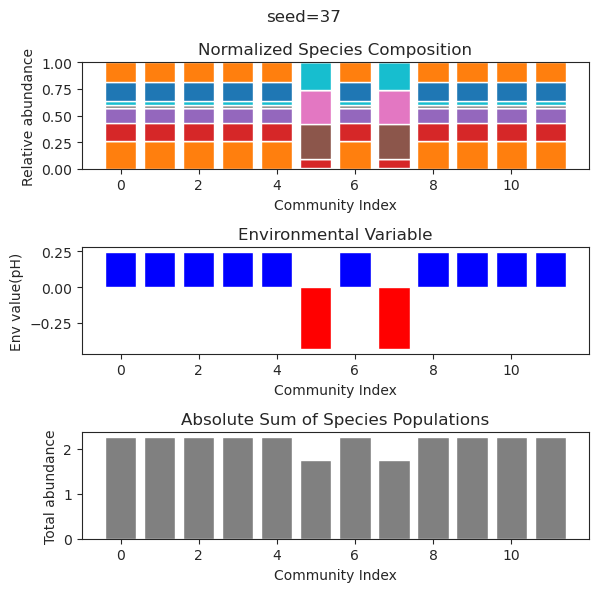

{'species': array([ 5.43468266e-001,  3.32652991e-096,  5.88814589e-002,
        4.11738675e-001,  2.43752714e-002, -3.31850897e-055,
        5.76537270e-002,  1.25823453e-059, -6.65003112e-033,
        6.87166741e-001,  1.96218914e-108,  1.36840496e-001]), 'env': array([-0.17876505])}
{'species': array([ 5.43468266e-001, -3.66187554e-134,  5.88814589e-002,
        4.11738675e-001,  2.43752714e-002,  9.41519024e-069,
        5.76537270e-002,  5.50348172e-076,  3.86475177e-040,
        6.87166741e-001,  1.36978014e-147,  1.36840496e-001]), 'env': array([-0.17876505])}
{'species': array([ 5.43468266e-01,  1.61281104e-40,  5.88814589e-02,  4.11738675e-01,
        2.43752714e-02, -1.79199412e-40,  5.76537270e-02,  4.60947447e-41,
       -1.28347734e-28,  6.87166741e-01, -3.53708020e-59,  1.36840496e-01]), 'env': array([-0.17876505])}
{'species': array([ 5.43468266e-01,  7.28626690e-30,  5.88814589e-02,  4.11738675e-01,
        2.43752714e-02,  6.27723428e-41,  5.76537270e-02,  1.15160349e-

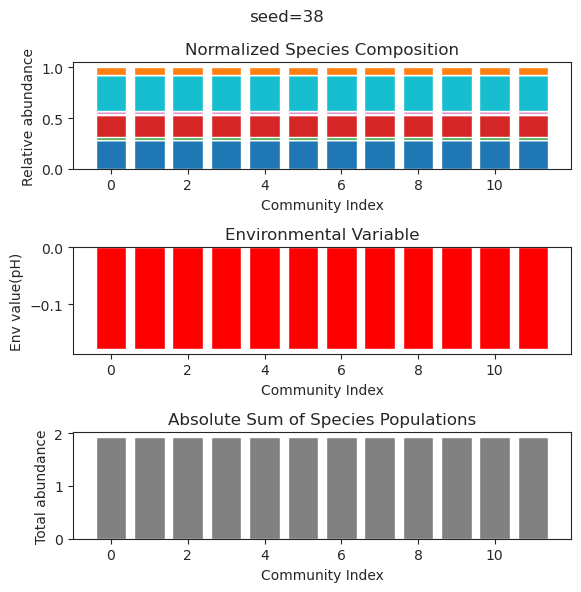

{'species': array([ 9.07448448e-45,  6.71717441e-74,  6.13445593e-01,  5.17233360e-01,
        1.83411759e-52,  6.85974611e-56,  5.70217290e-01,  1.64170032e-49,
       -2.82085392e-58, -1.67605846e-24, -3.48947269e-73,  1.81398956e-01]), 'env': array([0.44163732])}
{'species': array([ 4.99867133e-44, -3.08230759e-40,  3.56557863e-24, -1.40829106e-33,
        2.65707505e-38, -3.75242169e-32,  1.40188993e+00, -8.31663743e-42,
       -1.10959249e-30,  7.27924477e-01,  1.08841869e-34, -9.35081010e-28]), 'env': array([1.01963843])}
{'species': array([-1.46568627e-40, -9.65690629e-68,  6.13445593e-01,  5.17233360e-01,
        1.97537573e-47,  1.57344729e-40,  5.70217290e-01,  1.74009413e-43,
        4.49840354e-48, -8.36627961e-31, -7.76199177e-65,  1.81398956e-01]), 'env': array([0.44163732])}
{'species': array([ 1.52742181e-40,  4.74535998e-70,  6.13445593e-01,  5.17233360e-01,
       -3.92925821e-52, -1.62144050e-44,  5.70217290e-01, -4.44712202e-47,
        7.72429432e-52,  2.81756805e-

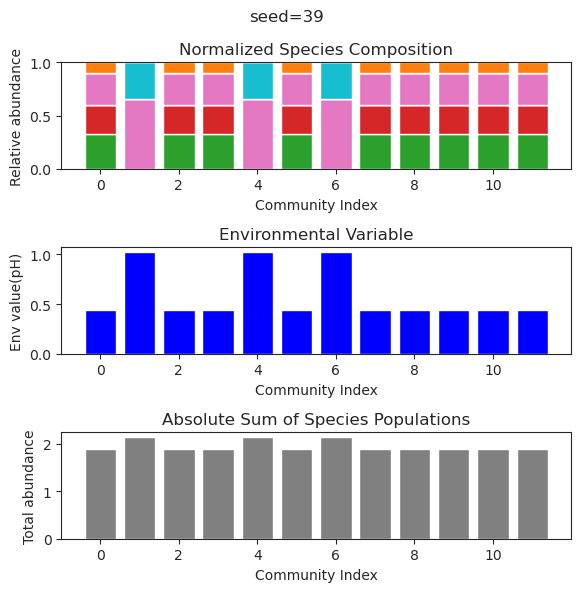

{'species': array([-2.67723314e-072, -2.59554275e-125, -8.22955391e-017,
        4.02487993e-001,  1.86353089e-001,  4.54037709e-112,
        3.44495912e-001,  2.34738625e-057, -8.95498388e-018,
        3.05643451e-034,  4.21773645e-001,  9.29433474e-001]), 'env': array([-0.37410794])}
{'species': array([-2.15877480e-063,  6.60101391e-126,  3.02729937e-018,
        4.02487993e-001,  1.86353089e-001, -5.90098939e-120,
        3.44495912e-001, -9.46186732e-054,  4.31983929e-018,
        8.03514633e-041,  4.21773645e-001,  9.29433474e-001]), 'env': array([-0.37410794])}
{'species': array([ 1.64630503e-056,  1.77552608e-107,  2.97767732e-018,
        4.02487993e-001,  1.86353089e-001,  1.39090446e-099,
        3.44495912e-001,  1.37907740e-044, -4.36906746e-017,
        2.09668173e-034,  4.21773645e-001,  9.29433474e-001]), 'env': array([-0.37410794])}
{'species': array([ 2.96361444e-073,  9.62597987e-130, -5.86424059e-017,
        4.02487993e-001,  1.86353089e-001,  5.50985102e-120,
     

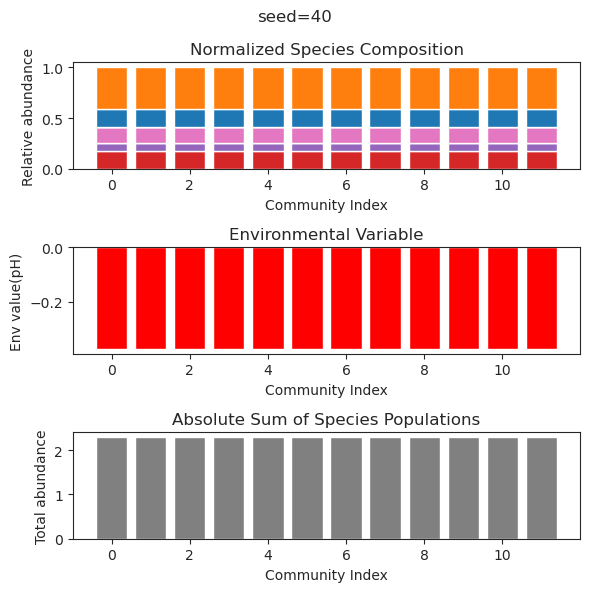

{'species': array([ 1.08520599e-01, -9.75942498e-36,  4.40523936e-01,  5.56704693e-69,
       -2.77846475e-34,  1.16219862e-44,  1.06500059e-06,  2.11351555e-01,
        1.92020383e-01,  4.13341925e-01, -5.23966446e-51,  6.22703069e-01]), 'env': array([-0.08593541])}
{'species': array([ 1.08520364e-01, -1.79820024e-33,  4.40523452e-01, -9.12568045e-40,
        1.01734130e-34,  1.98109293e-34,  3.95319111e-07,  2.11352054e-01,
        1.92020317e-01,  4.13342692e-01,  7.24446459e-43,  6.22703267e-01]), 'env': array([-0.08593538])}
{'species': array([ 1.08520536e-01,  4.04633212e-35,  4.40523807e-01, -2.06219799e-41,
        2.41677871e-34, -5.78116024e-37,  8.86969388e-07,  2.11351688e-01,
        1.92020366e-01,  4.13342129e-01,  6.06049404e-52,  6.22703122e-01]), 'env': array([-0.0859354])}
{'species': array([ 1.08520546e-01, -1.34417475e-34,  4.40523827e-01, -1.77161853e-38,
        1.99440378e-38,  1.04307554e-35,  9.14042071e-07,  2.11351667e-01,
        1.92020368e-01,  4.13342098

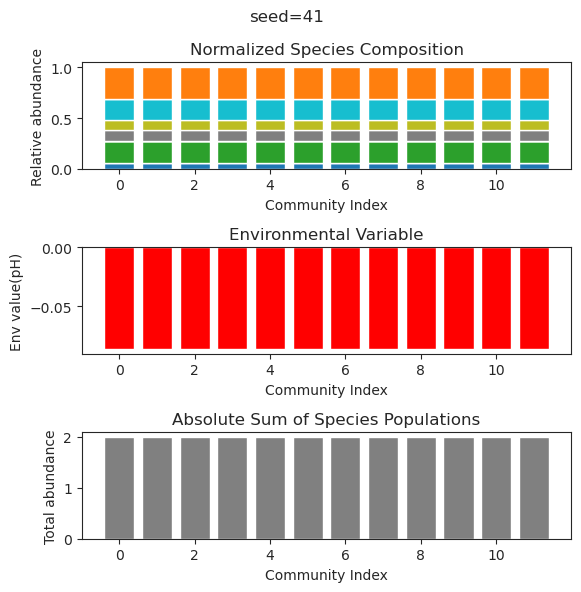

{'species': array([ 2.01050878e-001, -4.21322581e-038,  1.91511935e-075,
        3.94510730e-001,  5.36306166e-001,  1.69712282e-017,
       -8.12850952e-110, -7.75447874e-058,  6.75278993e-001,
        2.13446653e-050,  7.27898566e-001,  8.39173403e-095]), 'env': array([-0.16903657])}
{'species': array([ 2.01050878e-01, -2.61565536e-36,  4.76384312e-74,  3.94510730e-01,
        5.36306166e-01,  9.63569566e-17, -4.61377255e-98, -8.94854251e-59,
        6.75278993e-01, -6.65169893e-50,  7.27898566e-01, -2.37339267e-90]), 'env': array([-0.16903657])}
{'species': array([ 2.01050878e-01,  1.33276932e-30, -3.48166952e-45,  3.94510730e-01,
        5.36306166e-01, -2.79604178e-16, -1.33444446e-64,  2.06684966e-39,
        6.75278993e-01,  1.89467533e-33,  7.27898566e-01, -4.74868188e-54]), 'env': array([-0.16903657])}
{'species': array([ 2.01050878e-01, -1.38127824e-29,  1.23508361e-46,  3.94510730e-01,
        5.36306166e-01,  4.83221808e-14,  7.76417375e-70, -9.81159918e-46,
        6.75278

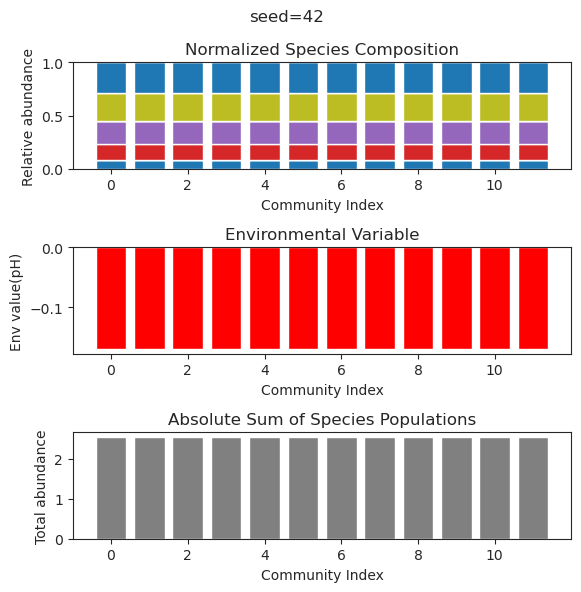

{'species': array([ 1.68208040e-01,  2.69571998e-38,  3.01773273e-01,  3.29520345e-01,
       -2.68156376e-58,  6.21940070e-01,  1.52636327e-01, -1.44932161e-68,
        3.60529544e-01,  1.29768701e-54,  4.45417895e-17,  2.79290565e-38]), 'env': array([-0.18914446])}
{'species': array([ 1.68208040e-01, -3.24907198e-32,  3.01773273e-01,  3.29520345e-01,
        1.00340628e-63,  6.21940070e-01,  1.52636327e-01, -2.96753401e-81,
        3.60529544e-01,  2.07222506e-59,  1.10975764e-16, -1.06848446e-32]), 'env': array([-0.18914446])}
{'species': array([ 1.68208040e-01, -7.03691589e-37,  3.01773273e-01,  3.29520345e-01,
        2.16325629e-56,  6.21940070e-01,  1.52636327e-01, -8.74912388e-69,
        3.60529544e-01,  1.20759971e-52,  7.68258052e-16,  4.08710652e-39]), 'env': array([-0.18914446])}
{'species': array([ 1.68208040e-01, -1.56461554e-36,  3.01773273e-01,  3.29520345e-01,
       -1.71769469e-57,  6.21940070e-01,  1.52636327e-01,  3.03990268e-68,
        3.60529544e-01,  3.4360100

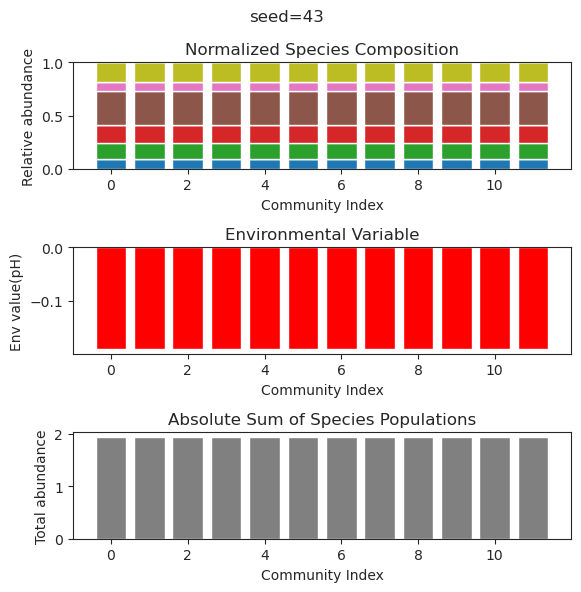

{'species': array([ 1.27037279e-056,  4.05897209e-001,  3.97584636e-001,
       -9.62257818e-104,  2.58626586e-001, -8.61702141e-059,
       -4.19759136e-103,  6.47295303e-001,  3.22449732e-001,
        1.64481330e-001,  3.50753719e-002,  1.44491804e-053]), 'env': array([0.30513645])}
{'species': array([ 3.32268252e-56,  4.05897209e-01,  3.97584636e-01,  1.90222839e-44,
        2.58626586e-01, -4.82643884e-56, -1.17449884e-94,  6.47295303e-01,
        3.22449732e-01,  1.64481330e-01,  3.50753719e-02, -5.66483839e-54]), 'env': array([0.30513645])}
{'species': array([-2.30366492e-53,  4.05897209e-01,  3.97584636e-01,  2.31888326e-50,
        2.58626586e-01,  9.00390776e-53, -1.65456215e-62,  6.47295303e-01,
        3.22449732e-01,  1.64481330e-01,  3.50753719e-02, -7.15175917e-47]), 'env': array([0.30513645])}
{'species': array([ 8.11029342e-53,  4.05897209e-01,  3.97584636e-01, -7.67581048e-45,
        2.58626586e-01,  2.19401066e-53,  4.88080994e-39,  6.47295303e-01,
        3.22449732

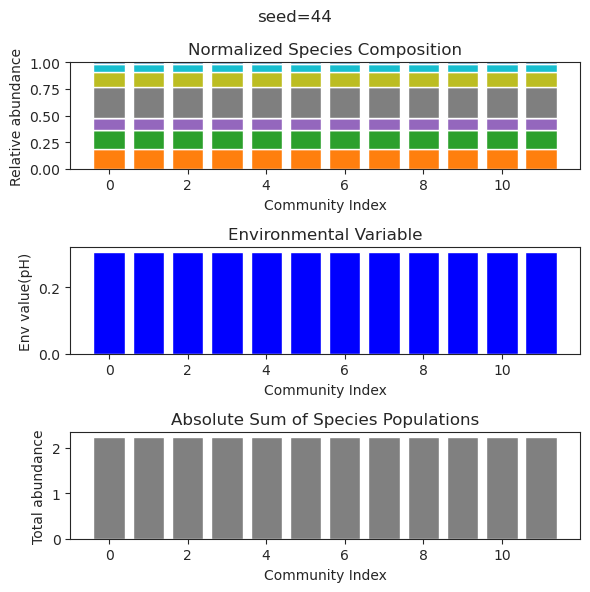

{'species': array([-2.00394272e-19,  1.43441187e-01,  3.38671524e-01,  4.98254103e-31,
        2.96582822e-01,  3.52863602e-01,  1.52091003e-33, -1.31070599e-78,
       -9.03743928e-27,  7.79308251e-01,  1.25033552e-30,  1.44193849e-01]), 'env': array([0.21970339])}
{'species': array([ 3.95995937e-21,  1.43441187e-01,  3.38671524e-01,  4.17405098e-29,
        2.96582822e-01,  3.52863602e-01,  1.29351267e-26, -4.34753821e-61,
       -5.25106562e-25,  7.79308251e-01,  1.10604852e-28,  1.44193849e-01]), 'env': array([0.21970339])}
{'species': array([-4.67140898e-24,  1.43441187e-01,  3.38671524e-01, -2.75569661e-36,
        2.96582822e-01,  3.52863602e-01, -8.71658751e-39, -7.72163758e-93,
        5.60349528e-31,  7.79308251e-01, -9.82998069e-36,  1.44193849e-01]), 'env': array([0.21970339])}
{'species': array([ 6.84275669e-25,  1.43441187e-01,  3.38671524e-01, -1.10771170e-37,
        2.96582822e-01,  3.52863602e-01, -1.44141019e-37, -5.55581759e-82,
       -4.06060009e-32,  7.79308251e-

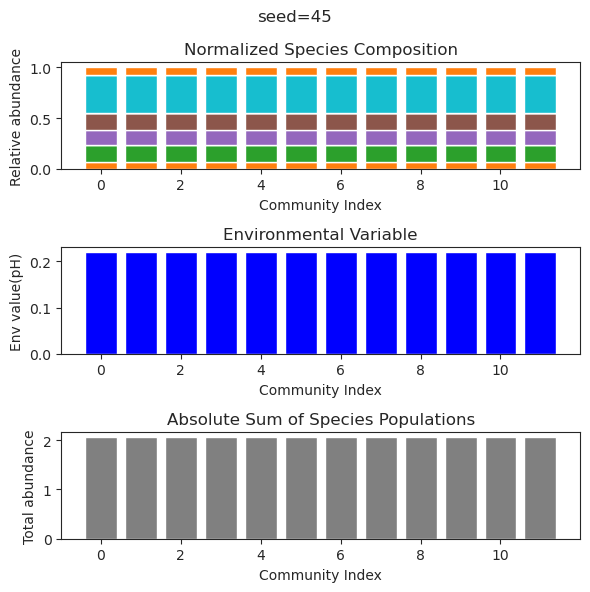

{'species': array([ 7.22350682e-66,  5.40393448e-01, -1.01769365e-40,  6.10020591e-01,
       -2.87837760e-43,  4.31624644e-55, -5.08185571e-36,  3.21310626e-01,
        3.43597427e-01, -1.63123320e-66,  4.53659475e-01,  6.32513354e-02]), 'env': array([0.05748185])}
{'species': array([-1.44476576e-52,  5.40393448e-01,  1.31977759e-31,  6.10020591e-01,
       -3.03689576e-37, -5.37272576e-44,  1.10642554e-27,  3.21310626e-01,
        3.43597427e-01, -1.94661411e-50,  4.53659475e-01,  6.32513354e-02]), 'env': array([0.05748185])}
{'species': array([-2.90326736e-44,  5.40393448e-01,  6.86435849e-37,  6.10020591e-01,
        8.48442653e-34,  2.72806818e-38,  2.78927568e-30,  3.21310626e-01,
        3.43597427e-01, -2.16434086e-43,  4.53659475e-01,  6.32513354e-02]), 'env': array([0.05748185])}
{'species': array([ 5.61261104e-65,  5.40393448e-01,  1.87649569e-32,  6.10020591e-01,
        2.01577050e-39,  2.01280504e-50,  1.07179341e-31,  3.21310626e-01,
        3.43597427e-01, -5.69536317e-

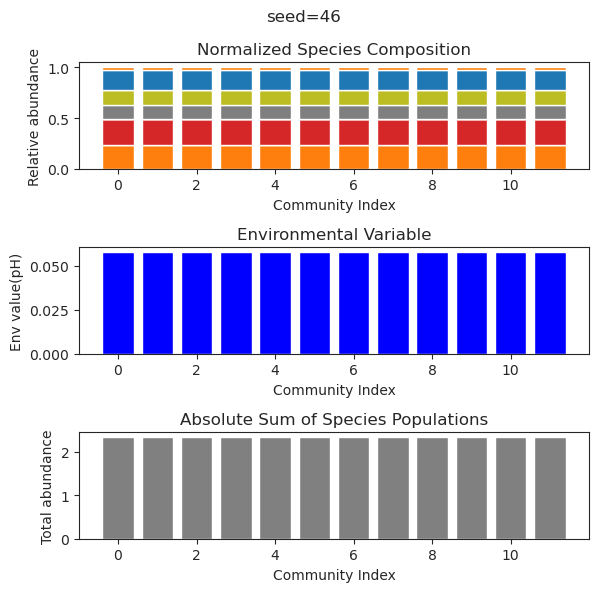

{'species': array([ 2.47807192e-02,  4.18333971e-01,  1.74928036e-41,  2.53151930e-01,
        3.56586370e-01, -1.06367532e-42, -1.30159903e-74,  9.54037577e-03,
        3.26830846e-34,  3.70774030e-01,  5.10041618e-01,  3.46884138e-02]), 'env': array([0.00151514])}
{'species': array([ 2.47806924e-002,  4.18333977e-001, -2.10320127e-184,
        2.53151926e-001,  3.56586375e-001,  5.40641006e-047,
        3.88714578e-137,  9.54032928e-003,  1.64797683e-035,
        3.70774025e-001,  5.10041631e-001,  3.46884456e-002]), 'env': array([0.00151513])}
{'species': array([ 2.47807101e-02,  4.18333968e-01,  7.48441594e-92,  2.53151927e-01,
        3.56586376e-01,  3.99033676e-44,  1.09473595e-73,  9.54036984e-03,
       -7.56893652e-35,  3.70774036e-01,  5.10041625e-01,  3.46884161e-02]), 'env': array([0.00151513])}
{'species': array([ 2.47807304e-02,  4.18333978e-01,  4.73079515e-39,  2.53151936e-01,
        3.56586359e-01,  5.79069835e-44, -7.72322069e-49,  9.54037561e-03,
       -1.52197802

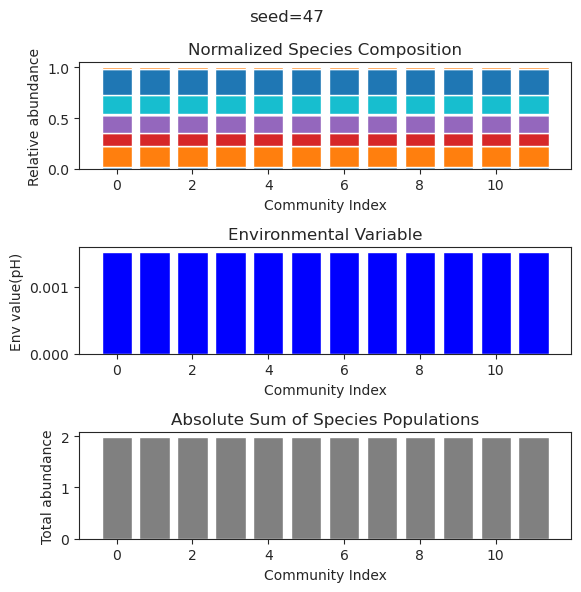

{'species': array([ 2.63274455e-74,  1.77299552e+00, -6.79924386e-71,  2.52347636e-02,
        1.32993556e-67,  3.26929811e-69,  8.85501578e-02, -8.72176014e-64,
        1.54895389e-76,  7.56407037e-01, -6.97422107e-69, -1.31568416e-66]), 'env': array([0.8984569])}
{'species': array([-1.34865139e-73,  1.77299552e+00,  1.08053195e-76,  2.52347636e-02,
        1.69700295e-79,  2.75657128e-74,  8.85501578e-02,  3.28864438e-73,
       -1.76701926e-74,  7.56407037e-01,  2.26281869e-82,  8.77728199e-76]), 'env': array([0.8984569])}
{'species': array([-1.59047194e-112,  1.77299552e+000, -6.98425304e-109,
        2.52347636e-002, -6.30407696e-081, -1.48787018e-103,
        8.85501578e-002, -3.76324310e-086, -8.17401715e-123,
        7.56407037e-001,  7.90650976e-091,  3.66295876e-082]), 'env': array([0.8984569])}
{'species': array([-1.11227355e-102,  1.77299552e+000, -5.50501026e-102,
        2.52347636e-002, -8.92162152e-087,  2.21077127e-095,
        8.85501578e-002,  2.20504784e-084,  1.281

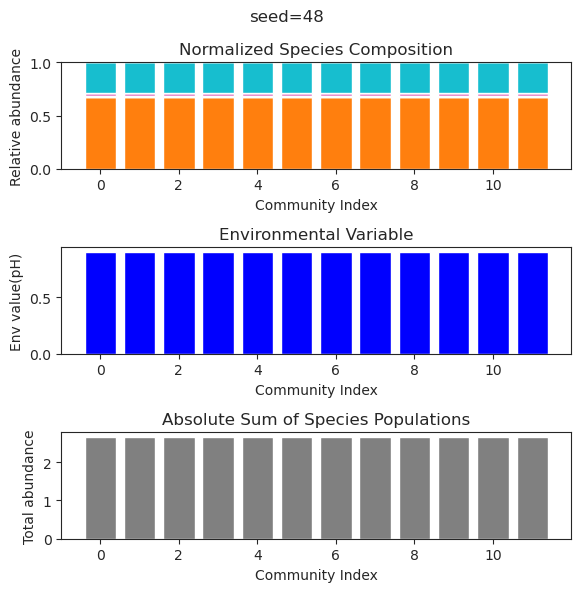

{'species': array([-4.55400516e-31,  1.91056433e-36, -4.66288502e-36,  4.94803844e-22,
        3.19804516e-01,  2.92375175e-02,  4.23584410e-01,  2.13812758e-01,
        2.46790727e-01,  9.88905305e-02,  5.32239812e-34,  4.97258873e-01]), 'env': array([0.01449399])}
{'species': array([-1.31676617e-33, -1.31440074e-34, -4.26277752e-37,  4.63992929e-27,
        3.19807792e-01,  2.92503588e-02,  4.23580836e-01,  2.13811301e-01,
        2.46774743e-01,  9.88929557e-02, -9.82027476e-50,  4.97262847e-01]), 'env': array([0.01449693])}
{'species': array([-2.39439797e-39,  2.22208810e-48,  8.56052118e-28,  6.60994651e-18,
        3.19802921e-01,  2.92312644e-02,  4.23586150e-01,  2.13813467e-01,
        2.46798510e-01,  9.88893493e-02,  1.88378421e-87,  4.97256938e-01]), 'env': array([0.01449255])}
{'species': array([8.40379522e-42, 8.15933555e-57, 6.24061758e-28, 6.36852369e-23,
       3.17710804e-01, 2.08527789e-02, 4.26004898e-01, 2.14778684e-01,
       2.57108084e-01, 9.72173422e-02, 2.1335

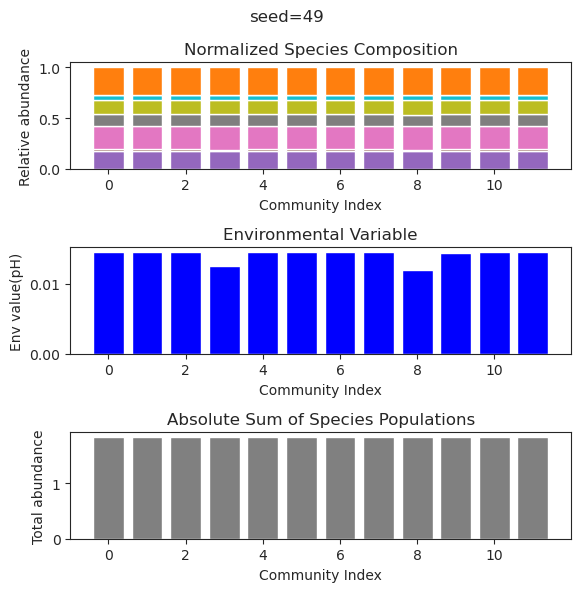

{'species': array([ 2.87572247e-01, -9.05715615e-35,  1.44661550e-82, -3.44212530e-60,
       -4.13882662e-60,  4.59672926e-02,  3.22864373e-01, -5.62360326e-39,
       -5.18164106e-63,  4.63494347e-01,  6.89558482e-01,  7.13246350e-02]), 'env': array([0.13317003])}
{'species': array([ 2.87572247e-01, -1.54985722e-35, -1.13702331e-84,  1.48010767e-62,
        5.29742807e-62,  4.59672926e-02,  3.22864373e-01,  4.80445346e-42,
        1.08071388e-65,  4.63494347e-01,  6.89558482e-01,  7.13246350e-02]), 'env': array([0.13317003])}
{'species': array([ 2.87572247e-01,  1.01191393e-35, -3.02104443e-87,  1.72664121e-65,
        8.77438169e-67,  4.59672926e-02,  3.22864373e-01,  3.81420877e-43,
        9.51342266e-72,  4.63494347e-01,  6.89558482e-01,  7.13246350e-02]), 'env': array([0.13317003])}
{'species': array([ 2.87572247e-01, -3.32287438e-37,  1.37878086e-91, -1.20897722e-67,
       -1.38813217e-69,  4.59672926e-02,  3.22864373e-01,  9.72189156e-45,
       -2.98220408e-74,  4.63494347e-

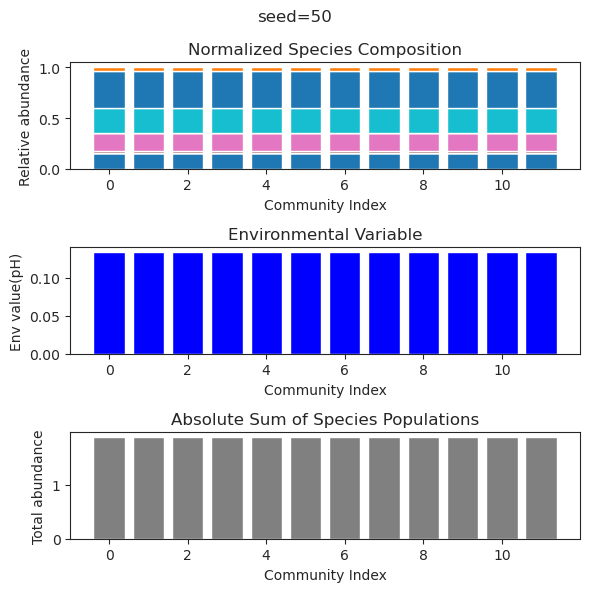

{'species': array([ 9.81091839e-61,  6.15645901e-01, -1.05024920e-52,  6.42882756e-01,
        7.12070904e-01,  4.48743895e-01, -5.85284325e-53,  2.03586645e-01,
       -1.98022746e-41, -9.86559139e-52, -2.92680101e-15,  5.19632191e-41]), 'env': array([0.3840116])}
{'species': array([-2.41906152e-84,  6.15645901e-01,  2.33707359e-66,  6.42882756e-01,
        7.12070904e-01,  4.48743895e-01,  3.42620885e-68,  2.03586645e-01,
       -3.39734364e-42,  6.20351640e-64,  5.40654458e-15,  1.76239444e-46]), 'env': array([0.3840116])}
{'species': array([ 5.34191619e-92,  6.15645901e-01, -1.73755706e-68,  6.42882756e-01,
        7.12070904e-01,  4.48743895e-01,  2.71660587e-71,  2.03586645e-01,
        1.02265799e-40, -1.06554698e-67,  7.82458350e-16, -5.66245396e-45]), 'env': array([0.3840116])}
{'species': array([-1.81706467e-63,  6.15645901e-01,  1.32690972e-54,  6.42882756e-01,
        7.12070904e-01,  4.48743895e-01,  4.43007517e-55,  2.03586645e-01,
       -5.33984003e-43,  1.72215221e-53,

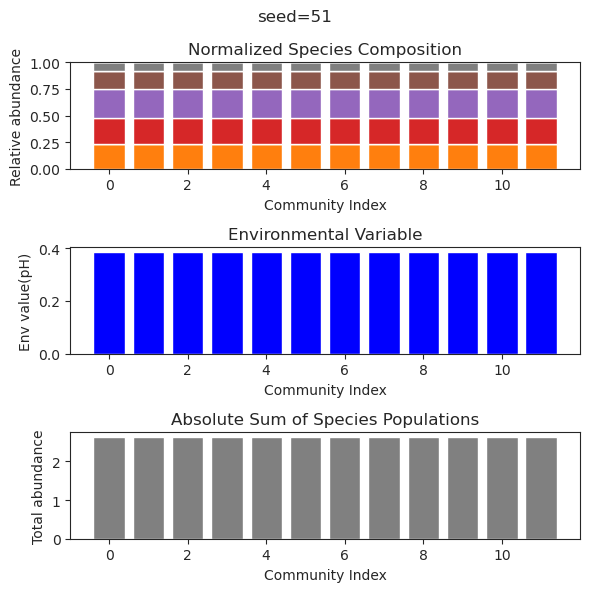

{'species': array([ 3.27779795e-63,  7.42963746e-02,  2.70867671e-01, -1.51594907e-43,
        3.92446628e-84, -2.65161404e-77, -9.01692620e-89,  1.24475639e-97,
        1.03048520e+00,  2.32511291e-01,  8.75382532e-01, -3.38466580e-65]), 'env': array([0.51843067])}
{'species': array([ 3.62889780e-59,  7.42963746e-02,  2.70867671e-01, -8.53432293e-36,
        8.90694531e-78, -7.86176742e-59, -4.81626666e-81,  1.14675109e-83,
        1.03048520e+00,  2.32511291e-01,  8.75382532e-01, -2.79447885e-50]), 'env': array([0.51843067])}
{'species': array([-1.75716638e-46,  7.42963746e-02,  2.70867671e-01,  1.99593229e-36,
       -1.04410783e-60, -3.00252470e-61,  1.05713884e-68,  6.39925555e-80,
        1.03048520e+00,  2.32511291e-01,  8.75382532e-01, -3.60344250e-57]), 'env': array([0.51843067])}
{'species': array([ 2.10452864e-072,  7.42963746e-002,  2.70867671e-001,
       -1.86346088e-052,  7.13222337e-103, -2.81573755e-090,
       -6.62815891e-111, -4.58007561e-134,  1.03048520e+000,
    

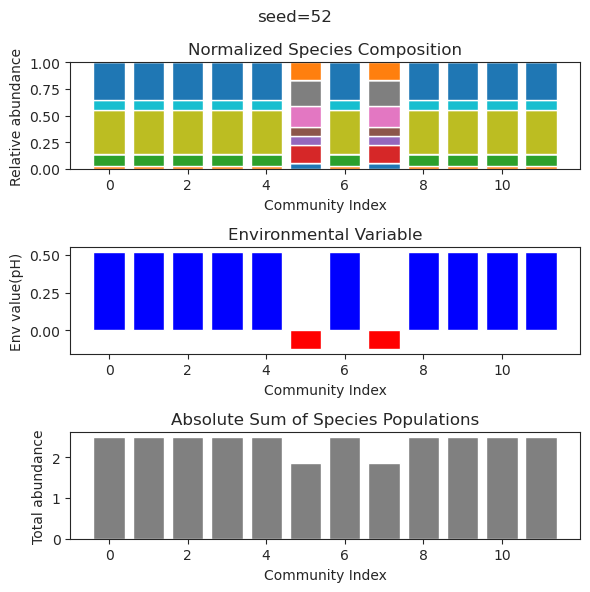

{'species': array([ 2.48793727e-01,  2.22314281e-36,  2.57578937e-37,  9.01868217e-01,
       -2.81256823e-22,  7.66537226e-46, -5.47645934e-30,  1.42425280e-45,
        7.48729282e-01, -2.86971972e-48,  6.34347796e-01, -2.02537535e-45]), 'env': array([-0.34128867])}
{'species': array([ 2.48793727e-01, -5.51716030e-51, -4.23946731e-52,  9.01868217e-01,
       -5.68341660e-25,  1.47075194e-61, -1.54120859e-38, -7.51955316e-62,
        7.48729282e-01,  3.23402698e-61,  6.34347796e-01,  1.62380916e-53]), 'env': array([-0.34128867])}
{'species': array([ 2.48793727e-01,  2.87321995e-32,  1.53992709e-36,  9.01868217e-01,
        1.50989126e-22, -1.88445999e-40, -3.24786896e-34,  2.74771403e-47,
        7.48729282e-01, -1.85137253e-43,  6.34347796e-01,  3.82049273e-48]), 'env': array([-0.34128867])}
{'species': array([ 2.48793727e-01,  7.38564750e-31,  6.96300660e-32,  9.01868217e-01,
       -2.02307439e-18,  3.79623054e-36, -1.72210145e-26,  2.18046702e-35,
        7.48729282e-01,  2.0677609

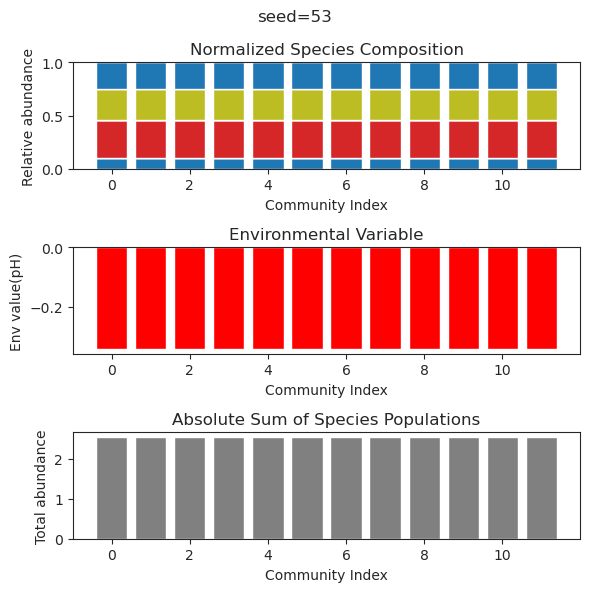

{'species': array([1.19409302e-172, 1.78478135e-001, 1.37000706e-001, 3.68387189e-002,
       3.05511571e-002, 1.28530693e-001, 3.92042854e-001, 2.95025184e-001,
       4.15927063e-001, 3.44442005e-117, 3.41499044e-001, 3.25497405e-059]), 'env': array([0.10390823])}
{'species': array([3.91306660e-168, 1.62517452e-001, 1.36819343e-001, 5.76193839e-002,
       3.56620781e-002, 1.59549558e-001, 3.87311782e-001, 2.84915078e-001,
       3.92585604e-001, 2.74499637e-112, 3.35388224e-001, 4.06998065e-067]), 'env': array([0.08962842])}
{'species': array([7.27264563e-169, 1.86942961e-001, 1.52947894e-001, 2.93806711e-002,
       1.23855546e-002, 9.65639948e-002, 3.97745249e-001, 2.82940088e-001,
       4.36138316e-001, 5.58327442e-116, 3.70694746e-001, 4.42208199e-060]), 'env': array([0.10961063])}
{'species': array([1.24460163e-169, 1.93707272e-001, 1.34876920e-001, 1.95654461e-002,
       2.44088215e-002, 1.01013796e-001, 3.96708684e-001, 3.08304737e-001,
       4.37865511e-001, 3.85243738e-1

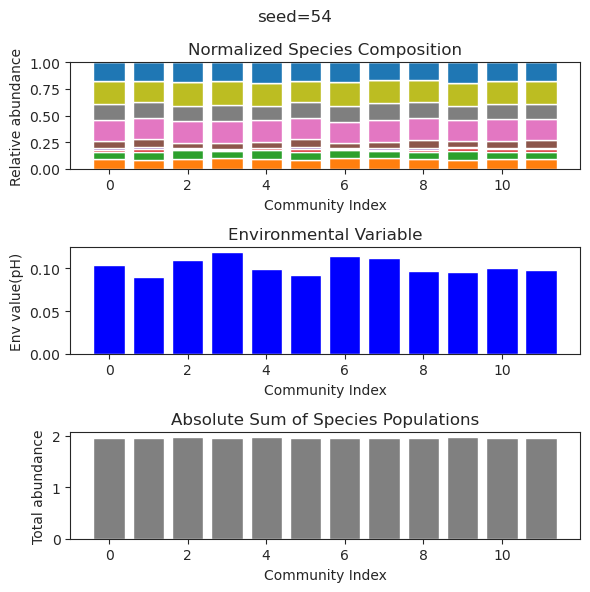

{'species': array([1.46484259e-020, 1.61813044e-130, 3.14266296e-001, 3.55657143e-018,
       1.48700196e-001, 4.84470093e-001, 4.86972721e-001, 9.36964003e-011,
       1.97277999e-009, 4.02662607e-001, 3.07900419e-005, 7.50960997e-002]), 'env': array([-0.17394035])}
{'species': array([3.31029335e-016, 5.12602840e-143, 3.71045362e-001, 1.26613197e-001,
       8.82014460e-002, 4.79751060e-001, 4.70385382e-001, 9.56773981e-004,
       3.17625635e-005, 3.61894657e-001, 3.82626751e-006, 2.70260334e-002]), 'env': array([-0.19935519])}
{'species': array([1.34096055e-022, 4.13279010e-133, 3.14267729e-001, 9.99790333e-013,
       1.48727485e-001, 4.84467250e-001, 4.86950609e-001, 5.94467224e-007,
       1.71717824e-007, 4.02648713e-001, 3.39839358e-006, 7.51159701e-002]), 'env': array([-0.17394386])}
{'species': array([5.91160686e-020, 1.36169407e-131, 3.14211077e-001, 3.47664908e-017,
       1.48385434e-001, 4.84551057e-001, 4.87291471e-001, 1.97251267e-011,
       1.63067031e-009, 4.02748339

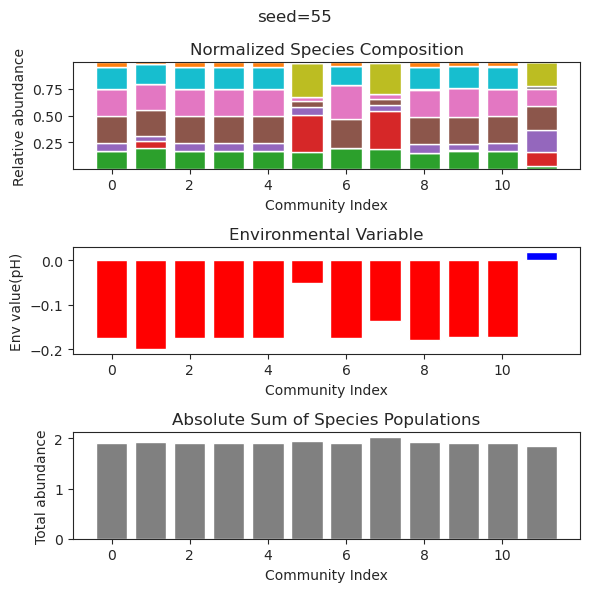

{'species': array([ 3.13771565e-01, -3.77500258e-57, -6.24923784e-54,  3.76897456e-30,
        8.38910794e-01, -4.81772390e-57,  7.11827484e-01,  8.87928222e-25,
        2.98136778e-01, -8.79222257e-34,  2.76242672e-43, -8.07202066e-44]), 'env': array([-0.33213771])}
{'species': array([ 3.13771565e-01,  9.24718978e-54,  3.69719729e-52, -3.22458503e-31,
        8.38910794e-01,  1.69151138e-57,  7.11827484e-01,  2.05268225e-25,
        2.98136778e-01,  1.09746724e-32,  3.92609356e-41,  3.71642684e-43]), 'env': array([-0.33213771])}
{'species': array([ 3.13771565e-01, -6.11009705e-73,  6.48724613e-76, -5.04132465e-33,
        8.38910794e-01,  7.36543554e-70,  7.11827484e-01, -1.91432331e-21,
        2.98136778e-01,  3.33358991e-46,  7.41629608e-63,  2.97399000e-43]), 'env': array([-0.33213771])}
{'species': array([ 3.13771565e-01,  3.98097898e-67, -2.11699152e-65, -4.22422616e-32,
        8.38910794e-01, -2.98870587e-68,  7.11827484e-01, -1.94457071e-21,
        2.98136778e-01,  7.4476205

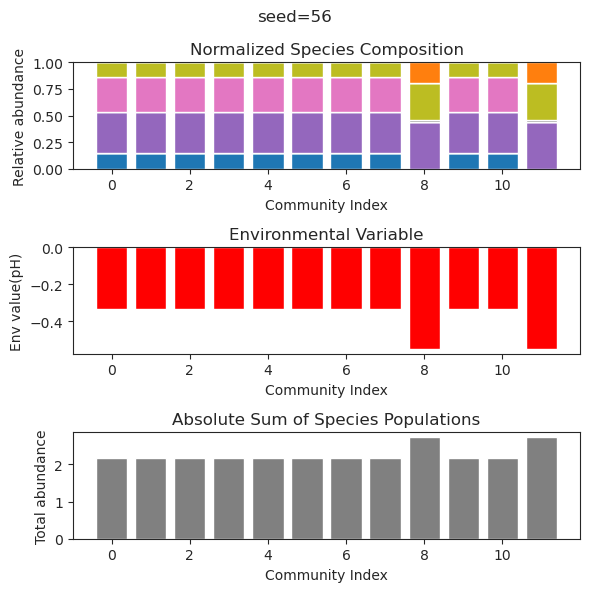

{'species': array([-5.17079222e-042,  9.22723182e-010,  4.50212391e-001,
        9.69101422e-002,  3.78836655e-034,  3.32452155e-072,
        6.76103174e-001,  3.91222132e-149,  6.61330136e-002,
        1.16528460e-151,  1.29141218e-001,  5.57071955e-001]), 'env': array([0.08800685])}
{'species': array([4.53347436e-114, 2.96708765e-011, 4.50212391e-001, 9.69101421e-002,
       8.32797894e-030, 5.31969049e-063, 6.76103175e-001, 1.31825395e-136,
       6.61330136e-002, 9.73322288e-034, 1.29141218e-001, 5.57071955e-001]), 'env': array([0.08800685])}
{'species': array([ 1.12468979e-042,  7.94434056e-014,  4.50212391e-001,
        9.69101421e-002,  3.72093719e-022, -6.58292387e-055,
        6.76103175e-001,  2.72723775e-130,  6.61330136e-002,
       -1.47747479e-132,  1.29141218e-001,  5.57071955e-001]), 'env': array([0.08800685])}
{'species': array([-4.50052773e-090,  1.95942278e-013,  4.50212391e-001,
        9.69101421e-002,  5.63016538e-020,  1.63513702e-057,
        6.76103175e-001,  3

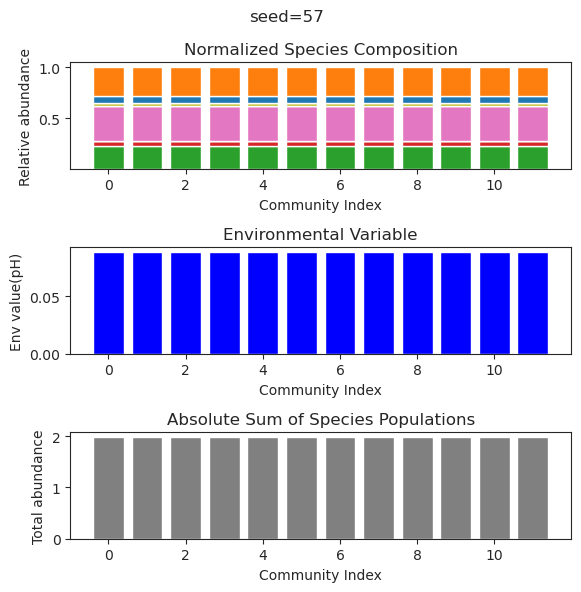

{'species': array([-8.49084510e-44,  2.21597401e-01,  8.08420830e-01,  1.31039436e-95,
       -2.04439395e-85,  3.33738933e-01,  6.69959603e-02, -2.20243669e-55,
        2.82673516e-01,  9.36148636e-02,  5.15373204e-01, -9.92617734e-81]), 'env': array([0.48902705])}
{'species': array([ 5.15217282e-45,  2.21597401e-01,  8.08420830e-01, -4.08763121e-74,
        4.14901964e-39,  3.33738933e-01,  6.69959603e-02, -2.82181378e-41,
        2.82673516e-01,  9.36148636e-02,  5.15373204e-01,  1.15541727e-63]), 'env': array([0.48902705])}
{'species': array([2.73631288e-060, 2.21597401e-001, 8.08420830e-001, 1.02580019e-131,
       3.82570284e-122, 3.33738933e-001, 6.69959603e-002, 5.04467440e-075,
       2.82673516e-001, 9.36148636e-002, 5.15373204e-001, 7.32045464e-118]), 'env': array([0.48902705])}
{'species': array([-2.44831747e-44,  2.21597401e-01,  8.08420830e-01,  7.56427652e-96,
       -8.30495741e-89,  3.33738933e-01,  6.69959603e-02, -8.40491856e-56,
        2.82673516e-01,  9.36148636e-

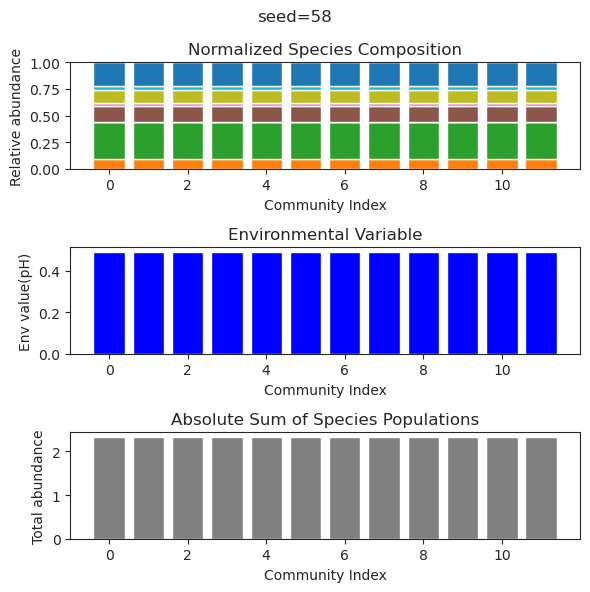

{'species': array([ 5.09810478e-01,  1.44397998e-30, -1.49891549e-43, -1.81104026e-38,
        1.13177534e-31, -2.35427779e-24,  4.53756050e-01, -4.34656068e-25,
        1.15978801e+00, -2.22604392e-33, -4.10218357e-15,  9.02844687e-02]), 'env': array([0.51161666])}
{'species': array([ 5.09810478e-01, -6.15510393e-28, -2.30965324e-51, -2.19610588e-38,
       -2.25109029e-30,  6.95420422e-29,  4.53756050e-01,  1.29673777e-26,
        1.15978801e+00, -8.03965738e-31, -6.22995636e-20,  9.02844687e-02]), 'env': array([0.51161666])}
{'species': array([ 5.09810478e-01,  9.80519829e-41, -2.41497306e-67,  8.38215708e-52,
        9.17162588e-42,  7.21754215e-40,  4.53756050e-01,  1.98892792e-36,
        1.15978801e+00,  5.90170055e-45, -1.59789129e-28,  9.02844687e-02]), 'env': array([0.51161666])}
{'species': array([ 5.09810478e-01, -2.89538362e-36,  8.42425498e-57,  1.69002640e-44,
       -3.70544095e-38,  3.15265127e-36,  4.53756050e-01,  2.19090500e-35,
        1.15978801e+00,  9.85715442e-

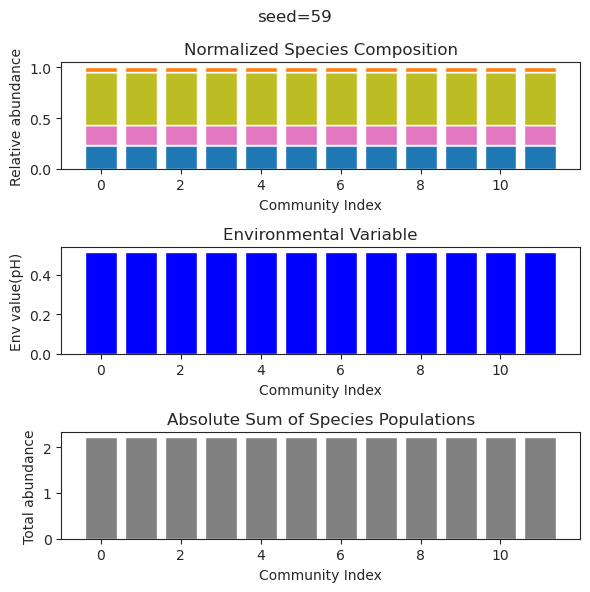

{'species': array([ 7.79717810e-01,  1.33047640e-01, -1.19560165e-35,  3.26750530e-01,
        3.38223587e-01,  4.04334346e-02,  1.87293135e-46,  7.05333031e-38,
        6.05970256e-01,  1.03526362e-01,  1.49314495e-31, -3.89154476e-46]), 'env': array([-0.47192755])}
{'species': array([ 7.79717810e-01,  1.33047640e-01, -4.62271664e-45,  3.26750530e-01,
        3.38223587e-01,  4.04334346e-02, -3.69888577e-73,  2.39553883e-49,
        6.05970256e-01,  1.03526362e-01,  8.47736952e-38,  1.51357543e-72]), 'env': array([-0.47192755])}
{'species': array([ 7.79717810e-01,  1.33047640e-01, -7.91937100e-39,  3.26750530e-01,
        3.38223587e-01,  4.04334346e-02,  1.96708047e-58,  1.41448936e-43,
        6.05970256e-01,  1.03526362e-01, -4.92130661e-33,  1.66787347e-57]), 'env': array([-0.47192755])}
{'species': array([ 7.79717810e-01,  1.33047640e-01, -3.81001250e-31,  3.26750530e-01,
        3.38223587e-01,  4.04334346e-02,  2.50258537e-69,  5.20503191e-46,
        6.05970256e-01,  1.0352636

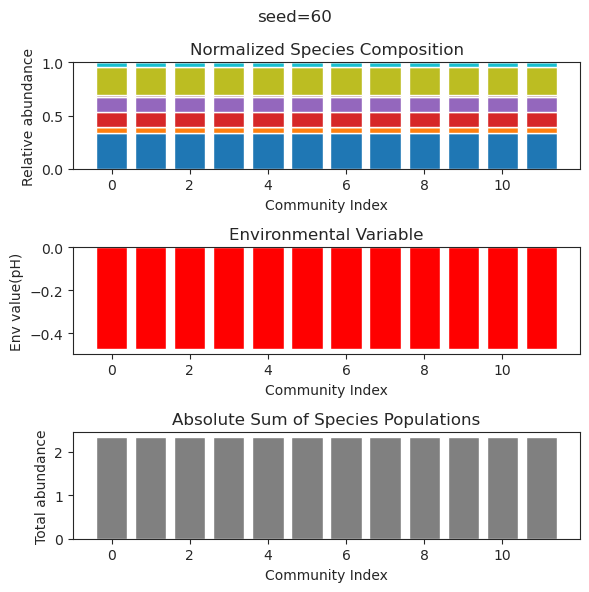

{'species': array([ 1.11139693e-01, -4.78111381e-48,  1.29565360e-18,  3.94699571e-01,
        5.08166708e-01,  1.24992043e-01,  1.48153100e-18,  2.48204824e-57,
        5.38857098e-01,  1.13953142e-01,  3.07922301e-63,  1.08045482e-01]), 'env': array([-0.15308892])}
{'species': array([ 1.11139693e-01,  1.66525252e-49, -7.45551367e-20,  3.94699571e-01,
        5.08166708e-01,  1.24992043e-01, -4.40316805e-24,  7.70873493e-53,
        5.38857098e-01,  1.13953142e-01,  9.94578341e-64,  1.08045482e-01]), 'env': array([-0.15308892])}
{'species': array([ 1.11139693e-01, -2.55259705e-50, -1.35664664e-32,  3.94699571e-01,
        5.08166708e-01,  1.24992043e-01, -1.12402968e-19, -4.27085200e-96,
        5.38857098e-01,  1.13953142e-01, -3.37620338e-69,  1.08045482e-01]), 'env': array([-0.15308892])}
{'species': array([ 1.11139693e-01, -3.42221220e-43,  7.07975452e-23,  3.94699571e-01,
        5.08166708e-01,  1.24992043e-01,  6.06820810e-21, -5.69681150e-56,
        5.38857098e-01,  1.1395314

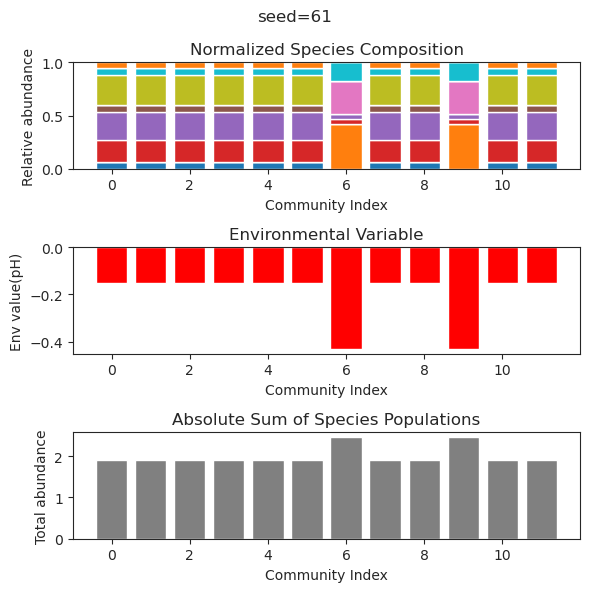

{'species': array([ 1.67153011e-001, -6.46217603e-313,  6.19839208e-002,
        5.08438420e-001, -4.94065646e-324,  6.23079662e-001,
        0.00000000e+000, -7.54411316e-148,  4.32575812e-124,
        9.52725452e-002,  3.91685137e-001,  3.59829613e-001]), 'env': array([0.16090185])}
{'species': array([1.67152996e-001, 0.00000000e+000, 6.19839658e-002, 5.08438404e-001,
       0.00000000e+000, 6.23079668e-001, 0.00000000e+000, 1.60071666e-148,
       1.89504940e-123, 9.52725482e-002, 3.91685115e-001, 3.59829591e-001]), 'env': array([0.16090183])}
{'species': array([ 1.67153009e-001, -5.05498339e-270,  6.19839133e-002,
        5.08438425e-001,  2.14355451e-269,  6.23079661e-001,
       -3.41489094e-289,  2.78322510e-126,  1.62777453e-110,
        9.52725201e-002,  3.91685175e-001,  3.59829625e-001]), 'env': array([0.16090186])}
{'species': array([1.67153016e-001, 2.84497783e-292, 6.19839135e-002, 5.08438421e-001,
       4.94065646e-324, 6.23079662e-001, 0.00000000e+000, 2.36197785e-147,

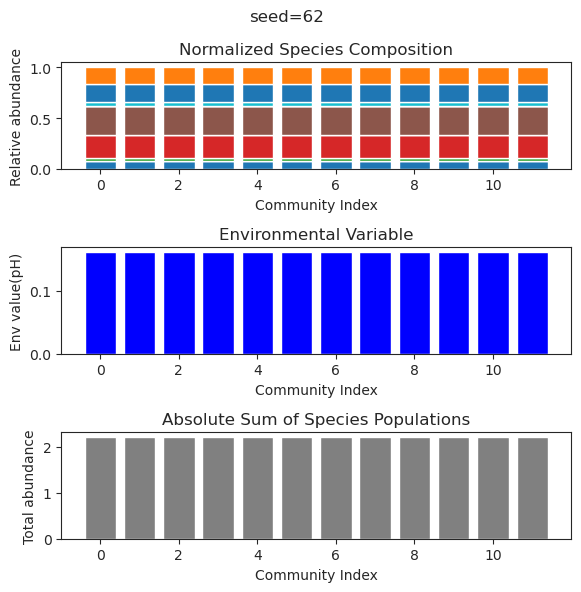

{'species': array([ 3.98379861e-01, -5.31128244e-37, -9.39770591e-44,  5.70057392e-01,
        2.09114338e-74, -8.84912451e-76,  9.59613649e-02, -3.88011831e-15,
        3.13053497e-57,  5.96106679e-01,  9.03321096e-59,  7.12564955e-01]), 'env': array([-0.21597018])}
{'species': array([ 3.98379861e-01, -1.39901524e-39, -8.69166336e-37,  5.70057392e-01,
        8.87730449e-38,  4.87981983e-39,  9.59613649e-02, -8.78225895e-18,
        2.81762381e-38,  5.96106679e-01,  6.12655413e-43,  7.12564955e-01]), 'env': array([-0.21597018])}
{'species': array([ 3.98379861e-001, -6.65020272e-096, -1.58755786e-060,
        5.70057392e-001,  6.08370136e-127, -8.04505147e-130,
        9.59613649e-002,  6.02669499e-017, -4.99346067e-090,
        5.96106679e-001, -2.42613314e-100,  7.12564955e-001]), 'env': array([-0.21597018])}
{'species': array([ 3.98379861e-01,  8.53228930e-44, -1.83583492e-39,  5.70057392e-01,
       -1.32843521e-58,  2.61037361e-60,  9.59613649e-02,  9.34143653e-17,
        2.17033

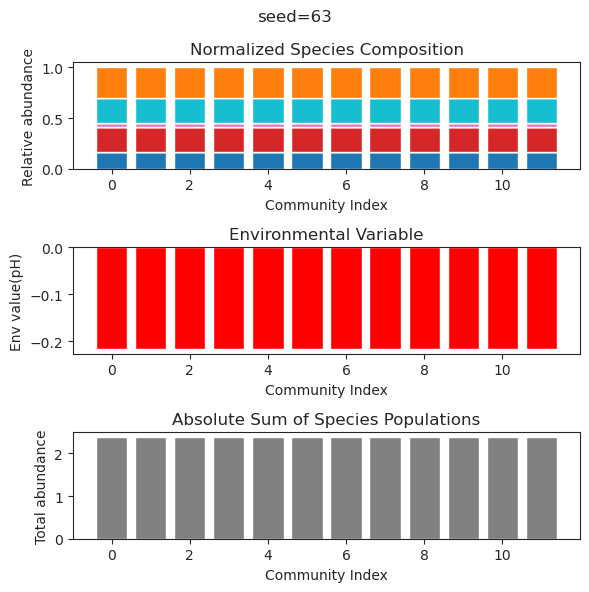

{'species': array([2.37745080e-005, 8.25348683e-002, 4.95893572e-008, 5.20638846e-001,
       2.32607449e-296, 6.56105672e-001, 1.14266924e-003, 2.26407693e-007,
       9.27934147e-001, 6.16348408e-002, 9.34458599e-106, 1.58475012e-063]), 'env': array([-0.15703677])}
{'species': array([2.41283066e-004, 8.57732925e-001, 5.20189368e-002, 5.48962992e-001,
       7.03364106e-295, 2.30570516e-005, 1.92494619e-003, 6.71249758e-002,
       1.17302969e-002, 6.40580471e-001, 1.60642987e-102, 5.98279442e-060]), 'env': array([-0.03046739])}
{'species': array([5.36736455e-006, 5.01376165e-001, 2.40929425e-006, 6.07626400e-001,
       6.20952395e-300, 1.36138821e-001, 1.18666720e-005, 1.03202841e-005,
       5.08918089e-001, 4.39301113e-001, 1.44739590e-105, 3.91937409e-065]), 'env': array([-0.02788416])}
{'species': array([1.90691950e-005, 4.75489504e-002, 9.35767874e-009, 5.11062059e-001,
       1.17112428e-302, 7.05351629e-001, 2.40829705e-003, 4.57481181e-008,
       9.72775243e-001, 3.30381537

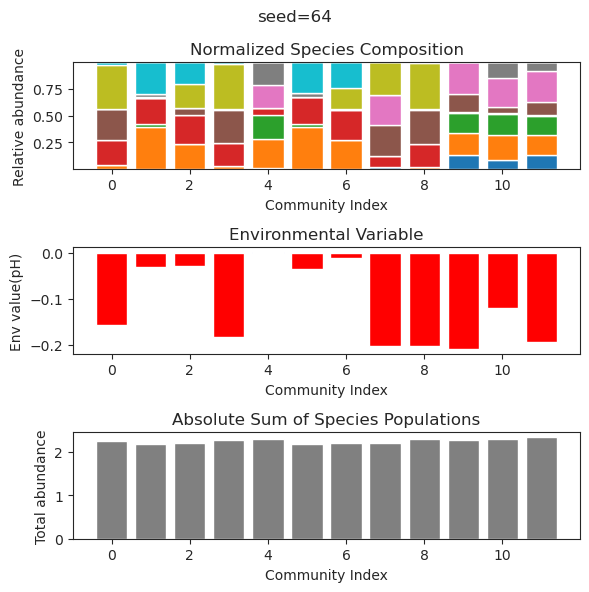

{'species': array([ 8.52656117e-02,  1.16517381e-40, -1.05630679e-17,  8.74668507e-01,
        3.03020206e-48, -8.68456089e-67,  1.63878198e+00,  3.97596165e-41,
        1.49821005e-66,  1.27357772e-51, -1.24691388e-32,  4.24250611e-48]), 'env': array([-0.85954832])}
{'species': array([ 8.52656117e-002, -3.31853789e-039,  3.35400381e-016,
        8.74668507e-001,  1.55813067e-057, -1.76101062e-104,
        1.63878198e+000, -1.90262829e-042,  3.37291337e-104,
       -1.81981684e-071, -2.09419750e-026, -2.51810791e-062]), 'env': array([-0.85954832])}
{'species': array([ 8.52656117e-02, -3.94586689e-40,  1.81399172e-16,  8.74668507e-01,
       -3.38506119e-57, -9.16610214e-97,  1.63878198e+00, -1.05905315e-43,
       -1.50087677e-94,  2.41212786e-71,  2.21278035e-29,  1.16265855e-63]), 'env': array([-0.85954832])}
{'species': array([ 8.52656117e-002, -2.94783683e-045,  4.27402750e-016,
        8.74668507e-001, -2.63122229e-068,  7.12585977e-117,
        1.63878198e+000,  3.04693782e-047, 

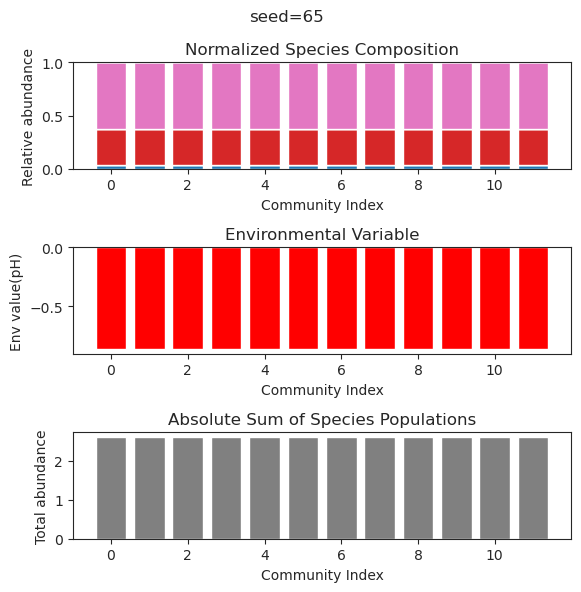

{'species': array([ 7.62531213e-002,  8.90183542e-150,  8.87566265e-001,
        5.94121141e-001,  2.34878943e-001, -2.99178240e-071,
        2.35031448e-090, -1.45029872e-057,  4.85015497e-002,
        1.05292308e-113,  1.49275775e-081,  1.61773467e-001]), 'env': array([0.00707163])}
{'species': array([ 7.62531213e-002, -2.09925204e-148,  8.87566265e-001,
        5.94121141e-001,  2.34878943e-001,  3.87835936e-072,
        9.42695930e-092,  6.60181524e-059,  4.85015497e-002,
       -4.69941812e-111,  1.23784374e-080,  1.61773467e-001]), 'env': array([0.00707163])}
{'species': array([ 7.62531213e-002,  3.72293385e-143,  8.87566265e-001,
        5.94121141e-001,  2.34878943e-001, -2.01289139e-068,
        8.28703065e-087,  7.44561730e-056,  4.85015497e-002,
        1.28763798e-107, -1.76717085e-076,  1.61773467e-001]), 'env': array([0.00707163])}
{'species': array([ 7.62531213e-002, -8.94021122e-145,  8.87566265e-001,
        5.94121141e-001,  2.34878943e-001,  4.94659051e-070,
        

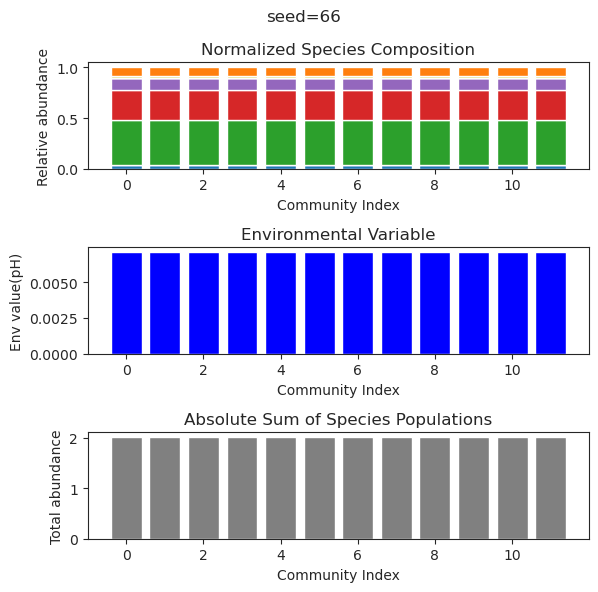

{'species': array([ 5.63297374e-01,  1.76497227e-15,  7.43899794e-01, -2.70109145e-24,
       -1.01966372e-65,  2.91354783e-43,  1.48027465e+00, -3.74124822e-68,
        6.84532422e-73,  1.51515209e-01,  2.02571654e-21,  1.46151257e-39]), 'env': array([0.82348368])}
{'species': array([ 5.63297374e-01, -3.59737744e-17,  7.43899794e-01,  3.60232164e-26,
        7.91728223e-54,  3.90760883e-44,  1.48027465e+00, -1.58900131e-54,
       -3.41481835e-63,  1.51515209e-01,  3.95314121e-24,  1.39119766e-31]), 'env': array([0.82348368])}
{'species': array([ 5.63297374e-01,  2.62071573e-16,  7.43899794e-01, -1.48923882e-27,
       -2.13613967e-54, -4.13610440e-43,  1.48027465e+00,  1.26546014e-55,
       -1.55388394e-61,  1.51515209e-01,  3.78381409e-24,  1.31302562e-35]), 'env': array([0.82348368])}
{'species': array([ 5.63297374e-01, -9.77815998e-15,  7.43899794e-01,  2.30262828e-23,
        3.95012280e-41,  5.87734931e-41,  1.48027465e+00, -5.66352220e-64,
       -1.49217412e-71,  1.51515209e-

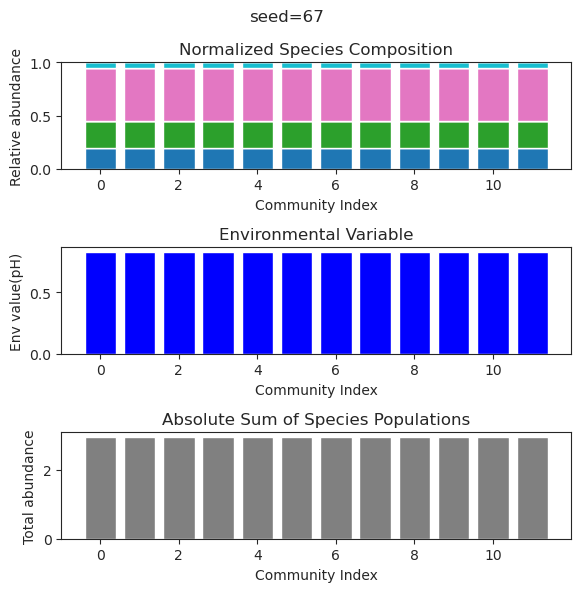

{'species': array([ 6.15574831e-30,  9.77830606e-03, -2.55654393e-33, -1.68304587e-31,
        4.14145189e-01,  8.76483398e-40,  3.06313323e-02,  8.19909038e-03,
        1.98495629e-01,  4.01711740e-01,  3.17644714e-01,  3.61472217e-01]), 'env': array([0.19996962])}
{'species': array([-3.01742657e-36,  9.88072026e-03, -1.03610862e-36,  2.96815155e-71,
        4.14159954e-01,  8.20661457e-47,  3.05188477e-02,  8.26719360e-03,
        1.98450080e-01,  4.01596718e-01,  3.17588735e-01,  3.61621031e-01]), 'env': array([0.19998204])}
{'species': array([-1.15046662e-33,  9.79587011e-03,  6.01198158e-32,  1.79822302e-46,
        4.14132982e-01, -4.13792958e-32,  3.06454529e-02,  8.19401457e-03,
        1.98489913e-01,  4.01714564e-01,  3.17635973e-01,  3.61468208e-01]), 'env': array([0.19996405])}
{'species': array([-3.01488074e-71,  1.00258169e-02,  1.54256125e-32, -9.42209572e-35,
        4.14058656e-01, -2.94633065e-30,  3.06346838e-02,  8.22462085e-03,
        1.98403553e-01,  4.01620147e-

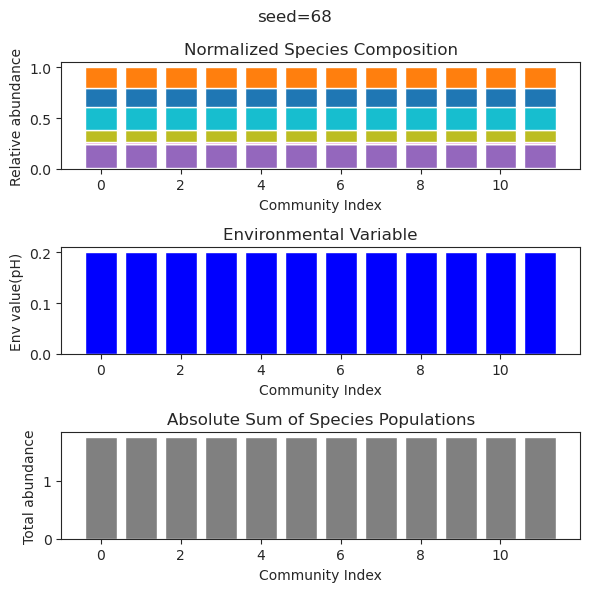

{'species': array([ 1.76087197e-01, -3.26792167e-20,  3.18464202e-52,  4.80227397e-01,
       -2.06528629e-37,  3.71548721e-32,  3.89122062e-01,  4.98008952e-01,
       -2.40804600e-53,  4.52616224e-51,  4.30967293e-30,  8.47764861e-01]), 'env': array([0.38686847])}
{'species': array([ 1.76087197e-01,  2.49177217e-22, -6.17367690e-59,  4.80227397e-01,
       -1.14417123e-47, -2.24426087e-38,  3.89122062e-01,  4.98008952e-01,
       -6.57725555e-61,  8.40507248e-57, -1.62430121e-35,  8.47764861e-01]), 'env': array([0.38686847])}
{'species': array([ 1.76087197e-01, -2.04685654e-25, -1.43155004e-67,  4.80227397e-01,
       -5.91160367e-58, -2.10845216e-43,  3.89122062e-01,  4.98008952e-01,
       -2.98858949e-71, -6.20483331e-68,  3.22707795e-46,  8.47764861e-01]), 'env': array([0.38686847])}
{'species': array([ 1.76087197e-01, -1.12281117e-23, -3.39129287e-62,  4.80227397e-01,
       -6.60098970e-52,  1.89193194e-44,  3.89122062e-01,  4.98008952e-01,
       -7.23299655e-63, -4.37417256e-

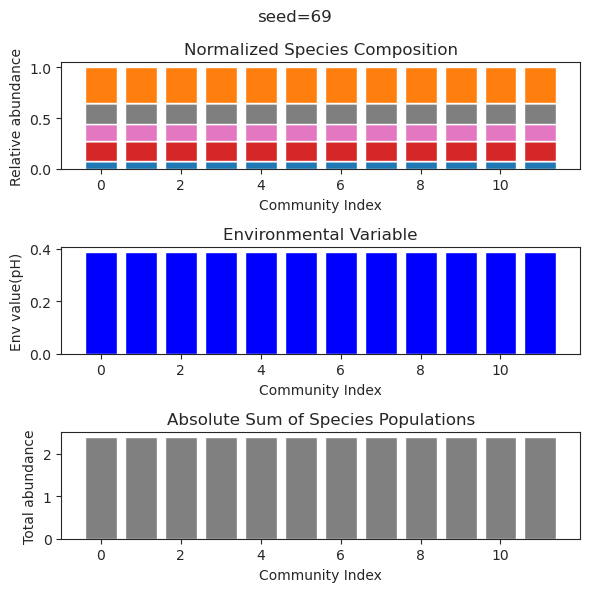

{'species': array([-1.38415819e-50,  2.42798400e-01,  1.45048250e-42,  6.70237056e-01,
        4.31698770e-02, -4.07236839e-16,  4.76349489e-44,  4.35419421e-01,
        1.13642103e-01,  3.87181594e-01, -3.31119487e-26, -2.95445447e-26]), 'env': array([-0.40476349])}
{'species': array([ 1.88280306e-106,  2.42798400e-001, -3.32622545e-085,
        6.70237056e-001,  4.31698770e-002, -3.51807251e-017,
       -7.88015041e-077,  4.35419421e-001,  1.13642103e-001,
        3.87181594e-001,  2.59585591e-028,  1.50617497e-031]), 'env': array([-0.40476349])}
{'species': array([ 1.28063564e-85,  2.42798400e-01,  1.69957800e-67,  6.70237056e-01,
        4.31698770e-02, -9.27256194e-15,  2.57583026e-63,  4.35419421e-01,
        1.13642103e-01,  3.87181594e-01, -2.81896967e-26,  3.79618734e-29]), 'env': array([-0.40476349])}
{'species': array([-3.56237367e-74,  2.42798400e-01,  7.84058413e-62,  6.70237056e-01,
        4.31698770e-02, -4.39450253e-17, -3.83401565e-54,  4.35419421e-01,
        1.13642

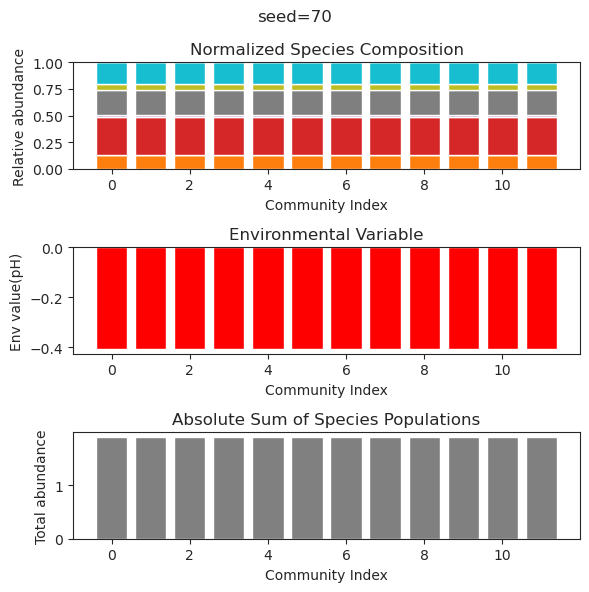

{'species': array([ 2.53398410e-01,  1.92034204e-01,  6.50878250e-02,  2.86738509e-01,
       -7.47806542e-43,  2.32413537e-02,  1.66144914e-01, -2.82644737e-43,
       -1.51409360e-53,  5.28834866e-02,  3.07402322e-01,  4.82590098e-01]), 'env': array([-0.12142843])}
{'species': array([ 2.53398400e-01,  1.92034201e-01,  6.50878393e-02,  2.86738497e-01,
       -9.79706811e-56,  2.32413601e-02,  1.66144918e-01, -2.84269224e-53,
        1.33523122e-45,  5.28835008e-02,  3.07402323e-01,  4.82590085e-01]), 'env': array([-0.12142844])}
{'species': array([ 1.15919183e-31,  2.45902964e-06,  5.36702419e-01,  2.31529913e-99,
        8.41714525e-02,  2.33124927e-01,  1.97370699e-01,  5.59008590e-01,
       -1.48052446e-31,  1.24673893e-01, -1.37891996e-33,  4.54093217e-01]), 'env': array([-0.47967682])}
{'species': array([-1.15406812e-30,  3.14315033e-06,  5.36702098e-01,  4.87517182e-31,
        8.41713898e-02,  2.33124633e-01,  1.97370917e-01,  5.59008508e-01,
       -2.38309201e-31,  1.2467381

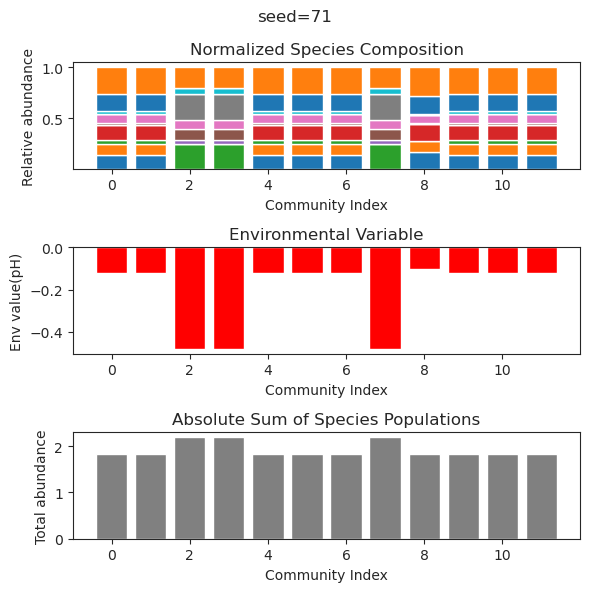

{'species': array([ 1.57570652e-001, -2.85408939e-029,  5.24328483e-001,
        4.63835482e-001,  2.14577859e-001,  8.38947342e-002,
        2.31092311e-001,  2.61819093e-001,  6.68880897e-016,
        1.35765069e-102,  1.25277942e-128,  3.55113805e-041]), 'env': array([0.0523651])}
{'species': array([ 1.57570652e-001,  1.16811914e-028,  5.24328483e-001,
        4.63835482e-001,  2.14577859e-001,  8.38947342e-002,
        2.31092311e-001,  2.61819093e-001, -7.62366278e-015,
       -8.11732535e-099,  1.39329492e-127,  1.34974171e-037]), 'env': array([0.0523651])}
{'species': array([ 1.57570652e-001, -8.20409736e-029,  5.24328483e-001,
        4.63835482e-001,  2.14577859e-001,  8.38947342e-002,
        2.31092311e-001,  2.61819093e-001,  2.93159560e-014,
        5.61902479e-104, -1.16975421e-132, -3.99127871e-043]), 'env': array([0.0523651])}
{'species': array([ 1.57570652e-001, -7.12775085e-026,  5.24328483e-001,
        4.63835482e-001,  2.14577859e-001,  8.38947342e-002,
        2.3

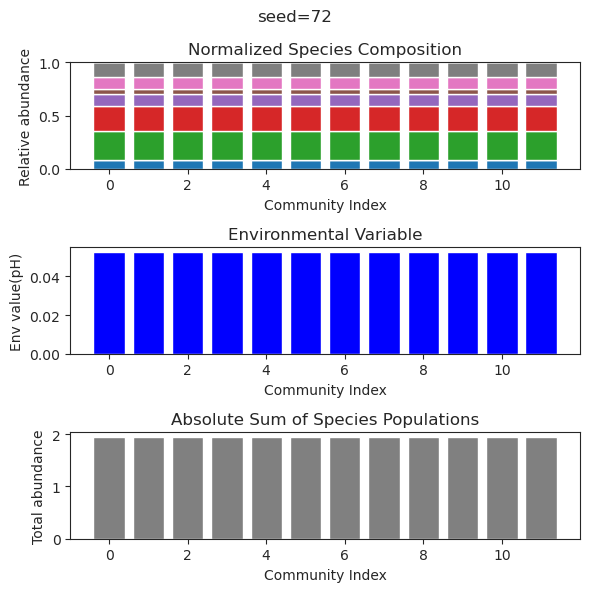

{'species': array([-3.11051784e-35,  6.34853386e-02, -6.79146753e-57,  8.02638141e-01,
        6.86131106e-01,  6.70371608e-02, -2.62171951e-45, -1.51930082e-59,
       -1.21198635e-56,  6.11522153e-01, -2.93181182e-41, -5.38923748e-60]), 'env': array([0.22655385])}
{'species': array([ 2.04454824e-040,  6.34853386e-002, -4.15962568e-114,
        8.02638141e-001,  6.86131106e-001,  6.70371608e-002,
        8.46400560e-089,  3.02745491e-101, -2.33797045e-124,
        6.11522153e-001, -2.98567450e-054,  2.91246855e-114]), 'env': array([0.22655385])}
{'species': array([ 1.31677994e-36,  6.34853386e-02, -9.67056291e-69,  8.02638141e-01,
        6.86131106e-01,  6.70371608e-02, -1.38466435e-53,  5.04838976e-65,
        8.27240440e-71,  6.11522153e-01,  5.41095269e-41, -1.50634158e-70]), 'env': array([0.22655385])}
{'species': array([-2.53125319e-18,  1.04385591e-39,  1.59926780e-26,  7.19905067e-01,
        2.55180386e-74,  7.07512176e-01,  4.87394257e-34,  3.12976450e-60,
        4.25646144

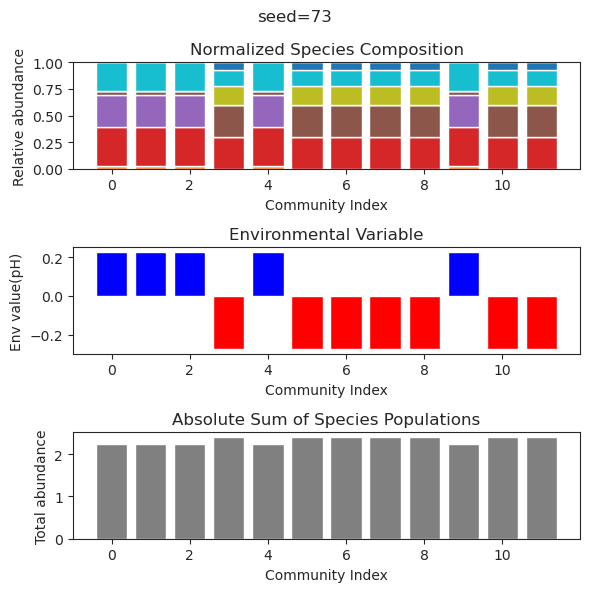

{'species': array([ 5.93598387e-61,  3.95338146e-01,  1.29684974e-01,  1.92042321e-01,
        7.99648742e-32,  5.35192095e-01,  3.79158749e-01,  5.15806413e-02,
       -5.19059947e-36,  2.21623722e-22,  1.56771696e-62,  4.57335342e-01]), 'env': array([-0.15437152])}
{'species': array([-2.49898954e-66,  3.95338146e-01,  1.29684974e-01,  1.92042321e-01,
        1.39532395e-31,  5.35192095e-01,  3.79158749e-01,  5.15806413e-02,
        3.14157157e-36, -1.04198354e-25, -4.15150422e-66,  4.57335342e-01]), 'env': array([-0.15437152])}
{'species': array([-5.84935542e-84,  3.95338146e-01,  1.29684974e-01,  1.92042321e-01,
        1.82930322e-35,  5.35192095e-01,  3.79158749e-01,  5.15806413e-02,
        1.33820632e-39, -5.28092110e-26,  8.97889353e-85,  4.57335342e-01]), 'env': array([-0.15437152])}
{'species': array([ 4.25043129e-64,  3.95338146e-01,  1.29684974e-01,  1.92042321e-01,
       -2.76918807e-29,  5.35192095e-01,  3.79158749e-01,  5.15806413e-02,
        6.41226809e-33, -1.3810950

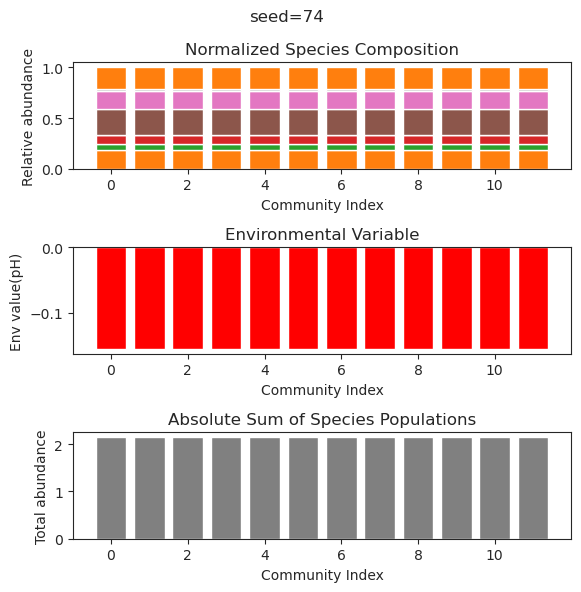

{'species': array([ 7.18360417e-42,  1.81655524e-38,  4.15168888e-17, -6.22658995e-48,
       -4.16356479e-28, -1.29767441e-42, -9.28522905e-24,  7.46266060e-01,
        5.36821193e-01,  7.94513701e-01,  1.82240826e-38,  1.81678687e-26]), 'env': array([0.57375384])}
{'species': array([ 3.95696366e-87, -2.77325332e-84, -9.17434480e-16,  4.20619565e-76,
       -5.18762352e-24, -2.86896228e-68,  2.05159989e-17,  7.46266060e-01,
        5.36821193e-01,  7.94513701e-01,  5.36918601e-47,  8.51981320e-21]), 'env': array([0.57375384])}
{'species': array([-5.17345809e-65, -3.72070524e-68,  9.28431734e-15, -8.85408971e-56,
        2.12257764e-24, -2.33711660e-53,  7.43471793e-19,  7.46266060e-01,
        5.36821193e-01,  7.94513701e-01,  6.13136740e-38,  2.31924529e-25]), 'env': array([0.57375384])}
{'species': array([-1.59575779e-89,  4.11029672e-84,  6.97770694e-16,  3.41451482e-70,
        1.49825919e-25,  2.44700861e-65, -3.22824662e-19,  7.46266060e-01,
        5.36821193e-01,  7.94513701e-

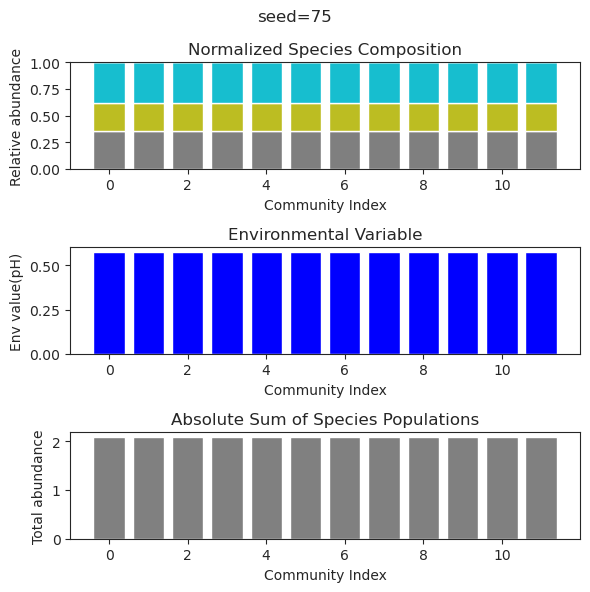

{'species': array([-7.64768016e-28, -1.27611595e-60,  1.00455774e-01, -9.63833545e-21,
       -9.82092501e-34,  3.69262026e-45,  3.01699638e-01,  8.38122440e-01,
        6.99111722e-01,  1.18784717e-01,  1.22562099e-45,  6.42130708e-16]), 'env': array([0.18804781])}
{'species': array([ 7.52864979e-28,  1.16947314e-41,  1.00455774e-01,  1.34885918e-22,
       -6.62917140e-31, -2.46837397e-42,  3.01699638e-01,  8.38122440e-01,
        6.99111722e-01,  1.18784717e-01, -3.98358135e-44,  1.60038291e-15]), 'env': array([0.18804781])}
{'species': array([-9.07859976e-30,  1.08906976e-72,  1.00455774e-01,  7.22556474e-24,
       -2.68058134e-36, -2.07508712e-63,  3.01699638e-01,  8.38122440e-01,
        6.99111722e-01,  1.18784717e-01, -2.25951888e-67,  7.59808398e-18]), 'env': array([0.18804781])}
{'species': array([ 1.01698489e-31,  1.39073208e-88,  1.00455774e-01,  8.70212681e-23,
        8.73826632e-39,  8.11995668e-72,  3.01699638e-01,  8.38122440e-01,
        6.99111722e-01,  1.18784717e-

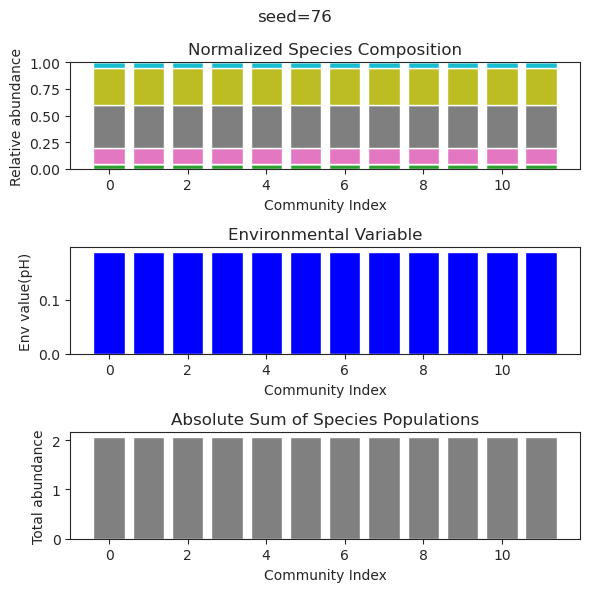

{'species': array([ 3.11963049e-46,  3.10422524e-01,  3.58893373e-01,  4.26811934e-01,
       -7.53345087e-28,  2.69447327e-01,  5.61174508e-57,  4.76221259e-01,
       -1.10535873e-61,  2.58180456e-10,  4.07276123e-01,  6.62197224e-02]), 'env': array([-0.15751477])}
{'species': array([ 1.80059155e-36,  3.10422496e-01,  3.58893375e-01,  4.26811997e-01,
        8.06743272e-34,  2.69447283e-01, -1.40772850e-30,  4.76221347e-01,
        9.54147770e-93,  8.98703469e-08,  4.07276035e-01,  6.62196279e-02]), 'env': array([-0.15751485])}
{'species': array([ 7.72822842e-33,  3.10422523e-01,  3.58893373e-01,  4.26811937e-01,
       -1.42351728e-29,  2.69447325e-01, -1.55954605e-91,  4.76221263e-01,
        1.62469889e-89,  3.79495198e-09,  4.07276119e-01,  6.62197186e-02]), 'env': array([-0.15751477])}
{'species': array([ 6.88030107e-35,  3.10422515e-01,  3.58893374e-01,  4.26811954e-01,
        3.42989534e-37,  2.69447313e-01,  1.36578931e-32,  4.76221287e-01,
       -6.57540758e-32,  2.9155742

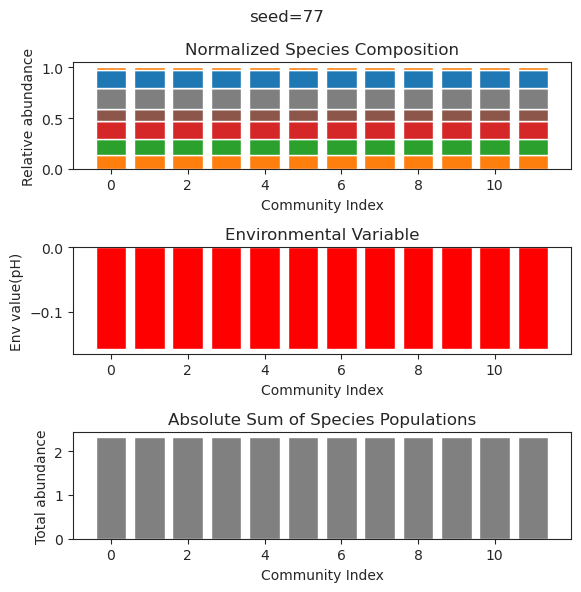

{'species': array([ 4.75467748e-40, -7.04545624e-30,  2.95847329e-55, -2.63302266e-47,
        1.22396085e-60,  1.13104846e+00,  4.55151657e-33, -1.08692419e-30,
        6.51665871e-45,  1.50241266e+00, -2.23632919e-48, -2.40562396e-44]), 'env': array([0.79237964])}
{'species': array([ 5.24580631e-33, -2.57644380e-23, -9.96982115e-56,  5.47371534e-46,
       -2.64522236e-58,  1.13104846e+00, -2.14431333e-26,  1.57213058e-23,
        1.70315072e-40,  1.50241266e+00,  1.50075256e-47, -1.22024486e-45]), 'env': array([0.79237964])}
{'species': array([-2.22364914e-35, -1.45964682e-24,  6.01676842e-62, -2.24960992e-48,
       -9.19547917e-66,  1.13104846e+00, -1.86918096e-21, -4.37344181e-21,
        4.49796694e-40,  1.50241266e+00, -1.47456224e-49,  1.58867271e-39]), 'env': array([0.79237964])}
{'species': array([-1.53645169e-32, -1.18370588e-25, -1.35410292e-49,  7.89212088e-41,
       -1.71691160e-54,  1.13104846e+00,  3.55607382e-23,  1.41794635e-22,
        1.06759847e-36,  1.50241266e+

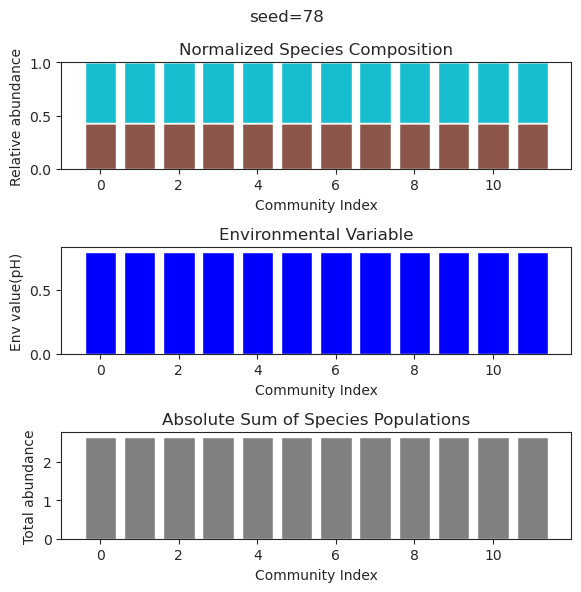

{'species': array([ 9.07838414e-01,  2.42226780e-01, -6.08028563e-63, -2.16488094e-51,
       -5.10701604e-71,  2.35226062e-01,  1.72252927e-30, -7.22402550e-68,
        1.06108644e+00,  1.06560101e-01,  1.35743970e-70,  5.73622313e-71]), 'env': array([0.75702061])}
{'species': array([-2.25283863e-34,  7.62942572e-01,  7.01097765e-42,  1.98832505e-01,
       -1.52997148e-38,  4.26950556e-01,  1.54455885e-01,  1.11035594e-41,
       -3.92083694e-19, -7.63497091e-48, -5.48626571e-43,  8.08377682e-01]), 'env': array([0.01465427])}
{'species': array([ 9.07838414e-001,  2.42226780e-001, -1.95680265e-091,
        6.00322459e-070, -1.62390284e-097,  2.35226062e-001,
        1.77730311e-030, -2.07993874e-106,  1.06108644e+000,
        1.06560101e-001,  1.76130473e-100, -2.28046772e-098]), 'env': array([0.75702061])}
{'species': array([ 6.43145459e-42,  7.62942572e-01,  3.32756955e-50,  1.98832505e-01,
        8.65903704e-47,  4.26950556e-01,  1.54455885e-01,  1.32633251e-50,
        1.58906803

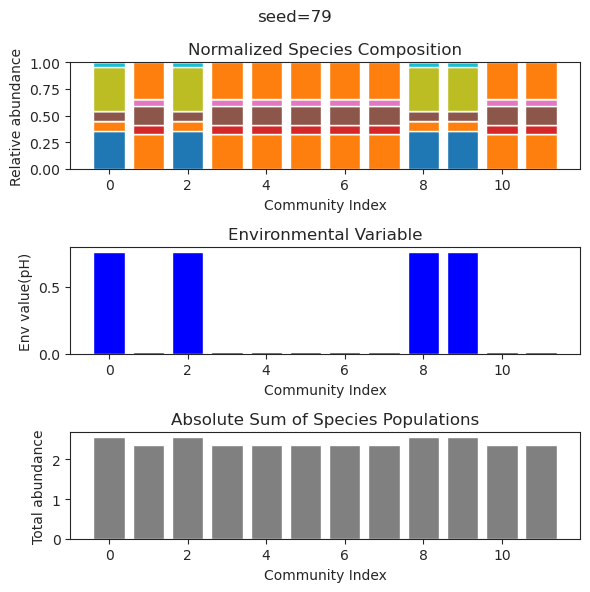

{'species': array([-2.71551874e-34,  3.45190888e-01,  2.38562561e-02,  8.61336122e-25,
        9.02578987e-88,  2.55108012e-19,  4.35218075e-01,  2.11094736e-01,
       -5.56295071e-49,  3.53002379e-01,  6.51908664e-01,  2.48924141e-67]), 'env': array([-0.04892243])}
{'species': array([ 5.99804603e-35,  3.45190888e-01,  2.38562561e-02, -2.35550653e-26,
       -6.29224268e-62,  5.90831519e-21,  4.35218075e-01,  2.11094736e-01,
       -1.03846204e-42,  3.53002379e-01,  6.51908664e-01, -1.59566351e-51]), 'env': array([-0.04892243])}
{'species': array([ 1.24665824e-35,  3.45190888e-01,  2.38562561e-02, -8.57174112e-22,
       -9.58939729e-98,  8.93154441e-17,  4.35218075e-01,  2.11094736e-01,
        1.86382528e-53,  3.53002379e-01,  6.51908664e-01, -3.94735198e-74]), 'env': array([-0.04892243])}
{'species': array([ 4.40333363e-36,  3.45190888e-01,  2.38562561e-02, -1.77637287e-21,
       -2.16643332e-87,  3.20400066e-16,  4.35218075e-01,  2.11094736e-01,
       -3.80618188e-51,  3.5300237

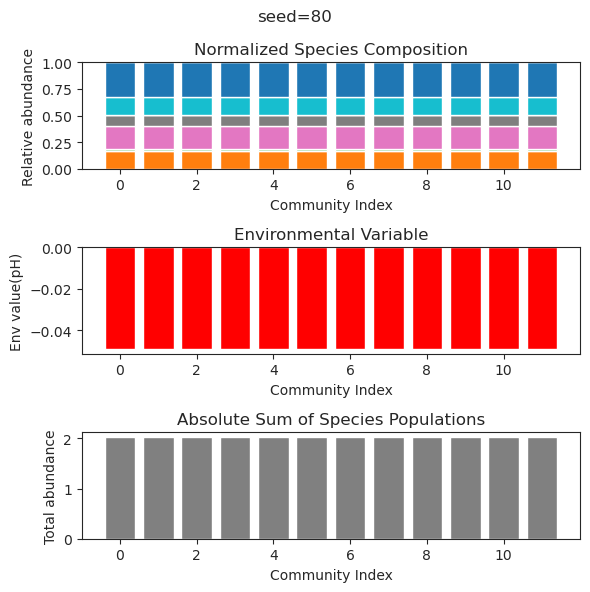

{'species': array([ 3.51537943e-01,  7.40839273e-84,  1.47529971e-01,  1.22413445e-08,
        1.52458399e-60,  7.44433491e-01, -9.79103594e-63,  9.66080843e-01,
       -5.59499557e-64,  5.06063417e-66,  5.60831599e-90,  2.05926597e-36]), 'env': array([0.57083195])}
{'species': array([ 3.51537936e-01,  1.04906040e-39,  1.47529991e-01,  5.02137313e-10,
       -2.75464903e-41,  7.44433483e-01, -2.90769047e-39,  9.66080842e-01,
       -6.18413237e-37, -3.96649895e-45,  7.33375290e-53,  6.89101657e-31]), 'env': array([0.57083194])}
{'species': array([ 3.51538068e-01,  5.28927735e-31,  1.47529622e-01,  2.18652831e-07,
        1.45303771e-70,  7.44433648e-01, -1.53351456e-94,  9.66080864e-01,
        3.83246168e-86,  1.71175957e-56, -2.95640722e-89,  1.28134334e-45]), 'env': array([0.57083207])}
{'species': array([ 3.51538011e-01, -7.17363794e-30,  1.47529782e-01,  1.24047817e-07,
       -1.55221598e-62,  7.44433576e-01,  1.21329404e-67,  9.66080854e-01,
        2.17642971e-69, -1.21855776e-

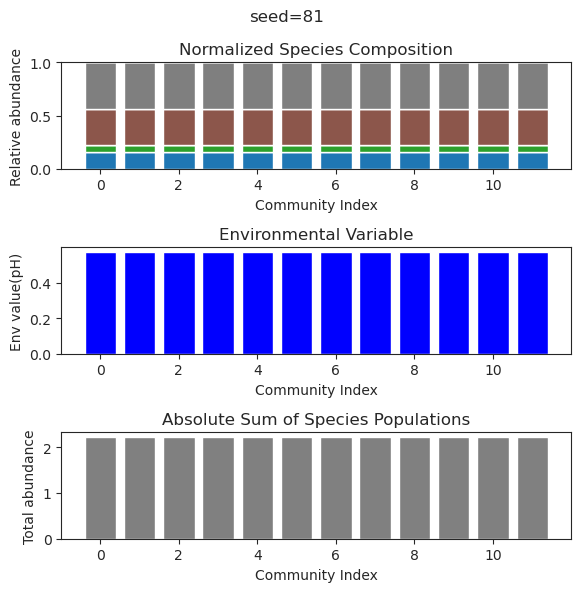

{'species': array([ 2.70468869e-96,  1.10905396e-01,  7.06755792e-01, -4.19648487e-54,
        1.81392964e-01,  5.00496040e-01,  3.76838699e-37, -3.58019816e-97,
       -8.17987676e-85,  3.01578567e-01,  3.80905901e-01, -6.78658797e-18]), 'env': array([-0.19485541])}
{'species': array([ 3.38172962e-98,  1.10905396e-01,  7.06755792e-01, -4.28486171e-57,
        1.81392964e-01,  5.00496040e-01,  1.06473115e-35,  3.26062912e-97,
        1.09402497e-89,  3.01578567e-01,  3.80905901e-01,  5.03245678e-17]), 'env': array([-0.19485541])}
{'species': array([ 3.35578594e-84,  1.10905396e-01,  7.06755792e-01, -4.97559265e-53,
        1.81392964e-01,  5.00496040e-01, -1.62299050e-35,  2.15258392e-87,
        3.31425704e-80,  3.01578567e-01,  3.80905901e-01,  4.25332913e-17]), 'env': array([-0.19485541])}
{'species': array([ 1.85463228e-92,  1.10905396e-01,  7.06755792e-01, -3.49189769e-52,
        1.81392964e-01,  5.00496040e-01, -5.96669649e-35,  1.47812391e-96,
       -2.35427068e-83,  3.0157856

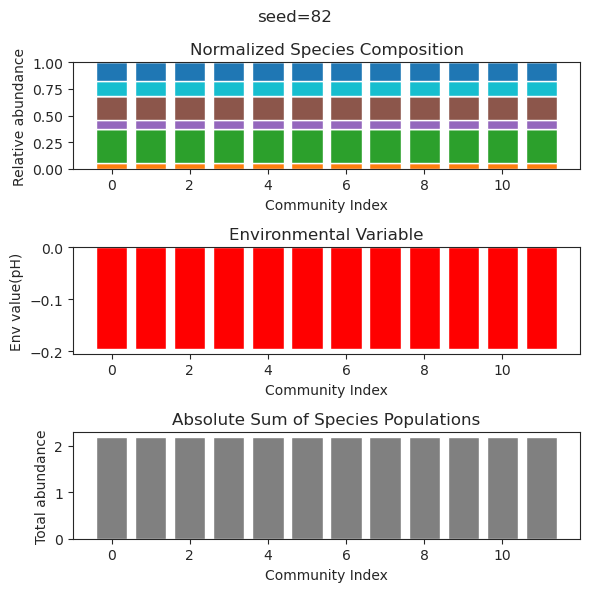

{'species': array([ 4.61738250e-39,  6.08227264e-02,  6.52799479e-01,  1.10788708e-38,
       -5.56812811e-43,  1.16096635e-01,  4.89082945e-02,  5.71419908e-01,
        2.28928555e-61,  4.36555024e-01, -9.36559109e-80,  1.43968712e-01]), 'env': array([-0.15684028])}
{'species': array([ 4.42273814e-001,  2.33693676e-002,  2.14095401e-041,
        5.72006248e-122,  4.17614895e-001,  3.59027622e-071,
       -4.78695922e-020,  2.02120329e-001, -1.13390868e-049,
        2.66099180e-001, -8.04503715e-107,  5.15305686e-001]), 'env': array([0.0710518])}
{'species': array([-1.65169311e-43,  6.08227264e-02,  6.52799479e-01, -6.83806701e-42,
        9.72779528e-47,  1.16096635e-01,  4.89082945e-02,  5.71419908e-01,
       -5.77569790e-61,  4.36555024e-01,  1.23575811e-75,  1.43968712e-01]), 'env': array([-0.15684028])}
{'species': array([ 4.42273814e-001,  2.33693676e-002,  1.05490076e-046,
        4.20861653e-134,  4.17614895e-001,  1.29615897e-081,
        5.77677481e-023,  2.02120329e-001, -1

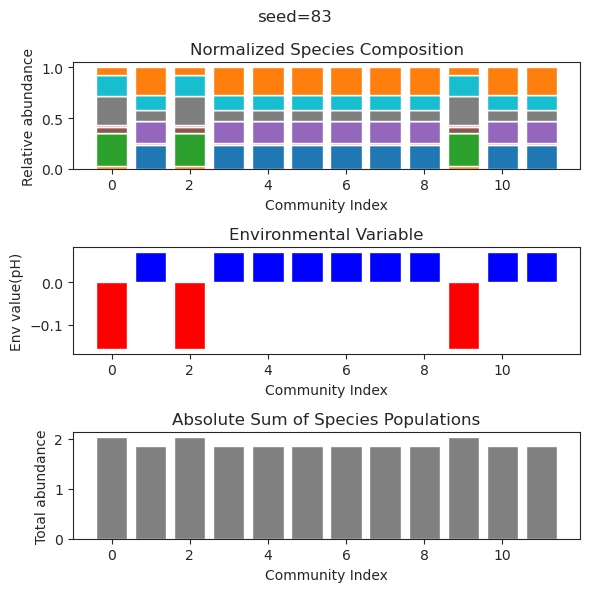

{'species': array([-7.12943140e-29,  2.17105751e-42,  8.58373121e-02,  2.71686511e-28,
        4.75174118e-01,  8.12243463e-01,  4.73616190e-01, -4.85541505e-51,
       -5.51841111e-25, -2.08472300e-32,  2.20825220e-01,  1.52933011e-01]), 'env': array([-0.41052732])}
{'species': array([-7.68414428e-50,  1.89475525e-39,  8.58373121e-02,  2.53410484e-46,
        4.75174118e-01,  8.12243463e-01,  4.73616190e-01, -2.62896295e-86,
       -2.57330966e-29, -4.33251228e-31,  2.20825220e-01,  1.52933011e-01]), 'env': array([-0.41052732])}
{'species': array([ 1.73907884e-31,  7.50031479e-26,  8.58373121e-02, -5.03751424e-28,
        4.75174118e-01,  8.12243463e-01,  4.73616190e-01, -2.72926902e-53,
        8.91842039e-20, -4.27039050e-21,  2.20825220e-01,  1.52933011e-01]), 'env': array([-0.41052732])}
{'species': array([-1.75932173e-44,  1.10427129e-42,  8.58373121e-02,  2.16124336e-42,
        4.75174118e-01,  8.12243463e-01,  4.73616190e-01,  1.13533016e-77,
       -6.46179429e-28, -2.0915826

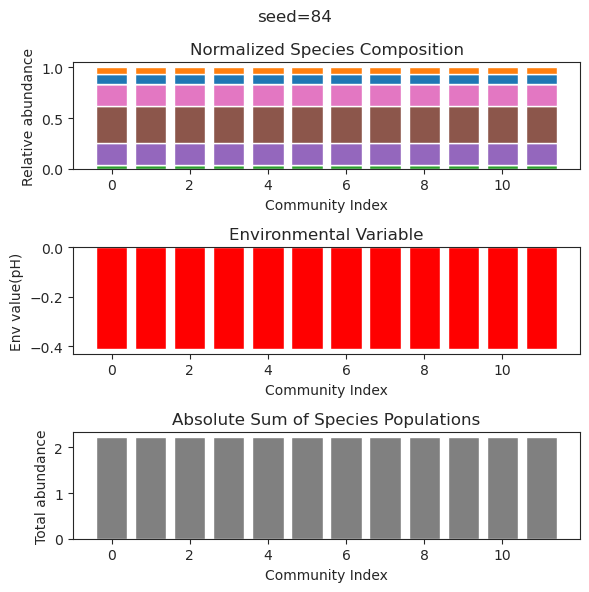

{'species': array([1.18627554e-067, 3.30706583e-001, 2.18359484e-001, 2.63530402e-001,
       2.09219861e-151, 6.80747729e-002, 4.57690398e-001, 4.52244376e-149,
       2.90159962e-001, 6.70007183e-070, 3.09933291e-001, 1.09617205e-001]), 'env': array([0.03784459])}
{'species': array([-2.65043784e-066,  3.30706583e-001,  2.18359484e-001,
        2.63530402e-001,  2.53977990e-149,  6.80747729e-002,
        4.57690398e-001, -1.06790490e-141,  2.90159962e-001,
       -2.99195082e-067,  3.09933291e-001,  1.09617205e-001]), 'env': array([0.03784459])}
{'species': array([-2.39849482e-056,  3.30706583e-001,  2.18359484e-001,
        2.63530402e-001,  5.63780133e-107,  6.80747729e-002,
        4.57690398e-001, -1.89705309e-103,  2.90159962e-001,
       -1.21222998e-056,  3.09933291e-001,  1.09617205e-001]), 'env': array([0.03784459])}
{'species': array([ 3.04861639e-068,  3.30706583e-001,  2.18359484e-001,
        2.63530402e-001,  4.10192770e-155,  6.80747729e-002,
        4.57690398e-001, -4

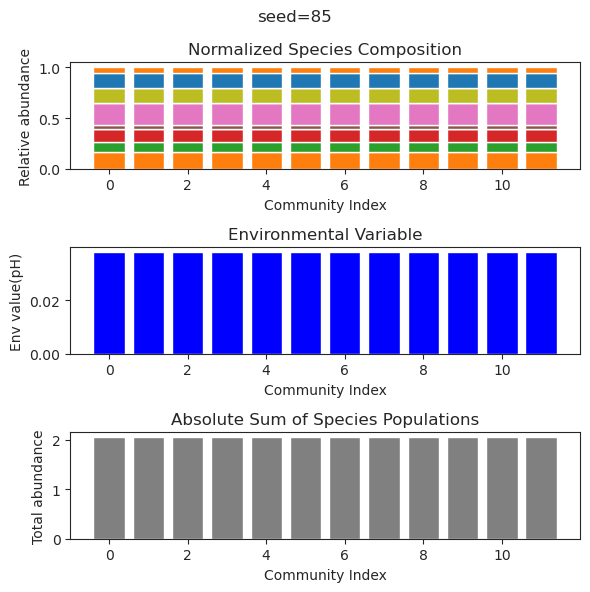

{'species': array([-1.43982270e-29,  1.48601853e-30,  3.15724834e-01, -9.21294374e-47,
        1.33104213e-05,  5.89337112e-32,  8.15966748e-01, -6.70387459e-50,
        4.66686557e-01, -2.19143358e-45,  5.61209706e-01,  7.28714948e-02]), 'env': array([0.22640067])}
{'species': array([-5.95393977e-49,  2.62767091e-16,  3.15724191e-01,  2.25433221e-67,
        1.11427246e-08, -7.91882391e-78,  8.15976229e-01, -2.17562051e-79,
        4.66694662e-01, -1.78773989e-67,  5.61211216e-01,  7.28772971e-02]), 'env': array([0.22640824])}
{'species': array([ 8.85707782e-30, -2.78868412e-34,  3.15725928e-01, -5.88244379e-32,
        3.59371849e-05, -7.22061263e-27,  8.15950618e-01, -3.70627612e-80,
        4.66672767e-01, -2.47414737e-28,  5.61207137e-01,  7.28616215e-02]), 'env': array([0.22638778])}
{'species': array([-1.16227055e-57,  8.44208579e-24,  3.15724205e-01, -1.46209386e-76,
        3.12574728e-07,  2.48774326e-81,  8.15976014e-01,  5.04281814e-82,
        4.66694478e-01, -1.86438449e-

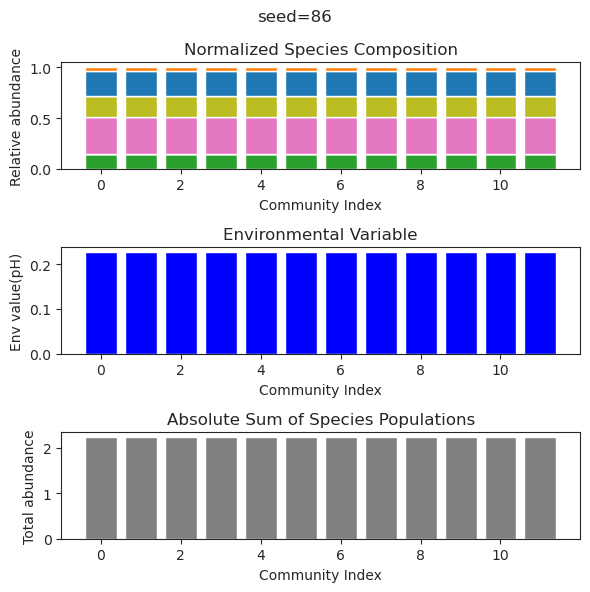

{'species': array([ 4.38628004e-50,  4.09655824e-01,  2.96619454e-01,  3.05260435e-01,
        9.00345265e-39,  5.07003388e-01,  1.41427710e-41, -6.59911566e-45,
        1.24606032e-01,  2.26661587e-01,  1.02855221e-01,  1.03744547e-40]), 'env': array([0.16604785])}
{'species': array([ 3.63660810e-79,  4.09655824e-01,  2.96619454e-01,  3.05260435e-01,
        6.83052856e-37,  5.07003388e-01, -5.84939233e-51, -1.59013013e-55,
        1.24606032e-01,  2.26661587e-01,  1.02855221e-01, -4.17343736e-52]), 'env': array([0.16604785])}
{'species': array([ 3.01155353e-83,  4.09655824e-01,  2.96619454e-01,  3.05260435e-01,
       -2.21465743e-45,  5.07003388e-01,  7.20890457e-62,  2.48238393e-71,
        1.24606032e-01,  2.26661587e-01,  1.02855221e-01,  6.75853444e-62]), 'env': array([0.16604785])}
{'species': array([-5.47602820e-94,  4.09655824e-01,  2.96619454e-01,  3.05260435e-01,
       -1.86072997e-41,  5.07003388e-01, -1.69027260e-61, -8.33682772e-66,
        1.24606032e-01,  2.26661587e-

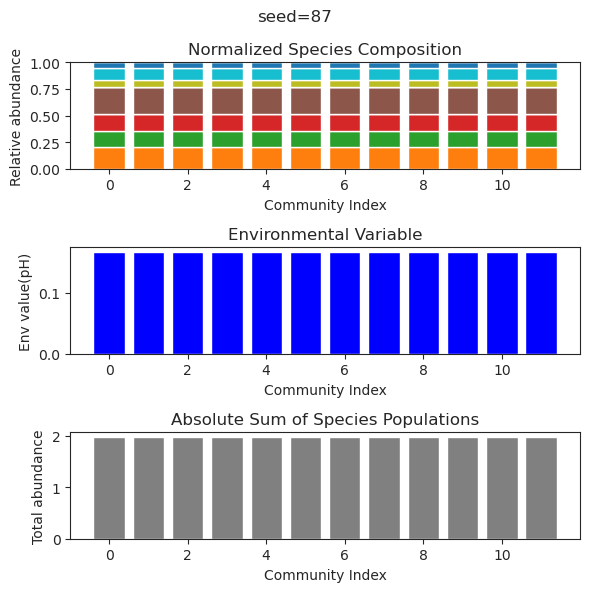

{'species': array([ 3.99529766e-65,  4.40413171e-37,  4.10033455e-45,  3.12750185e-01,
        6.63766859e-01,  5.28896890e-01,  4.56218023e-36,  1.93619201e-20,
        4.64434902e-01,  7.77718113e-46,  2.79372734e-01, -5.84580011e-45]), 'env': array([-0.00971587])}
{'species': array([-1.46450545e-55,  2.00800543e-38,  5.85940076e-60,  3.12750185e-01,
        6.63766859e-01,  5.28896890e-01,  1.33540379e-35, -2.69783916e-17,
        4.64434902e-01, -5.47415851e-47,  2.79372734e-01, -5.20839989e-61]), 'env': array([-0.00971587])}
{'species': array([ 3.27546487e-54,  5.18150159e-37,  1.49537845e-46,  3.12750185e-01,
        6.63766859e-01,  5.28896890e-01,  2.00567669e-34,  5.01452521e-18,
        4.64434902e-01, -2.92140260e-43,  2.79372734e-01,  7.89768778e-49]), 'env': array([-0.00971587])}
{'species': array([ 9.99742580e-54, -6.90490650e-40, -7.41393117e-49,  3.12750185e-01,
        6.63766859e-01,  5.28896890e-01, -8.18403180e-33, -3.32158309e-18,
        4.64434902e-01, -2.2469294

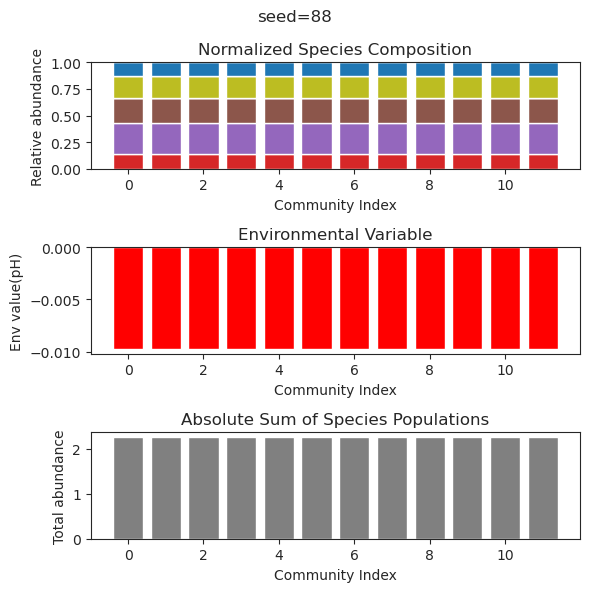

{'species': array([7.34792178e-001, 3.38150138e-001, 1.16505347e-003, 2.57392568e-002,
       1.07247737e-001, 2.33573509e-001, 4.18317947e-130, 0.00000000e+000,
       6.72206118e-001, 2.45965051e-002, 0.00000000e+000, 9.49488602e-002]), 'env': array([-0.0365585])}
{'species': array([7.25067709e-001, 2.74178532e-001, 1.66858657e-003, 3.36009867e-002,
       9.90606723e-002, 1.82183691e-001, 4.11194209e-131, 0.00000000e+000,
       6.79698498e-001, 3.17222774e-002, 0.00000000e+000, 1.81458851e-001]), 'env': array([-0.03582823])}
{'species': array([7.40560689e-001, 3.49553625e-001, 9.98016151e-006, 2.48187989e-002,
       9.38978969e-002, 2.39999864e-001, 2.24414182e-133, 0.00000000e+000,
       6.65462275e-001, 2.67094282e-002, 9.88131292e-324, 9.17087280e-002]), 'env': array([-0.02836206])}
{'species': array([7.14353914e-001, 3.00203231e-001, 1.28432909e-003, 2.67190181e-002,
       1.54940822e-001, 2.14255677e-001, 2.46697631e-131, 0.00000000e+000,
       6.94857590e-001, 2.26570847e

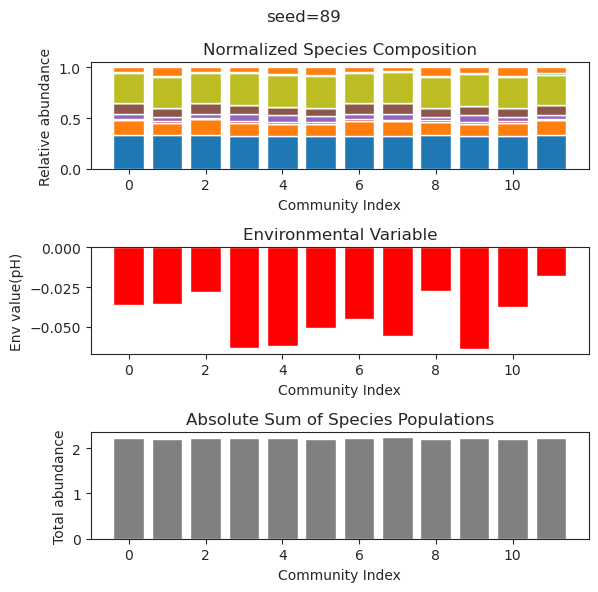

{'species': array([ 2.68990193e-001,  3.11574168e-001, -2.34891127e-109,
       -1.30684512e-100,  2.61641654e-026,  2.17594085e-001,
        1.26316997e-001,  5.30753193e-165, -1.54359421e-055,
        2.68777840e-001,  3.35842197e-001,  2.77670148e-001]), 'env': array([0.05712611])}
{'species': array([ 2.68990193e-001,  3.11574168e-001,  7.76070306e-104,
        1.24285971e-105,  3.98122225e-040,  2.17594085e-001,
        1.26316997e-001, -9.59964208e-165,  3.90756752e-061,
        2.68777840e-001,  3.35842197e-001,  2.77670148e-001]), 'env': array([0.05712611])}
{'species': array([2.68990193e-001, 3.11574168e-001, 3.79204583e-103, 1.02025213e-106,
       9.26380166e-031, 2.17594085e-001, 1.26316997e-001, 1.03929331e-162,
       7.49540266e-061, 2.68777840e-001, 3.35842197e-001, 2.77670148e-001]), 'env': array([0.05712611])}
{'species': array([ 2.68990193e-001,  3.11574168e-001, -1.86961122e-106,
       -1.52487457e-102,  4.84363267e-025,  2.17594085e-001,
        1.26316997e-001, -2

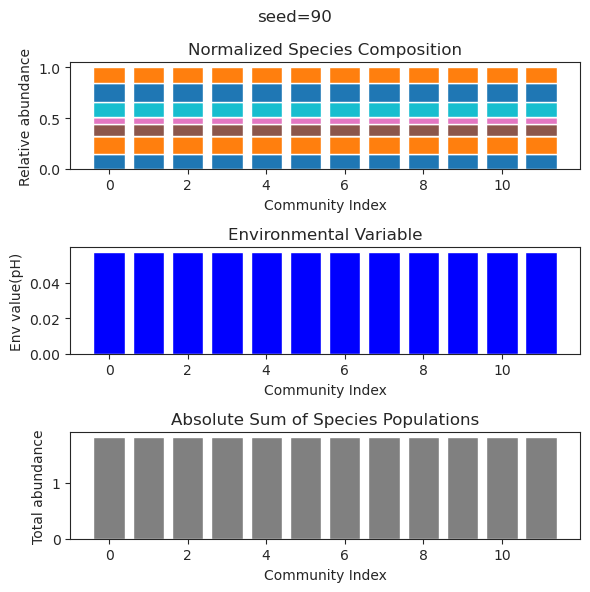

{'species': array([ 1.43661554e-001,  4.69999043e-001,  1.01641413e-001,
        2.35087075e-001,  5.02151562e-032, -4.14441773e-018,
       -3.42255148e-100,  6.05658422e-002,  5.32918626e-001,
        2.96354876e-001,  1.02581921e-053,  3.28897807e-038]), 'env': array([-0.1096618])}
{'species': array([ 1.43661554e-001,  4.69999043e-001,  1.01641413e-001,
        2.35087075e-001,  2.33887774e-035,  5.07286755e-018,
        1.68060524e-104,  6.05658422e-002,  5.32918626e-001,
        2.96354876e-001, -1.78266206e-055, -1.14351111e-039]), 'env': array([-0.1096618])}
{'species': array([ 1.43661554e-001,  4.69999043e-001,  1.01641413e-001,
        2.35087075e-001, -1.00812285e-033, -4.19223892e-018,
       -3.12292275e-135,  6.05658422e-002,  5.32918626e-001,
        2.96354876e-001,  1.45629499e-063, -2.59959266e-036]), 'env': array([-0.1096618])}
{'species': array([ 1.43661554e-01,  4.69999043e-01,  1.01641413e-01,  2.35087075e-01,
        1.71278754e-30,  6.12566224e-17,  1.04756612e-8

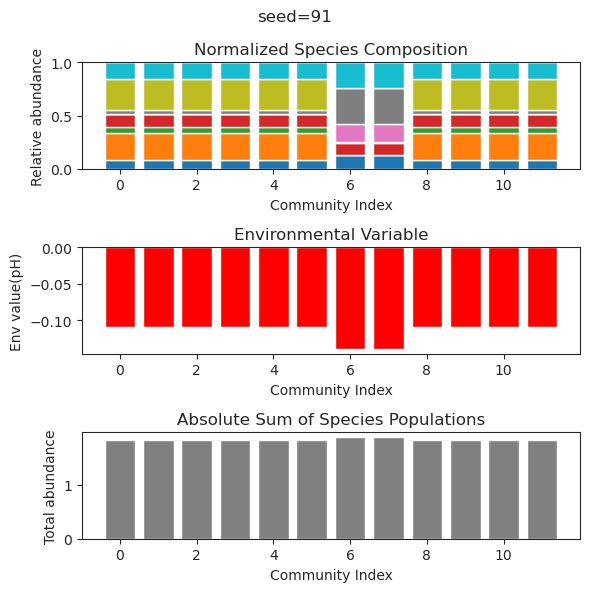

{'species': array([-6.46253190e-079, -1.68515005e-047,  3.83291687e-002,
        1.13522041e-001,  2.36660112e-001,  2.87235973e-001,
       -1.71737996e-060,  2.11115617e-043, -6.39262575e-106,
        6.12662343e-002,  4.82986864e-001,  7.96052142e-001]), 'env': array([0.38916802])}
{'species': array([-5.03577770e-65, -1.42429584e-54,  3.83291687e-02,  1.13522041e-01,
        2.36660112e-01,  2.87235973e-01, -4.59296842e-52, -1.39589834e-43,
        1.51681676e-45,  6.12662343e-02,  4.82986864e-01,  7.96052142e-01]), 'env': array([0.38916802])}
{'species': array([-1.58600159e-123,  3.15385337e-089,  3.83291687e-002,
        1.13522041e-001,  2.36660112e-001,  2.87235973e-001,
        1.88491685e-077,  1.06259607e-047, -2.95982155e-162,
        6.12662343e-002,  4.82986864e-001,  7.96052142e-001]), 'env': array([0.38916802])}
{'species': array([ 5.08737249e-161, -3.03598548e-118,  3.83291687e-002,
        1.13522041e-001,  2.36660112e-001,  2.87235973e-001,
        4.05372566e-102,  9

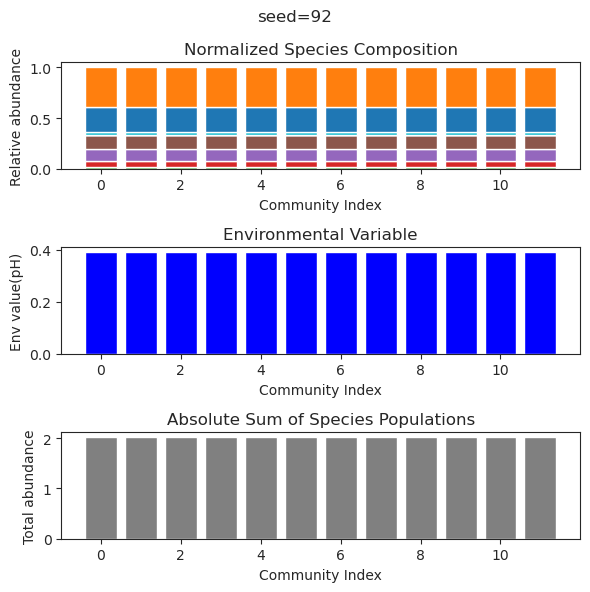

{'species': array([ 2.02975103e-111,  4.77165738e-001,  3.45985706e-113,
        5.40976502e-002, -6.57479478e-022,  6.69292650e-001,
        1.62171466e-001,  1.62347063e-100,  5.40894367e-001,
        2.99186716e-001, -3.54114042e-100,  7.49407612e-002]), 'env': array([0.23462294])}
{'species': array([ 4.51489776e-136,  4.77165738e-001,  1.08954652e-136,
        5.40976502e-002, -1.89276181e-019,  6.69292650e-001,
        1.62171466e-001, -3.09833963e-106,  5.40894367e-001,
        2.99186716e-001, -2.33147689e-106,  7.49407612e-002]), 'env': array([0.23462294])}
{'species': array([-3.11558603e-118,  4.77165738e-001, -5.19942457e-120,
        5.40976502e-002, -8.79837867e-022,  6.69292650e-001,
        1.62171466e-001,  2.08825336e-103,  5.40894367e-001,
        2.99186716e-001, -9.80702529e-102,  7.49407612e-002]), 'env': array([0.23462294])}
{'species': array([ 4.78607421e-132,  4.77165738e-001,  1.78843089e-130,
        5.40976502e-002,  1.49531314e-023,  6.69292650e-001,
        

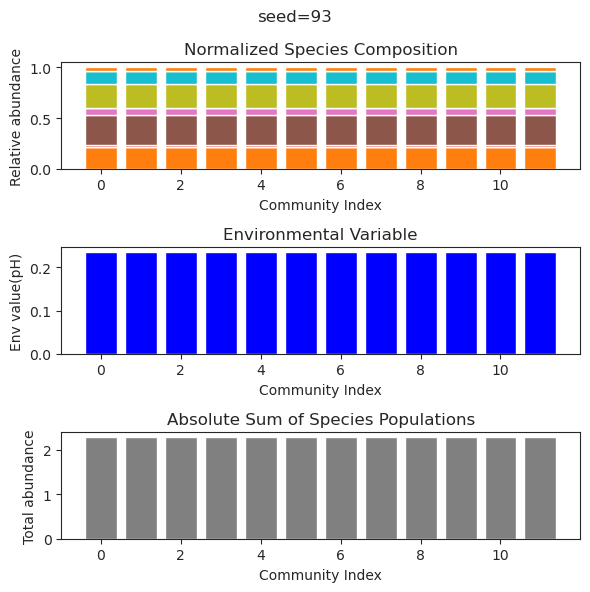

{'species': array([ 1.88187913e-16,  3.63434961e-02,  5.02443530e-01,  5.00872744e-01,
       -5.29279246e-53, -3.24880930e-31, -1.27501966e-35,  7.76549008e-01,
       -8.59502306e-18, -2.89520611e-37,  3.06741354e-01, -7.08300444e-44]), 'env': array([-0.20970313])}
{'species': array([ 2.69489407e-17,  3.63434961e-02,  5.02443530e-01,  5.00872744e-01,
       -1.63702588e-91, -2.62909198e-38,  5.20174068e-37,  7.76549008e-01,
       -8.28943554e-18,  1.80944873e-49,  3.06741354e-01,  1.22593072e-67]), 'env': array([-0.20970313])}
{'species': array([-1.71894936e-17,  3.63434961e-02,  5.02443530e-01,  5.00872744e-01,
       -5.42163588e-71,  1.04344780e-33, -3.08886709e-34,  7.76549008e-01,
        6.29325161e-18,  1.15911101e-42,  3.06741354e-01, -3.57544543e-56]), 'env': array([-0.20970313])}
{'species': array([ 5.05371483e-16,  3.63434961e-02,  5.02443530e-01,  5.00872744e-01,
       -1.64343081e-80,  5.41382082e-32,  5.29581739e-33,  7.76549008e-01,
        1.15886564e-16, -3.3081964

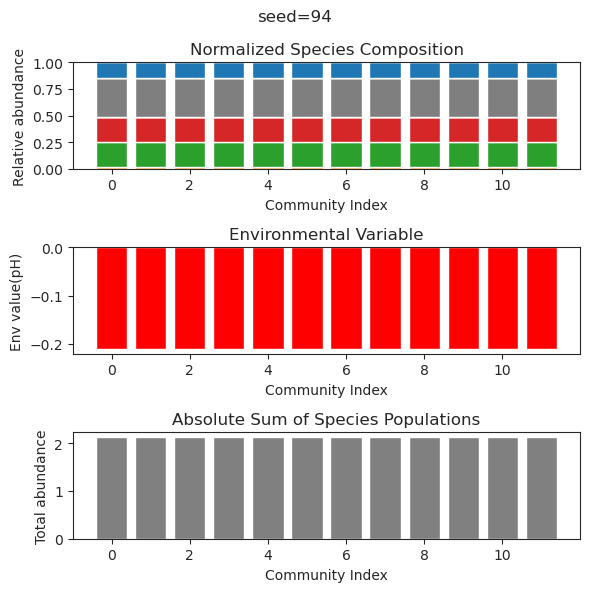

{'species': array([ 0.00000000e+000,  2.96168965e-001,  1.66190394e-001,
        1.89483500e-002,  2.39700825e-001, -2.02769699e-225,
        4.36601980e-001,  1.15025895e-001,  2.43840155e-181,
        2.33506608e-001,  1.58088250e-001,  3.47221598e-001]), 'env': array([-0.12820129])}
{'species': array([ 4.94065646e-324,  2.96168708e-001,  1.66190379e-001,
        1.89484514e-002,  2.39700500e-001,  8.83887824e-238,
        4.36601938e-001,  1.15026298e-001, -1.51056246e-188,
        2.33506649e-001,  1.58088541e-001,  3.47221242e-001]), 'env': array([-0.12820125])}
{'species': array([0.00000000e+000, 2.96169108e-001, 1.66190647e-001, 1.89482270e-002,
       2.39700713e-001, 1.82932238e-248, 4.36602215e-001, 1.15025532e-001,
       2.65501007e-190, 2.33506467e-001, 1.58088179e-001, 3.47221874e-001]), 'env': array([-0.12820121])}
{'species': array([4.94065646e-324, 2.96168990e-001, 1.66190690e-001, 1.89482601e-002,
       2.39700505e-001, 6.69073820e-250, 4.36602238e-001, 1.15025688e-0

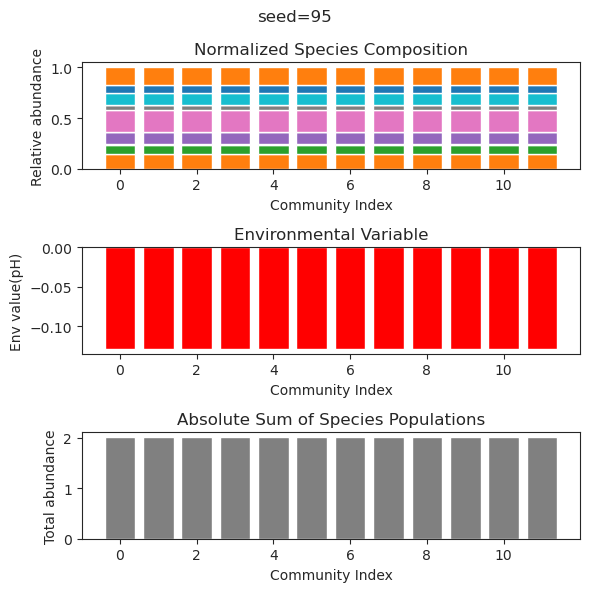

{'species': array([ 6.04425876e-001,  1.12118722e-109, -3.08935246e-076,
       -2.32976942e-026, -6.39106774e-045,  2.99540250e-002,
        4.29083066e-001,  1.45054644e-035,  1.95943406e-001,
        4.61847827e-105, -3.74795128e-074,  8.30489372e-001]), 'env': array([0.07429239])}
{'species': array([ 6.04425876e-01,  4.65461747e-84,  1.32935227e-61, -4.05045761e-26,
       -2.54031260e-38,  2.99540250e-02,  4.29083066e-01,  1.53758315e-34,
        1.95943406e-01,  2.13792827e-78,  1.44165941e-64,  8.30489372e-01]), 'env': array([0.07429239])}
{'species': array([ 6.04425876e-01, -1.17805940e-34,  2.93433954e-33, -2.09419570e-27,
       -6.53240600e-30,  2.99540250e-02,  4.29083066e-01,  1.24619911e-29,
        1.95943406e-01,  2.48636278e-35,  6.33444791e-36,  8.30489372e-01]), 'env': array([0.07429239])}
{'species': array([ 6.04425876e-01, -1.26568915e-76,  8.76748088e-59, -5.39902592e-30,
        4.60059170e-51,  2.99540250e-02,  4.29083066e-01,  2.13975317e-29,
        1.95943406

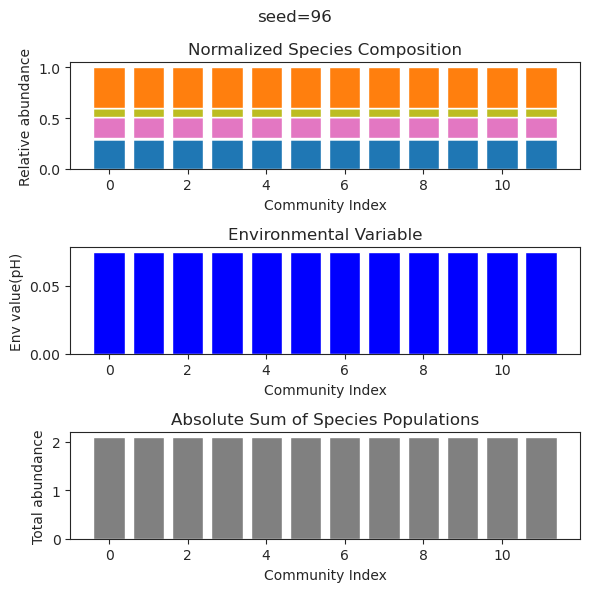

{'species': array([-6.14137019e-28,  3.77985573e-24,  1.49184309e-34, -1.14809533e-36,
       -3.67033596e-32,  1.56787753e-01,  5.78009983e-01,  6.82856182e-01,
        1.81974091e-28,  6.74763919e-02,  4.97174057e-01,  1.83469261e-04]), 'env': array([0.35067626])}
{'species': array([5.71023616e-30, 1.42271129e-24, 8.26028690e-32, 1.07025082e-32,
       1.10318846e-33, 1.56814968e-01, 5.78009700e-01, 6.83107545e-01,
       5.29664404e-40, 6.72441934e-02, 4.97339359e-01, 1.78764951e-06]), 'env': array([0.3506632])}
{'species': array([ 4.90877129e-33,  7.39060101e-24,  3.88662002e-32,  1.11145255e-33,
        6.03822772e-32,  1.56818068e-01,  5.78010427e-01,  6.83113155e-01,
       -6.94447547e-37,  6.72347468e-02,  4.97344801e-01,  1.79589541e-07]), 'env': array([0.35066148])}
{'species': array([-1.88701347e-025,  5.62365086e-018, -2.21477550e-112,
        3.70364752e-026, -3.00462770e-049,  1.56992283e-001,
        5.78054908e-001,  6.83319704e-001, -9.36801405e-062,
        6.6784111

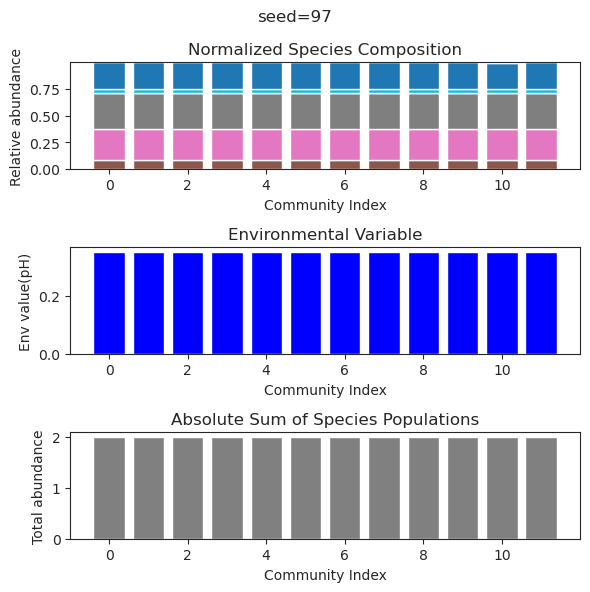

{'species': array([ 2.68326186e-01, -8.79513799e-61, -2.97829047e-62,  2.61222419e-01,
        4.60866676e-01,  3.31508864e-01,  1.08748673e-01,  7.13251204e-02,
        1.27413366e-01,  1.69478394e-01,  3.30748422e-78,  1.55601328e-01]), 'env': array([-0.10258976])}
{'species': array([ 2.68326186e-01,  3.49973567e-71, -4.76805377e-72,  2.61222419e-01,
        4.60866676e-01,  3.31508864e-01,  1.08748673e-01,  7.13251204e-02,
        1.27413366e-01,  1.69478394e-01,  1.26146860e-92,  1.55601328e-01]), 'env': array([-0.10258976])}
{'species': array([ 2.68326186e-01,  7.99759915e-59, -2.88683948e-59,  2.61222419e-01,
        4.60866676e-01,  3.31508864e-01,  1.08748673e-01,  7.13251204e-02,
        1.27413366e-01,  1.69478394e-01, -1.62211754e-71,  1.55601328e-01]), 'env': array([-0.10258976])}
{'species': array([ 2.68326186e-01,  9.43274789e-55,  5.44507612e-59,  2.61222419e-01,
        4.60866676e-01,  3.31508864e-01,  1.08748673e-01,  7.13251204e-02,
        1.27413366e-01,  1.6947839

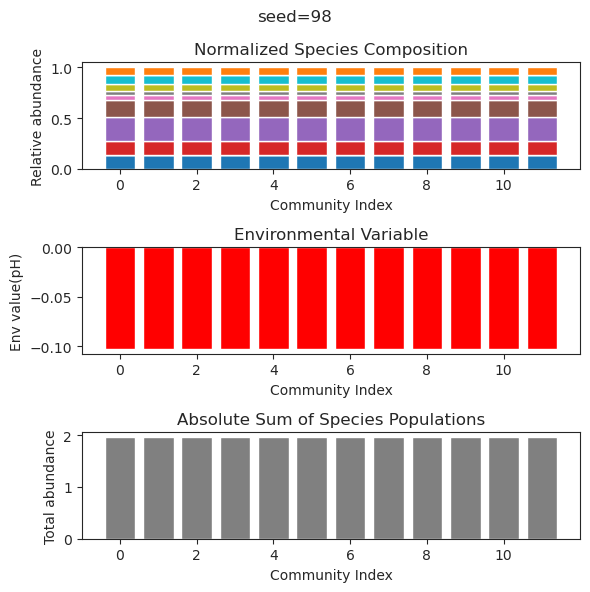

{'species': array([-4.86942552e-33, -1.33366888e-81,  8.25551861e-01,  3.96794952e-67,
        2.18612341e-02, -3.90589045e-37, -1.90208275e-78,  2.44627175e-01,
        2.43081066e-01,  2.24317641e-01, -8.51011589e-42,  4.77461135e-01]), 'env': array([-0.06312822])}
{'species': array([-3.83428013e-35, -4.69905602e-55,  8.25551860e-01, -2.78774830e-44,
        2.18614466e-02, -6.23571770e-41,  1.15129399e-56,  2.44626971e-01,
        2.43080945e-01,  2.24317829e-01,  2.09396619e-32,  4.77461030e-01]), 'env': array([-0.06312822])}
{'species': array([-1.18278756e-36,  1.12354205e-33,  8.25551860e-01,  1.51672703e-37,
        2.18614466e-02, -6.57945035e-40, -7.39338667e-61,  2.44626971e-01,
        2.43080945e-01,  2.24317829e-01,  6.10378948e-27,  4.77461030e-01]), 'env': array([-0.06312822])}
{'species': array([-3.74063249e-68, -4.11409973e-76,  8.25551860e-01,  4.53293043e-42,
        2.18614466e-02,  5.80763525e-39, -2.50960304e-32,  2.44626971e-01,
        2.43080945e-01,  2.2431782

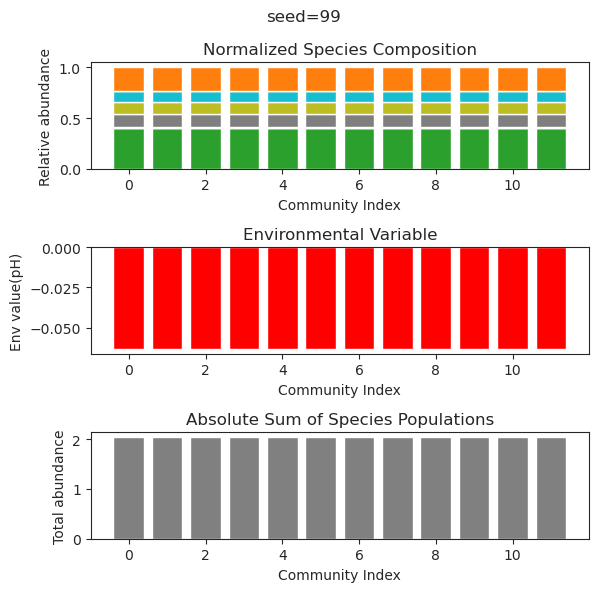

NameError: name 'pickle' is not defined

In [33]:
    session_path='Results/Session_Test5'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0,1.0)
        f_q = lambda : uniform_distribution(0,1.0)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        #p[0,0]=-10
        #p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        #q[0,0]=0.2
        #q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0.5])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

In [ ]:
    session_path='Results/Session_Test6'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0.4,0.6)
        f_q = lambda : uniform_distribution(0.4,0.6)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        #p[0,0]=-10
        #p[0,1]=-10
        #p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        #q[0,0]=0.2
        #q[1,0]=0.2
        #q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)

In [ ]:
    session_path='Results/Session_Test7'
    to_save={}
    description=''
    simulated_result={}
    
    for seed_num in range(100):
        if not os.path.isdir(session_path):
            os.mkdir(session_path)
        # functions for uniform 

        f_I = lambda : uniform_distribution(0.5,0.5)
        f_g = lambda : np.ones(1)
        f_k = lambda : np.ones(1)
        f_p = lambda : uniform_distribution(0.4,0.6)
        f_q = lambda : uniform_distribution(0.4,0.6)
        f_beta = lambda : np.ones(1)
        seed_num=seed_num
        to_plot=True

        np.random.seed(seed_num)

        N=12
        N_env=1


        I = np.zeros((N, N))
        for i in range(N):
            for j in range(N):
                I[i,j] = f_I()
        for i in range(N):
            I[i,i] =1

        g = np.zeros((N))
        for i in range(N):
            g[i] = f_g()

        k = np.zeros((N))
        for i in range(N):
            k[i] = f_k()   

        p = np.zeros((N_env, N))
        for i in range(N_env):
            for j in range(N):
                p[i,j] = f_p()

        p[0,0]=-10
        p[0,1]=-10
        p[0,2]=-10

        q = np.zeros((N, N_env))
        for i in range(N):
            for j in range(N_env):
                q[i,j] = f_q()

        q[0,0]=0.2
        q[1,0]=0.2
        q[2,0]=0.2



        beta = np.zeros(N_env)
        for i in range(N_env):
            beta[i]=f_beta()

        delta = 0.1 ## ln(100000)/24 ~= 0.5 per hour
        migration_rate=0#1e-7
        system_config = {
            'I': I,
            'g': g,
            'k': k,
            'p': p,
            'q': q,
            'beta': beta,
            'delta': delta,
            'migration_rate' : migration_rate,
            'N': N,
            'N_env': N_env,
            'seed_num':seed_num,
        } 

        file_path = f'{session_path}/system_config.json'

        label="test"
        sys
        ##

        y_out_list=[]
        system_config['beta'] = np.array([0])*delta

        for i in range(N):

            species_index=np.arange(0,N)
            env_index=np.array([0])
            y0_species=one_hot_vector(N,i)
            y0_env=[0]
            t=np.linspace(0, 2000, 10000)

            y_out = run_gLV_env_dynamics(y0_species, y0_env, t, system_config, species_index, env_index, to_plot=False)

            y_out_list.append(y_out)

        num_datasets = len(y_out_list)

        # Prepare subplots
        fig, axs = plt.subplots(3, 1, figsize=(6, 6))

        # Data for plots
        species_matrix = np.array([y_out['species'] for y_out in y_out_list])
        env_data = np.array([y_out['env'][0] for y_out in y_out_list])  # Assuming env is a single-element array

        # Normalize species data
        species_matrix = np.maximum(species_matrix, 0)  # Removing negative values for normalization
        species_sums = np.sum(species_matrix, axis=1, keepdims=True)
        normalized_species = species_matrix / species_sums

        # Absolute sums of species data (sum across all species for each dataset)
        absolute_sums = np.sum(species_matrix, axis=1)
        simulated_result[seed_num]={'species':species_matrix, 'env' : env_data}

        if to_plot:
            plt.suptitle(f'seed={seed_num}')

            # Plotting species composition as stacked bars
            bottom_values = np.zeros(num_datasets)  # Initial bottom values are zeros
            for i in range(normalized_species.shape[1]):  # Loop through each species
                axs[0].bar(np.arange(num_datasets), normalized_species[:, i], bottom=bottom_values, label=f'Species {i+1}')
                bottom_values += normalized_species[:, i]  # Update bottom values for stacking

            axs[0].set_title('Normalized Species Composition')
            axs[0].set_xlabel('Community Index')
            axs[0].set_ylabel('Relative abundance')
            #axs[0].legend()

            # Plotting environmental factors
            colors = ['blue' if x > 0 else 'red' for x in env_data]  # Determine color based on sign of value
            axs[1].bar(np.arange(num_datasets), env_data, color=colors, width=0.8)
            axs[1].set_title('Environmental Variable')
            axs[1].set_xlabel('Community Index')
            axs[1].set_ylabel('Env value(pH)')

            # Plotting absolute sums of species data
            axs[2].bar(np.arange(num_datasets), absolute_sums, color='gray', width=0.8)
            axs[2].set_title('Absolute Sum of Species Populations')
            axs[2].set_xlabel('Community Index')
            axs[2].set_ylabel('Total abundance')

            plt.tight_layout()
            plt.savefig(session_path+f'/diagram_{seed_num}.png')

            #if to_plot:
            #    plt.savefig()


            plt.show()
    #simulated_result = {'a': 1, 'b': 2, 'c': 3}  # Your existing dictionary
    #description = "This is a description of the simulated result."

    # Combine both into a new dictionary
    data_to_save = {
        'result': simulated_result,
        'description': description
    }
    # Serialize the combined data to a pickle file
    with open(session_path+'/result_and_description.pkl', 'wb') as file:
        pickle.dump(data_to_save, file)